# Evaluation Script for Horizontal Bar Plots

In [ ]:
import tensorflow
print(tensorflow.__version__) # 2.6.0

2.2.3


In [ ]:
# Load the binary classifier

# Running Sequence
# Terminate Session
# Tapas -> Reset
# Load Classifier -> Reset
# Tapas -> No Reset

In [ ]:
!pip install tensorflow==2.6

  Using cached tensorflow-2.6.0-cp37-cp37m-manylinux2010_x86_64.whl (458.3 MB)
  Using cached tensorflow_estimator-2.6.0-py2.py3-none-any.whl (462 kB)
  Using cached numpy-1.19.5-cp37-cp37m-manylinux2010_x86_64.whl (14.8 MB)
  Using cached h5py-3.1.0-cp37-cp37m-manylinux1_x86_64.whl (4.0 MB)
  Using cached gast-0.4.0-py3-none-any.whl (9.8 kB)
  Using cached tensorboard-2.7.0-py3-none-any.whl (5.8 MB)
  Attempting uninstall: numpy
    Found existing installation: numpy 1.18.5
    Uninstalling numpy-1.18.5:
      Successfully uninstalled numpy-1.18.5
  Attempting uninstall: tensorflow-estimator
    Found existing installation: tensorflow-estimator 2.2.0
    Uninstalling tensorflow-estimator-2.2.0:
      Successfully uninstalled tensorflow-estimator-2.2.0
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.2.2
    Uninstalling tensorboard-2.2.2:
      Successfully uninstalled tensorboard-2.2.2
  Attempting uninstall: h5py
    Found existing installation: h5p

In [ ]:
import tensorflow
from tensorflow import keras
from tensorflow.keras.preprocessing.sequence import pad_sequences
import pickle

2021-10-25 13:55:26.637064: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2021-10-25 13:55:26.637086: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


In [ ]:
model = tensorflow.keras.models.load_model('/home/pessat/Capstone/Binary_Classifier/binary_classifier.h5')

with open('/home/pessat/Capstone/Binary_Classifier/tokenizer.pickle', 'rb') as handle:
    loaded_tokenizer = pickle.load(handle)

2021-10-25 13:55:29.728459: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2021-10-25 13:55:29.728492: W tensorflow/stream_executor/cuda/cuda_driver.cc:269] failed call to cuInit: UNKNOWN ERROR (303)
2021-10-25 13:55:29.728505: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (pessat165): /proc/driver/nvidia/version does not exist
2021-10-25 13:55:29.728641: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [ ]:
def binary_classifier_predict(questions):
  maxlen = 100
  seq= loaded_tokenizer.texts_to_sequences(questions)
  padded = pad_sequences(seq, maxlen=maxlen)
  predictions = model.predict(padded)

  result = []
  for e in predictions:
    result.append(e[0])

  THRESHOLD = 0.5
  tapas_questions = []
  tabfact_questions = []
  for i in range(len(result)):
      # print("Question = ", questions[i])

      # Class 0
      if result[i] < THRESHOLD:
          # print("Class 0: Tabfact")
          tabfact_questions.append(questions[i])

      else:
          # print("Class 1: Tapas")
          tapas_questions.append(questions[i])

  return tapas_questions, tabfact_questions

In [ ]:
binary_classifier_predict(
    ['How many different coloured dotlines are there ?' ,
'Is the number of dotlines equal to the number of legend labels ?' ,
'What is the number of tourist arrivals in 1997 ?' ,
'Across all years, what is the maximum number of tourist arrivals ?' ,
'Across all years, what is the minimum number of tourist departures ?' ,
'In which year was the number of tourist arrivals maximum?' ,
'In which year was the number of tourist departures minimum?' ,
'What is the total number of tourist departures in the graph ?']
) # returns tapas_questions and tabfact_questions

2021-10-25 13:55:34.996658: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


(['How many different coloured dotlines are there ?',
  'What is the number of tourist arrivals in 1997 ?',
  'Across all years, what is the maximum number of tourist arrivals ?',
  'Across all years, what is the minimum number of tourist departures ?',
  'In which year was the number of tourist arrivals maximum?',
  'In which year was the number of tourist departures minimum?',
  'What is the total number of tourist departures in the graph ?'],
 ['Is the number of dotlines equal to the number of legend labels ?'])

## Download TAPAS

In [ ]:
! pip install tapas-table-parsing

  Using cached tensorflow-2.2.3-cp37-cp37m-manylinux2010_x86_64.whl (516.4 MB)


  Using cached h5py-2.10.0-cp37-cp37m-manylinux1_x86_64.whl (2.9 MB)
  Using cached numpy-1.18.5-cp37-cp37m-manylinux1_x86_64.whl (20.1 MB)
  Using cached gast-0.3.3-py2.py3-none-any.whl (9.7 kB)
  Using cached tensorboard-2.2.2-py3-none-any.whl (3.0 MB)
  Using cached tensorflow_estimator-2.2.0-py2.py3-none-any.whl (454 kB)


  Attempting uninstall: numpy
    Found existing installation: numpy 1.19.5
    Uninstalling numpy-1.19.5:
      Successfully uninstalled numpy-1.19.5
  Attempting uninstall: tensorflow-estimator
    Found existing installation: tensorflow-estimator 2.6.0
    Uninstalling tensorflow-estimator-2.6.0:
      Successfully uninstalled tensorflow-estimator-2.6.0
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.7.0
    Uninstalling tensorboard-2.7.0:
      Successfully uninstalled tensorboard-2.7.0
  Attempting uninstall: h5py
    Found existing installation: h5py 3.1.0
    Uninstalling h5py-3.1.0:
      Successfully uninstalled h5py-3.1.0
  Attempting uninstall: gast
    Found existing installation: gast 0.4.0
    Uninstalling gast-0.4.0:
      Successfully uninstalled gast-0.4.0
  Attempting uninstall: tensorflow
    Found existing installation: tensorflow 2.6.0
    Uninstalling tensorflow-2.6.0:
      Successfully uninstalled tensorflow-2.6.0


In [ ]:
import tensorflow
print(tensorflow.__version__) 
# First = 2.2.3
# Then = 2.6.0

2.6.0


In [ ]:


# from google.colab import files
import os
import glob
import random
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import re
import json
from natsort import natsorted 
import shutil
import pandas as pd
from statistics import median
from math import floor
from math import ceil

import numpy as np
import pickle
%matplotlib inline

import tensorflow.compat.v1 as tf
import os 
import shutil
import csv
import pandas as pd
import numpy as np
import IPython
print(tf.__version__)
tf.get_logger().setLevel('ERROR')

import random

from tapas.utils import tf_example_utils
from tapas.protos import interaction_pb2
from tapas.utils import number_annotation_utils
import math




from tapas.utils import tf_example_utils
from tapas.protos import interaction_pb2
from tapas.utils import number_annotation_utils
from tapas.scripts import prediction_utils

2.6.0


In [ ]:
os.makedirs('results/tabfact/tf_examples', exist_ok=True)
os.makedirs('results/tabfact/model', exist_ok=True)
with open('results/tabfact/model/checkpoint', 'w') as f:
  f.write('model_checkpoint_path: "model.ckpt-0"')
for suffix in ['.data-00000-of-00001', '.index', '.meta']:
  shutil.copyfile(f'tabfact_model/model.ckpt{suffix}', f'results/tabfact/model/model.ckpt-0{suffix}')

In [ ]:
max_seq_length = 512
tabfact_vocab_file = "tabfact_model/vocab.txt"
tabfact_config = tf_example_utils.ClassifierConversionConfig(
    vocab_file=tabfact_vocab_file,
    max_seq_length=max_seq_length,
    max_column_id=max_seq_length,
    max_row_id=max_seq_length,
    strip_column_names=False,
    add_aggregation_candidates=False,
)
tabfact_converter = tf_example_utils.ToClassifierTensorflowExample(tabfact_config)

def tabfact_convert_interactions_to_examples(tables_and_queries, question_answer):
  """Calls Tapas converter to convert interaction to example."""
  for idx, (table, queries) in enumerate(tables_and_queries):
    interaction = interaction_pb2.Interaction()
    for position, query in enumerate(queries):
      question = interaction.questions.add()
      question.original_text = query
      question.id = f"{idx}-0_{position}"
    for header in table[0]:
      interaction.table.columns.add().text = header
    for line in table[1:]:
      row = interaction.table.rows.add()
      for cell in line:
        row.cells.add().text = cell
    number_annotation_utils.add_numeric_values(interaction)
    for i in range(len(interaction.questions)):
      try:
        yield tabfact_converter.convert(interaction, i)
      except ValueError as e:
        print(f"Can't convert interaction: {interaction.id} error: {e}")
        
def tabfact_write_tf_example(filename, examples):
  with tf.io.TFRecordWriter(filename) as writer:
    for example in examples:
      writer.write(example.SerializeToString())

def tabfact_predict_new(table_data, queries, question_answer):
  global TOTAL_CORRECT_QA, TOTAL_QA

  table = table_data
  examples = tabfact_convert_interactions_to_examples([(table, queries)], question_answer)
  tabfact_write_tf_example("results/tabfact/tf_examples/test.tfrecord", examples)
  tabfact_write_tf_example("results/tabfact/tf_examples/dev.tfrecord", [])
  
  ! python -m tapas.run_task_main \
    --task="TABFACT" \
    --output_dir="results" \
    --noloop_predict \
    --test_batch_size={len(queries)} \
    --tapas_verbosity="ERROR" \
    --compression_type= \
    --reset_position_index_per_cell \
    --init_checkpoint="tabfact_model/model.ckpt" \
    --bert_config_file="tabfact_model/bert_config.json" \
    --mode="predict" 2> error


  results_path = "results/tabfact/model/test.tsv"
  all_results = []
  df = pd.DataFrame(table[1:], columns=table[0])
  # display(IPython.display.HTML(df.to_html(index=False)))
  print()
  with open(results_path) as csvfile:
    reader = csv.DictReader(csvfile, delimiter='\t')
    for row in reader:
      supported = int(row["pred_cls"])
      all_results.append(supported)
      score = float(row["logits_cls"])
      position = int(row['position'])
      print("> " + queries[position])
      print("EXPECTED = ", question_answer[queries[position]])
      
    #   print(queries[position])
      if supported:
        # print("> YES")
        print("PREDICTED = ", "Yes")
        answer_text = "Yes"
      else:
        # print("> NO")
        print("PREDICTED = ", "No")
        answer_text = "No"

      print()

      TOTAL_QA += 1

      if answer_text == question_answer[queries[position]]:
          TOTAL_CORRECT_QA += 1

          
      print(f"\n\n\t\t\t\t {TOTAL_CORRECT_QA} / {TOTAL_QA} = {round(TOTAL_CORRECT_QA / TOTAL_QA, 4)} \n\n")


  print()
  return all_results

## Load TAPAS

In [ ]:
os.makedirs('results/wtq/tf_examples', exist_ok=True)
os.makedirs('results/wtq/model', exist_ok=True)
with open('results/wtq/model/checkpoint', 'w') as f:
  f.write('model_checkpoint_path: "model.ckpt-0"')
for suffix in ['.data-00000-of-00001', '.index', '.meta']:
  shutil.copyfile(f'tapas_model/model.ckpt{suffix}', f'results/wtq/model/model.ckpt-0{suffix}')

In [ ]:
def isfloat(value):
  try:
    float(value)
    return True
  except ValueError:
    return False

In [ ]:
def Average(Values) :  
  if '' in Values:
    return str('0')
  res_avg = sum(float(x) for x in Values if x != 'nan') / len(Values)
  return str(res_avg)
  # res_average = np.mean(Values)
  # return str(res_average)

def Count(Values) :
  return str(len(Values))

def Sum(Values):
  if isfloat(Values[0]):
    return str(sum(float(x) for x in Values if x != 'nan'))
  else:
    return str("")
  # return str(np.sum(Values))

def Max(Values):
  pass

def Min(Values):
  pass

In [ ]:
def predict_new(table_data, queries, question_answer, display = False):
  global TOTAL_CORRECT_QA, TOTAL_QA
  table = table_data
  examples = convert_interactions_to_examples([(table, queries)])
  write_tf_example("results/wtq/tf_examples/test.tfrecord", examples)
  write_tf_example("results/wtq/tf_examples/random-split-1-dev.tfrecord", [])
  
  ! python -m tapas.run_task_main \
    --task="WTQ" \
    --output_dir="results" \
    --noloop_predict \
    --test_batch_size={len(queries)} \
    --tapas_verbosity="ERROR" \
    --compression_type= \
    --reset_position_index_per_cell \
    --init_checkpoint="tapas_model/model.ckpt" \
    --bert_config_file="tapas_model/bert_config.json" \
    --mode="predict" 2> error

  ANSWERS = []
  results_path = "results/wtq/model/test.tsv"
  all_coordinates = []
  df = pd.DataFrame(table[1:], columns=table[0])
  print("\n\n\n")
  # display(IPython.display.HTML(df.to_html(index=False)))
  Method_mapper = {'AVERAGE' : Average , 'SUM' : Sum , 'COUNT' : Count , 'MAX' : Max , 'MIN' : Min}
  print()
  with open(results_path) as csvfile:
    reader = csv.DictReader(csvfile, delimiter='\t')
    query_index = 0

    for row in reader:
      coordinates = sorted(prediction_utils.parse_coordinates(row["answer_coordinates"]))
      all_coordinates.append(coordinates)
      answers = ', '.join([table[row + 1][col] for row, col in coordinates])
      position = int(row['position'])
      aggregation = aggregation_to_string(int(row["pred_aggr"]))
      
      if display:
        print(">", queries[position])
      answer_text = str(answers)
      #print(aggregation ,  type(aggregation)  , answers , type(answers) , answer_text , type(answer_text) , sep = "\n")
      # print(aggregation, answer_text)

      if re.search("list", queries[position]):
          answer_text += "\n"
          ANSWERS.append(answer_text)

      elif aggregation != "NONE":
        num_results = answer_text.split(",")
        num_results = [num.strip() for num in num_results]

        num_results = [float(x) if x.isnumeric() else x for x in num_results]
        
        #print("NUMS : " , num_results)

        # answer_text = f"{answer_text}"

        actual_answer = Method_mapper[aggregation](num_results)

        answer_text =  actual_answer + "\n"
        ANSWERS.append(actual_answer)
    
      else:
          # answer_text += "\n"
          ANSWERS.append(answer_text)
    
      if display:
        # print(answer_text)

        print("EXPECTED = ", question_answer[queries[position]])
        print("PREDICTED = ", answer_text)

        print("\n")

        TOTAL_QA += 1

        if isfloat(answer_text):
            buffer = float(question_answer[queries[position]]) * 0.05
            lower = float(question_answer[queries[position]]) - buffer
            upper = float(question_answer[queries[position]]) + buffer
            
            if float(answer_text) * -1 > 0:
              lower, upper = upper, lower

            if lower <= float(answer_text) <= upper:
              TOTAL_CORRECT_QA += 1

        elif answer_text == question_answer[queries[position]]:
          TOTAL_CORRECT_QA += 1

          
        print(f"\n\n\t\t\t\t {TOTAL_CORRECT_QA} / {TOTAL_QA} = {round(TOTAL_CORRECT_QA / TOTAL_QA, 4)} \n\n")

  return ANSWERS

In [ ]:
max_seq_length = 512
vocab_file = "tapas_model/vocab.txt"
config = tf_example_utils.ClassifierConversionConfig(
    vocab_file=vocab_file,
    max_seq_length=max_seq_length,
    max_column_id=max_seq_length,
    max_row_id=max_seq_length,
    strip_column_names=False,
    add_aggregation_candidates=False,
)
converter = tf_example_utils.ToClassifierTensorflowExample(config)


def convert_interactions_to_examples(tables_and_queries):
  """Calls Tapas converter to convert interaction to example."""
  for idx, (table, queries) in enumerate(tables_and_queries):
    interaction = interaction_pb2.Interaction()
    for position, query in enumerate(queries):
      question = interaction.questions.add()
      question.original_text = query
      question.id = f"{idx}-0_{position}"
    for header in table[0]:
      interaction.table.columns.add().text = header
    for line in table[1:]:
      row = interaction.table.rows.add()
      for cell in line:
        row.cells.add().text = cell
    number_annotation_utils.add_numeric_values(interaction)
    for i in range(len(interaction.questions)):
      try:
        yield converter.convert(interaction, i)
      except ValueError as e:
        print(f"Can't convert interaction: {interaction.id} error: {e}")
        
def write_tf_example(filename, examples):
  with tf.io.TFRecordWriter(filename) as writer:
    for example in examples:
      writer.write(example.SerializeToString())

def aggregation_to_string(index):
  if index == 0:
    return "NONE"
  if index == 1:
    return "SUM"
  if index == 2:
    return "AVERAGE"
  if index == 3:
    return "COUNT"
  raise ValueError(f"Unknown index: {index}")

## Load Functions used in TAPAS

In [ ]:
def get_list_of_list(path, display = False):
    df = pd.read_csv(path)
    df = df.astype(str)
    df.drop(axis = 1 , labels = ['Unknown' , 'xlabel' , 'ylabel' ,'title' , 'legend orientation'] , inplace= True, errors = 'ignore')
    df = df.sort_values(df.columns[0],ignore_index=True)
    if display:
        print(df)

    list_of_list_1 = [[]]
    list_of_list_1[0] = list(df.columns)
    list_of_list_1.extend(df.values.tolist()) 
    return list_of_list_1

In [ ]:
def display_image_qa_pairs(img_id):

  # print("png/"+str(img_id)+".png")
  for i, path in enumerate(images):
    if re.search("png/"+str(img_id)+".png", path):
      break

  # Image
  print("\nImage:\n")
  print(images[i])
  img = mpimg.imread(images[i])
  imgplot = plt.imshow(img)
  plt.show()

  questions = list()
  answers = list()
  # print("\nQA Pairs:\n")
  img_index = annot[i]["image_index"]
  count = 0

  for j in qa["qa_pairs"]:
    if j["image_index"] == img_index:
      count  += 1

      if j['template'] != "structural":
        questions.append(j['question_string'])
        answers.append(j['answer'])

  print("Number of QA = ", len(questions))
  print("\n\n")
  return i, questions, answers

In [ ]:
def spilt_ratio(query):
    s1 = []
    s2 = []
    flag = False
    query = query.split()
    i = 0
    while i < len(query):
        # print(s1, s2)
        if query[i] != "to":
            s1.append(query[i])
            i = i + 1
        elif i+1 < len(query):
            s2 = s1[:-1]
            s2.append(query[i+1])
            flag = True
            i = i + 2
        while flag and i < len(query):
            # s1.append(query[i])
            s2.append(query[i])
            i += 1
    return " ".join(s1), " ".join(s2)

# works - "What is the ratio of male workers in 1981 to 1980 for the country Hong Kong"
# doesn't work - What is the ratio of the education completion rate of male students in Burkina Faso to that in Cabo Verde ?

In [ ]:
def find_ratio(q, list_of_list, question_answer):
    q = re.sub("ratio", "", q , flags = re.I)
    q1, q2 = spilt_ratio(q)
    # print(q1)
    # print(q2)
    res = predict_new(list_of_list, [q1, q2], question_answer)
    # print(res)
    return str(float(res[0]) / float(res[1]))

def find_trend(q, list_of_list, question_answer):
    def is_increasing(vals):
        return all(i <= j for i, j in zip(vals, vals[1:]))

    def is_decreasing(vals):
        return all(i >= j for i, j in zip(vals, vals[1:]))


    query = "get the list of all values" + q[re.search("trend", q, flags = re.I).end():]
    list_val = predict_new(list_of_list, [query], question_answer) 
    vals = list(map(lambda val: float(val), list_val[0].split(", ")))

    if is_increasing(vals):
        return "INCREASING"
    elif is_decreasing(vals):
        return "DECREASING"
    else:
        return "NONE"

from difflib import SequenceMatcher
def find_median(q, list_of_list, columns, question_answer, percent):
    for col in columns:
        q = q.lower()
        p = col.lower()
        match = SequenceMatcher(None, p, q).find_longest_match(0, len(p), 0, len(q))

        LOWER_BOUND = int((percent * len(p)) / 100)

        # print( LOWER_BOUND , len(p[match.a: match.a + match.size]) ,  len(p))
        if LOWER_BOUND < len(p[match.a: match.a + match.size]) <= len(p):
            # print(p[match.a: match.a + match.size])
            query = "get the list of all values in " + col

            # print(query)
            list_val = predict_new(list_of_list, [query], question_answer)

            # print(list_val)
            vals = list(map(lambda val: float(val), list_val[0].split(", ")))
            return median(vals)

def find_difference(q, list_of_list, column, question_answer):
    q = "".join(q.split("difference between")[-1]).strip()
    pat = re.compile(r'\band\b')
    x = pat.search(q) 
    if x != None:
      q1 = q[0: x.span()[0]]
      name2 = q[x.span()[1] :] 
      qsplit = q1.split()
      q2 = qsplit[:-1]
      q2 = ' '.join(q2) + name2
      # print(q1)
      # print(q2)
      val1, val2 = predict_new(list_of_list, [q1, q2], question_answer) 
      # print(val1, val2)
      return str(float(val1) - float(val2))

def find_range(q, list_of_list, question_answer):
  subquery = q.split("range")[-1].strip()
  q1 = "maximum " + subquery
  q2 = "minimum " + subquery
  maximum, minimum = predict_new(list_of_list, [q1, q2], question_answer)
  return str(float(maximum) - float(minimum))

def find_quartiles(q, list_of_list, columns, question_answer):
  for col in columns:
    if re.search(col, q):
      query = "get the list of all values in " + col
      list_val = predict_new(list_of_list, [query], question_answer)
      vals = list(map(lambda val: float(val), list_val[0].split(", ")))
      vals.sort()
      n = len(vals)

      q1 = (n + 1)/4
      q3 = 3*(n + 1)/4
      # print(n, q1, q3)
      if (n + 1) % 4:
        q1_left = floor(q1)
        q1_right = ceil(q1)
        q1_value = ( vals[q1_left-1] + vals[q1_right-1] ) / 2

      else:
        q1_value = vals[q1-1]


      if (3*(n + 1)) % 4:
        q3_left = floor(q3)
        q3_right = ceil(q3)
        q3_value = ( vals[q3_left-1] + vals[q3_right-1] ) / 2
      else:
        q3_value = vals[q3-1]

      q2_value = median(vals)

      return str(q1_value), str(q2_value), str(q3_value)

def find_iqr(q1, q3):
  return str(float(q3) - float(q1))

def tapas_find_answers(question, columns, list_of_list, question_answer, dic_labels):

    global TOTAL_CORRECT_QA, TOTAL_QA

    unanswered = []
    for qes in question:

        try:

          qes = qes.lower()
          ANSWERED = False
          if re.search("x-axis", qes):
              ans = dic_labels['xlabel']
              print(">", qes)
              print("PREDICTED = ", ans)
              print("EXPECTED = ", question_answer[qes])
              print("\n")
              ANSWERED = True

          elif re.search("y-axis", qes):
              ans = dic_labels['ylabel']
              print(">", qes)
              print("PREDICTED = ", ans)
              print("EXPECTED = ", question_answer[qes])
              print("\n")
              ANSWERED = True

          elif re.search("title", qes):
              ans = dic_labels['title']
              print(">", qes)
              print("PREDICTED = ", ans)
              print("EXPECTED = ", question_answer[qes])
              print("\n")
              ANSWERED = True

          
          elif re.search("ratio", qes):
              ans = find_ratio(qes.lower(), list_of_list, question_answer)
              print(">", qes)
              print("PREDICTED = ", ans)
              print("EXPECTED = ", question_answer[qes])
              print("\n")
              ANSWERED = True

          elif re.search("median", qes):
              ans = find_median(qes, list_of_list, columns, question_answer, 40)
              print(">", qes)
              print("PREDICTED = ", ans)
              print("EXPECTED = ", question_answer[qes])
              print("\n")
              ANSWERED = True

          elif re.search("trend", qes):
              ans = find_trend(qes, list_of_list, question_answer)
              print(">", qes)
              print("PREDICTED = ", ans)
              print("EXPECTED = ", question_answer[qes])
              print("\n")
              ANSWERED = True

          elif re.search("difference", qes):
              ans = find_difference(qes, list_of_list, columns, question_answer)
              print(">", qes)
              print("PREDICTED = ", ans)
              print("EXPECTED = ", question_answer[qes])
              print("\n")
              ANSWERED = True

          # elif re.search("interquartile range", qes):
          #     q1, _, q3 = find_quartiles(qes, list_of_list, columns)
          #     ans = find_iqr(q1, q3)
          #     print(">", qes)
          #     print("PREDICTED = ", answer_text)
          #     print("EXPECTED = ", question_answer[qes])
          #     print("\n")

          # elif re.search("quartiles", qes):
          #     q1, q2, q3 = find_quartiles(qes, list_of_list, columns)
          #     print(">", qes)
          #     print("FIRST QUARTILE (Q1) = ", q1)
          #     print("SECOND QUARTILE (Q2) = ", q2)
          #     print("THIRD QUARTILE (Q3) = ", q3)
          #     print("\n")

              
          elif re.search("range", qes):
              ans = find_range(qes, list_of_list, question_answer)
              print(">", qes)
              print("PREDICTED = ", ans)
              print("EXPECTED = ", question_answer[qes])
              print("\n")
              ANSWERED = True

          else:
              unanswered.append(qes)

          if ANSWERED:
            TOTAL_QA += 1

            if isfloat(ans):
              buffer = float(question_answer[qes]) * 0.05
              lower = float(question_answer[qes]) - buffer
              upper = float(question_answer[qes]) + buffer
              
              if float(ans) * -1 > 0:
                lower, upper = upper, lower

              if lower <= float(ans) <= upper:
                TOTAL_CORRECT_QA += 1

            elif ans == question_answer[qes]:
              TOTAL_CORRECT_QA += 1
            
            print(f"\n\n\t\t\t\t {TOTAL_CORRECT_QA} / {TOTAL_QA} = {round(TOTAL_CORRECT_QA / TOTAL_QA, 4)}\n\n")

        except:
          TOTAL_QA += 1
          print(f"\n\n\t\t\t\t {TOTAL_CORRECT_QA} / {TOTAL_QA} = {round(TOTAL_CORRECT_QA / TOTAL_QA, 4)}\n\n")
          pass
        
    try:

      if unanswered:
          res = predict_new(list_of_list, unanswered, question_answer, True) 

    except:
      pass

## Load Functions used in TABFACT

In [ ]:
def part_answer(parts, columns, list_of_list, question_answer):
  to_return = []
  for part in parts:
    if re.search("ratio", part, flags = re.I):
        ans = find_ratio(part, list_of_list, question_answer)
        to_return.append(ans)

    elif re.search("median", part, flags = re.I):
        ans = find_median(part, list_of_list, columns, question_answer, 40)
        to_return.append(ans)

    elif re.search("sum", part, flags = re.I):
        ans = predict_new(list_of_list, [part], question_answer)
        to_return.append(ans[0])

    elif re.search("difference", part, flags = re.I):
        ans = find_difference(part, list_of_list, columns, question_answer)
        to_return.append(ans)

    elif re.search("trend", part, flags = re.I):
        ans = find_trend(part, list_of_list, question_answer)
        to_return.append(ans)

    else:
        ans = predict_new(list_of_list, [part], question_answer)
        to_return.append(ans[0])
        # return "NOT_FOUND"
  return to_return        

def tabfact_find_answers(list_of_list, question, columns, question_answer):

    global TOTAL_CORRECT_QA, TOTAL_QA

    unanswered = []
    pattern = re.compile(r'\bgreat\b|\bgreater\b|\bhigh\b|\bhigher\b|\blow\b|\blower\b|\bless\b|\blesser\b|\bsmall\b|\bsmaller\b|\bequal\b', flags=re.I | re.X)
    prelim = re.compile(r'\bratio\b|\bmedian\b|\bdifference\b|\bsum\b', flags=re.I | re.X)
    incdec = re.compile(r'\bincrease\b|\bincreasing\b|\bdecrease\b|\bdecreasing\b', flags=re.I | re.X)
    for qes in question:
        qes = qes.lower()
        if prelim.search(qes) != None:
          x = pattern.search(qes)
          if x != None:
            try:
              first_part = qes[0: x.span()[0]]
              second_part = qes[x.span()[1] : ] 

              first_ans , second_ans = part_answer([first_part, second_part],  columns, list_of_list, question_answer)
              # second_ans = part_answer(second_part, columns, list_of_list) 

              exact_match = x.group().lower()
              fl_fans = round(float(first_ans), 2)
              fl_sans = round(float(second_ans), 2)

              answer_got = "No"
              if exact_match == "equal":
                if fl_fans == fl_sans:
                    answer_got = "Yes"
                else:
                  answer_got = "No"

              elif exact_match == "great" or exact_match == "greater" or exact_match == "high" or exact_match == "higher":
                if fl_fans > fl_sans:
                  answer_got = "Yes"
                else:
                  answer_got = "No"

              else:
                if fl_fans < fl_sans:
                  answer_got = "Yes"
                else:
                  answer_got = "No"

              print("PREDICTED = ", answer_got)
              print("EXPECTED = ", question_answer[qes])
              print("\n")

              TOTAL_QA +=1

              if question_answer[qes] == answer_got:
                TOTAL_CORRECT_QA +=1
              
              print(f"\n\n\t\t\t\t {TOTAL_CORRECT_QA} / {TOTAL_QA} = {round(TOTAL_CORRECT_QA / TOTAL_QA, 4)}\n\n")
            except:
              unanswered.append(qes)
          else:
            unanswered.append(qes) 
        else:
          unanswered.append(qes)
          # find_incdec  = incdec.search(qes)
          # if find_incdec != None:
          #   get_trend_for_qes = qes[0: find_incdec.span()[0]]
          #   final_qes = ' '.join(get_trend_for_qes.split()[:-1])
          #   final_qes = "get trend for " + final_qes
          #   got_ans = part_answer([final_qes],  columns, list_of_list)
          #   ans = got_ans[0]

          #   exact_match = find_incdec.group().lower()

          #   if exact_match in ["increase", "increasing"]:
          #     if ans == "INCREASING":
          #        print("> SUPPORTS:", qes)
          #     else:
          #        print("> REFUTES", qes)
          #   elif exact_match in ["decrease", "decreasing"]:
          #     if ans == "DECREASING":
          #       print("> SUPPORTS:", qes)
          #     else:
          #       print("> REFUTES", qes)
          #   else:
          #     print("> REFUTES", qes)
          
          # else:
          #   unanswered.append(qes)


    if unanswered:
        res = tabfact_predict_new(list_of_list, unanswered, question_answer) 

## Load Images and Annotations

In [ ]:
# from google.colab import files
import os
import glob
import random
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import re
import json
from natsort import natsorted 
import shutil
import pandas as pd
from statistics import median
from math import floor
from math import ceil
from distutils.dir_util import copy_tree

import numpy as np
import pickle
%matplotlib inline

In [ ]:
images = natsorted(glob.glob("/home/pessat/Capstone/plotqa/TEST/png/*png"))
print(f"Number of Images in Testing set = {len(images)}")

Number of Images in Testing set = 33657


In [ ]:
with open('/home/pessat/Capstone/plotqa/TEST/annotations.json') as f:
  annot = json.load(f)

print(type(annot))   # List of dict 
print(len(annot))
annot = sorted(annot, key=lambda k: k['image_index']) 

<class 'list'>
33657


In [ ]:
with open('/home/pessat/Capstone/plotqa/TEST/qa_pairs.json') as fp:
    qa = json.load(fp)
print(len(qa["qa_pairs"]))
print(qa["qa_pairs"][0])

1228313
{'image_index': 0, 'qid': 'S7', 'question_string': 'How many different coloured dotlines are there ?', 'answer_bbox': [], 'template': 'structural', 'answer': 2, 'answer_id': 0, 'type': 'dot', 'question_id': 0}


In [ ]:
import glob

csvs = glob.glob("/home/pessat/Capstone/plotqa/TEST/final_csv/*.csv")

len(csvs)

6760

In [ ]:
plot_types = dict()
for item in annot:
  if item["type"] not in plot_types:
    plot_types[item["type"]] = [item["image_index"]]
  else:
    plot_types[item["type"]].append(item["image_index"])

In [ ]:
for k in plot_types:
    print(f"{k} = {len(plot_types[k])}")

dot_line = 5574
hbar_categorical = 11292
line = 5549
vbar_categorical = 11242


In [ ]:
import pandas as pd

## Testing

In [ ]:
df_hor = pd.read_csv("/home/pessat/Capstone/horizonal.csv")

In [ ]:
df_hor.head()

,Image ID,Correct QA,Total QA,Accuracy
0,16148,11,21,52.3810
1,13238,14,29,48.2759
2,12651,7,20,35.0000
3,12822,14,29,48.2759
4,9889,7,17,41.1765


In [ ]:
df_hor.columns

Index(['Image ID', 'Correct QA', 'Total QA', 'Accuracy'], dtype='object')

In [ ]:
completed_100 = list(df_hor['Image ID'])

In [ ]:
completed_100

[16148,
 13238,
 12651,
 12822,
 9889,
 11619,
 7240,
 14212,
 16196,
 10742,
 6069,
 7421,
 5665,
 12581,
 14726,
 10294,
 11480,
 11663,
 6589,
 11178,
 5892,
 7353,
 13792,
 7942,
 15123,
 12254,
 11061,
 12966,
 12050,
 6296,
 14275,
 8727,
 13059,
 9732,
 13974,
 14695,
 6105,
 7591,
 7416,
 15574,
 11657,
 11639,
 8678,
 10126,
 11239,
 6832,
 12141,
 16469,
 15576,
 8746,
 10610,
 11135,
 11401,
 15416,
 11237,
 6124,
 14180,
 12322,
 12949,
 7692,
 16564,
 8859,
 11504,
 12546,
 16106,
 8277,
 16095,
 12027,
 8275,
 8368,
 14395,
 12382,
 13806,
 9566,
 15915,
 7364,
 13668,
 7390,
 16835,
 15162,
 14746,
 5937,
 13399,
 15275,
 9139,
 7864,
 8864,
 10407,
 10272,
 12528,
 9704,
 11581,
 12419,
 16822,
 9615,
 9455,
 8045,
 11011,
 9148,
 6132]

In [ ]:
df_hor_500 = pd.read_csv("/home/pessat/Capstone/horizonal_500.csv")

In [ ]:
completed_500 = list(df_hor_500['Image ID'])

In [ ]:
completed_600 = completed_500 + completed_100

In [ ]:
h_IMAGE_IDs = []
count = 1500
# files = random.sample(csvs)
for f in csvs:
  if not count:
    break

  w = f.split("/home/pessat/Capstone/plotqa/TEST/final_csv/")[-1]
  imgid = w.split(".csv")[0]
  if int(imgid) in plot_types["hbar_categorical"] and int(imgid) not in completed_600:
    h_IMAGE_IDs.append(imgid)
    count -= 1

In [ ]:
h_IMAGE_IDs

['16745',
 '14717',
 '16783',
 '12281',
 '11130',
 '16409',
 '13748',
 '12386',
 '10333',
 '6291',
 '10787',
 '15752',
 '15804',
 '15381',
 '11279',
 '8996',
 '15054',
 '7028',
 '6277',
 '8125',
 '6253',
 '9727',
 '12325',
 '14799',
 '6073',
 '10566',
 '7945',
 '15919',
 '6381',
 '12505',
 '6614',
 '6524',
 '16252',
 '8514',
 '10436',
 '9783',
 '7735',
 '7858',
 '11398',
 '9481',
 '12633',
 '11433',
 '6970',
 '5995',
 '12968',
 '10488',
 '11246',
 '13188',
 '10859',
 '14237',
 '10370',
 '14081',
 '13308',
 '6159',
 '14802',
 '6278',
 '15279',
 '7815',
 '14516',
 '8207',
 '6692',
 '15543',
 '9177',
 '12911',
 '16611',
 '15084',
 '9545',
 '15921',
 '16154',
 '14004',
 '7990',
 '14403',
 '15110',
 '6611',
 '5781',
 '7055',
 '16631',
 '10139',
 '11879',
 '5935',
 '11107',
 '16859',
 '9053',
 '8292',
 '12221',
 '16754',
 '5853',
 '16191',
 '15180',
 '14463',
 '15302',
 '13941',
 '10170',
 '7750',
 '14873',
 '13483',
 '16012',
 '9325',
 '11587',
 '10634',
 '11317',
 '13434',
 '12439',
 '9037

In [ ]:
len(h_IMAGE_IDs)

1500

Image number =  1




Image:

/home/pessat/Capstone/plotqa/TEST/png/16745.png


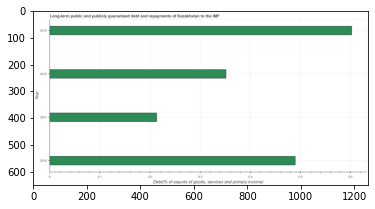

Number of QA =  23





,Year,"Debt(% of exports of goods, services and primary income)"
0,2012,0.351782
1,2011,0.216835
2,2013,0.599891
3,2010,0.488568


> what is the title of the graph ?
PREDICTED =  Long-term public and publicly guaranteed debt and repayments of Kazakhstan to the IMF
EXPECTED =  Long-term public and publicly guaranteed debt and repayments of Kazakhstan to the IMF




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Debt(% of exports of goods, services and primary income)
EXPECTED =  Debt(% of exports of goods, services and primary income)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the debt service in 2011 and 2013 ?
PREDICTED =  -0.3830563223636604
EXPECTED =  -0.389




				 4 / 4 = 1.0


> what is the median debt service ?
PREDICTED =  None
EXPECTED =  0.4206585314886175




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: Fals

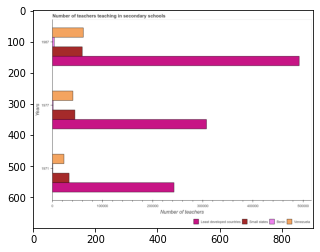

Number of QA =  30





,Years,Least developed countries,Venezuela,Smail states,Benin
0,1971,243975.614365,24151.535384,34626.998717,NaN
1,1987,494408.074151,62568.951382,61163.795760,4952.64889
2,1977,310267.568291,41938.079673,46189.827305,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of teachers teaching in secondary schools in venezuela in 1971 and that in 1987 ?
PREDICTED =  -38417.415998677694
EXPECTED =  -38688.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of teachers teaching in secondary schools in venezuela in 1987 and the number of teachers teaching in secondary schools in least developed countries in 1977 ?
PREDICTED =  20630.87170979267
EXPECTED =  -245653.3125




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1977, what is the difference between the number of teachers teaching in secondary schools in venezuela

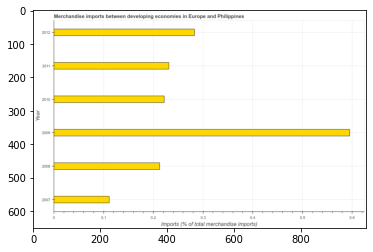

Number of QA =  23





,Year,Imports (% of total merchandise imports)
0,2008,0.213255
1,2012,0.282008
2,2007,0.112679
3,2009,0.594585
4,2010,0.221213
5,2011,0.233243


> what is the title of the graph ?
PREDICTED =  Merchandise imports between developing economies in Europe and Philippines
EXPECTED =  Merchandise imports between developing economies in Europe and Philippines




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Imports (% of total merchandise imports)
EXPECTED =  Imports (% of total merchandise imports)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in 2009 and 2010 ?
PREDICTED =  0.37337233744419734
EXPECTED =  0.373




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median merchandise imports ?
PREDICTED =  0.227228093426142

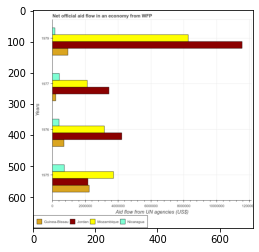

Number of QA =  30





,Years,Nicaragua,Mozambique,Jordan,Guinea-Bissau
0,1979,172010.511240,8.216232e+06,1.153733e+07,9.629261e+05
1,1976,422480.359244,3.154899e+06,4.233144e+06,7.223446e+05
2,1977,435064.661958,2.126386e+06,3.458910e+06,2.292565e+05
3,1975,740064.329699,3.718062e+06,2.149162e+06,2.269638e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in mozambique in 1977 and that in 1979 ?
PREDICTED =  -6089845.854020635
EXPECTED =  -6150000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in jordan in 1975 and the net official aid flow in mozambique in 1976 ?
PREDICTED =  -2083981.4831837825
EXPECTED =  -1000000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1975, what is the difference between the net official aid flow in jordan and net official aid flow in guinea-bissau ?
PREDICTED =  10491285.52795474
EXPECTED =  -80000.0




				 1 / 3 = 0.3333


is_

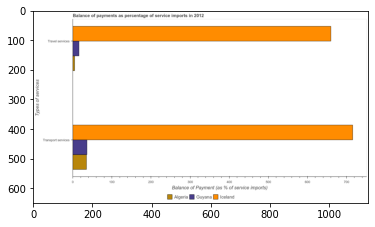

Number of QA =  23





,Types of services,Iceland,Algeria,Guyana
0,Transport services,717.923846,36.218848,38.018014
1,Travel services,667.042609,5.743352,17.131212


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of travel services in iceland and that in algeria ?
PREDICTED =  661.2992572032409
EXPECTED =  655.3782381306542




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services in guyana and the balance of payments of travel services in algeria ?
PREDICTED =  -3.9441864430609357
EXPECTED =  31.477367143838833




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services and balance of payments of travel services in iceland ?
PREDICTED =  -667.04260906423
EXPECTE

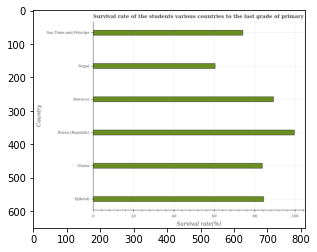

Number of QA =  22





,Country,Survival rate(%)
0,Morocco,90.746515
1,Djibouti,85.505609
2,Ghana,84.547100
3,Nepal,61.391500
4,Korea (Republic),100.715743
5,Sao Tome and Principe,75.018314


> what is the title of the graph ?
PREDICTED =  Survival rate of the students various countries to the last grade of primary :
EXPECTED =  Survival rate of the students various countries to the last grade of primary education




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Survival rate(%)
EXPECTED =  Survival rate(%)




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the survival rate in primary education in nepal and sao tome and principe ?
PREDICTED =  -13.6268140668246
EXPECTED =  -13.714




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median survival rate in primary education ?
PRED

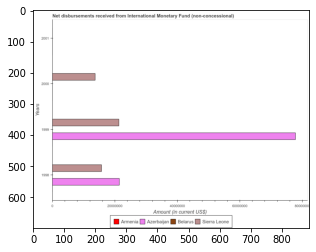

Number of QA =  24





,Years,Azerbaijan,Belarus,Sierra Leone,Armenia
0,2000,NaN,NaN,1.399707e+07,NaN
1,2001,NaN,NaN,NaN,NaN
2,1998,2.161416e+07,NaN,1.612005e+07,NaN
3,1999,7.783044e+07,NaN,2.143866e+07,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from international monetary fund in sierra leone in 1998 and that in 1999 ?
PREDICTED =  -5318600.689059449
EXPECTED =  -5559000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from international monetary fund in armenia in 1998 and the amount of disbursements received from international monetary fund in sierra leone in 2001 ?
PREDICTED =  0.0
EXPECTED =  0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the amount of disbursements received from internatio

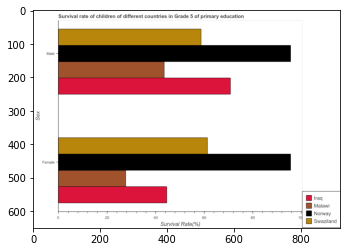

Number of QA =  23





,Sex,Malawi,Norway,lraq,Swaziland
0,Female,27.689951,94.238191,44.761641,61.650714
1,Male,43.848007,94.224041,70.914670,58.568388


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the survival rate of female students in primary education in malawi and that in norway ?
PREDICTED =  -66.54823978807764
EXPECTED =  -67.85171999999999




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the survival rate of female students in primary education in iraq and the survival rate of male students in primary education in malawi ?
PREDICTED =  0.9136339006717265
EXPECTED =  1.0624099999999999




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the survival rate of female students in primary education and survival rate of male students in primary

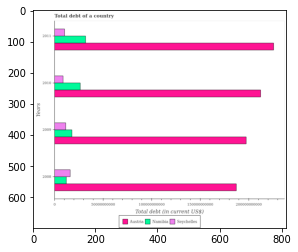

Number of QA =  29





,Years,Seychelles,Austria,Namibia
0,2011,1.965767e+10,4.092928e+11,5.904519e+10
1,2009,2.204705e+10,3.573944e+11,3.439019e+10
2,2010,1.721127e+10,3.846697e+11,4.882263e+10
3,2008,3.032579e+10,3.391760e+11,2.296748e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the debt in austria in 2009 and that in 2010 ?
PREDICTED =  -27275332544.13867
EXPECTED =  -14872780000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the debt in namibia in 2011 and the debt in seychelles in 2008 ?
PREDICTED =  36077713506.14517
EXPECTED =  15849216748.5034




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the debt in austria and debt in seychelles ?
PREDICTED =  372633232300.84467
EXPECTED =  203478358417.06012




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predic

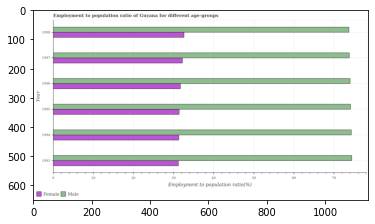

Number of QA =  28





,Year,Female,Male
0,1996,NaN,74.592060
1,1995,NaN,74.844048
2,1994,NaN,75.721169
3,1993,31.495926,75.155619
4,1997,32.233016,75.294637
5,1998,33.091522,75.264856


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum employment to population ratio(male) ?
PREDICTED =  26.38628037541749
EXPECTED =  74.4000015258789




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum employment to population ratio(female) ?
PREDICTED =  63.373276377547135
EXPECTED =  31.2000007629395




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fin

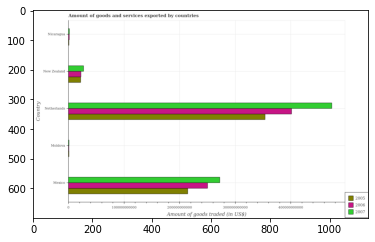

Number of QA =  29





,Country,2007,2005,2006
0,Moldova,NaN,NaN,NaN
1,Mexico,2.739101e+11,2.151259e+11,NaN
2,Nicaragua,2.864743e+09,NaN,NaN
3,New Zealand,2.825067e+10,2.302027e+10,2.359459e+10
4,Netherlands,4.741074e+11,3.552128e+11,4.043861e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount of goods and services exported in 2007 in netherlands and that in nicaragua ?
PREDICTED =  -476972173582.32227
EXPECTED =  472122100000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount of goods and services exported in 2007 in netherlands and the total amount of goods and services exported in 2006 in mexico?
PREDICTED =  -748017562491.1655
EXPECTED =  223557000000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount of goods and services exported in 2006 and total amount of goods and services expor

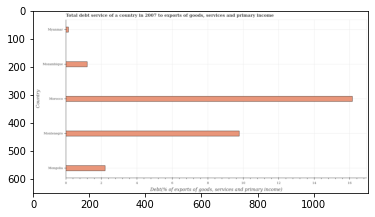

Number of QA =  22





,Country,"Debt(% of exports of goods, services and primary income)"
0,Myanmar,0.177038
1,Morocco,16.237801
2,Mozambique,1.240166
3,Mongolia,2.260631
4,Montenegro,9.886421


> what is the title of the graph ?
PREDICTED =  Total debt service of a country in 2007 to exports of goods, services and primary income
EXPECTED =  Total debt service of a country in 2007 to exports of goods, services and primary income




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Debt(% of exports of goods, services and primary income)
EXPECTED =  Debt(% of exports of goods, services and primary income)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt service in montenegro and mozambique ?
PREDICTED =  8.646254557826342
EXPECTED =  8.57




				 4 / 4 = 1.0


> what is the median total debt service ?
PREDICTED =  None
EXPECTED =  2.21248596918854




				 4 / 6 = 0.6667


is_built_with_cud

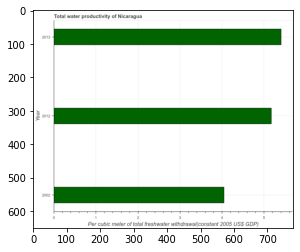

Number of QA =  23





,Year,Per cubic meter of total freshwater withdrawal(constant 2005 US$ GDP)
0,2013,5.484146
1,2002,4.076629
2,2012,5.261272


> what is the title of the graph ?
PREDICTED =  Total water productivity of Nicaragua
EXPECTED =  Total water productivity of Nicaragua




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Per cubic meter of total freshwater withdrawal(constant 2005 US$ GDP)
EXPECTED =  Per cubic meter of total freshwater withdrawal(constant 2005 US$ GDP)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total water productivity in 2002 and 2012 ?
PREDICTED =  -1.1846422492155684
EXPECTED =  -1.127




				 3 / 4 = 0.75


> what is the median total water productivity ?
PREDICTED =  None
EXPECTED =  5.17150622894871




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation f

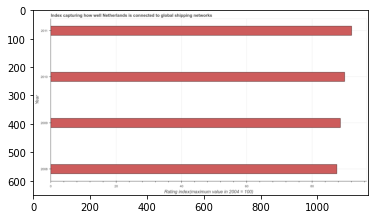

Number of QA =  23





,Year,Rating index(maximum value in 2004 = 100)
0,2011,92.246044
1,2008,87.523870
2,2010,90.236334
3,2009,88.906037


> what is the title of the graph ?
PREDICTED =  Index capturing how well Netherlands is connected to global shipping networks
EXPECTED =  Index capturing how well Netherlands is connected to global shipping networks




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Rating index(maximum value in 2004 = 100)
EXPECTED =  Rating index(maximum value in 2004 = 100)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the liner shipping connectivity index in 2009 and 2011 ?
PREDICTED =  -3.3400078724652786
EXPECTED =  -3.44




				 4 / 4 = 1.0


> what is the median liner shipping connectivity index ?
PREDICTED =  None
EXPECTED =  89.31




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Trainin

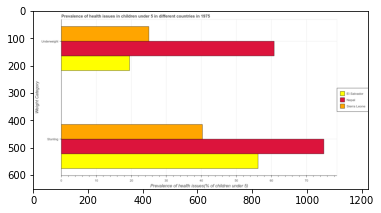

Number of QA =  23





,Weight Category,El Salvador,Sierra Leone,Nepal
0,Underweight,19.345565,25.224624,61.476740
1,Stunting,56.846714,40.624397,75.389747


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of stunted children in el salvador and that in sierra leone ?
PREDICTED =  16.222317200454853
EXPECTED =  15.900001525879006




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of stunted children in el salvador and the percentage of underweight children in nepal ?
PREDICTED =  -4.6300257589757265
EXPECTED =  -4.599998474120994




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of stunted children and percentage of underweight children in nepal ?
PREDICTED =  -4.6300257589757265
EXPECTED =  14.200000762939503

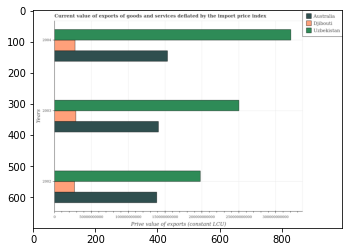

Number of QA =  29





,Years,Uzbekistan,Australia,Djibouti
0,2004,5.791221e+11,2.801332e+11,5.115853e+10
1,2002,3.603327e+11,2.500154e+11,5.010293e+10
2,2003,4.485980e+11,2.569981e+11,5.277735e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the prive value of exports in uzbekistan in 2002 and that in 2004 ?
PREDICTED =  -218789339701.4522
EXPECTED =  -122695000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the prive value of exports in uzbekistan in 2003 and the prive value of exports in australia in 2002 ?
PREDICTED =  88265296934.15588
EXPECTED =  111438971116.02399




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the prive value of exports in djibouti and prive value of exports in australia ?
PREDICTED =  1999.0
EXPECTED =  -125373653293.8681




				 0 / 

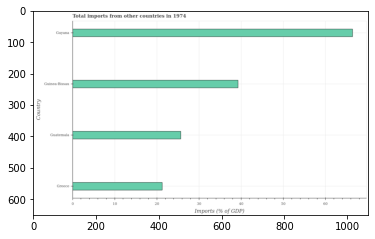

Number of QA =  22





,Country,Imports (% of GDP)
0,Guatemala,25.902472
1,Guinea-Bissau,39.339831
2,Guyana,66.705457
3,Greece,21.506059


> what is the title of the graph ?
PREDICTED =  Total imports from other countries in 1974
EXPECTED =  Total imports from other countries in 1974




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Imports (% of GDP)
EXPECTED =  Imports (% of GDP)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports in greece and guinea-bissau ?
PREDICTED =  -17.833772124824133
EXPECTED =  -17.987




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total imports ?
PREDICTED =  32.6211515277966
EXPECTED =  32.456730259295654




				 5 / 5 = 1.0


is_built_with_cuda: True
is_gpu_available: Fals

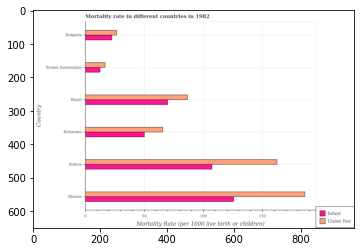

Number of QA =  28





,Country,Infant,Under five
0,Botswana,91.481538,120.498358
1,Bulgaria,41.886428,48.966840
2,Bhutan,227.713550,334.440171
3,Brazil,126.189288,156.931452
4,Bolivia,193.989293,294.292098
5,Brunei Darussalam,23.649263,30.955400


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the infant mortality rate in brazil and that in brunei darussalam ?
PREDICTED =  102.54002572622167
EXPECTED =  57.2




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the infant mortality rate in bulgaria and the under-5 mortality rate in bhutan ?
PREDICTED =  -185.8271219772276
EXPECTED =  -163.4




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the infant mortality rate and under-5 mortality rate in brunei darussalam ?
PREDICTED =  -7.30613761211616
EXPECTED =  -4.3




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Tr

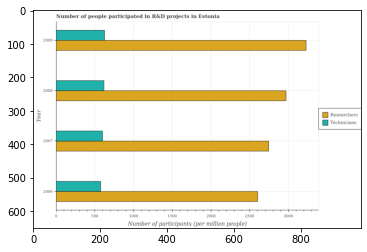

Number of QA =  28





,Year,Technicians,Researchers
0,2006,1052.126220,4724.511861
1,2009,1145.400594,5874.567083
2,2007,1107.461597,5006.383645
3,2008,1137.339709,5413.315463


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of researchers in 2008 and that in 2009 ?
PREDICTED =  -461.2516204549647
EXPECTED =  -259.477




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of technicians in 2007 and the number of researchers in 2008 ?
PREDICTED =  -4305.853865958449
EXPECTED =  -2370.67922




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the number of technicians and number of researchers ?
PREDICTED =  -4729.166489300133
EXPECTED =  -2603.268




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or p

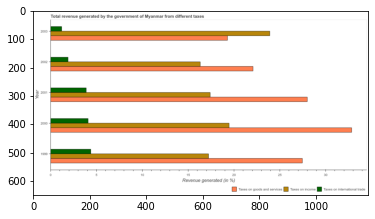

Number of QA =  29





,Year,Taxes on intemational trade,Taxes on income,Taxes on goods and services
0,2001,3.967477,17.691952,28.007400
1,2000,4.201377,19.408812,33.928695
2,1999,4.426725,NaN,NaN
3,2002,1.981742,16.414111,21.868136
4,2003,1.280439,23.900912,19.239174


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue generated by taxes on income in 2000 and that in 2002 ?
PREDICTED =  2.9947007018160683
EXPECTED =  3.147




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue generated by tax on international trade in 2003 and the percentage of revenue generated by taxes on goods and services in 2002 ?
PREDICTED =  1.2804389456071912
EXPECTED =  -20.879949244744438




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after tra

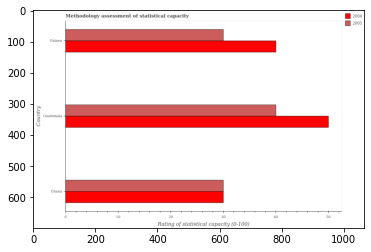

Number of QA =  28





,Country,2005,2004
0,Ghana,30.313772,30.193862
1,Guinea,30.218765,40.426764
2,Guatemala,40.041293,50.523815


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in 2005 in guatemala and that in guinea ?
PREDICTED =  9.822528299774184
EXPECTED =  10.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in 2004 in guinea and the rating of statistical capacity in 2005 in guatemala?
PREDICTED =  -10.097051825907315
EXPECTED =  0.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the rating of statist

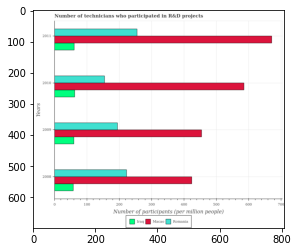

Number of QA =  29





,Years,Unnamed: 1,Macaa,Romania
0,2011,63.692622,680.635885,260.047048
1,2009,63.164927,457.889896,198.425251
2,2010,64.879167,589.639194,158.109431
3,2008,60.802438,428.323740,225.442750


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of technicians who participated in r&d projects in iraq in 2008 and that in 2010 ?
PREDICTED =  0.0
EXPECTED =  -4.374429999999997




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of technicians who participated in r&d projects in iraq in 2010 and the number of technicians who participated in r&d projects in romania in 2008 ?
PREDICTED =  0.0
EXPECTED =  -160.31324




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the number of technicians who participated in r&d projects in iraq and number of technicians who 

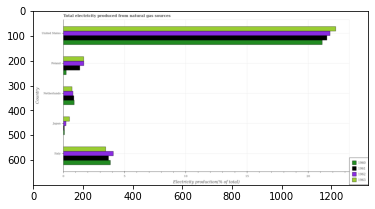

Number of QA =  30





,Country,1963,1962,1961,1960
0,Japan,0.526843,0.252359,0.115496,0.114123
1,United States,22.287227,21.680233,21.762528,21.160672
2,Poland,1.690972,1.689194,NaN,0.259962
3,Netherlands,0.741831,0.806559,NaN,0.923799
4,Italy,3.497671,4.160064,3.722107,3.865935


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced in 1960 in italy and that in japan ?
PREDICTED =  3.751811213259768
EXPECTED =  3.7516053036681734




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced in 1961 in poland and the total electricity produced in 1962 in netherlands?
PREDICTED =  0.0
EXPECTED =  0.5557384791936392




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced in 1961 and total electricity produced in 1962 in poland ?
PREDICTED =  23.91093652010442
EXPECTED =  -0.33124066952892006




				 1 / 3 =

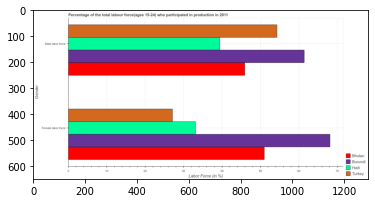

Number of QA =  23





,Gender,Turkey,Bhutan,Burundi,Haiti
0,Female labor force,27.164190,51.235845,68.758320,33.644074
1,Male labor force,54.629336,46.108328,61.793602,39.509114


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labour force in turkey and that in bhutan ?
PREDICTED =  8.521008425038147
EXPECTED =  8.399997711181598




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of female labor force in turkey to that in haiti ?
PREDICTED =  0.8073989552576175
EXPECTED =  0.818731167092275




				 2 / 4 = 0.5


> what is the difference between two consecutive major ticks on t

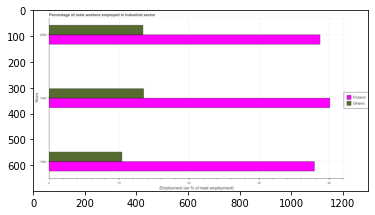

Number of QA =  28





,Years,Finland,Ghana
0,2006,39.023502,13.570306
1,1999,40.672875,13.720676
2,1992,38.590275,10.582377


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers employed in industrial sector in ghana in 1992 and that in 2006 ?
PREDICTED =  -2.987928498538773
EXPECTED =  -3.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers employed in industrial sector in ghana in 2006 and the percentage of male workers employed in industrial sector in finland in 1992 ?
PREDICTED =  2.987928498538773
EXPECTED =  -24.500001907348597




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percentage of male workers employed in industrial sector in f

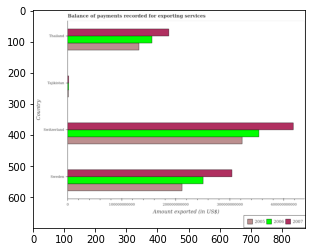

Number of QA =  29





,Country,2007,2005,2006
0,Thailand,1.888526e+11,1.333728e+11,1.536419e+11
1,Tajikistan,2.988423e+09,NaN,2.992715e+09
2,Switzerland,4.205853e+11,3.205663e+11,NaN
3,Sweden,3.050569e+11,2.135469e+11,2.502039e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount exported in 2005 in tajikistan and that in thailand ?
PREDICTED =  -133372759529.52672
EXPECTED =  -130479755342.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount exported in 2007 in switzerland and the amount exported in 2006 in sweden?
PREDICTED =  115528373311.29303
EXPECTED =  166900911979.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount exported in 2007 and amount exported in 2006 in switzerland ?
PREDICTED =  188848283364.09302
EXPECTED =  63696000000.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_

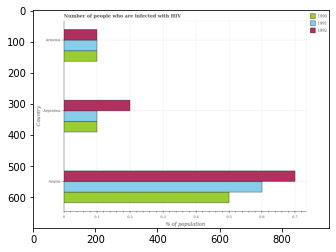

Number of QA =  29





,Country,1992,1990,1991
0,Angola,0.705135,0.505251,0.602431
1,Argentina,0.199816,0.101707,0.101239
2,Armenia,0.101084,0.101381,0.101124


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected population in in 1990 in argentina and that in armenia ?
PREDICTED =  0.0003259418705355288
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected population in in 1991 in argentina and the percentage of hiv infected population in in 1990 in angola?
PREDICTED =  -0.5011925816366662
EXPECTED =  -0.4




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected population in in 1991 and percentage of hiv infected population in in 1990 in armenia ?
PREDICTED =  -

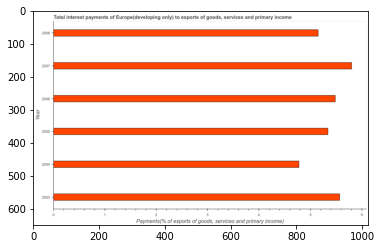

Number of QA =  23





,Year,"Payments(% of exports of goods, services and primary income)"
0,2004,4.781214
1,2008,5.153052
2,2005,5.368780
3,2006,5.497479
4,2007,5.824641
5,2003,5.600766


> what is the title of the graph ?
PREDICTED =  Total interest payments of Europe(developing only) to exports of goods, services and primary income
EXPECTED =  Total interest payments of Europe(developing only) to exports of goods, services and primary income




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Payments(% of exports of goods, services and primary income)
EXPECTED =  Payments(% of exports of goods, services and primary income)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total interest payments on external debt in 2003 and 2006 ?
PREDICTED =  0.10328728757532168
EXPECTED =  0.084




				 3 / 4 = 0.75


> what is the median total interest payments on external debt ?
PREDICTED =  None
EXPECTED =  

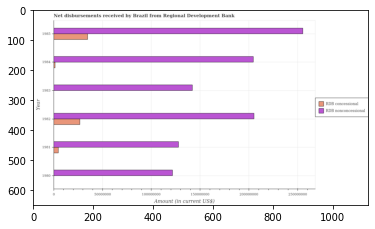

Number of QA =  25





,Year,RDB nonconcessional,RDB concessional
0,1980,NaN,NaN
1,1983,2.562012e+08,NaN
2,1984,NaN,3.546279e+06
3,1985,4.587768e+08,6.384611e+07
4,1981,2.309083e+08,9.722719e+06
5,1982,3.700174e+08,4.913354e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net concessional disbursements from rdb in 1981 and that in 1982 ?
PREDICTED =  -39410823.66604203
EXPECTED =  -22049000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net non concessional disbursements from rdb in 1983 and the net concessional disbursements from rdb in 1982 ?
PREDICTED =  -113816224.76343474
EXPECTED =  115233000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net non conces

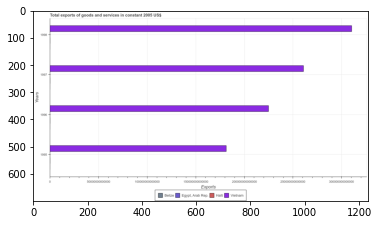

Number of QA =  30





,Years,"Egypt, Arab Rep.",Belize,Haiti,Vietnam
0,1995,NaN,NaN,NaN,3.271008e+14
1,1997,NaN,NaN,NaN,4.686906e+14
2,1998,NaN,NaN,NaN,5.571158e+14
3,1996,NaN,NaN,NaN,4.052126e+14


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total exports of goods and services in haiti in 1996 and that in 1997 ?
PREDICTED =  4.0
EXPECTED =  -241000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total exports of goods and services in vietnam in 1995 to that in 1996 ?
PREDICTED =  0.8072326119370651
EXPECTED =  0.806451612903441




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training

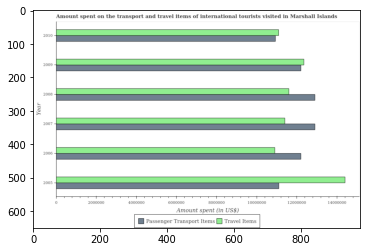

Number of QA =  28





,Year,Travel Items,Passenger Transport Items
0,2009,1.244752e+07,1.231137e+07
1,2008,1.170338e+07,1.297558e+07
2,2010,1.118660e+07,1.107433e+07
3,2005,1.455089e+07,1.118945e+07
4,2006,1.101399e+07,1.225484e+07
5,2007,1.147332e+07,1.306876e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on passenger transport items in 2007 and that in 2009 ?
PREDICTED =  757396.7199089006
EXPECTED =  700000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on passenger transport items in 2009 and the amount spent in travel items in 2007 ?
PREDICTED =  -757396.7199089006
EXPECTED =  800000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the amount spent in travel items and amount spent on passenger transport items ?
PREDICTED =  3077574.0935463775
EXPECTED =  3300000




				 0 / 3 = 0.0


is_buil

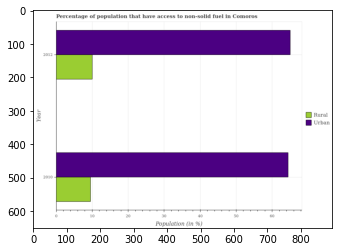

Number of QA =  25





,Year,Urban,Rural
0,2010,65.709404,9.829357
1,2012,65.975973,10.310956


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population in 2010 and that in 2012 ?
PREDICTED =  -0.26656921412715917
EXPECTED =  -0.597




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population in 2010 and the urban population in 2012 ?
PREDICTED =  -0.48159875680878983
EXPECTED =  -55.4840422951419




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the rural population and urban population ?
PREDICTED =  -55.53173309626294
EXPECTED =  -54.978




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Ev

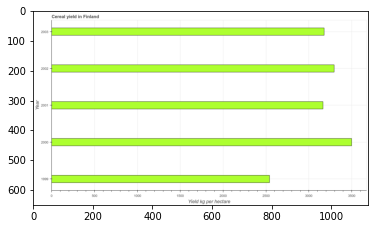

Number of QA =  23





,Year,Yield kg per hectare
0,2000,41322.299656
1,1999,29926.153563
2,2002,38800.402549
3,2003,37438.152890
4,2001,37259.323591


> what is the title of the graph ?
PREDICTED =  Cereal yield in Finland
EXPECTED =  Cereal yield in Finland




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Yield kg per hectare
EXPECTED =  Yield kg per hectare




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cereal yield in 1999 and 2001 ?
PREDICTED =  -7333.170028362409
EXPECTED =  -623.186




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median cereal yield ?
PREDICTED =  2001.0
EXPECTED =  3177.97




				 3 / 5 = 0.6


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training 

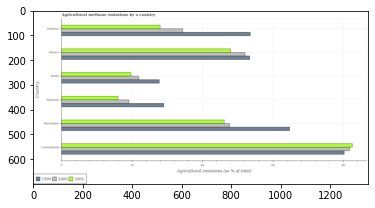

Number of QA =  29





,Country,2005,2000,1990
0,Mexico,48.066087,50.763438,54.102041
1,Moldova,NaN,34.726675,53.463010
2,Macedonia,46.511466,48.209016,64.429649
3,Luxembourg,83.450519,82.471839,80.610006
4,Malta,NaN,NaN,27.754695
5,Malaysia,NaN,19.388408,28.951497


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of agricultural methane emitted in 2000 in luxembourg and that in malaysia ?
PREDICTED =  63.083431740714104
EXPECTED =  62.6618330873433




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of agricultural methane emitted in 2005 in moldova and the amount of agricultural methane emitted in 1990 in malaysia?
PREDICTED =  0.0
EXPECTED =  -1.0317136114984002




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of agricultural methane emitted in 2000 and amount of agricultural methane emitted in 1990 in macedonia ?
PREDICTED =

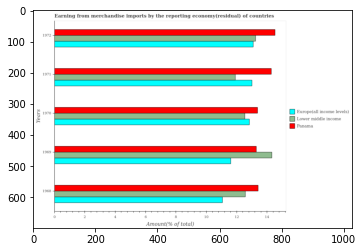

Number of QA =  29





,Years,Europe(all income levels),Panama,Lower middle income
0,1971,13.184073,14.532580,12.092046
1,1970,12.953980,13.617436,12.700124
2,1972,13.229416,14.721737,13.333282
3,1969,NaN,13.464785,14.455151
4,1968,11.149495,13.634480,12.717082


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in lower middle income in 1970 and that in 1972 ?
PREDICTED =  -0.633157736751846
EXPECTED =  -0.7070967741942003




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in panama in 1970 and the percentage of amount earned from merchandise imports in lower middle income in 1969 ?
PREDICTED =  -1.5011710308814514
EXPECTED =  -0.9415474321685995




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1972, what is the difference between the percentage of amount earned f

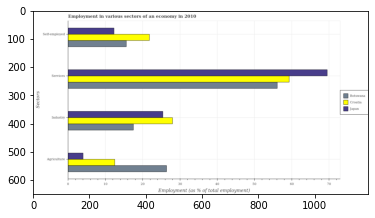

Number of QA =  29





,Sectors,Japan,Botswana,Croatia
0,Services,69.096405,56.408966,59.530836
1,Industry,25.799049,17.665817,27.962942
2,Agriculture,4.183679,26.687946,12.714985
3,Self-employed,12.438328,15.773817,21.894081


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of workers in services in japan and that in botswana ?
PREDICTED =  12.687439077894567
EXPECTED =  13.4000015258789




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self employed workers in croatia and the percentage of workers in services in japan ?
PREDICTED =  9.455753179035051
EXPECTED =  -47.700000762939496




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of workers in industry and percentage of workers in services in botswana ?
PREDICTED =  -38.7431494847482
EXPECTED =  -38.5999984741211




			

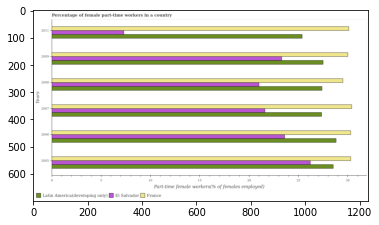

Number of QA =  29





,Years,Latin America(developing only),El Salvador,France
0,2006,28.187146,23.871090,24.827560
1,2011,25.469781,7.277964,NaN
2,2008,26.956280,NaN,29.512918
3,2005,28.137873,26.306815,30.658249
4,2007,27.442228,21.464971,31.090952
5,2009,27.792258,23.512159,29.937346


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female part-time workers in latin america(developing only) in 2006 and that in 2011 ?
PREDICTED =  2.7173642403730227
EXPECTED =  3.4429377169577897




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female part-time workers in france in 2005 and the percentage of female part-time workers in el salvador in 2007 ?
PREDICTED =  -0.4327028163925668
EXPECTED =  8.69999885559081




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the percentage of female part-time workers in france and percentage of femal

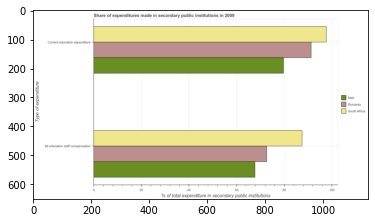

Number of QA =  23





,Type of expenditure,Mali,South Africa,Romania
0,Current education expenditure,81.055906,97.816877,92.228909
1,All education staff compensation,68.499240,88.259264,73.168369


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  % of total expenditure in secondary public institutions
EXPECTED =  20.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Share of expenditures made in secondary public institutions in 2009
EXPECTED =  Share of expenditures made in secondary public institutions in 2009




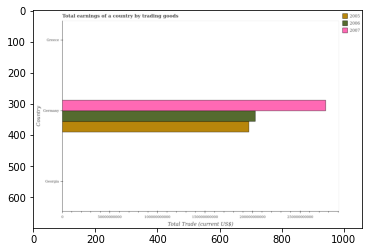

Number of QA =  20





,Country,2007,2005,2006
0,Greece,NaN,NaN,NaN
1,Georgia,NaN,NaN,NaN
2,Germany,5.062286e+11,3.579250e+11,3.685934e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total earnings in 2005 in greece and the total earnings in 2007 in georgia?
PREDICTED =  0.0
EXPECTED =  0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total earnings in 2006 and total earnings in 2007 in germany ?
PREDICTED =  368593444802.0007
EXPECTED =  -73971000000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Total Trade (current US$)
EXPECTED =  50000000000.0




				 1 / 4 = 0.25


> what is the title of the graph ?
PREDICTED =  Total earnings 

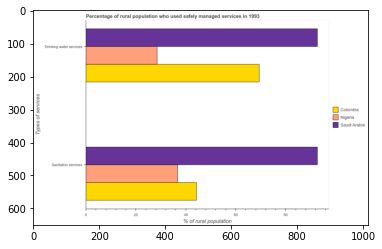

Number of QA =  23





,Types of services,Nigeria,Saudi Arabia,Colombia
0,Sanitation services,37.218078,93.548042,44.822612
1,Drinking water services,28.578884,93.389462,70.029650


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population who used drinking water services in saudi arabia and that in colombia ?
PREDICTED =  0.0
EXPECTED =  23.299999999999997




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population who used drinking water services in nigeria and the percentage of rural population who used sanitation services in colombia ?
PREDICTED =  -41.45076689176571
EXPECTED =  -15.799999999999997




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population who used sanitation services and percenta

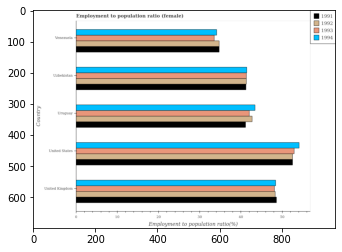

Number of QA =  30





,Country,1992,1993,1994,1991
0,Uzbekistan,41.898852,NaN,41.904334,NaN
1,Venezuela,34.819977,NaN,34.517577,34.970994
2,United Kingdom,48.844644,48.676045,48.987142,49.115977
3,United States,53.140969,53.510088,54.661790,53.114636
4,Uruguay,NaN,NaN,43.760995,41.859616


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the total employment to population ratio in 1992 in the graph ?
PREDICTED =  0.02797915

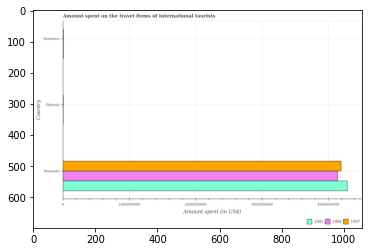

Number of QA =  29





,Country,1996,1997,1995
0,Djibouti,NaN,NaN,NaN
1,Dominica,NaN,NaN,NaN
2,Denmark,4.134837e+09,4.243079e+09,4.316386e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the travel items of international tourists in 1996 and amount spent on the travel items of international tourists in 1997 in dominica ?
PREDICTED =  1.0
EXPECTED =  0.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference be

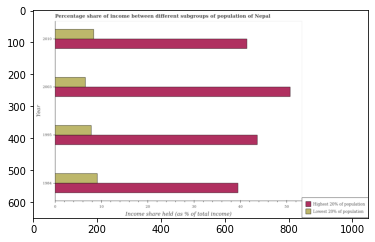

Number of QA =  28





,Year,Lowest 20% of population,Highest 20% of population
0,2010,8.550118,41.559257
1,2003,6.685689,51.064206
2,1984,9.204102,40.003641
3,1995,7.930271,43.994690


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by highest 20% of the population in 1995 and that in 2003 ?
PREDICTED =  1.244581514590391
EXPECTED =  -7.1




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income share held by highest 20% of the population in 2010 and the income share held by lowest 20% of the population in 1995 ?
PREDICTED =  -35.4445714444103
EXPECTED =  33.6




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the income share held by lowest 20% of the population and income share held by highest 20% of the population ?
PREDICTED =  -6.68

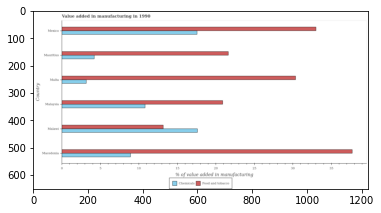

Number of QA =  28





,Country,Food and tobacco,Chemicals
0,Mexico,32.957216,17.540918
1,Malawi,NaN,17.574550
2,Mauritius,21.656708,4.281438
3,Malta,30.314652,3.252225
4,Macedonia,37.903862,8.973187
5,Malaysia,20.925863,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing food and tobacco in malawi and that in malta ?
PREDICTED =  113.44364948694184
EXPECTED =  -17.197




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by  manufacturing chemicals in mexico and the value added by manufacturing food and tobacco in mauritius ?
PREDICTED =  13.25948007078453
EXPECTED =  -4.061356333395899




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing food and tobacco and value added by  manufacturing chemicals in macedonia ?
PREDICTED =  105.8544390498970

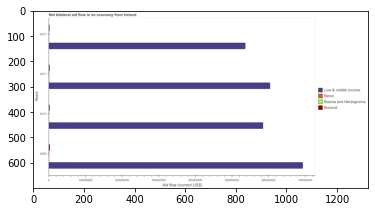

Number of QA =  30





,Years,Low & middle income,Bosnia and Herzegovina,Burundi,Benin
0,2012,5.286515e+08,NaN,NaN,NaN
1,2009,6.893313e+08,NaN,3.130858e+06,NaN
2,2010,5.810192e+08,NaN,NaN,NaN
3,2011,6.005540e+08,NaN,2.709974e+06,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in burundi in 2010 and that in 2011 ?
PREDICTED =  -2709973.6238864795
EXPECTED =  -80000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in benin in 2009 and the net bilateral aid flow in bosnia and herzegovina in 2012 ?
PREDICTED =  689331290.0391213
EXPECTED =  -110000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net bilateral aid flow in

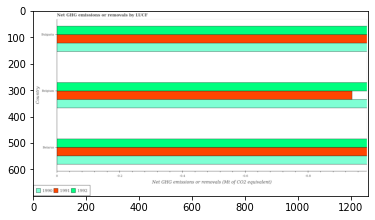

Number of QA =  16





,Country,1992,1990,1991
0,Belarus,0.992978,0.992978,0.989894
1,Belgium,0.985831,0.988804,0.946377
2,Bulgaria,0.986096,0.988452,0.988816


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net ghg emissions or removals by lucf in 1990 in belarus and the net ghg emissions or removals by lucf in 1991 in bulgaria?
PREDICTED =  0.004525283007460801
EXPECTED =  0




				 0 / 1 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Net GHG emissions or removals (Mt of CO2 equivalent)
EXPECTED =  0.20000000000000007




				 0 / 2 = 0.0


> what is the title of the graph ?
PREDICTED =  Net GHG emissions or removals by LUCF
EXPECTED =  Net GHG emissions or removals by LUCF




				 1 / 3 = 0.3333


> what is the label or title of the x-axis ?
PREDICTED =  Net GHG emissions or removals (Mt of CO2 equivalent)
EXPECTED =  Net GHG emissions or removals (Mt of CO2 equivalent)




				 2 / 4 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =

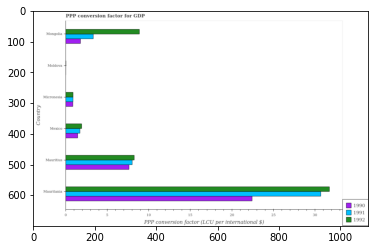

Number of QA =  29





,Country,1992,1990,1991
0,Moldova,NaN,NaN,NaN
1,Mexico,1.968577,1.497348,1.792288
2,Mongolia,9.009769,1.850963,3.389480
3,Mauritius,NaN,7.724381,8.119998
4,Micronesia,0.956432,0.930124,0.940205
5,Mauritania,31.821593,22.584042,31.206488


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ppp conversion factor for gdp in 1991 in mauritius and that in moldova ?
PREDICTED =  8.11999813052299
EXPECTED =  7.999615284441915




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ppp conversion factor for gdp in 1991 in moldova and the ppp conversion factor for gdp in 1990 in micronesia?
PREDICTED =  -0.9402054795140626
EXPECTED =  -0.8537096637980087




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ppp conversion factor for gdp in 1992 and ppp conversion factor for gdp in 1991 in mauritania ?
PREDICTED =  -27.206487979217574
EXPECTE

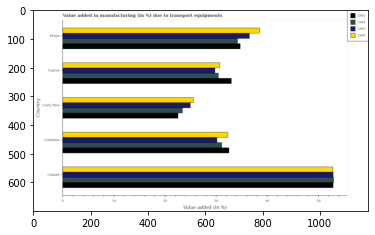

Number of QA =  30





,Country,1963,1966,1964,1965
0,Cyprus,33.028169,30.726831,30.647367,29.931551
1,Canada,52.771517,52.725286,53.115321,52.895032
2,Colombia,32.703390,32.393312,31.163362,30.199323
3,Kenya,34.735287,38.736938,34.284342,36.533028
4,Costa Rica,NaN,NaN,23.479475,24.954448


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of value added in manufacturing due to transport equipments in 1963 in canada and that in kenya ?
PREDICTED =  18.036229872530306
EXPECTED =  18.172821811965512




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of value added in manufacturing due to transport equipments in 1965 in costa rica and the percentage of value added in manufacturing due to transport equipments in 1963 in canada?
PREDICTED =  -27.817068504289427
EXPECTED =  -27.922130529330012




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of va

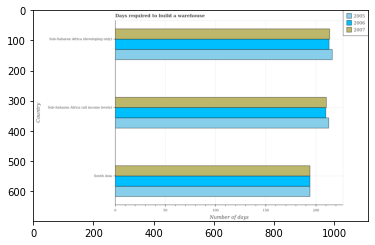

Number of QA =  29





,Country,2007,2005,2006
0,South Asia,353.924817,352.662301,352.284761
1,Sub-Saharan Africa (developing only),388.374784,392.967451,387.209075
2,Sub-Saharan Africa (all income levels),384.225882,386.034973,379.973158


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the days required to build a warehouse in in 2005 in south asia and that in sub-saharan africa (developing only) ?
PREDICTED =  -40.30514913364141
EXPECTED =  -22.243902439023998




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the days required to build a warehouse in in 2007 in south asia and the days required to build a warehouse in in 2006 in sub-saharan africa (all income levels)?
PREDICTED =  -30.301064618358566
EXPECTED =  -15.795454545454987




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the days required to build a warehouse in in 2006 a

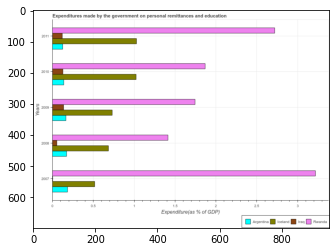

Number of QA =  30





,Years,Iceland,Rwanda,Iraq,Argentina
0,2009,0.730870,NaN,0.141782,0.169389
1,2007,0.526303,3.268613,NaN,0.189495
2,2010,1.033663,NaN,0.137143,0.146418
3,2008,0.693928,NaN,0.060752,0.177319
4,2011,1.031666,2.721827,0.125563,0.134770


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditures made by the government on personal remittances and education in argentina in 2007 and that in 2011 ?
PREDICTED =  4.86523045321233
EXPECTED =  0.05908744955961098




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditures made by the government on personal remittances and education in iraq in 2010 and the expenditures made by the government on personal remittances and education in argentina in 2007 ?
PREDICTED =  4.862857304287945
EXPECTED =  -0.05658168487236098




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference bet

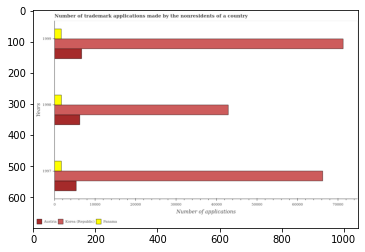

Number of QA =  29





,Years,Korea (Republic),Panama,Austria
0,1999,71138.516297,1831.174774,6854.323163
1,1997,66312.694766,1852.769475,5475.632376
2,1998,43215.792908,1846.698133,6332.407527


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by the nonresidents in korea (republic) in 1998 and that in 1999 ?
PREDICTED =  0.0
EXPECTED =  -28361




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by the nonresidents in korea (republic) in 1998 and the number of trademark applications made by the nonresidents in austria in 1997 ?
PREDICTED =  0.0
EXPECTED =  37531




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the number of trademark applications made by the nonresidents in korea (republic)

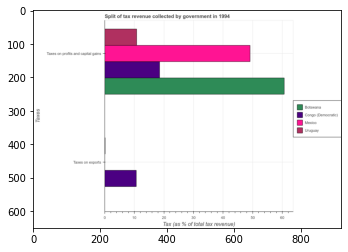

Number of QA =  23





,Taxes,Uruguay,Botswana,Mexica,Congo (Democratic)
0,Taxes on exports,NaN,NaN,NaN,10.982307
1,Taxes on profits and capital gains,11.006937,61.105828,49.793816,18.739616


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue obtained from taxes on profits and capital gains in mexico and that in congo (democratic) ?
PREDICTED =  -17.739615639652964
EXPECTED =  30.575574218727198




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of revenue obtained from taxes on profits and capital gains in botswana to that in mexico ?
PREDICTED =  61.10582837863574
EXPECTED =  1.2351562463069

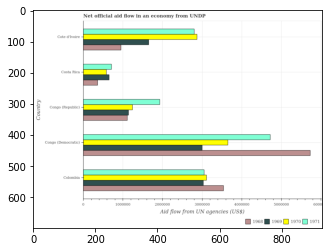

Number of QA =  30





,Country,1971,1970,1969,1968
0,Congo (Democratic),4.775515e+06,3.706409e+06,3.034951e+06,5.765519e+06
1,Costa Rica,7.317553e+05,6.039433e+05,6.744412e+05,3.815317e+05
2,Cote d'Ivoire,NaN,2.871138e+06,1.704544e+06,9.856781e+05
3,Colombia,3.097106e+06,3.159359e+06,NaN,3.604625e+06
4,Congo (Republic),1.945442e+06,1.269009e+06,1.171679e+06,1.145040e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in 1969 in colombia and that in costa rica ?
PREDICTED =  -674441.1679359679
EXPECTED =  2380000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in 1970 in congo (republic) and the net official aid flow in 1971 in cote d'ivoire?
PREDICTED =  -1602129.1631112986
EXPECTED =  -1560000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net official a

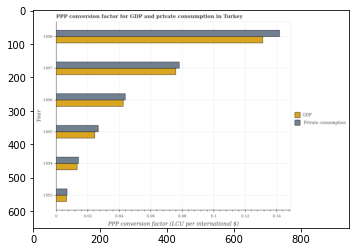

Number of QA =  28





,Year,Private consumption,GDP
0,1998,0.141280,0.131585
1,1994,0.014446,0.013704
2,1996,0.044172,0.043011
3,1997,0.078632,0.076722
4,1993,0.007184,0.006927
5,1995,0.027043,0.024968


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ppp conversion factor for gdp in 1993 and that in 1998 ?
PREDICTED =  -0.12465760972209881
EXPECTED =  -0.125




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ppp conversion factor for private consumption in 1995 and the ppp conversion factor for gdp in 1994 ?
PREDICTED =  0.012597755094262407
EXPECTED =  0.013428




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1994, what is the difference between the ppp conversion factor for gdp and ppp conversion factor for private consumption ?
PREDICTED =  -0.00969474427182021
EXPECTED =  -0.001




				 1 / 3 = 0.3333


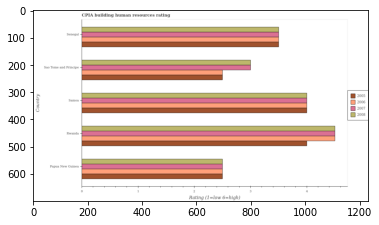

Number of QA =  30





,Country,2007,2005,2008,2006
0,Samoa,4.030004,3.978554,4.014586,4.004242
1,Rwanda,4.506052,4.046759,4.508339,4.523254
2,Sao Tome and Principe,NaN,2.508366,3.008922,2.508624
3,Senegal,3.504198,3.506386,3.513951,3.513640
4,Papua New Guinea,2.502838,2.507426,2.524556,2.508454


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2008 in papua new guinea and that in sao tome and principe ?
PREDICTED =  -0.484366022830621
EXPECTED =  -0.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2008 in papua new guinea and the cpia rating in 2007 in senegal?
PREDICTED =  -0.9893953688161843
EXPECTED =  -1.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2006 and cpia rating in 2005 in samoa ?
PREDICTED =  0.5446994280628026
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Tr

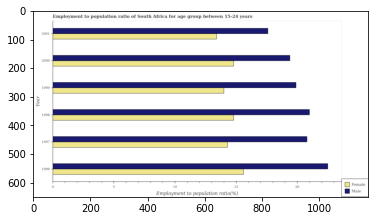

Number of QA =  28





,Year,Female,Male
0,1998,14.900078,20.910869
1,2001,13.352578,17.746369
2,2000,14.859778,19.300588
3,1999,14.052028,19.920983
4,1996,15.799544,22.558382
5,1997,14.250382,20.644522


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the employment to population ratio(male) in 1996 ?
PREDICTED =  0.786686271867146
EXPECTED =  22.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum employment to population ratio(female) ?
PREDICTED =  126.64922853016401
EXPECTED =  15.6000003814697




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum employment to population ratio(female) ?
PREDICTED =  1.0
EXPECTED =  13.3999996185303




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was t

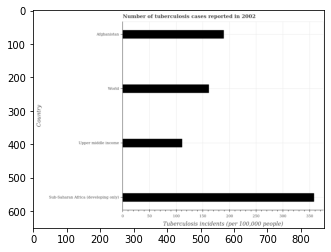

Number of QA =  22





,Country,"Tuberculosis incidents (per 100,000 people)"
0,World,291.598396
1,Afghanistan,342.183814
2,Upper middle income,202.990067
3,Sub-Saharan Africa (developing only),648.529965


> what is the title of the graph ?
PREDICTED =  Number of tuberculosis cases reported in 2002
EXPECTED =  Number of tuberculosis cases reported in 2002




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Tuberculosis incidents (per 100,000 people)
EXPECTED =  Tuberculosis incidents (per 100,000 people)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tuberculosis incidents in afghanistan and sub-saharan africa (developing only) ?
PREDICTED =  -306.3461508643636
EXPECTED =  -169.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of tuberculosis incidents ?
PREDICTED 

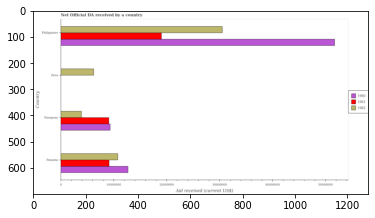

Number of QA =  26





,Country,1962,1961,1960
0,NaN,6.244610e+06,NaN,NaN
1,Panama,1.081871e+07,9.221036e+06,1.286695e+07
2,Philippines,NaN,1.942351e+07,5.230358e+07
3,Paraguay,3.978496e+06,9.141815e+06,9.433357e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official development assistance aid received in 1961 in panama and that in philippines ?
PREDICTED =  -10202477.65158662
EXPECTED =  -9890000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 5 = 0.2


is_built_with_cuda: True
is_gpu_availab

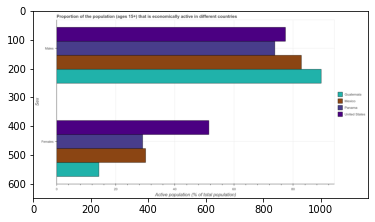

Number of QA =  23





,Sex,Panama,Mexico,Guatemala,United States
0,Males,74.416975,82.981558,90.017266,78.264924
1,Females,29.216429,30.338692,14.525924,51.536760


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active male population in panama and that in united states ?
PREDICTED =  -3.847948898466285
EXPECTED =  -3.599998474121108




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active male population in mexico and the percentage of economically active female population in guatemala ?
PREDICTED =  68.45563358810796
EXPECTED =  68.50000286102289




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active female population and percentage of economically active male po

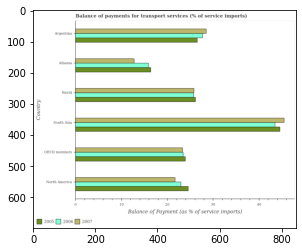

Number of QA =  29





,Country,2007,2005,2006
0,World,25.833356,26.264826,NaN
1,South Asia,45.451216,44.577918,43.521445
2,North America,21.872001,24.552857,NaN
3,Argentina,28.460440,26.617396,27.878535
4,Albania,12.955685,NaN,16.005898
5,OECD members,23.500008,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services in 2006 in oecd members and that in south asia ?
PREDICTED =  -43.5214445457456
EXPECTED =  -20.020583000865187




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services in 2005 in north america and the balance of payments for transport services in 2006 in oecd members?
PREDICTED =  24.55285650867465
EXPECTED =  1.105871175635091




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services in 2005 and balance of payments for trans

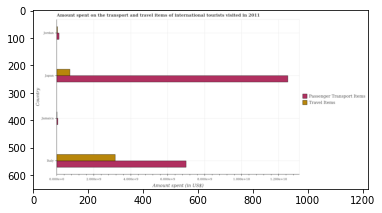

Number of QA =  28





,Country,Travel Items,Passenger Transport Item:
0,Japan,0.740116,12.508810
1,Jordan,NaN,0.151197
2,Jamaica,NaN,0.084745
3,Italy,3.178615,7.049354


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on passenger transport items in italy and that in jamaica ?
PREDICTED =  6.964609285083128
EXPECTED =  6940000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent in travel items in japan and the amount spent on passenger transport items in jamaica ?
PREDICTED =  0.6553709802342516
EXPECTED =  654000000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on passenger transport items and amount spent in travel items in japan ?
PREDICTED =  7.285295732336406
EXPECTED =  11790000000.0




				 0 / 3 

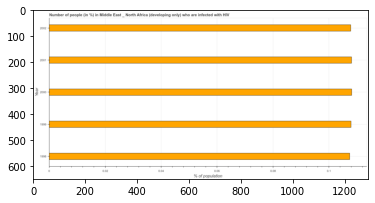

Number of QA =  23





,Year,% of population
0,2002,0.107616
1,1998,0.108739
2,1999,0.108515
3,2000,0.109045
4,2001,0.108869


> what is the title of the graph ?
PREDICTED =  Number of people (in %) in Middle East North Africa (developing only) who are infected with HIV
EXPECTED =  Number of people (in %) in Middle East _ North Africa (developing only) who are infected with HIV




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  % of population
EXPECTED =  % of population




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of people infected with hiv in 2000 and 2001 ?
PREDICTED =  0.00017597396249008357
EXPECTED =  0.0




				 2 / 4 = 0.5


> what is the median number of people infected with hiv ?
PREDICTED =  None
EXPECTED =  0.10790017958268




				 2 / 6 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Trai

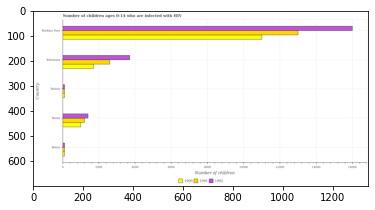

Number of QA =  29





,Country,1992,1990,1991
0,Botswana,3706.414179,1743.111430,2639.442941
1,Belize,126.697705,124.287252,127.402188
2,Burkina Faso,16124.000917,11030.374644,NaN
3,Bolivia,126.711435,119.630056,127.578784
4,Benin,1399.128743,1031.245584,1235.782584


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of hiv infected children in 1991 in benin and that in bolivia ?
PREDICTED =  1108.203799563368
EXPECTED =  1100




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of hiv infected children in 1990 in burkina faso and the number of hiv infected children in 1991 in benin?
PREDICTED =  9999.129059889545
EXPECTED =  9800




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of hiv infected children in 1992 and number of hiv infected children in 1991 in benin ?
PREDICTED =  20247.170395218385
EXPECTED =  200




				 2 / 3 = 0.6

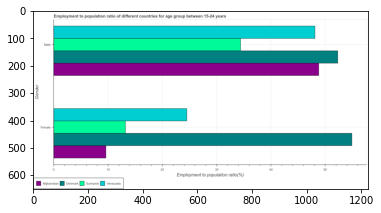

Number of QA =  23





,Gender,Denmark,Venezuela,Suriname,Afghanistan
0,Male,52.486054,48.177317,34.447820,48.934628
1,Female,55.004877,24.535326,13.237493,9.694887


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum employment to population ratio(female) ?
PREDICTED =  1.0
EXPECTED =  9.60000038146973




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation f

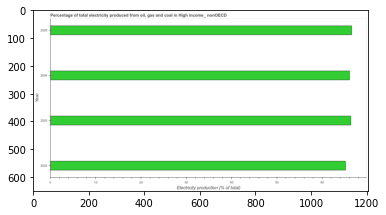

Number of QA =  23





,Year,Electricity production (% of total)
0,2004,66.398310
1,2005,66.599916
2,2003,66.732770
3,2002,65.479745


> what is the title of the graph ?
PREDICTED =  Percentage of total electricity produced from oil, gas and coal in High income_ nonOECD
EXPECTED =  Percentage of total electricity produced from oil, gas and coal in High income_ nonOECD




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Electricity production (% of total)
EXPECTED =  Electricity production (% of total)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the electricity production in 2003 and 2004 ?
PREDICTED =  0.33446004018770736
EXPECTED =  0.284




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median electricity production ?
PREDICT

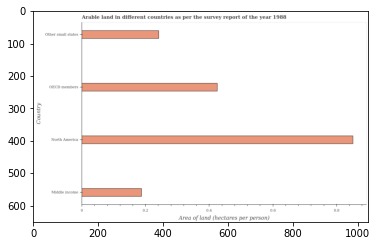

Number of QA =  22





,Country,Area of land (hectares per person)
0,North America,0.856580
1,OECD members,0.431292
2,Middle income,0.190667
3,Other small states,0.244405


> what is the title of the graph ?
PREDICTED =  Arable land in different countries as per the survey report of the year 1988
EXPECTED =  Arable land in different countries as per the survey report of the year 1988




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Area of land (hectares per person)
EXPECTED =  Area of land (hectares per person)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the area of arable land in north america and oecd members ?
PREDICTED =  0.42528803538606363
EXPECTED =  0.426




				 4 / 4 = 1.0


> what is the median area of arable land ?
PREDICTED =  None
EXPECTED =  0.33344747008396747




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or pr

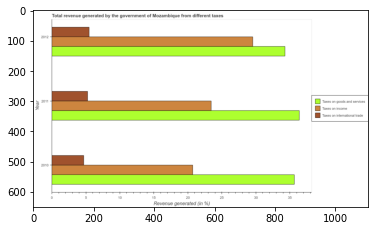

Number of QA =  29





,Year,Taxes on international trade,Taxes on income,Taxes on goods and services
0,2010,4.742873,20.799374,35.947286
1,2011,5.269923,23.461128,36.297425
2,2012,5.525610,29.410008,34.295469


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue generated by taxes on goods and services in 2011 and that in 2012 ?
PREDICTED =  5.948880113971445
EXPECTED =  2.11




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue generated by taxes on goods and services in 2010 and the percentage of revenue generated by tax on international trade in 2011 ?
PREDICTED =  24.140084760678086
EXPECTED =  30.40756470551333




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished afte

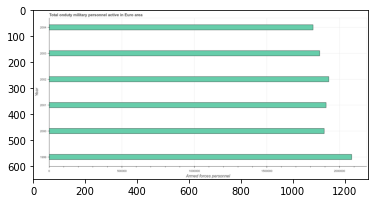

Number of QA =  23





,Year,Armed forces personnel
0,2004,3.260993e+06
1,2003,3.334204e+06
2,2001,3.430963e+06
3,2002,3.463232e+06
4,2000,3.394611e+06
5,1999,3.744420e+06


> what is the title of the graph ?
PREDICTED =  Total onduty military personnel active in Euro area
EXPECTED =  Total onduty military personnel active in Euro area




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Armed forces personnel
EXPECTED =  Armed forces personnel




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of armed forces personnel in 2000 and 2003 ?
PREDICTED =  60406.710677786265
EXPECTED =  30900.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of armed forces personnel ?
PREDICTED =  2001.5
EXPECTED =  1900900.0




				 3 / 5 = 0.6


is_built_with_cuda:

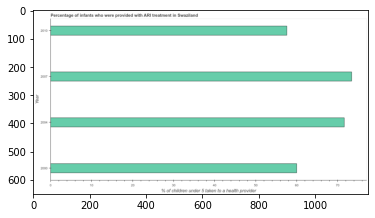

Number of QA =  23





,Year,% of children under 5 taken to a health provider
0,2004,71.528873
1,2010,57.825530
2,2000,60.310393
3,2007,73.729533


> what is the title of the graph ?
PREDICTED =  Percentage of infants who were provided with ARI treatment in Swaziland
EXPECTED =  Percentage of infants who were provided with ARI treatment in Swaziland




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  % of children under 5 taken to a health provider
EXPECTED =  % of children under 5 taken to a health provider




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who were provided with ari treatment in 2004 and 2007 ?
PREDICTED =  -2.2006607304957555
EXPECTED =  -1.8




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median pe

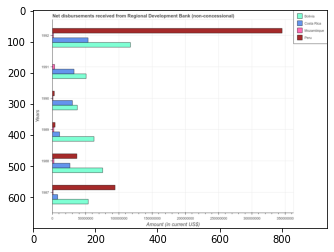

Number of QA =  27





,Years,Bolivia,Mozambique,Peru,Costa Rica
0,1992,2.138915e+08,NaN,6.218143e+08,9.791216e+07
1,1989,1.138106e+08,NaN,8.543551e+06,2.060555e+07
2,1988,1.367010e+08,5.446368e+06,6.773100e+07,4.867723e+07
3,1990,6.851676e+07,NaN,6.108413e+06,5.550758e+07
4,1987,9.798138e+07,NaN,1.697467e+08,1.546277e+07
5,1991,9.299962e+07,7.269055e+06,NaN,6.038639e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from regional development bank in bolivia in 1987 and that in 1988 ?
PREDICTED =  -38719642.85358316
EXPECTED =  -21674000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from regional development bank in costa rica in 1991 and the amount of disbursements received from regional development bank in peru in 1989 ?
PREDICTED =  39780844.04258087
EXPECTED =  28505000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1988, what is the difference between the amount of disbursements received from regi

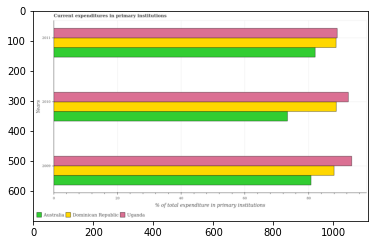

Number of QA =  29





,Years,Australia,Dominican Republic,Uganda
0,2011,82.663329,89.300749,89.844462
1,2010,73.777075,89.052360,93.072543
2,2009,81.428110,88.124243,93.874839


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the current expenditures in primary institutions in uganda in 2009 and that in 2010 ?
PREDICTED =  0.8022961999994322
EXPECTED =  1.0622253417969034




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the current expenditures in primary institutions in uganda in 2009 and the current expenditures in primary institutions in australia in 2011 ?
PREDICTED =  4.030377417962015
EXPECTED =  11.476325988769602




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after tra

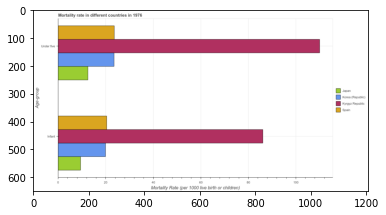

Number of QA =  23





,Age-group,Japan,Spain,Kyrgyz Republic,Korea (Republic)
0,Infant,9.637165,20.694122,86.832264,19.926116
1,Under five,12.753003,24.010408,111.072899,23.725727


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the infant mortality rate in korea (republic) and that in kyrgyz republic ?
PREDICTED =  0.0
EXPECTED =  -66.19999999999999




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the infant mortality rate in kyrgyz republic to that in spain ?
PREDICTED =  4.195986870627191
EXPECTED =  4.220588235294118




				 1 / 4 = 0.25


> what is the difference between two consecutive major ticks on the x-axis

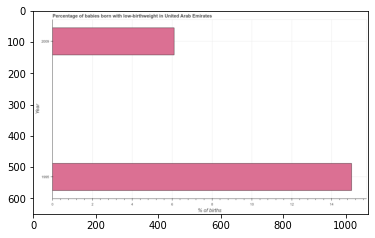

Number of QA =  19





,Year,% of births
0,1995,15.107045
1,2009,6.166259


> what is the title of the graph ?
PREDICTED =  2ercentage of babies born with low-birthweight in United Arab Emirates
EXPECTED =  Percentage of babies born with low-birthweight in United Arab Emirates




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  % of births
EXPECTED =  % of births




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of babies who were born with low-birthweight in 1995 and 2009 ?
PREDICTED =  8.940785955395171
EXPECTED =  8.9




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of babies who were born with low-birthweight ?
PREDICTED =  10.63665183

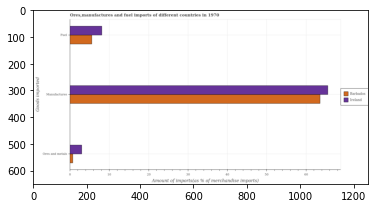

Number of QA =  28





,Goods imported,Barbados,Ireland
0,Fuel,5.724663,8.283531
1,Ores and metals,0.835425,3.096471
2,Manufactures,64.247057,66.303759


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of manufactures imports in barbados and that in ireland ?
PREDICTED =  -2.056702534732892
EXPECTED =  -1.9796153208629974




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of manufactures imports in barbados and the percentage of ores and metals imports in ireland ?
PREDICTED =  61.15058513188573
EXPECTED =  60.57760196006651




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of ores and metals imports and percentage of fuel imports in barbados ?
PREDICTED =  -0.16457500734559716
EXPECTED =  -4.828601234293

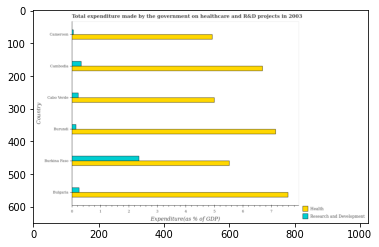

Number of QA =  28





,Country,Health,Research and Development
0,Cameroon,4.969324,0.083321
1,Bulgaria,7.681865,0.281845
2,Burkina Faso,5.612129,NaN
3,Cabo Verde,NaN,0.254408
4,Cambodia,6.748098,0.353517
5,Burundi,7.226434,0.168090


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in healthcare in bulgaria and that in cambodia ?
PREDICTED =  0.933766835425188
EXPECTED =  0.894




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in r&d in bulgaria and the expenditure in healthcare in cambodia ?
PREDICTED =  -6.466252780864508
EXPECTED =  -6.43407353




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in r&d and expenditure in healthcare in cabo verde ?
PREDICTED =  6.0
EXPECTED =  -4.775




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or pr

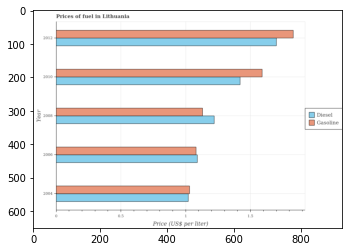

Number of QA =  28





,Year,Gasoline,Diesel
0,2004,1.027124,NaN
1,2010,1.598971,1.431960
2,2006,1.078140,1.094098
3,2008,1.142048,1.226115
4,2012,1.834982,1.715835


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gasoline price in 2006 and that in 2008 ?
PREDICTED =  -0.06390815493875723
EXPECTED =  -0.05




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gasoline price in 2010 and the diesel price in 2012 ?
PREDICTED =  -0.2360113327254063
EXPECTED =  -0.10999999999999988




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the diesel price and gasoline price ?
PREDICTED =  0.0
EXPECTED =  0.09




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training s

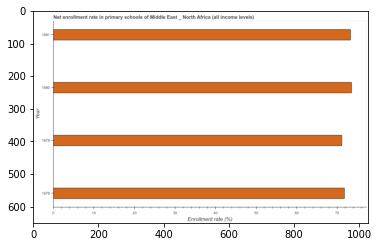

Number of QA =  23





,Year,Enrollment rate (%)
0,1980,74.050126
1,1981,73.676222
2,1978,72.081703
3,1979,71.664545


> what is the title of the graph ?
PREDICTED =  Net enroliment rate in primary schools of Middle East North Africa (all income levels)
EXPECTED =  Net enrollment rate in primary schools of Middle East _ North Africa (all income levels)




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Enrollment rate (%)
EXPECTED =  Enrollment rate (%)




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrollment rate in primary schools in 1979 and 1981 ?
PREDICTED =  -2.0116764530236253
EXPECTED =  -2.14




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median net enrollment rate in primary schools ?
PREDI

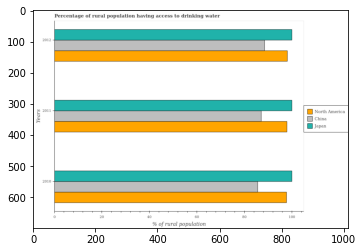

Number of QA =  29





,Years,Japan,North America,China
0,2011,101.471243,99.151027,88.249828
1,2012,100.905472,99.132123,89.732312
2,2010,101.532153,100.073976,86.778591


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population having access to drinking water in north america in 2010 and that in 2011 ?
PREDICTED =  0.9229489727291735
EXPECTED =  -0.1805182538144976




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population having access to drinking water in japan in 2010 and the percentage of rural population having access to drinking water in china in 2011 ?
PREDICTED =  13.282325001997705
EXPECTED =  12.900000000000006




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the percentage of rural po

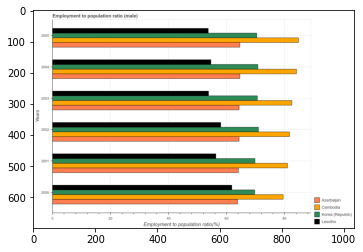

Number of QA =  30





,Years,Azerbaijan,Cambodia,Lesotho,Korea (Republic
0,2004,65.170156,NaN,55.188767,69.690605
1,2005,65.437135,86.810115,54.242693,70.410196
2,2003,64.890928,83.492932,54.534668,70.199459
3,2001,64.976818,NaN,56.586677,68.896685
4,2000,64.262092,NaN,62.126584,70.356558
5,2002,65.150409,NaN,58.474093,71.167613


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum employment to population ratio in korea (republic) ?
PREDICTED =  28.172927665724618
EXPECTED =  71.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum employment to population ratio in korea (republic) ?
PREDICTED =  29.028972691165794
EXPECTED =  69.6999969482422




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the employment to population ratio in lesotho maximum?
PREDICTED =  1.0025
EXPECTED =

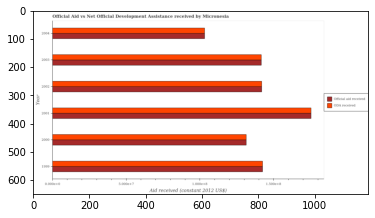

Number of QA =  28





,Year,Official aid received,ODA received
0,2002,25.652551,25.569305
1,1999,25.981726,25.664334
2,2004,18.697384,18.706926
3,2003,25.545248,25.482530
4,2001,31.572976,31.586449
5,2000,23.806779,23.768309


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received in 1999 and that in 2002 ?
PREDICTED =  0.09502924860429829
EXPECTED =  590000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the official aid received in 2004 and the oda received in 2003 ?
PREDICTED =  -6.847864000715997
EXPECTED =  -38440000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the official aid received and oda received ?
PREDICTED =  0.0
EXPECTED =  0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training s

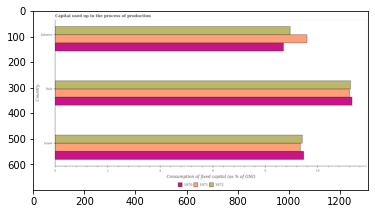

Number of QA =  29





,Country,1972,1971,1970
0,Jamaica,8.942269,9.565221,8.635168
1,Israel,9.427823,9.357462,9.459681
2,Italy,11.189259,11.202811,11.291976


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the capital used up in the process of production in 1971 in italy to that in jamaica ?
PREDICTED =  1.1712026316376105
EXPECTED =  1.1692721993800592




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 5 = 0.2


is_built_with_cuda: True
is_gpu_available: False
GPUs:

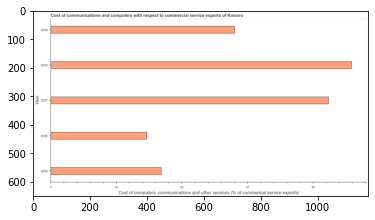

Number of QA =  23





,Year,"Cost of computers, communications and other services (% of commerical service exports)"
0,2009,28.291938
1,2006,14.718781
2,2008,46.055946
3,2007,42.393599
4,2005,17.085402


> what is the title of the graph ?
PREDICTED =  Cost of communications and computers with respect to commercial service exports of Kosovo
EXPECTED =  Cost of communications and computers with respect to commercial service exports of Kosovo




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Cost of computers, communications and other services (% of commerical service exports)
EXPECTED =  Cost of computers, communications and other services (% of commerical service exports)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications in 2005 and 2009 ?
PREDICTED =  -11.206536415507312
EXPECTED =  -11.181




				 4 / 4 = 1.0


> what is the median  computer and other services ?
PREDICTED =  None
EXPECTED 

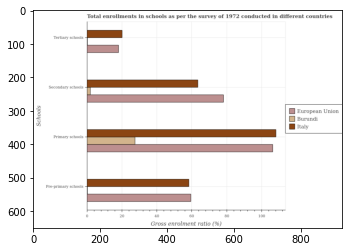

Number of QA =  29





,Schools,Burundi,European Union,Italy
0,Secondary schools,2.301905,79.406836,64.338256
1,Tertiary schools,NaN,18.612388,20.413366
2,Pre-primary schools,NaN,60.346697,58.994068
3,Primary schools,27.991191,107.341778,108.548372


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the gross enrolment ratio in tertiary schools in burundi ?
PREDICTED =  0.5
EXPECTED =  0.17623




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum gross enrolment ratio in pre-primary schools ?
PREDICTED =  30.173348614437376
EXPECTED =  59.43291854858401




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum gross enrolment ratio in pre-primary schools ?
PREDICTED =  30.173348614437376
EXPECTED =  0.18034




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.




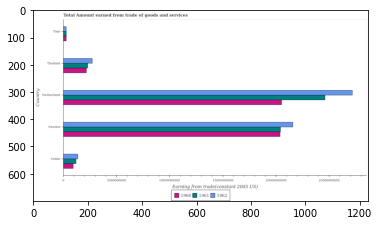

Number of QA =  29





,Country,1962,1961,1960
0,Sudan,2.525586e+09,2.228366e+09,1.752372e+09
1,Togo,5.849178e+08,5.774990e+08,5.611237e+08
2,Thailand,4.942381e+09,4.217975e+09,4.001654e+09
3,Sweden,3.900368e+10,3.708801e+10,3.692670e+10
4,Switzerland,4.899984e+10,4.514780e+10,3.710626e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount earned by trading goods and services in 1962 in sudan and that in sweden ?
PREDICTED =  -41529261622.102264
EXPECTED =  -20230362668.58027




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount earned by trading goods and services in 1961 in thailand and the total amount earned by trading goods and services in 1960 in sudan?
PREDICTED =  -2228365741.731414
EXPECTED =  1364631955.2837




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount earned by trading goods and services in 1961 and total amount earned by t

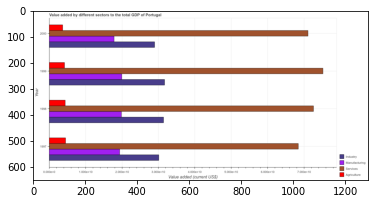

Number of QA =  30





,Year,Industry,Manufacturing,Agriculture,Services
0,2000,2.908346,1.803180,0.378616,7.062606
1,1998,3.159126,1.969276,0.445762,7.309033
2,1999,3.198112,2.002411,0.428928,7.506305
3,1997,3.023041,1.943585,0.458569,6.839890


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by services sector in 1998 and that in 1999 ?
PREDICTED =  -0.19727223500004154
EXPECTED =  -2592570293.064




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by services sector in 1999 and the value added by manufacturing sector in 1998 ?
PREDICTED =  0.19727223500004154
EXPECTED =  55374089660.82939




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the value added by agricultural sector and value added by services sector ?
PREDICTED =  1.2829465254075105
EXPECTED =  -68229002671.416




				 0 / 3 = 

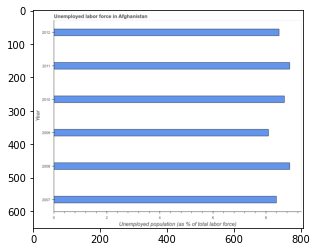

Number of QA =  23





,Year,Unemployed population (as % of total labor force)
0,2008,8.879882
1,2012,8.484682
2,2009,8.147157
3,2011,8.935820
4,2010,8.703573
5,2007,8.436075


> what is the title of the graph ?
PREDICTED =  Unemployed labor force in Afghanistan
EXPECTED =  Unemployed labor force in Afghanistan




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Unemployed population (as % of total labor force)
EXPECTED =  Unemployed population (as % of total labor force)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total unemployed population in 2007 and 2011 ?
PREDICTED =  -0.49974543060019627
EXPECTED =  -0.5




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total unemployed population ?
PREDICTED =  2009.5
EXPECTED =  8.599999904632568




				 4 / 5 = 0.8

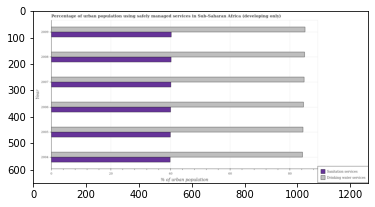

Number of QA =  28





,Year,Drinking water services,Sanitation services
0,2007,84.363224,40.581628
1,2005,84.756964,40.630411
2,2008,85.603155,NaN
3,2009,84.982756,40.682948
4,2006,85.166576,40.226571
5,2004,83.385012,40.431870


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population who used sanitation services in 2004 and that in 2005 ?
PREDICTED =  -0.1985416590661231
EXPECTED =  -0.081




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population who used drinking water services in 2008 and the percentage of urban population who used sanitation services in 2005 ?
PREDICTED =  0.8461907468743988
EXPECTED =  44.98851483587099




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percentage of urban population who used drinking water services and percent

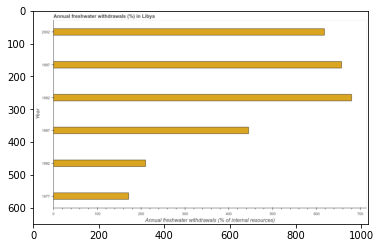

Number of QA =  23





,Year,Annual freshwater withdrawals (% of internal resources)
0,1997,657.991519
1,2002,614.799343
2,1987,446.221823
3,1982,209.873131
4,1992,677.022762
5,1977,172.487953


> what is the title of the graph ?
PREDICTED =  Annual freshwater withdrawals (“%) in Libya
EXPECTED =  Annual freshwater withdrawals (%) in Libya




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Annual freshwater withdrawals (% of internal resources)
EXPECTED =  Annual freshwater withdrawals (% of internal resources)




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the annual freshwater withdrawals in 1977 and 1982 ?
PREDICTED =  -37.38517802022727
EXPECTED =  -38.571




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median annual freshwater withdrawals ?
PREDICTED =  530.5105830642522
EXPECTE

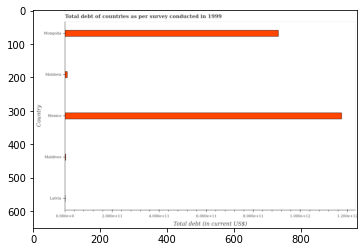

Number of QA =  22





,Country,Total debt (in current US$)
0,Latvia,NaN
1,Maldives,0.053670
2,Mexico,11.758845
3,Moldova,0.117967
4,Mongolia,9.003742


> what is the title of the graph ?
PREDICTED =  Total debt of countries as per survey conducted in 1999
EXPECTED =  Total debt of countries as per survey conducted in 1999




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Total debt (in current US$)
EXPECTED =  Total debt (in current US$)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt in maldives and moldova ?
PREDICTED =  -0.06429660910881276
EXPECTED =  -6815400000.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total debt ?
PREDICTED =  4.560854527615631
EXPECTED =  9598300000.0




				 3 / 5 = 0.6


is_built_w

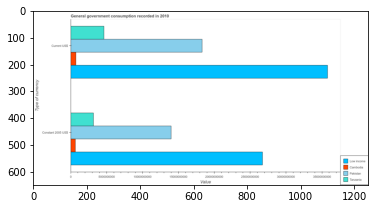

Number of QA =  23





,Type of currency,Cambodia,Low income,Tanzania,Pakistan
0,Current US$,1.392797e+09,6.461259e+10,8.383843e+09,3.311157e+10
1,Constant 2005 US$,1.274935e+09,4.801500e+10,5.807644e+09,2.537274e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value consumed in constant 2005 us$ in tanzania and that in low income ?
PREDICTED =  -42207357159.8871
EXPECTED =  -23551326060.96216




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value consumed in current us$ in tanzania and the value consumed in constant 2005 us$ in cambodia ?
PREDICTED =  7108907398.434636
EXPECTED =  3985147655.2512026




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value consumed in constant 2005 us$ and value consumed in current us$ in tanzania ?
PREDICTED =  19565097457.116566
EXPECTED =  -1459472851.0296698

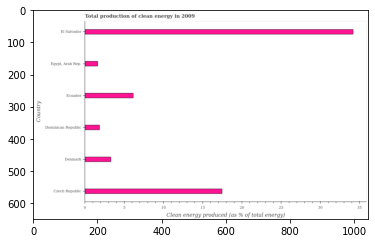

Number of QA =  22





,Country,Clean energy produced (as % of total energy)
0,Denmark,3.430726
1,"Egypt, Arab Rep.",1.716770
2,Ecuador,6.225034
3,Czech Republic,17.427013
4,El Salvador,34.411409
5,Dominican Republic,1.950023


> what is the title of the graph ?
PREDICTED =  Total production of clean energy in 2009
EXPECTED =  Total production of clean energy in 2009




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Clean energy produced (as % of total energy)
EXPECTED =  Clean energy produced (as % of total energy)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the production of clean energy in denmark and ecuador ?
PREDICTED =  -2.79430808050446
EXPECTED =  -2.854




				 4 / 4 = 1.0


> what is the median production of clean energy ?
PREDICTED =  None
EXPECTED =  4.719688649397274




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step

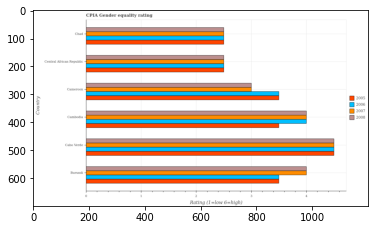

Number of QA =  30





,Country,2007,2005,2008,2006
0,Cabo Verde,NaN,4.565645,4.512077,NaN
1,Cambodia,4.031883,3.508057,NaN,4.030390
2,Chad,2.510819,NaN,NaN,NaN
3,Cameroon,3.048940,3.513116,2.999500,3.495299
4,Central African Republic,2.515196,2.508170,2.523156,NaN
5,Burundi,4.041119,3.549759,4.025675,3.542556


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2005 in cambodia and the cpia rating in 2007 in central african republic?
PREDICTED =  0.9998875052948657
EXPECTED =  1.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2007 and cpia rating in 2005 in burundi ?
PREDICTED =  1.4502408560850935
EXPECTED =  0.5




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cpia rating in 2007 in burundi to that in chad ?
PREDIC

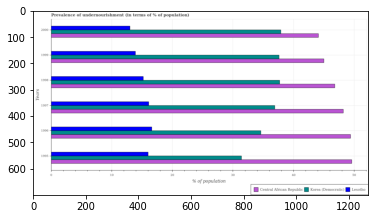

Number of QA =  29





,Years,Central African Republic,Lesotho,Korea (Democratic)
0,2000,44.119485,13.243443,38.228488
1,1999,45.795623,14.049789,38.201958
2,1996,50.349341,16.705722,35.338439
3,1998,47.596803,15.422624,37.792098
4,1995,49.403649,16.017144,31.998020
5,1997,50.229511,16.259267,37.296542


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished population in central african republic in 1997 and that in 1998 ?
PREDICTED =  2.6327070350303217
EXPECTED =  1.4000000000000057




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished population in korea (democratic) in 1996 and the percentage of undernourished population in lesotho in 2000 ?
PREDICTED =  -2.8900483735335385
EXPECTED =  21.6




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the percentage of undernourished population in lesotho and percentage of undernouri

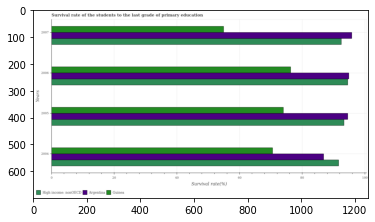

Number of QA =  29





,Years,High income: nonOECD,Guinea,Argentina
0,2004,91.792042,71.082695,87.427672
1,2006,95.202904,76.757348,96.386068
2,2005,93.903830,74.731758,94.843534
3,2007,92.871897,55.023774,96.689329


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the survival rate of the students in guinea in 2005 and that in 2006 ?
PREDICTED =  -2.0255902630070324
EXPECTED =  -2.325775146484318




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the survival rate of the students in guinea in 2004 and the survival rate of the students in high income: nonoecd in 2007 ?
PREDICTED =  16.05892088634154
EXPECTED =  -21.9462890625




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the survival rate of the students in high income: nonoecd and survival rate of the students in guinea ?
PREDICTED =  0.0


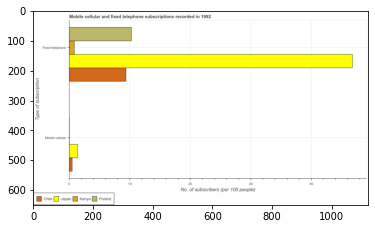

Number of QA =  23





,Type of subscription,Japan,Kenya,Chile,Poland
0,Fixed telephone,47.040585,0.932096,9.482322,10.361619
1,Mobile cellular,1.466554,NaN,0.579572,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of mobile cellular subscribers in japan and that in kenya ?
PREDICTED =  0.0
EXPECTED =  1.3858809170274269




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of mobile cellular subscribers in chile and the number of fixed telephone subscribers in poland ?
PREDICTED =  -1.4204284676007881
EXPECTED =  -9.80076395020717




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of fixed telephone subscribers and number of mobile cellular subscribers in poland ?
PREDICTED =  -1.0
EXPECTED =  10.265167098273475




				 0 / 3 = 0.0

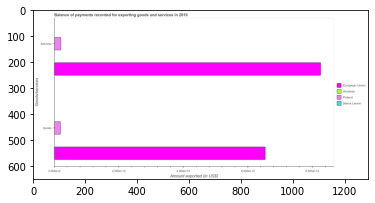

Number of QA =  23





,Goods/services,Sierra Leone,Armenia,Poland,European Union
0,Services,NaN,NaN,0.210151,8.322006
1,Goods,NaN,NaN,0.197541,6.559767


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of services exported in poland and that in european union ?
PREDICTED =  -1.7898485469511862
EXPECTED =  -8054271417986.3




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods exported in european union and the amount of services exported in armenia ?
PREDICTED =  12.881772706228187
EXPECTED =  6538352464128.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods exported and amount of services exported in sierra leone ?
PREDICTED =  -1.0
EXPECTED =  -9658509.893000126




				 0 / 3 = 0.0


is_built_with_cu

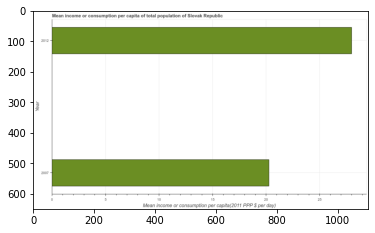

Number of QA =  19





,Year,Mean income or consumption per capita(2011 PPP $ per day)
0,2007,20.549154
1,2012,28.119303


> what is the title of the graph ?
PREDICTED =  Mean income or consumption per capita of total population of Slovak Republic
EXPECTED =  Mean income or consumption per capita of total population of Slovak Republic




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Mean income or consumption per capita(2011 PPP $ per day)
EXPECTED =  Mean income or consumption per capita(2011 PPP $ per day)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the mean income or consumption in 2007 and 2012 ?
PREDICTED =  -7.570149136877507
EXPECTED =  -7.728




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median mean in

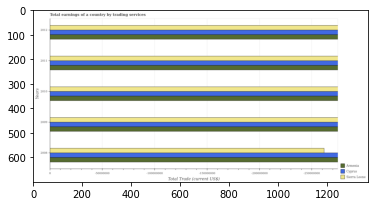

Number of QA =  16





,Years,Sierra Leone,Armenia,Cyprus
0,2011,1.662750e+08,1.663207e+08,1.671342e+08
1,2008,1.577943e+08,1.642957e+08,1.646519e+08
2,2009,1.648884e+08,1.655196e+08,1.666786e+08
3,2012,1.666847e+08,1.651958e+08,1.664351e+08
4,2010,1.668170e+08,1.663225e+08,1.635207e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total earnings in armenia in 2011 and the total earnings in cyprus in 2012 ?
PREDICTED =  1124993.552768439
EXPECTED =  0




				 0 / 1 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Total Trade (current US$)
EXPECTED =  50000000.0




				 0 / 2 = 0.0


> what is the title of the graph ?
PREDICTED =  Total earnings of a country by trading service
EXPECTED =  Total earnings of a country by trading services




				 0 / 3 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Total Trade (current US$)
EXPECTED =  Total Trade (current US$)




				 1 / 4 = 0.25


> what is the label or title of the y-axis ?
PREDICTED =  Years
EXPECTED =  Years




				 2 / 5 = 0.4


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluatio

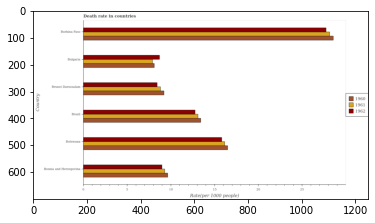

Number of QA =  29





,Country,1962,1961,1960
0,Botswana,15.811117,16.151113,16.501644
1,Brazil,12.854674,13.169486,13.386235
2,Burkina Faso,27.754360,NaN,28.625823
3,Bosnia and Herzegovina,8.998427,9.317505,NaN
4,Bulgaria,8.874490,7.950675,8.152761
5,Brunei Darussalam,8.543363,8.873327,9.224434


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the death rate in 1961 in bulgaria and that in burkina faso ?
PREDICTED =  7.950674525288826
EXPECTED =  -20.247




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the death rate in 1962 in burkina faso and the death rate in 1960 in botswana?
PREDICTED =  5.971621342402742
EXPECTED =  11.248999999999999




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the death rate in 1961 and death rate in 1962 in burkina faso ?
PREDICTED =  -11.603247071779236
EXPECTED =  0.41199999999999903




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
G

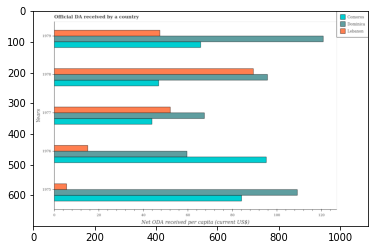

Number of QA =  29





,Years,Lebanon,Dominica,Comoros
0,1979,48.074577,121.168272,66.163674
1,1978,90.103500,95.408865,47.294086
2,1976,15.214241,60.201427,95.271750
3,1975,5.797619,109.768153,84.446962
4,1977,52.626319,67.532047,44.206023


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received in in lebanon in 1977 and that in 1979 ?
PREDICTED =  4.5517416354710605
EXPECTED =  4.676028234239503




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received in in comoros in 1979 and the oda received in in dominica in 1976 ?
PREDICTED =  -29.108076502518955
EXPECTED =  6.1540862977248025




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1978, what is the difference between the oda received in in comoros and oda received in in dominica ?
PREDICTED =  1854.8317283220622
EXPECTED =  -48.87435573741241




				 1 / 3 = 0.3333


is_built_with_c

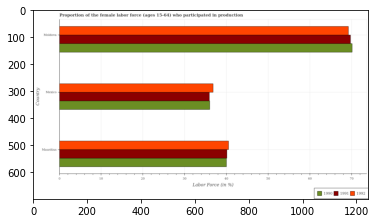

Number of QA =  29





,Country,1992,1990,1991
0,Mexico,37.362156,36.471627,36.462784
1,Moldova,70.265526,70.929292,70.605509
2,Mauritius,41.071125,40.430767,40.740419


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female labor force who participated in production in 1992 in mexico and that in moldova ?
PREDICTED =  -32.9033691841943
EXPECTED =  -32.399997711181705




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female labor force who participated in production in 1990 in moldova and the proportion of the female labor force who participated in production in 1992 in mexico?
PREDICTED =  34.45766443543416
EXPECTED =  33.2999992370605




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female labor 

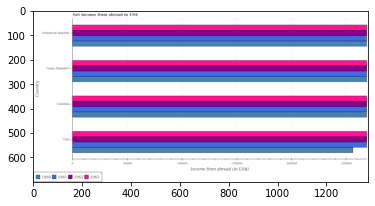

Number of QA =  17





,Country,1963,1962,1961,1960
0,Colombia,161992.546628,162048.686839,161590.286727,162048.688881
1,Congo (Republic),161571.887096,162048.676629,161475.907225,161812.348273
2,Chile,162048.678671,161071.689133,161619.524803,154341.175416
3,Dominican Republic,162048.680713,162048.684797,161259.707995,161938.758696


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net income from abroad in 1960 in colombia and the net income from abroad in 1963 in congo (republic)?
PREDICTED =  236.34060735724051
EXPECTED =  0




				 0 / 1 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Income from abroad (in US$)
EXPECTED =  50000.0




				 0 / 2 = 0.0


> what is the title of the graph ?
PREDICTED =  Net income from abroad in US$
EXPECTED =  Net income from abroad in US$




				 1 / 3 = 0.3333


> what is the label or title of the x-axis ?
PREDICTED =  Income from abroad (in US$)
EXPECTED =  Income from abroad (in US$)




				 2 / 4 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 5 = 0.6


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluati

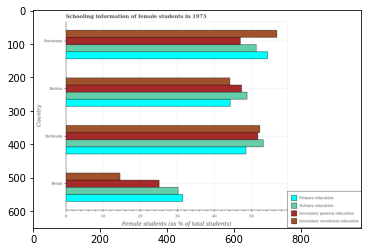

Number of QA =  30





,Country,Secondary vocational education,Tertiary education,Secondary general education,Primary education
0,Benin,14.818290,30.622864,25.699734,31.937699
1,Bermuda,52.939644,53.525260,52.342557,49.084405
2,Botswana,57.951522,NaN,47.602263,55.057493
3,Bolivia,44.960226,49.424699,48.133905,44.547441


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female students in secondary vocational education in benin and that in bolivia ?
PREDICTED =  -30.14193621606274
EXPECTED =  -29.578




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female students in primary education in benin and the percentage of female students in secondary education in bermuda ?
PREDICTED =  -17.14670560087437
EXPECTED =  -20.24401




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female students in tertiary education and percentage of female students in primary education in

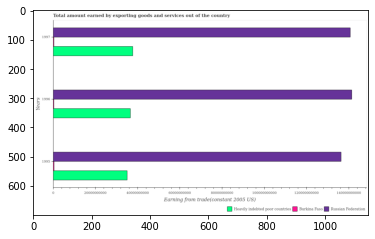

Number of QA =  29





,Years,Heavily indebted poor countries,Burkina Faso,Russian Federation
0,1995,3.550054e+10,6.354686e+08,1.383425e+11
1,1997,3.829788e+10,NaN,1.423166e+11
2,1996,3.703006e+10,NaN,1.442575e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum total amount earned by exporting goods and services in russian federation ?
PREDICTED =  665.0
EXPECTED =  136337589767.687




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount earned by exporting goods and services in heavily indebted poor countries in 1996 and that in 1997 ?
PREDICTED =  -38297883156.0913
EXPECTED =  -1139924304.7001038




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount earned by exporting goods and services in russian federation in 1996 and the total amount earned by exporting goods and service

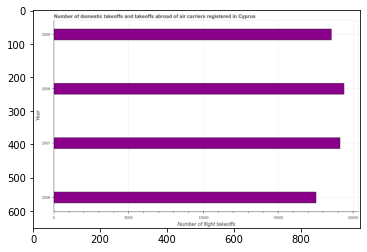

Number of QA =  23





,Year,Number of flight takeoffs
0,2006,207810.458870
1,2007,227232.077472
2,2008,229974.817806
3,2009,219259.395464


> what is the title of the graph ?
PREDICTED =  Number of domestic takeoffs and takeoffs abroad of air carriers registered in Cyprus
EXPECTED =  Number of domestic takeoffs and takeoffs abroad of air carriers registered in Cyprus




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Number of flight takeoffs
EXPECTED =  Number of flight takeoffs




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of flight takeoffs in 2006 and 2008 ?
PREDICTED =  -22164.35893597157
EXPECTED =  -1869.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of flight takeoffs ?
PREDICTED =  223245.736467

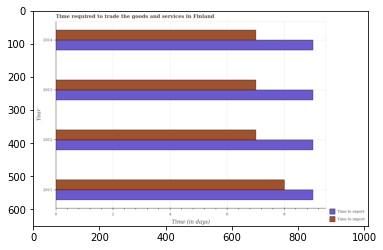

Number of QA =  28





,Year,Time to export,Time to import
0,2014,8.942310,7.075951
1,2012,9.096516,7.071811
2,2011,9.046677,8.081490
3,2013,9.000883,7.024843


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the time to import in 2013 and that in 2014 ?
PREDICTED =  -0.051108134682835704
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the time to export in 2014 and the time to import in 2013 ?
PREDICTED =  -0.05857302803306119
EXPECTED =  2




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the time to import and time to export ?
PREDICTED =  -1.7080724280900403
EXPECTED =  -2




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step

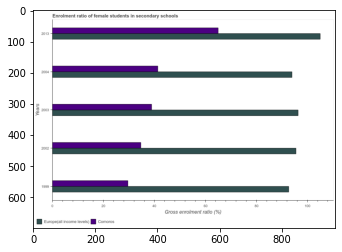

Number of QA =  28





,Years,Comoros,Europe(all income levels:
0,2013,65.618645,105.449379
1,2004,41.861472,94.564234
2,2002,35.239168,95.885108
3,2003,39.523337,96.927470
4,1999,30.201056,93.400926


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the enrolment ratio of female students in secondary schools in comoros in 1999 ?
PREDICTED =  0.7108014723399433
EXPECTED =  29.58909034729




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum enrolment ratio of female students in secondary schools in comoros ?
PREDICTED =  47.37726281924528
EXPECTED =  64.9907073974609




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum enrolment ratio of female students in secondary schools in europe(all income levels) ?
PREDICTED =  2.1982514834217173
EXPECTED =  92.6597518920898




				 0 / 3 = 0.0


is_built_with_cuda: True


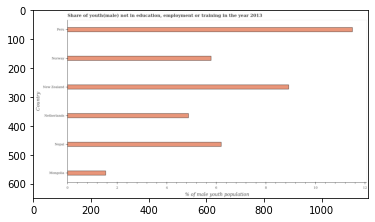

Number of QA =  22





,Country,% of male youth population
0,New Zealand,8.926229
1,NaN,11.463771
2,Netherlands,4.946500
3,Nepal,6.202409
4,Mongolia,1.544005
5,Norway,5.797975


> what is the title of the graph ?
PREDICTED =  Share of youth(male) not in education, employment or training in the year 2013
EXPECTED =  Share of youth(male) not in education, employment or training in the year 2013




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  % of male youth population
EXPECTED =  % of male youth population




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed male youth population in nepal and norway ?
PREDICTED =  0.40443435062457045
EXPECTED =  0.41




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed male youth population ?
PREDICTED =  6.0

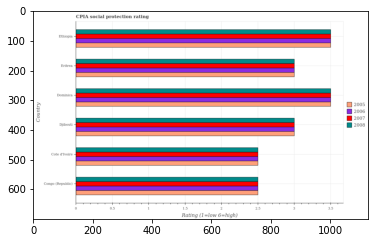

Number of QA =  30





,Country,2007,2005,2006,2008
0,Eritrea,3.004967,2.995259,3.009166,3.013589
1,Ethiopia,3.502056,NaN,3.488751,3.505283
2,Djibouti,3.009615,3.000445,2.980191,3.020120
3,Cote d'Ivoire,NaN,2.508118,2.502804,2.488871
4,Dominica,3.476847,3.518495,3.491854,3.484392
5,Congo (Republic),2.499450,NaN,2.504517,2.506488


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2008 in eritrea and the cpia rating in 2005 in ethiopia?
PREDICTED =  -0.4916938214790725
EXPECTED =  -0.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2007 and cpia rating in 2006 in cote d'ivoire ?
PREDICTED =  2.4971964463011402
EXPECTED =  0.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or

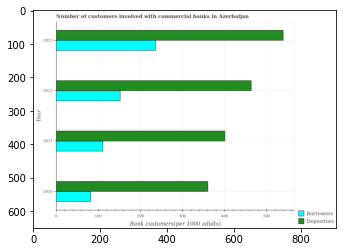

Number of QA =  28





,Year,Depositors,Borrowers
0,2013,541.667700,239.170665
1,2011,403.351509,111.419624
2,2010,364.252632,84.564540
3,2012,467.898831,154.981580


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of depositors in 2010 and that in 2011 ?
PREDICTED =  -39.09887622452948
EXPECTED =  -40.535




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of borrowers in 2010 and the number of depositors in 2011 ?
PREDICTED =  -26.85508323016218
EXPECTED =  -318.7097967947986




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the number of depositors and number of borrowers ?
PREDICTED =  -235.17066495306665
EXPECTED =  278.175




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or 

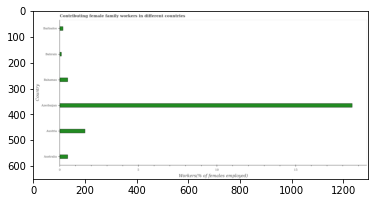

Number of QA =  22





,Country,Workers(% of females employed)
0,Austria,1.644832
1,Bahrain,0.134146
2,Barbados,0.242361
3,Australia,0.541235
4,Azerbaijan,18.571066
5,Bahamas,0.543335


> what is the title of the graph ?
PREDICTED =  Contributing female family workers in different countries
EXPECTED =  Contributing female family workers in different countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Workers(% of females employed)
EXPECTED =  Workers(% of females employed)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the contributing female family workers in azerbaijan and bahamas ?
PREDICTED =  18.02773180175193
EXPECTED =  18.1




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 4 / 5 = 0.8


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predictin

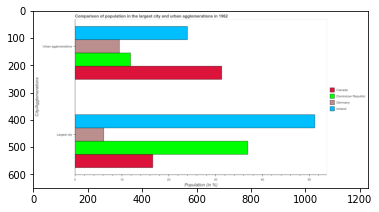

Number of QA =  23





,City/Agglomerations,Dominican Republic,Germany,Canada,Ireland
0,Largest city,36.857219,6.231904,16.810005,51.620234
1,Urban agglomerations,11.949942,9.590718,31.427506,24.364047


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the population in urban agglomerations in ireland ?
PREDICTED =  0.6610386663425949
EXPECTED =  23.9844854639375




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum population in urban agglomerations ?
PREDICTED =  0.3242225711457925
EXPECTED =  9.451994456418053




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after tra

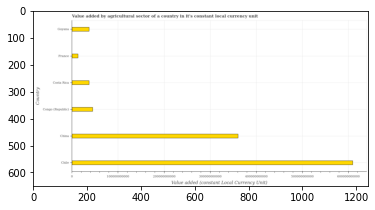

Number of QA =  22





,Country,Value added (constant Local Currency Unit)
0,France,1.438400e+10
1,Chile,6.104836e+11
2,China,3.638218e+11
3,Costa Rica,3.844123e+10
4,Guyana,3.874886e+10
5,Congo (Republic),4.648675e+10


> what is the title of the graph ?
PREDICTED =  Value added by agricultural sector of a country in it's constant local currency unit
EXPECTED =  Value added by agricultural sector of a country in it's constant local currency unit




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Value added (constant Local Currency Unit)
EXPECTED =  Value added (constant Local Currency Unit)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agriculture sector in china and guyana ?
PREDICTED =  325072948490.36633
EXPECTED =  323386986700.0




				 4 / 4 = 1.0


> what is the median value added by agriculture sector ?
PREDICTED =  None
EXPECTED =  41035233650.0




				 4 / 6 = 0.6667


is_built_with_cuda: True

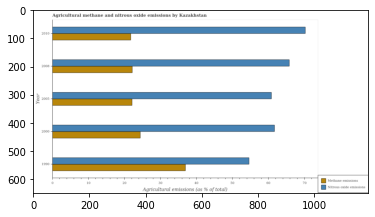

Number of QA =  28





,Year,Nitrous oxide emissions,Methane emissions
0,2000,62.214700,24.764964
1,2005,61.308242,22.529412
2,1990,53.837010,37.283634
3,2008,66.038549,22.590427
4,2010,70.853586,22.115505


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emissions in 2005 and that in 2010 ?
PREDICTED =  0.41390731200360165
EXPECTED =  0.355




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emissions in 2010 and the amount of nitrous oxide emissions in 1990 ?
PREDICTED =  -15.168129301477471
EXPECTED =  -32.8384943694448




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the amount of methane emissions and amount of nitrous oxide emissions ?
PREDICTED =  107.16843665054482
EXPECTED =  -17.668




				 0 / 3 = 0.0


is_built_with_cuda: True
i

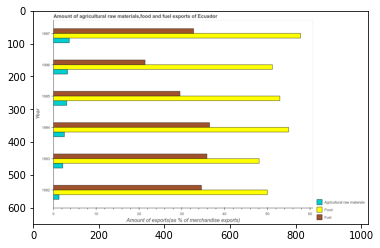

Number of QA =  29





,Year,Unnamed: 1,Agricultural raw materials,Fuel
0,1996,52.263456,3.397737,NaN
1,1994,55.763885,2.671347,37.003100
2,1993,48.016292,2.324960,36.140492
3,1992,50.266668,1.434950,34.921001
4,1997,58.115800,3.876741,32.983915
5,1995,53.031647,3.261607,29.796508


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of fuel exports in 1992 and that in 1994 ?
PREDICTED =  -2.0820991776550386
EXPECTED =  -1.897




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of raw materials exports in 1992 and the percentage of fuel exports in 1996 ?
PREDICTED =  nan
EXPECTED =  -20.12143302325706




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1994, what is the difference between the percentage of raw materials exports and percentage of fuel exports ?
PREDICTED =  -25.91976698304837
EXPECTED =  -33.934




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_availab

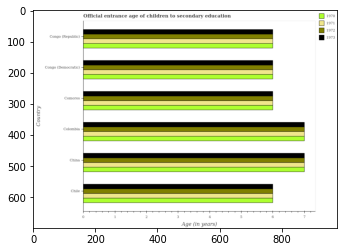

Number of QA =  30





,Country,1972,1971,1970,1973
0,Chile,5.987307,NaN,NaN,6.026008
1,Comoros,6.015456,NaN,6.018119,6.013298
2,Colombia,7.000779,7.047808,6.996726,6.955606
3,Congo (Republic),6.009300,NaN,6.033617,6.053313
4,Congo (Democratic),6.005888,5.982311,6.030242,5.998686
5,China,7.007192,6.990319,7.002596,6.992018


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the secondary school starting age of children in 1972 in colombia and that in congo (democratic) ?
PREDICTED =  0.9948912313616924
EXPECTED =  1.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the secondary school starting age of children in 1971 in comoros and the secondary school starting age of children in 1972 in colombia?
PREDICTED =  nan
EXPECTED =  -1.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the secondary school starting age of children in 1973 and secondary school starting age of children in 1971 in comoros ?
PREDICTED =  nan
E

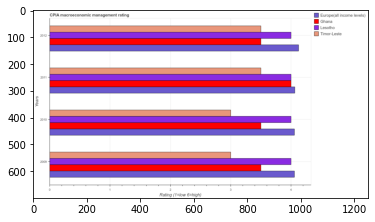

Number of QA =  30





,Years,Timor-Leste,Lesotho,Furope(all income levels),Ghana
0,2012,3.487431,4.064278,4.182738,3.522658
1,2009,3.016665,4.082426,4.069164,3.512995
2,2010,2.997703,4.007679,4.083185,3.496029
3,2011,NaN,4.024958,4.075289,4.008716


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in timor-leste in 2011 and that in 2012 ?
PREDICTED =  nan
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in timor-leste in 2011 and the cpia rating in europe(all income levels) in 2012 ?
PREDICTED =  nan
EXPECTED =  -0.625




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the cpia rating in europe(all income levels) and cpia rating in ghana ?
PREDICTED =  -0.07528890845321623
EXPECTED =  0.625




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training

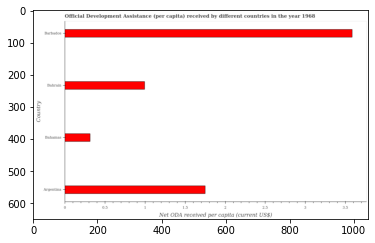

Number of QA =  22





,Country,Net ODA received per capita (current US$)
0,Barbados,3.606928
1,Bahrain,1.008376
2,Argentina,1.763467
3,Bahamas,0.320960


> what is the title of the graph ?
PREDICTED =  Official Development Assistance (per capita) received by different countries in the year 1968
EXPECTED =  Official Development Assistance (per capita) received by different countries in the year 1968




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Net ODA received per capita (current US$)
EXPECTED =  Net ODA received per capita (current US$)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net oda received per capita in bahamas and bahrain ?
PREDICTED =  -0.6874159220814311
EXPECTED =  -0.68




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the

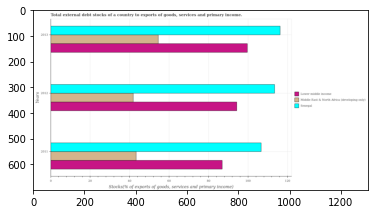

Number of QA =  29





,Years,Senegal,Middle East & North Africa (developing only),Lower middle income
0,2013,117.996126,55.611326,100.768908
1,2011,107.831111,44.007912,87.997061
2,2012,115.147723,42.622237,95.650551


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt stocks in senegal in 2011 and that in 2013 ?
PREDICTED =  -10.16501408865716
EXPECTED =  -9.602846440791012




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt stocks in senegal in 2011 and the total debt stocks in middle east & north africa (developing only) in 2013 ?
PREDICTED =  52.21978515492665
EXPECTED =  52.15051256498877




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the total debt stocks in lower middle income and total debt stocks in middle east & north africa (developing only) ?
PREDICTED = 

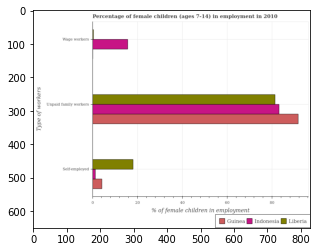

Number of QA =  28





,Type of workers,Liberia,Indonesia,Guinea
0,Wage workers,NaN,15.789155,NaN
1,Self-employed,18.204911,1.458647,4.399532
2,Unpaid family workers,82.267452,83.664631,92.775580


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self employed children in guinea and that in indonesia ?
PREDICTED =  2.940885352487112
EXPECTED =  2.93




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self employed children in indonesia and the percentage of children employed as unpaid family workers in liberia ?
PREDICTED =  1.4586469597061091
EXPECTED =  -80.08999999999999




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the 

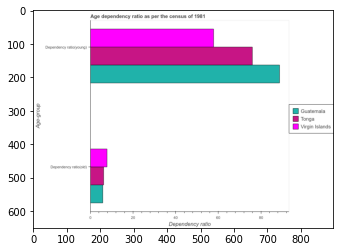

Number of QA =  23





,Age-group,Tonga,Guatemala,Virgin Islands
0,Dependency ratio(old),6.744300,6.285485,8.275056
1,Dependency ratio(young),76.941539,89.529714,58.543585


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the age dependency ratio(young) in guatemala ?
PREDICTED =  44.764856840391396
EXPECTED =  88.7330775581927




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which country was the age dependency ratio(old) maximum?
PREDICTED =  3.3721498720560916
EXPECTED =  Virgin Islands




				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in whi

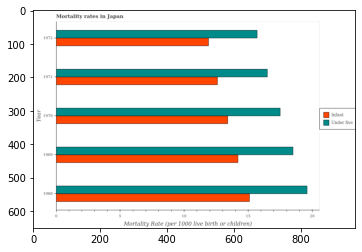

Number of QA =  28





,Year,Infant,Under five
0,1971,12.700486,16.577019
1,1970,13.406898,17.535636
2,1972,11.968231,15.777273
3,1969,14.244254,18.544427
4,1968,NaN,19.655970


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the infant mortality rate in 1970 and that in 1971 ?
PREDICTED =  0.7064123076264135
EXPECTED =  0.8




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1968, what is the difference between the infant mortality rate and under-5 mortality rate ?
PREDICTED =  0.0
EXPECTED =  -4.5




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the under-5 mortality rate in 1970 to that in 1971 ?
PREDICTED =  1.0578281163147765
EXPECTED =  1.061



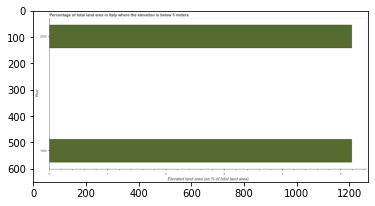

Number of QA =  19





,Year,Elevated land area (as % of total land area)
0,2000,5.238879
1,1990,5.214537


> what is the title of the graph ?
PREDICTED =  Percentage of total land area in Italy where the elevation is below 5 meters
EXPECTED =  Percentage of total land area in Italy where the elevation is below 5 meters




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Elevated land area (as % of total land area)
EXPECTED =  Elevated land area (as % of total land area)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total elevated land area in 1990 and 2000 ?
PREDICTED =  -0.024342051619059113
EXPECTED =  0.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total elevated land area ?
PREDICT

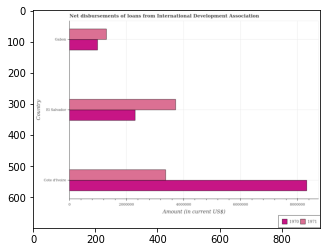

Number of QA =  28





,Country,1971,1970
0,El Salvador,3.757753e+06,2.324103e+06
1,Gabon,1.306583e+06,9.922873e+05
2,Cote d'Ivoire,3.393245e+06,8.376764e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loans disbursed in 1971 in el salvador and that in gabon ?
PREDICTED =  2451169.7830662616
EXPECTED =  2428000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loans disbursed in 1971 in el salvador and the amount of loans disbursed in 1970 in gabon?
PREDICTED =  2451169.7830662616
EXPECTED =  2739000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loans disbursed in 1971 and amount of loans disbursed in 1970 in el salvador ?
PREDICTED =  6133479.07057034
EXPECTED =  1421000.0




				 1 / 3 = 0.3333



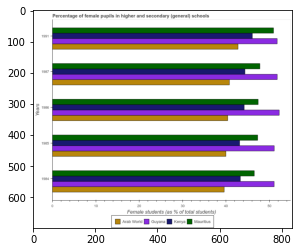

Number of QA =  30





,Years,Arab World,Mauritius,Kenya,Guyana
0,1985,40.520165,47.220234,43.217625,51.553537
1,1984,39.537561,46.517725,43.445583,51.529847
2,1987,40.938427,47.817459,44.259743,NaN
3,1991,42.654158,51.093740,46.392939,51.995649
4,1986,40.444726,47.818131,43.965036,53.471338


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female pupils in higher and secondary schools in mauritius in 1984 and that in 1985 ?
PREDICTED =  1938.7797662509051
EXPECTED =  -0.7773899999999969




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female pupils in higher and secondary schools in kenya in 1985 and the percentage of female pupils in higher and secondary schools in mauritius in 1986 ?
PREDICTED =  1942.0349635076818
EXPECTED =  -4.267789999999998




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1984, what is the difference between the percentage of female pupils in 

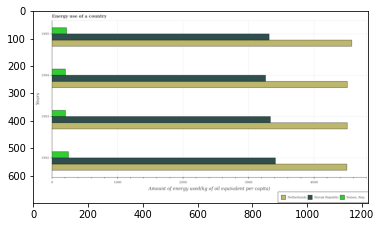

Number of QA =  29





,Years,"Yemen, Rep.",Slovak Republic,Netherlands
0,1992,260.325628,3412.831585,4514.599088
1,1993,214.214740,3345.672018,4524.610901
2,1994,214.965046,3281.181131,4528.274648
3,1995,231.560835,3315.044352,4593.654733


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of energy used in in slovak republic in 1994 and that in 1995 ?
PREDICTED =  -33.863221210612664
EXPECTED =  -54.416164677070356




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of energy used in in slovak republic in 1994 and the amount of energy used in in yemen, rep. in 1992 ?
PREDICTED =  -131.6504546522142
EXPECTED =  3008.394659494337




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1992, what is the difference between the amount of energy used in in yemen, rep. and amount of energy used in in slovak republic ?
PREDICTED =  706.10120257669

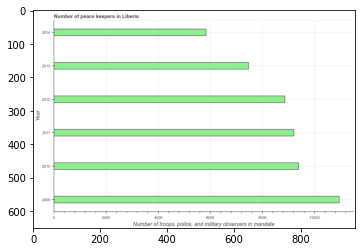

Number of QA =  23





,Year,"Number of troops, police, and military observers in mandate"
0,2014,5849.926192
1,2010,9346.215156
2,2011,9198.075241
3,2013,7425.575141
4,2009,10884.485178
5,2012,8859.171299


> what is the title of the graph ?
PREDICTED =  Number of peace keepers in Liberia
EXPECTED =  Number of peace keepers in Liberia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Number of troops, police, and military observers in mandate
EXPECTED =  Number of troops, police, and military observers in mandate




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of peace keepers in 2010 and 2013 ?
PREDICTED =  1920.640014552263
EXPECTED =  1925.0




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of peace keepers ?
PREDICTED =  2011.5
EXPECTED =  9034.0




				 4 / 5 = 0.8


is_

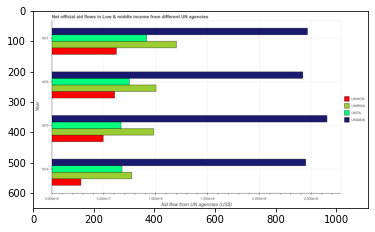

Number of QA =  30





,Year,UNTA,UNRWA,UNAIDS,UNHCR
0,1975,12.134809,17.774898,47.988768,9.065408
1,1976,13.568171,18.159534,43.551494,10.934024
2,1974,12.231294,14.017800,44.417093,5.151825
3,1977,16.517736,21.903940,44.511144,11.275878


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by unta in 1974 and that in 1976 ?
PREDICTED =  -1.3368772135068596
EXPECTED =  -7070000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by unta in 1975 and the amount of aid given by unaids in 1976 ?
PREDICTED =  -1.4333616965208904
EXPECTED =  -175249990




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1977, what is the difference between the amount of aid given by unta and amount of aid given by unrwa ?
PREDICTED =  -17.40416123797796
EXPECTED =  -28770000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_avail

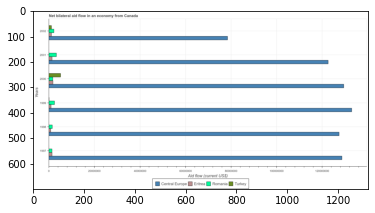

Number of QA =  27





,Years,Turkey,Central Europe,Eritrea,Romania
0,2002,1.344467e+06,7.828983e+07,1.296862e+06,2.374725e+06
1,1998,NaN,1.278418e+08,9.985713e+05,1.679853e+06
2,2001,NaN,1.216578e+08,1.642829e+06,3.491281e+06
3,1999,NaN,1.333116e+08,1.170362e+06,2.548182e+06
4,2000,5.308779e+06,1.306248e+08,1.921047e+06,1.930077e+06
5,1997,NaN,1.279020e+08,1.557689e+06,1.621082e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in eritrea in 1998 and that in 2002 ?
PREDICTED =  -298290.3308667168
EXPECTED =  -300000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in romania in 1998 and the net bilateral aid flow in turkey in 2002 ?
PREDICTED =  -694872.0139998437
EXPECTED =  370000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the net bilateral aid flow in romania and net bilateral aid flow in eritrea ?
PREDICTED =  1756905.1529837493
EXPECTED =  690000.0




				 1 / 3 = 0.3333


is_built_wit

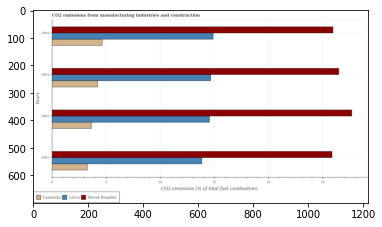

Number of QA =  29





,Years,Cambodia,Latvia,Slovak Republic
0,2003,4.297602,14.762412,26.694976
1,2001,3.289094,13.886190,26.031861
2,2004,4.725122,14.956968,26.044235
3,2002,3.678503,14.673861,27.823501


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in cambodia in 2002 and that in 2003 ?
PREDICTED =  -0.6190997496073924
EXPECTED =  -0.5830456463367804




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in latvia in 2004 and the amount of co2 emitted in cambodia in 2001 ?
PREDICTED =  1.0707782852357273
EXPECTED =  11.608328530981419




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the amount of co2 emitted in cambodia and amount of co2 emitted in slovak republic ?
PREDICTED =  -101.86945195858
EXPECTED =  -22.25653350013439





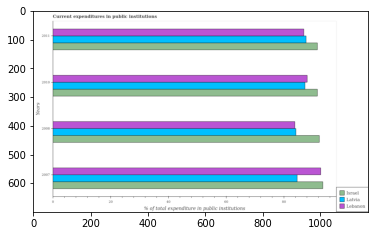

Number of QA =  29





,Years,Lebanon,Latvia,Israel
0,2011,87.231835,88.296547,92.369920
1,2010,88.735336,87.653753,92.044721
2,2007,93.420663,85.656164,94.383538
3,2008,83.793150,84.603410,93.196734


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the current expenditures in public institutions in lebanon in 2008 and that in 2011 ?
PREDICTED =  -3.438684802358324
EXPECTED =  -3.116371154785085




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the current expenditures in public institutions in latvia in 2010 and the current expenditures in public institutions in lebanon in 2008 ?
PREDICTED =  3.0503426681340216
EXPECTED =  3.5052413940428977




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the current expenditures in public institutions in lebanon and current expenditures in 

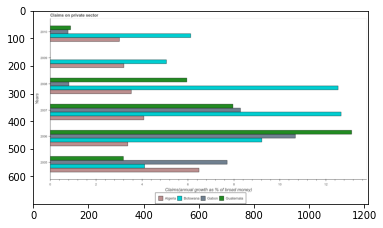

Number of QA =  27





,Years,Botswana,Algeria,Gabon,Guatemala
0,2009,5.039103,3.227765,NaN,NaN
1,2010,6.206021,3.051039,0.815653,0.909243
2,2005,NaN,6.427653,7.738491,3.192256
3,2008,12.574801,3.563480,0.837909,5.977606
4,2006,9.223853,3.406024,10.741032,13.380386
5,2007,NaN,4.092018,8.340631,8.050634


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of broad money claimed on private sector in guatemala in 2007 and that in 2010 ?
PREDICTED =  7.1413913958548845
EXPECTED =  7.070620238862465




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of broad money claimed on private sector in guatemala in 2008 and the percentage of broad money claimed on private sector in botswana in 2007 ?
PREDICTED =  -2.073028161581287
EXPECTED =  -6.71870379949161




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percentage of broad money claimed on private sector in 

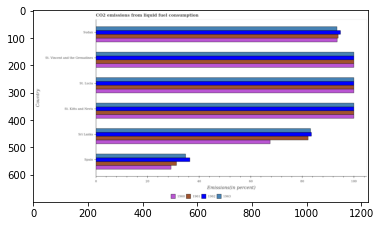

Number of QA =  30





,Country,1963,1962,1961,1960
0,Sri Lanka,84.865421,83.550272,82.570942,68.111578
1,St. Lucia,101.966225,100.399016,101.109351,100.937317
2,Sudan,94.443124,95.475933,93.535715,NaN
3,St. Vincent and the Grenadines,103.241979,100.473034,101.824585,103.801694
4,St. Kitts and Nevis,NaN,100.936379,101.411691,100.762362
5,Spain,35.267080,36.885265,31.593201,29.683067


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1961 in spain and that in st. vincent and the grenadines ?
PREDICTED =  -70.23138432843172
EXPECTED =  -68.7662248941112




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1962 in sri lanka and the total co2 emitted in 1960 in spain?
PREDICTED =  46.66500705227575
EXPECTED =  54.4315349912086




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1961 and total co2 emitted in 1963 in st. kitts and nevis ?
PREDICTED =  5.0
EXPECTED =  0.0




				 1 / 3 = 0.3333


is_built_with_cuda:

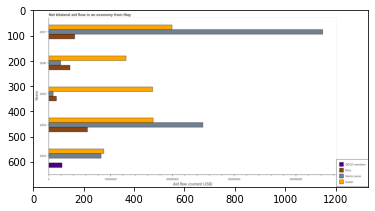

Number of QA =  27





,Years,Unnamed: 1,Sierra Leone,OECD members
0,2003,8.929238e+06,8.548268e+06,2.218419e+06
1,2007,NaN,4.407943e+07,NaN
2,2006,1.252075e+07,2.000484e+06,NaN
3,2004,NaN,2.472610e+07,NaN
4,2005,1.678804e+07,7.916809e+05,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in sierra leone in 2003 and that in 2005 ?
PREDICTED =  7756587.072317796
EXPECTED =  7750000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in sierra leone in 2004 and the net bilateral aid flow in peru in 2007 ?
PREDICTED =  -19353333.248844467
EXPECTED =  20740000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the net bilateral aid flow in sierra leone and net bilateral aid flow in peru ?
PREDICTED =  80143961.42323682
EXPECTED =  -1510000.0




				 1 / 3 = 0.3333



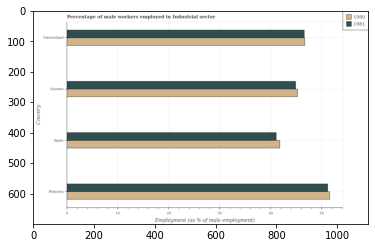

Number of QA =  28





,Country,1980,1981
0,Sweden,45.776912,45.274226
1,Spain,42.124371,41.465562
2,Switzerland,47.295883,46.988867
3,Romania,51.963508,51.365458


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers employed in industrial sector in 1980 in spain and that in switzerland ?
PREDICTED =  -5.171512271011949
EXPECTED =  -4.900001525879006




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers employed in industrial sector in 1981 in romania and the percentage of male workers employed in industrial sector in 1980 in sweden?
PREDICTED =  6.091231485434037
EXPECTED =  5.900001525879006




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers employed in industrial sector in 

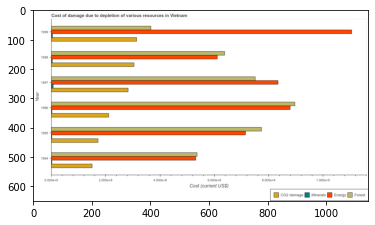

Number of QA =  30





,Year,Forest,CO2 damage,Energy,Minerals
0,1995,7.729789,1.762336,7.215578,NaN
1,1996,9.040123,2.128689,NaN,NaN
2,1997,7.532916,2.864162,NaN,0.083827
3,1998,6.463967,3.063135,6.150110,NaN
4,1999,NaN,3.178760,11.104994,NaN
5,1994,5.386441,1.526917,5.339556,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of energy in 1994 and that in 1997 ?
PREDICTED =  2.47539353727217
EXPECTED =  -302887789.949




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of coal in 1994 and the cost of damage due to depletion of energy in 1998 ?
PREDICTED =  -1.5362174713682064
EXPECTED =  -460747781.2525958




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the cost of damage due to depletion of forests and cost of damage due to depletion of energy ?
PREDICTED =  -1.651843128814309
EXPEC

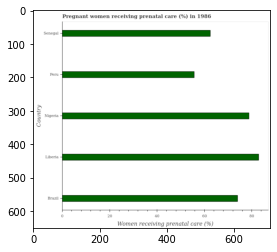

Number of QA =  22





,Country,Women receiving prenatal care (%)
0,Brazil,74.241229
1,Liberia,82.825134
2,Nigeria,79.215490
3,NaN,55.960097
4,Senegal,62.255783


> what is the title of the graph ?
PREDICTED =  Pregnant women receiving prenatal care (%) in 1986
EXPECTED =  Pregnant women receiving prenatal care (%) in 1986




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Women receiving prenatal care (%)
EXPECTED =  Women receiving prenatal care (%)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of pregnant women receiving prenatal care in nigeria and senegal ?
PREDICTED =  16.959706637410925
EXPECTED =  16.3




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of pregnant women receiving prenatal care ?
PREDICTED =  74.

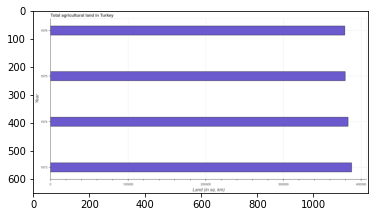

Number of QA =  23





,Year,Land (in sq. km)
0,1976,378420.937982
1,1973,387837.100794
2,1974,383180.409375
3,1975,380453.747194


> what is the title of the graph ?
PREDICTED =  Total agricultural land in Turkey
EXPECTED =  Total agricultural land in Turkey




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Land (in sq. km)
EXPECTED =  Land (in sq. km)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the agricultural land in 1974 and 1975 ?
PREDICTED =  2726.6621806939947
EXPECTED =  3660.0




				 3 / 4 = 0.75


> what is the median agricultural land ?
PREDICTED =  None
EXPECTED =  381450.0




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the agricultural land in 1973 to that in 1976?
PREDICTED =  1.0248827743574587

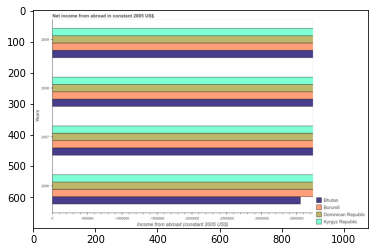

Number of QA =  17





,Years,Kyrgyz Republic,Dominican Republic,Bhutan,Burundi
0,2009,2.247445e+06,2.239779e+06,2.226098e+06,2.222799e+06
1,2007,2.245330e+06,NaN,2.223923e+06,2.231717e+06
2,2006,2.232872e+06,2.213748e+06,2.124502e+06,2.237315e+06
3,2008,2.233072e+06,2.233517e+06,2.230662e+06,2.230631e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net income from abroad in burundi in 2009 and the net income from abroad in bhutan in 2007 ?
PREDICTED =  -8917.563000320457
EXPECTED =  0




				 0 / 1 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Income from abroad (constant 2005 US$)
EXPECTED =  500000.0




				 0 / 2 = 0.0


> what is the title of the graph ?
PREDICTED =  Net income from abroad in constant 2005 US$
EXPECTED =  Net income from abroad in constant 2005 US$




				 1 / 3 = 0.3333


> what is the label or title of the x-axis ?
PREDICTED =  Income from abroad (constant 2005 US$)
EXPECTED =  Income from abroad (constant 2005 US$)




				 2 / 4 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Years
EXPECTED =  Years




				 3 / 5 = 0.6


is_built_with_cuda: True
is_gpu_available: Fa

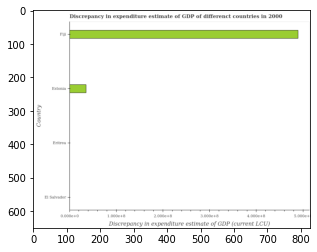

Number of QA =  21





,Country,Discrepancy in expenditure estimate of GDP (current LCU)
0,Fiji,4.869171
1,Eritrea,NaN
2,El Salvador,NaN
3,Estonia,0.356435


> what is the title of the graph ?
PREDICTED =  Discrepancy in expenditure estimate of GDP of differenct countries in 2000
EXPECTED =  Discrepancy in expenditure estimate of GDP of differenct countries in 2000




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Discrepancy in expenditure estimate of GDP (current LCU)
EXPECTED =  Discrepancy in expenditure estimate of GDP (current LCU)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the discrepancy in expenditure estimate of gdp in estonia and fiji ?
PREDICTED =  -4.512736833494902
EXPECTED =  -454106000.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> 

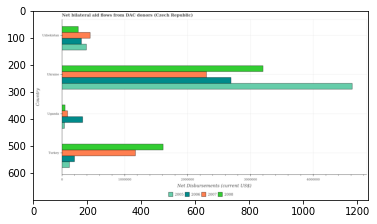

Number of QA =  30





,Country,2007,2005,2008,2006
0,Turkey,1.173339e+06,1.261086e+05,1.622984e+06,2.085051e+05
1,Uganda,9.681146e+04,4.466765e+04,5.416597e+04,3.371914e+05
2,Uzbekistan,4.554422e+05,3.960800e+05,2.631941e+05,3.192508e+05
3,Ukraine,2.296634e+06,4.683645e+06,3.223444e+06,2.737252e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flows in 2008 in uganda and that in uzbekistan ?
PREDICTED =  -209028.12208758414
EXPECTED =  -210000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flows in 2007 in uzbekistan and the net bilateral aid flows in 2008 in turkey?
PREDICTED =  -717897.2954384352
EXPECTED =  -1160000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flows in 2005 and net bilateral aid flows in 2008 in turkey ?
PREDICTED =  -1622980.3638264153
EXPECTED =  -1490000.0




				 1 / 3 = 0.3333


is_built

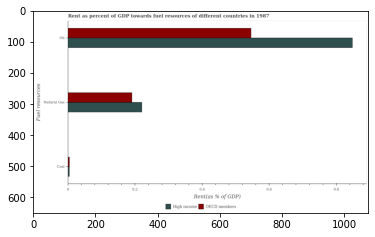

Number of QA =  28





,Fuel resources,OECD members,High income
0,Oil,0.550793,0.857266
1,Natural Gas,0.192678,0.223493
2,Coal,0.005693,0.005295


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rent towards oil in high income and that in oecd members ?
PREDICTED =  0.0
EXPECTED =  0.302394144481935




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rent towards natural gas in oecd members and the rent towards oil in high income ?
PREDICTED =  0.0
EXPECTED =  -0.657505940172881




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rent towards oil and rent towards coal in oecd members ?
PREDICTED =  0.8515726920324442
EXPECTED =  0.5413902040390386




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Traini

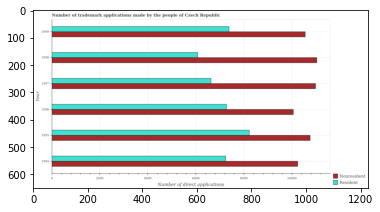

Number of QA =  28





,Year,Resident,Nonresident
0,1996,7303.068505,10198.711190
1,1994,7320.224938,10334.464283
2,1999,7321.341292,10626.770239
3,1995,8293.981273,10858.731955
4,1998,6175.469216,11182.359399
5,1997,6668.045525,11055.419322


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by residents in 1996 and that in 1997 ?
PREDICTED =  0.0
EXPECTED =  644




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by non residents in 1994 and the number of trademark applications made by residents in 1996 ?
PREDICTED =  0.0
EXPECTED =  2967




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the number of trademark applications made by residents and number of trademark applications made by non residents ?
PREDICTED =  0.0
EXPECTED =  -4355




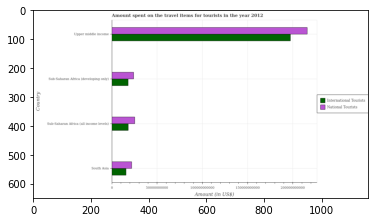

Number of QA =  28





,Country,International Tourists,National Tourists
0,South Asia,2.924573e+10,4.077496e+10
1,Upper middle income,3.598133e+11,3.911494e+11
2,Sub-Saharan Africa (all income levels),3.359396e+10,4.669273e+10
3,Sub-Saharan Africa (developing only),3.356290e+10,4.495131e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on travel items of international tourists in south asia and that in sub-saharan africa (all income levels) ?
PREDICTED =  -4348231984.631821
EXPECTED =  -2491635082.618




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on travel items of international tourists in sub-saharan africa (developing only) and the amount spent on travel items of national tourists in upper middle income ?
PREDICTED =  -326250383217.98267
EXPECTED =  -197906527410.8616




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on trav

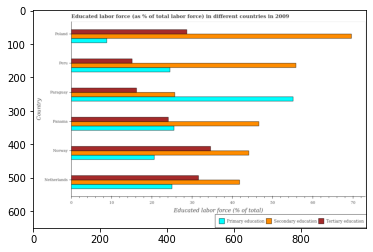

Number of QA =  29





,Country,Secondary education,Tertiary education,Primary education
0,NaN,55.898849,15.220588,24.691227
1,Poland,69.569318,29.021890,9.035824
2,Norway,NaN,34.806500,20.694444
3,Paraguay,25.944562,16.258754,NaN
4,Panama,46.992788,NaN,25.456130
5,Netherlands,42.078499,NaN,25.140201


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received tertiary education in panama and that in poland ?
PREDICTED =  -12.763135504914647
EXPECTED =  -4.6




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received tertiary education in netherlands and the percentage of labor force who received primary education in poland ?
PREDICTED =  -12.763135504914647
EXPECTED =  22.80000019073483




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received tertiary education and percentage of labor force who 

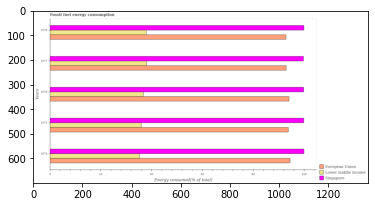

Number of QA =  29





,Years,Singapore,European Union,Lower middle income
0,1976,100.078783,94.970492,NaN
1,1974,100.682393,95.515418,35.3526
2,1978,100.929194,93.423012,NaN
3,1975,100.806078,94.693289,NaN
4,1977,100.706369,93.639407,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of energy consumed in european union in 1975 and that in 1977 ?
PREDICTED =  1.0538827777567974
EXPECTED =  0.8272267167630929




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of energy consumed in european union in 1977 and the percentage of energy consumed in singapore in 1974 ?
PREDICTED =  -1.8760111417327892
EXPECTED =  -6.97592972205878




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1976, what is the difference between the percentage of energy consumed in european union and percentage of energy consumed in singapore ?
PREDICTED =

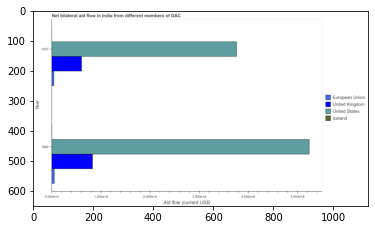

Number of QA =  27





,Year,Iceland,European Union,United Kingdom,United States
0,1970,NaN,0.052691,0.607927,3.723235
1,1969,NaN,0.060046,0.819332,5.244840


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by iceland in 1969 and that in 1970 ?
PREDICTED =  -1.0
EXPECTED =  160000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by iceland in 1969 and the amount of aid given by uk in 1970 ?
PREDICTED =  -0.6079274957858775
EXPECTED =  -60420000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1970, what is the difference between the amount of aid given by uk and amount of aid given by us ?
PREDICTED =  -6.968074609811136
EXPECTED =  -315400000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []

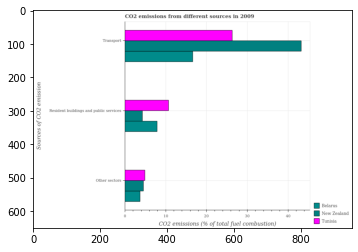

Number of QA =  28





,Sources of CO2 emission,Belarus,New Zealand,Tunisia
0,Other sectors,3.840435,4.710715,5.031232
1,Transport,16.780588,42.969400,26.454852
2,Resident buildings and public services,7.930965,4.391376,10.843123


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of co2 emissions from transport in belarus and that in new zealand ?
PREDICTED =  -41.969400413317814
EXPECTED =  -26.618009987116004




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of co2 emissions from transport in new zealand and the percentage of co2 emissions from other sectors in belarus ?
PREDICTED =  26.18881283293984
EXPECTED =  39.553252421219455




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of co2 emissions from transport and percentage of co2 emissions from other sectors in new zealand ?


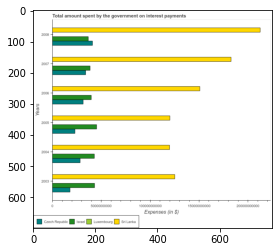

Number of QA =  30





,Years,Luxembourg,Israel,Czech Republic,Sri Lanka
0,2008,NaN,6.939394e+10,7.469876e+10,3.858289e+11
1,2005,NaN,8.353647e+10,4.268009e+10,NaN
2,2006,NaN,7.377264e+10,5.870737e+10,2.735597e+11
3,2003,NaN,7.996453e+10,3.312100e+10,NaN
4,2004,NaN,7.997191e+10,5.201380e+10,NaN
5,2007,NaN,7.184886e+10,6.288100e+10,3.284718e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on interest payments by the government in czech republic in 2004 and that in 2007 ?
PREDICTED =  -10867202571.405998
EXPECTED =  -5623000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on interest payments by the government in czech republic in 2006 and the amount spent on interest payments by the government in israel in 2007 ?
PREDICTED =  -13141491731.629997
EXPECTED =  -7120932043.199997




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting .

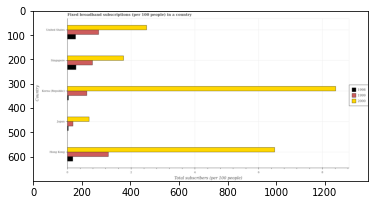

Number of QA =  29





,Country,1999,2000,1998
0,Japan,0.188272,0.694838,0.042268
1,United States,1.000522,2.524988,0.260717
2,Korea (Republic),0.627679,8.385068,0.045748
3,Hong Kong,1.317255,6.528596,0.184511
4,Singapore,0.790040,1.771970,0.283271


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of broadband subscriptions in 1999 in hong kong and that in korea (republic) ?
PREDICTED =  0.6895763389190748
EXPECTED =  0.676542911403612




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of broadband subscriptions in 1999 in singapore and the number of broadband subscriptions in 1998 in united states?
PREDICTED =  -0.2104824207892645
EXPECTED =  0.5309291112896108




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of broadband subscriptions in 1998 and number of broadband subscriptions in 1999 in hong kong ?
PREDIC

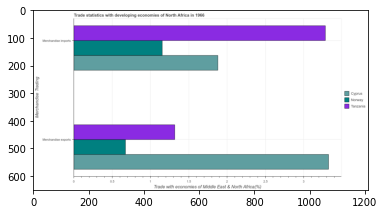

Number of QA =  23





,Merchandise Trading,Tanzania,Cyprus,Norway
0,Merchandise exports,1.324035,3.312473,0.675962
1,Merchandise imports,3.263286,1.881385,1.162362


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in tanzania and that in norway ?
PREDICTED =  0.6480738411747978
EXPECTED =  0.6437873198742758




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in tanzania and the merchandise exports in cyprus ?
PREDICTED =  1.3819006241475553
EXPECTED =  -0.041558323263980235




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the merchandise exports in norway to that in ta

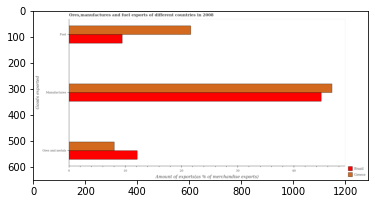

Number of QA =  28





,Goods exported,Greece,Brazil
0,Fuel,22.002192,9.634015
1,Ores and metals,8.102468,12.252262
2,Manufactures,46.883474,45.249446


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of ores and metals exports in brazil and that in greece ?
PREDICTED =  -4.149793706112911
EXPECTED =  4.09258279755848




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of manufactures exports in greece to that in brazil ?
PREDICTED =  1.0361115560265697
EXPECTED =  1.0426358473280537




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []

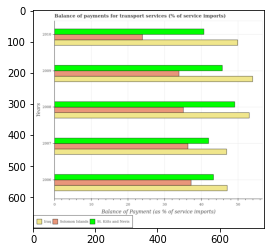

Number of QA =  29





,Years,St. Kitts and Nevis,Solomon Islands,Iraq
0,2009,46.072383,NaN,54.058788
1,2010,40.431071,24.100349,NaN
2,2007,42.265285,NaN,47.603278
3,2006,43.823909,37.713149,NaN
4,2008,49.429551,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services in st. kitts and nevis in 2007 and that in 2009 ?
PREDICTED =  175.94981667361046
EXPECTED =  -3.728560490688295




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services in st. kitts and nevis in 2009 and the balance of payments for transport services in iraq in 2008 ?
PREDICTED =  126.52026551417106
EXPECTED =  -7.338287762568015




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the balance of payments for transport services in solomon islands an

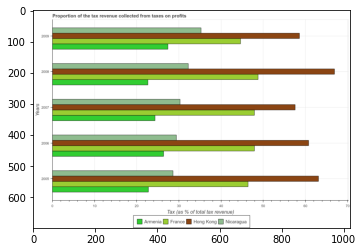

Number of QA =  30





,Years,Armenia,France,Nicaragua,Hong Kong
0,2006,26.491012,48.164737,29.484668,60.696053
1,2009,27.585438,44.636737,35.211885,58.655519
2,2008,22.778778,48.664917,32.480520,67.722825
3,2005,22.711064,46.890419,28.450506,63.429406
4,2007,24.446386,48.349370,30.538954,57.883779


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the tax revenue collected in hong kong in 2006 and that in 2009 ?
PREDICTED =  2.040533455537492
EXPECTED =  2.1848269267034937




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the tax revenue collected in france in 2009 and the proportion of the tax revenue collected in hong kong in 2007 ?
PREDICTED =  -3.712633359457435
EXPECTED =  -12.9554577698607




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the proportion of the tax revenue collected in armenia and proportion of the tax revenue collecte

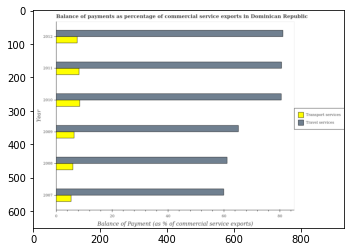

Number of QA =  28





,Year,Travel services,Transport services
0,2012,81.378752,7.800073
1,2007,60.178633,5.511902
2,2010,81.109970,8.592142
3,2009,65.645970,6.601851
4,2011,80.803493,8.321693
5,2008,61.505497,6.147927


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services in 2008 and that in 2009 ?
PREDICTED =  -0.45392422114557274
EXPECTED =  -0.439




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services in 2008 and the balance of payments of travel services in 2009 ?
PREDICTED =  -0.45392422114557274
EXPECTED =  -59.20443114359672




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the balance of payments of travel services and balance of payments of transport services ?
PREDICTED =  -349.24356454899294
EXPECTED =  

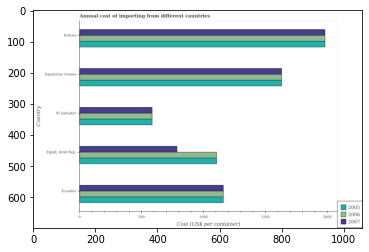

Number of QA =  29





,Country,2007,2005,2006
0,Eritrea,3584.345347,3557.208907,3576.390274
1,Ecuador,2125.933911,NaN,2108.656626
2,"Egypt, Arab Rep.",NaN,2000.403432,1978.631377
3,Equatorial Guinea,2938.783458,2952.995725,2939.135735
4,El Salvador,1065.344330,1063.683385,1065.688117


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual cost of importing in 2007 in ecuador and that in egypt, arab rep. ?
PREDICTED =  2125.9339107983888
EXPECTED =  374.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual cost of importing in 2007 in eritrea and the total annual cost of importing in 2005 in egypt, arab rep.?
PREDICTED =  3584.345346884605
EXPECTED =  875.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual cost of importing in 2007 and total annual cost of importing in 2005 in eritrea ?
PREDICTED =  -2491.8645770232415
EXPECTED =  0.0




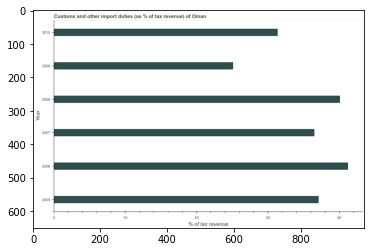

Number of QA =  23





,Year,% of tax revenue
0,2010,31.405007
1,2006,41.389864
2,2007,36.755034
3,2009,25.464822
4,2005,37.170575
5,2008,40.145668


> what is the title of the graph ?
PREDICTED =  Customs and other import duties (as % of tax revenue) of Oman
EXPECTED =  Customs and other import duties (as % of tax revenue) of Oman




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  % of tax revenue
EXPECTED =  % of tax revenue




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the customs and other import duties in 2006 and 2007 ?
PREDICTED =  -3.683954080184556
EXPECTED =  4.722




				 3 / 4 = 0.75


> what is the median customs and other import duties ?
PREDICTED =  None
EXPECTED =  36.77374550907604




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is

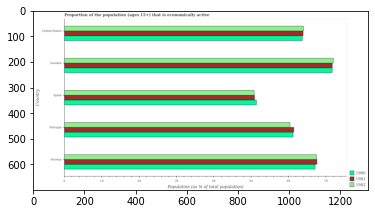

Number of QA =  29





,Country,1982,1980,1981
0,Sweden,71.696724,72.246271,71.746834
1,Portugal,60.958233,61.377915,61.813170
2,United States,64.053469,63.906602,64.037494
3,Norway,67.817718,NaN,67.872211
4,Spain,51.044632,51.390431,51.199184


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the population that is economically active in 1981 in portugal and that in sweden ?
PREDICTED =  -9.933663844247818
EXPECTED =  -10.299995422363303




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the population that is economically active in 1982 in portugal and the proportion of the population that is economically active in 1980 in sweden?
PREDICTED =  -10.738490967367284
EXPECTED =  -11.299995422363303




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the population that is economically active

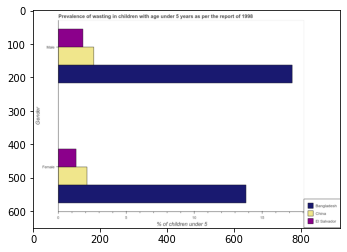

Number of QA =  23





,Gender,El Salvador,China,Bangladesh
0,Male,1.874506,2.615191,17.297132
1,Female,1.345235,2.116002,13.964497


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished female children in bangladesh and that in china ?
PREDICTED =  11.84849542982773
EXPECTED =  11.70000028610233




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished female children in china and the percentage of undernourished male children in bangladesh ?
PREDICTED =  -11.84849542982773
EXPECTED =  -15.10000085830693




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished male children and percentage of undernourished female children in bangladesh ?
PREDICTED = 

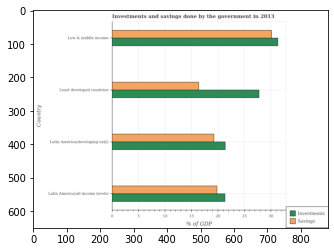

Number of QA =  28





,Country,Savings,Investments
0,Least developed countries,16.501416,27.781019
1,Low & middle income,30.441980,31.254740
2,Latin America(developing only),NaN,21.497640
3,Latin America(all income levels),20.025861,21.499729


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the investments of government in latin america(all income levels) and that in low & middle income ?
PREDICTED =  -9.755011561909981
EXPECTED =  -9.993




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the savings of government in low & middle income and the investments of government in latin america(developing only) ?
PREDICTED =  nan
EXPECTED =  8.7620720472454




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the savings of government and investments of government in least developed countries ?
PREDICTED =  5.821669172536183
EXPECTED =  -11.399





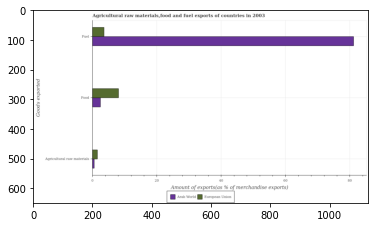

Number of QA =  28





,Goods exported,Arab World,European Union
0,Food,2.664490,8.337648
1,Fuel,81.273253,3.770405
2,Agricultural raw materials,0.746193,1.722388


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of food exports in european union and that in arab world ?
PREDICTED =  0.0
EXPECTED =  5.62173361711778




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of food exports and percentage of raw materials exports in european union ?
PREDICTED =  -5.673157650388054
EXPECTED =  6.56785725370432




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of fuel exports in europe

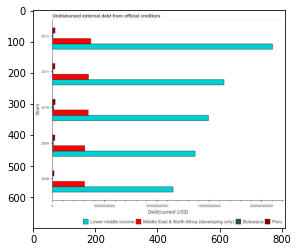

Number of QA =  30





,Years,Botswana,Middle East & North Africa (developing only),Peru,Lower middle income
0,2012,NaN,6.648615e+10,5.484522e+09,NaN
1,2008,NaN,5.638506e+10,3.689792e+09,2.110136e+11
2,2011,NaN,6.342981e+10,5.409904e+09,2.998357e+11
3,2010,NaN,6.249636e+10,5.752433e+09,2.679131e+11
4,2009,NaN,5.674125e+10,5.222835e+09,2.468000e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt in lower middle income in 2008 and that in 2012 ?
PREDICTED =  211013562805.63025
EXPECTED =  -95214639656.2




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt in peru in 2011 and the total debt in botswana in 2012 ?
PREDICTED =  -74617593.52771378
EXPECTED =  1856785000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the total debt in botswana and total debt in peru ?
PREDICTED =  0.0
EXPECTED =  -1437509000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or p

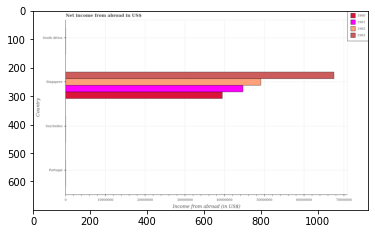

Number of QA =  20





,Country,1963,1962,1961,1960
0,South Africa,NaN,NaN,NaN,NaN
1,Portugal,NaN,NaN,NaN,NaN
2,Seychelles,NaN,NaN,NaN,NaN
3,Singapore,6.772941e+07,4.945758e+07,4.511152e+07,3.886448e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net income from abroad in 1961 in seychelles and the net income from abroad in 1963 in singapore?
PREDICTED =  0.0
EXPECTED =  -67500000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Income from abroad (in US$)
EXPECTED =  10000000.0




				 0 / 3 = 0.0


> what is the title of the graph ?
PREDICTED =  Net income from abroad in US$
EXPECTED =  Net income from abroad in US$




				 1 / 4 = 0.25


> what is the label or title of the x-axis ?
PREDICTED =  Income from abroad (in US$)
EXPECTED =  Income from abroad (in US$)




				 2 / 5 = 0.4


> what is the label or title of the y-axis ?
PREDICTED = 

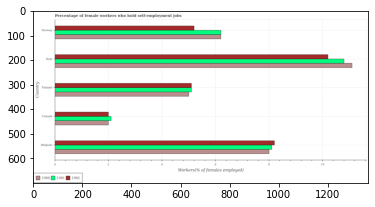

Number of QA =  29





,Country,1982,1980,1981
0,Finland,NaN,NaN,5.135249
1,Norway,5.289335,6.282290,6.252072
2,Canada,2.044530,2.035423,2.111389
3,Italy,10.341993,11.090374,NaN
4,Belgium,8.215448,8.053364,8.106854


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed female workers in 1980 in belgium and that in italy ?
PREDICTED =  -3.037010568940145
EXPECTED =  -3.1000003814697




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed female workers in 1981 in italy and the percentage of self-employed female workers in 1980 in canada?
PREDICTED =  -2.111388850230405
EXPECTED =  8.8000001907349




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed female workers in 1980 and percentage of self-employed female workers in 1981 in it

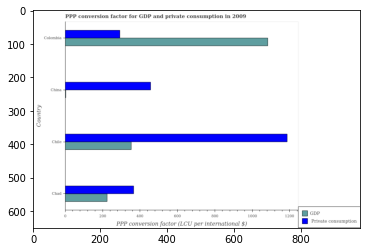

Number of QA =  28





,Country,Private consumption,GDP
0,Chad,368.938898,227.541317
1,Chile,1183.254883,355.101918
2,China,457.714395,NaN
3,Colombia,299.463433,1090.424608


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ppp conversion factor for private consumption in chile and that in colombia ?
PREDICTED =  883.7914509196254
EXPECTED =  894.352




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ppp conversion factor for private consumption in colombia and the ppp conversion factor for gdp in chile ?
PREDICTED =  -883.7914509196254
EXPECTED =  -60.86715646685002




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ppp conversion factor for gdp and ppp conversion factor for private consumption in china ?
PREDICTED =  632.7102138572366
EXPECTED =  -453.376




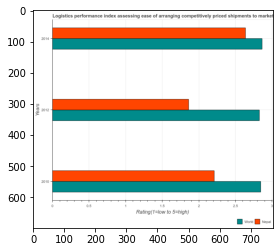

Number of QA =  28





,Years,Nepal,World
0,2014,2.655674,2.863084
1,2010,2.207758,2.845323
2,2012,1.868622,2.815816


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in world in 2012 and that in 2014 ?
PREDICTED =  -0.04726796923223464
EXPECTED =  -0.037311000487010304




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in world in 2010 and the logistic performance index in nepal in 2014 ?
PREDICTED =  -0.01776080854323503
EXPECTED =  0.20792080645161004




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the logistic performance index in nepal and logistic performance index in world ?
PREDICTED =  3.8906465700201665
EXPECTED =  -0.635225

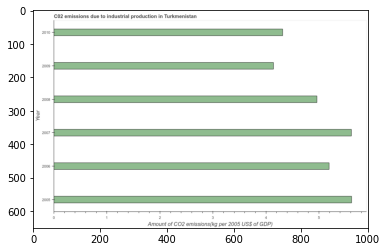

Number of QA =  23





,Year,Amount of CO2 emissions(kg per 2005 US$ of GDP)
0,2010,4.327988
1,2006,5.223885
2,2007,5.622113
3,2009,4.159647
4,2005,5.626328
5,2008,4.988623


> what is the title of the graph ?
PREDICTED =  C02 emissions due to industrial production in Turkmenistan
EXPECTED =  C02 emissions due to industrial production in Turkmenistan




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Amount of CO2 emissions(kg per 2005 US$ of GDP)
EXPECTED =  Amount of CO2 emissions(kg per 2005 US$ of GDP)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emissions in 2007 and 2008 ?
PREDICTED =  0.6334899765120898
EXPECTED =  0.65




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median amount of co2 emissions ?
PREDICTED =  5.1062539501752635
EXPECTED =

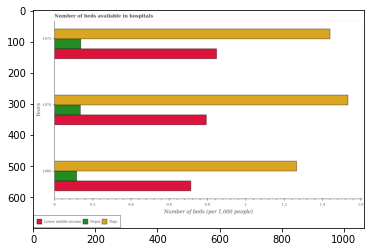

Number of QA =  29





,Years,Unnamed: 1,Nepal,Lower middle income
0,1975,1.438133,0.140567,0.854796
1,1960,1.266303,0.117101,0.716568
2,1970,1.543343,0.139230,0.799411


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of beds in the hospiatls of in lower middle income in 1970 and that in 1975 ?
PREDICTED =  -0.05538562674396619
EXPECTED =  -0.053563373234515765




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of beds in the hospiatls of in lower middle income in 1970 and the number of beds in the hospiatls of in nepal in 1975 ?
PREDICTED =  -0.05538562674396619
EXPECTED =  0.6560288744532412




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1970, what is the difference between the number of beds in the hospiatls of in togo and number of beds in the hospiatls o

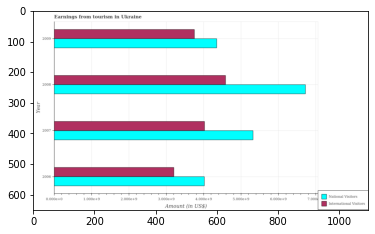

Number of QA =  28





,Year,National Visitors,International Visitors
0,2009,4.350790,3.763536
1,2008,6.727833,4.603575
2,2006,4.037231,3.202664
3,2007,5.322022,4.047914


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from national visitors in 2007 and that in 2009 ?
PREDICTED =  0.9712324231699583
EXPECTED =  971000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from international visitors in 2009 and the amount earned from national visitors in 2008 ?
PREDICTED =  -0.8400389377215016
EXPECTED =  -2971000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the amount earned from international visitors and amount earned from national visitors ?
PREDICTED =  0.0
EXPECTED =  -816000000




				 0 / 3 = 0.0


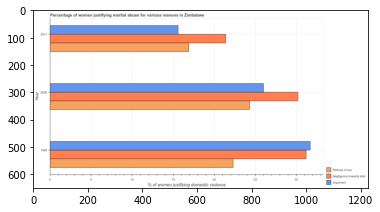

Number of QA =  29





,Year,Negligence towards kids,Argument,Refusal of sex
0,2006,30.572174,26.066993,24.367039
1,2011,21.491287,15.626889,16.985920
2,1999,31.434615,31.807150,22.357127


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of women justifying domestic violence due to arguments in 1999 and that in 2011 ?
PREDICTED =  16.18026123311551
EXPECTED =  16.1




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of women justifying domestic violence due to negligence towards kids in 2006 and the percentage of women justifying domestic violence due to refusal of sex in 2011 ?
PREDICTED =  9.080886877563554
EXPECTED =  13.3




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the percentage of women justifying domestic violence due to refu

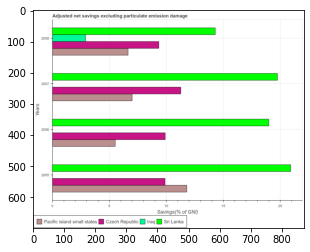

Number of QA =  27





,Years,Czech Republic,Pacific island small states,Sri Lanka,Iraq
0,2008,9.355948,6.714326,14.420941,2.957426
1,2007,11.435667,7.065272,19.872689,NaN
2,2005,9.948488,11.787047,21.026285,NaN
3,2006,10.040447,5.496806,19.043992,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adjusted net savings in pacific island small states in 2006 and that in 2008 ?
PREDICTED =  -1.217519270419837
EXPECTED =  -1.1270705245904695




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adjusted net savings in sri lanka in 2005 and the adjusted net savings in iraq in 2008 ?
PREDICTED =  18.06885907219885
EXPECTED =  18.006923740715628




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the adjusted net savings in pacific island small states and adjusted net savings in czech republic ?
PREDICTED =  27.06345126508851
EXPE

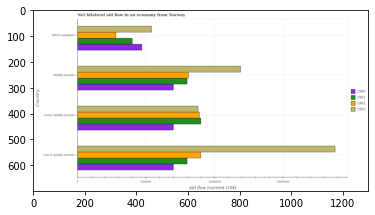

Number of QA =  30





,Country,1963,1962,1961,1960
0,OECD members,9.776719e+05,5.116719e+05,7.301580e+05,8.491858e+05
1,Middle income,2.128334e+06,1.475896e+06,1.466254e+06,1.269121e+06
2,Low & middle income,3.390093e+06,1.630495e+06,1.473700e+06,1.270226e+06
3,Lower middle income,1.589433e+06,1.609470e+06,1.618317e+06,1.261880e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1963 in low & middle income and that in oecd members ?
PREDICTED =  2412420.975787051
EXPECTED =  1340000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1963 in oecd members and the net bilateral aid flow in 1962 in lower middle income?
PREDICTED =  -611760.6344299504
EXPECTED =  -350000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the ne

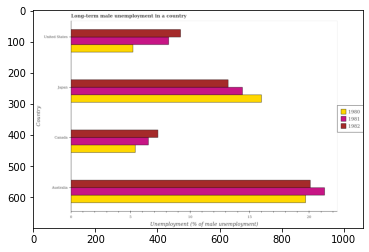

Number of QA =  29





,Country,1982,1980,1981
0,Japan,13.292246,16.120801,14.491753
1,Australia,20.140049,19.817187,21.217926
2,Canada,7.399038,5.444768,6.567048
3,United States,9.309681,5.144907,8.295098


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of long-term unemployed male population in 1981 in canada and that in japan ?
PREDICTED =  -7.924704752256276
EXPECTED =  -7.8999996185303




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of long-term unemployed male population in 1981 in canada and the percentage of long-term unemployed male population in 1982 in united states?
PREDICTED =  -1.728049670545654
EXPECTED =  -2.6999998092651403




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of long-term unemployed male population in 1981 and percentage of

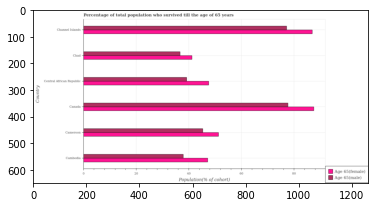

Number of QA =  28





,Country,Age 65(male),Age 65(female)
0,Chad,37.377504,41.454621
1,Canada,78.219527,87.873854
2,Cameroon,45.876928,51.676475
3,Cambodia,38.321421,NaN
4,Channel Islands,77.576665,87.919012
5,Central African Republic,39.583356,47.870572


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male population who survived till age of 65 in canada and that in channel islands ?
PREDICTED =  0.6428621155576906
EXPECTED =  0.504




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male population who survived till age of 65 in cambodia and the percentage of female population who survived till age of 65 in channel islands ?
PREDICTED =  -39.255243994189186
EXPECTED =  -49.00021




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fi

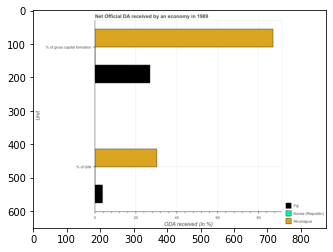

Number of QA =  23





,Unit,Korea (Republic),Unnamed: 2,Nicaragua
0,% of GNI,NaN,4.085145,30.645689
1,% of gross capital formation,NaN,27.214299,87.452122


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received as percentage of gni in nicaragua and that in fiji ?
PREDICTED =  0.0
EXPECTED =  26.56610550259893




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  ODA received (in %)
EXPECTED =  20.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Net Official DA received by an eco

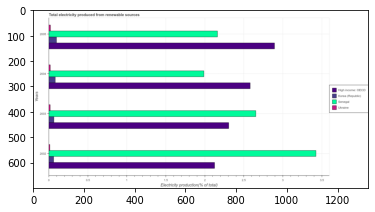

Number of QA =  30





,Years,Korea (Republic),Senegal,High income: OECD,Ukraine
0,2004,0.086415,1.976573,2.576584,0.024377
1,2005,0.103262,2.160149,2.891679,0.026237
2,2003,0.069724,2.650048,2.311896,0.022972
3,2002,0.067821,3.406182,2.132650,0.019805


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced in korea (republic) in 2003 and that in 2005 ?
PREDICTED =  -0.03353810486122112
EXPECTED =  -0.03331651554379282




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced in senegal in 2005 and the total electricity produced in high income: oecd in 2002 ?
PREDICTED =  -0.38808886008969123
EXPECTED =  0.037276045002780034




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the total electricity produced in high income: oecd and total electricity produced in senegal ?
PREDICTED =  5

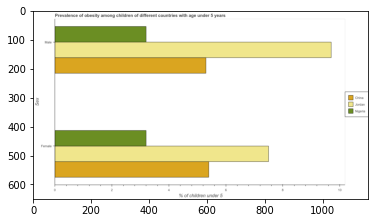

Number of QA =  23





,Sex,China,Nigeria,Jordan
0,Male,5.316122,3.241323,9.907857
1,Female,5.451076,3.218022,7.509037


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of obese female children in jordan and that in nigeria ?
PREDICTED =  4.291015462835043
EXPECTED =  4.299999952316281




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of obese male children in nigeria and the percentage of obese female children in china ?
PREDICTED =  -2.074799015255758
EXPECTED =  -2.200000047683709




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of obese male children and percentage of obese female children in china ?
PREDICTED =  -5.316121916764736
EXPECTED =  -0.09999990463256658




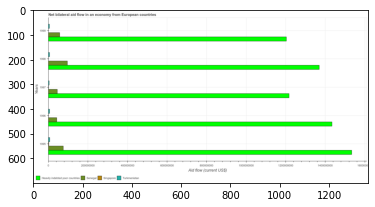

Number of QA =  30





,Years,Senegal,Singapore,Turkmenistan,Heavily indebted poor countries
0,1995,7.727954e+07,NaN,8.656871e+06,1.536838e+09
1,1999,5.932107e+07,NaN,7.480444e+06,1.209570e+09
2,1998,9.925257e+07,NaN,8.231609e+06,1.378147e+09
3,1997,4.719148e+07,NaN,6.132840e+06,1.223633e+09
4,1996,4.401324e+07,NaN,8.494640e+06,1.432990e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in senegal in 1995 and the net bilateral aid flow in turkmenistan in 1999 ?
PREDICTED =  17958471.209599756
EXPECTED =  70050000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net bilateral aid flow in senegal in 1995 to that in 1998 ?
PREDICTED =  0.7786150129982908
EXPECTED =  0.7854157960718763




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_availa

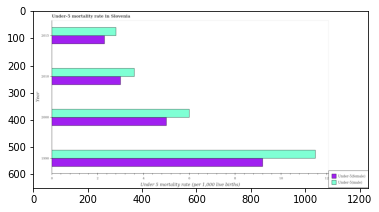

Number of QA =  28





,Year,Under-5(male),Under-5(female)
0,2010,3.645710,3.044564
1,2015,2.860240,2.317764
2,1990,11.609947,9.264659
3,2000,6.119373,5.014414


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-5 male mortality rate in 1990 and that in 2000 ?
PREDICTED =  5.490574097112825
EXPECTED =  5.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-5 female mortality rate in 1990 and the under-5 male mortality rate in 2015 ?
PREDICTED =  6.946895113418131
EXPECTED =  6.3999999999999995




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the under-5 female mortality rate and under-5 male mortality rate ?
PREDICTED =  0.0
EXPECTED =  -2.3




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs:

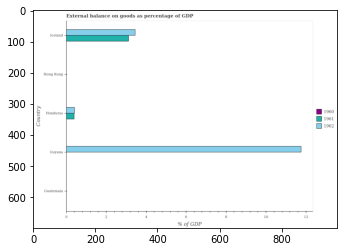

Number of QA =  22





,Country,1962,1961,1960
0,Guyana,11.853122,NaN,NaN
1,Hong Kong,NaN,NaN,NaN
2,Iceland,3.501330,3.148202,NaN
3,Honduras,0.438865,0.427373,NaN
4,Guatemala,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the external balance on goods as percentage of gdp in 1961 in honduras and that in iceland ?
PREDICTED =  -2.7208288345355833
EXPECTED =  -2.7257169102049144




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the external balance on goods as percentage of gdp in 1962 in guyana and the external balance on goods as percentage of gdp in 1960 in hong kong?
PREDICTED =  -3.5013297283867546
EXPECTED =  11.7594254937163




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fin

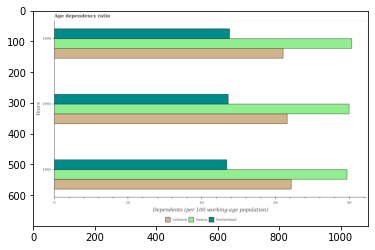

Number of QA =  29





,Years,Lebanon,Switzerland,Samoa
0,1994,62.534284,48.269473,81.312136
1,1992,65.054820,47.291657,80.109771
2,1993,63.585803,47.914991,80.312456


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the age dependency ratio in in samoa in 1993 ?
PREDICTED =  26.770818740921992
EXPECTED =  79.9248905101635




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum age dependency ratio in in samoa ?
PREDICTED =  664.6666666666666
EXPECTED =  80.63183579118598




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum age dependency ratio in in switzerland ?
PREDICTED =  664.0
EXPECTED =  46.7641029100233




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year 

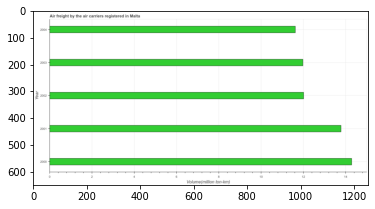

Number of QA =  23





,Year,Volume(million ton-km)
0,2004,11.622703
1,2003,11.988378
2,2002,12.027106
3,2001,13.805019
4,2000,14.273088


> what is the title of the graph ?
PREDICTED =  Air freight by the air carriers registered in Malta
EXPECTED =  Air freight by the air carriers registered in Malta




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Volume(million ton-km)
EXPECTED =  Volume(million ton-km)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the air freight in 2000 and 2001 ?
PREDICTED =  0.46806913541462336
EXPECTED =  0.505




				 3 / 4 = 0.75


> what is the median air freight ?
PREDICTED =  None
EXPECTED =  12.014




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the air freight in 2000 to that in 2003?
PRE

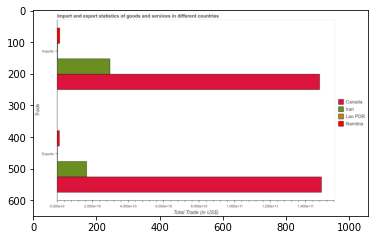

Number of QA =  23





,Trade,lran,Lao PDR,Namibia,Canada
0,Imports,2.981677,NaN,0.169404,14.802250
1,Exports,1.675376,NaN,0.155249,15.008092


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Total Trade (in US$)
EXPECTED =  20000000000.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Import and export statistics of goods and services in different countries
EXPECTED =  Import and export statistics of goods and services in different countries




				 1 / 6 =

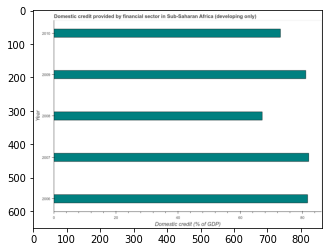

Number of QA =  23





,Year,Domestic credit (% of GDP)
0,2006,81.938280
1,2007,82.323416
2,2010,73.349129
3,2009,81.546007
4,2008,66.904395


> what is the title of the graph ?
PREDICTED =  Domestic credit provided by financial sector in Sub-Saharan Africa (developing only)
EXPECTED =  Domestic credit provided by financial sector in Sub-Saharan Africa (developing only)




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Domestic credit (% of GDP)
EXPECTED =  Domestic credit (% of GDP)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the domestic credit provided by financial sector in 2007 and 2008 ?
PREDICTED =  15.419021076739824
EXPECTED =  14.984




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median domestic credit provided by financi

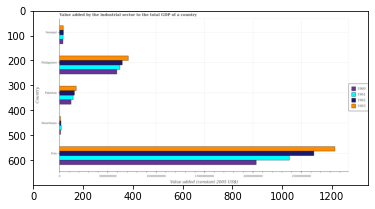

Number of QA =  30





,Country,1963,1962,1961,1960
0,Senegal,8.135438e+08,8.222576e+08,7.746553e+08,7.386274e+08
1,Mauritania,2.935265e+08,3.523895e+08,4.268123e+08,2.920472e+08
2,Philippines,1.283475e+10,1.170433e+10,1.135273e+10,1.077822e+10
3,Pakistan,3.204116e+09,2.852847e+09,2.631640e+09,2.240194e+09
4,Iran,5.047175e+10,4.750006e+10,4.302025e+10,3.701257e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector in 1960 in mauritania and that in senegal ?
PREDICTED =  -446580225.7591549
EXPECTED =  -242429991.55843598




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector in 1960 in philippines and the value added by the industrial sector in 1961 in pakistan?
PREDICTED =  8538029288.629015
EXPECTED =  4520846287.23897




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector in 1963 and value added by the industrial sector in 1962 in iran ?
PREDICTED

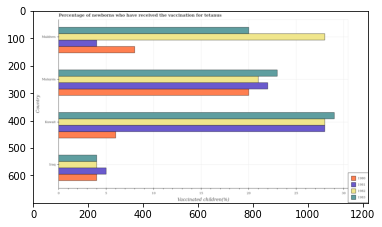

Number of QA =  30





,Country,1982,1980,1983,1981
0,Kuwait,28.045250,6.155327,28.960391,28.034476
1,Iraq,4.060627,4.090035,4.041605,5.072161
2,Maldives,27.640140,8.075473,19.956093,4.068188
3,Malaysia,21.114625,20.075656,22.899729,22.103909


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of vaccinated children in 1983 in kuwait and that in malaysia ?
PREDICTED =  6.060661580397024
EXPECTED =  6.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of vaccinated children in 1981 in malaysia and the percentage of vaccinated children in 1980 in iraq?
PREDICTED =  18.013874231566177
EXPECTED =  18.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of vaccinated children in 1982 and percentage of vaccinated children in 1981 in kuwait ?
PREDICTED =  -23.973848448383507
EXPECTED =  0.0




				 2 

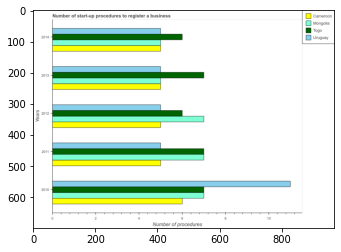

Number of QA =  30





,Years,Togo,Uruguay,Cameroon,Mongolia
0,2014,6.066992,NaN,5.031976,NaN
1,2010,7.038643,10.983321,6.036208,6.969349
2,2011,6.991598,5.029626,5.039121,6.966481
3,2012,6.026745,5.045130,5.019864,7.065635
4,2013,6.989466,5.004583,5.031307,5.015125


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of procedures required to register a business in cameroon in 2011 and that in 2014 ?
PREDICTED =  0.0
EXPECTED =  0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of procedures required to register a business in uruguay in 2013 and the number of procedures required to register a business in cameroon in 2012 ?
PREDICTED =  0.0
EXPECTED =  0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2014, what is the difference between the number of procedures required to register a business in mongolia and number of procedures required to register a busi

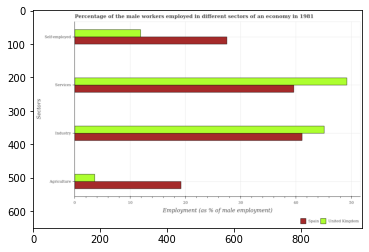

Number of QA =  29





,Sectors,United Kingdom,Spain
0,Industry,45.043356,41.657318
1,Services,49.270894,39.586336
2,Agriculture,3.776940,19.358068
3,Self-employed,12.115729,27.695970


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self employed male workers in united kingdom and that in spain ?
PREDICTED =  -15.580241204073367
EXPECTED =  -15.6000003814697




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers in industry in spain and the percentage of male workers in services in united kingdom ?
PREDICTED =  41.65731751978755
EXPECTED =  -8.100002288818402




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers in agriculture and percentage of self employed male workers in united kingdom ?
PREDICTED =  -8.33

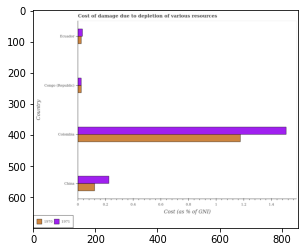

Number of QA =  28





,Country,1971,1970
0,China,0.231201,0.124696
1,Ecuador,0.037307,0.029479
2,Colombia,1.523183,1.180344
3,Congo (Republic),0.029135,0.029343


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of various resources in 1970 in congo (republic) and that in ecuador ?
PREDICTED =  -0.02947924537363817
EXPECTED =  0.00019454686237500157




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of various resources in 1970 in china and the cost of damage caused due to the depletion of various resources in 1971 in congo (republic)?
PREDICTED =  0.09535287453226082
EXPECTED =  0.0965240215861262




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage 

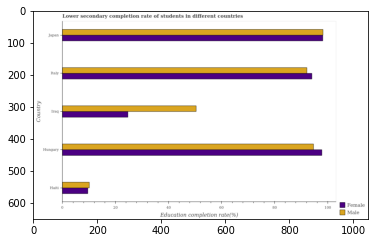

Number of QA =  28





,Country,Female,Male
0,Japan,98.522519,98.543535
1,Iraq,24.940634,50.736215
2,Haiti,9.791946,10.475988
3,Italy,94.021569,92.693659
4,Hungary,98.195440,94.926955


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the education completion rate of male students in hungary and that in japan ?
PREDICTED =  -3.6165802057445546
EXPECTED =  -3.577




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the education completion rate of female students in haiti and the education completion rate of male students in italy ?
PREDICTED =  -84.2296228077902
EXPECTED =  -82.58605




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the education completion rate of male students and education completion rate of female students in iraq ?
PREDICTED =  296.64013609928355
EXPECTED =  25.

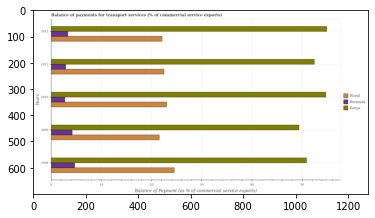

Number of QA =  29





,Years,Bermuda,Kenya,World
0,2012,3.407314,54.860847,22.468040
1,2010,2.814947,55.330795,23.272111
2,2011,3.013858,52.966989,22.751324
3,2008,4.809741,51.410268,24.453445
4,2009,4.379616,49.846136,21.787921


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services in world in 2009 and that in 2012 ?
PREDICTED =  -0.6801189184261673
EXPECTED =  -0.5699354466629991




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services in world in 2010 and the balance of payments for transport services in kenya in 2009 ?
PREDICTED =  1.484189702959295
EXPECTED =  -26.3667339305353




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the balance of payments for transport services in kenya and balance of payments for transport s

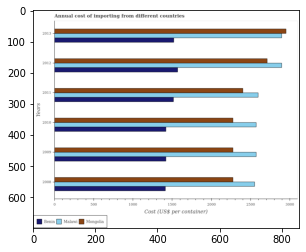

Number of QA =  29





,Years,Malawi,Mongolia,Benin
0,2013,5239.315215,NaN,2755.238216
1,2011,4670.394520,4391.452438,2749.984284
2,2012,NaN,4905.879114,2814.127150
3,2009,4648.362270,4146.172235,2569.686540
4,2010,NaN,4097.016331,2578.539823
5,2008,4635.944769,4105.465068,2551.582135


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual cost of importing in malawi in 2011 and that in 2012 ?
PREDICTED =  0.0
EXPECTED =  -300




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual cost of importing in mongolia in 2010 and the total annual cost of importing in benin in 2011 ?
PREDICTED =  -294.4361065063513
EXPECTED =  758




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the total annual cost of importing in benin and total annual cost of importing in malawi ?
PREDICTED =  16015.158148855695
EXPECTED =  -1150




				 0 / 3 = 0.0


is_buil

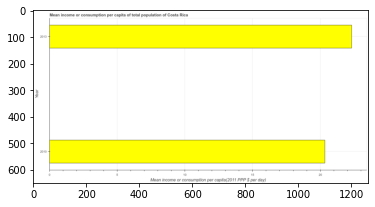

Number of QA =  19





,Year,Mean income or consumption per capita(2011 PPP $ per day)
0,2010,20.523566
1,2013,22.466337


> what is the title of the graph ?
PREDICTED =  Mean income or consumption per capita of total population of Costa Rica
EXPECTED =  Mean income or consumption per capita of total population of Costa Rica




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Mean income or consumption per capita(2011 PPP $ per day)
EXPECTED =  Mean income or consumption per capita(2011 PPP $ per day)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the mean income or consumption in 2010 and 2013 ?
PREDICTED =  -1.9427714067369735
EXPECTED =  -1.982




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median mean income or c

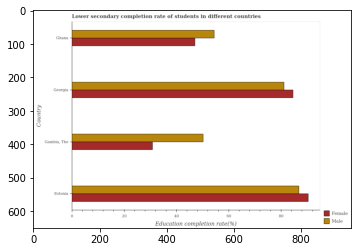

Number of QA =  28





,Country,Female,Male
0,Georgia,84.430500,81.816444
1,Ghana,47.373945,55.294134
2,Estonia,90.965943,87.104074
3,"Gambia, The",31.190429,50.583921


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the education completion rate of male students in estonia and that in georgia ?
PREDICTED =  5.287630972818889
EXPECTED =  5.709




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the education completion rate of male students in ghana and the education completion rate of female students in georgia ?
PREDICTED =  -26.522309417133833
EXPECTED =  -30.130870819091797




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the education completion rate of female students and education completion rate of male students in estonia ?
PREDICTED =  162.9948740666204


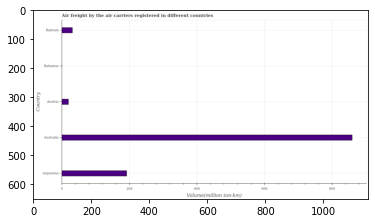

Number of QA =  22





,Country,Volume(million ton-km)
0,Bahamas,NaN
1,Austria,20.639525
2,Australia,859.596827
3,Bahrain,32.800617
4,Argentina,194.489980


> what is the title of the graph ?
PREDICTED =  Air freight by the air carriers registered in different countries
EXPECTED =  Air freight by the air carriers registered in different countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Volume(million ton-km)
EXPECTED =  Volume(million ton-km)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the air freight in argentina and bahrain ?
PREDICTED =  161.68936261367728
EXPECTED =  160.6




				 4 / 4 = 1.0


> what is the median air freight ?
PREDICTED =  None
EXPECTED =  31.3999996185




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the rat

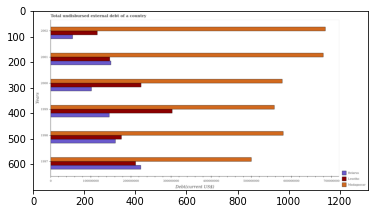

Number of QA =  29





,Years,Belarus,Lesotho,Madagascar
0,1999,1.486186e+08,2.998063e+08,5.523974e+08
1,2001,1.499823e+08,NaN,6.767901e+08
2,1998,1.637199e+08,1.798940e+08,5.791479e+08
3,2002,5.541659e+07,1.170467e+08,6.809459e+08
4,1997,2.261898e+08,2.131713e+08,5.023759e+08
5,2000,1.029888e+08,2.279061e+08,5.766284e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total undisbursed external debt in madagascar in 1999 and that in 2000 ?
PREDICTED =  -24231035.782480836
EXPECTED =  -19713000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total undisbursed external debt in belarus in 1998 and the total undisbursed external debt in madagascar in 1997 ?
PREDICTED =  -62469888.311113834
EXPECTED =  -338760000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the total undisbursed external debt in lesotho and total undisbursed external debt in belarus ?
PREDICTED =  1037824351.4866393
E

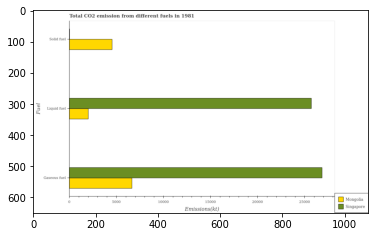

Number of QA =  28





,Fuel,Singapore,Mongolia
0,Solid fuel,NaN,8380.012644
1,Gaseous fuel,48351.368053,12106.205306
2,Liquid fuel,46070.718555,3782.958140


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emissions from liquid fuel in singapore and that in mongolia ?
PREDICTED =  42287.76041469069
EXPECTED =  23707.155




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emissions from gaseous fuel in mongolia and the amount of co2 emissions from liquid fuel in singapore ?
PREDICTED =  -36245.16274618769
EXPECTED =  -19064.733




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emissions from gaseous fuel and amount of co2 emissions from solid fuel in mongolia ?
PREDICTED =  -20485.217950566243
EXPECTED

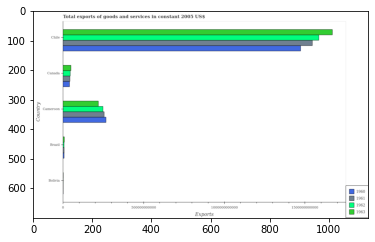

Number of QA =  30





,Country,1963,1962,1961,1960
0,Bolivia,NaN,NaN,NaN,NaN
1,Chile,3.028448e+12,2.863719e+12,2.805295e+12,2.651096e+12
2,Canada,9.444253e+10,8.795869e+10,8.576160e+10,7.990576e+10
3,Cameroon,3.993875e+11,4.575768e+11,4.699404e+11,4.840587e+11
4,Brazil,2.205735e+10,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total exports of goods and services in 1963 in brazil and that in cameroon ?
PREDICTED =  -421444833640.45605
EXPECTED =  -210736425500.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total exports of goods and services in 1962 in bolivia and the total exports of goods and services in 1960 in cameroon?
PREDICTED =  -457576839337.4493
EXPECTED =  -265287384500.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total exports of goods and services in 1963 and total exports of goods and services in 1961 in canada ?
PREDICTED =  -94442526

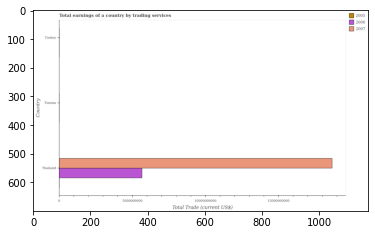

Number of QA =  20





,Country,2007,2005,2006
0,Turkey,NaN,NaN,NaN
1,Tunisia,NaN,NaN,NaN
2,Thailand,3.395871e+10,NaN,1.031508e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total earnings in 2005 in thailand and the total earnings in 2007 in turkey?
PREDICTED =  0.0
EXPECTED =  0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total earnings in 2006 and total earnings in 2007 in thailand ?
PREDICTED =  10315075488.688612
EXPECTED =  -13012698096.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the lowest total earnings in 2006 ?
PREDICTED =  33958711773.72645
EXPECTED =  5660291210.0




				 1 / 3 = 0.3333


> what is the difference between two consecutive major ticks on the x-axis ?
PREDIC

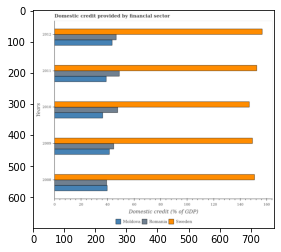

Number of QA =  29





,Years,Sweden,Moldova,Romania
0,2012,157.051865,44.165028,47.691853
1,2011,154.580191,39.724301,49.837345
2,2009,151.666430,42.214568,45.422455
3,2008,152.956764,40.565573,40.146809
4,2010,149.750053,36.705252,48.437199


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the domestic credit in moldova in 2009 and that in 2012 ?
PREDICTED =  -1.9504608138954538
EXPECTED =  -2.0794280705375954




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the domestic credit in moldova in 2011 and the domestic credit in sweden in 2012 ?
PREDICTED =  -4.440727807056575
EXPECTED =  -117.5464142136301




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the domestic credit in sweden and domestic credit in romania ?
PREDICTED =  105.45804928285246
EXPECTED =  110.02802141147671




				 1 / 3 = 0.3333


is_built_with_cud

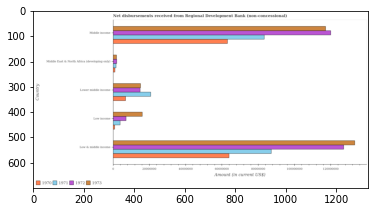

Number of QA =  30





,Country,1972,1971,1970,1973
0,Lower middle income,1.529073e+07,2.141791e+07,7.318003e+06,1.557842e+07
1,Low income,7.514862e+06,4.239844e+06,1.160848e+06,1.669508e+07
2,Low & middle income,1.278063e+08,8.850434e+07,6.443874e+07,1.343372e+08
3,Middle income,1.203956e+08,8.422519e+07,NaN,1.182015e+08
4,Middle East & North Africa (developing only),2.304215e+06,2.075667e+06,1.349394e+06,2.306992e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from regional development bank in 1972 in low income and that in middle east & north africa (developing only) ?
PREDICTED =  5210646.559222437
EXPECTED =  5113000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from regional development bank in 1973 in lower middle income and the amount of disbursements received from regional development bank in 1970 in middle income?
PREDICTED =  0.0
EXPECTED =  -47923000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of di

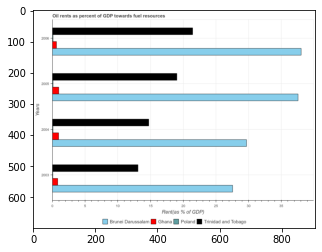

Number of QA =  30





,Years,Poland,Brunei Darussalarr,Ghana,Trinidad and Tobago
0,2003,NaN,27.784177,0.879004,13.213408
1,2006,NaN,37.999375,0.683779,21.543119
2,2004,NaN,29.893616,1.015568,14.831527
3,2005,NaN,37.724584,1.039972,19.135744


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oil rent in trinidad and tobago in 2003 and that in 2006 ?
PREDICTED =  -5.816226126147976
EXPECTED =  -8.350830273695001




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oil rent in ghana in 2004 and the oil rent in poland in 2005 ?
PREDICTED =  -0.02440405140637214
EXPECTED =  0.8477250775913954




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the oil rent in poland and oil rent in brunei darussalam ?
PREDICTED =  -95.40237573933197
EXPECTED =  -27.488423440794982




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_av

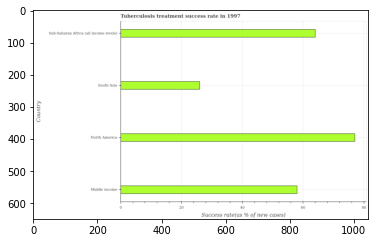

Number of QA =  22





,Country,Success rate(as % of new cases)
0,South Asia,26.273807
1,Middle income,58.083993
2,North America,77.681193
3,Sub-Saharan Africa (all income levels),64.572584


> what is the title of the graph ?
PREDICTED =  Tuberculosis treatment success rate in 1997
EXPECTED =  Tuberculosis treatment success rate in 1997




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Success rate(as % of new cases)
EXPECTED =  Success rate(as % of new cases)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the tuberculosis treatment success rate in south asia and sub-saharan africa (all income levels) ?
PREDICTED =  -38.29877711544746
EXPECTED =  -38.0




				 4 / 4 = 1.0


> what is the median tuberculosis treatment success rate ?
PREDICTED =  None
EXPECTED =  61.0




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished 

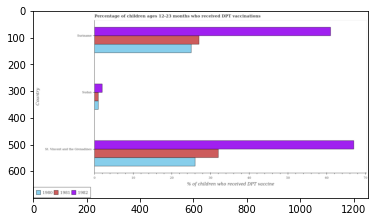

Number of QA =  29





,Country,1982,1980,1981
0,St. Vincent and the Grenadines,67.850131,26.042654,32.198776
1,Suriname,61.492974,25.199950,27.077113
2,Sudan,2.069945,1.080815,1.071999


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of children who received dpt vaccination in 1982 in st. vincent and the grenadines to that in sudan ?
PREDICTED =  32.77870671799222
EXPECTED =  33.5




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 5 = 0.2


is_built_with_cuda: True
is_gpu_availab

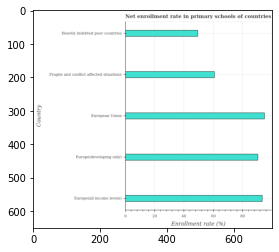

Number of QA =  22





,Country,Enrollment rate (%)
0,European Union,96.263891
1,Heavily indebted poor countries,50.007683
2,Europe(all income levels),94.785104
3,Europe(developing only),91.373467
4,Fragile and conflict affected situations,61.693451


> what is the title of the graph ?
PREDICTED =  Net enrollment rate in primary schools of countries
EXPECTED =  Net enrollment rate in primary schools of countries in the year 1985




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Enrollment rate (%)
EXPECTED =  Enrollment rate (%)




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrollment rate in primary schools in europe(all income levels) and european union ?
PREDICTED =  -96.26389080991936
EXPECTED =  -1.547




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median net enrollment rate in primary schools ?
PREDICTED =  91.3734669

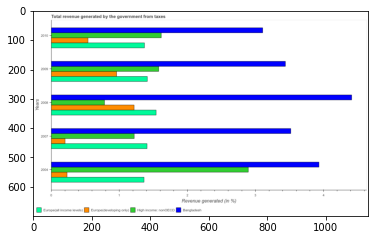

Number of QA =  30





,Years,Europe(all income levels.,Europe(developing only),Bangladesh,High income: nonOECD
0,2009,1.437490,0.973060,3.447284,1.578025
1,2008,1.547720,1.217390,4.475555,0.792007
2,2004,1.381424,0.239017,3.987872,2.906309
3,2007,1.416782,0.206227,3.538591,1.225552
4,2010,1.384604,0.549829,3.108574,1.634960


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total revenue generated in europe(all income levels) in 2004 and that in 2007 ?
PREDICTED =  -0.03535815945486798
EXPECTED =  -0.04450000881751004




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total revenue generated in europe(all income levels) in 2010 and the total revenue generated in europe(developing only) in 2007 ?
PREDICTED =  -1.5798981132626364
EXPECTED =  1.166966996337529




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the total revenue generated in europe(all income levels) and total revenue generated in eu

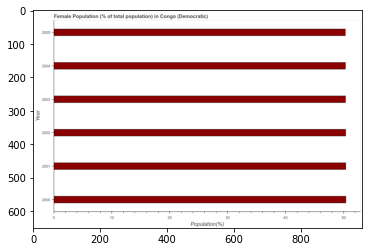

Number of QA =  23





,Year,Population(%)
0,2005,50.099493
1,2001,50.519064
2,2002,50.507714
3,2004,50.598463
4,2000,50.560005
5,2003,50.445279


> what is the title of the graph ?
PREDICTED =  Female Population (% of total population) in Congo (Democratic)
EXPECTED =  Female Population (% of total population) in Congo (Democratic)




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Population(%)
EXPECTED =  Population(%)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female population in 2004 and 2005 ?
PREDICTED =  0.4989692042244229
EXPECTED =  0.019




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median female population ?
PREDICTED =  50.51338946428261
EXPECTED =  50.346053892907946




				 4 / 5 = 0.8


is_built_with_cuda: True


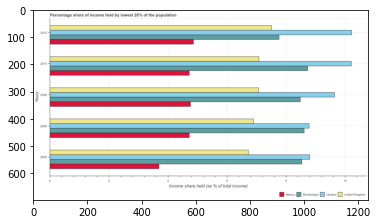

Number of QA =  30





,Years,United Kingdom,Mexico,Ukraine,Montenegro
0,2008,7.100388,4.799637,9.582068,8.598318
1,2012,7.533399,4.875806,10.625453,7.771361
2,2005,6.754186,NaN,8.797931,8.508803
3,2006,6.964098,4.758258,8.802139,8.638764
4,2010,7.104549,4.740222,10.307915,8.724940


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage share of income held by lowest 20% of the population in montenegro in 2008 and that in 2012 ?
PREDICTED =  0.8269564151941937
EXPECTED =  0.7200000000000006




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage share of income held by lowest 20% of the population in montenegro and percentage share of income held by lowest 20% of the population in mexico ?
PREDICTED =  2005.2003632959306
EXPECTED =  4.010000000000001




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs:

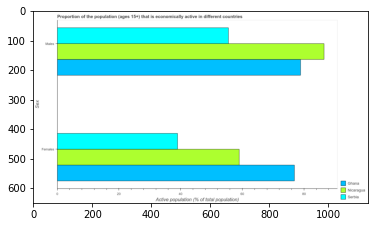

Number of QA =  23





,Sex,Serbia,Ghana,Nicaragua
0,Males,56.163628,79.835947,86.788593
1,Females,39.172894,77.317535,59.309387


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active female population in serbia and that in nicaragua ?
PREDICTED =  -20.13649246286903
EXPECTED =  -20.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active female population in nicaragua and the percentage of economically active male population in serbia ?
PREDICTED =  20.13649246286903
EXPECTED =  3.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active male population and percentage of economically active female population in serbia ?
PREDICTE

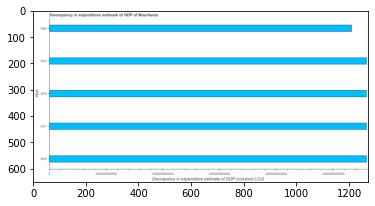

Number of QA =  12





,Year,Discrepancy in expenditure estimate of GDP (constant LCU)
0,1980,1.074564e+13
1,1978,1.125351e+13
2,1979,1.129077e+13
3,1976,1.123388e+13
4,1977,1.126112e+13


> what is the title of the graph ?
PREDICTED =  Discrepancy in expenditure estimate of GDP of Mauritania
EXPECTED =  Discrepancy in expenditure estimate of GDP of Mauritania




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Discrepancy in expenditure estimate of GDP (constant LCU)
EXPECTED =  Discrepancy in expenditure estimate of GDP (constant LCU)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median discrepancy in expenditure estimate of gdp ?
PREDICTED =  11253506767983.45
EXPECTED =  0.0




				 3 / 4 = 0.75


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Discrepancy in expenditure estimate of GDP (constant LCU)
EXPECTED =  2000000000000.0




				 3 / 5 = 0.6


is_built_with_cuda: Tr

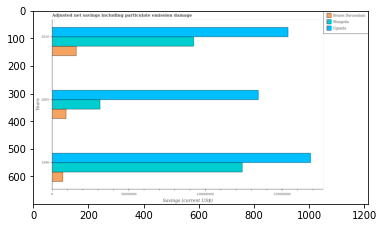

Number of QA =  29





,Years,Brunei Darussalam,Mongolia,Uganda
0,2010,2.862474e+07,1.673629e+08,2.776679e+08
1,2005,1.711280e+07,5.724894e+07,2.427241e+08
2,1990,1.316030e+07,2.242187e+08,3.043066e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net savings in uganda in 1990 and that in 2010 ?
PREDICTED =  26638617.81553203
EXPECTED =  14711030.07099101




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net savings in uganda in 1990 and the net savings in mongolia in 2010 ?
PREDICTED =  26638617.81553203
EXPECTED =  76234414.52445593




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the net savings in mongolia and net savings in brunei darussalam ?
PREDICTED =  389932714.1858946
EXPECTED =  22160019.32895247




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_avai

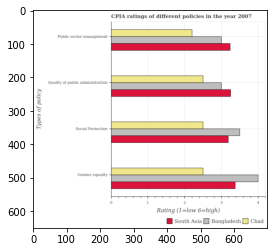

Number of QA =  29





,Types of policy,South Asia,Chad,Bangladesh
0,Gender equality,3.433172,2.545198,4.034679
1,Social Protection,3.236260,2.544403,3.539128
2,Quality of public administration,3.300694,2.535212,3.058804
3,Public sector management,NaN,2.239022,3.044893


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum cpia rating of quality of public administration ?
PREDICTED =  0.25
EXPECTED =  3.25




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of gender equality in chad and that in south asia ?
PREDICTED =  0.0
EXPECTED =  -0.875




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of quality of public administration in south asia and the cpia rating of social protection in bangladesh ?
PREDICTED =  0.25
EXPECTED =  -0.25




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or pred

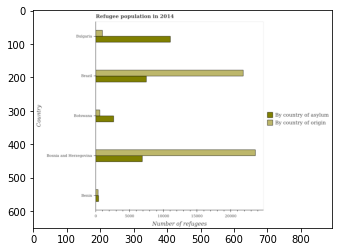

Number of QA =  28





,Country,By country of origin,By country of asylum
0,Botswana,1273.090639,4933.694416
1,Brazil,39680.711057,13565.973482
2,Benin,784.815914,950.067987
3,Bulgaria,1963.204979,20064.619876
4,Bosnia and Herzegovina,42699.474039,12561.107946


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of refugees by country of asylum in botswana and that in brazil ?
PREDICTED =  -8632.279065755332
EXPECTED =  -4845




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of refugees by country of origin in botswana and the number of refugees by country of asylum in bosnia and herzegovina ?
PREDICTED =  -41426.38339988241
EXPECTED =  -6291




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of refugees by country of origin and number of refugees by country of asylum in bosnia and herzegovina ?
PREDICTED =  -12556.10794571047

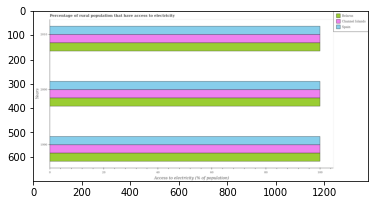

Number of QA =  29





,Years,Belarus,Channel Islands,Spain
0,2010,100.941937,100.533951,101.200039
1,2000,100.632241,100.118593,100.646449
2,1990,100.169855,100.562885,100.246133


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population that have access to electricity in channel islands in 1990 and that in 2010 ?
PREDICTED =  0.02893372006580819
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population that have access to electricity in belarus in 1990 and the percentage of rural population that have access to electricity in channel islands in 2010 ?
PREDICTED =  -0.7720819153653338
EXPECTED =  0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of rural population that have 

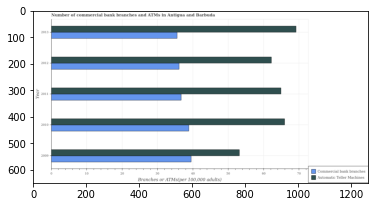

Number of QA =  28





,Year,Automatic Teller Machines,Commercial bank branches
0,2013,69.843466,36.505461
1,2012,62.788754,36.206361
2,2010,65.750642,NaN
3,2011,65.581057,37.003631
4,2009,53.804206,39.847889


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of atms in 2009 and that in 2013 ?
PREDICTED =  -16.039259331669015
EXPECTED =  -16.007




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of atms in 2009 and the number of commercal bank branches in 2011 ?
PREDICTED =  -11.776850770772498
EXPECTED =  16.451594097498685




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the number of commercal bank branches and number of atms ?
PREDICTED =  144.56334172059752
EXPECTED =  -26.074




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
T

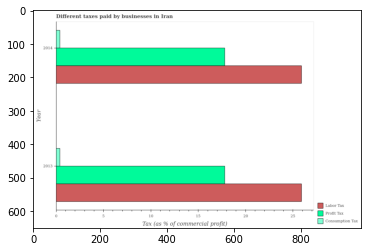

Number of QA =  26





,Year,Labor Tax,Consumption Tax,Profit Tax
0,2014,25.990388,0.449015,17.943853
1,2013,26.032431,0.459844,18.049172


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of consumption tax in 2013 and that in 2014 ?
PREDICTED =  0.010828861154311198
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor tax in 2013 and the percentage of profit tax in 2014 ?
PREDICTED =  0.04204270184521164
EXPECTED =  8.099999999999998




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the percentage of labor tax and percentage of profit tax ?
PREDICTED =  0.04204270184521164
EXPECTED =  8.1




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs:

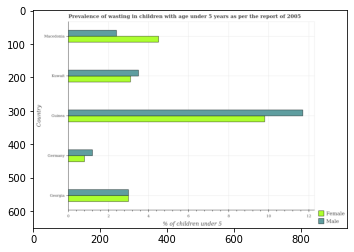

Number of QA =  28





,Country,Female,Male
0,Kuwait,3.125983,3.548489
1,Macedonia,4.652226,2.422423
2,Guinea,NaN,11.627320
3,Georgia,3.016781,3.026911
4,Germany,0.826846,1.247921


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished female children in georgia and that in guinea ?
PREDICTED =  3.0167808863635286
EXPECTED =  -6.8




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished male children in guinea and the percentage of undernourished female children in germany ?
PREDICTED =  0.4210756913122874
EXPECTED =  10.899999797344172




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio

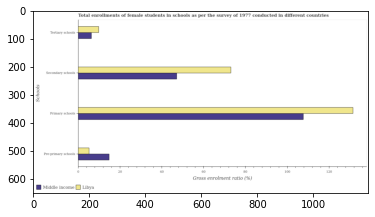

Number of QA =  29





,Schools,Unnamed: 1,Middle income
0,Pre-primary schools,5.404523,15.077680
1,Secondary schools,73.697481,47.555637
2,Tertiary schools,10.075003,6.491806
3,Primary schools,132.145954,108.302607


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the gross enrolment ratio(female) in pre-primary schools in middle income ?
PREDICTED =  5.0258933730265705
EXPECTED =  14.7833099365234




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum gross enrolment ratio(female) in pre-primary schools ?
PREDICTED =  36.100869071053374
EXPECTED =  14.7833099365234




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum gross enrolment ratio(female) in pre-primary schools ?
PREDICTED =  5.0258933730265705
EXPECTED =  5.19015




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or p

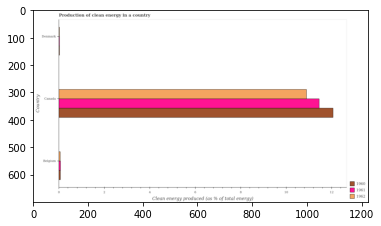

Number of QA =  29





,Country,1962,1961,1960
0,Canada,10.999089,11.494755,12.099820
1,Denmark,NaN,NaN,NaN
2,Belgium,0.087174,0.096586,0.093588


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of clean energy produced in 1961 in canada and that in denmark ?
PREDICTED =  11.494754741771972
EXPECTED =  11.428579967072844




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of clean energy produced in 1960 in denmark and the percentage of clean energy produced in 1961 in canada?
PREDICTED =  -11.494754741771972
EXPECTED =  -11.42812954016302




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of clean energy produced in 1962 and percentage of clean energy produced in 1960 in denmark ?
PREDICTED =  5.543

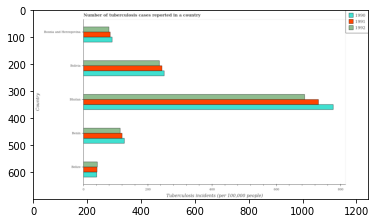

Number of QA =  29





,Country,1992,1990,1991
0,Belize,44.523719,42.698113,44.415700
1,Bhutan,691.040444,774.616599,733.484611
2,Bolivia,238.102333,252.286561,NaN
3,Benin,116.073379,128.068040,121.427540
4,Bosnia and Herzegovina,80.496849,90.434651,85.271573


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tuberculosis cases reported in in 1992 in bhutan and that in bosnia and herzegovina ?
PREDICTED =  610.5435949126213
EXPECTED =  609.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tuberculosis cases reported in in 1992 in bolivia and the number of tuberculosis cases reported in in 1991 in belize?
PREDICTED =  193.5786134774089
EXPECTED =  194.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tuberculosis cases reported in in 1990 and number of tuberculosis cases reported in in 1992 in bolivia ?
PREDICT

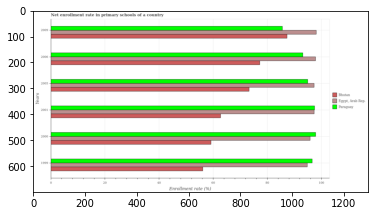

Number of QA =  29





,Years,Bhutan,"Egypt, Arab Rep",Paraguay
0,2009,88.943153,NaN,87.229626
1,2000,60.116410,96.873181,99.344658
2,1999,56.563367,95.683659,97.031448
3,2005,75.874570,97.189487,95.229762
4,2001,62.944054,100.187000,98.582557
5,2006,78.043187,98.979134,94.209979


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in primary schools in bhutan in 1999 and that in 2000 ?
PREDICTED =  -3.5530430503006087
EXPECTED =  -3.0363006591796875




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in primary schools in egypt, arab rep. in 2000 and the enrollment rate in primary schools in bhutan in 1999 ?
PREDICTED =  1.1895218680181898
EXPECTED =  39.681118011474595




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the enrollment rate in primary schools in bhutan and enrollment rate in primary schools in paraguay ?
PR

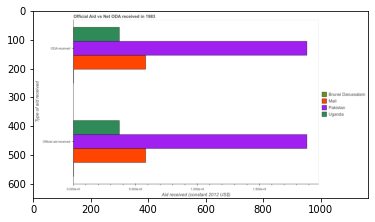

Number of QA =  23





,Type of aid received,Mali,Brunei Darussalam,Uganda,Pakistan
0,Official aid received,5.747621,NaN,3.717011,18.704903
1,ODA received,5.810477,NaN,3.711934,18.799858


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the official aid received in brunei darussalam and the oda received in uganda ?
PREDICTED =  nan
EXPECTED =  -369090000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received and official aid received in mali ?
PREDICTED =  0.06285577753248361
EXPECTED =  0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the official aid received in mali to that in pakistan ?
PREDICTED =  0.3072788676716816
EXPE

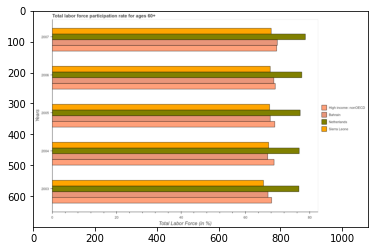

Number of QA =  30





,Years,Sierra Leone,Bahrain,Netherlands,High income: nonOECD
0,2006,68.371870,69.747340,78.188563,NaN
1,2007,68.533755,69.932309,79.126583,70.021030
2,2004,67.756932,67.406681,78.308276,69.184749
3,2005,68.001460,68.348298,76.467237,69.720292
4,2003,66.334434,68.483700,77.724540,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in sierra leone in 2003 and that in 2005 ?
PREDICTED =  -1.667025972622568
EXPECTED =  -1.9000015258790057




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in bahrain in 2004 and the labor force participation rate in high income: nonoecd in 2003 ?
PREDICTED =  -68.34829830787677
EXPECTED =  -1.2122018959988026




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the labor force participation rate in netherlands and labor force participation rate in bahrain ?
PREDICT

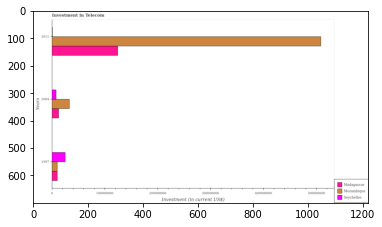

Number of QA =  29





,Years,Mozambique,Seychelles,Madagascar
0,2011,5.125707e+08,NaN,1.258940e+08
1,2004,3.408157e+07,9.082788e+06,1.361718e+07
2,1997,1.125771e+07,2.626225e+07,1.110528e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount invested in telecom in mozambique in 2004 and that in 2011 ?
PREDICTED =  -478489092.3589695
EXPECTED =  -475400000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount invested in telecom in seychelles in 2011 and the amount invested in telecom in mozambique in 1997 ?
PREDICTED =  -26262253.18789468
EXPECTED =  -9200000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the amount invested in telecom in madagascar and amount invested in telecom in mozambique ?
PREDICTED =  -544292764.0018532
EXPECTED =  0.0




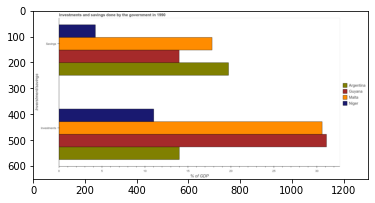

Number of QA =  23





,Inverstment/savings,Niger,Malta,Guyana,Argentina
0,Savings,4.286680,17.909318,14.15168,19.787580
1,Investments,11.176529,30.630781,31.41500,14.096342


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the savings of government in guyana to that in niger ?
PREDICTED =  3.3013150052013276
EXPECTED =  3.3091018653386177




				 1 / 4 = 0.25


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  % of GDP
EXPECTED =  5.0




				 1 / 5 = 0.2


> what is the title of the graph ?
PREDICTED =  Investments and savings done by the government in 1990

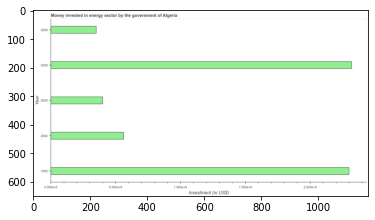

Number of QA =  23





,Year,Investment (in US$)
0,2009,3.560028
1,1993,23.008060
2,2004,5.658880
3,2006,23.361201
4,2005,4.040711


> what is the title of the graph ?
PREDICTED =  Money invested in energy sector by the government of Algeria
EXPECTED =  Money invested in energy sector by the government of Algeria




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Investment (in US$)
EXPECTED =  Investment (in US$)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the investment in energy in 1993 and 2005 ?
PREDICTED =  18.967349381296895
EXPECTED =  1900000000.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median investment in energy ?
PREDICTED =  5.658880186800385
EXPECTED =  562000000.0




				 3 / 5 = 0.6


is_built_with

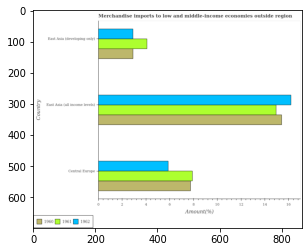

Number of QA =  29





,Country,1962,1961,1960
0,Central Europe,5.929829,8.038698,7.946210
1,East Asia (all income levels),16.410014,15.191393,15.613859
2,East Asia (developing only),2.990379,4.187610,2.993428


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in 1962 in central europe and that in east asia (developing only) ?
PREDICTED =  2.939449183952707
EXPECTED =  2.9664936832287205




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in 1962 in east asia (all income levels) and the percentage of amount earned from merchandise imports in 1961 in east asia (developing only)?
PREDICTED =  13.419634204535075
EXPECTED =  12.117127973890309




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the per

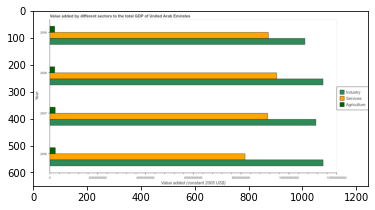

Number of QA =  29





,Year,Industry,Agriculture,Services
0,2009,1.074739e+11,2.237468e+09,9.138039e+10
1,2006,1.145341e+11,2.517062e+09,8.180988e+10
2,2008,1.136034e+11,2.240024e+09,9.495279e+10
3,2007,1.117528e+11,2.468559e+09,9.120984e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by services in 2006 and that in 2008 ?
PREDICTED =  -13142903183.840317
EXPECTED =  -13225885711.999




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by services in 2006 and the value added by agricultural sector in 2009 ?
PREDICTED =  -9570511388.59262
EXPECTED =  79657178376.40396




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the value added by industrial sector and value added by agricultural sector ?
PREDICTED =  437901204676.27856
EXPECTED =  112003206519.043




				 1 / 3 = 0.3333


is_bui

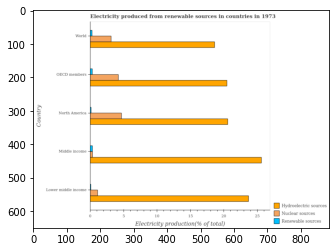

Number of QA =  29





,Country,Hydroelectric sources,Nuclear sources,Renewable sources
0,World,18.707232,3.183775,0.357887
1,Lower middle income,23.849925,1.195020,NaN
2,Middle income,25.638910,0.441866,0.436201
3,OECD members,20.535016,4.265775,0.392160
4,North America,20.794652,4.808808,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by nuclear sources in world and the percentage of electricity produced by renewable sources in lower middle income ?
PREDICTED =  1.9887547555866198
EXPECTED =  3.035363920188423




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by hydroelectric sources and percentage of electricity produced by renewable sources in oecd members ?
PREDICTED =  5.10389368766295
EXPECTED =  20.142




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
T

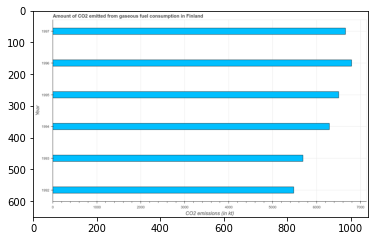

Number of QA =  23





,Year,CO2 emissions (in kt)
0,1997,6568.882860
1,1996,6782.015894
2,1993,5675.819617
3,1995,6500.167516
4,1992,5451.215869
5,1994,6293.951455


> what is the title of the graph ?
PREDICTED =  Amount of CO2 emitted from gaseous fuel consumption in Finland
EXPECTED =  Amount of CO2 emitted from gaseous fuel consumption in Finland




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  CO2 emissions (in kt)
EXPECTED =  CO2 emissions (in kt)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 emissions from gaseous fuel consumption in 1994 and 1995 ?
PREDICTED =  -206.21606185946257
EXPECTED =  -212.686




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median co2 emissions from gaseous fuel consumption ?
PREDICTED =  6397.059485443063
EXPECTED =

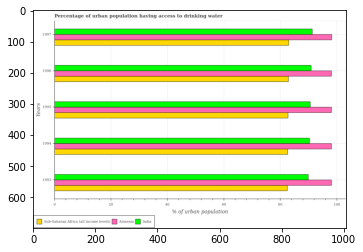

Number of QA =  29





,Years,India,Sub-Saharan Africa (all income levels),Armenia
0,1997,91.884090,83.659101,98.566856
1,1996,91.659747,83.510479,98.654884
2,1993,90.539823,83.123984,98.529656
3,1994,90.681786,83.069069,98.642283
4,1995,91.385547,83.038123,99.626491


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population having access to drinking water in india in 1994 and that in 1996 ?
PREDICTED =  -0.9779605089417345
EXPECTED =  -0.6000000000000085




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population having access to drinking water in armenia in 1993 and the percentage of urban population having access to drinking water in sub-saharan africa (all income levels) in 1997 ?
PREDICTED =  14.870555050134271
EXPECTED =  15.136103855831294




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1993, what is the difference betwee

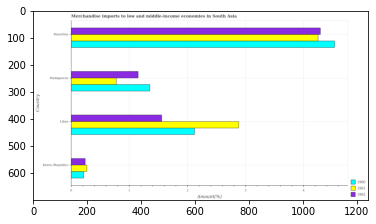

Number of QA =  29





,Country,1962,1961,1960
0,Mauritius,4.317409,4.316112,4.557843
1,Libya,1.572312,2.896826,2.137021
2,Korea (Republic),0.250157,0.279336,0.226399
3,Madagascar,1.162615,0.781636,1.381729


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in 1961 in korea (republic) and that in madagascar ?
PREDICTED =  -0.5022997015646324
EXPECTED =  -0.506195815934481




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in 1961 in madagascar and the percentage of amount earned from merchandise imports in 1960 in korea (republic)?
PREDICTED =  0.5022997015646324
EXPECTED =  0.5602940849825633




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise i

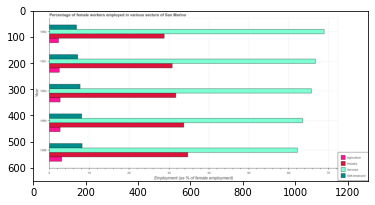

Number of QA =  30





,Year,Industry,Self-employed,Agriculture,Services
0,1992,28.950436,6.888279,2.400753,69.170563
1,1988,34.763970,8.325031,3.159402,63.293818
2,1990,31.845946,7.937132,2.767245,65.905488
3,1989,33.707228,8.147924,2.759241,63.588930
4,1991,30.864770,7.144075,2.517253,66.281446


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female workers in services in 1988 and that in 1992 ?
PREDICTED =  -5.87674436508857
EXPECTED =  -6.7




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female workers in services in 1990 and the percentage of female workers in industry in 1989 ?
PREDICTED =  2.3165580418483884
EXPECTED =  31.9999961853027




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1989, what is the difference between the percentage of self employed female workers and percentage of female workers in industry ?
PREDICTED =  0.0
EXPECTED =  -25.6




				 0 / 3 =

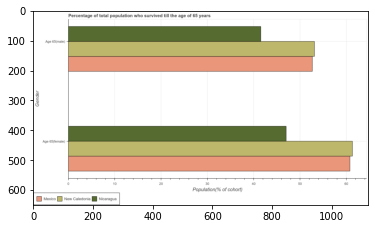

Number of QA =  23





,Gender,Mexico,New Caledonia,Nicaragua
0,Age 65(male),52.807910,53.216118,41.714231
1,Age 65(female),61.063463,61.718034,47.485456


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of female population who survived till age of 65 in new caledonia to that in mexico ?
PREDICTED =  0.03275280976442444
EXPECTED =  1.0088721641277996




				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Population(% of cohort)
EXPECTED =  10.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDI

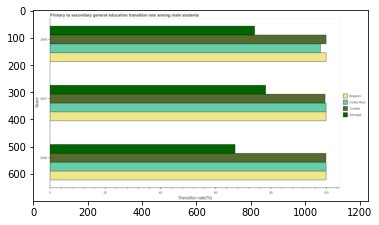

Number of QA =  30





,Years,Costa Rica,Belgium,Croatia,Senega
0,2005,100.209383,100.789926,100.122271,66.913885
1,2007,99.805620,99.449222,99.635948,78.274921
2,2008,98.407487,99.719470,101.060877,74.351943


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the transition rate in belgium in 2005 and that in 2008 ?
PREDICTED =  1.0704562928784043
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the transition rate in croatia in 2005 and the transition rate in senegal in 2008 ?
PREDICTED =  -0.9386055159940412
EXPECTED =  25.833198547363196




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the transition rate in senegal and transition rate in costa rica ?
PREDICTED =  2003.6666666666667
EXPECTED =  -32.9780197143555




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_

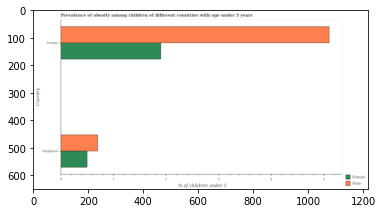

Number of QA =  25





,Country,Female,Male
0,Tunisia,1.897544,5.140593
1,Singapore,0.509452,0.703650


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of obese female children in singapore and that in tunisia ?
PREDICTED =  -1.3880921829555688
EXPECTED =  -1.4




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of obese male children in singapore and the percentage of obese female children in tunisia ?
PREDICTED =  -4.436943239890024
EXPECTED =  -1.199999988079069




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of obese male children and percentage of obese female children in singapore ?
PREDICTED =  4.436943239890024
EXPECTED =  0.2




				 1 / 3 = 0.3

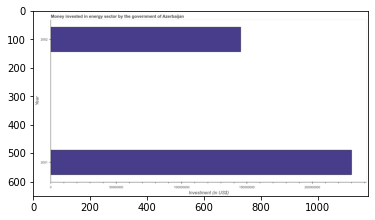

Number of QA =  19





,Year,Investment (in US$)
0,2001,4.150801e+08
1,2002,2.656563e+08


> what is the title of the graph ?
PREDICTED =  Money invested in energy sector by the government of Azerbaijan
EXPECTED =  Money invested in energy sector by the government of Azerbaijan




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Investment (in US$)
EXPECTED =  Investment (in US$)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the investment in energy in 2001 and 2002 ?
PREDICTED =  149423801.03577617
EXPECTED =  84800000.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median investment in energy ?
PREDICTED =  340368202.8037858
EXPECTED =  187600000.0




				 3 / 5 = 0.6


is_built_

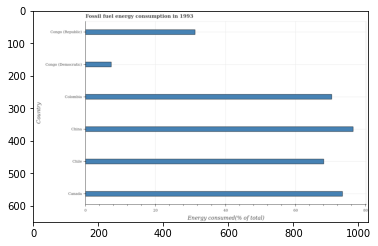

Number of QA =  22





,Country,Enerqy consumed(% of total)
0,Chile,68.587528
1,Colombia,70.725490
2,Canada,73.847281
3,China,77.045131
4,Congo (Republic),31.548945
5,Congo (Democratic),7.609193


> what is the title of the graph ?
PREDICTED =  Fossil fuel energy consumption in 1993
EXPECTED =  Fossil fuel energy consumption in 1993




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Enerqy consumed(% of total)
EXPECTED =  Energy consumed(% of total)




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the fossil fuel energy consumption in china and congo (republic) ?
PREDICTED =  45.496186083413775
EXPECTED =  45.182




				 3 / 4 = 0.75


> what is the median fossil fuel energy consumption ?
PREDICTED =  None
EXPECTED =  69.21767463724251




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is th

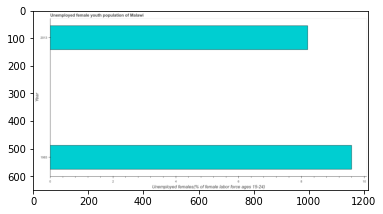

Number of QA =  19





,Year,Unemployed females(% of female labor force ages 15-24)
0,2013,8.212477
1,1983,9.678493


> what is the title of the graph ?
PREDICTED =  Unemployed female youth population of Malawi
EXPECTED =  Unemployed female youth population of Malawi




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Unemployed females(% of female labor force ages 15-24)
EXPECTED =  Unemployed females(% of female labor force ages 15-24)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed female youth in 1983 and 2013 ?
PREDICTED =  1.4660155526620287
EXPECTED =  1.4




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed female youth ?
PREDICTED =  1998.0
EXPECTED =  8.900000095367435




			

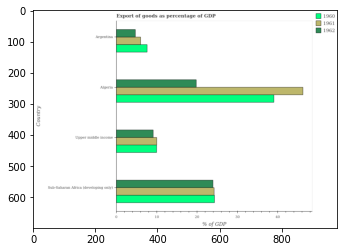

Number of QA =  29





,Country,1962,1961,1960
0,Algeria,19.975636,46.461326,38.828486
1,Upper middle income,9.216600,10.119581,10.120764
2,Argentina,4.837831,6.140754,7.783328
3,Sub-Saharan Africa (developing only),24.082691,24.355184,24.239715


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export of goods as percentage of gdp in 1960 in algeria and that in sub-saharan africa (developing only) ?
PREDICTED =  14.588771429858152
EXPECTED =  14.7289327066202




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export of goods as percentage of gdp in 1961 in algeria and the export of goods as percentage of gdp in 1962 in sub-saharan africa (developing only)?
PREDICTED =  22.106142080522485
EXPECTED =  22.3060159464077




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicti

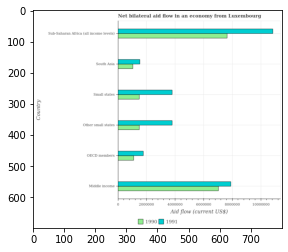

Number of QA =  28





,Country,1990,1991
0,Other small states,1.586703e+06,3.905777e+06
1,Middle income,7.182808e+06,8.104431e+06
2,OECD members,1.142159e+06,1.837249e+06
3,Small states,1.582818e+06,3.910393e+06
4,South Asia,1.089824e+06,1.576036e+06
5,Sub-Saharan Africa (all income levels),7.765431e+06,1.094475e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1990 in middle income and that in oecd members ?
PREDICTED =  6040649.098301804
EXPECTED =  5930000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1991 in oecd members and the net bilateral aid flow in 1990 in small states?
PREDICTED =  -5978921.613037135
EXPECTED =  280000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net bilateral

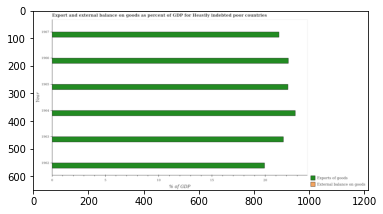

Number of QA =  23





,Year,External balance on goods,Exports of goods
0,1964,NaN,22.862511
1,1967,NaN,21.373677
2,1965,NaN,22.218119
3,1962,NaN,19.966643
4,1966,NaN,22.263745
5,1963,NaN,21.763149


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export of goods as percentage of gdp in 1964 and that in 1967 ?
PREDICTED =  1.4888343641188548
EXPECTED =  1.532




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the external balance on goods as percentage of gdp in 1966 and the export of goods as percentage of gdp in 1964 ?
PREDICTED =  nan
EXPECTED =  -22.8163712382832




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the export of goods as percentage of gdp in 1965 to that in 1967 ?
PREDICTED =  1.039508500967884
EXPECTED =  1.04




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: Fal

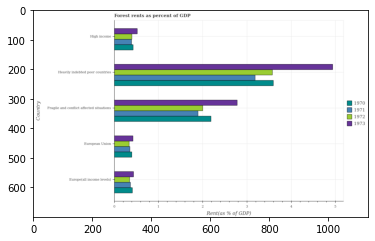

Number of QA =  30





,Country,1972,1971,1970,1973
0,Heavily indebted poor countries,NaN,3.185019,3.621861,4.959349
1,Europe(all income levels),0.360343,0.384344,0.418244,0.447307
2,High income,0.409817,0.407431,0.438264,0.532981
3,European Union,0.342483,0.364476,0.407251,0.434845
4,Fragile and conflict affected situations,2.017862,1.909496,2.220104,2.801827


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the forest rent in 1971 in european union and that in heavily indebted poor countries ?
PREDICTED =  -2.82054315274582
EXPECTED =  -2.830607291267413




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the forest rent in 1971 in heavily indebted poor countries and the forest rent in 1970 in european union?
PREDICTED =  2.82054315274582
EXPECTED =  2.787353712540434




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the forest rent in 1972 and forest rent in 1973 in fragile and conflict affected situations ?
PREDICTED =  -0.7839650525954212
EXPECTED =  -

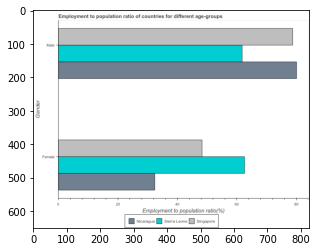

Number of QA =  23





,Gender,Sierra Leone,Singapore,Nicaragua
0,Male,61.714544,79.062694,80.283189
1,Female,62.835770,48.504236,32.409693


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum employment to population ratio(female) ?
PREDICTED =  1.6300162627053991
EXPECTED =  62.5999984741211




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting .

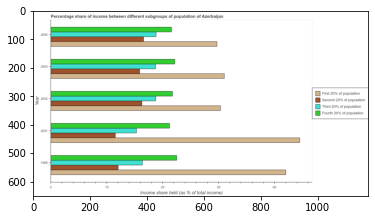

Number of QA =  30





,Year,Third 20% of population,Second 20% of population,First 20% of population,Fourth 20% of population
0,2001,15.364531,11.658106,44.600086,21.125056
1,2002,18.826231,16.436015,NaN,21.805630
2,2003,NaN,16.082256,31.029826,22.238524
3,2004,18.910705,16.776069,29.670777,NaN
4,1995,NaN,12.141820,42.402239,22.444914


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the share of the income held by first 20% of the population in 1995 and that in 2004 ?
PREDICTED =  nan
EXPECTED =  12.3




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the share of the income held by third 20% of the population in 2002 to that in 2004 ?
PREDICTED =  0.9955330278275633
EXPECTED =  0.997




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training

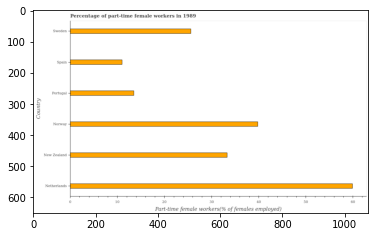

Number of QA =  22





,Country,Part-time female workers(% of females employed)
0,Netherlands,60.521118
1,Spain,11.259560
2,Portugal,13.631641
3,Sweden,25.869265
4,Norway,40.048112
5,New Zealand,33.103039


> what is the title of the graph ?
PREDICTED =  Percentage of part-time female workers in 1989
EXPECTED =  Percentage of part-time female workers in 1989




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Part-time female workers(% of females employed)
EXPECTED =  Part-time female workers(% of females employed)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of part-time female workers in netherlands and new zealand ?
PREDICTED =  27.41807825885858
EXPECTED =  26.6




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of part-time female workers ?
PREDICTED =  29.4

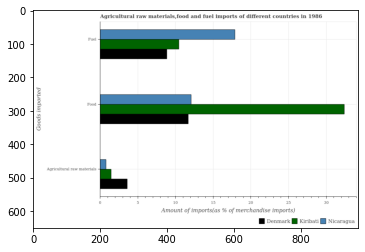

Number of QA =  28





,Goods imported,Nicaragua,Kiribati,Denmark
0,Food,12.180828,32.368378,11.736220
1,Agricultural raw materials,0.853934,1.534851,NaN
2,Fuel,17.970017,10.513802,8.910063


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of food imports in kiribati and that in denmark ?
PREDICTED =  20.632158092032867
EXPECTED =  20.717787545609




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of food imports in denmark and the percentage of raw materials imports in nicaragua ?
PREDICTED =  -0.4446075538168781
EXPECTED =  10.920362053773232




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of food imports and percentage of raw materials imports in kiribati ?
PREDICTED =  -20.187550538215987
EXPECTED =  30.9579806695252




				 1 / 3 = 0.

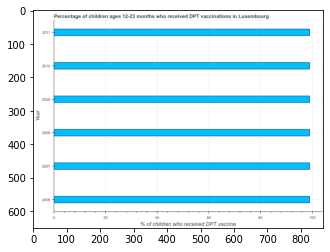

Number of QA =  23





,Year,% of children who received DPT vaccine
0,2007,98.913710
1,2008,99.061991
2,2011,99.193992
3,2010,99.360518
4,2006,99.274858
5,2009,99.466505


> what is the title of the graph ?
PREDICTED =  Percentage of children ages 12-23 months who received DPT vaccinations in Luxembourg
EXPECTED =  Percentage of children ages 12-23 months who received DPT vaccinations in Luxembourg




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  % of children who received DPT vaccine
EXPECTED =  % of children who received DPT vaccine




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who received dpt vaccine in 2007 and 2008 ?
PREDICTED =  -0.14828155495185058
EXPECTED =  0.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percenta

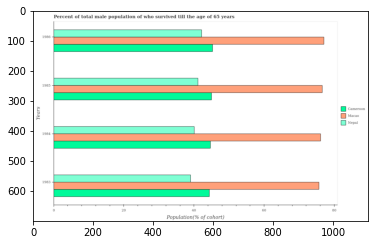

Number of QA =  29





,Years,Nepal,Cameroon,Macaa
0,1986,NaN,45.708511,77.976353
1,1984,40.772867,45.106170,76.997960
2,1983,NaN,44.969335,76.091794
3,1985,41.703651,45.974988,77.370166


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total male population who survived till the age of 65 years in cameroon in 1984 and that in 1985 ?
PREDICTED =  -0.8688180750023875
EXPECTED =  -0.30469999999999686




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total male population who survived till the age of 65 years in macao in 1985 and the percentage of total male population who survived till the age of 65 years in nepal in 1986 ?
PREDICTED =  0.0
EXPECTED =  34.404849999999996




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1984, what is the difference between the percent

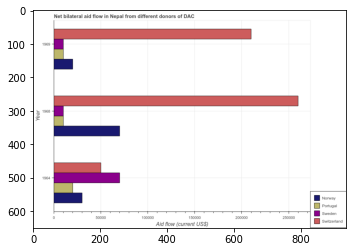

Number of QA =  30





,Year,Switzerland,Sweden,Portugal,Norway
0,1969,378988.074698,19030.341490,18958.665211,36920.004299
1,1964,91254.316501,127366.164253,36911.020859,55640.176829
2,1968,466016.511348,19049.544083,19058.365704,127049.983448


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by norway in 1968 and that in 1969 ?
PREDICTED =  90129.97914883512
EXPECTED =  50000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by switzerland in 1968 and the amount of aid given by norway in 1964 ?
PREDICTED =  374762.1948476173
EXPECTED =  230000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1964, what is the difference between the amount of aid given by sweden and amount of aid given by switzerland ?
PREDICTED =  -770812.852721286
EXPECTED =  20000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_avai

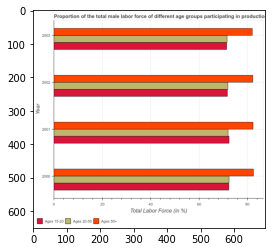

Number of QA =  29





,Year,Ages 50+,Ages 20-50,Ages 15-20
0,2003,82.598604,71.829318,NaN
1,2001,81.787818,72.324737,72.567601
2,2000,82.478717,72.245999,72.877378
3,2002,81.953649,NaN,71.560303


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the percentage of male labor force within the age group 15-20 and percentage of male labor force within the age group 20-50 ?
PREDICTED =  0.0
EXPECTED =  -0.2




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the h

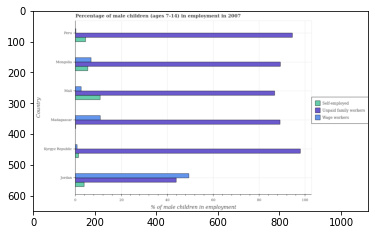

Number of QA =  29





,Country,Self-employed,Unpaid family workers,Wage workers
0,NaN,4.676403,94.852696,NaN
1,Madagascar,NaN,89.159082,11.049835
2,Jordan,4.085213,44.224394,NaN
3,Kyrgyz Republic,1.687803,98.169910,0.976654
4,Mongolia,5.604883,89.950744,7.196376
5,Mali,11.061795,87.069265,2.821674


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children employed as unpaid family workers in jordan and that in mali ?
PREDICTED =  -42.844871102674354
EXPECTED =  -42.88




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children employed as wage workers in peru and the percentage of children employed as unpaid family workers in jordan ?
PREDICTED =  -42.536591223007356
EXPECTED =  -43.720000000000006




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children employed as unpaid family workers and percentage of self employed children in mali ?


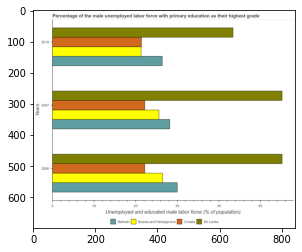

Number of QA =  30





,Years,Sn Lanka,Bosnia and Herzegovina,Bahrain,Croatia
0,2010,43.637576,21.515308,26.520898,21.664115
1,2006,55.507936,26.784373,30.121150,22.458279
2,2007,55.309983,25.939930,28.240941,22.310601


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed male labor force with primary education in sri lanka in 2007 and that in 2010 ?
PREDICTED =  11.672406811610145
EXPECTED =  11.799999237060604




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed male labor force with primary education in sri lanka in 2010 and the percentage of the unemployed male labor force with primary education in croatia in 2007 ?
PREDICTED =  -11.672406811610145
EXPECTED =  21.2000007629394




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the perc

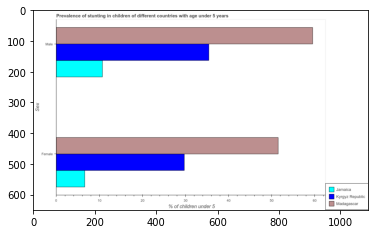

Number of QA =  23





,Sex,Kyrgyz Republic,Jamaica,Madagascar
0,Male,35.462628,10.781371,59.657817
1,Female,29.670615,6.746387,51.945922


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of stunted female children in kyrgyz republic and that in jamaica ?
PREDICTED =  22.924227831963243
EXPECTED =  23.100000858306927




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of stunted female children in jamaica and the percentage of stunted male children in madagascar ?
PREDICTED =  -45.19953506203809
EXPECTED =  -52.90000009536743




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of stunted male children and percentage of stunted female children in jamaica ?
PREDICTED =  52.911430001413486
EXPECTE

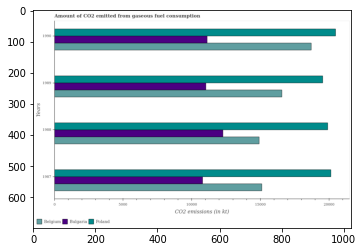

Number of QA =  29





,Years,Bulgaria,Belgium,Poland
0,1990,20209.381738,33679.301379,37176.211804
1,1988,22138.413162,27123.820518,36284.027193
2,1987,19557.559089,27338.010619,36316.841307
3,1989,20084.447876,29944.142877,35656.125031


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in bulgaria in 1987 and that in 1990 ?
PREDICTED =  -651.822649576694
EXPECTED =  -330.03000000000065




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in belgium in 1988 and the amount of co2 emitted in bulgaria in 1989 ?
PREDICTED =  -2820.322359332018
EXPECTED =  3883.353000000001




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1987, what is the difference between the amount of co2 emitted in poland and amount of co2 emitted in belgium ?
PREDICTED =  27347.929940687114
EXPECTED =  5031.124




				 0 / 3 = 0.0




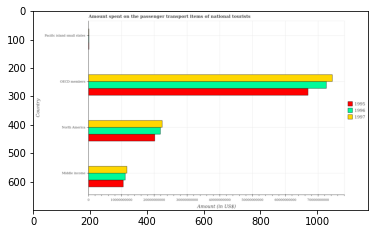

Number of QA =  29





,Country,1997,1996,1995
0,OECD members,7.475662e+10,7.255480e+10,6.706392e+10
1,North America,2.264916e+10,2.209776e+10,2.044012e+10
2,Middle income,1.173465e+10,1.144229e+10,1.084881e+10
3,Pacific island small states,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the passenger transport items of national tourists in 1997 in north america and that in pacific island small states ?
PREDICTED =  22649160330.795204
EXPECTED =  22354243476.46202




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the passenger transport items of national tourists in 1996 in middle income and the amount spent on the passenger transport items of national tourists in 1997 in pacific island small states?
PREDICTED =  11442294363.838587
EXPECTED =  11084116688.43762




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the di

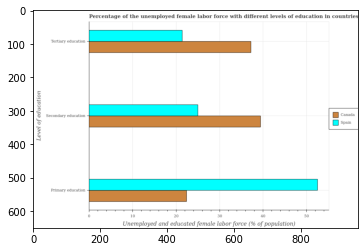

Number of QA =  28





,Level of education,Spain,Canada
0,Primary education,52.880985,22.515397
1,Tertiary education,21.748820,37.622812
2,Secondary education,25.285899,39.699192


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received tertiary education in spain and that in canada ?
PREDICTED =  -15.873992611196755
EXPECTED =  -15.800001144409205




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received primary education in spain and the percentage of female labor force who received secondary education in canada ?
PREDICTED =  30.365588810049925
EXPECTED =  13.0999984741211




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received secondary educatio

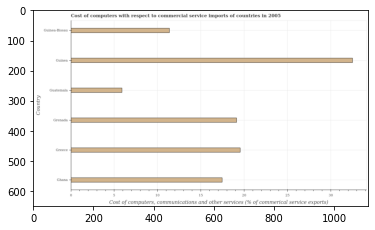

Number of QA =  22





,Country,"Cost of computers, communications and other services (% of commerical service exports)"
0,Grenada,18.981752
1,Guinea,32.281299
2,Ghana,17.324948
3,Guinea-Bissau,11.373993
4,Guatemala,5.971710
5,Greece,19.547332


> what is the title of the graph ?
PREDICTED =  Cost of computers with respect to commercial service imports of countries in 2005
EXPECTED =  Cost of computers with respect to commercial service imports of countries in 2005




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Cost of computers, communications and other services (% of commerical service exports)
EXPECTED =  Cost of computers, communications and other services (% of commerical service exports)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications in ghana and guatemala ?
PREDICTED =  11.353237368438482
EXPECTED =  11.566




				 4 / 4 = 1.0


> what is the median cost of communications ?
PREDICTED =  None
EXPECTED =  18.291491

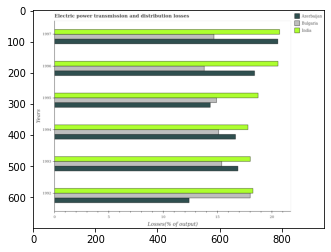

Number of QA =  29





,Years,Azerbaijan,Bulgaria,India
0,1996,18.584589,13.836956,20.633269
1,1994,16.735343,15.158432,17.771837
2,1995,14.378698,NaN,18.899530
3,1997,20.568396,14.762766,20.789092
4,1993,16.829884,15.431392,18.183366
5,1992,12.435271,NaN,18.309179


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the electric power transmission and distribution losses in india in 1992 and that in 1993 ?
PREDICTED =  -1.0
EXPECTED =  0.24241657355829815




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the electric power transmission and distribution losses in india in 1993 and the electric power transmission and distribution losses in bulgaria in 1992 ?
PREDICTED =  1973.8166336453778
EXPECTED =  0.007336558056902476




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the electric power transmission and distribution losses in india and electri

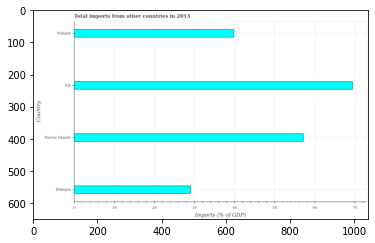

Number of QA =  22





,Country,Imports (% of GDP)
0,Ethiopia,29.304367
1,Faeroe Islands,57.239359
2,Finland,39.937421
3,Fiji,69.473241


> what is the title of the graph ?
PREDICTED =  Total imports from other countries in 2013
EXPECTED =  Total imports from other countries in 2013




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Imports (% of GDP)
EXPECTED =  Imports (% of GDP)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports in ethiopia and fiji ?
PREDICTED =  -40.168874059862944
EXPECTED =  -40.398




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total imports ?
PREDICTED =  48.58839009496734
EXPECTED =  48.44304981783104




				 5 / 5 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs:

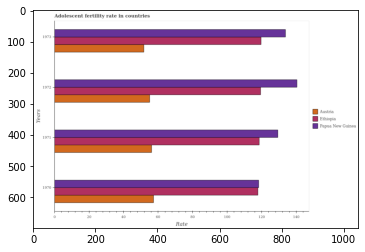

Number of QA =  29





,Years,Papua New Guinea,Austria,Ethiopia
0,1973,133.897308,52.153239,120.181002
1,1972,141.512516,55.581713,120.127125
2,1970,118.641986,57.653414,118.205625
3,1971,129.308340,56.131845,119.154086


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adolescent fertility rate in austria in 1970 and that in 1972 ?
PREDICTED =  2.071701027389814
EXPECTED =  2.224799999999995




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adolescent fertility rate in papua new guinea in 1970 and the adolescent fertility rate in austria in 1972 ?
PREDICTED =  63.06027305315198
EXPECTED =  63.1204




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1970, what is the difference between the adolescent fertility rate in papua new guinea and adolescent fertility rate in ethiopia ?
PREDICTED =  22.095556876185853
EXPECTED =  0.46859

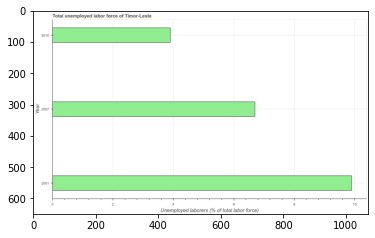

Number of QA =  23





,Year,Unemployed laborers (% of total labor force)
0,2001,9.948303
1,2010,3.934816
2,2007,6.747715


> what is the title of the graph ?
PREDICTED =  Total unemployed labor force of Timor-Leste
EXPECTED =  Total unemployed labor force of Timor-Leste




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Unemployed laborers (% of total labor force)
EXPECTED =  Unemployed laborers (% of total labor force)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total unemployed labour force in 2001 and 2010 ?
PREDICTED =  6.013487488413929
EXPECTED =  6.0




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total unemployed labour force ?
PREDICTED =  2007.0
EXPECTED =  6.699999809265139




				 4 / 5 = 0

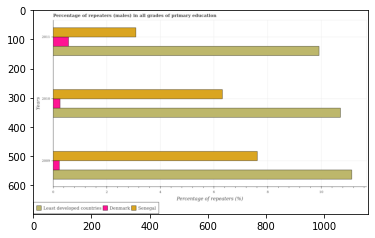

Number of QA =  29





,Years,Least developed countries,Senegal,Denmark
0,2011,9.930798,3.132981,0.601202
1,2009,11.131639,7.639423,0.257433
2,2010,10.707573,6.388379,0.282705


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of repeaters (males) in least developed countries in 2010 and that in 2011 ?
PREDICTED =  0.7767746849077124
EXPECTED =  0.7990503311157333




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of repeaters (males) in denmark in 2009 and the percentage of repeaters (males) in senegal in 2011 ?
PREDICTED =  -0.34376905338464375
EXPECTED =  -2.852049991488459




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of repeaters (males) in least developed countries and percentage of repeaters (males) i

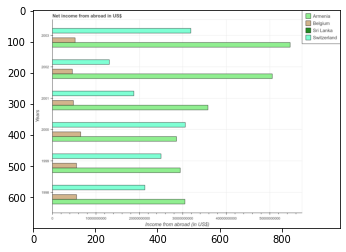

Number of QA =  27





,Years,Switzerland,Belgium,Armenia,Sri Lanka
0,1999,NaN,5.657171e+09,2.956533e+10,NaN
1,2003,NaN,5.379619e+09,5.464129e+10,NaN
2,1998,2.126994e+10,5.637575e+09,3.059687e+10,NaN
3,2001,1.881377e+10,4.929408e+09,3.593869e+10,NaN
4,2000,3.065249e+10,6.694943e+09,2.872667e+10,NaN
5,2002,1.318033e+10,4.660676e+09,5.071249e+10,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net income from abroad in belgium in 1999 and that in 2001 ?
PREDICTED =  727763166.4330463
EXPECTED =  710000000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net income from abroad in switzerland in 1998 and the net income from abroad in sri lanka in 2002 ?
PREDICTED =  8089612584.530685
EXPECTED =  21258717300.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the net income from abroad in switzerland and net income from abroad in armenia ?
PREDICTED =  -33662158304.358936
EXPECTED =  -9213082700.0




				 1 / 3 =

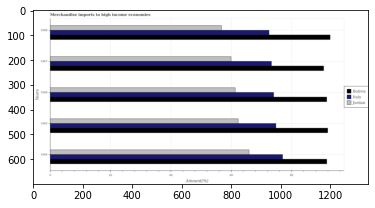

Number of QA =  29





,Years,Bolivia,Jordan,Italy
0,1966,91.206466,61.705322,74.799807
1,1967,89.625066,60.008123,73.740097
2,1965,90.833812,62.827495,74.912984
3,1964,91.305107,67.725496,77.786872
4,1968,91.872310,56.417051,71.619374


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in jordan in 1966 and that in 1967 ?
PREDICTED =  1.6971986125098866
EXPECTED =  1.3709072971986132




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in italy in 1964 and the percentage of amount earned from merchandise imports in bolivia in 1965 ?
PREDICTED =  2.873888132905705
EXPECTED =  -14.942780674742309




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1965, what is the difference between the percentage of amount earned from merchandise imports in it

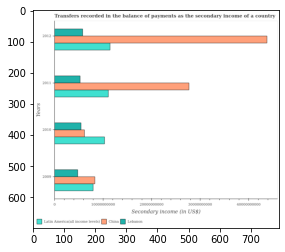

Number of QA =  29





,Years,Lebanon,China,Latin America(all income levels)
0,2012,5.940469e+09,4.399979e+10,1.161285e+10
1,2009,4.942829e+09,8.470239e+09,8.147010e+09
2,2010,5.636217e+09,6.250413e+09,1.029573e+10
3,2011,5.430471e+09,2.800166e+10,1.122172e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the secondary income of in china in 2010 and that in 2012 ?
PREDICTED =  -37749378790.41968
EXPECTED =  -37602666725.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the secondary income of in china in 2010 and the secondary income of in lebanon in 2012 ?
PREDICTED =  -37749378790.41968
EXPECTED =  360854480.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the secondary income of in china and secondary income of in latin america(all income levels) ?
PREDICTED =  3921442487.680523
EXPECTED =  32324235003.075




				 1 / 3 = 0.

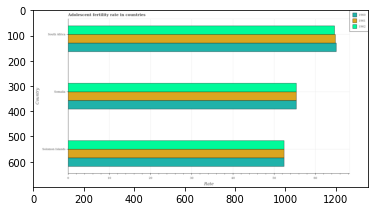

Number of QA =  29





,Country,1962,1961,1960
0,Somalia,55.751538,55.969071,55.564983
1,South Africa,64.832312,65.666106,65.382838
2,Solomon Islands,53.075718,52.950582,53.002830


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adolescent fertility rate in 1961 in somalia and that in south africa ?
PREDICTED =  -9.69703547750251
EXPECTED =  -9.482999999999997




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adolescent fertility rate in 1961 in south africa and the adolescent fertility rate in 1962 in somalia?
PREDICTED =  9.69703547750251
EXPECTED =  9.482999999999997




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adolescent fertility rate in 1960 and adolescent fertility rate in 1961 in solomon islands ?
PREDICTED =  12.432255840656424
EXPECTED =  0.0




	

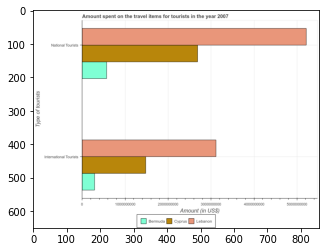

Number of QA =  23





,Type of tourists,Lebanon,Bermuda,Cyprus
0,National Tourists,5.235689e+09,5.889943e+08,2.719507e+09
1,International Tourists,3.135686e+09,3.050024e+08,1.480663e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on travel items of national tourists in bermuda and that in lebanon ?
PREDICTED =  -4646694867.242373
EXPECTED =  -4647000000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on travel items of national tourists in bermuda and the amount spent on travel items of international tourists in cyprus ?
PREDICTED =  -3611175060.8615675
EXPECTED =  -910000000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on travel items of international tourists and amount spent on travel items of national tourists in b

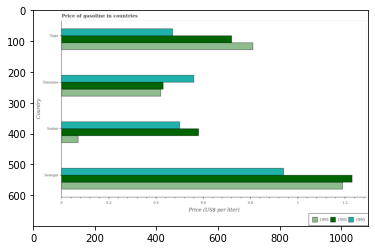

Number of QA =  29





,Country,1992,1995,1991
0,Senegal,1.232721,0.942622,1.189419
1,Sudan,0.578896,0.499001,0.072364
2,Tanzania,0.429959,0.557180,0.419739
3,Togo,0.718723,0.468879,0.804841


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the price of gasoline in 1992 in sudan and that in togo ?
PREDICTED =  -0.13982663544702068
EXPECTED =  -0.14




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the price of gasoline in 1992 in sudan and the price of gasoline in 1991 in togo?
PREDICTED =  -0.13982663544702068
EXPECTED =  -0.2300000000000001




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the price of gasoline in 1992 and price of gasoline in 1991 in sudan ?
PREDICTED =  0.3575940696174206
EXPECTED =  0.51




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPU

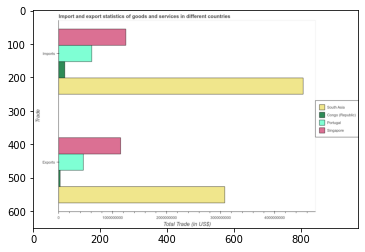

Number of QA =  23





,Trade,Portugal,Singapore,South Asia,Congo (Republic)
0,Imports,6.261925e+08,1.264001e+09,4.534273e+09,1.225704e+08
1,Exports,4.635799e+08,1.156217e+09,3.084851e+09,3.782060e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Total Trade (in US$)
EXPECTED =  1000000000.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Import and export statistics of goods and services in different countries
EXPECTED =  Import and export statistics of goods and services in different countries




				 1 / 6 = 

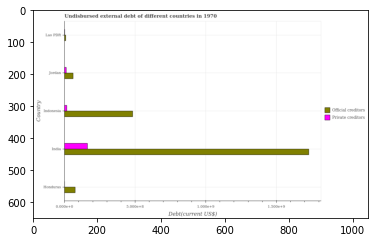

Number of QA =  28





,Country,Private creditors,Official creditors
0,Lao PDR,NaN,0.217478
1,Honduras,NaN,1.435060
2,India,3.017829,31.143865
3,Indonesia,0.366561,8.723812
4,Jordan,0.296873,1.188542


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the undisbursed external debt of private creditors in honduras and that in lao pdr ?
PREDICTED =  0.0
EXPECTED =  -1176000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the undisbursed external debt of private creditors in honduras and the undisbursed external debt of official creditors in jordan ?
PREDICTED =  -0.2968728350287589
EXPECTED =  -60375000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the undisbursed external debt of official creditors and undisbursed external debt of private creditors in indonesia ?
PREDICTED =  -8.723811599

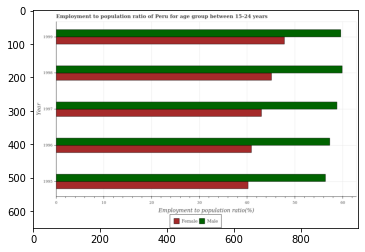

Number of QA =  28





,Year,Female,Male
0,1999,48.494724,59.858058
1,1997,43.415777,59.673068
2,1995,40.801531,57.251437
3,1998,45.205072,60.983159
4,1996,41.453426,58.061155


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the employment to population ratio(female) in 1996 ?
PREDICTED =  1.381102679225906
EXPECTED =  40.9000015258789




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum employment to population ratio(male) ?
PREDICTED =  32.77954171862328
EXPECTED =  59.9000015258789




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum employment to population ratio(female) ?
PREDICTED =  1.0
EXPECTED =  40.2000007629395




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which

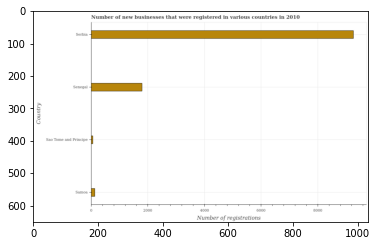

Number of QA =  22





,Country,Number of registrations
0,Samoa,153.720973
1,Serbia,9321.819907
2,Senegal,1811.412120
3,Sao Tome and Principe,81.481548


> what is the title of the graph ?
PREDICTED =  Number of new businesses that were registered in various countries in 2010
EXPECTED =  Number of new businesses that were registered in various countries in 2010




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Number of registrations
EXPECTED =  Number of registrations




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the number of new business registrations in samoa ?
PREDICTED =  38.43024328275247
EXPECTED =  126




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum number of new business registrations ?
PREDICTED =  2330.4549768157135
EXP

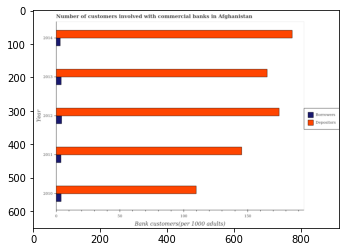

Number of QA =  28





,Year,Depositors,Borrowers
0,2014,337.001417,6.431118
1,2013,299.544153,7.939445
2,2010,198.850352,7.774491
3,2011,263.498723,7.471758
4,2012,317.356429,8.523173


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of depositors in 2010 and that in 2011 ?
PREDICTED =  -64.64837089357104
EXPECTED =  -35.609




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of depositors in 2010 and the number of borrowers in 2013 ?
PREDICTED =  197.85035214739145
EXPECTED =  105.76415864328519




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the number of depositors and number of borrowers ?
PREDICTED =  0.0
EXPECTED =  141.536




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Eval

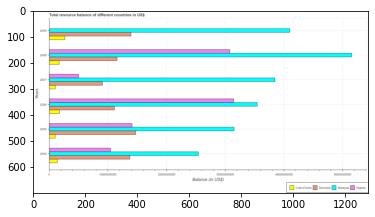

Number of QA =  27





,Years,Malaysia,Nigeria,Cote d'Ivoire,Denmark
0,2009,4.093518e+10,NaN,2.756137e+09,1.413330e+10
1,2008,NaN,3.169550e+10,1.755934e+09,1.166817e+10
2,2004,2.531611e+10,1.054143e+10,1.417528e+09,1.373883e+10
3,2005,3.168102e+10,NaN,1.100411e+09,NaN
4,2007,3.841344e+10,5.021362e+09,1.097876e+09,9.118897e+09
5,2006,NaN,3.145529e+10,1.778507e+09,1.118394e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total resource balance in nigeria in 2005 and that in 2008 ?
PREDICTED =  -31695501025.969112
EXPECTED =  -16674954672.754501




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total resource balance in cote d'ivoire in 2004 and the total resource balance in denmark in 2006 ?
PREDICTED =  -360979685.1877606
EXPECTED =  -9738706795.09874




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the total resource balance in malaysia and total resource balance in cote d'ivoire ?
PREDICTED =  3.0
EXPECTED =  24056456190.61614




				 0

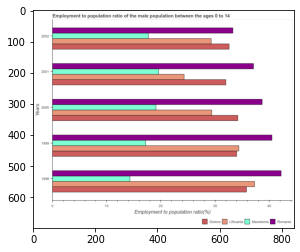

Number of QA =  30





,Years,Romania,Greece,Lithuania,Macedonia
0,2001,37.435517,32.166578,24.257474,19.533120
1,2000,38.963257,34.509395,29.372658,19.084748
2,1998,42.566607,35.662059,37.585919,NaN
3,1999,40.691286,NaN,34.425388,17.347322
4,2002,33.708386,NaN,29.287554,17.773923


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the employment to population ratio in greece in 1999 ?
PREDICTED =  0.945217046978914
EXPECTED =  34.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum employment to population ratio in romania ?
PREDICTED =  47.03217232776919
EXPECTED =  42.2000007629395




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum employment to population ratio in macedonia ?
PREDICTED =  1.0015007503751876
EXPECTED =  14.3000001907349




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.


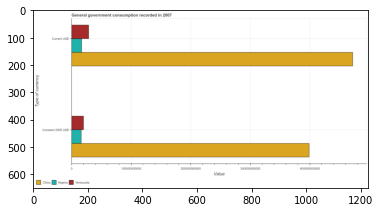

Number of QA =  23





,Type of currency,Nigeria,China,Venezuela
0,Current US$,1.802559e+10,4.744268e+11,2.948453e+10
1,Constant 2005 US$,1.729621e+10,4.002806e+11,2.104021e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value consumed in current us$ in venezuela and that in china ?
PREDICTED =  -444942240926.2986
EXPECTED =  -443178753254.6463




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value consumed in current us$ in nigeria and the value consumed in constant 2005 us$ in venezuela ?
PREDICTED =  -3014624124.094532
EXPECTED =  -3116145896.875099




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value consumed in constant 2005 us$ and value consumed in current us$ in nigeria ?
PREDICTED =  3744002570.801876
EXPECTED =  -679889953.4365005




				 2

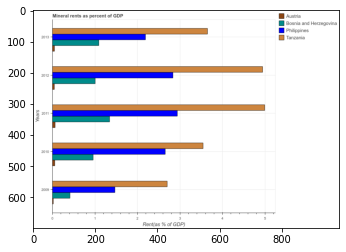

Number of QA =  30





,Years,Philippines,Bosnia and Herzegovina,Tanzania,Austria
0,2013,2.194876,1.100951,3.658806,0.059670
1,2011,2.957144,1.357837,4.972626,0.075538
2,2010,2.662875,0.966408,3.531681,0.067755
3,2009,1.465042,0.426830,2.689556,0.034152
4,2012,2.843567,1.021192,4.936252,0.054820


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the mineral rent in bosnia and herzegovina in 2011 and that in 2013 ?
PREDICTED =  2.4144297604248193
EXPECTED =  0.2536812226131




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the mineral rent in philippines in 2010 and the mineral rent in austria in 2013 ?
PREDICTED =  0.4679997544152239
EXPECTED =  2.6066023906445315




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the mineral rent in bosnia and herzegovina and mineral rent in philippines ?
PREDICTED =  4.44638790476901
EXPECTED =  -1.696823964903094




				 0 / 3 = 0.0


is

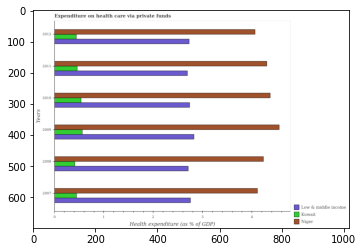

Number of QA =  29





,Years,Low & middle income,Kuwait,Niger
0,2011,2.733971,0.481709,4.344992
1,2012,2.767370,0.458562,4.079626
2,2009,2.859457,0.579952,4.570446
3,2008,2.748227,0.429351,4.252466
4,2010,2.770810,0.551211,4.388388
5,2007,2.795460,0.457781,4.148194


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure made on health care in low & middle income in 2009 and that in 2011 ?
PREDICTED =  0.12548584334530055
EXPECTED =  0.13249577452005035




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure made on health care in niger in 2010 and the expenditure made on health care in low & middle income in 2008 ?
PREDICTED =  0.13592161528079316
EXPECTED =  1.6597623527088499




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the expenditure made on health care in low & middle income and expenditure made on health care in

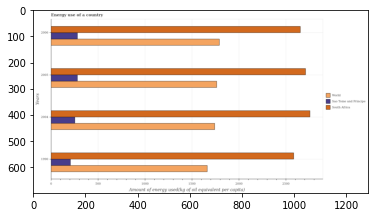

Number of QA =  29





,Years,Sao Tome and Principe,South Africa,World
0,2006,516.224810,4793.951406,3229.068762
1,1990,384.808401,4650.486646,2999.028427
2,2004,464.313483,5003.868346,3151.299482
3,2005,509.078463,4886.480654,3200.721900


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of energy used in in world in 2004 and that in 2005 ?
PREDICTED =  -49.42241857635554
EXPECTED =  -21.54413061948003




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of energy used in in south africa in 2004 and the amount of energy used in in world in 2005 ?
PREDICTED =  117.387692359428
EXPECTED =  992.9980503959698




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the amount of energy used in in south africa and amount of energy used in in sao tome and principe ?
PREDICTED =  18818.562242092008
EXPECTED =  

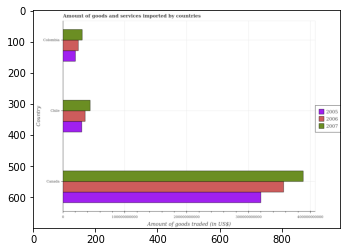

Number of QA =  29





,Country,2007,2005,2006
0,Chile,4.442584e+10,3.150672e+10,3.712112e+10
1,Canada,3.912216e+11,3.266762e+11,3.575547e+11
2,Colombia,3.191062e+10,2.108253e+10,2.577769e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount of goods and services imported in 2006 in chile and that in colombia ?
PREDICTED =  1.0
EXPECTED =  11052921879.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount of goods and services imported in 2007 in canada and the total amount of goods and services imported in 2005 in chile?
PREDICTED =  -435647458941.769
EXPECTED =  357994838060.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount of goods and services imported in 2005 and total amount of goods and services imported in 2007 in colombia ?
PREDI

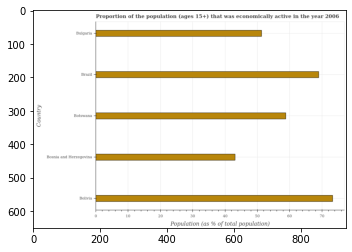

Number of QA =  22





,Country,Population (as % of total population)
0,Bolivia,74.077277
1,Botswana,59.829518
2,Bulgaria,52.135935
3,Brazil,69.779038
4,Bosnia and Herzegovina,43.521432


> what is the title of the graph ?
PREDICTED =  Proportion of the population (ages 15+) that was economically active in the year 2006
EXPECTED =  Proportion of the population (ages 15+) that was economically active in the year 2006




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Population (as % of total population)
EXPECTED =  Population (as % of total population)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active population in brazil and bulgaria ?
PREDICTED =  17.64310292194815
EXPECTED =  17.7




				 4 / 4 = 1.0


> what is the median percentage of economically active population ?
PREDICTED =  None
EXPECTED =  58.7999992370605




				 4 / 6 = 0.6667


is_built_with_c

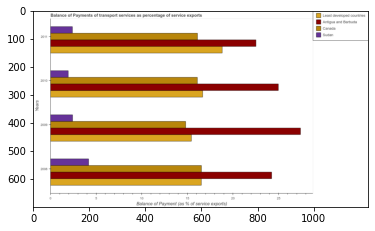

Number of QA =  30





,Years,Antigua and Barbuda,Least developed countries,Sudan,Canada
0,2008,24.250906,16.775578,4.227791,16.898460
1,2011,22.520768,18.739177,2.441280,16.090798
2,2010,24.963309,16.899753,1.974054,16.116084
3,2009,27.363096,NaN,2.439776,14.830029


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services in sudan in 2008 and that in 2009 ?
PREDICTED =  1.7880152800527367
EXPECTED =  1.7575629716105596




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services in sudan in 2010 and the balance of payments of transport services in canada in 2011 ?
PREDICTED =  -0.4672258330974044
EXPECTED =  -14.1670491452505




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the balance of payments of transport services in sudan and balance of payments of transport servi

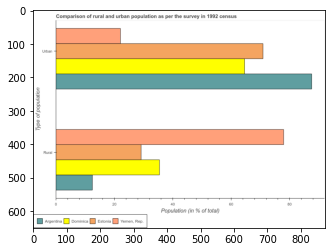

Number of QA =  23





,Type of population,Estonia,"Yemen, Rep",Dominica,Argentina
0,Urban,71.000866,22.113366,64.782887,88.206566
1,Rural,29.273290,78.020277,35.884316,12.682718


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population in yemen, rep. and that in estonia ?
PREDICTED =  48.74698725742425
EXPECTED =  48.80199999999999




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population and urban population in estonia ?
PREDICTED =  0.0
EXPECTED =  -41.72




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the rural population in dominica to that in argentina ?
PREDICTED =  2.829386791845525
EXPECTED =  

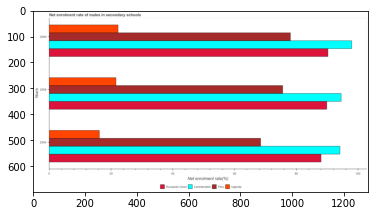

Number of QA =  30





,Years,Liechtenstein,Unnamed: 2,Uganda,European Union
0,2009,98.097004,78.083123,22.622825,90.027907
1,2004,94.665085,68.805317,16.493835,87.796872
2,2008,95.267348,75.707556,22.003924,90.157944


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate of males in secondary schools in uganda in 2004 and that in 2009 ?
PREDICTED =  -6.128990108871147
EXPECTED =  -6.045940399169901




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate of males in secondary schools in peru in 2004 and the net enrolment rate of males in secondary schools in european union in 2009 ?
PREDICTED =  4.637178249583712
EXPECTED =  -21.80177307128899




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the net enrolment rate of males in secondary schools in uganda and ne

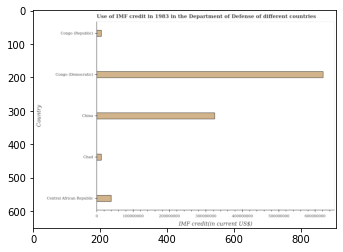

Number of QA =  22





,Country,IMF credit(in current US$)
0,China,3.261738e+08
1,Chad,1.449102e+07
2,Central African Republic,4.163476e+07
3,Congo (Republic),1.445697e+07
4,Congo (Democratic),6.263172e+08


> what is the title of the graph ?
PREDICTED =  Use of IMF credit in 1983 in the Department of Defense of different countries
EXPECTED =  Use of IMF credit in 1983 in the Department of Defense of different countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  IMF credit(in current US$)
EXPECTED =  IMF credit(in current US$)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the use of imf credit in dod in central african republic and china ?
PREDICTED =  -284539007.29188186
EXPECTED =  -284094000.0




				 4 / 4 = 1.0


> what is the median use of imf credit in dod ?
PREDICTED =  None
EXPECTED =  39965000.0




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or pred

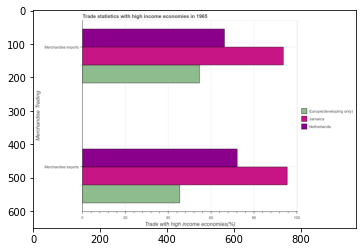

Number of QA =  23





,Merchandise Trading,Europe(developing only),Jamaica,Netherlands
0,Merchandise imports,54.687532,94.208174,66.332504
1,Merchandise exports,45.970980,97.240104,72.935210


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in netherlands and the merchandise imports in europe(developing only) ?
PREDICTED =  26.96423032777863
EXPECTED =  17.626204091727907




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the merchandise imports in jamaica to that in netherlands ?
PREDICTED =  1.4202414784186994
EXPECTED =  1.4148996666154905




				 1 / 4 = 0.25


> what is the difference between two conse

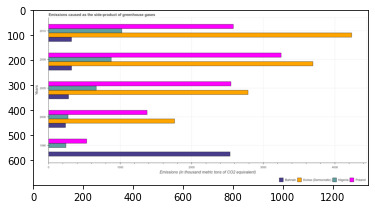

Number of QA =  30





,Years,Bahrain,Nigeria,Poland,Korea (Democratic)
0,1990,2523.420870,244.852263,540.627264,NaN
1,2010,324.563627,1044.312313,2597.414196,4208.390238
2,2005,280.639689,673.760890,2536.911299,2793.590650
3,2000,244.175765,272.576196,1369.513798,1755.757896
4,2008,325.290862,885.384500,3249.003144,3710.476939


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the emissions caused as the side-product of greenhouse gases in poland in 2010 and the emissions caused as the side-product of greenhouse gases in korea (democratic) in 2008 ?
PREDICTED =  -295.5430257459657
EXPECTED =  -1111.8000000000002




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the emissions caused as the side-product of greenhouse gases in nigeria and emissions caused as the side-product of greenhouse gases in bahrain ?
PREDICTED =  624.1772323350599
EXPECTED =  387.1




				 0 / 3 = 0.0


is_built_with_c

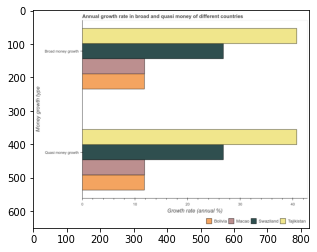

Number of QA =  23





,Money growth type,Bolivia,Tajikistan,Macao,Swaziland
0,Broad money growth,11.913512,40.768418,11.893610,26.926036
1,Quasi money growth,11.842462,40.666559,11.939309,26.632411


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the annual growth rate in quasi money in tajikistan and that in macao ?
PREDICTED =  28.727249793620345
EXPECTED =  28.899443586186187




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the annual growth rate in quasi money in macao and the annual growth rate in broad money in swaziland ?
PREDICTED =  -25.632410746417754
EXPECTED =  -14.961200934554398




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the annual growth rate in broad money and annual growth rate in quasi money in tajikistan ?
PREDICTED =  -1.0
EXPECTED =  0.0




				 1 / 3 = 0.3333




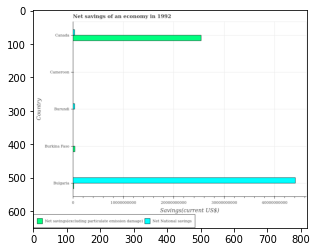

Number of QA =  24





,Country,Net National savings,Net savings(excluding particulate emission damage)
0,Canada,4.669454e+08,2.559067e+10
1,Burkina Faso,NaN,5.363153e+08
2,Cameroon,NaN,NaN
3,Burundi,4.807649e+08,NaN
4,Bulgaria,4.442720e+10,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net national savings in bulgaria and that in burundi ?
PREDICTED =  43946434701.53067
EXPECTED =  43745521936.231




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net national savings in burundi and the net savings(excluding particulate emission damage) in canada ?
PREDICTED =  13819496.36342907
EXPECTED =  -25069905008.09544




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net savings(exclud

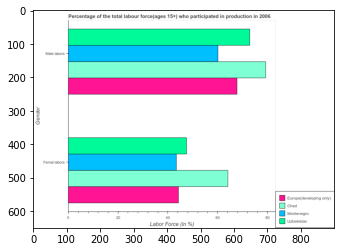

Number of QA =  23





,Gender,Uzbekistan,Chad,Europe(developing only:,Montenegro
0,Male labors,73.065657,79.293771,68.089601,60.515467
1,Femal labors,47.813323,64.531020,44.313284,43.863858


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labour force in europe(developing only) and that in chad ?
PREDICTED =  0.0
EXPECTED =  -11.536769251861202




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labour force in chad and the percentage of female labor force in uzbekistan ?
PREDICTED =  6.228113079906933
EXPECTED =  31.8000030517578




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labour force and percentage of female labor force in montenegro ?
PREDICTED =  -58.51546747355877
EXPECTED =  16.6999969482422




				 0 / 3

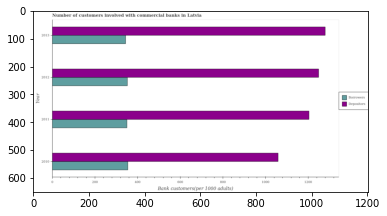

Number of QA =  28





,Year,Depositors,Borrowers
0,2013,1286.886021,350.727342
1,2010,1071.818273,359.711394
2,2011,1223.019672,358.180175
3,2012,1271.617609,356.342621


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of depositors in 2012 and that in 2013 ?
PREDICTED =  1270.6176090787126
EXPECTED =  -30.795




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of depositors in 2011 and the number of borrowers in 2013 ?
PREDICTED =  1222.019671519751
EXPECTED =  859.671802074593




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the number of depositors and number of borrowers ?
PREDICTED =  -1420.9615323091707
EXPECTED =  935.766




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predic

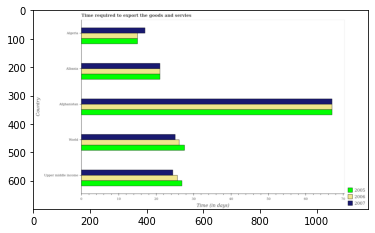

Number of QA =  29





,Country,2007,2005,2006
0,Albania,21.269353,21.270367,NaN
1,World,25.518221,27.829297,NaN
2,Algeria,17.444671,15.323945,15.235531
3,Upper middle income,24.808232,27.190839,NaN
4,Afghanistan,67.633563,67.927155,67.917749


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to export the goods and services in 2007 in afghanistan and that in albania ?
PREDICTED =  2.0
EXPECTED =  46.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to export the goods and services in 2007 in upper middle income and the number of days required to export the goods and services in 2006 in afghanistan?
PREDICTED =  2.0
EXPECTED =  -42.5625




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to export the goods and services in 2007 and number of days required 

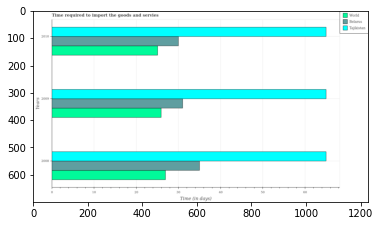

Number of QA =  29





,Years,Belarus,Tajikistan,World
0,2008,35.332343,65.628390,26.897572
1,2010,30.424333,65.787111,25.415027
2,2009,31.468599,65.820240,26.311172


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to import the goods and services in belarus in 2008 and that in 2009 ?
PREDICTED =  -63.800941623099206
EXPECTED =  4




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to import the goods and services in tajikistan in 2010 and the number of days required to import the goods and services in belarus in 2008 ?
PREDICTED =  -62.756675455059494
EXPECTED =  30




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the number of days required to import the goods and services in tajikistan 

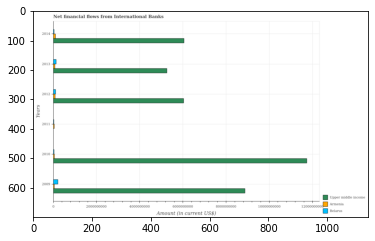

Number of QA =  26





,Years,Belarus,Armenia,Upper middle income
0,2014,NaN,1.223366e+08,6.110944e+09
1,2011,NaN,6.656321e+07,NaN
2,2010,NaN,NaN,1.184989e+10
3,2013,1.577534e+08,1.003986e+08,5.320618e+09
4,2009,2.368757e+08,NaN,9.022750e+09
5,2012,1.297204e+08,1.122371e+08,6.118787e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net financial aid flows in armenia in 2009 and that in 2010 ?
PREDICTED =  -2827134934.6231575
EXPECTED =  -3796000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net financial aid flows in armenia in 2010 and the net financial aid flows in upper middle income in 2009 ?
PREDICTED =  2827134934.6231575
EXPECTED =  -8821400000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2014, what is the difference between the net financial aid flows in armenia and net financial aid flows in belarus ?
PREDICTED =  1.0
EXPECTED =  62760000.0




				 0 / 3 = 0.0


is_

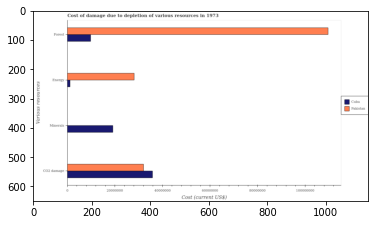

Number of QA =  29





,Various resources,Cuba,Pakistan
0,CO2 damage,3.635948e+07,3.249311e+07
1,Minerals,1.945368e+07,NaN
2,Forest,1.009002e+07,1.099375e+08
3,Energy,1.363393e+06,2.846045e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of minerals in pakistan and that in cuba ?
PREDICTED =  -19453677.539587915
EXPECTED =  -19124726.50927281




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of coal in pakistan and the cost of damage due to depletion of forests in cuba ?
PREDICTED =  20386756.46377258
EXPECTED =  22244788.44064427




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of minerals and cost of damage due to depletion of forests in cuba ?
PREDICTED =  9363654.105283739

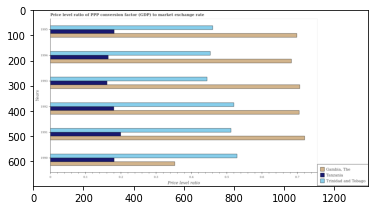

Number of QA =  29





,Years,"Gambia, The",Tanzania,Trinidad and Tobago
0,1992,0.707827,0.181760,0.525065
1,1990,0.349665,0.182689,0.534148
2,1993,0.703819,0.162247,0.447984
3,1991,0.726042,0.199967,0.514345
4,1994,0.685483,0.164393,0.462154
5,1995,0.698477,0.182740,0.473008


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the price level ratio in trinidad and tobago in 1995 ?
PREDICTED =  0.15766931952689833
EXPECTED =  0.460322376258279




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum price level ratio in trinidad and tobago ?
PREDICTED =  663.3333333333334
EXPECTED =  0.529123023151624




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum price level ratio in gambia, the ?
PREDICTED =  663.3333333333334
EXPECTED =  0.352747367188004




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step

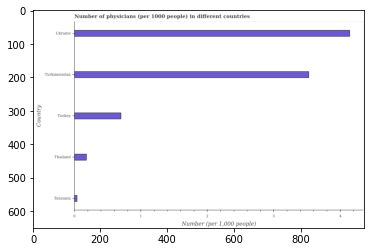

Number of QA =  22





,Country,"Number (per 1,000 people)"
0,Tanzania,0.052174
1,Ukraine,4.163371
2,Thailand,0.193581
3,Turkey,0.711432
4,Turkmenistan,3.552194


> what is the title of the graph ?
PREDICTED =  Number of physicians (per 1000 people) in different countries
EXPECTED =  Number of physicians (per 1000 people) in different countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Number (per 1,000 people)
EXPECTED =  Number (per 1,000 people)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of physicians in tanzania and turkey ?
PREDICTED =  -0.6592579509382938
EXPECTED =  -0.661




				 4 / 4 = 1.0


> what is the median number of physicians ?
PREDICTED =  None
EXPECTED =  0.7




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is t

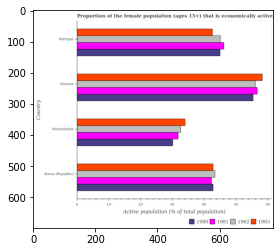

Number of QA =  30





,Country,1982,1980,1983,1981
0,Netherlands,33.157595,30.756532,34.550294,32.368287
1,Portugal,45.753736,45.515157,43.255107,46.452832
2,Korea (Republic),44.221702,43.205758,43.353386,43.125508
3,Norway,NaN,56.169967,58.890950,57.410770


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female population that is economically active in 1983 in netherlands and that in portugal ?
PREDICTED =  -8.704812548284757
EXPECTED =  -8.5999984741211




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female population that is economically active in 1983 in portugal and the proportion of the female population that is economically active in 1980 in norway?
PREDICTED =  -12.914860473252276
EXPECTED =  -12.800003051757798




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female populati

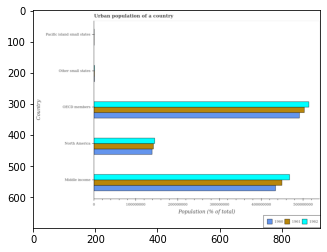

Number of QA =  29





,Country,1962,1961,1960
0,Other small states,NaN,NaN,NaN
1,OECD members,5.130190e+08,NaN,4.963230e+08
2,Middle income,4.725763e+08,4.548111e+08,4.330668e+08
3,North America,1.476754e+08,1.449684e+08,1.410798e+08
4,Pacific island small states,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population in 1962 in middle income and the urban population in 1960 in oecd members?
PREDICTED =  -40442721.76050556
EXPECTED =  -23624425.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: 

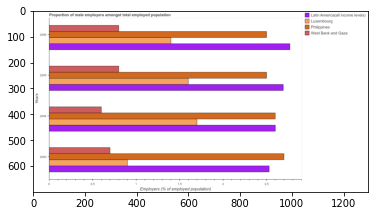

Number of QA =  30





,Years,Luxembourg,Philippines,Latin America(all income levels:,West Bank and Gaza
0,2006,1.408967,2.500374,2.775144,0.802699
1,2003,0.898836,2.691662,2.530746,0.703880
2,2005,1.601858,2.502986,2.690893,0.806288
3,2004,1.694906,2.615226,2.599195,0.602687


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of male employers in latin america(all income levels) in 2005 and that in 2006 ?
PREDICTED =  -0.08425038268286311
EXPECTED =  -0.07580434369807021




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of male employers in west bank and gaza in 2006 and the proportion of male employers in philippines in 2005 ?
PREDICTED =  3.1937118560882514
EXPECTED =  -1.699999988079072




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the proportion of male employers in luxembourg and proportion of male employers in west

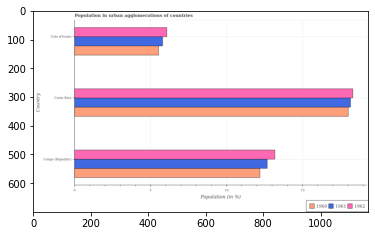

Number of QA =  29





,Country,1962,1961,1960
0,Cote d'Ivoire,6.085164,5.800059,5.594485
1,Costa Rica,18.421771,18.098012,17.963490
2,Congo (Republic),13.269184,12.730018,12.119529


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the percentage of population in urban agglomerations in 1960 in congo (republic) ?
PREDICTED =  4.039843018039219
EXPECTED =  12.1986304005304




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum percentage of population in urban agglomerations in 1962 ?
PREDICTED =  6.140590466851353
EXPECTED =  18.3140523097091




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum percentage of population in urban agglomerations in 1962 ?
PREDICTED =  2.0283880589142433
EXPECTED =  6.064852775148162




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GP

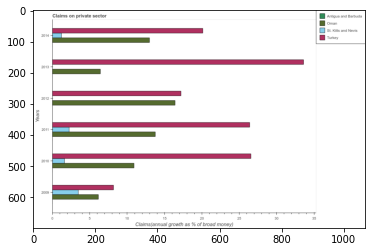

Number of QA =  26





,Years,Turkey,St. Kitts and Nevis,Oman,Antigua and Barbuda
0,2012,17.289066,NaN,16.537641,NaN
1,2013,33.657026,NaN,6.498453,NaN
2,2010,26.522558,1.680888,11.014957,NaN
3,2009,8.297904,3.563998,6.331812,NaN
4,2014,20.201000,1.256082,13.084801,NaN
5,2011,26.313811,2.320858,13.810153,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of broad money claimed on private sector in oman in 2010 and that in 2014 ?
PREDICTED =  -2.06984375833742
EXPECTED =  -2.0734575625478




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of broad money claimed on private sector in antigua and barbuda in 2011 and the percentage of broad money claimed on private sector in oman in 2013 ?
PREDICTED =  -12.810152500146105
EXPECTED =  -6.416135288072589




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of broad money claimed on private sector in

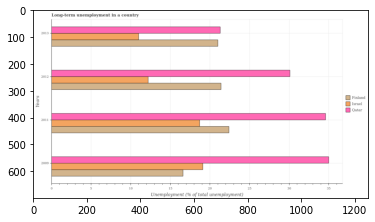

Number of QA =  29





,Years,Finland,Israel,Qatar
0,2009,16.526744,19.058780,35.016287
1,2011,22.432477,18.696698,34.409042
2,2012,21.536162,12.238858,30.017043
3,2013,21.084899,NaN,21.286427


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of long-term unemployed population in qatar in 2009 and that in 2011 ?
PREDICTED =  0.607245285870313
EXPECTED =  0.40000152587889914




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of long-term unemployed population in finland in 2011 and the percentage of long-term unemployed population in israel in 2012 ?
PREDICTED =  10.193619248767957
EXPECTED =  10.19999980926521




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of long-term unemployed population in finland and percentage of long-

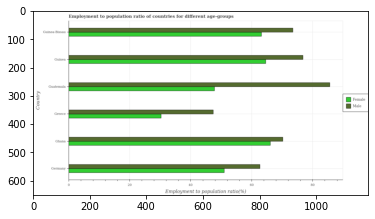

Number of QA =  28





,Country,Female,Male
0,Ghana,66.372120,70.910163
1,Germany,51.832471,62.825782
2,Greece,30.285714,47.323320
3,Guinea,64.819379,76.692967
4,Guatemala,48.244633,85.824588
5,Guinea-Bissau,63.638486,73.748114


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the total employment to population ratio(female) in the graph ?
PREDICTED =  0.01845059

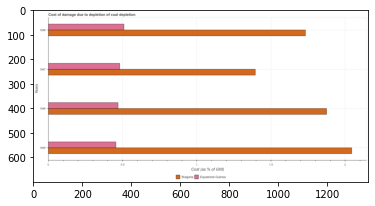

Number of QA =  28





,Years,Bulgaria,Equatorial Guinea
0,1985,2.046475,0.461496
1,1986,1.874306,0.476853
2,1987,1.391562,0.485023
3,1988,1.726437,0.511396


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to coal depletion in equatorial guinea in 1985 and that in 1986 ?
PREDICTED =  -0.015356586228486846
EXPECTED =  -0.014403118197751086




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to coal depletion in bulgaria in 1985 and the cost of damage caused due to coal depletion in equatorial guinea in 1986 ?
PREDICTED =  0.1721687424196463
EXPECTED =  1.5748915299886976




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1985, what is the difference between the cost of damage caused due to coal depletion in bulgaria

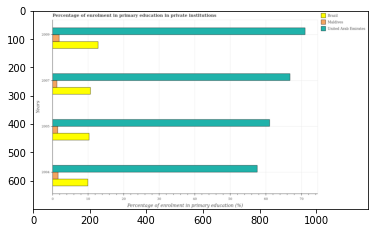

Number of QA =  29





,Years,United Arab Emirates,Brazil,Maldives
0,2009,71.388646,13.070728,2.036380
1,2005,61.775678,10.538667,1.627217
2,2004,58.126552,10.115978,1.715607
3,2007,67.816333,10.910535,1.383875


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of enrolment in primary education in maldives in 2007 and that in 2009 ?
PREDICTED =  -0.652505087316644
EXPECTED =  -0.6207900047302302




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of enrolment in primary education in maldives in 2009 and the percentage of enrolment in primary education in brazil in 2007 ?
PREDICTED =  -8.87415428861367
EXPECTED =  -8.80905985832215




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the percentage of enrolment in primary education in brazil and percentage of enrolm

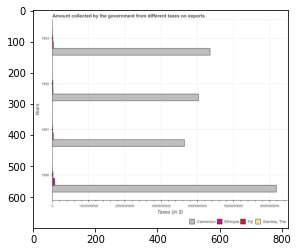

Number of QA =  30





,Years,Fiji,"Gambia, The",Cameroon,Ethiopia
0,1990,NaN,NaN,6.202021e+09,7.554135e+07
1,1993,NaN,NaN,4.364196e+09,NaN
2,1991,NaN,NaN,3.612931e+09,3.815755e+07
3,1992,NaN,NaN,4.028777e+09,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected by the government from taxes on exports in ethiopia in 1991 and that in 1993 ?
PREDICTED =  38157554.48839387
EXPECTED =  -1800000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected by the government from taxes on exports in ethiopia in 1990 and the amount collected by the government from taxes on exports in fiji in 1992 ?
PREDICTED =  75541348.60893981
EXPECTED =  49370000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation 

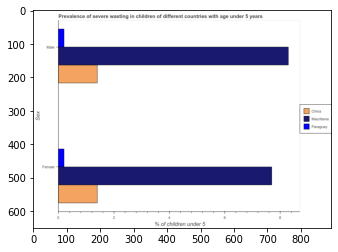

Number of QA =  23





,Sex,Mauritania,China,Paraguay
0,Male,8.304770,1.421573,0.226603
1,Female,7.790635,1.409725,0.226355


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished male children in mauritania and that in china ?
PREDICTED =  6.380910236633248
EXPECTED =  6.900000214576721




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished male children in paraguay and the percentage of undernourished female children in china ?
PREDICTED =  -1.4097246420686582
EXPECTED =  -1.199999973177908




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished female children and percentage of undernourished male children in china ?
PREDICTED =  6.38091

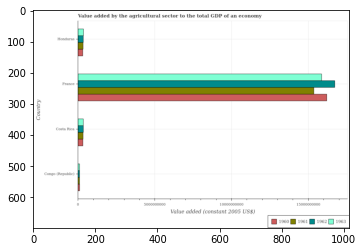

Number of QA =  30





,Country,1963,1962,1961,1960
0,France,2.880686e+10,3.014372e+10,2.779784e+10,2.926054e+10
1,Costa Rica,6.901978e+08,6.947595e+08,6.692021e+08,6.584836e+08
2,Congo (Republic),2.405240e+08,2.428244e+08,2.396416e+08,2.597353e+08
3,Honduras,7.050846e+08,6.876077e+08,6.536857e+08,6.335335e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the agricultural sector in 1962 in costa rica and that in france ?
PREDICTED =  -29448961066.584
EXPECTED =  -16375320272.731825




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the agricultural sector in 1961 in honduras and the value added by the agricultural sector in 1960 in costa rica?
PREDICTED =  -15516403.775256515
EXPECTED =  12321599.638317943




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the agricultural sector in 1963 and value added by the agricultural sector in 1960 in costa 

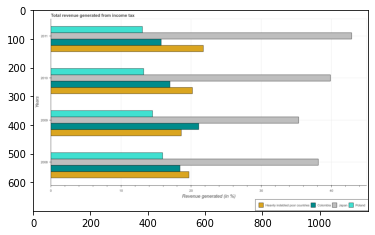

Number of QA =  30





,Years,Unnamed: 1,Heavily indebted poor countnes,Poland,Colombia
0,2011,42.867292,21.744096,13.208373,15.771629
1,2008,38.296615,19.823524,15.955401,18.566807
2,2010,39.986708,20.299077,13.314486,17.133927
3,2009,35.230461,18.661382,NaN,21.262121


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total revenue generated in poland in 2008 and that in 2009 ?
PREDICTED =  0.0
EXPECTED =  1.4372673316553009




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total revenue generated in poland in 2009 and the total revenue generated in colombia in 2011 ?
PREDICTED =  2.7470285689608307
EXPECTED =  -1.2313627950963006




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the total revenue generated in poland and total revenue generated in japan ?
PREDICTED =  38.47825986922604
EXPECTED =  -26.6386333262939




				 0 / 3 = 0.0




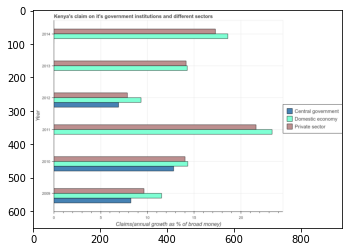

Number of QA =  26





,Year,Private sector,Central government,Domestic economy
0,2014,17.233107,NaN,18.572294
1,2013,NaN,NaN,NaN
2,2012,NaN,6.957774,9.270472
3,2011,21.600416,NaN,23.347397
4,2010,13.986340,NaN,NaN
5,2009,9.661223,NaN,11.402101


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of claim on the domestic economy in 2009 and that in 2010 ?
PREDICTED =  nan
EXPECTED =  -2.8




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of claim on the central government in 2014 and the percentage of claim on the private sector in 2009 ?
PREDICTED =  nan
EXPECTED =  -9.62895259786079




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2014, what is the difference between the percentage of claim on the domestic economy and percentage of claim on the private sector ?
PREDICTED =  1.3391873426186969
EXPECTED =  1.331




				 1 / 3 = 0

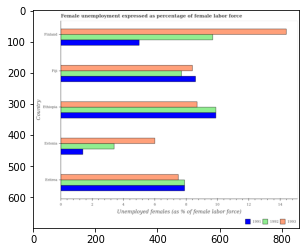

Number of QA =  29





,Country,1992,1993,1991
0,Finland,9.714450,14.318458,5.038514
1,Fiji,7.795421,NaN,8.560275
2,Ethiopia,9.858568,8.707748,9.938269
3,Eritrea,7.923499,7.553300,7.885257
4,Estonia,3.406858,6.003697,1.446371


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in females in in 1992 in eritrea and that in finland ?
PREDICTED =  -1.7909506411990934
EXPECTED =  -1.7999997138977113




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in females in in 1991 in fiji and the unemployment in females in in 1993 in ethiopia?
PREDICTED =  -1.3779937436811291
EXPECTED =  -0.09999942779540838




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in females in in 1991 and unemployment in females in in 1992 in finland ?
PREDICTED =  -7.714449802079477
EXPECTED =  -4.699999809265

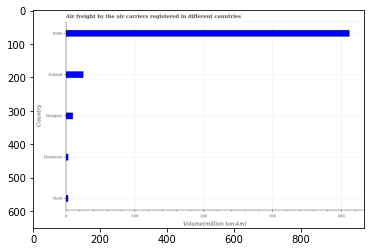

Number of QA =  22





,Country,Volume(million ton-km)
0,Haiti,3.982643
1,India,412.891116
2,Iceland,26.092588
3,Honduras,4.062937
4,Hungary,11.028600


> what is the title of the graph ?
PREDICTED =  Air freight by the air carriers registered in different countries
EXPECTED =  Air freight by the air carriers registered in different countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Volume(million ton-km)
EXPECTED =  Volume(million ton-km)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the air freight in honduras and india ?
PREDICTED =  -408.828178748202
EXPECTED =  -408.4




				 4 / 4 = 1.0


> what is the median air freight ?
PREDICTED =  None
EXPECTED =  9.6999998093




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio o

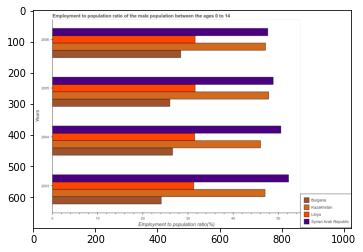

Number of QA =  30





,Years,Bulgaria,Syrian Arab Republic,Libya,Kazakhstan
0,2004,NaN,50.707458,31.682920,46.136096
1,2006,28.427484,48.000126,31.618651,47.223411
2,2003,24.259910,52.344355,31.453509,47.261429
3,2005,26.267949,48.247632,31.736688,48.183363


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum employment to population ratio in kazakhstan ?
PREDICTED =  41.6326272182086
EXPECTED =  47.9000015258789




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum employment to population ratio in libya ?
PREDICTED =  1.0
EXPECTED =  31.2999992370605




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the employment to population ratio in syrian arab republic maximum?
PREDICTED =  1.0
EXPECTED =  2003




	

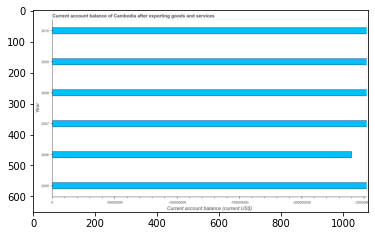

Number of QA =  12





,Year,Current account balance (current US$)
0,2010,1.519489e+08
1,2006,1.455836e+08
2,2007,1.522148e+08
3,2009,1.517875e+08
4,2005,1.522360e+08
5,2008,1.522360e+08


> what is the title of the graph ?
PREDICTED =  Current account balance of Cambodia after exporting goods and services
EXPECTED =  Current account balance of Cambodia after exporting goods and services




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Current account balance (current US$)
EXPECTED =  Current account balance (current US$)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median current account balance ?
PREDICTED =  152081875.62981707
EXPECTED =  0.0




				 3 / 4 = 0.75


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Current account balance (current US$)
EXPECTED =  50000000.0




				 3 / 5 = 0.6


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predict

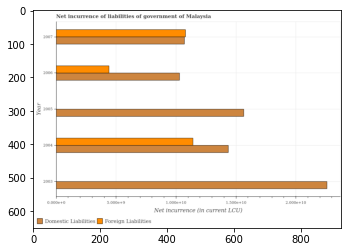

Number of QA =  25





,Year,Foreign Liabilities,Domestic Liabilities
0,2003,NaN,40.786799
1,2005,NaN,28.174394
2,2007,19.387192,19.287335
3,2004,20.588069,26.028098
4,2006,8.013419,18.561654


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net incurrence of domestic liabilities in 2003 and that in 2005 ?
PREDICTED =  -28.17439430735925
EXPECTED =  6940300000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net incurrence of foreign liabilities in 2004 and the net incurrence of domestic liabilities in 2006 ?
PREDICTED =  12.574650226747199
EXPECTED =  1121700000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net incurrence of d

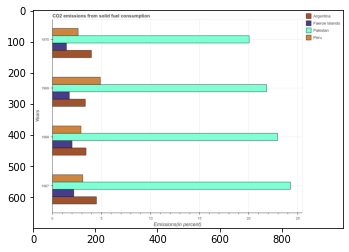

Number of QA =  30





,Years,Faeroe Islands,Peru,Pakistan,Argentina
0,1968,2.026176,2.921102,22.929309,3.509877
1,1970,1.477294,2.695430,19.906415,3.995543
2,1969,1.776549,4.959121,21.797859,3.400667
3,1967,2.248478,3.163002,24.329911,4.520685


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in pakistan in 1967 and that in 1969 ?
PREDICTED =  2.5320511953484086
EXPECTED =  2.4331954388272976




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in peru in 1967 and the total co2 emitted in pakistan in 1969 ?
PREDICTED =  -1.7961186657219326
EXPECTED =  -18.752057158682362




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1970, what is the difference between the total co2 emitted in pakistan and total co2 emitted in peru ?
PREDICTED =  75.22483889021676
EXPECTED =  17.43568467308387




				 1 / 3 = 0.3333


is_built_w

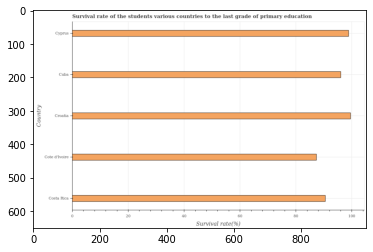

Number of QA =  22





,Country,Survival rate(%)
0,Costa Rica,90.910355
1,Cuba,96.690407
2,Croatia,100.122883
3,Cyprus,98.542736
4,Cote d'Ivoire,88.064937


> what is the title of the graph ?
PREDICTED =  Survival rate of the students various countries to the last grade of primary education
EXPECTED =  Survival rate of the students various countries to the last grade of primary education




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Survival rate(%)
EXPECTED =  Survival rate(%)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the survival rate in primary education in cote d'ivoire and cyprus ?
PREDICTED =  -10.477798134231989
EXPECTED =  -11.5




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median survival rate in primary education ?
PREDIC

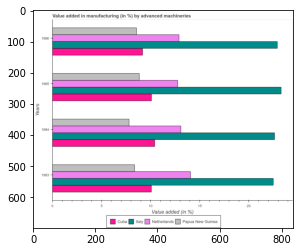

Number of QA =  30





,Years,Papua New Guinea,Cuba,Netherlands,Italy
0,1986,8.589894,9.277128,12.882740,22.876006
1,1985,8.791153,10.141999,12.843087,23.286805
2,1984,7.810491,10.403976,13.141766,22.730699
3,1983,8.412706,10.140391,14.008459,22.469074


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of value added in manufacturing by advanced machineries in cuba in 1983 and that in 1985 ?
PREDICTED =  -0.0016083835101010635
EXPECTED =  -0.007657794603199264




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of value added in manufacturing by advanced machineries in italy in 1983 and the percentage of value added in manufacturing by advanced machineries in papua new guinea in 1986 ?
PREDICTED =  20.469073810629247
EXPECTED =  13.944160238971328




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1984, what is the difference between the pe

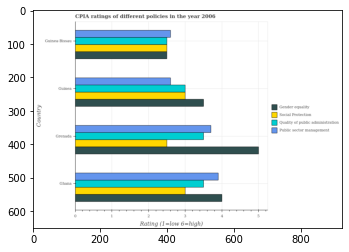

Number of QA =  30





,Country,Public sector management,Gender equality,Quality of public administration,Social Protection
0,Guinea,2.644102,3.523797,3.027101,3.034151
1,Grenada,3.744147,5.041863,3.546371,2.535585
2,Ghana,NaN,4.023242,3.537177,3.011670
3,Guinea-Bissau,2.625781,2.522069,2.526804,2.534278


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum cpia rating of quality of public administration ?
PREDICTED =  0.25
EXPECTED =  2.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of quality of public administration in ghana and that in guinea-bissau ?
PREDICTED =  0.25
EXPECTED =  1.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of quality of public administration in grenada and the cpia rating o

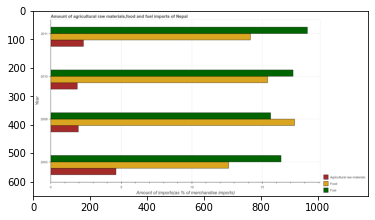

Number of QA =  29





,Year,Agricultural raw materials,Fuel,Food
0,2011,2.367603,18.226408,14.178266
1,2003,4.663007,16.339838,12.631801
2,2009,2.006191,15.584414,17.238045
3,2010,1.922121,17.188126,15.306755


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of raw materials imports in 2009 and that in 2011 ?
PREDICTED =  -0.36141143133540377
EXPECTED =  -0.362




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of food imports in 2003 and the percentage of fuel imports in 2010 ?
PREDICTED =  -2.6749537752044557
EXPECTED =  -4.564097895151191




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the percentage of raw materials imports and percentage of food imports ?
PREDICTED =  1.9232763520983696
EXPECTED =  -7.992




				 1 / 3 = 0.3333


is_built_with_cuda: 

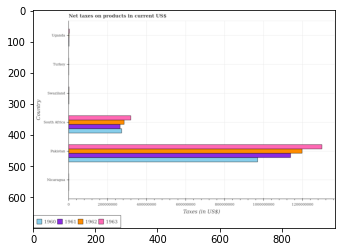

Number of QA =  30





,Country,1963,1962,1961,1960
0,Swaziland,NaN,NaN,NaN,NaN
1,Nicaragua,NaN,NaN,NaN,NaN
2,Uganda,NaN,NaN,NaN,NaN
3,Turkey,NaN,NaN,NaN,NaN
4,Pakistan,1.305656e+09,NaN,NaN,9.678790e+08
5,South Africa,NaN,2.902656e+08,2.701791e+08,2.760465e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net taxes on products in 1962 in south africa and that in uganda ?
PREDICTED =  0.0
EXPECTED =  282667500.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net taxes on products in 1963 in swaziland and the net taxes on products in 1960 in nicaragua?
PREDICTED =  -1305656329.6203938
EXPECTED =  1474399.9702361953




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net taxes on products in 1961 and net taxes on products in 1963 in uganda ?
PREDICTED =  270179148.6341787
EXPECTED =  -1459100.0




				 0 / 3 = 0.0


is_built_with_cuda: True

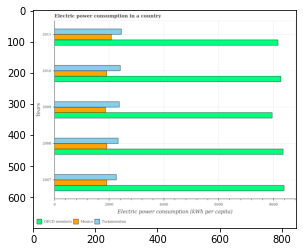

Number of QA =  29





,Years,OECD members,Mexica,Turkmenistan
0,2011,8213.561400,2082.377915,2490.385487
1,2010,8347.046079,1921.047807,2455.893064
2,2008,8435.333356,1950.879588,2387.185857
3,2007,8482.641825,1964.145803,2297.357333
4,2009,8080.214361,1887.453977,2426.816821


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the electric power consumption in in oecd members in 2007 and that in 2010 ?
PREDICTED =  135.59574565826188
EXPECTED =  118.25409054440752




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the electric power consumption in in turkmenistan in 2011 and the electric power consumption in in oecd members in 2007 ?
PREDICTED =  193.02815389648595
EXPECTED =  -5943.382296031139




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the electric power consumption in in mexico and electric power consumption in in turkmenistan ?
PREDICTED =  -450

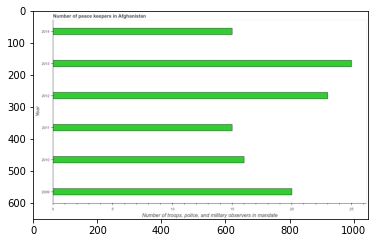

Number of QA =  23





,Year,"Number of troops, police, and military observers in mandate"
0,2014,14.904156
1,2010,15.979740
2,2013,25.043677
3,2009,20.070142
4,2012,23.080453
5,2011,14.963428


> what is the title of the graph ?
PREDICTED =  Number of peace keepers in Afghanistan
EXPECTED =  Number of peace keepers in Afghanistan




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Number of troops, police, and military observers in mandate
EXPECTED =  Number of troops, police, and military observers in mandate




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of peace keepers in 2009 and 2011 ?
PREDICTED =  5.1067147140133695
EXPECTED =  5.0




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of peace keepers ?
PREDICTED =  2011.5
EXPECTED =  18.0




				 4 / 5 = 0.8



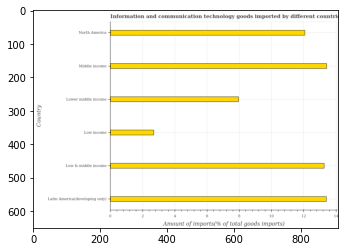

Number of QA =  22





,Country,Amount of imports(% of total goods imports)
0,Low income,2.729477
1,North America,12.080395
2,Lower middle income,7.926274
3,Low & middle income,13.223846
4,Middle income,13.370956
5,Latin America(developing only),13.342289


> what is the title of the graph ?
PREDICTED =  Information and communication technology goods imported by different countrie
EXPECTED =  Information and communication technology goods imported by different countries




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Amount of imports(% of total goods imports)
EXPECTED =  Amount of imports(% of total goods imports)




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of ict goods imports in latin america(developing only) and middle income ?
PREDICTED =  0.0
EXPECTED =  -0.019




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 5 = 0.4


is

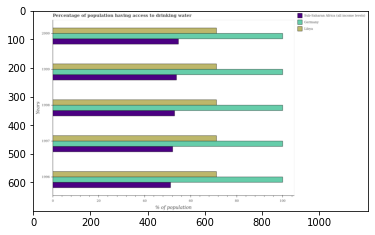

Number of QA =  29





,Years,Unnamed: 1,Germany,Sub-Saharan Africa (all income levels)
0,1999,71.633621,100.998717,54.431630
1,1996,71.534212,101.270132,51.886729
2,1998,72.094491,100.839798,53.668035
3,2000,72.095341,100.968872,55.021791
4,1997,71.977367,100.707258,53.071003


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population having access to drinking water in libya in 1998 and that in 2000 ?
PREDICTED =  -0.0008502554328941869
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population having access to drinking water in sub-saharan africa (all income levels) in 2000 and the percentage of population having access to drinking water in libya in 1999 ?
PREDICTED =  0.0
EXPECTED =  -16.542369759738506




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the percentage of population having access to

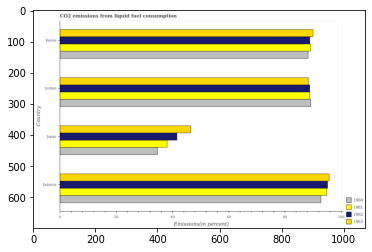

Number of QA =  30





,Country,1963,1962,1961,1960
0,Kenya,90.124143,89.293766,89.866543,88.729833
1,Jordan,88.692992,89.557121,89.077011,89.578500
2,Japan,46.717077,42.108971,38.249579,34.996872
3,Jamaica,95.837158,95.766471,95.496192,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1962 in jordan and that in kenya ?
PREDICTED =  0.2633558170702912
EXPECTED =  -0.015626831269301533




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1961 in jordan and the total co2 emitted in 1962 in kenya?
PREDICTED =  -0.7895318626612493
EXPECTED =  -0.06277069863789109




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1962 and total co2 emitted in 1960 in jordan ?
PREDICTED =  227.1478287755508
EXPECTED =  -0.3513727651658911




				 0 / 3 = 0.0


is_built_with_cuda: Tr

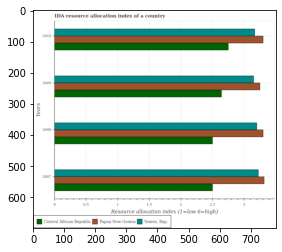

Number of QA =  29





,Years,Papua New Guinea,"Yemen, Rep.",Central African Republic
0,2010,3.353351,3.208920,2.779426
1,2009,3.299298,3.201540,2.685232
2,2008,3.334066,3.234544,2.531120
3,2007,3.296660,3.261292,2.522040


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ida resource allocation index in yemen, rep. in 2008 and that in 2009 ?
PREDICTED =  0.033004192731408644
EXPECTED =  0.050000000000000266




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the ida resource allocation index in yemen, rep. in 2009 and the ida resource allocation index in papua new guinea in 2007 ?
PREDICTED =  -0.05975182676170698
EXPECTED =  -0.16666666666667007




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the ida resource allocation index in papua new guinea and ida resource allocation index in central afri

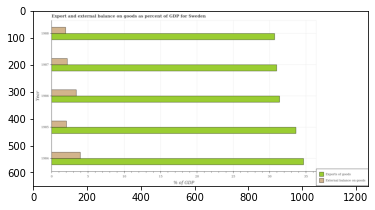

Number of QA =  28





,Year,External balance on goods,Exports of goods
0,1985,2.128176,33.901858
1,1987,2.216631,30.999332
2,1984,4.017975,34.778082
3,1986,3.468957,31.478454
4,1988,2.005057,30.801660


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the external balance on goods as percentage of gdp in 1987 and that in 1988 ?
PREDICTED =  0.2115740924181262
EXPECTED =  0.23




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export of goods as percentage of gdp in 1984 and the external balance on goods as percentage of gdp in 1985 ?
PREDICTED =  0.8762245501671444
EXPECTED =  32.62213621097098




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1987, what is the difference between the export of goods as percentage of gdp and external balance on goods as percentage of gdp ?
PREDICTED =  131.15772617059608
EXPECTED 

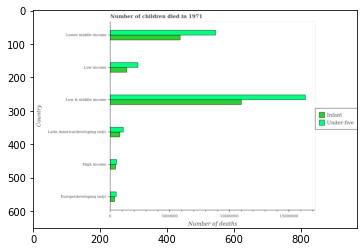

Number of QA =  28





,Country,Infant,Under-five
0,Lower middle income,NaN,1.603333e+07
1,High income,9.147851e+05,1.075532e+06
2,Low income,2.614651e+06,4.292240e+06
3,Low & middle income,1.995910e+07,2.976930e+07
4,Latin America(developing only),1.559245e+06,2.092200e+06
5,Europe(developing only),7.561271e+05,9.906593e+05


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of under-five deaths in high income and that in low & middle income ?
PREDICTED =  -44727095.90214286
EXPECTED =  -15853703




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of under-five deaths in europe(developing only) and the number of infant deaths in latin america(developing only) ?
PREDICTED =  -2092200.421424632
EXPECTED =  -297331




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of infant deaths and number of under-five deaths in low & middle income ?
PREDICTED =  5844808.993486118
EXPECTED =  -5379817




	

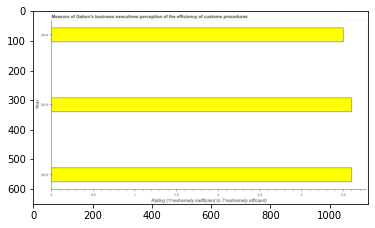

Number of QA =  23





,Year,Rating (1=extremely inefficient to 7=extremely efficient)
0,2014,3.457662
1,2013,3.562160
2,2012,3.519842


> what is the title of the graph ?
PREDICTED =  Measure of Gabon's business executives perception of the efficiency of customs procedures
EXPECTED =  Measure of Gabon's business executives perception of the efficiency of customs procedures




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Rating (1=extremely inefficient to 7=extremely efficient)
EXPECTED =  Rating (1=extremely inefficient to 7=extremely efficient)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating measuring burden of customs procedure in 2013 and 2014 ?
PREDICTED =  0.10449853234050188
EXPECTED =  0.1




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training

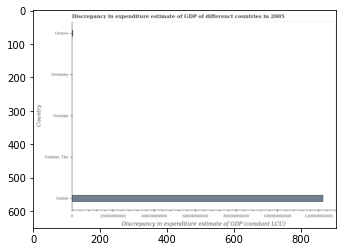

Number of QA =  21





,Country,Discrepancy in expenditure estimate of GDP (constant LCU
0,Greece,6.139664e+08
1,Gabon,1.236562e+11
2,Germany,NaN
3,"Gambia, The",NaN
4,Georgia,NaN


> what is the title of the graph ?
PREDICTED =  Discrepancy in expenditure estimate of GDP of differenct countries in 2005
EXPECTED =  Discrepancy in expenditure estimate of GDP of differenct countries in 2005




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Discrepancy in expenditure estimate of GDP (constant LCU
EXPECTED =  Discrepancy in expenditure estimate of GDP (constant LCU)




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the discrepancy in expenditure estimate of gdp in georgia and greece ?
PREDICTED =  -613966419.5886787
EXPECTED =  -421112480.454




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.


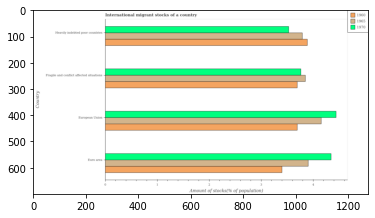

Number of QA =  29





,Country,1965,1970,1960
0,Fragile and conflict affected situations,3.829558,3.779334,3.708924
1,Euro area,NaN,4.370970,3.410489
2,Heavily indebted poor countries,NaN,3.543457,3.904331
3,European Union,4.185634,4.468094,3.720694


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of stocks in in 1960 in european union and that in fragile and conflict affected situations ?
PREDICTED =  2.720694176693351
EXPECTED =  0.00025407737616989223




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of stocks in in 1960 in euro area and the amount of stocks in in 1965 in fragile and conflict affected situations?
PREDICTED =  -0.2984346878902966
EXPECTED =  -0.4493292980622501




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of stocks in in 1970 and amount of stocks in in 1960 in fragile and conflict affect

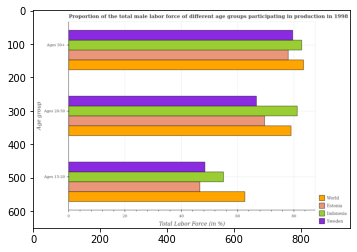

Number of QA =  28





,Age group,Estonia,Sweden,Indonesia,World
0,Ages 50+,78.552882,80.566552,NaN,84.046564
1,Ages 15-20,47.426415,48.947279,55.940587,63.105295
2,Ages 20-50,70.265214,67.084001,82.395957,79.688695


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force within the age group 20-50 and percentage of male labor force above age 50 in sweden ?
PREDICTED =  3.1812134370845087
EXPECTED =  -12.900001525878793




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of male labor force within the age group 20-50 in indonesia to that in estonia ?
PREDICTED =  1.1726422135358003
EXPECTED =  1.1666666483970451




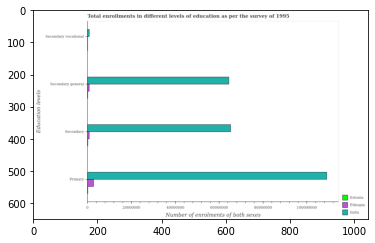

Number of QA =  29





,Education levels,Estonia,India,Ethiopia
0,Secondary vocational,NaN,1.049934e+06,NaN
1,Secondary general,NaN,6.456580e+07,1.003650e+06
2,Secondary,NaN,6.559679e+07,1.017218e+06
3,Primary,NaN,1.094668e+08,2.908202e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary education in india and that in ethiopia ?
PREDICTED =  130195308.54453483
EXPECTED =  64450107




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary education in estonia and the number of enrolments in secondary general education in india ?
PREDICTED =  0.0
EXPECTED =  -64300624




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary education and number of enrolments in primary education in india ?
PREDICTED =  -1.0
EXPECTED =  -43837308




				 

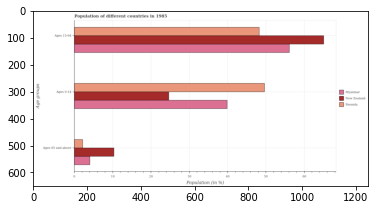

Number of QA =  28





,Age groups,Rwanda,Myanmar,New Zealand
0,Ages 15-64,48.593044,56.141227,64.721281
1,Ages 65 and above,2.296956,4.208382,10.602548
2,Ages 0-14,49.875784,40.174651,24.927243


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population within the age-group 0-14 in rwanda and that in myanmar ?
PREDICTED =  9.701132724730101
EXPECTED =  9.739701330456711




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of population within the age-group of 65 and above in rwanda to that in myanmar ?
PREDICTED =  0.5458049140275899
EXPECTED =  0.5347301712973893




				 2 / 4 = 0.5


is_built_with

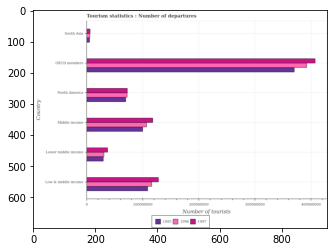

Number of QA =  29





,Country,1996,1997,1995
0,South Asia,6.754311e+06,7.291298e+06,6.069000e+06
1,Low & middle income,NaN,1.281690e+08,1.102417e+08
2,Lower middle income,3.183981e+07,3.827646e+07,3.056696e+07
3,OECD members,3.946178e+08,4.069628e+08,3.689478e+08
4,North America,7.340762e+07,7.347690e+07,7.089048e+07
5,Middle income,1.081129e+08,NaN,1.010362e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tourist departures in 1997 in lower middle income and that in north america ?
PREDICTED =  -35200439.13054221
EXPECTED =  -35214120.976559214




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tourist departures in 1995 in middle income and the number of tourist departures in 1996 in low & middle income?
PREDICTED =  101036224.19308409
EXPECTED =  -16143584.013053328




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tourist departures in 1995 and number of tourist departures in 1997 in low & middle income ?
PR

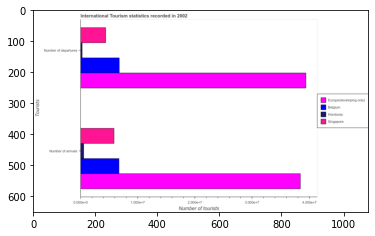

Number of QA =  23





,Tourists,Belgium,Singapore,Europe(developing only),Honduras
0,Number of arrivals,0.675757,0.584837,3.876203,0.067021
1,Number of departures,0.683180,0.453491,3.955641,0.036204


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of tourist departures in europe(developing only) to that in belgium ?
PREDICTED =  1.0
EXPECTED =  5.818498296179285




				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Number of tourists
EXPECTED =  10000000.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  International Tourism statis

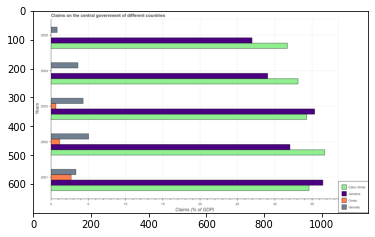

Number of QA =  27





,Years,Jamaica,Cabo Verde,Vanuatu,Oman
0,2004,29.159947,33.164625,3.700087,NaN
1,2005,26.897611,32.087628,0.883331,NaN
2,2003,35.669316,34.431751,4.391241,0.713830
3,2001,36.447259,34.482813,3.378183,2.781675
4,2002,32.024349,36.794223,5.134355,1.219840


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of gdp claimed on the central government in jamaica in 2002 and that in 2003 ?
PREDICTED =  -3.644967576537802
EXPECTED =  -3.3102027224003265




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of gdp claimed on the central government in cabo verde in 2001 and the percentage of gdp claimed on the central government in vanuatu in 2003 ?
PREDICTED =  0.05106171741485355
EXPECTED =  30.30020427857443




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the percentage of gdp claimed on the central government in

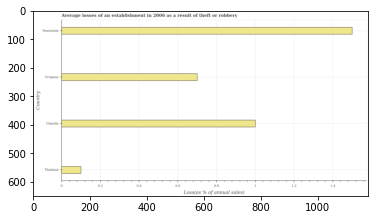

Number of QA =  22





,Country,Loss(as % of annual sales)
0,Uganda,0.998328
1,Thailand,0.102129
2,Uruguay,0.702670
3,Venezuela,1.494614


> what is the title of the graph ?
PREDICTED =  Average losses of an establishment in 2006 as a result of theft or robbery
EXPECTED =  Average losses of an establishment in 2006 as a result of theft or robbery




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Loss(as % of annual sales)
EXPECTED =  Loss(as % of annual sales)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the losses due to theft in uganda and uruguay ?
PREDICTED =  0.29565768695972194
EXPECTED =  0.3




				 4 / 4 = 1.0


> what is the median losses due to theft ?
PREDICTED =  None
EXPECTED =  0.85




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training s

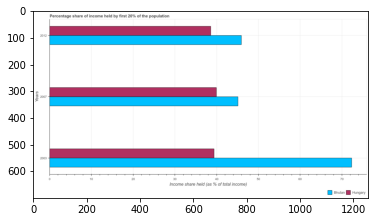

Number of QA =  28





,Years,Bhutan,Hungary
0,2012,46.317085,38.755845
1,2007,45.346911,40.517188
2,2003,72.989014,39.835714


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the share of income held by first 20% of the population in bhutan in 2003 and that in 2012 ?
PREDICTED =  26.67192894112098
EXPECTED =  26.42




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the share of income held by first 20% of the population in bhutan in 2007 and the share of income held by first 20% of the population in hungary in 2003 ?
PREDICTED =  -27.64210250714303
EXPECTED =  5.730000000000004




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the share of income held by first 20% of the population in hungary and share of

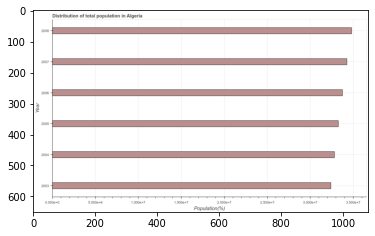

Number of QA =  23





,Year,Population(%)
0,2004,32.788533
1,2008,34.580873
2,2005,32.950760
3,2007,34.360543
4,2006,33.552851
5,2003,32.230127


> what is the title of the graph ?
PREDICTED =  Distribution of total population in Algeria
EXPECTED =  Distribution of total population in Algeria 




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Population(%)
EXPECTED =  Population(%)




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the population in 2004 and 2005 ?
PREDICTED =  -0.1622270723533603
EXPECTED =  -450662.0




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median population ?
PREDICTED =  33.25180520024726
EXPECTED =  33508607.5




				 2 / 5 = 0.4


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predictin

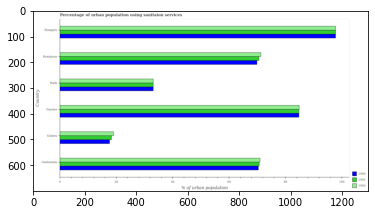

Number of QA =  29





,Country,1992,1990,1991
0,Guinea,19.237861,17.998278,18.536195
1,Haiti,33.497201,33.437663,NaN
2,Guatemala,71.725700,71.040412,71.122798
3,Honduras,71.769498,70.178489,70.907120
4,Guyana,84.832340,85.407296,85.363076
5,Hungary,NaN,96.744583,97.866667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population using sanitaion services in 1992 in guatemala and that in honduras ?
PREDICTED =  -0.043798066632604105
EXPECTED =  -0.29999999999999716




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population using sanitaion services in 1991 in guatemala and the percentage of urban population using sanitaion services in 1992 in guinea?
PREDICTED =  52.58660306560606
EXPECTED =  51.7




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population using sanitaion services in 1991 and 

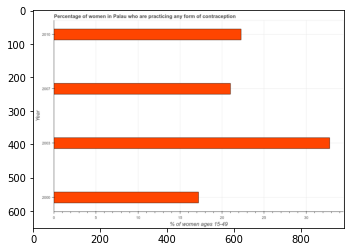

Number of QA =  23





,Year,% of women ages 15-49
0,2000,17.351160
1,2007,21.093448
2,2003,32.761183
3,2010,22.333246


> what is the title of the graph ?
PREDICTED =  Percentage of women in Palau who are practicing any form of contraception
EXPECTED =  Percentage of women in Palau who are practicing any form of contraception




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  % of women ages 15-49
EXPECTED =  % of women ages 15-49




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the contraceptive prevalence in 2003 and 2010 ?
PREDICTED =  10.427937410822395
EXPECTED =  10.54




				 4 / 4 = 1.0


> what is the median contraceptive prevalence ?
PREDICTED =  None
EXPECTED =  21.630000000000003




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training

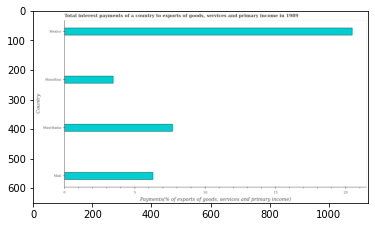

Number of QA =  22





,Country,"Payments(% of exports of goods, services and primary income)"
0,Mali,6.365349
1,Mauritius,3.488928
2,Mexico,20.554409
3,Mauritania,7.768431


> what is the title of the graph ?
PREDICTED =  Total interest payments of a country to exports of goods, services and primary income in 1989
EXPECTED =  Total interest payments of a country to exports of goods, services and primary income in 1989




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Payments(% of exports of goods, services and primary income)
EXPECTED =  Payments(% of exports of goods, services and primary income)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total interest payments on external debt in mali and mexico ?
PREDICTED =  -14.189060287350818
EXPECTED =  -14.164




				 4 / 4 = 1.0


> what is the median total interest payments on external debt ?
PREDICTED =  None
EXPECTED =  6.9

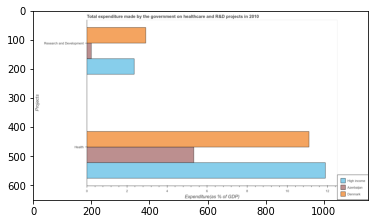

Number of QA =  23





,Projects,Azerbaijan,High income,Denmark
0,Health,5.331186,11.958986,11.022926
1,Research and Development,0.241946,2.368082,2.968145


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in r&d in high income and that in denmark ?
PREDICTED =  0.0
EXPECTED =  -0.5770097473087601




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in healthcare in denmark and the expenditure in r&d in azerbaijan ?
PREDICTED =  5.691739896862296
EXPECTED =  10.863357970000001




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in healthcare and expenditure in r&d in denmark ?
PREDICTED =  8.990841403803643
EXPECTED =  8.14485797




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []


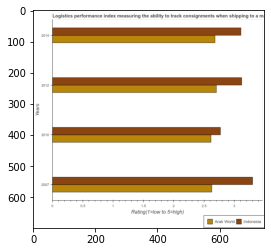

Number of QA =  28





,Years,Indonesia,Arab World
0,2007,3.289585,NaN
1,2014,3.105045,2.667975
2,2010,2.749857,2.605388
3,2012,3.106503,2.680782


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in arab world in 2007 and that in 2014 ?
PREDICTED =  -0.06258624891533993
EXPECTED =  -0.052835078947370384




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in arab world in 2010 and the logistic performance index in indonesia in 2014 ?
PREDICTED =  -0.06258624891533993
EXPECTED =  -0.4937584736842102




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2014, what is the difference between the logistic performance index in indonesia and logistic performance index in arab world ?
PREDICTED =  9.250990203520274

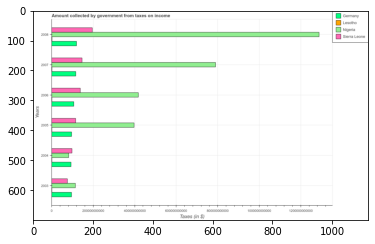

Number of QA =  30





,Years,Sierra Leone,Lesotho,Nigeria,Germany
0,2007,1.461568e+11,NaN,7.939202e+11,1.190694e+11
1,2005,1.171496e+11,NaN,3.996142e+11,9.768446e+10
2,2006,1.405824e+11,NaN,4.198249e+11,1.087104e+11
3,2004,9.916650e+10,NaN,8.495269e+10,9.708418e+10
4,2003,7.838029e+10,NaN,1.176766e+11,9.803958e+10
5,2008,1.984997e+11,NaN,1.286061e+12,1.214299e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected by government from taxes on income in sierra leone in 2005 and that in 2007 ?
PREDICTED =  -29007280746.75551
EXPECTED =  -30659000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected by government from taxes on income in sierra leone in 2005 and the amount collected by government from taxes on income in germany in 2008 ?
PREDICTED =  -4280303950.7042236
EXPECTED =  -3979000000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the amount collected by government from taxes on income in g

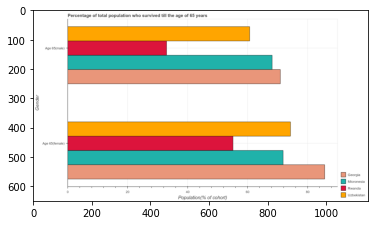

Number of QA =  23





,Gender,Uzbekistan,Micronesia,Rwanda,Georgia
0,Age 65(female),74.520482,71.427872,55.448068,86.914349
1,Age 65(male),61.197387,68.317501,33.054245,70.904492


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male population who survived till age of 65 in rwanda and that in micronesia ?
PREDICTED =  -68.31750085020528
EXPECTED =  -35.20931000000001




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of male population who survived till age of 65 in georgia to that in micronesia ?
PREDICTED =  1.0378671852638746
EXPECTED =  1.0401494210287159




				 1 / 4 = 0.25


> w

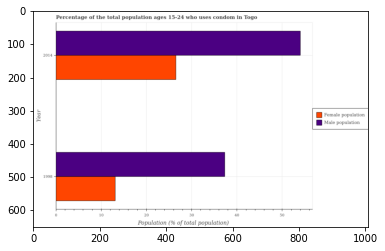

Number of QA =  25





,Year,Female population,Male population
0,1998,13.358429,37.655957
1,2014,27.136379,54.437611


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female population in 1998 and that in 2014 ?
PREDICTED =  -13.77795016029756
EXPECTED =  -13.4




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male population in 1998 and the female population in 2014 ?
PREDICTED =  -16.781653279438423
EXPECTED =  10.799999999999997




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the female population and male population ?
PREDICTED =  0.0
EXPECTED =  -24.2




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished a

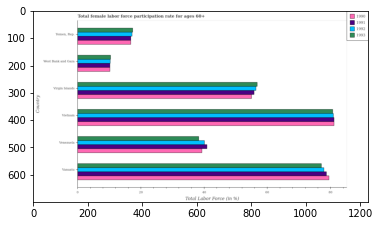

Number of QA =  30





,Country,1992,1993,1991,1990
0,Vietnam,81.156333,81.376036,81.081845,NaN
1,Virgin Islands,56.650592,56.887358,56.159005,NaN
2,West Bank and Gaza,10.555427,10.512247,10.413731,10.398662
3,"Yemen, Rep.",17.449682,17.544089,16.965730,16.962285
4,Venezuela,40.470187,38.688273,40.872050,39.388872
5,Vanuatu,NaN,77.190108,78.670611,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate in 1990 in virgin islands and that in west bank and gaza ?
PREDICTED =  0.0
EXPECTED =  44.8000001907349




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate in 1990 in yemen, rep. and the female labor force participation rate in 1991 in venezuela?
PREDICTED =  -22.426586114026808
EXPECTED =  -24.1000022888184




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate in 1992 and female labor force participation rate in 1990 in virgin isl

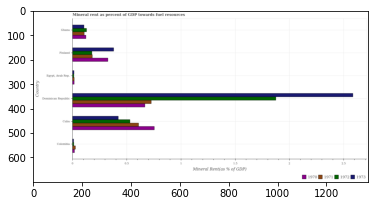

Number of QA =  30





,Country,1972,1971,1970,1973
0,Dominican Republic,1.889726,0.728335,0.675044,2.584979
1,"Egypt, Arab Rep.",0.017667,0.020426,0.020216,0.018129
2,Colombia,NaN,0.032275,0.023467,0.015477
3,Cuba,0.545602,0.618388,0.761803,0.427034
4,Finland,0.186578,0.190435,0.336380,0.392511
5,Ghana,0.132425,0.115078,0.127629,0.111755


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the mineral rent in 1971 in finland and that in ghana ?
PREDICTED =  0.07535685801178599
EXPECTED =  0.07474306288563211




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the mineral rent in 1970 in dominican republic and the mineral rent in 1972 in ghana?
PREDICTED =  0.547414620420047
EXPECTED =  0.538322787778467




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the mineral rent in 1971 in colombia to t

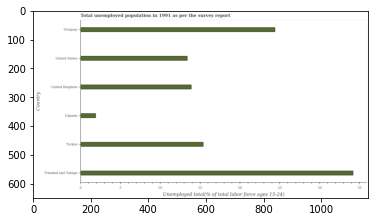

Number of QA =  22





,Country,Unemployed total(% of total labor force ages 15-24)
0,United States,13.381505
1,Uganda,1.920211
2,Trinidad and Tobago,33.754242
3,United Kingdom,13.882591
4,Turkey,15.341169
5,Uruguay,24.208247


> what is the title of the graph ?
PREDICTED =  Total unemployed population in 1991 as per the survey re
EXPECTED =  Total unemployed population in 1991 as per the survey report




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Unemployed total(% of total labor force ages 15-24)
EXPECTED =  Unemployed total(% of total labor force ages 15-24)




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed youth in uganda and uruguay ?
PREDICTED =  -22.288035994449857
EXPECTED =  -22.5




				 3 / 4 = 0.75


> what is the median unemployed youth ?
PREDICTED =  None
EXPECTED =  14.6499996185303




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluatio

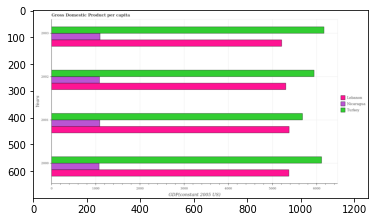

Number of QA =  29





,Years,Lebanon,Turkey,Nicaragua
0,2001,5408.313409,5700.622310,1105.599601
1,2000,5388.567888,6165.585944,1092.645704
2,2003,5254.622856,6184.016542,1126.281786
3,2002,5341.340500,5944.344674,1113.108333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp per capita in turkey in 2000 and that in 2003 ?
PREDICTED =  -18.430597893414415
EXPECTED =  -54.26932153420876




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp per capita in turkey in 2003 and the gdp per capita in lebanon in 2002 ?
PREDICTED =  239.67186844895878
EXPECTED =  864.5005014116905




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the gdp per capita in turkey and gdp per capita in lebanon ?
PREDICTED =  6180.0165420803105
EXPECTED =  739.9554129950711




				 0 / 3 = 0.0


is_built_with_cuda: True
is_g

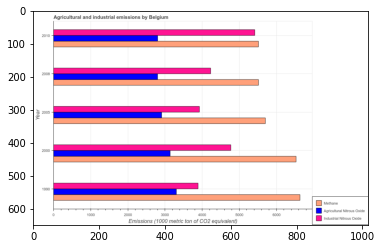

Number of QA =  29





,Year,Methane,Industrial Nitrous Oxide,Agricultural Nitrous Oxide
0,1990,6656.176306,NaN,3293.138299
1,2008,5524.501314,4235.183355,2816.354569
2,2005,5751.078662,NaN,2923.505038
3,2010,NaN,5413.426970,2816.083143
4,2000,6486.090928,4746.525898,3155.345974


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of industrial nitrous oxide emissions in 1990 and that in 2010 ?
PREDICTED =  8981.709252678353
EXPECTED =  -1527.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of industrial nitrous oxide emissions in 1990 and the amount of methane emissions in 2005 ?
PREDICTED =  14395.136222575518
EXPECTED =  -1812.2000000000003




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the amount of methane emissions and amount of agricultural nitrous oxide emissions ?
PREDICTED =  0.0
EXPECTED =  2717.8




				 0 / 3 = 0.0




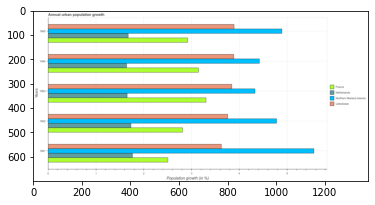

Number of QA =  30





,Years,Uzbekistan,Northem Mariana Islands,France,Netherlands
0,1963,3.850005,4.301894,3.316707,NaN
1,1964,3.894271,4.388934,NaN,1.658116
2,1965,3.870797,4.887599,2.917336,NaN
3,1962,3.806620,4.797171,2.800323,1.721474
4,1961,3.617301,5.551883,2.479259,1.758540


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population growth in netherlands in 1962 and that in 1964 ?
PREDICTED =  0.06335791647772426
EXPECTED =  0.09019714049465999




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population growth in uzbekistan in 1964 and the percentage of urban population growth in northern mariana islands in 1961 ?
PREDICTED =  0.2769694738280739
EXPECTED =  -1.6779811818505501




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1962, what is the difference between the percentage of urban population growth in northern mariana islands and per

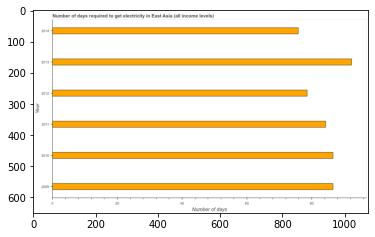

Number of QA =  23





,Year,Number of days
0,2014,75.770392
1,2010,86.556670
2,2013,92.527022
3,2009,86.569959
4,2012,79.018707
5,2011,84.292777


> what is the title of the graph ?
PREDICTED =  Number of days required to get electricity in East Asia (all income levels)
EXPECTED =  Number of days required to get electricity in East Asia (all income levels)




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Number of days
EXPECTED =  Number of days




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the time to get electricity in 2009 and 2011 ?
PREDICTED =  2.277182487279134
EXPECTED =  2.28




				 4 / 4 = 1.0


> what is the median time to get electricity ?
PREDICTED =  None
EXPECTED =  85.42




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the

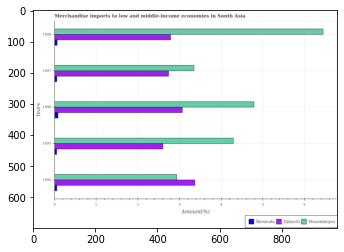

Number of QA =  29





,Years,Bermuda,Mozambique,Djibouti
0,1998,0.075422,6.565922,2.825774
1,1996,0.100003,4.780229,3.102368
2,1994,0.069994,2.960575,3.384391
3,1995,0.062469,4.351894,NaN
4,1997,0.068146,NaN,2.758838


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in mozambique in 1995 and that in 1997 ?
PREDICTED =  -2.2140275145831145
EXPECTED =  0.94362617430681




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in djibouti in 1998 and the percentage of amount earned from merchandise imports in bermuda in 1997 ?
PREDICTED =  0.06693585393689627
EXPECTED =  2.731279892814371




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the percentage of amount earned from merchandise imports

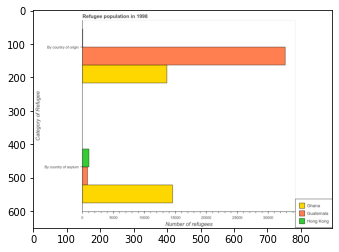

Number of QA =  23





,Category of Refugee,Ghana,Guatemala,Hong Kong
0,By country of origin,160435.967921,390835.243213,NaN
1,By country of asytum,171022.871253,11137.899928,13383.08801


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of refugees by country of origin in ghana and that in guatemala ?
PREDICTED =  -230399.27529228292
EXPECTED =  -19114




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of refugees by country of asylum in hong kong and the number of refugees by country of origin in ghana ?
PREDICTED =  1.0
EXPECTED =  -12594




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of refugees by country of origin and number of refugees by country of asylum in ghana ?
PREDICTED =  -1.0
EXPECTED =  -924




				 0 / 3 = 0.0


is_built_with_cuda

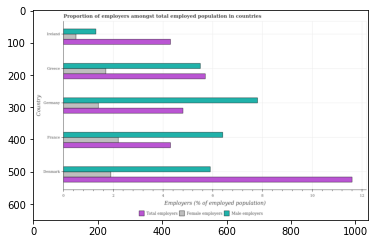

Number of QA =  29





,Country,Total employers,Male employers,Female employers
0,Denmark,11.675972,5.897848,1.957972
1,Greece,5.734877,5.424551,1.715128
2,France,4.290840,6.314532,2.215450
3,Ireland,NaN,1.331367,0.531091
4,Germany,4.738844,7.721544,1.427735


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female employers in france and that in greece ?
PREDICTED =  0.5003221520208518
EXPECTED =  0.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male employers in ireland and the percentage of total employers in france ?
PREDICTED =  -4.983164981173209
EXPECTED =  -3.00000023841858




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total employers and percentage of male employers in france ?
PREDICTED =  0.0
EXPECTED =  -2.1




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: Fals

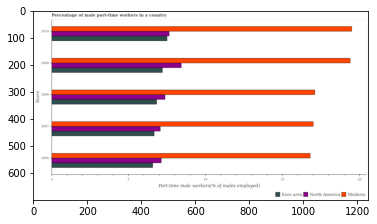

Number of QA =  29





,Years,North Americz,Moldova,Euro area
0,2007,NaN,17.234397,6.708341
1,2009,8.317559,19.633801,7.217079
2,2006,7.183611,16.825986,6.588796
3,2010,7.682562,19.504022,7.526515
4,2008,7.432510,17.218128,6.859514


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male part-time workers in euro area in 2006 and that in 2008 ?
PREDICTED =  -0.2707183090319054
EXPECTED =  -0.25056836554736694




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male part-time workers in moldova in 2009 and the percentage of male part-time workers in north america in 2008 ?
PREDICTED =  12.201291381868572
EXPECTED =  12.033831274016178




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the percentage of male part-time workers in euro area and percentage of male part-time workers i

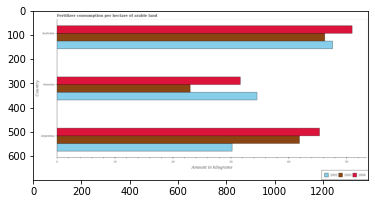

Number of QA =  29





,Country,2002,2003,2004
0,Armenia,34.666569,23.459069,31.926949
1,Australia,47.982593,46.306544,50.996120
2,Argentina,NaN,41.737836,45.499434


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of fertilizer consumption in 2002 in armenia and that in australia ?
PREDICTED =  -13.316024673280253
EXPECTED =  -13.046955922798503




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of fertilizer consumption in 2003 in argentina and the amount of fertilizer consumption in 2004 in australia?
PREDICTED =  -4.568708848420272
EXPECTED =  -9.092698434929495




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of fertilizer consumption in 2003 and amount of fertilizer consumption in 2004 in australia ?
PREDICTED =  60.507328

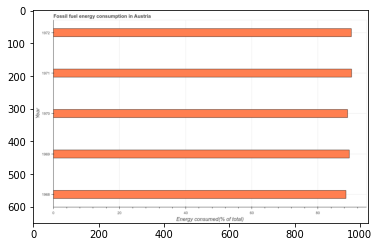

Number of QA =  23





,Year,Energy consumed(% of total)
0,1972,89.446443
1,1969,89.788467
2,1968,88.567655
3,1971,90.259715
4,1970,89.577900


> what is the title of the graph ?
PREDICTED =  Fossil fuel energy consumption in Austria
EXPECTED =  Fossil fuel energy consumption in Austria




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Energy consumed(% of total)
EXPECTED =  Energy consumed(% of total)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the fossil fuel energy consumption in 1970 and 1971 ?
PREDICTED =  -0.6818143601256565
EXPECTED =  -1.208




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median fossil fuel energy consumption ?
PREDICTED =  89.57790045763225
EXPECTED =  89.511758479888




				 4 / 5 = 0.8


is_built_with_cu

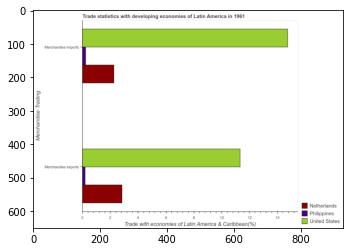

Number of QA =  23





,Merchandise Trading,Philippines,Netherlands,United States
0,Merchandise imports,0.285284,2.316319,14.929728
1,Merchandise exports,0.240966,2.902157,11.385133


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Trade with economies of Latin America & Caribbean(%)
EXPECTED =  2.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Trade statistics with developing economies of Latin America in 1961
EXPECTED =  Trade statistics with developing economies of Latin America in 1961




		

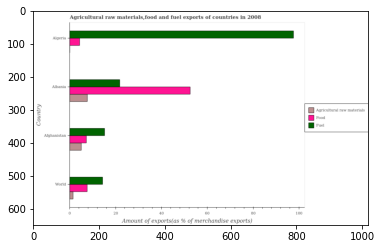

Number of QA =  29





,Country,Agricultural raw materials,Fuel,Food
0,Albania,7.937962,22.203148,53.423488
1,World,1.730984,14.384475,7.820905
2,Algeria,NaN,98.165628,4.592775
3,Afghanistan,5.309570,15.531565,7.677150


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of raw materials exports in afghanistan and that in world ?
PREDICTED =  3.57858602434634
EXPECTED =  3.588




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of raw materials exports in world and the percentage of food exports in albania ?
PREDICTED =  -6.206978212495828
EXPECTED =  -51.07943190328167




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of food exports and percentage of fuel exports in albania ?
PREDICTED =  -17.61037208076052
EXPECTED =  30.71




				 1 / 3 = 0.3333


is_built_with_cuda: Tr

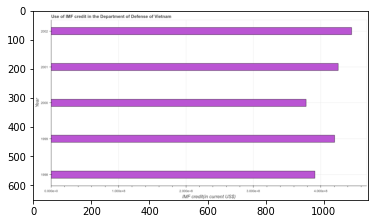

Number of QA =  23





,Year,IMF credit(in current US$)
0,2002,4.456892
1,1999,4.244104
2,2000,3.790860
3,1998,3.916644
4,2001,4.284745


> what is the title of the graph ?
PREDICTED =  Use of IMF credit in the Department of Defense of Vietnam
EXPECTED =  Use of IMF credit in the Department of Defense of Vietnam




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  IMF credit(in current US$)
EXPECTED =  IMF credit(in current US$)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the use of imf credit in dod in 2000 and 2002 ?
PREDICTED =  -0.6660323957775702
EXPECTED =  -67585000.0




				 3 / 4 = 0.75


> what is the median use of imf credit in dod ?
PREDICTED =  None
EXPECTED =  420497000.0




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is 

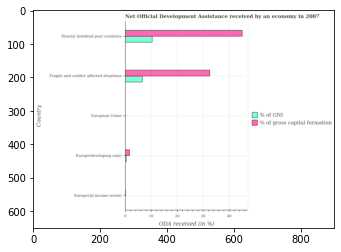

Number of QA =  28





,Country,% of gross capital formation,% of GNI
0,European Union,NaN,NaN
1,Europe(developing only),1.915469,NaN
2,Europe(all income levels),NaN,NaN
3,Heavily indebted poor countries,NaN,10.731474
4,Fragile and conflict affected situations,33.483129,6.937190


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received as percentage of gni in europe(developing only) and that in heavily indebted poor countries ?
PREDICTED =  -8.81600541642238
EXPECTED =  -9.947




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received as percentage of gni in europe(developing only) and the oda received as percentage of gross capital formation in heavily indebted poor countries ?
PREDICTED =  -8.81600541642238
EXPECTED =  -44.562618091070604




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting

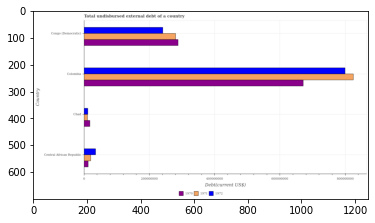

Number of QA =  29





,Country,1972,1971,1970
0,Chad,1.279908e+07,1.156205e+07,1.913079e+07
1,Central African Republic,3.599230e+07,2.165471e+07,1.344427e+07
2,Colombia,8.020448e+08,8.284969e+08,6.812772e+08
3,Congo (Democratic),2.429929e+08,2.827646e+08,2.902998e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total undisbursed external debt in 1971 in central african republic and that in colombia ?
PREDICTED =  21654702.4448816
EXPECTED =  -804541000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total undisbursed external debt in 1970 in congo (democratic) and the total undisbursed external debt in 1971 in chad?
PREDICTED =  278737728.3781364
EXPECTED =  277515000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total undisbursed external debt in 1971 and total undisbursed external debt in 1970 in central african republic ?
PREDICTED 

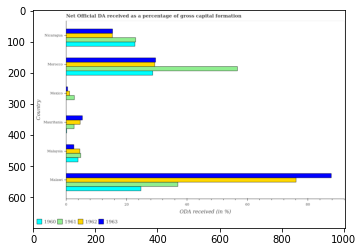

Number of QA =  27





,Country,1963,1962,1961,1960
0,Morocco,29.812975,NaN,NaN,28.724468
1,Malaysia,2.761585,4.844205,5.113641,4.164537
2,Mexico,0.714012,1.371055,2.884198,NaN
3,Malawi,88.324100,NaN,NaN,25.029646
4,Nicaragua,15.579891,15.689721,23.191636,23.043044
5,Mauritania,5.561648,4.896724,2.857896,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net oda received in 1963 in mexico and that in morocco ?
PREDICTED =  -29.098962798806678
EXPECTED =  -29.111390609018876




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net oda received in 1962 in morocco and the net oda received in 1961 in mauritania?
PREDICTED =  -4.89672370174845
EXPECTED =  26.67519329890033




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net oda received in 1962 in ma

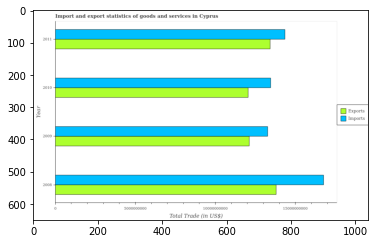

Number of QA =  28





,Year,Imports,Exports
0,2011,2.593478e+10,2.429972e+10
1,2008,3.029623e+10,2.491774e+10
2,2009,2.402410e+10,NaN
3,2010,2.428712e+10,2.187966e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the imports of goods and services in 2008 and that in 2011 ?
PREDICTED =  48311214477.5211
EXPECTED =  2413426379.111




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the imports of goods and services in 2009 and the export of goods and services in 2010 ?
PREDICTED =  80255103479.15302
EXPECTED =  1220608804.2043




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False

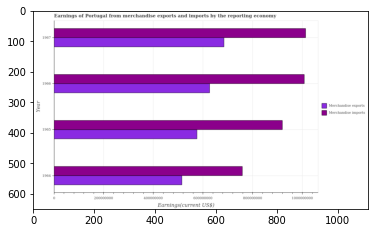

Number of QA =  28





,Year,Merchandise imports,Merchandise exports
0,1967,1.020796e+09,6.980284e+08
1,1966,1.013645e+09,6.323935e+08
2,1965,9.304346e+08,5.808751e+08
3,1964,7.676031e+08,5.216431e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise imports in 1964 and that in 1967 ?
PREDICTED =  -253193233.7456063
EXPECTED =  -254700000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise imports in 1966 and the earnings from merchandise exports in 1965 ?
PREDICTED =  83209984.74908626
EXPECTED =  432200000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the earnings from merchandise exports 

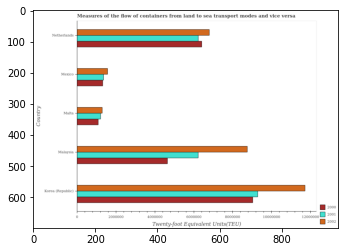

Number of QA =  29





,Country,2002,2000,2001
0,Malta,1.337600e+06,1.132128e+06,1.246317e+06
1,Mexico,1.574297e+06,1.371834e+06,1.396608e+06
2,Malaysia,8.859254e+06,4.617088e+06,NaN
3,Netherlands,6.903865e+06,6.464759e+06,6.275280e+06
4,Korea (Republic),1.172444e+07,9.068240e+06,9.395595e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the container port traffic in 2002 in korea (republic) and that in malta ?
PREDICTED =  10386841.988087367
EXPECTED =  10430720.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the container port traffic in 2001 in malta and the container port traffic in 2002 in mexico?
PREDICTED =  -150291.40588722564
EXPECTED =  -358776.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the container port traffic in 2000 and container port traffic in 2002 in malta ?
PREDICTED =  3193209.663000627
EXPECTED =  -206545.0




				 1 / 3 = 0.3333


is_built_with_cud

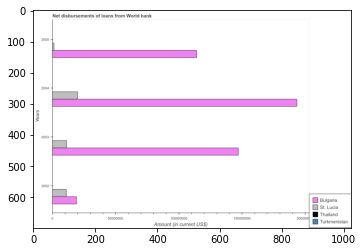

Number of QA =  27





,Years,Bulgaria,Thailand,Turkmenistan,St. Lucia
0,2005,NaN,NaN,NaN,2.882775e+06
1,2004,3.494307e+08,NaN,NaN,3.658111e+07
2,2002,3.507518e+07,NaN,NaN,2.069135e+07
3,2003,2.663029e+08,NaN,NaN,2.098936e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loan disbursed from world bank in bulgaria in 2002 and that in 2005 ?
PREDICTED =  35075181.62495679
EXPECTED =  -95077000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loan disbursed from world bank in thailand in 2004 and the amount of loan disbursed from world bank in bulgaria in 2002 ?
PREDICTED =  314355489.1776144
EXPECTED =  -19015000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the amount of loan disbursed from world bank in st. lucia and amount of loan disbursed from world bank in bu

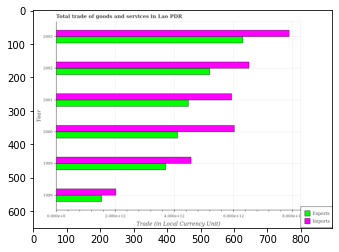

Number of QA =  28





,Year,Imports,Exports
0,2003,7.902085,6.336204
1,2002,6.550681,5.217091
2,2001,5.931282,NaN
3,2000,6.081775,4.116661
4,1998,2.031174,1.560501
5,1999,4.576959,3.748118


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export of goods and services in 1999 and that in 2001 ?
PREDICTED =  2.588085851776781
EXPECTED =  -767425235400.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export of goods and services in 2002 and the imports of goods and services in 2000 ?
PREDICTED =  2.2195429258988124
EXPECTED =  -834373556600.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the imports of goods and services and export of goods and services ?
PREDICTED =  -2.3897594387052896
EXPECTED =  1327863076600.0




				 0 / 3 = 0.0


is_built_with_cud

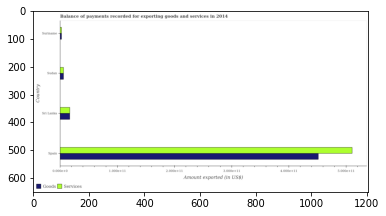

Number of QA =  28





,Country,Goods,Services
0,Sudan,0.069275,0.070291
1,Spain,4.544222,5.085690
2,Suriname,0.034521,0.035372
3,Sri Lanka,0.178807,0.180234


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of services exported in spain and that in sri lanka ?
PREDICTED =  4.9054556398594125
EXPECTED =  493801745945.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of services exported in sudan and the amount of goods exported in spain ?
PREDICTED =  -5.015398737619789
EXPECTED =  -445606206818.38




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of services exported and amount of goods exported in sudan ?
PREDICTED =  -0.034918985452503284
EXPECTED =  38148118.62




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_

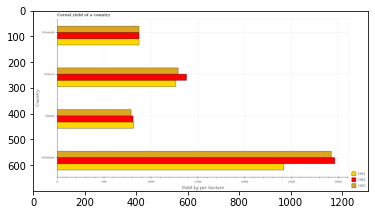

Number of QA =  29





,Country,1963,1962,1961
0,Ghana,1433.407821,1468.000639,1489.002874
1,Greece,2336.432582,2502.466789,2325.056042
2,Grenada,1588.012350,1587.056253,NaN
3,Germany,5317.904848,5360.134821,4379.816171


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal yield in 1961 in ghana and that in grenada ?
PREDICTED =  1489.002874120163
EXPECTED =  -56.580000000000155




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal yield in 1963 in greece and the total cereal yield in 1961 in grenada?
PREDICTED =  748.4202320081035
EXPECTED =  417.99699999999973




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total cereal yield in 1962 and total cereal yield in 1961 in grenada ?
PREDICTED =  10917.658501011445
EXPECTED =  0.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_ava

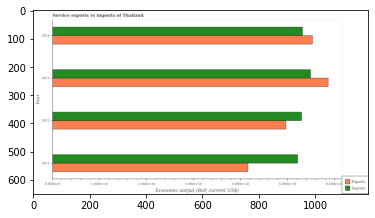

Number of QA =  28





,Year,Imports,Exports
0,2014,5.321395,5.556494
1,2013,5.516065,5.869330
2,2012,5.357171,4.974680
3,2011,5.231009,4.145338


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of service exports in 2011 and that in 2013 ?
PREDICTED =  -1.723992307745572
EXPECTED =  -17069714387




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of service imports in 2011 and the amount of service exports in 2012 ?
PREDICTED =  -0.1261624873018592
EXPECTED =  2492678056




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the amount of service imports and amount of service exports ?
PREDICTED =  19.42563985127586
EXPECTED =  -3752570845




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: Fal

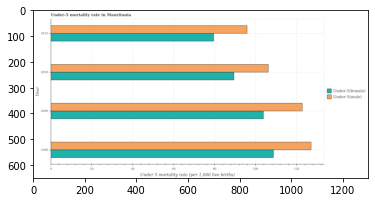

Number of QA =  28





,Year,Under-5(male),Under-5(female)
0,2015,96.567976,80.213673
1,1990,128.167363,109.652233
2,2000,123.868595,104.353136
3,2010,106.889231,90.003528


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-5 male mortality rate in 1990 and that in 2010 ?
PREDICTED =  21.278131302493463
EXPECTED =  20.9




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-5 male mortality rate in 1990 and the under-5 female mortality rate in 2010 ?
PREDICTED =  21.278131302493463
EXPECTED =  37.69999999999999




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the under-5 female mortality rate and under-5 male mortality rate ?
PREDICTED =  0.0
EXPECTED =  -19.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GP

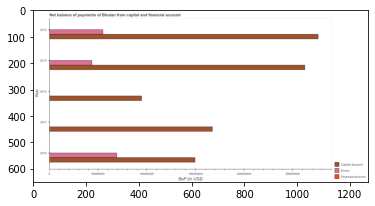

Number of QA =  26





,Year,Financial account,Capital account,Errors
0,2012,NaN,NaN,NaN
1,2014,NaN,4.940543e+08,9.866882e+07
2,2011,NaN,2.996505e+08,NaN
3,2010,NaN,2.723810e+08,1.262306e+08
4,2013,NaN,4.753406e+08,7.823905e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of net capital account in 2011 and that in 2014 ?
PREDICTED =  -194403871.29796302
EXPECTED =  -108779988.8




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of financial account in 2014 and the amount of net capital account in 2010 ?
PREDICTED =  221673361.37713468
EXPECTED =  -149645547.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2014, what is the difference between the amount of net capital account and amount of errors ?
PREDICTED =  1541426384.4435103
EXPECTED =  221381271.47




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_avail

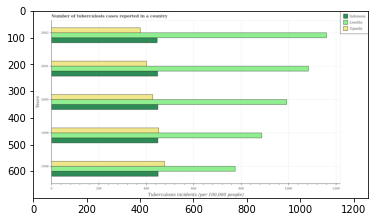

Number of QA =  29





,Years,Lesotho,Indonesia,Uganda
0,1999,895.617556,452.255557,453.524932
1,2001,1086.434166,449.823309,407.011082
2,2002,1171.570594,449.728135,NaN
3,1998,781.442679,456.291596,481.126638
4,2000,1004.173887,450.407882,433.723146


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tuberculosis cases reported in in indonesia in 1999 and that in 2000 ?
PREDICTED =  1.847674808922477
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tuberculosis cases reported in in indonesia in 2000 and the number of tuberculosis cases reported in in lesotho in 2001 ?
PREDICTED =  0.5845733231125791
EXPECTED =  -635




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the number of tuberculosis cases reported in in lesotho and number of tuberculosis cases reported in in uganda ?
PREDICTED 

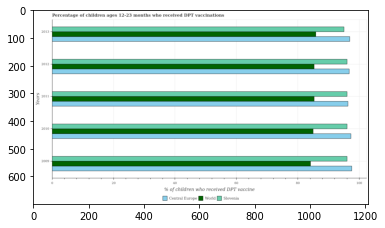

Number of QA =  29





,Years,Slovenia,Central Europe,World
0,2011,97.395263,NaN,85.380988
1,2013,95.254395,96.324936,85.083437
2,2012,96.779959,NaN,85.727404
3,2010,97.418777,96.884776,84.934815
4,2009,96.601181,97.069740,83.693552


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who received dpt vaccination in world in 2010 and that in 2012 ?
PREDICTED =  -0.7925895990320697
EXPECTED =  -0.31789069851569707




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who received dpt vaccination in central europe in 2009 and the percentage of children who received dpt vaccination in world in 2011 ?
PREDICTED =  nan
EXPECTED =  12.237964360701227




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of children who received dpt vaccination in central euro

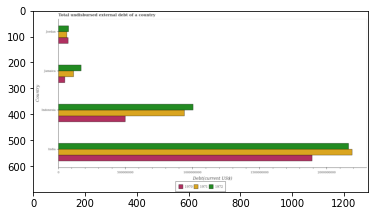

Number of QA =  29





,Country,1972,1971,1970
0,Jordan,1.422976e+08,1.188421e+08,1.357257e+08
1,Jamaica,3.096494e+08,2.074262e+08,9.234879e+07
2,India,3.915423e+09,3.948527e+09,3.419866e+09
3,Indonesia,1.811486e+09,1.702577e+09,9.058494e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total undisbursed external debt in 1970 in india and that in jamaica ?
PREDICTED =  3327517711.1814547
EXPECTED =  1843624350.2




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total undisbursed external debt in 1972 in jordan and the total undisbursed external debt in 1971 in jamaica?
PREDICTED =  -167351793.18765593
EXPECTED =  -37618000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total undisbursed external debt in 1970 and total undisbursed external debt in 1971 in jamaica ?
PREDICTED =  -115077375.73022059
EXPECTED =  -654170

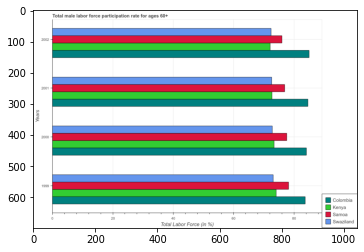

Number of QA =  30





,Years,Swaziland,Kenya,Samoa,Colombia
0,2002,72.011341,72.182345,76.125417,85.193639
1,2000,72.810552,73.472330,76.476166,84.002269
2,2001,72.541599,72.929185,77.139448,84.863014
3,1999,73.102459,73.396462,78.636037,83.222475


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in kenya in 2000 and that in 2002 ?
PREDICTED =  1.2899847268626132
EXPECTED =  1.300003051757912




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in kenya in 2001 and the male labor force participation rate in colombia in 2002 ?
PREDICTED =  0.74683971457479
EXPECTED =  -12.300003051757798




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the male labor force participation rate in swaziland and male labor force participation rate in colombia ?
PREDICTE

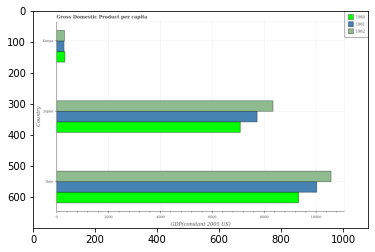

Number of QA =  29





,Country,1962,1961,1960
0,Italy,10647.553783,9968.473649,9407.762153
1,Kenya,324.966987,309.291194,343.246429
2,Japan,8380.282010,7750.173679,7137.240844


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp per capita in 1960 in italy and that in japan ?
PREDICTED =  2270.521309427084
EXPECTED =  2247.2312714458812




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp per capita in 1960 in italy and the gdp per capita in 1962 in japan?
PREDICTED =  2270.521309427084
EXPECTED =  988.2637509957603




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp per capita in 1962 and gdp per capita in 1961 in kenya ?
PREDICTED =  10338.262588767868
EXPECTED =  17.461549787289982




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: Fal

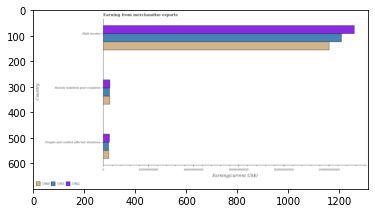

Number of QA =  29





,Country,1962,1961,1960
0,Heavily indebted poor countries,3.197005e+09,3.095938e+09,3.251634e+09
1,Fragile and conflict affected situations,3.000401e+09,2.668475e+09,2.718339e+09
2,High income,1.118925e+11,1.059116e+11,1.010040e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise exports in 1961 in heavily indebted poor countries and that in high income ?
PREDICTED =  -105911634632.90494
EXPECTED =  -102692164827.38092




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise exports in 1962 in high income and the amount earned from merchandise exports in 1960 in fragile and conflict affected situations?
PREDICTED =  108892070410.88042
EXPECTED =  108713614823.72034




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise exports in 1962

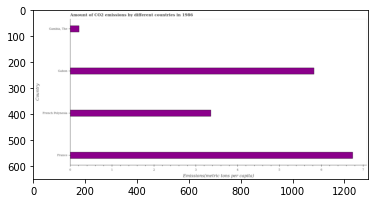

Number of QA =  22





,Country,Emissions(metric tons per capita)
0,Gabon,5.870842
1,"Gambia, The",0.226932
2,French Polynesia,3.384141
3,France,6.783187


> what is the title of the graph ?
PREDICTED =  Amount of CO2 emissions by different countries in 1986
EXPECTED =  Amount of CO2 emissions by different countries in 1986




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Emissions(metric tons per capita)
EXPECTED =  Emissions(metric tons per capita)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emissions in gabon and gambia, the ?
PREDICTED =  5.6439096929394434
EXPECTED =  5.614




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 4 / 5 = 0.8


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Eval

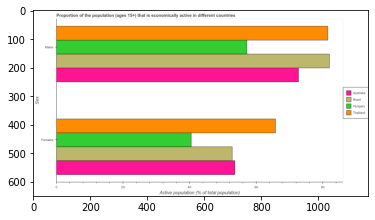

Number of QA =  23





,Sex,Australia,Brazil,Thailand,Hungary
0,Males,72.978460,82.669249,82.670332,57.765438
1,Females,53.940772,53.022783,66.615862,40.873891


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active female population in thailand and that in brazil ?
PREDICTED =  13.593079468396624
EXPECTED =  13.000003814697301




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active female population in hungary and the percentage of economically active male population in brazil ?
PREDICTED =  -12.148891910095564
EXPECTED =  -41.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 

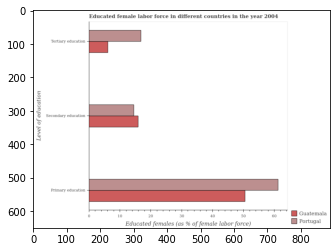

Number of QA =  28





,Level of education,Portugal,Guatemala
0,Primary education,61.974818,50.973258
1,Tertiary education,17.007658,6.281548
2,Secondary education,14.754195,16.291964


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received primary education in portugal and that in guatemala ?
PREDICTED =  11.001560254431261
EXPECTED =  10.700000762939503




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received tertiary education in guatemala and the percentage of female labor force who received primary education in portugal ?
PREDICTED =  -55.693270279980844
EXPECTED =  -55.100000858306935




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received second

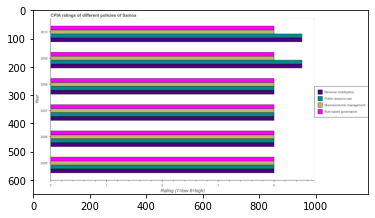

Number of QA =  30





,Year,Public resource use,Rule based governance,Revenue mobilization,Macroeconomic management
0,2010,4.458603,3.991025,NaN,4.013611
1,2008,3.984571,NaN,4.001233,NaN
2,2006,3.982432,NaN,3.994043,NaN
3,2007,3.997248,NaN,3.992440,3.979889
4,2005,3.986913,4.048582,4.020147,4.007500
5,2009,4.466818,NaN,4.526924,3.995543


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of public resource use in 2005 and that in 2006 ?
PREDICTED =  0.004481230943423231
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of macroeconomic management in 2009 and the cpia rating of public resource use in 2006 ?
PREDICTED =  nan
EXPECTED =  0.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the cpia rating of revenue mobilization and cpia rating of rule based governance ?
PREDICTED =  2.526924353503528
EXPECTED =  0.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu

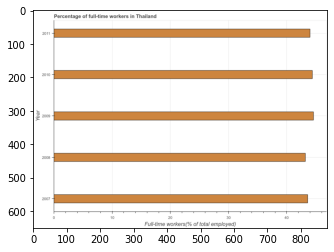

Number of QA =  23





,Year,Full-time workers(% of total employed)
0,2008,43.032254
1,2011,43.904291
2,2010,44.444679
3,2007,43.639052
4,2009,44.636810


> what is the title of the graph ?
PREDICTED =  Percentage of full-time workers in Thailand
EXPECTED =  Percentage of full-time workers in Thailand




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Full-time workers(% of total employed)
EXPECTED =  Full-time workers(% of total employed)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time workers in 2008 and 2009 ?
PREDICTED =  -1.6045567243669012
EXPECTED =  -1.4




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of full-time workers ?
PREDICTED =  44.636810285923005
EXPECTED =  44.0




				 4 / 5 = 0.8




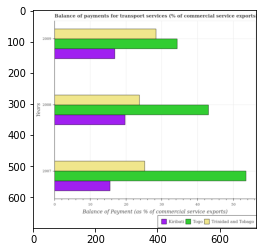

Number of QA =  29





,Years,Unnamed: 1,Trinidad and Tobago,Kiribati
0,2009,34.838658,28.750962,17.222709
1,2007,54.245110,25.750138,15.793060
2,2008,43.585138,24.107880,20.170690


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services in kiribati in 2008 and that in 2009 ?
PREDICTED =  2.9479810894651415
EXPECTED =  2.8694278882672




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services in togo in 2008 and the balance of payments for transport services in trinidad and tobago in 2007 ?
PREDICTED =  -89.08376747281811
EXPECTED =  17.833423430098




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the balance of payments for transport services in trinidad and tobago and balance of 

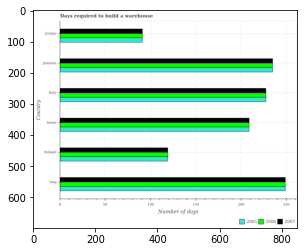

Number of QA =  29





,Country,2007,2005,2006
0,Ireland,215.929777,NaN,216.683412
1,Israel,379.693657,378.471578,379.774571
2,Jordan,165.490486,165.955550,165.378895
3,Italy,413.826893,414.763000,NaN
4,Iraq,446.587356,451.187627,NaN
5,Jamaica,423.562007,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the days required to build a warehouse in in 2006 in iraq and that in ireland ?
PREDICTED =  -216.6834118839129
EXPECTED =  130.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the days required to build a warehouse in in 2005 and days required to build a warehouse in in 2006 in ireland ?
PREDICTED =  -212.6834118839129
EXPECTED =  0.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the days required to 

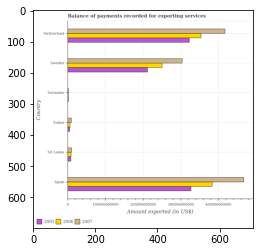

Number of QA =  29





,Country,2007,2005,2006
0,Suriname,NaN,NaN,NaN
1,Sudan,1.170108e+10,7.127178e+09,8.614248e+09
2,Sri Lanka,1.217051e+10,1.027813e+10,1.150730e+10
3,Spain,4.687333e+11,NaN,3.866233e+11
4,Sweden,3.059087e+11,2.161597e+11,NaN
5,Switzerland,4.201247e+11,3.308041e+11,3.639167e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount exported in 2006 in spain and that in sweden ?
PREDICTED =  80714612649.01013
EXPECTED =  133148392630.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount exported in 2006 in sudan and the amount exported in 2007 in sweden?
PREDICTED =  -297294455272.7635
EXPECTED =  -297829070087.7




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount exported in 2007 and amount exported in 2006 in sudan ?
PREDICTED =  305908703137.66864
EXPECTED =  3537653190.3




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
G

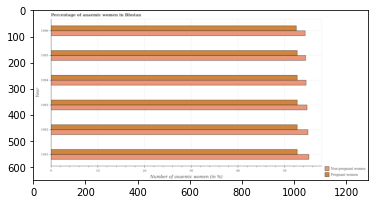

Number of QA =  28





,Year,Pregnant women,Non-pregnant women
0,1996,52.874316,54.802995
1,1991,53.097942,55.462882
2,1993,52.848518,55.122497
3,1994,53.008194,55.307063
4,1995,53.115452,55.134171
5,1992,53.123462,55.979222


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of pregnant anaemic women in 1992 and that in 1994 ?
PREDICTED =  0.11526875811747317
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of non-pregnant anaemic women in 1996 and the percentage of pregnant anaemic women in 1991 ?
PREDICTED =  -0.6598876416308741
EXPECTED =  1.6999999999999957




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1991, what is the difference between the percentage of non-pregnant anaemic women and percentage of pregnant anaemic women ?
PREDICTED =  0.0
EXPECTED =  2.5




				 0 / 3 = 0.0


is_bu

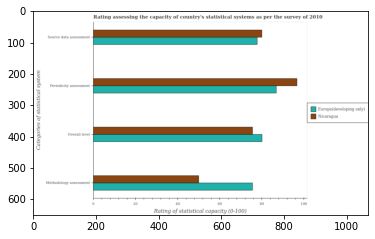

Number of QA =  29





,Categones of statistical system,Europe(developing only),Nicaragua
0,Overall level,80.497311,76.532302
1,Source data assessment,77.825004,80.145298
2,Periodicity assessment,87.207029,96.920662
3,Methodology assessment,76.106682,50.479681


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the overall level rating in europe(developing only) and that in nicaragua ?
PREDICTED =  0.0
EXPECTED =  4.506049629629615




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the methodology assessment rating in nicaragua and the source data assessment rating in europe(developing only) ?
PREDICTED =  48.479680533425025
EXPECTED =  -27.7777777777778




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the source data assessment rating and methodology assessment rating in europe(developing only) ?
PREDICTED =  76.8250044118523
EXPECTED =  2.2222222222222143

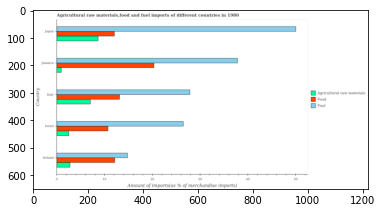

Number of QA =  29





,Country,Agricultural raw materials,Fuel,Food
0,Italy,7.316064,28.074938,13.377862
1,Japan,8.841564,50.306778,12.381409
2,Ireland,2.963412,14.963629,12.326762
3,Jamaica,1.118074,38.221044,20.542426
4,Israel,2.674802,26.608896,11.040730


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of fuel imports in ireland and that in japan ?
PREDICTED =  -35.34314949476398
EXPECTED =  -35.24




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of food imports in japan and the percentage of raw materials imports in israel ?
PREDICTED =  1.3406786101993688
EXPECTED =  9.53842837797944




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of fuel imports and percentage of food imports in jamaica ?
PREDICTED =  0.0
EXPECTED =  17.51




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
G

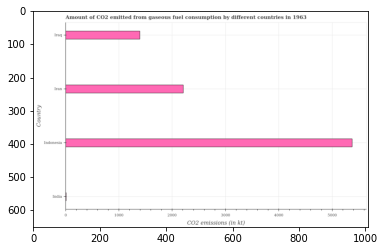

Number of QA =  22





,Country,CO2 emissions (in kt)
0,India,21.915241
1,Indonesia,5378.027797
2,Iran,2224.993827
3,Iraq,1397.365451


> what is the title of the graph ?
PREDICTED =  Amount of CO2 emitted from gaseous fuel consumption by different countries in 1963
EXPECTED =  Amount of CO2 emitted from gaseous fuel consumption by different countries in 1963




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  CO2 emissions (in kt)
EXPECTED =  CO2 emissions (in kt)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 emissions from gaseous fuel consumption in indonesia and iraq ?
PREDICTED =  3980.6623463453525
EXPECTED =  3982.362




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median co2 emissions from gaseous fuel consu

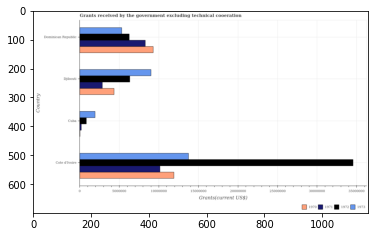

Number of QA =  30





,Country,1972,1971,1970,1973
0,Cuba,1.643654e+06,4.513241e+05,NaN,3.591759e+06
1,Cote d'Ivoire,6.234433e+07,1.847246e+07,2.158789e+07,2.469557e+07
2,Djibouti,1.159666e+07,5.305443e+06,7.857739e+06,1.626439e+07
3,Dominican Republic,1.143411e+07,1.505715e+07,1.685967e+07,9.741374e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total grants received by the government in 1972 in djibouti and that in dominican republic ?
PREDICTED =  162549.90492305718
EXPECTED =  70000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total grants received by the government in 1973 in cuba and the total grants received by the government in 1972 in djibouti?
PREDICTED =  -12672632.081556747
EXPECTED =  -4390000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total grants received by the government in 1970 and total grants received by the government in 1972 in cote d'ivoire ?

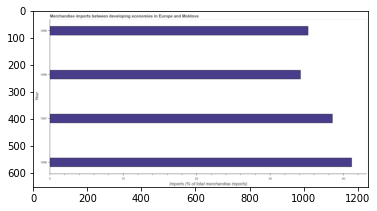

Number of QA =  23





,Year,Imports (% of total merchandise imports)
0,1998,34.238221
1,1999,35.174073
2,1996,41.432131
3,1997,38.598151


> what is the title of the graph ?
PREDICTED =  fierchandise imports between developing economies in Europe and Moldova
EXPECTED =  Merchandise imports between developing economies in Europe and Moldova




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Imports (% of total merchandise imports)
EXPECTED =  Imports (% of total merchandise imports)




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in 1996 and 1997 ?
PREDICTED =  2.8339800094825662
EXPECTED =  2.623




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median merchandise imports ?
PREDICTED =  36.886112241000745
EXP

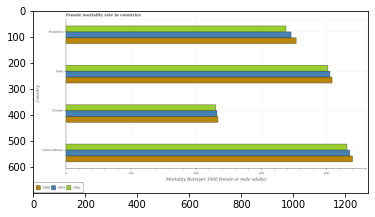

Number of QA =  29





,Country,1962,1961,1960
0,Guyana,231.267046,233.812333,235.223926
1,Honduras,338.964669,347.086289,356.840208
2,Haiti,402.256071,406.872806,409.701932
3,Guinea-Bissau,431.925103,433.347636,439.405641


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female mortality rate in 1961 in guinea-bissau and that in honduras ?
PREDICTED =  86.26134713927178
EXPECTED =  89.85399999999998




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female mortality rate in 1962 in guinea-bissau and the female mortality rate in 1961 in haiti?
PREDICTED =  29.669032864986605
EXPECTED =  25.93199999999996




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female mortality rate in 1960 and female mortality rate in 1961 in guinea-bissau ?
PREDICTED =  -23.64570388083223
EXPECTED =  4.3209999999999695




				 1

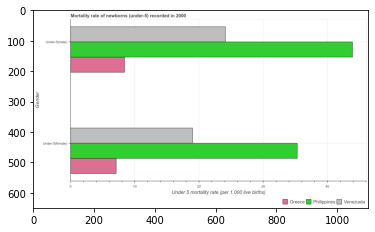

Number of QA =  23





,Gender,Philippines,Greece,Venezuela
0,Under-5(female),34.944781,7.177757,19.294241
1,Under-5(male),44.066703,8.480108,24.454459


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-5 female mortality rate in greece and that in venezuela ?
PREDICTED =  -12.116484333890993
EXPECTED =  -11.9




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-5 female mortality rate in philippines and the under-5 male mortality rate in greece ?
PREDICTED =  27.767024023698994
EXPECTED =  26.9




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-5 female mortality rate and under-5 male mortality rate in philippines ?
PREDICTED =  0.0
EXPECTED =  -8.600000000000001




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_av

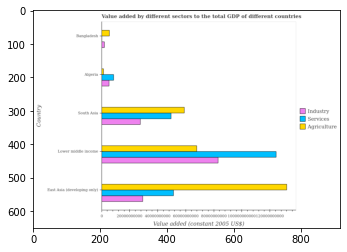

Number of QA =  29





,Country,Industry,Agriculture,Services
0,Lower middle income,8.509222e+10,6.914872e+10,1.267476e+11
1,South Asia,2.838108e+10,6.076902e+10,5.042973e+10
2,Bangladesh,2.235984e+09,5.880850e+09,NaN
3,East Asia (developing only),3.046302e+10,1.353052e+11,5.274716e+10
4,Algeria,5.703669e+09,1.553371e+09,8.780786e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by industrial sector in lower middle income and that in south asia ?
PREDICTED =  56711134147.719086
EXPECTED =  55480215005.451




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by industrial sector in bangladesh and the value added by agricultural sector in lower middle income ?
PREDICTED =  -82856234517.70232
EXPECTED =  -65856400145.82873




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector and value added by industrial sector in bangladesh ?
PREDICTED =  266776300540.8518
EXPECT

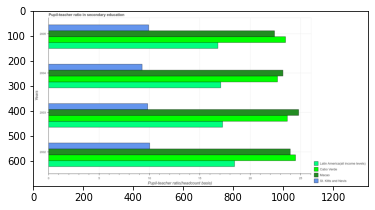

Number of QA =  30





,Years,St. Kitts and Nevis,Cabo Verde,Macao,Latin America(all income levels)
0,2005,9.948923,23.360614,22.340307,16.820694
1,2003,9.883633,23.646012,24.532023,17.154470
2,2004,9.258412,22.629940,23.076059,17.026411
3,2002,10.052543,24.473665,23.963161,18.465579


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the pupil-teacher ratio in secondary education in latin america(all income levels) in 2003 ?
PREDICTED =  4.288617563239697
EXPECTED =  17.2576007843018




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum pupil-teacher ratio in secondary education in macao ?
PREDICTED =  500.75
EXPECTED =  24.8045806884766




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum pupil-teacher ratio in secondary education in latin america(all income levels) ?
PREDICTED =  4.2051735227765725
EXPECTED =  16.7903594970703




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: F

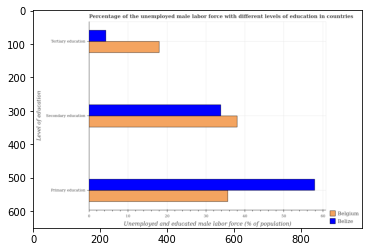

Number of QA =  28





,Level of education,Belgium,Belize
0,Primary education,35.866620,59.068941
1,Tertiary education,18.380816,4.469422
2,Secondary education,38.043813,34.181176


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force who received primary education in belize and that in belgium ?
PREDICTED =  23.202320717500776
EXPECTED =  22.3000030517578




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force who received primary education in belize and the percentage of male labor force who received tertiary education in belgium ?
PREDICTED =  40.68812432682845
EXPECTED =  39.9000015258789




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force who received secondary education and perce

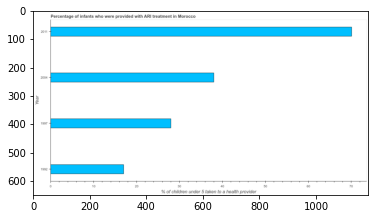

Number of QA =  23





,Year,% of children under 5 taken to a health provider
0,2011,70.171076
1,1997,28.286484
2,2004,38.235438
3,1992,17.236976


> what is the title of the graph ?
PREDICTED =  Percentage of infants who were provided with ARI treatment in Morocco
EXPECTED =  Percentage of infants who were provided with ARI treatment in Morocco




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  % of children under 5 taken to a health provider
EXPECTED =  % of children under 5 taken to a health provider




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who were provided with ari treatment in 1992 and 2011 ?
PREDICTED =  -52.93409987784216
EXPECTED =  -53.1




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percent

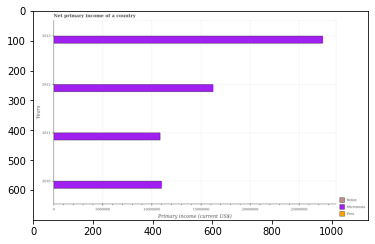

Number of QA =  22





,Years,Micronesia,Belize,Peru
0,2010,1.982115e+07,NaN,NaN
1,2013,4.943680e+07,NaN,NaN
2,2011,1.965537e+07,NaN,NaN
3,2012,2.935800e+07,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the primary income in micronesia in 2010 and that in 2011 ?
PREDICTED =  165780.8984648846
EXPECTED =  145923.73999999836




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the primary income in peru in 2011 and the primary income in micronesia in 2013 ?
PREDICTED =  nan
EXPECTED =  -27387159.31




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the primary income in micronesia in 2011 to that in 2012 ?
PREDICTED =  0.6695064328005988
EXPECTED =  0.6677887963128267




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or pr

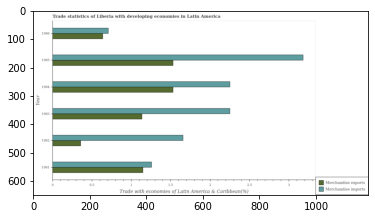

Number of QA =  28





,Year,Merchandise imports,Merchandise exports
0,1986,0.717094,0.646678
1,1982,1.657930,0.364802
2,1981,1.270523,1.159294
3,1985,3.160527,1.534943
4,1984,2.258151,1.545775
5,1983,2.268850,1.152121


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in 1982 and that in 1986 ?
PREDICTED =  0.9408354799397152
EXPECTED =  0.948




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in 1986 and the merchandise exports in 1982 ?
PREDICTED =  -0.9408354799397152
EXPECTED =  0.3508233588473259




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1984, what is the difference between the merchandise exports and merchandise imports ?
PREDICTED =  5.686519372424754
EXPECTED =  -0.722




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predict

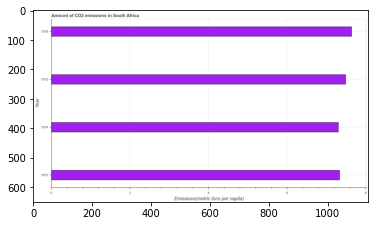

Number of QA =  23





,Year,Emissions(metric tons per capita)
0,1973,7.359894
1,1974,7.295589
2,1976,7.651615
3,1975,7.460366


> what is the title of the graph ?
PREDICTED =  Amount of CO2 emissions in South Africa
EXPECTED =  Amount of CO2 emissions in South Africa




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Emissions(metric tons per capita)
EXPECTED =  Emissions(metric tons per capita)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emissions in 1973 and 1974 ?
PREDICTED =  0.06430538311144574
EXPECTED =  0.03




				 3 / 4 = 0.75


> what is the median amount of co2 emissions ?
PREDICTED =  None
EXPECTED =  7.412646744385871




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount o

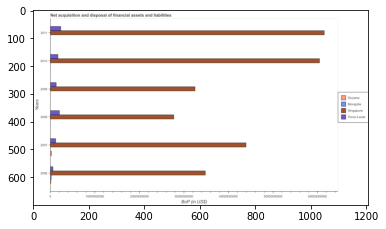

Number of QA =  27





,Years,Timor-Leste,Singapore,Mongolia,Guyana
0,2010,1.783888e+09,6.021382e+10,NaN,NaN
1,2009,1.433018e+09,3.290912e+10,NaN,NaN
2,2006,6.798065e+08,3.504576e+10,NaN,NaN
3,2011,2.427378e+09,6.065170e+10,NaN,NaN
4,2008,2.123150e+09,2.790063e+10,NaN,NaN
5,2007,1.310703e+09,4.395365e+10,NaN,3.515112e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments in timor-leste in 2006 and that in 2010 ?
PREDICTED =  -1104081912.403934
EXPECTED =  -1123550070.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments in mongolia in 2009 and the balance of payments in timor-leste in 2008 ?
PREDICTED =  -2123149970.1032636
EXPECTED =  -2031710108.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the balance of payments in timor-leste and balance of payments in guyana ?
PREDICTED =  2075867274.4814477
EXPECTED =  938207296.5




				 2 / 3 = 0.6667


i

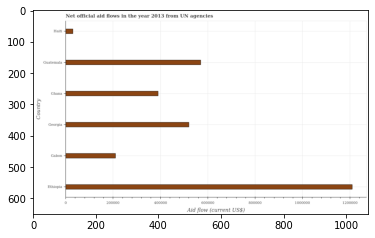

Number of QA =  22





,Country,Aid flow (current US$)
0,Gabon,2.143601e+05
1,Haiti,3.333810e+04
2,Ethiopia,1.215041e+06
3,Ghana,3.950784e+05
4,Georgia,5.238086e+05
5,Guatemala,5.743597e+05


> what is the title of the graph ?
PREDICTED =  Net official aid flows in the year 2013 from UN agencies
EXPECTED =  Net official aid flows in the year 2013 from UN agencies




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Aid flow (current US$)
EXPECTED =  Aid flow (current US$)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official flows from un agencies in ghana and guatemala ?
PREDICTED =  -179281.32768404088
EXPECTED =  -180000.0




				 4 / 4 = 1.0


> what is the median net official flows from un agencies ?
PREDICTED =  None
EXPECTED =  455000.0




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training st

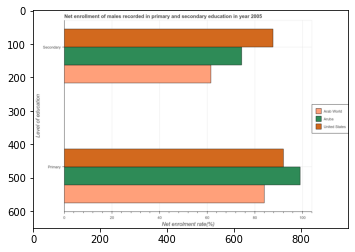

Number of QA =  23





,Level of education,Arab Wortd,Aruba,United States
0,Secondary,61.726612,75.210056,88.808258
1,NaN,85.057536,99.709084,93.004303


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in primary education in united states and that in arab world ?
PREDICTED =  0.0
EXPECTED =  8.026870727538991




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in secondary education in united states and the enrollment rate in primary education in aruba ?
PREDICTED =  0.0
EXPECTED =  -11.41366577148429




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in secondary education and enrollment rate in primary education in aruba ?
PREDICTED =  -13.483444549373985
EXPECTED =  -24.57162475585929





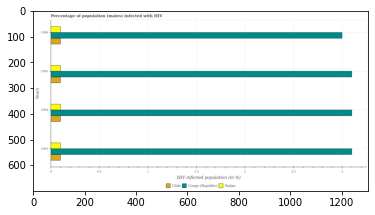

Number of QA =  29





,Years,Congo (Republic),Chile,Sudan
0,1994,3.105126,0.104270,0.105939
1,1996,3.016730,0.103482,0.105467
2,1993,3.118537,0.105175,0.104879
3,1995,3.122016,0.104413,0.104516


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected male population in congo (republic) in 1993 and that in 1994 ?
PREDICTED =  0.013410409067291074
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected male population in congo (republic) in 1993 and the percentage of hiv infected male population in chile in 1995 ?
PREDICTED =  -0.0034796638583207695
EXPECTED =  3.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the percentage of hiv infected male population in chile and percentage of hiv infected male popul

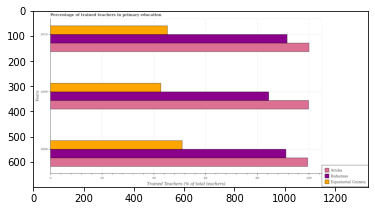

Number of QA =  29





,Years,Aruba,Equatorial Guinea,Bahamas
0,2009,100.213590,43.488537,84.941824
1,2010,100.061814,45.786510,92.534364
2,2008,100.156271,51.443418,91.680226


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of trained teachers in bahamas in 2008 and that in 2010 ?
PREDICTED =  -0.8541384175128002
EXPECTED =  -0.464271545410071




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of trained teachers in bahamas in 2010 and the percentage of trained teachers in aruba in 2009 ?
PREDICTED =  7.592540078754183
EXPECTED =  -8.279464721679716




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the percentage of trained teachers in equatorial guinea and percentage of trained teachers in bahamas ?
PREDICTED =  43.4885368

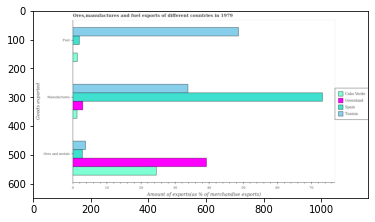

Number of QA =  28





,Goods exported,Unnamed: 1,Tunisia,Cabo Verde,Greenland
0,Fuel,2.046264,48.925404,1.469714,NaN
1,Ores and metals,2.911293,3.890528,25.001624,39.445031
2,Manufactures,74.373873,34.396225,1.391479,3.035974


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of fuel exports in spain and that in cabo verde ?
PREDICTED =  nan
EXPECTED =  0.58546568039667




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of manufactures exports in cabo verde and the percentage of ores and metals exports in greenland ?
PREDICTED =  -38.05355168944917
EXPECTED =  -37.97623438109776




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of fuel exports and percentage of manufactures exports in tunisia ?
PREDICTED =  nan
EXPECTED =  14.825173220953694




				 1 / 3 = 0.3333


is_built_wi

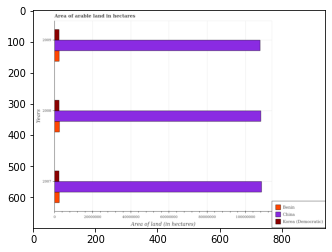

Number of QA =  29





,Years,Korea (Democratic),China,Benin
0,2009,2.650273e+06,1.084763e+08,2.699612e+06
1,2007,2.600878e+06,1.095118e+08,2.777807e+06
2,2008,2.667870e+06,1.089173e+08,2.834568e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total arable land in korea (democratic) in 2007 and that in 2009 ?
PREDICTED =  -49394.741529645864
EXPECTED =  -50000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total arable land in korea (democratic) in 2009 and the total arable land in benin in 2007 ?
PREDICTED =  49394.741529645864
EXPECTED =  -100000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the total arable land in benin and total arable land in china ?
PREDICTED =  -318593455.99372005
EXPECTED =  -105516000




				 1 / 3 = 0.3333


is_built_with_cuda: 

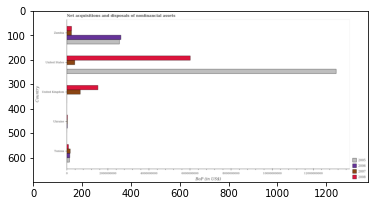

Number of QA =  27





,Country,2007,2005,2008,2006
0,Ukraine,NaN,NaN,NaN,NaN
1,Tunisia,1.880083e+08,1.638633e+08,1.065697e+08,1.830797e+08
2,Zambia,2.557807e+08,2.594858e+09,2.654028e+08,2.666514e+09
3,United States,4.069539e+08,1.313863e+10,5.999285e+09,NaN
4,United Kingdom,6.836644e+08,NaN,1.548346e+09,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments in 2008 in united states and that in zambia ?
PREDICTED =  -265402833.7036028
EXPECTED =  5781000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments in 2008 in ukraine and the balance of payments in 2007 in united kingdom?
PREDICTED =  -1548346178.3830042
EXPECTED =  -625839564.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the balance of payments in 20

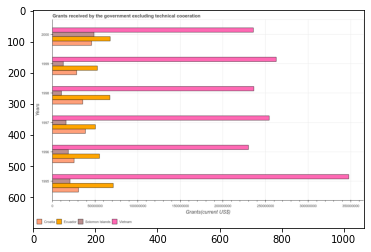

Number of QA =  30





,Years,Solomon Islands,Croatia,Ecuador,Vietnam
0,1995,3.794196e+07,5.723071e+07,1.313515e+08,6.256237e+08
1,2000,9.052538e+07,8.296969e+07,1.234573e+08,4.286771e+08
2,1996,3.398738e+07,4.677402e+07,9.999395e+07,4.142774e+08
3,1998,2.006913e+07,6.497071e+07,1.223150e+08,4.319133e+08
4,1997,2.968900e+07,7.057134e+07,9.302813e+07,4.604697e+08
5,1999,2.450125e+07,5.267600e+07,9.709112e+07,4.719886e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total grants received by the government in solomon islands in 1995 and that in 1996 ?
PREDICTED =  3954580.287823923
EXPECTED =  2020000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total grants received by the government in ecuador in 1995 and the total grants received by the government in croatia in 1999 ?
PREDICTED =  34260354.804111555
EXPECTED =  42980000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the total grants received by the government in ecuador and total grants received by the government in solomon 

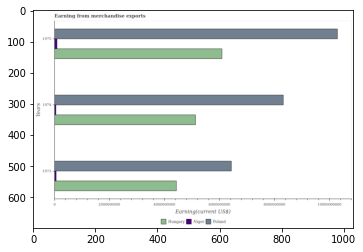

Number of QA =  29





,Years,Hungary,Poland,Niger
0,1975,6.099809e+09,1.040355e+10,1.105534e+08
1,1973,4.511633e+09,6.486412e+09,7.652730e+07
2,1974,5.209709e+09,8.403212e+09,6.845872e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise exports in poland in 1973 and that in 1975 ?
PREDICTED =  -3917141123.779519
EXPECTED =  -3857100000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise exports in poland in 1975 and the amount earned from merchandise exports in hungary in 1974 ?
PREDICTED =  2000341397.1057444
EXPECTED =  5159400000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1975, what is the difference between the amount earned from merchandise exports in poland and amount earned from merchandise exports in hungary ?
PREDI

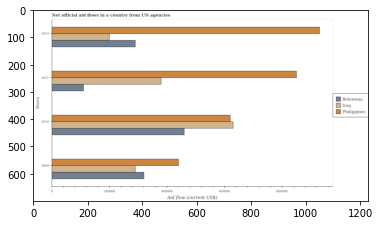

Number of QA =  29





,Years,Botswana,Philippines,Iraq
0,2011,111491.475035,857336.794341,NaN
1,2012,294108.154399,929878.477841,201308.373340
2,2010,464870.924982,624606.328985,631826.767780
3,2009,323831.825675,439941.157943,293170.288996


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in iraq in 2009 and that in 2012 ?
PREDICTED =  91861.91565588201
EXPECTED =  90000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in philippines in 2010 and the net official aid flow in botswana in 2012 ?
PREDICTED =  -305272.14885663707
EXPECTED =  330000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the net official aid flow in philippines and net official aid flow in iraq ?
PREDICTED =  -196426.95227365172
EXPECTED =  -10000




				 1 / 3 = 0.3333


is_built_with_cuda: 

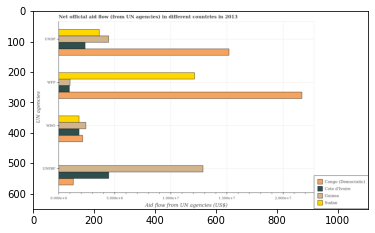

Number of QA =  26





,UN agencies,Guinea,Congo (Democratic),Cote d'Ivoire,Sudan
0,UNPBF,23.378018,2.390045,8.044274,NaN
1,WHO,4.368720,3.874394,3.356335,3.314228
2,WFP,1.878695,39.182770,1.774503,21.781174
3,UNDP,8.075217,27.304128,4.318124,6.562323


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by unpbf in congo (democratic) and that in guinea ?
PREDICTED =  0.0
EXPECTED =  -11560000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by wfp in sudan and the amount of aid given by undp in cote d'ivoire ?
PREDICTED =  20.006670888769133
EXPECTED =  9760000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by unpbf and amount of aid given by wfp in congo (democratic) ?
PREDICTED =  -38.18276956951868
EXPECTED =  -20380000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_g

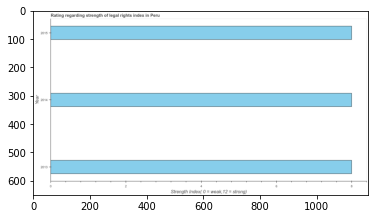

Number of QA =  23





,Year,"Strength Index( 0 = weak, 12 = strong)"
0,2014,7.987761
1,2013,8.027305
2,2015,7.971914


> what is the title of the graph ?
PREDICTED =  Rating regarding strength of legal rights index in Peru
EXPECTED =  Rating regarding strength of legal rights index in Peru




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Strength Index( 0 = weak, 12 = strong)
EXPECTED =  Strength Index( 0 = weak,12 = strong)




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the strength of legal rights index in 2013 and 2015 ?
PREDICTED =  0.05539085495109841
EXPECTED =  0.0




				 2 / 4 = 0.5


> what is the median strength of legal rights index ?
PREDICTED =  None
EXPECTED =  8.0




				 2 / 6 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training ste

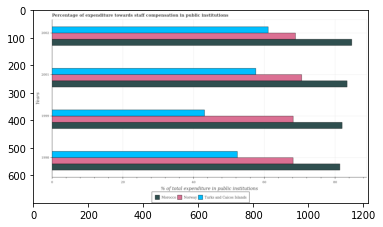

Number of QA =  29





,Years,Morocco,Norway,Turks and Caicos Islands
0,2001,84.044888,71.418808,58.031043
1,1998,82.274276,68.865174,52.623644
2,2002,84.937189,68.698643,61.160733
3,1999,81.357868,68.765795,43.395677


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenditure towards staff compensation in turks and caicos islands in 1999 and that in 2001 ?
PREDICTED =  3.129689486959343
EXPECTED =  -14.490581512451087




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenditure towards staff compensation in morocco in 1998 and the percentage of expenditure towards staff compensation in norway in 1999 ?
PREDICTED =  0.9164077877550625
EXPECTED =  13.19301155273439




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the percentage of expenditure towards staff 

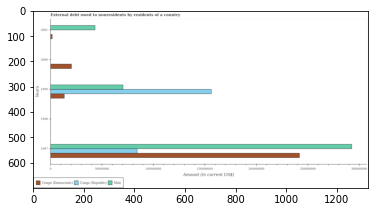

Number of QA =  26





,Years,Unnamed: 1,Congo (Republic),Congo (Democratic)
0,2000,NaN,NaN,3.736466e+07
1,1998,NaN,NaN,NaN
2,2001,7.881175e+07,NaN,3.691073e+06
3,1997,5.326263e+08,NaN,4.378220e+08
4,1999,NaN,2.836002e+08,2.471493e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the external debt owed by residents in mali in 1997 and that in 1999 ?
PREDICTED =  249026134.8178361
EXPECTED =  222247000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the external debt owed by residents in mali in 2000 and the external debt owed by residents in congo (republic) in 1997 ?
PREDICTED =  -495261657.4581312
EXPECTED =  -84146000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the external debt owed by residents in congo (republic) and external debt owed by residents in mali ?
PREDICTED =  0.0
EXPECTED =  8582700

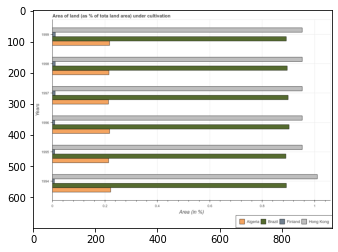

Number of QA =  30





,Years,Algeria,Finland,Brazil,Hong Kong
0,1999,0.218821,0.012497,0.885022,0.953072
1,1997,0.215525,0.012196,0.900111,0.949763
2,1995,0.214111,0.010133,0.902588,0.965537
3,1994,0.223623,0.008635,0.891221,1.012363
4,1996,NaN,0.010253,0.899177,0.952580
5,1998,0.217329,0.012316,0.887878,0.956605


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land under cultivation in brazil in 1996 and that in 1999 ?
PREDICTED =  0.01415533170995098
EXPECTED =  0.010624373365366147




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land under cultivation in brazil in 1998 and the percentage of land under cultivation in algeria in 1995 ?
PREDICTED =  -0.01471012962619056
EXPECTED =  0.681141791342107




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the percentage of land under cultivation in finland and percentage of land under cultivation in brazil ?


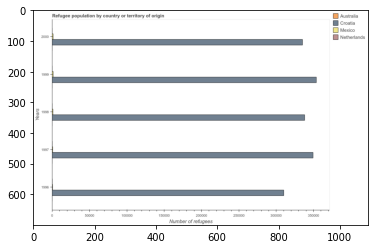

Number of QA =  30





,Years,Australia,Mexico,Croatia,Netherlands
0,1997,NaN,NaN,628883.559360,NaN
1,2000,NaN,NaN,601466.212000,NaN
2,1996,NaN,NaN,555412.440065,NaN
3,1998,NaN,NaN,609539.008236,NaN
4,1999,NaN,NaN,637247.932981,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest number of refugees in netherlands ?
PREDICTED =  0.0
EXPECTED =  19.0




				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evalu

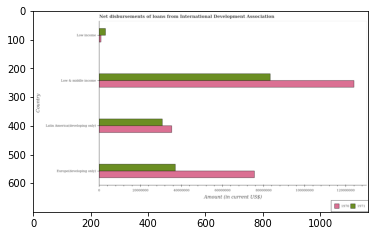

Number of QA =  28





,Country,1971,1970
0,Low income,3.410018e+06,1.207608e+06
1,Low & middle income,8.419070e+07,1.244252e+08
2,Latin America(developing only),3.110806e+07,3.577955e+07
3,Europe(developing only),3.737681e+07,7.579347e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loans disbursed in 1971 in latin america(developing only) and that in low & middle income ?
PREDICTED =  -53082639.779823154
EXPECTED =  -52543000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loans disbursed in 1971 in low income and the amount of loans disbursed in 1970 in low & middle income?
PREDICTED =  -80780678.0978339
EXPECTED =  -120981000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loans disbursed in 1970 and amount of loans disbursed in 1971 in low income ?
PREDICTED =  158002293.3313

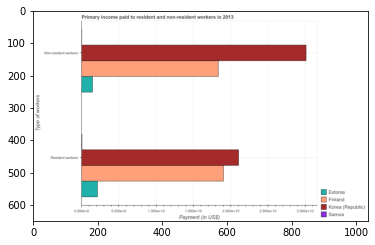

Number of QA =  23





,Type of workers,Estonia,Finland,Samoa,Korea (Republic)
0,Non-resident workers,1.539672,18.544849,NaN,30.410866
1,Resident workers,2.192446,19.044059,NaN,21.109184


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the payment made to resident workers in finland and that in samoa ?
PREDICTED =  19.04405871838378
EXPECTED =  18981692161.3




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the payment made to resident workers in finland and the payment made to non-resident workers in korea (republic) ?
PREDICTED =  -11.36680771366212
EXPECTED =  -11077129633.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the d

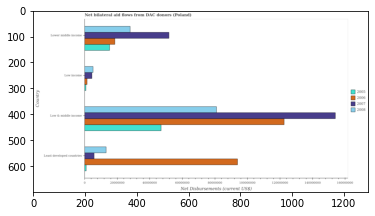

Number of QA =  30





,Country,2007,2005,2006,2008
0,Lower middle income,5.249525e+07,1.548021e+07,1.872528e+07,2.797870e+07
1,Low & middle income,1.547358e+08,4.733006e+07,1.225878e+08,8.246679e+07
2,Least developed countries,6.077576e+06,1.290966e+06,9.410367e+07,1.350209e+07
3,Low income,4.693697e+06,1.071858e+06,1.755567e+06,5.347786e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flows in 2008 in least developed countries and that in low income ?
PREDICTED =  8154306.924139718
EXPECTED =  8020000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flows in 2005 in lower middle income and the net bilateral aid flows in 2007 in low & middle income?
PREDICTED =  -191750831.90429062
EXPECTED =  -138670000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what i

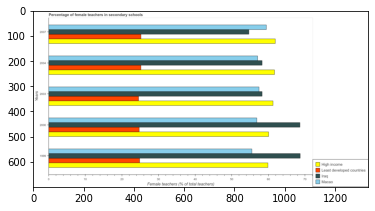

Number of QA =  30





,Years,Least developed countries,Macao,lraq,High income
0,2003,NaN,57.679439,58.224657,61.760692
1,2004,25.487350,57.246748,58.516893,62.090057
2,2007,25.317552,59.371769,55.355333,62.466507
3,2000,NaN,57.662710,69.311256,60.352359
4,1999,25.158846,55.698207,69.090083,60.178892


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in least developed countries in 1999 and that in 2000 ?
PREDICTED =  25.158845670112076
EXPECTED =  0.11790847778318891




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in least developed countries in 2007 and the percentage of female teachers in macao in 2003 ?
PREDICTED =  25.31755198939908
EXPECTED =  -32.25739097595209




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the percentage of female teachers in least developed countries and percentage of female teache

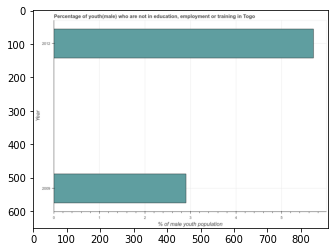

Number of QA =  19





,Year,% of male youth population
0,2012,5.678223
1,2009,2.935228


> what is the title of the graph ?
PREDICTED =  Percentage of youth(male) who are not in education, employment or training in Togo
EXPECTED =  Percentage of youth(male) who are not in education, employment or training in Togo




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  % of male youth population
EXPECTED =  % of male youth population




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed male youth population in 2009 and 2012 ?
PREDICTED =  -2.7429947696641417
EXPECTED =  -2.8




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed male youth population ?
PREDICTED =  2010

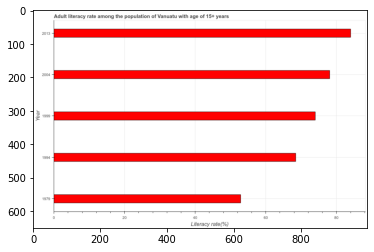

Number of QA =  23





,Year,Literacy rate(%)
0,2013,83.724593
1,1994,68.173018
2,2004,78.326804
3,1999,73.576336
4,1979,52.863191


> what is the title of the graph ?
PREDICTED =  Adult literacy rate among the population of Vanuatu with age of 15+ years
EXPECTED =  Adult literacy rate among the population of Vanuatu with age of 15+ years




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Literacy rate(%)
EXPECTED =  Literacy rate(%)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adult literacy rate in 1979 and 1994 ?
PREDICTED =  -15.30982722801582
EXPECTED =  -15.586




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median adult literacy rate ?
PREDICTED =  73.57633623353473
EXPECTED =  74.0




				 5 / 5 = 1.0


is_built

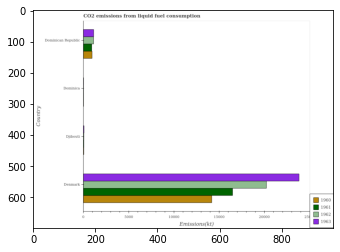

Number of QA =  30





,Country,1963,1962,1961,1960
0,Dominica,NaN,NaN,NaN,NaN
1,Djibouti,NaN,NaN,NaN,NaN
2,Dominican Republic,2215.508024,2176.936281,1834.531626,1877.399078
3,Denmark,42740.567344,36761.501807,29710.158411,25677.064779


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in 1960 in denmark and that in djibouti ?
PREDICTED =  23799.665700655583
EXPECTED =  14136.285




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in 1962 in dominica and the amount of co2 emitted in 1963 in dominican republic?
PREDICTED =  0.0
EXPECTED =  -1122.102




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in 1963 and amount of co2 emitted in 1961 in dominica ?
PREDICTED =  44955.07536825842
EXPECTED =  3.667




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_av

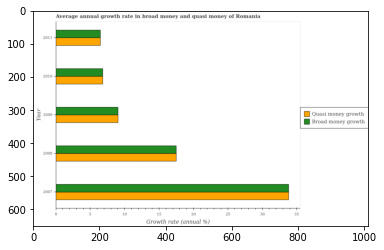

Number of QA =  28





,Year,Broad money growth,Quasi money growth
0,2011,6.554771,6.565974
1,2010,6.842661,6.845121
2,2009,9.077954,9.144658
3,2007,33.947643,33.785590
4,2008,17.606457,17.578698


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the annual growth rate in broad money in 2010 and that in 2011 ?
PREDICTED =  0.28788946030240314
EXPECTED =  0.35




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the annual growth rate in broad money in 2008 and the annual growth rate in quasi money in 2009 ?
PREDICTED =  8.52850289707972
EXPECTED =  8.46039571140502




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the annual growth rate in quasi money and annual growth rate in broad money ?
PREDICTED =  0.0
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_g

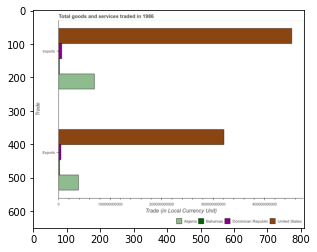

Number of QA =  23





,Trade,Dominican Republic,Algeria,Bahamas,United States
0,Exports,5.770066e+09,4.006395e+10,2.862050e+09,3.199237e+11
1,Imports,7.437483e+09,7.103866e+10,2.691046e+09,4.614151e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Trade (in Local Currency Unit)
EXPECTED =  100000000000.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Total goods and services traded in 1986
EXPECTED =  Total goods and services traded in 1986




				 1 / 6 = 0.1667


> what is the label or title of the x-axis ?
PR

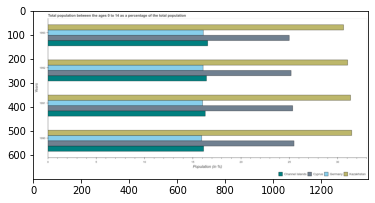

Number of QA =  30





,Years,Unnamed: 1,Channel Islands,Germany,Kazakhstan
0,1991,25.417961,16.383404,16.097487,31.717633
1,1993,25.003618,16.692274,NaN,30.983797
2,1990,25.730946,16.183446,NaN,31.416224
3,1992,25.211791,16.422986,16.196285,31.450707


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the population ages 0 to 14 in germany in 1991 and that in 1992 ?
PREDICTED =  -0.098798028066728
EXPECTED =  -0.05428517042710013




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the population ages 0 to 14 in cyprus in 1993 and the percentage of the population ages 0 to 14 in kazakhstan in 1991 ?
PREDICTED =  2.0
EXPECTED =  -6.351633520076302




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1993, what is the difference between the percentage of the population ages 0 to 14 in channel islands and percentage of the population ages 

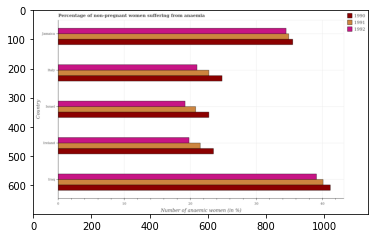

Number of QA =  29





,Country,1992,1990,1991
0,Ireland,NaN,23.390407,21.625885
1,Israel,NaN,22.993657,21.091459
2,Italy,21.173968,24.888489,23.109251
3,Jamaica,34.728916,35.425146,34.960370
4,Iraq,39.256465,41.266631,40.281324


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of non-pregnant women suffering from anaemia in 1990 in iraq and that in ireland ?
PREDICTED =  17.8762233150419
EXPECTED =  17.700000000000003




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of non-pregnant women suffering from anaemia in 1992 in iraq and the percentage of non-pregnant women suffering from anaemia in 1990 in ireland?
PREDICTED =  15.86605730876072
EXPECTED =  15.600000000000001




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of non-pregnant women suffering from anaemia in 1990 and per

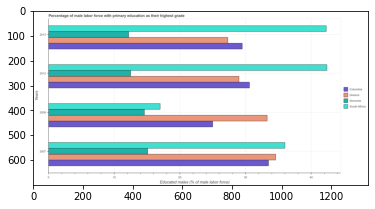

Number of QA =  30





,Years,Slovenia,South Africa,Greece,Colombia
0,2013,NaN,42.851041,27.426064,29.351891
1,2007,15.294566,36.075675,34.893566,33.640234
2,2008,14.733661,16.884076,33.132270,NaN
3,2012,12.524714,42.215692,28.982726,30.751163


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force with primary education in south africa in 2012 and that in 2013 ?
PREDICTED =  -0.635349407767066
EXPECTED =  0.10000228881840201




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force with primary education in greece in 2008 and the percentage of male labor force with primary education in slovenia in 2012 ?
PREDICTED =  20.607555261770216
EXPECTED =  20.799999237060497




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the percentage of male labor force with primary ed

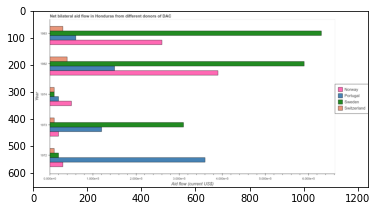

Number of QA =  30





,Year,Switzerland,Sweden,Portugal,Norway
0,1974,0.110824,0.113811,0.210026,0.513269
1,1973,0.110225,3.107748,1.206007,0.208719
2,1972,0.109899,0.207726,3.639447,0.311784
3,1982,0.405198,5.852905,1.507515,3.967231
4,1983,0.312963,6.269673,0.609622,2.595803


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by sweden in 1972 and that in 1974 ?
PREDICTED =  0.09391491305496108
EXPECTED =  10000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by sweden in 1982 and the amount of aid given by portugal in 1974 ?
PREDICTED =  5.739093688527353
EXPECTED =  570000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1974, what is the difference between the amount of aid given by switzerland and amount of aid given by portugal ?
PREDICTED =  -6.123507692079148
EXPECTED =  -10000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_a

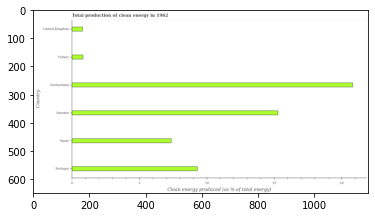

Number of QA =  22





,Country,Clean energy produced (as % of total enerqy)
0,Spain,7.445723
1,Turkey,0.871060
2,Sweden,15.409473
3,United Kingdom,0.830739
4,Portugal,9.361984
5,Switzerland,20.833999


> what is the title of the graph ?
PREDICTED =  Total production of clean energy in 1962
EXPECTED =  Total production of clean energy in 1962




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Clean energy produced (as % of total enerqy)
EXPECTED =  Clean energy produced (as % of total energy)




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the production of clean energy in sweden and switzerland ?
PREDICTED =  -5.424526470945752
EXPECTED =  -5.545




				 3 / 4 = 0.75


> what is the median production of clean energy ?
PREDICTED =  None
EXPECTED =  8.329438600507505




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training

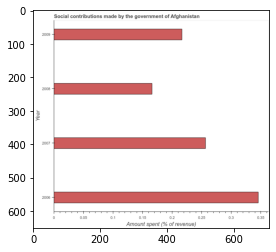

Number of QA =  23





,Year,Amount spent (% of revenue)
0,2006,0.345657
1,2009,0.216610
2,2007,0.254906
3,2008,0.165305


> what is the title of the graph ?
PREDICTED =  Social contributions made by the government of Afghanistan
EXPECTED =  Social contributions made by the government of Afghanistan




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Amount spent (% of revenue)
EXPECTED =  Amount spent (% of revenue)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent in making social contributions in 2008 and 2009 ?
PREDICTED =  -0.05130538639932475
EXPECTED =  -0.051




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median amount spent in making social contributions ?
PREDICTED =  0.23575844831922727
EXPEC

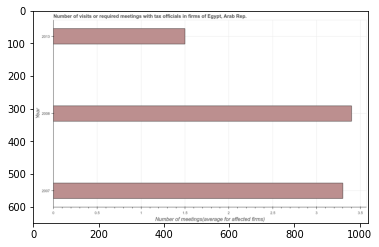

Number of QA =  23





,Year,Number of meetings(average for affected firms)
0,2013,1.499984
1,2007,3.314177
2,2008,3.406714


> what is the title of the graph ?
PREDICTED =  Number of visits or required meetings with tax officials in firms of Egypt, Arab Rep.
EXPECTED =  Number of visits or required meetings with tax officials in firms of Egypt, Arab Rep.




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Number of meetings(average for affected firms)
EXPECTED =  Number of meetings(average for affected firms)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of required meetings with tax officials in 2007 and 2008 ?
PREDICTED =  -0.09253763494743117
EXPECTED =  -0.1




				 3 / 4 = 0.75


> what is the median number of required meetings with tax officials ?
PREDICTED =  None
EXPECTED =  3.3




				 3 / 6 = 0.5


is_built_with_cud

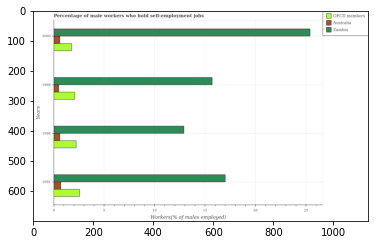

Number of QA =  29





,Years,OECD members,Australia,Zambia
0,1991,2.626393,0.757706,17.032083
1,1998,2.110915,0.553510,15.765432
2,1996,2.272806,0.661972,12.952530
3,2000,1.815568,0.662520,25.424765


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed male workers in zambia in 1991 and that in 2000 ?
PREDICTED =  -8.39268192221924
EXPECTED =  -8.399999618530309




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed male workers in oecd members in 1996 and the percentage of self-employed male workers in australia in 1998 ?
PREDICTED =  0.16189115676650268
EXPECTED =  1.7262822917153402




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after train

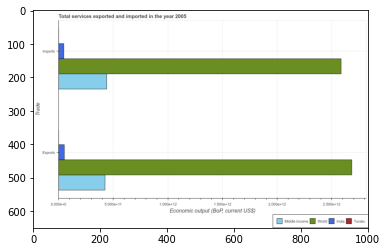

Number of QA =  23





,Trade,Unnamed: 1,India,Middle income,World
0,Imports,NaN,0.960275,8.009670,47.878414
1,Exports,NaN,1.059005,7.615495,48.722419


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of service exports in world and that in middle income ?
PREDICTED =  -1.0
EXPECTED =  2258828412259.8237




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of service exports in middle income and the amount of service imports in world ?
PREDICTED =  -46.878413985497005
EXPECTED =  -2160859566506.464




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount of service imports in world t

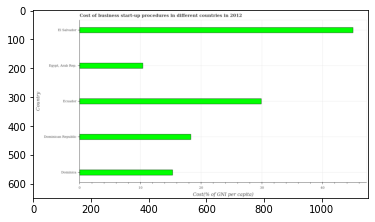

Number of QA =  22





,Country,Cost(% of GNI per capita)
0,Dominica,15.548721
1,El Salvador,44.819750
2,Dominican Republic,18.338332
3,"Egypt, Arab Rep.",10.497957
4,Ecuador,30.070759


> what is the title of the graph ?
PREDICTED =  Cost of business start-up procedures in different countries in 2012
EXPECTED =  Cost of business start-up procedures in different countries in 2012




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Cost(% of GNI per capita)
EXPECTED =  Cost(% of GNI per capita)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of business startup procedures in dominican republic and el salvador ?
PREDICTED =  -26.481418310398375
EXPECTED =  -26.7




				 4 / 4 = 1.0


> what is the median cost of business startup procedures ?
PREDICTED =  None
EXPECTED =  18.3




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Ev

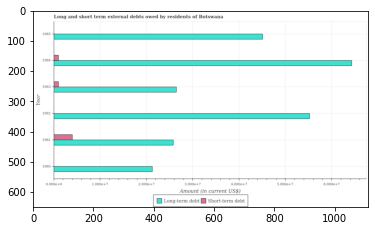

Number of QA =  25





,Year,Long-term debt,Short-term debt
0,1980,2.151852,NaN
1,1985,4.533553,NaN
2,1982,5.583487,NaN
3,1983,2.668553,0.111838
4,1984,6.486517,0.113778
5,1981,2.602445,0.410726


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the long-term debts owed by residents in 1982 and that in 1985 ?
PREDICTED =  1.049934635717345
EXPECTED =  10142000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the long-term debts owed by residents in 1984 and the short-term debts owed by residents in 1982 ?
PREDICTED =  0.9030302441871871
EXPECTED =  64331000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1983, what is the difference between the long-term debts owed by residents and short-term debts owed by residents ?
PREDICTED =  20.107234898902547
EXPECTED =  25472000




				 0 / 3 = 0.0


is_built_with_

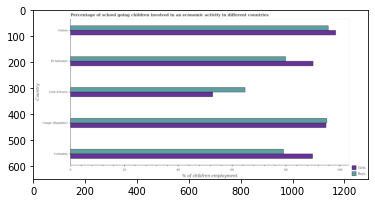

Number of QA =  28





,Country,Girls,Boys
0,Colombia,90.327265,79.232180
1,El Salvador,90.612870,80.462478
2,Gabon,98.373012,96.243524
3,Cote d'Ivoire,53.067161,65.133557
4,Congo (Republic),95.896606,95.562614


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of school going girls in cote d'ivoire and that in gabon ?
PREDICTED =  -45.30585097876828
EXPECTED =  -45.695




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of school going boys in colombia and the percentage of school going girls in gabon ?
PREDICTED =  -17.011343570042072
EXPECTED =  -19.373619695854217




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of school going boys and percentage of school going girls in el salvador ?
PREDICTED =  -25.47931276124612
EXPECTED =  -10.2




				 1 / 3 = 0.3333



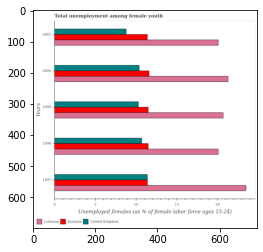

Number of QA =  29





,Years,Lebanon,Somalia,United Kingdom
0,2000,21.469481,11.656393,10.519453
1,2001,20.095971,11.423248,8.902904
2,1998,NaN,11.386118,10.827266
3,1997,24.213309,11.506594,11.494156
4,1999,20.689691,11.576994,10.373708


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed females in in somalia in 1999 and that in 2001 ?
PREDICTED =  0.15374674067290783
EXPECTED =  0.10000038146969992




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed females in in united kingdom in 1998 and the percentage of unemployed females in in somalia in 1999 ?
PREDICTED =  0.4535576472726479
EXPECTED =  -0.8000001907349006




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the percentage of unemployed females in in lebanon and percentage of unemployed females in in somali

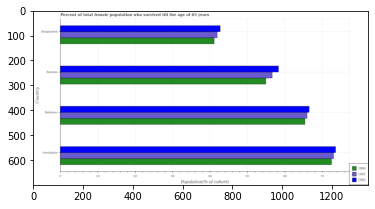

Number of QA =  29





,Country,1962,1961,1960
0,Bahrain,58.299238,56.612502,55.032690
1,Bahamas,66.855721,65.928747,65.347923
2,Azerbaijan,72.898248,72.977146,72.862000
3,Bangladesh,42.912179,42.096207,41.270585


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total female population who survived till the age of 65 years in 1961 in bahamas and that in bahrain ?
PREDICTED =  -54.612502332259986
EXPECTED =  9.321409999999993




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of total female population who survived till the age of 65 years in 1961 in bahamas to that in bahrain ?
PREDICTED =  0.03532788549536209
EXPECTED =

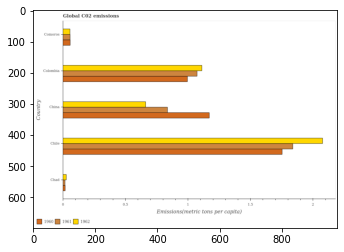

Number of QA =  29





,Country,1962,1961,1960
0,China,0.669286,0.839188,1.157402
1,Chile,2.111377,1.846799,1.755368
2,Chad,0.031070,0.021193,0.022381
3,Comoros,0.060775,0.060850,0.060891
4,Colombia,NaN,1.075312,1.000964


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in in 1960 in china and that in comoros ?
PREDICTED =  1.0965112775714565
EXPECTED =  1.1120923698748495




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in in 1962 in comoros and the amount of co2 emitted in in 1960 in chad?
PREDICTED =  0.029704362677526696
EXPECTED =  0.0381078115455385




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in in 1960 and amount of co2 emitted in in 1962 in chile ?
PREDICTED =  2.888622977315161
EXPECTED =  -0.32354349426763984




				 1 / 

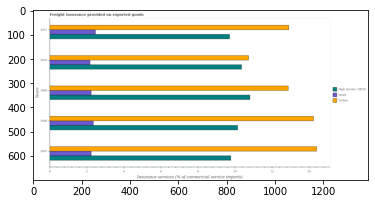

Number of QA =  29





,Years,Turkey,Israel,High income: OECD
0,2009,12.925034,2.255947,10.834026
1,2010,10.837745,2.172795,10.351959
2,2011,12.913653,2.509275,9.737941
3,2007,14.369665,2.263920,9.869168
4,2008,14.264674,2.384855,10.242088


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the freight insurance provided on exported goods in turkey in 2008 and that in 2011 ?
PREDICTED =  1.3510212305191676
EXPECTED =  1.3349647037241006




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the freight insurance provided on exported goods in high income: oecd in 2009 and the freight insurance provided on exported goods in israel in 2011 ?
PREDICTED =  3.187093110021088
EXPECTED =  8.33618806855149




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the freight insurance provided on exported goods in high income: oecd and frei

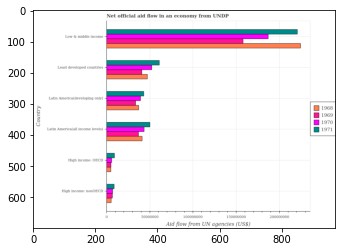

Number of QA =  30





,Country,1971,1970,1969,1968
0,Low & middle income,3.943970e+08,NaN,NaN,4.033402e+08
1,High income: OECD,1.807502e+07,1.239339e+07,1.117901e+07,1.059624e+07
2,Latin America(all income levels),9.094355e+07,7.970973e+07,6.860134e+07,7.463011e+07
3,Latin America(developing only),7.797928e+07,7.258521e+07,6.256655e+07,6.834200e+07
4,Least developed countries,1.123122e+08,9.710759e+07,7.558519e+07,8.625361e+07
5,High income: nonOECD,1.759543e+07,1.458894e+07,1.419355e+07,1.134602e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in 1971 in high income: nonoecd and that in low & middle income ?
PREDICTED =  -376801578.8294854
EXPECTED =  -212000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in 1968 in latin america(developing only) and the net official aid flow in 1969 in low & middle income?
PREDICTED =  -334998239.8614429
EXPECTED =  -120780000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in 1970 and net official aid flow in 1969 in high income: nonoecd ?
PREDICTED =  41083423.1126

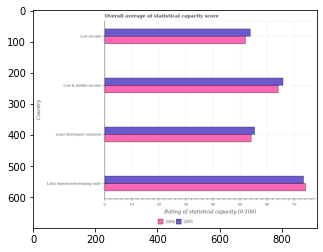

Number of QA =  28





,Country,2005,2004
0,Low income,54.205969,NaN
1,Low & middle income,67.084976,65.136178
2,Least developed countries,56.238087,54.940456
3,Latin America(developing only),74.515581,75.134688


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in 2004 in least developed countries and that in low & middle income ?
PREDICTED =  -10.19572240396598
EXPECTED =  -9.995091356548805




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in 2004 in low & middle income and the rating of statistical capacity in 2005 in latin america(developing only)?
PREDICTED =  -4.999254997325153
EXPECTED =  -9.353632596153886




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in 2004 and rating of statistical capacit

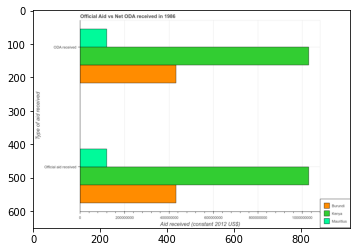

Number of QA =  23





,Type of aid received,Mauritius,Kenya,Burundi
0,Official aid received,1.225403e+08,1.031546e+09,4.347515e+08
1,ODA received,1.232457e+08,1.028557e+09,4.347146e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received in mauritius and that in burundi ?
PREDICTED =  -311468880.03047895
EXPECTED =  -311830000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received in burundi and the official aid received in kenya ?
PREDICTED =  -593841963.3873248
EXPECTED =  -597560000




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the oda received in kenya to that in burundi ?
PREDICTED =  2.366050296413335

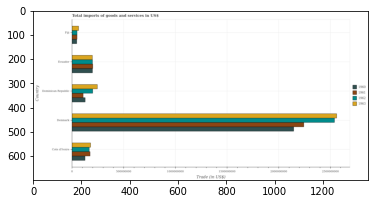

Number of QA =  30





,Country,1963,1962,1961,1960
0,Dominican Republic,4.542879e+08,3.733580e+08,2.028337e+08,2.382179e+08
1,Cote d'Ivoire,3.325577e+08,3.116483e+08,3.222412e+08,2.387489e+08
2,Ecuador,3.621612e+08,3.684013e+08,3.742575e+08,3.658548e+08
3,Denmark,4.605966e+09,4.561956e+09,4.065151e+09,3.875193e+09
4,Fiji,1.258751e+08,9.909640e+07,9.928420e+07,9.409763e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports of goods and services in 1962 in denmark and that in fiji ?
PREDICTED =  -4661052054.394542
EXPECTED =  2491870150.43999




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports of goods and services in 1963 in denmark and the total imports of goods and services in 1961 in ecuador?
PREDICTED =  -4968126816.382193
EXPECTED =  2360547492.372867




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports of goods and services in 1962 and total imports of goods and services in 1961 in denmark ?
PREDICTED =  -456195565

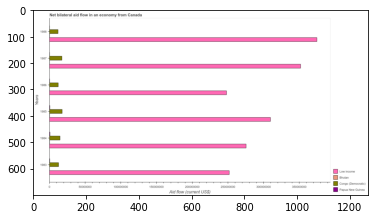

Number of QA =  30





,Years,Papua New Guinea,Congo (Democratic:,Bhutan,Low income
0,1983,NaN,2.446827e+07,NaN,4.536398e+08
1,1985,NaN,3.284539e+07,NaN,5.569788e+08
2,1984,NaN,2.750157e+07,NaN,4.961501e+08
3,1987,NaN,3.211422e+07,NaN,6.368751e+08
4,1986,NaN,2.343003e+07,NaN,4.483213e+08
5,1988,NaN,2.265497e+07,NaN,6.759710e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in low income in 1986 and that in 1988 ?
PREDICTED =  -227649702.29281604
EXPECTED =  -126710000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in congo (democratic) in 1987 and the net bilateral aid flow in low income in 1984 ?
PREDICTED =  4612651.226945985
EXPECTED =  -258130000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net bilateral ai

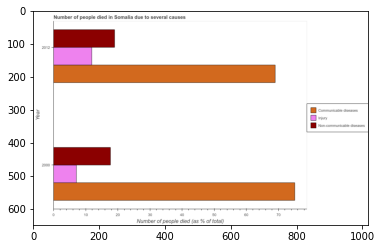

Number of QA =  26





,Year,Injury,Non-communicable diseases,Communicable diseases
0,2000,7.284402,18.019028,75.224341
1,2012,11.993343,19.161300,68.944648


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of people who died of injury in 2000 and that in 2012 ?
PREDICTED =  6.284402026590467
EXPECTED =  -4.8




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of people who dies of non-communicable diseases in 2000 and the number of people who died of communicable diseases in 2012 ?
PREDICTED =  -18.16130027789924
EXPECTED =  -51.3




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the number of people who died of communicable diseases and number of people who dies of non-communicable diseases ?
PREDICTED =  0.0
EXPE

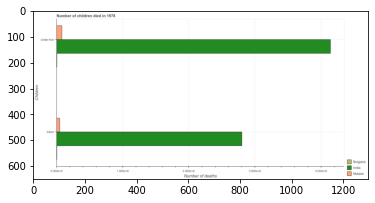

Number of QA =  23





,Children,Malawi,Bulgaria,India
0,Infant,0.052189,NaN,2.779109
1,Under-five,0.083591,NaN,4.144582


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of under-five deaths in malawi and that in bulgaria ?
PREDICTED =  0.0
EXPECTED =  75397




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of under-five deaths in india and the number of infant deaths in malawi ?
PREDICTED =  0.0
EXPECTED =  4095978




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of infant deaths and number of under-five deaths in malawi ?
PREDICTED =  1.0
EXPECTED =  -32395




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finishe

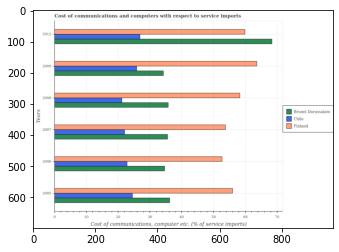

Number of QA =  29





,Years,Finland,Chile,Brunei Darussalan
0,2009,NaN,25.793643,34.503754
1,2012,60.145612,NaN,68.689783
2,2008,58.784195,21.363653,35.738860
3,2007,53.948211,22.165847,35.330313
4,2006,52.414214,23.069185,34.937277
5,2005,56.186123,24.406055,36.148986


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers in chile in 2008 and that in 2009 ?
PREDICTED =  -25.79364347151693
EXPECTED =  -4.658299475655401




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cost of communications and computers in brunei darussalam in 2006 to that in 2012 ?
PREDICTED =  0.5086240622971763
EXPECTED =  0.5063219005378538




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_

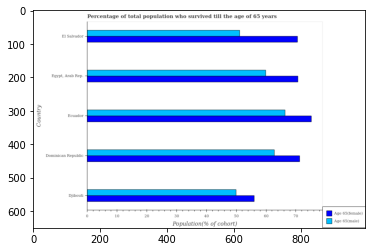

Number of QA =  28





,Country,Age 65(male),Age 65(female)
0,El Salvador,NaN,70.902591
1,Ecuador,66.741860,75.867323
2,Djibouti,50.543056,56.501528
3,Dominican Republic,63.025012,71.618656
4,"Egypt, Arab Rep.",60.074535,70.951814


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female population who survived till age of 65 in djibouti and that in dominican republic ?
PREDICTED =  -15.117128464126374
EXPECTED =  -15.243




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female population who survived till age of 65 in dominican republic and the percentage of male population who survived till age of 65 in el salvador ?
PREDICTED =  0.7160647410853898
EXPECTED =  20.12070999999998




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male population who survived till age of 65 a

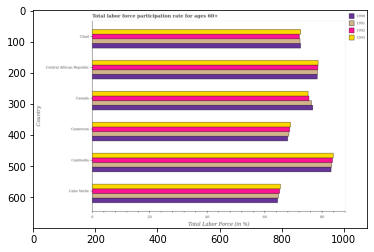

Number of QA =  30





,Country,1992,1993,1990,1991
0,Cabo Verde,66.036873,65.911169,65.132533,65.848773
1,Cameroon,69.467071,69.502674,68.907646,69.073241
2,Chad,72.748700,NaN,72.989048,72.820051
3,Cambodia,NaN,85.136073,83.703718,NaN
4,Central African Republic,79.107720,79.190778,79.411361,78.840021
5,Canada,76.218301,75.656101,77.194889,76.938952


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in 1993 in cameroon and that in canada ?
PREDICTED =  -6.153427361692707
EXPECTED =  -6.099998474120994




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in 1991 in cambodia and the labor force participation rate in 1990 in cameroon?
PREDICTED =  -3.2244681405147304
EXPECTED =  15.300003051757798




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in 1991 and labor force participation rate in 1990 in chad ?
PREDICTED =  290.53198865652183
EXPECTED =

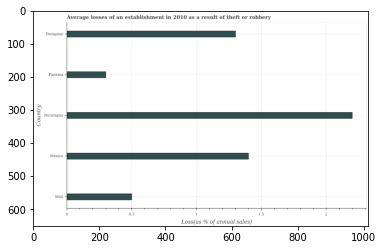

Number of QA =  22





,Country,Loss(as % of annual sales)
0,Mexico,1.406788
1,Mali,0.501965
2,Nicaragua,2.209431
3,Panama,0.302536
4,Paraguay,1.301260


> what is the title of the graph ?
PREDICTED =  Average losses of an establishment in 2010 as a result of theft or robbery
EXPECTED =  Average losses of an establishment in 2010 as a result of theft or robbery




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Loss(as % of annual sales)
EXPECTED =  Loss(as % of annual sales)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the losses due to theft in mali and panama ?
PREDICTED =  0.19942844613856076
EXPECTED =  0.2




				 4 / 4 = 1.0


> what is the median losses due to theft ?
PREDICTED =  None
EXPECTED =  1.3




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 

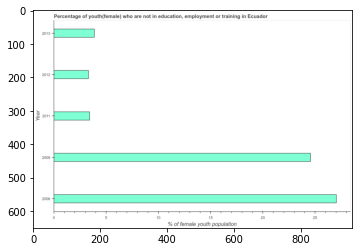

Number of QA =  23





,Year,% of female youth population
0,2006,27.040725
1,2009,24.563813
2,2013,3.930299
3,2012,3.383888
4,2011,3.481218


> what is the title of the graph ?
PREDICTED =  Percentage of youth(female) who are not in education, employment or training in Ecuador
EXPECTED =  Percentage of youth(female) who are not in education, employment or training in Ecuador




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  % of female youth population
EXPECTED =  % of female youth population




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed female youth population in 2011 and 2012 ?
PREDICTED =  0.09733040368787327
EXPECTED =  0.11




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed female youth population 

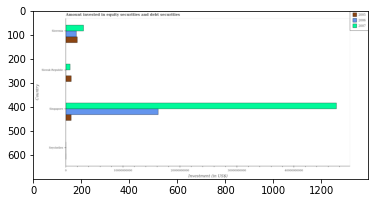

Number of QA =  26





,Country,2007,2005,2006
0,Seychelles,NaN,NaN,NaN
1,Slovenia,3.204146e+09,2.134382e+09,1.974338e+09
2,Slovak Republic,8.642456e+08,1.049203e+09,NaN
3,Singapore,4.765646e+10,1.036211e+09,1.642801e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount invested in equity securities and debt securities in 2007 in singapore and that in slovenia ?
PREDICTED =  -50860607235.65401
EXPECTED =  44360734649.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount invested in equity securities and debt securities in 2005 in slovak republic and the amount invested in equity securities and debt securities in 2007 in singapore?
PREDICTED =  -1049203015.4020953
EXPECTED =  -46512822243.4




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount invested in equity securities and debt securiti

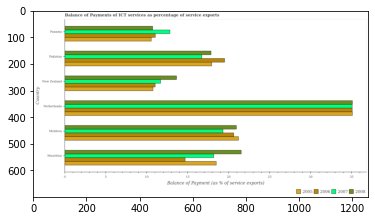

Number of QA =  30





,Country,2007,2005,2008,2006
0,Pakistan,16.728522,17.991282,17.781829,19.710654
1,Mauritius,NaN,18.647397,21.684430,15.124848
2,Moldova,NaN,21.133248,20.994678,20.121413
3,Panama,12.842919,NaN,10.716160,10.599845
4,New Zealand,11.767755,NaN,13.494615,NaN
5,Netherlands,35.256719,NaN,35.125798,35.154697


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of ict services in 2007 in new zealand and that in pakistan ?
PREDICTED =  -4.9607666005389905
EXPECTED =  -5.016140865400001




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of ict services in 2007 in new zealand and the balance of payments of ict services in 2006 in pakistan?
PREDICTED =  -4.9607666005389905
EXPECTED =  -7.80403484936679




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of ict services in 2005 and balance of payments of ict services in 2008 in moldova ?
PREDIC

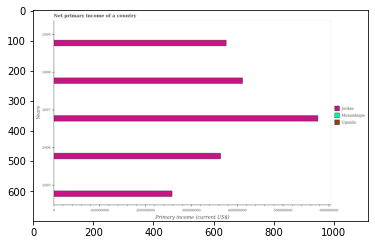

Number of QA =  23





,Years,Mozambique,Jordan,Uganda
0,2005,NaN,2.593368e+08,NaN
1,2009,NaN,3.771725e+08,NaN
2,2008,NaN,4.153811e+08,NaN
3,2006,NaN,3.661928e+08,NaN
4,2007,NaN,5.802312e+08,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the primary income in jordan in 2006 and that in 2009 ?
PREDICTED =  -10979732.309809625
EXPECTED =  -12228865.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the primary income in uganda in 2006 and the primary income in jordan in 2009 ?
PREDICTED =  nan
EXPECTED =  -375966369.1




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the primary income in jordan in 2007 to that in 2009 ?
PREDICTED =  1.5383708686715838
EXPECTED =  1.5313672631896054




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Ev

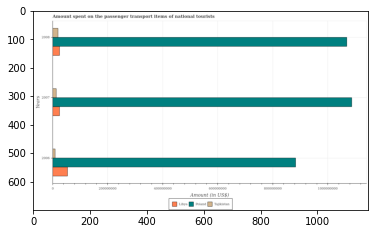

Number of QA =  29





,Years,Tajikistan,Poland,Libya
0,2008,2.121425e+07,1.086370e+09,2.675419e+07
1,2006,1.043429e+07,8.817535e+08,5.582364e+07
2,2007,1.420823e+07,1.096940e+09,2.660630e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the passenger transport items of national tourists in poland in 2006 and that in 2008 ?
PREDICTED =  -204615978.47946942
EXPECTED =  -186000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the passenger transport items of national tourists in poland in 2006 and the amount spent on the passenger transport items of national tourists in tajikistan in 2008 ?
PREDICTED =  -204615978.47946942
EXPECTED =  863500000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the amount spent on the passe

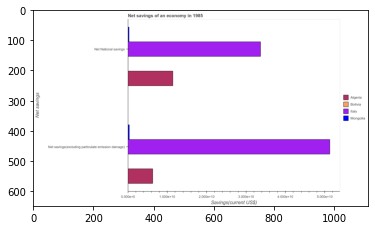

Number of QA =  20





,Net savings,Algeria,Bolivia,Mongolia,Italy
0,Net National savings,1.164452,NaN,0.032973,3.391542
1,Net savings(excluding particulate emission dam...,0.649367,NaN,0.044402,5.188638


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net national savings in bolivia and the net savings(excluding particulate emission damage) in algeria ?
PREDICTED =  -0.649367426983668
EXPECTED =  -6265002620.762023




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net national savings in algeria to that in italy ?
PREDICTED =  0.34333992110716655
EXPECTED =  0.3387728919914453




				 1 / 4 = 0.25


> what is the difference between 

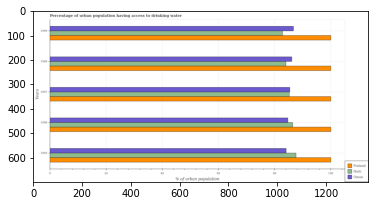

Number of QA =  29





,Years,Finland,Oman,Haiti
0,1997,98.003548,85.386620,84.478389
1,1998,100.734482,86.622283,83.993248
2,1999,98.818517,86.814422,82.581870
3,1995,100.756143,84.585255,87.363455
4,1996,98.865248,85.161898,86.648941


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population having access to drinking water in finland in 1996 and that in 1998 ?
PREDICTED =  -1.8692340080145016
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population having access to drinking water in haiti in 1998 and the percentage of urban population having access to drinking water in oman in 1997 ?
PREDICTED =  -0.4851414994379297
EXPECTED =  -1.4000000000000057




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the percentage of urban population having access

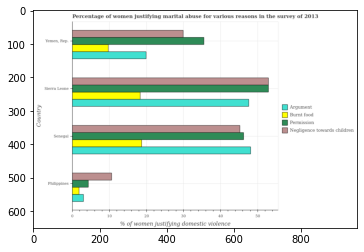

Number of QA =  30





,Country,Negligence towards children,Argument,Permission,Burnt food
0,Sierra Leone,52.948863,47.950939,53.009903,18.549292
1,Philippines,10.740104,3.139044,4.472367,1.946778
2,Senegal,45.489838,47.986297,46.327014,18.916258
3,"Yemen, Rep.",29.853659,20.049129,35.285796,9.885352


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of women justifying abuse for burning food in sierra leone and that in yemen, rep. ?
PREDICTED =  38.06558674736475
EXPECTED =  8.6




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of women justifying abuse for showing negligence towards children in philippines and the percentage of women justifying abuse for burning food in yemen, rep. ?
PREDICTED =  -19.11355572654349
EXPECTED =  0.9000000000000004




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ..

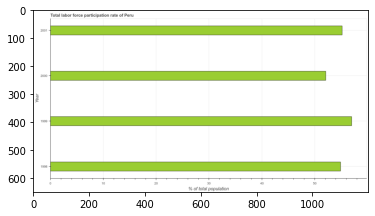

Number of QA =  23





,Year,% of total population
0,2001,55.204867
1,1998,55.193224
2,2000,52.486753
3,1999,57.340711


> what is the title of the graph ?
PREDICTED =  Total labor force participation rate of Peru
EXPECTED =  Total labor force participation rate of Peru




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  % of total population
EXPECTED =  % of total population




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total labor force participation rate in 1999 and 2001 ?
PREDICTED =  2.1358442872215306
EXPECTED =  1.8




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total labor force participation rate ?
PREDICTED =  1999.5
EXPECTED =  55.0500011444092




				 3 / 5 = 0.6


is_built_with_cuda: True

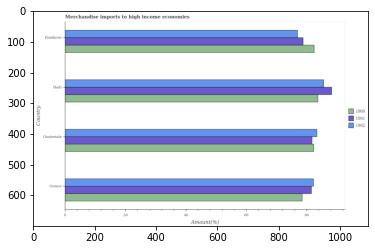

Number of QA =  29





,Country,1962,1961,1960
0,Greece,82.929534,81.961738,79.000903
1,Haiti,85.749656,88.039616,84.680490
2,Guatemala,83.476677,82.155382,83.025305
3,Honduras,77.607026,78.785762,82.720325


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in 1960 in guatemala and that in honduras ?
PREDICTED =  0.3049800422117812
EXPECTED =  -0.13972295620149566




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in 1960 in guatemala and the percentage of amount earned from merchandise imports in 1961 in honduras?
PREDICTED =  4.239542820988149
EXPECTED =  3.5309617918313023




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in 1960 and

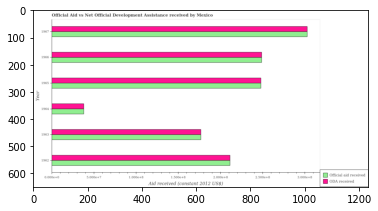

Number of QA =  28





,Year,Official aid received,ODA received
0,1967,54.768371,54.339564
1,1963,31.820074,31.974285
2,1964,6.955424,6.959614
3,1962,38.143774,38.398013
4,1965,44.592253,44.650204
5,1966,44.908444,44.710751


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received in 1965 and that in 1967 ?
PREDICTED =  -9.68935964733052
EXPECTED =  -54870000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the official aid received in 1967 and the oda received in 1963 ?
PREDICTED =  22.948297363288074
EXPECTED =  126020000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1964, what is the difference between the official aid received and oda received ?
PREDICTED =  0.0
EXPECTED =  0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training 

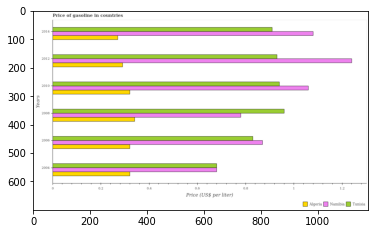

Number of QA =  29





,Years,Algeria,Tunisia,Namibia
0,2014,0.272871,0.913260,1.087261
1,2006,0.324645,0.838533,NaN
2,2008,NaN,0.956255,0.783541
3,2012,NaN,0.938585,NaN
4,2010,0.324341,0.942564,1.064284
5,2004,0.321940,0.670804,0.684219


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the price of gasoline in namibia in 2004 and that in 2008 ?
PREDICTED =  -0.09932239442099011
EXPECTED =  -0.09999999999999998




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the price of gasoline in tunisia in 2006 and the price of gasoline in namibia in 2008 ?
PREDICTED =  -0.1177222990417296
EXPECTED =  0.04999999999999993




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2014, what is the difference between the price of gasoline in namibia and price of gasoline in algeria ?
PREDICTED =  0.22396355194802786
EXPECTED =  0.81




				 1 / 3 = 0.3333


is_built_with_

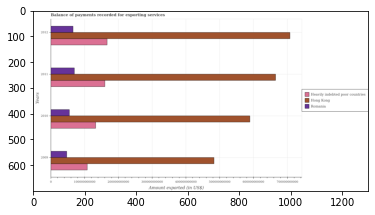

Number of QA =  29





,Years,Heavily indebted poor countries,Hong Kong,Romania
0,2012,1.683715e+11,7.106821e+11,6.680285e+10
1,2011,1.627641e+11,6.672047e+11,7.176412e+10
2,2010,1.352759e+11,5.925778e+11,5.594442e+10
3,2009,1.095953e+11,4.809080e+11,4.865893e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount exported in hong kong in 2011 and that in 2012 ?
PREDICTED =  -43477427133.82483
EXPECTED =  -42520000000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount exported in heavily indebted poor countries in 2011 and the amount exported in romania in 2012 ?
PREDICTED =  -5607333002.984283
EXPECTED =  94241688356.741




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the amount exported in romania and amount exported in heavily indebted poor countries ?
PREDICTED =  -332836437884.4498
EXPECTED =  -60677987898.375






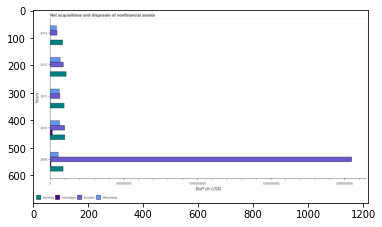

Number of QA =  27





,Years,Azerbaijan,Micronesia,Armenia,Ecuador
0,2013,NaN,8.496086e+07,1.592850e+08,8.982615e+07
1,2012,NaN,1.292082e+08,2.015118e+08,1.685179e+08
2,2011,NaN,1.177413e+08,1.772049e+08,1.253685e+08
3,2010,3.336654e+07,1.228078e+08,1.840016e+08,1.824347e+08
4,2009,1.862241e+07,1.053660e+08,1.653596e+08,3.670376e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments in azerbaijan in 2009 and that in 2011 ?
PREDICTED =  18622406.595118035
EXPECTED =  4439000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments in micronesia in 2009 and the balance of payments in azerbaijan in 2012 ?
PREDICTED =  -23842204.473340526
EXPECTED =  54885842.41




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the balance of payments in ecuador and balance of payments in armenia ?
PREDICTED =  3349160104.7195377
EXPECTED =  -19033317.070000008




				 0 / 3 = 0.0


is_buil

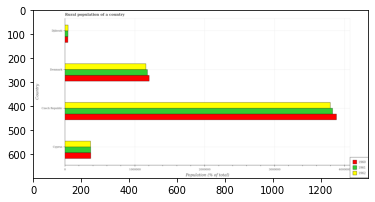

Number of QA =  29





,Country,1962,1961,1960
0,Djibouti,5.002179e+04,5.019782e+04,4.893277e+04
1,Cyprus,3.726233e+05,3.750717e+05,3.762439e+05
2,Czech Republic,3.820467e+06,3.811571e+06,3.869263e+06
3,Denmark,1.162796e+06,1.178747e+06,1.208887e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population in 1961 in czech republic and that in denmark ?
PREDICTED =  2632823.43850913
EXPECTED =  2648813.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population in 1961 in denmark and the rural population in 1960 in czech republic?
PREDICTED =  -2632823.43850913
EXPECTED =  -2704395.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population in 1961 and rural population in 1962 in cyprus ?
PREDICTED =  -372623.32200233726
EXPECTED =  2055.0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available

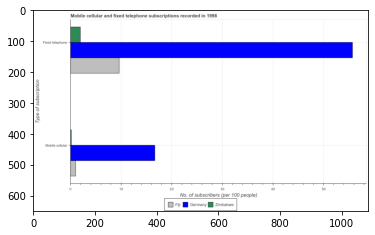

Number of QA =  23





,Type of subscription,Fiji,Zimbabwe,Germany
0,Fixed telephone,9.604042,2.035898,55.755107
1,Mobile cellular,1.091771,0.267096,16.832309


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of mobile cellular subscribers in fiji and that in germany ?
PREDICTED =  0.0
EXPECTED =  -15.662901981365481




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of mobile cellular subscribers in zimbabwe and the number of fixed telephone subscribers in germany ?
PREDICTED =  -1.0
EXPECTED =  -55.56871103819394




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of mobile cellular subscribers and number of fixed telephone subscribers in zimbabwe ?
PREDICTED =  -1.0
EXPECTED =  -1.778731755182144




				 0 / 3 = 0.0


is_

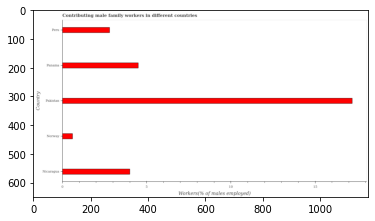

Number of QA =  22





,Country,Workers(% of males employed)
0,Norway,0.633296
1,Pakistan,17.165185
2,Nicaragua,4.015372
3,NaN,2.825244
4,Panama,4.536363


> what is the title of the graph ?
PREDICTED =  Contributing male family workers in different coi
EXPECTED =  Contributing male family workers in different countries




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Workers(% of males employed)
EXPECTED =  Workers(% of males employed)




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the contributing male family workers in nicaragua and norway ?
PREDICTED =  3.3820758424018016
EXPECTED =  3.4




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 3 / 5 = 0.6


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluati

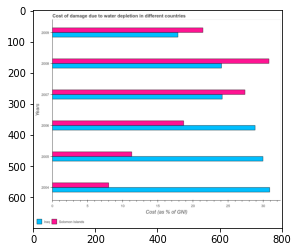

Number of QA =  28





,Years,Solomon Islands,Iraq
0,2009,NaN,NaN
1,2004,8.142749,31.415001
2,2008,30.855117,24.170860
3,2007,27.481515,24.327234
4,2006,18.637157,28.742566
5,2005,11.463198,30.172186


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to water depletion in solomon islands in 2008 and that in 2009 ?
PREDICTED =  30.85511655457793
EXPECTED =  9.397544148504302




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to water depletion in solomon islands in 2004 and the cost of damage caused due to water depletion in iraq in 2007 ?
PREDICTED =  -19.338766117922255
EXPECTED =  -16.16213500552824




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the cost of damage caused due to water depletion in solomon islands and

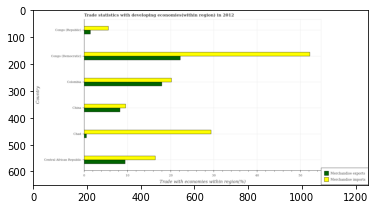

Number of QA =  28





,Country,Merchandise imports,Merchandise exports
0,China,9.728080,8.405640
1,Chad,NaN,0.660388
2,Congo (Democratic),NaN,22.226131
3,Congo (Republic),5.755621,1.519670
4,Colombia,20.358994,18.169434
5,Central African Republic,16.696033,9.562588


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in central african republic and that in chad ?
PREDICTED =  8.902200572641133
EXPECTED =  8.944




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in colombia and the merchandise exports in chad ?
PREDICTED =  nan
EXPECTED =  19.658104800995677




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports and merchandise imports in china ?
PREDICTED =  50.81577129325099
EXPECTED =  -1.314




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predictin

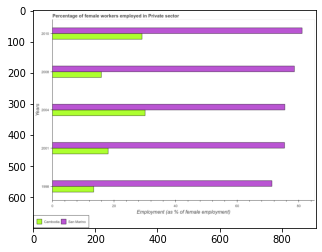

Number of QA =  28





,Years,Cambodia,San Marino
0,2001,18.333531,75.665486
1,2010,29.378844,81.325288
2,2008,16.164373,78.784777
3,2004,30.435067,75.653177
4,1998,13.860354,71.504669


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females employed in private sector in cambodia in 1998 and that in 2010 ?
PREDICTED =  -15.518490429918886
EXPECTED =  -15.700000762939391




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females employed in private sector in san marino in 2010 and the percentage of females employed in private sector in cambodia in 1998 ?
PREDICTED =  9.820619509993392
EXPECTED =  67.69999885559069




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the percentage of females employed in private sector in san marino

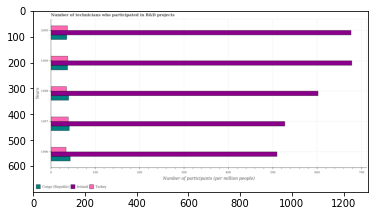

Number of QA =  29





,Years,Congo (Republic),Turkey,Ireland
0,1999,38.851843,39.028623,683.374896
1,1997,42.703750,40.467989,531.562165
2,2000,36.920571,38.475176,671.123978
3,1998,41.034522,36.763450,594.381779
4,1996,45.284095,35.344756,512.846791


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of technicians who participated in r&d projects in ireland in 1996 and that in 1999 ?
PREDICTED =  -1.0
EXPECTED =  -168.58204999999998




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of technicians who participated in r&d projects in turkey in 2000 and the number of technicians who participated in r&d projects in ireland in 1998 ?
PREDICTED =  0.0
EXPECTED =  -564.69319




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the number of technicians who participated in r&d projects in congo (republic) and number 

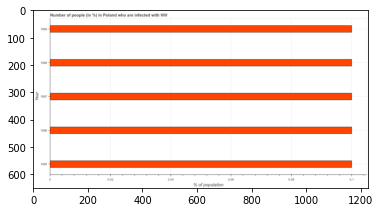

Number of QA =  23





,Year,% of population
0,1998,0.099898
1,1995,0.099621
2,1997,0.100634
3,1999,0.099604
4,1996,0.100016


> what is the title of the graph ?
PREDICTED =  Number of people (in %) in Poland who are infected with HIV
EXPECTED =  Number of people (in %) in Poland who are infected with HIV




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  % of population
EXPECTED =  % of population




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of people infected with hiv in 1996 and 1998 ?
PREDICTED =  0.00011786919023917819
EXPECTED =  0.0




				 3 / 4 = 0.75


> what is the median number of people infected with hiv ?
PREDICTED =  None
EXPECTED =  0.1




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio o

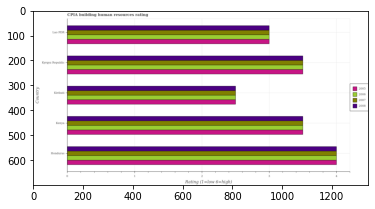

Number of QA =  30





,Country,2007,2005,2008,2006
0,Kiribati,2.503380,2.508030,2.507875,2.495711
1,Lao PDR,2.996497,2.995083,2.997948,3.013178
2,Kenya,3.487428,3.502267,3.493778,3.501437
3,Honduras,4.008357,4.019318,3.954877,3.989172
4,Kyrgyz Republic,3.492890,3.535339,3.499799,3.484679


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2005 in kyrgyz republic and that in lao pdr ?
PREDICTED =  0.5402565810786926
EXPECTED =  0.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2007 in kyrgyz republic and the cpia rating in 2006 in kenya?
PREDICTED =  0.005461617543145891
EXPECTED =  0.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2008 and cpia rating in 2007 in kyrgyz republic ?
PREDICTED =  -0.9850144157008796
EXPECTED =  0.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or p

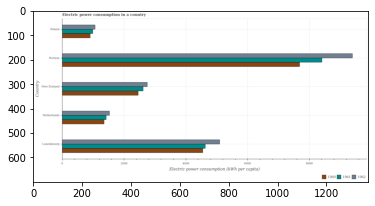

Number of QA =  29





,Country,1962,1961,1960
0,Poland,1075.144696,1005.621212,926.566361
1,New Zealand,2776.562074,2635.680384,2483.844881
2,Norway,9476.457005,8423.899909,7715.480820
3,Netherlands,1550.261970,1445.498526,1378.876326
4,Luxembourg,5111.228067,4662.215282,4559.048962


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the electric power consumption in in 1962 in new zealand and that in poland ?
PREDICTED =  1701.4173779274447
EXPECTED =  1689.6357769872202




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the electric power consumption in in 1962 in new zealand and the electric power consumption in in 1961 in norway?
PREDICTED =  -6699.894930355662
EXPECTED =  -5652.80770062372




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the electric power consumption in in 1961 and electric power consumption in in 1962 in netherlands ?
PREDICTED =  6873.637939501076
EXPECTE

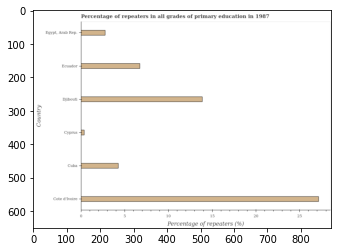

Number of QA =  22





,Country,Percentage of repeaters (%)
0,Cote d'Ivoire,27.046747
1,Ecuador,6.788550
2,Cuba,4.305235
3,Djibouti,13.847435
4,Cyprus,0.421061
5,"Egypt, Arab Rep.",2.816704


> what is the title of the graph ?
PREDICTED =  Percentage of repeaters in all grades of primary education in 1987
EXPECTED =  Percentage of repeaters in all grades of primary education in 1987




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Percentage of repeaters (%)
EXPECTED =  Percentage of repeaters (%)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of repeaters in primary education in cuba and egypt, arab rep. ?
PREDICTED =  1.4885310006770935
EXPECTED =  1.501




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of repeaters in primary education ?
PREDI

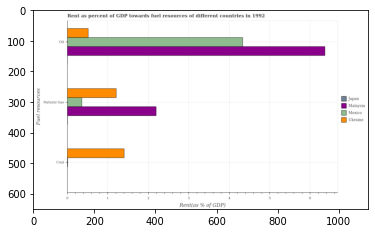

Number of QA =  28





,Fuel resources,Japan,Malaysia,Mexico,Ukraine
0,Coal,NaN,NaN,NaN,1.426248
1,Natural Gas,NaN,2.238382,0.374892,1.223354
2,Oil,NaN,6.441575,4.374223,0.524232


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rent towards natural gas in malaysia and that in ukraine ?
PREDICTED =  1.0150285056119592
EXPECTED =  0.98584828435694




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rent towards natural gas in japan and the rent towards oil in malaysia ?
PREDICTED =  0.0
EXPECTED =  -6.360207633340351




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rent towards coal and rent towards oil in mexico ?
PREDICTED =  -4.374223471829465
EXPECTED =  -4.322954133917102




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Train

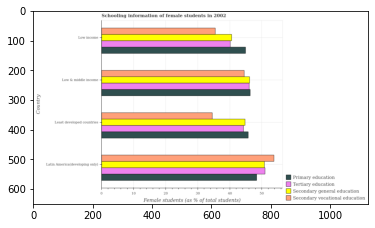

Number of QA =  30





,Country,Secondary vocational education,Tertiary education,Secondary general education,Primary education
0,Low & middle income,44.595891,NaN,46.599732,46.718855
1,Low income,35.618442,40.525520,40.939637,44.959101
2,Latin America(developing only),54.163800,51.472958,51.188742,48.947140
3,Least developed countries,34.658895,NaN,44.864550,45.903083


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female students in secondary vocational education in low & middle income and that in low income ?
PREDICTED =  0.0
EXPECTED =  9.036




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female students in secondary vocational education in low & middle income and the percentage of female students in tertiary education in low income ?
PREDICTED =  4.070371069674501
EXPECTED =  4.352188110351598




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Eval

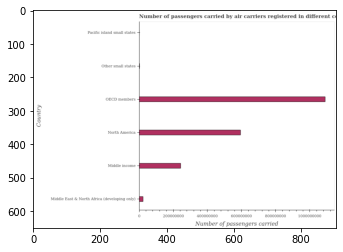

Number of QA =  22





,Country,Number of passengers carried
0,Other small states,NaN
1,Middle income,2.489461e+08
2,OECD members,1.101528e+09
3,Pacific island small states,NaN
4,North America,5.994901e+08
5,Middle East & North Africa (developing only),2.636174e+07


> what is the title of the graph ?
PREDICTED =  Number of passengers carried by air carriers registered in different c
EXPECTED =  Number of passengers carried by air carriers registered in different countries




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Number of passengers carried
EXPECTED =  Number of passengers carried




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of passengers carried in middle east & north africa (developing only) and middle income ?
PREDICTED =  -222584373.61441183
EXPECTED =  -220226200.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median n

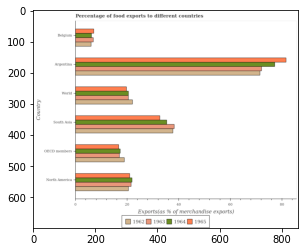

Number of QA =  30





,Country,1963,1964,1962,1965
0,Belgium,6.956825,6.370966,6.244132,7.269643
1,World,20.744204,20.803080,22.141683,20.015071
2,South Asia,NaN,35.754793,NaN,33.084847
3,Argentina,72.072097,77.202315,71.955752,81.800305
4,OECD members,17.367797,17.593314,18.964904,16.977044
5,North America,21.708026,22.218694,20.653248,21.290172


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in 1963 in oecd members and the percentage of exports to different countries in 1965 in world?
PREDICTED =  0.0
EXPECTED =  -2.7443971937704994




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is

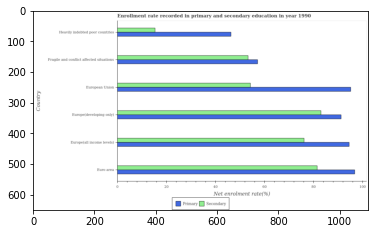

Number of QA =  28





,Country,Unnamed: 1,Secondary
0,Euro area,97.298938,81.932588
1,European Union,95.977805,54.799096
2,Europe(all income levels),95.366851,77.246391
3,Heavily indebted poor countries,46.818105,15.674294
4,Fragile and conflict affected situations,NaN,53.779674
5,Europe(developing only),NaN,83.502642


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in primary education in euro area and that in europe(all income levels) ?
PREDICTED =  -13.434262826305002
EXPECTED =  2.267




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in primary education and enrollment rate in secondary education in europe(developing only) ?
PREDICTED =  -22.34686154688564
EXPECTED =  8.208




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the 

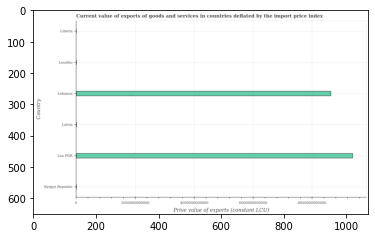

Number of QA =  22





,Country,Prive value of exports (constant LCU)
0,Lesotho,2.805792e+10
1,Lao PDR,9.315456e+12
2,Latvia,2.892468e+10
3,Liberia,NaN
4,Kyrgyz Republic,2.707042e+10
5,Lebanon,8.606459e+12


> what is the title of the graph ?
PREDICTED =  Current value of exports of goods and services in countries deflated by the import price index
EXPECTED =  Current value of exports of goods and services in countries deflated by the import price index




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Prive value of exports (constant LCU)
EXPECTED =  Prive value of exports (constant LCU)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the price value of exports in lebanon and liberia ?
PREDICTED =  8606458702888.103
EXPECTED =  8635256678684.645




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the 

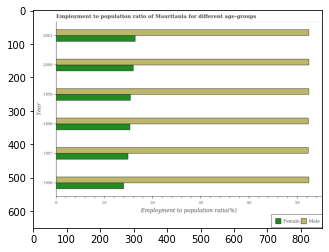

Number of QA =  28





,Year,Female,Male
0,2000,16.245898,53.086890
1,1999,15.804877,53.034207
2,1998,15.655735,52.506484
3,2001,16.775338,52.937447
4,1997,15.195540,52.813906
5,1996,14.253512,53.069436


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum employment to population ratio(male) ?
PREDICTED =  37.692921730483675
EXPECTED =  52.4000015258789




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum employment to population ratio(male) ?
PREDICTED =  38.01435275253389
EXPECTED =  52.2999992370605




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the employment to population ratio(female) maximum?
PREDICTED =  0.9975012493753124
EXPECTED =  2001



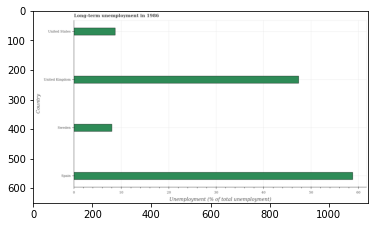

Number of QA =  22





,Country,Unemployment (% of total unemployment)
0,Sweden,8.229970
1,Spain,59.357735
2,United States,8.864618
3,United Kingdom,47.738161


> what is the title of the graph ?
PREDICTED =  Long-term unemployment in 1986
EXPECTED =  Long-term unemployment in 1986




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Unemployment (% of total unemployment)
EXPECTED =  Unemployment (% of total unemployment)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the long-term unemployment in spain and united states ?
PREDICTED =  50.49311654488169
EXPECTED =  50.1




				 4 / 4 = 1.0


> what is the median long-term unemployment ?
PREDICTED =  None
EXPECTED =  28.050000667572018




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the l

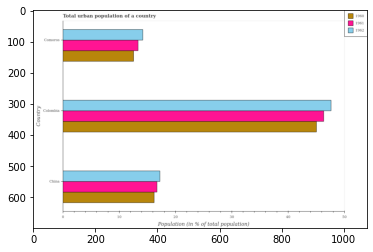

Number of QA =  29





,Country,1962,1961,1960
0,China,17.370108,16.871760,16.325009
1,Colombia,48.125836,46.453568,45.271340
2,Comoros,14.375268,13.537289,12.729700


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population in 1960 in china and that in comoros ?
PREDICTED =  3.595308481771248
EXPECTED =  3.6519999999999992




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population in 1960 in china and the urban population in 1961 in colombia?
PREDICTED =  -28.94633081597346
EXPECTED =  -30.124




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population in 1960 and urban population in 1961 in comoros ?
PREDICTED =  11.238060282490158
EXPECTED =  -0.7970000000000006




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_avail

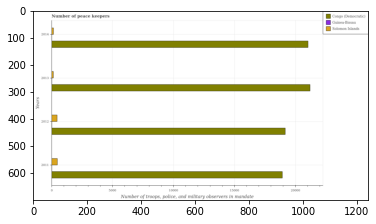

Number of QA =  29





,Years,Guinea-Bissau,Solomon Islands,Congo (Democratic)
0,2014,NaN,323.534224,37845.986127
1,2013,NaN,312.648580,38448.314635
2,2011,NaN,916.012521,34298.070158
3,2012,NaN,892.233609,34805.379568


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of peace keepers in in solomon islands in 2011 and that in 2013 ?
PREDICTED =  915.012520658761
EXPECTED =  327.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of peace keepers in in guinea-bissau in 2011 and the number of peace keepers in in congo (democratic) in 2012 ?
PREDICTED =  -1.0
EXPECTED =  -19149.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2014, what is the difference between the number of peace keepers in in congo (democratic) and number of peace keepers in in guinea-bissau ?
PREDICTED =  0.0
EXPECTED =  21022.0




				 0 

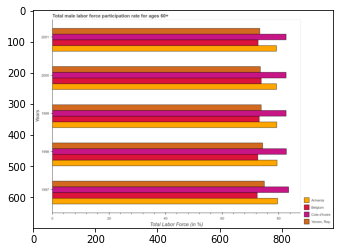

Number of QA =  30





,Years,Belgium,"Yemen, Rep.",Cote d'ivoire,Armenia
0,2000,74.206477,74.007527,82.304412,78.821500
1,2001,73.520528,73.406308,83.093633,79.556027
2,1997,72.812911,75.438001,84.067502,79.518433
3,1999,73.407946,74.235666,82.091765,79.565195
4,1998,73.448993,74.848271,82.777426,79.452598


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in cote d'ivoire in 1997 and that in 1999 ?
PREDICTED =  1.9757375719228065
EXPECTED =  0.9000015258790057




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in yemen, rep. in 1998 and the male labor force participation rate in belgium in 2001 ?
PREDICTED =  1.4419626012723086
EXPECTED =  1.6000061035155966




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the male labor force participation rate in belgium and male labor force participation rate in armeni

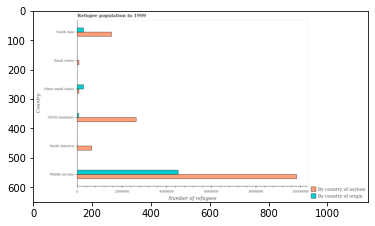

Number of QA =  28





,Country,By country of origin,By country of asylum
0,Middle income,4.559752e+06,9.790969e+06
1,North America,NaN,6.656075e+05
2,Small states,NaN,9.931193e+04
3,Other small states,2.957432e+05,9.379071e+04
4,South Asia,2.941407e+05,1.561049e+06
5,OECD members,7.767624e+04,2.670387e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of refugees by country of asylum in middle income and that in other small states ?
PREDICTED =  9597866.746919256
EXPECTED =  9754236




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of refugees by country of origin in south asia and the number of refugees by country of asylum in oecd members ?
PREDICTED =  -2376246.6253823433
EXPECTED =  -2362011




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of refugees by country of asylum and number of refugees by country of origin in south asia ?
PREDICTED =  14586974.8463729

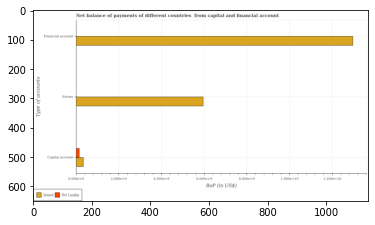

Number of QA =  23





,Type of accounts,Israel,Sri Lanka
0,Errors,6.042577,NaN
1,Capital account,0.366132,0.173837
2,Financial account,13.054524,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of net capital account in israel and that in sri lanka ?
PREDICTED =  -0.6338680060000959
EXPECTED =  191640000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of financial account in sri lanka and the amount of errors in israel ?
PREDICTED =  -13.054524020805554
EXPECTED =  -5949700000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of net capital account and amount of errors in israel ?
PREDICTED =  0.0
EXPECTED =  -5613700000.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
T

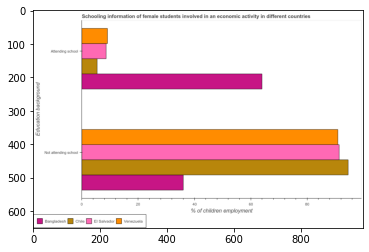

Number of QA =  23





,Education background,Chile,El Salvador,Venezuela,Bangladesh
0,Attending school,5.692024,8.888748,9.315956,64.115596
1,Not attending school,95.192880,91.929901,91.785696,36.200878


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed females who are attending school in el salvador and that in chile ?
PREDICTED =  0.0
EXPECTED =  3.1911735643000005




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of employed females who are attending school in el salvador to that in bangladesh ?
PREDICTED =  0.13863627945232218
EXPECTED =  0.13469200210898233




				 1 / 4 = 0.25


> what is the di

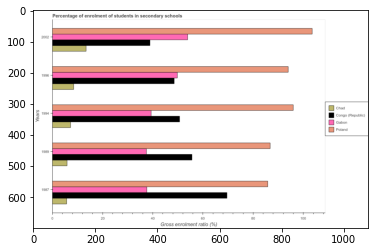

Number of QA =  30





,Years,Congo (Republic),Chad,Poland,Gabon
0,2002,38.782617,13.788369,104.154093,53.273514
1,1987,69.402096,5.787908,85.612175,37.850260
2,1994,50.830942,7.498783,95.850279,38.622985
3,1996,48.559929,8.700154,93.895991,NaN
4,1989,55.204056,6.039867,87.360961,37.292670


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of students enrolled in secondary schools in congo (republic) in 1987 and that in 1996 ?
PREDICTED =  20.842167007319738
EXPECTED =  21.0372




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of students enrolled in secondary schools in gabon in 1987 and the percentage of students enrolled in secondary schools in chad in 1994 ?
PREDICTED =  -0.7727250468551361
EXPECTED =  30.39772




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the percentage of students enrolled in secondary schools in chad and percen

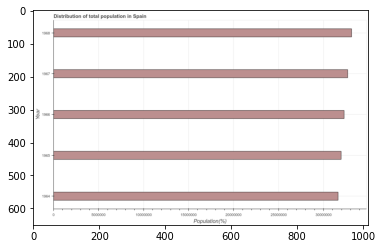

Number of QA =  23





,Year,Population(%)
0,1968,5.941019e+07
1,1964,5.696558e+07
2,1965,5.750245e+07
3,1967,5.870156e+07
4,1966,5.845380e+07


> what is the title of the graph ?
PREDICTED =  Distribution of total population in Spain
EXPECTED =  Distribution of total population in Spain 




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Population(%)
EXPECTED =  Population(%)




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the population in 1964 and 1967 ?
PREDICTED =  -1735982.1380948946
EXPECTED =  -1073752.0




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median population ?
PREDICTED =  58453800.46357071
EXPECTED =  32283194.0




				 2 / 5 = 0.4


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting .

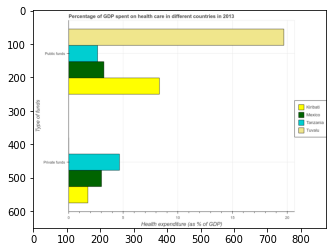

Number of QA =  23





,Type of funds,Tuvalu,Mexico,Tanzania,Kiribati
0,Public funds,19.830749,3.256372,2.720159,8.377114
1,Private funds,NaN,3.058819,4.769079,1.823694


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of private funds spent in healthcare in tuvalu and the amount of public funds spent in healthcare in mexico ?
PREDICTED =  -5.315190601989929
EXPECTED =  -3.2119016163650764




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount of private funds spent in healthcare in tanzania to that in tuvalu ?
PREDICTED =  0.24048911432499412
EXPECTED =  304.6032202044685




				 0 / 4 = 0.

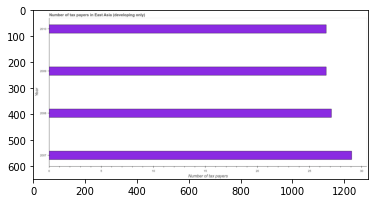

Number of QA =  23





,Year,Number of tax payers
0,2009,26.676648
1,2010,26.606083
2,2008,27.094772
3,2007,29.112483


> what is the title of the graph ?
PREDICTED =  Number of tax payers in East Asia (developing only)
EXPECTED =  Number of tax payers in East Asia (developing only)




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Number of tax payers
EXPECTED =  Number of tax payers




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tax payers in 2007 and 2009 ?
PREDICTED =  2.4358349813504496
EXPECTED =  2.444




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of tax payers ?
PREDICTED =  2008.5
EXPECTED =  26.86111111111111




				 4 / 5 = 0.8


is_built_with_cuda: True
is_gpu_available:

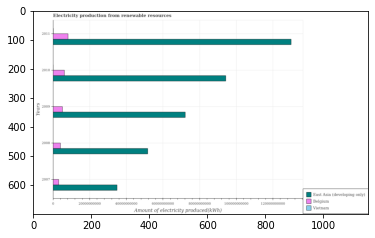

Number of QA =  29





,Years,East Asia (developing only),Belgium,Vietnam
0,2010,9.502604e+10,6.548098e+09,NaN
1,2008,5.192511e+10,4.315868e+09,NaN
2,2011,1.304607e+11,8.471647e+09,NaN
3,2009,7.181664e+10,5.422106e+09,NaN
4,2007,3.526328e+10,3.368458e+09,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of electricity produced in vietnam in 2008 and that in 2009 ?
PREDICTED =  -19891529082.9318
EXPECTED =  -16000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of electricity produced in belgium in 2010 and the amount of electricity produced in vietnam in 2009 ?
PREDICTED =  1125992078.9440508
EXPECTED =  6110000000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount of

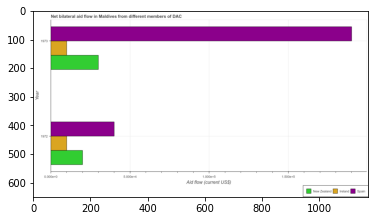

Number of QA =  26





,Year,Spain,lreland,New Zealand
0,1973,34.289835,1.862252,5.449069
1,1972,7.295320,1.844642,3.679897


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid provided by new zealand in 1972 and that in 1973 ?
PREDICTED =  -1.7691722370355762
EXPECTED =  -10000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid provided by spain in 1972 and the amount of aid provided by new zealand in 1973 ?
PREDICTED =  -26.99451419296753
EXPECTED =  10000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1973, what is the difference between the amount of aid provided by spain and amount of aid provided by ireland ?
PREDICTED =  0.0
EXPECTED =  180000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_

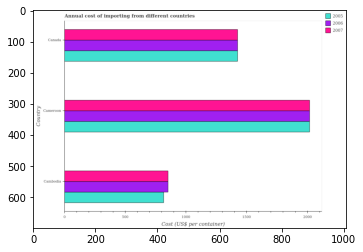

Number of QA =  29





,Country,2007,2005,2006
0,Cambodia,1548.621290,1483.247882,1539.266418
1,Canada,2579.845422,2582.500378,2555.012273
2,Cameroon,3647.520582,3636.223147,3654.684479


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual cost of importing in 2005 in cambodia and that in cameroon ?
PREDICTED =  -2152.975265258656
EXPECTED =  -1202.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual cost of importing in 2005 in cameroon and the total annual cost of importing in 2006 in cambodia?
PREDICTED =  2152.975265258656
EXPECTED =  1166.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual cost of importing in 2007 and total annual cost of importing in 2006 in canada ?
PREDICTED =  5220.975020680387
EXPECTED =  0.0




				 0 / 3 =

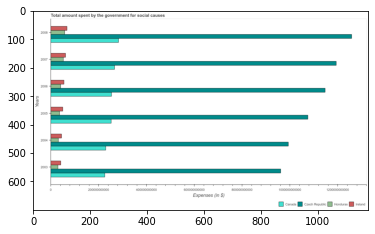

Number of QA =  30





,Years,Ireland,Czech Republic,Honduras,Canada
0,2008,6.883578e+10,1.250761e+12,6.051191e+10,2.852893e+11
1,2006,5.639086e+10,1.146310e+12,4.236262e+10,NaN
2,2004,4.625672e+10,9.927240e+11,3.311653e+10,2.307847e+11
3,2005,5.166542e+10,1.071493e+12,3.825757e+10,2.513334e+11
4,2007,6.368723e+10,1.204152e+12,5.416330e+10,2.674229e+11
5,2003,4.329983e+10,9.636557e+11,3.171173e+10,2.272378e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent for social causes by the government in honduras in 2004 and that in 2008 ?
PREDICTED =  -27395375315.787483
EXPECTED =  -26294406000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent for social causes by the government in honduras in 2004 and the amount spent for social causes by the government in czech republic in 2006 ?
PREDICTED =  -9246087427.451378
EXPECTED =  -1115574350000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the amount spent for social causes by the government in honduras an

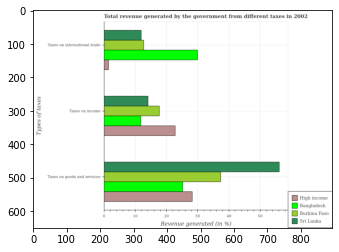

Number of QA =  28





,Types of taxes,Bangladesh,Burkina Faso,Sri Lanka,High income
0,Taxes on goods and services,25.538810,37.608281,56.342842,28.508953
1,Taxes on income,11.927161,17.990257,14.103561,23.164870
2,Taxes on international trade,30.265718,12.848184,12.021358,1.486624


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue generated by taxes on income in sri lanka and that in high income ?
PREDICTED =  0.0
EXPECTED =  -8.713572321071599




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue generated by taxes on goods and services in burkina faso and the percentage of revenue generated by tax on international trade in sri lanka ?
PREDICTED =  -11.848184469747741
EXPECTED =  25.457247984453403




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue generated by taxes on goods and services and percentage 

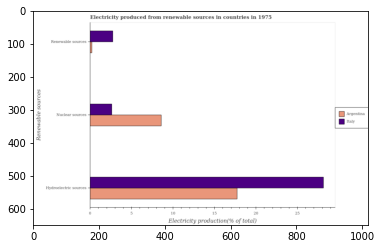

Number of QA =  28





,Renewable sources,Italy,Argentina
0,Renewable sources,2.763839,0.244565
1,Hydroelectric sources,28.226664,17.846270
2,Nuclear sources,2.663594,8.589063


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by nuclear sources in argentina and that in italy ?
PREDICTED =  5.92546899383904
EXPECTED =  5.97115168160853




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by hydroelectric sources in argentina and the percentage of electricity produced by renewable sources in italy ?
PREDICTED =  16.8462700432061
EXPECTED =  14.990546065148232




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by hydroelectric sources and percentage of electricity

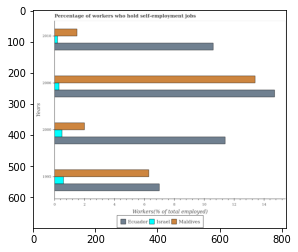

Number of QA =  29





,Years,Israel,Maldives,Ecuador
0,2010,0.231761,1.538793,10.628961
1,2000,0.531198,2.029703,11.410036
2,2006,0.332246,13.448926,14.721634
3,1995,0.637660,6.322000,7.045617


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers in israel in 1995 and that in 2010 ?
PREDICTED =  0.40589921408392104
EXPECTED =  0.4000000208616259




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers in maldives in 2006 and the percentage of self-employed workers in israel in 2000 ?
PREDICTED =  12.917727973625997
EXPECTED =  12.8999996185303




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the percentage of self-employed workers in israel and percentage of self-employed workers in ecuador ?
PREDICTED

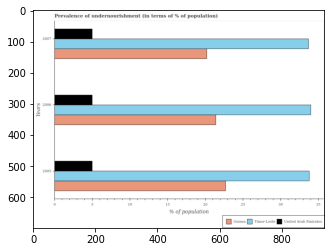

Number of QA =  29





,Years,Timor-Leste,United Arab Emirates,Guinea
0,2007,33.502837,5.073292,NaN
1,2005,33.967217,5.150920,22.903156
2,2006,33.735144,5.118814,21.584865


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished population in timor-leste in 2005 and that in 2007 ?
PREDICTED =  0.4643798665218597
EXPECTED =  0.09999999999999432




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished population in timor-leste in 2005 and the percentage of undernourished population in united arab emirates in 2007 ?
PREDICTED =  0.4643798665218597
EXPECTED =  28.799999999999997




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the percentage of undernourished population in timor-leste and percentage of

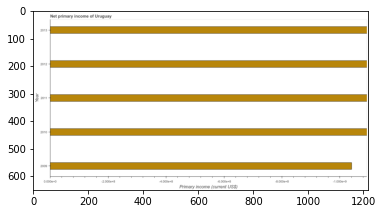

Number of QA =  12





,Year,Primary income (current US$)
0,2012,10.918928
1,2013,10.942190
2,2009,10.356444
3,2011,10.938672
4,2010,10.888642


> what is the title of the graph ?
PREDICTED =  Net primary income of Uruguay
EXPECTED =  Net primary income of Uruguay




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Primary income (current US$)
EXPECTED =  Primary income (current US$)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median amount of primary income ?
PREDICTED =  2011.0
EXPECTED =  0.0




				 3 / 4 = 0.75


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Primary income (current US$)
EXPECTED =  200000000.0




				 3 / 5 = 0.6


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the amount of primary income in 2009 ?
EXPECTED =  0


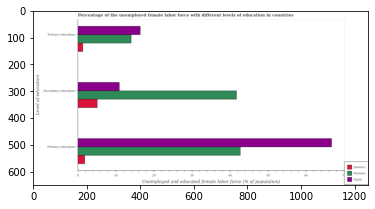

Number of QA =  28





,Level of education,Spain,Panama,Jamaica
0,Tertiary education,16.615963,14.189542,1.372883
1,Primary education,67.434714,43.403034,1.898634
2,Secondary education,11.040126,41.928473,5.189949


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received tertiary education in spain and that in jamaica ?
PREDICTED =  15.243080034151044
EXPECTED =  15.099999666214018




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received tertiary education in panama and the percentage of female labor force who received secondary education in jamaica ?
PREDICTED =  12.81665817065569
EXPECTED =  8.90000009536743




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received primary education

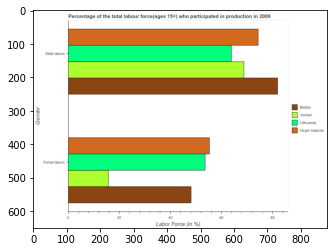

Number of QA =  23





,Gender,Belize,Jordan,Lithuania,Virgin Islands
0,Male labors,81.939978,69.516205,64.140344,74.679014
1,Femal labors,48.441314,15.926622,54.017928,55.958061


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force in lithuania and that in jordan ?
PREDICTED =  -15.498277649863972
EXPECTED =  37.899998664856




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force in jordan and the percentage of male labour force in virgin islands ?
PREDICTED =  -5.16280856070145
EXPECTED =  -58.700001716613805




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labour force and percentage of female labor force in virgin islands ?
PREDICTED =  -73.67901385055261
EXPECTED =  19.10000228881841

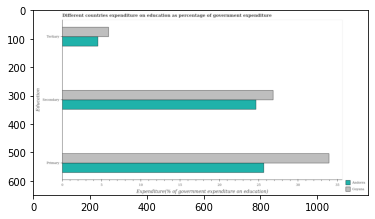

Number of QA =  28





,Education,Andorra,Guyana
0,Primary,25.725866,33.944114
1,Tertiary,4.614591,6.012877
2,Secondary,24.768240,26.966824


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure on primary education in andorra and that in guyana ?
PREDICTED =  -8.218248865065089
EXPECTED =  -8.301439285278299




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure on tertiary education in guyana and the expenditure on primary education in andorra ?
PREDICTED =  1.3982861093380388
EXPECTED =  -19.750489234924313




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure on primary education and expenditure on secondary education in andorra ?
PREDICTED =  -24.768239810335732
EXPECTED =  0.9939193725586009




	

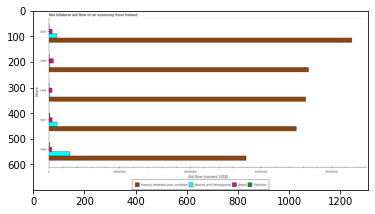

Number of QA =  30





,Years,Heavily indebted poor countries,Bosnia and Herzegovina,Brazil,Pakistan
0,1999,7.297549e+07,3.995897e+05,1.354344e+06,NaN
1,2000,8.610704e+07,2.314390e+06,1.042587e+06,NaN
2,1998,7.285480e+07,NaN,9.470352e+05,NaN
3,1996,5.569022e+07,6.074252e+06,8.619564e+05,NaN
4,1997,6.990241e+07,2.419960e+06,1.004909e+06,339025.298952


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in pakistan in 1996 and that in 1999 ?
PREDICTED =  0.0
EXPECTED =  80000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in heavily indebted poor countries in 1998 and the net bilateral aid flow in bosnia and herzegovina in 1997 ?
PREDICTED =  2952389.6719077528
EXPECTED =  70320000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the net bilateral aid flow in bosnia and herzegovina and net bilateral aid flow in brazil ?
PREDICTED =  0.0
EXPECTED =  1390000.0




				 0 /

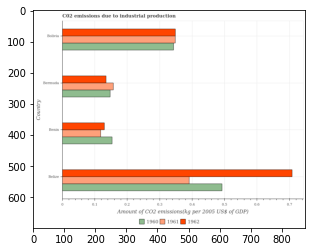

Number of QA =  29





,Country,1962,1961,1960
0,Belize,0.709317,0.396898,0.496786
1,Bolivia,0.351507,0.352638,0.347464
2,Benin,0.131769,0.120786,0.153601
3,Bermuda,0.137045,0.160385,0.149901


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted due to industrial production in 1962 in benin and that in bolivia ?
PREDICTED =  -0.21973712483950691
EXPECTED =  -0.21886136934826703




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted due to industrial production in 1960 in belize and the amount of co2 emitted due to industrial production in 1961 in bermuda?
PREDICTED =  0.3468852580348063
EXPECTED =  0.334926077645639




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted due to industrial production in 1962 and amount of co2 

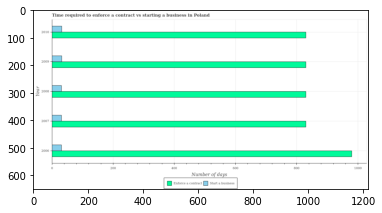

Number of QA =  28





,Year,Enforce a contract,Start a business
0,2009,836.519442,33.685193
1,2010,839.196537,33.842513
2,2006,991.630531,33.146096
3,2007,834.637620,32.989415
4,2008,839.119194,32.863181


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days to enforece a contract in 2006 and that in 2007 ?
PREDICTED =  156.9929106616272
EXPECTED =  150




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days to enforece a contract in 2009 and the number of days to start a business in 2008 ?
PREDICTED =  -838.1191943069618
EXPECTED =  799




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the number of days to enforece a contract and number of days to start a business ?
PREDICTED =  0.0
EXPECTED =  949




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_g

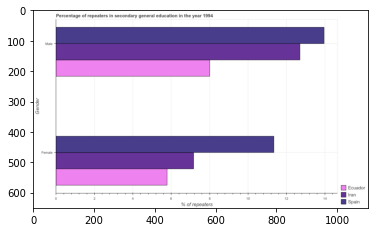

Number of QA =  23





,Gender,Spain,lran,Ecuador
0,Male,13.944650,12.811751,8.039964
1,Female,11.355219,7.175956,5.755318


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male repeaters in ecuador and that in spain ?
PREDICTED =  -5.9046860590700945
EXPECTED =  -5.9539100000000005




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female repeaters in ecuador and the percentage of male repeaters in iran ?
PREDICTED =  5.755318405346477
EXPECTED =  -6.9189099999999994




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female repeaters and percentage of male repeaters in iran ?
PREDICTED =  5.755318405346477
EXPECTED =  -5.5369399999999995




				 1 / 3 = 0.3333


is_b

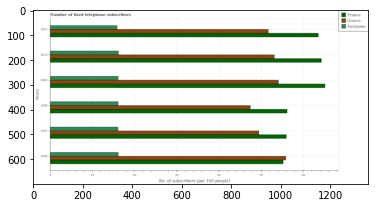

Number of QA =  29





,Years,Greece,France,Suriname
0,2008,47.585624,56.804078,16.357873
1,2011,52.411323,64.058267,15.990191
2,2010,53.555408,64.766148,16.515145
3,2009,54.362103,66.118591,16.171134
4,2006,56.477736,55.717208,16.361842
5,2007,49.809677,56.746841,16.375768


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of fixed telephone subscribers in suriname in 2007 and that in 2010 ?
PREDICTED =  -0.1393769457727494
EXPECTED =  -0.11872669518190193




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of fixed telephone subscribers in greece in 2006 and the number of fixed telephone subscribers in france in 2011 ?
PREDICTED =  -7.580530878652922
EXPECTED =  -7.664180488902616




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the number of fixed telephone subscribers in suriname and number of fixed telephone subscribers in fra

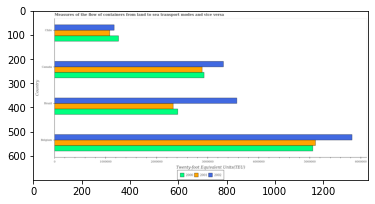

Number of QA =  29





,Country,2002,2000,2001
0,Chile,1.189251e+06,1.269976e+06,1.093512e+06
1,Canada,3.325921e+06,2.937929e+06,2.901714e+06
2,Brazil,3.525766e+06,2.406439e+06,2.328975e+06
3,Belgium,5.830794e+06,5.087416e+06,5.110163e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the container port traffic in 2000 in belgium and that in canada ?
PREDICTED =  2149486.849933374
EXPECTED =  2129637.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the container port traffic in 2001 in chile and the container port traffic in 2002 in belgium?
PREDICTED =  -4016651.6150251604
EXPECTED =  -4745065.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the container port traffic in 2000 and container port traffic in 2002 in brazil ?
PREDICTED =  -600326.1709394688
EXPECTED =  -1157162.0




				 1 / 3 = 0.3333


is_built_with_cuda: Tr

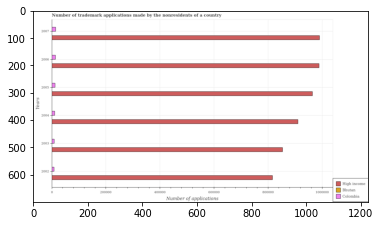

Number of QA =  29





,Years,Bhutan,Colombia,High income
0,2004,NaN,11779.673473,916258.176836
1,2006,NaN,14758.211546,991387.751588
2,2005,NaN,13272.301087,965042.942082
3,2007,NaN,16290.180273,990222.379680
4,2003,NaN,10475.064117,859359.942881
5,2002,NaN,10086.547348,821701.770777


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by the nonresidents in bhutan in 2002 and that in 2007 ?
PREDICTED =  0.0
EXPECTED =  -6.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by the nonresidents in colombia in 2005 and the number of trademark applications made by the nonresidents in high income in 2002 ?
PREDICTED =  0.0
EXPECTED =  -804424.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the number of trademark applications made by the nonresidents in bhutan and number of tradema

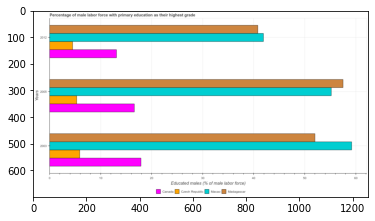

Number of QA =  30





,Years,Czech Republic,Macao,Madagascar,Canada
0,2012,4.485831,41.999207,40.783335,13.450869
1,2005,5.262708,54.948465,58.160533,16.719010
2,2003,6.037604,58.942413,52.063192,18.127426


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force with primary education in madagascar in 2005 and that in 2012 ?
PREDICTED =  17.37719815113301
EXPECTED =  16.700000762939503




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force with primary education in czech republic in 2005 and the percentage of male labor force with primary education in macao in 2012 ?
PREDICTED =  0.7768772739989602
EXPECTED =  -36.600001335144036




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of male labor force with primary 

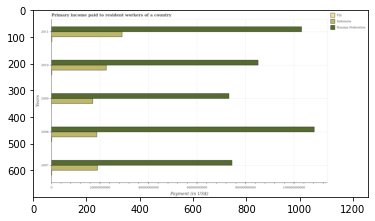

Number of QA =  29





,Years,Fiji,Russian Federation,Indonesia
0,2007,NaN,7.483451e+10,1.908671e+10
1,2011,NaN,1.035563e+11,2.950374e+10
2,2010,NaN,8.589195e+10,2.305157e+10
3,2008,NaN,1.083129e+11,1.921174e+10
4,2009,NaN,7.372710e+10,1.731506e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the amount paid to workers in russian federation maximum?
PREDICTED =  1.0004980079681276
EXPECTED =  2008




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the total amount paid to workers in russian federation in the graph ?
PREDICTED =  1.1202655226924067e-11
EXPECTED =  444107557541




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount paid to workers in russian federation in 2008 and that in 2011 ?
PREDICTED =  1.0
EXPECTED =  5216000000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after trai

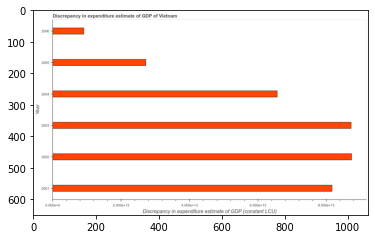

Number of QA =  23





,Year,Discrepancy in expenditure estimate of GDP (constant LCU)
0,2006,0.933079
1,2003,8.736359
2,2005,2.728601
3,2001,8.188707
4,2004,6.590372
5,2002,8.759843


> what is the title of the graph ?
PREDICTED =  Discrepancy in expenditure estimate of GDP of Vietnam
EXPECTED =  Discrepancy in expenditure estimate of GDP of Vietnam




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Discrepancy in expenditure estimate of GDP (constant LCU)
EXPECTED =  Discrepancy in expenditure estimate of GDP (constant LCU)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the discrepancy in expenditure estimate of gdp in 2002 and 2006 ?
PREDICTED =  7.82676373471959
EXPECTED =  78251537430500.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median discrepancy in expenditure e

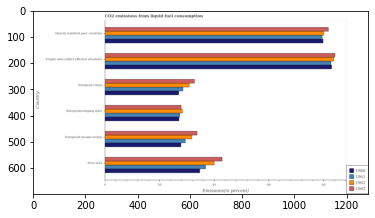

Number of QA =  30





,Country,1963,1962,1961,1960
0,Fragile and conflict affected situations,84.360707,NaN,82.914669,83.460436
1,Euro area,43.301279,NaN,37.507018,34.964458
2,Heavily indebted poor countries,81.935234,80.807533,79.622872,80.332956
3,Europe(all income levels),NaN,NaN,29.862394,28.305811
4,European Union,33.015479,31.084480,NaN,27.486955
5,Europe(developing only),28.423988,28.773540,27.919736,27.498204


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1963 in europe(all income levels) and that in european union ?
PREDICTED =  -33.015478729121035
EXPECTED =  0.9706228641741106




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1960 in heavily indebted poor countries and the total co2 emitted in 1962 in european union?
PREDICTED =  -0.4745775261059464
EXPECTED =  48.946088443003305




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1963 and total co2 emitted in 1961 in euro area ?
PREDICTED =  -32.507017911083075
EXPECTED =  6.

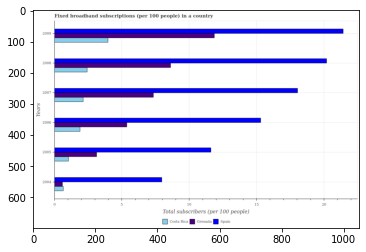

Number of QA =  29





,Years,Grenada,Spain,Costa Rica
0,2008,8.617093,20.199602,2.459155
1,2005,3.132718,11.550463,1.086851
2,2009,11.880133,21.476248,4.080919
3,2007,7.339731,18.455118,2.164705
4,2004,0.632481,7.968137,0.694765
5,2006,5.430604,15.344030,1.958870


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of broadband subscriptions in grenada in 2005 and that in 2008 ?
PREDICTED =  -5.484374917677224
EXPECTED =  -5.48560423199906




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of broadband subscriptions in spain in 2004 and the number of broadband subscriptions in costa rica in 2005 ?
PREDICTED =  -3.582326112345342
EXPECTED =  6.92426785938021




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the number of broadband subscriptions in grenada and number of broadband subscriptions in costa rica ?
PREDICTED =  0.

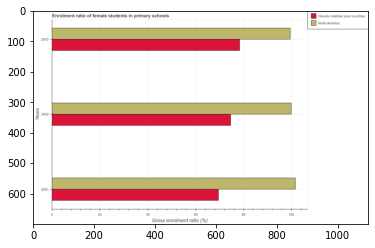

Number of QA =  28





,Years,North America,Heavily indebted poor countries
0,2003,101.381316,78.538945
1,2002,100.710369,75.070260
2,2001,101.668112,70.135650


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the enrolment ratio of female students in primary schools in north america in 2002 ?
PREDICTED =  33.57012299031616
EXPECTED =  99.91156005859379




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum enrolment ratio of female students in primary schools in heavily indebted poor countries ?
PREDICTED =  26.17964818211206
EXPECTED =  78.364372253418




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum enrolment ratio of female students in primary schools in heavily indebted poor countries ?
PREDICTED =  23.378549919941893
EXPECTED =  69.50582885742189




				 0 / 3 =

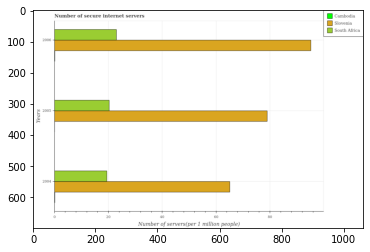

Number of QA =  29





,Years,Cambodia,Slovenia,South Africa
0,2006,NaN,95.943182,23.489887
1,2004,NaN,65.418603,19.853050
2,2005,NaN,79.453174,20.605111


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of secure internet servers in cambodia in 2004 and that in 2005 ?
PREDICTED =  0.0
EXPECTED =  0.07745339822715751




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of secure internet servers in south africa in 2004 and the number of secure internet servers in cambodia in 2005 ?
PREDICTED =  0.0
EXPECTED =  19.37805726386248




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the number of secure internet servers in south africa and number of secure internet servers in cambodia ?
PREDICTED =  0.0
EXPECTED =  19.3

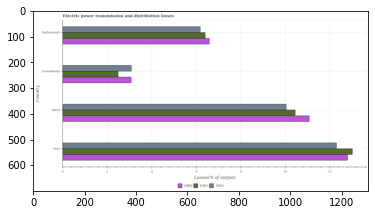

Number of QA =  29





,Country,1962,1961,1960
0,Italy,12.320048,13.093878,12.947228
1,Luxembourg,3.132350,2.523890,3.114090
2,Netherlands,6.213557,6.412319,6.568419
3,Japan,10.083326,10.486578,11.103103


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the electric power transmission and distribution losses in 1962 in italy and the electric power transmission and distribution losses in 1961 in japan?
PREDICTED =  -18.40337390942898
EXPECTED =  1.8552940306972001




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the electric power transmission and distribution losses in 1960 and electric power transmission and distribution losses in 1962 in luxembourg ?
PREDICTED =  0.8859101135851155
EXPECTED =  -0.008421289018639921




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: F

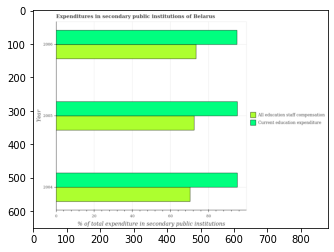

Number of QA =  28





,Year,All education staff compensatior,Current education expenditure
0,2006,74.357969,95.988384
1,2004,71.149153,96.440734
2,2005,73.454323,97.201436


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in education in 2005 and that in 2006 ?
PREDICTED =  1.2130515411418372
EXPECTED =  0.215




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in staff compensation in 2004 and the expenditure in education in 2006 ?
PREDICTED =  0.4523498035763538
EXPECTED =  -24.612770080566406




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the expenditure in staff compensation and expenditure in education ?
PREDICTED =  0.0
EXPECTED =  -22.678




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
G

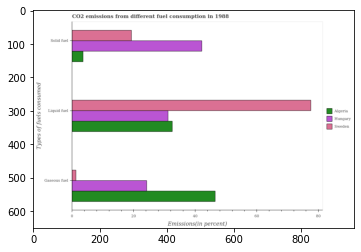

Number of QA =  28





,Types of fuels consumed,Sweden,Algeria,Hungary
0,Solid fuel,19.577595,3.794067,42.411866
1,Liquid fuel,77.895251,32.858676,31.511697
2,Gaseous fuel,1.474332,47.045614,24.596804


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of gaseous fuel emission in algeria and that in sweden ?
PREDICTED =  45.57128187508053
EXPECTED =  45.225555003948536




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of liquid fuel emission in sweden to that in algeria ?
PREDICTED =  2.370614422525287
EXPECTED =  2.383746051627904




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: [

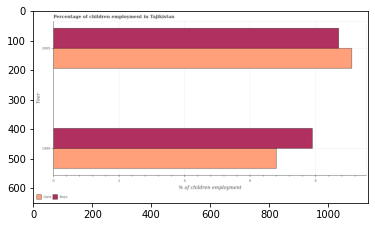

Number of QA =  25





,Year,Girls,Boys
0,1999,6.830335,7.859334
1,2005,9.232801,8.815297


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed girls in 1999 and that in 2005 ?
PREDICTED =  -2.4024657872381514
EXPECTED =  -2.3




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed boys in 2005 and the percentage of employed girls in 1999 ?
PREDICTED =  0.9559630015763076
EXPECTED =  1.8999999999999995




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the percentage of employed boys and percentage of employed girls ?
PREDICTED =  1.0289991615634708
EXPECTED =  1.1




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_avail

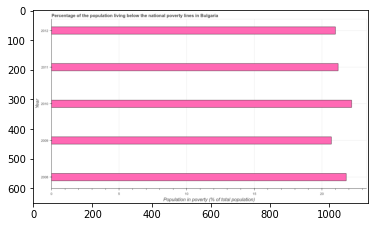

Number of QA =  23





,Year,Population in poverty (% of total population)
0,2012,20.912935
1,2008,21.842320
2,2011,21.215935
3,2009,20.801535
4,2010,22.157300


> what is the title of the graph ?
PREDICTED =  Percentage of the population living below the national poverty lines in Bulgaria
EXPECTED =  Percentage of the population living below the national poverty lines in Bulgaria




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Population in poverty (% of total population)
EXPECTED =  Population in poverty (% of total population)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population living below poverty line in 2010 and 2011 ?
PREDICTED =  42.01747000399211
EXPECTED =  1.0




				 3 / 4 = 0.75


> what is the median percentage of population living below poverty line ?
PREDICTED =  None
EXPECTED =  21.2




				 3 / 6 = 0.5


is_built_with_cuda: True

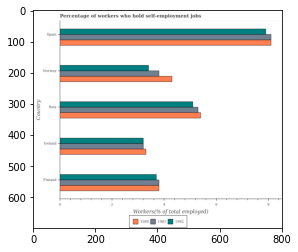

Number of QA =  29





,Country,1982,1980,1981
0,Ireland,3.239029,3.310937,3.239715
1,Spain,7.924536,8.155762,8.106171
2,Finland,3.728279,3.840270,NaN
3,Italy,5.132132,5.472325,5.338087
4,Norway,3.426081,NaN,3.849825


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers in 1981 in italy and that in spain ?
PREDICTED =  -2.768084362008289
EXPECTED =  -2.8000001907348677




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers in 1981 in italy and the percentage of self-employed workers in 1982 in ireland?
PREDICTED =  2.0983722568636116
EXPECTED =  2.1000001430511426




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers in 1982 and percentage of self-employed workers in 1981 in spain ?
PREDICTED =  -4.86714252

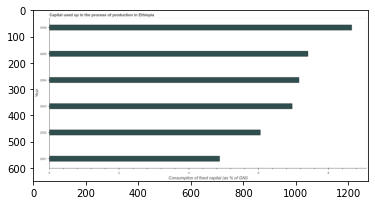

Number of QA =  23





,Year,Consumption of fixed capital (as % of GNI)
0,2005,7.428583
1,2006,8.766441
2,2001,4.902858
3,2004,7.176477
4,2003,6.988740
5,2002,6.065276


> what is the title of the graph ?
PREDICTED =  Capital used up in the process of production in Ethiopia
EXPECTED =  Capital used up in the process of production in Ethiopia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Consumption of fixed capital (as % of GNI)
EXPECTED =  Consumption of fixed capital (as % of GNI)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the consumption of fixed capital in 2003 and 2006 ?
PREDICTED =  -1.7777010540219287
EXPECTED =  -1.707




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median consumption of fixed capital ?
PREDICTED =  7.0826085331427215
EXPECTED = 

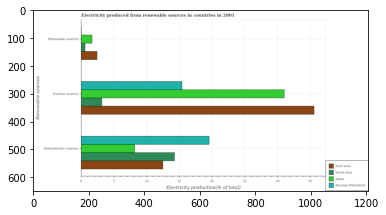

Number of QA =  28





,Renewable sources,Japan,South Asia,Russian Federation,Euro area
0,Hydroelectric sources,8.373391,14.456755,19.778919,12.699153
1,Renewable sources,1.756971,0.699162,NaN,2.515719
2,Nuclear sources,31.165980,3.265550,15.582326,35.984899


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by nuclear sources in south asia and that in russian federation ?
PREDICTED =  0.3333333333333333
EXPECTED =  -12.25157542571726




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by hydroelectric sources in russian federation and the percentage of electricity produced by renewable sources in japan ?
PREDICTED =  0.3333333333333333
EXPECTED =  17.89979780119765




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by nuclear sources and per

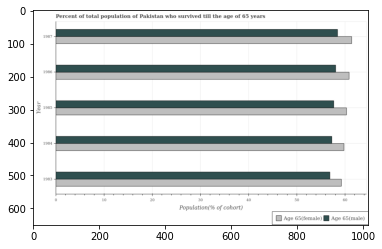

Number of QA =  28





,Year,Age 65(male),Age 65(female)
0,1983,57.205888,60.039592
1,1986,58.134716,60.892546
2,1985,57.950519,60.437343
3,1987,58.977026,61.819286
4,1984,57.819296,60.236697


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male population who survived till age of 65 in 1983 and that in 1987 ?
PREDICTED =  -1.7711383855604836
EXPECTED =  -1.586




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male population who survived till age of 65 in 1987 and the percentage of female population who survived till age of 65 in 1983 ?
PREDICTED =  1.7711383855604836
EXPECTED =  -0.7899399999999943




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1985, what is the difference between the percentage of female population who survived till age of 65 and percentage of mal

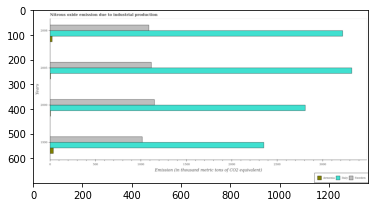

Number of QA =  29





,Years,Sweden,Armenia,Italy
0,2008,1984.881886,50.587321,5823.426225
1,2005,2027.049879,19.458293,6032.693201
2,1990,1847.929458,75.532963,4304.291279
3,2000,NaN,NaN,5075.554032


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of nitrous oxide emitted in sweden in 2005 and that in 2008 ?
PREDICTED =  42.16799313787806
EXPECTED =  27.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of nitrous oxide emitted in italy in 1990 and the amount of nitrous oxide emitted in sweden in 2000 ?
PREDICTED =  -771.2627527108252
EXPECTED =  1203.8999999999999




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the amount of nitrous oxide emitted in armenia and amount of nitrous oxide emitted in italy ?
PREDICTED =  -10317.526187720785
EXPECTED =  -2

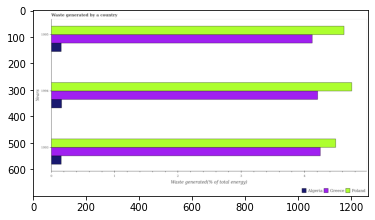

Number of QA =  29





,Years,Algeria,Greece,Poland
0,1993,0.164760,4.222781,4.491813
1,1995,0.164715,4.148350,4.609681
2,1994,0.170041,4.223754,4.777143


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total waste generated in greece in 1993 and that in 1994 ?
PREDICTED =  -0.0009730116370088027
EXPECTED =  0.04213884281332003




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total waste generated in poland in 1993 and the total waste generated in algeria in 1995 ?
PREDICTED =  -0.11786854800426116
EXPECTED =  4.3349368795483505




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1994, what is the difference between the total waste generated in greece and total waste generated in algeria ?
PREDICTED =  12.095368066871096
EXPECTED =  4.0443009389090525




				 

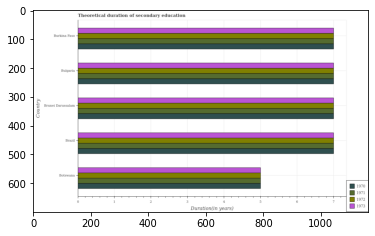

Number of QA =  30





,Country,1972,1971,1970,1973
0,Brazil,7.089402,7.121448,7.075526,7.057692
1,Burkina Faso,7.104440,7.068556,7.086682,7.054802
2,Brunei Darussalam,7.118771,7.103727,7.118495,7.058520
3,Botswana,5.043433,5.044598,5.042965,5.036980
4,Bulgaria,7.039313,7.058855,7.080059,7.070515


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the total theoretical duration of secondary education in 1973 in botswana ?
PREDICTED =  1.0073959181168073
EXPECTED =  5.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum total theoretical duration of secondary education in 1971 ?
PREDICTED =  1.4242895747647624
EXPECTED =  7.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum total theoretical duration of secondary education in 1973 ?
PREDICTED =  0.2
EXPECTED =  5.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished afte

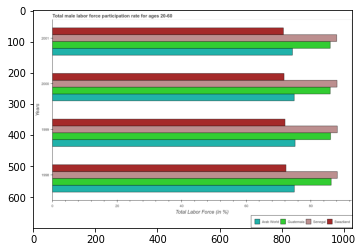

Number of QA =  30





,Years,Senegal,Swaziland,Arab Worid,Guatemala
0,2001,87.757874,71.577970,75.214662,86.303051
1,1999,88.277972,72.371641,75.373652,86.174737
2,1998,88.526639,72.621225,75.107252,85.855550
3,2000,88.399060,71.923707,74.841137,86.405264


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in arab world in 1998 and that in 1999 ?
PREDICTED =  -0.2664000808807714
EXPECTED =  -0.23068453062612093




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in guatemala in 2000 and the male labor force participation rate in senegal in 1998 ?
PREDICTED =  0.5497139982227708
EXPECTED =  -2.1999969482422017




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the male labor force participation rate in senegal and male labor force participation rate in arab wo

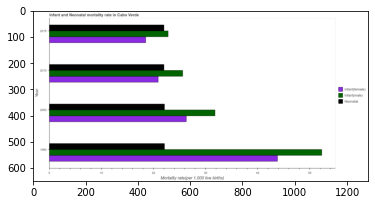

Number of QA =  29





,Year,Neonatal,Infant(male’,Infant(female)
0,2015,NaN,22.791761,NaN
1,1990,22.315459,52.433712,43.680902
2,2010,21.944338,25.219580,21.012527
3,2000,22.340533,31.980247,26.295622


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the infant mortality rate(male) in 1990 and that in 2000 ?
PREDICTED =  20.453464812089784
EXPECTED =  20.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the infant mortality rate(female) in 2000 and the infant mortality rate(male) in 2015 ?
PREDICTED =  nan
EXPECTED =  3.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the infant mortality rate(female) and infant mortality rate(male) ?
PREDICTED =  7.537922071560132
EXPECTED =  -4.7




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training 

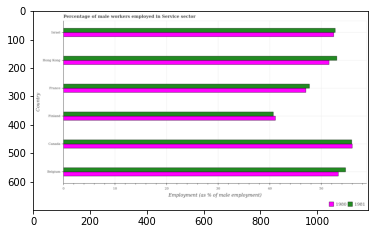

Number of QA =  28





,Country,1980,1981
0,Israel,NaN,53.331673
1,Finland,NaN,41.054178
2,France,NaN,48.148123
3,Hong Kong,NaN,53.209893
4,Canada,NaN,56.102571
5,Belgium,NaN,55.241876


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers employed in service sector in 1981 in finland and the percentage of male workers employed in service sector in 1980 in france?
PREDICTED =  -7.093945189408551
EXPECTED =  -6.299999237060497




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers employed in service sector in 1981 and percentage of male workers employed in service sector in 1980 in belgium ?
PREDICTED =  53.20989301174886
EXPECTED =  1.4000015258790057




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_availabl

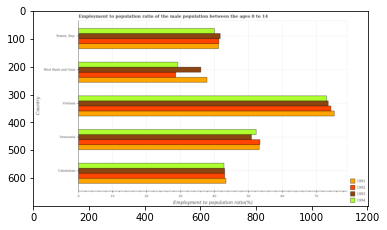

Number of QA =  30





,Country,1992,1993,1994,1991
0,Uzbekistan,43.256749,43.274574,42.934534,43.961175
1,Venezuela,53.853663,51.580948,52.838819,53.552244
2,West Bank and Gaza,NaN,36.412508,29.554095,38.191734
3,"Yemen, Rep.",41.573322,41.817564,NaN,41.703723
4,Vietnam,74.582408,74.030353,73.846091,75.565087


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the total employment to population ratio in 1992 in the graph ?
PREDICTED =  0.02344488

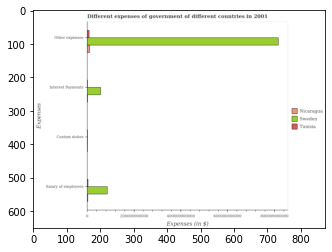

Number of QA =  29





,Expenses,Sweden,Tunisia,Nicaragua
0,Custom duties,NaN,NaN,NaN
1,Other expenses,8.196834e+11,1.025293e+10,1.293946e+10
2,Interest Payments,5.949851e+10,NaN,NaN
3,Salary of employees,8.809418e+10,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on other expenses in tunisia and that in sweden ?
PREDICTED =  -809430455058.7726
EXPECTED =  -809071500000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on interest payments in tunisia and the amount spent on custom duties in sweden ?
PREDICTED =  -49245577822.34859
EXPECTED =  -52000000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on custom duties and amount spent on other expenses in nicaragua ?
PREDICTED =  -12939458538.16182
EXPECTED =  -9577000000




				 1 / 3 = 0.3333


is_built_wit

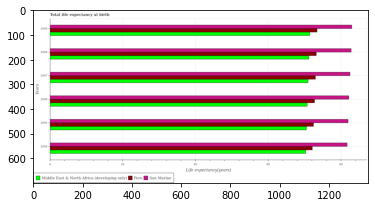

Number of QA =  29





,Years,San Marina,Middle East & North Africa (developing only),Peru
0,2007,NaN,70.800862,75.849841
1,2006,83.631963,NaN,73.503828
2,2005,82.056057,NaN,73.341053
3,2009,83.951773,71.771678,75.873312
4,2004,81.853224,71.061599,71.648053
5,2008,82.795163,NaN,76.846329


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the life expectancy at birth in in middle east & north africa (developing only) in 2005 and that in 2006 ?
PREDICTED =  0.0
EXPECTED =  -0.2248253676164893




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the life expectancy at birth in in san marino in 2004 and the life expectancy at birth in in peru in 2007 ?
PREDICTED =  6.0033829821744575
EXPECTED =  8.724999999999994




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is

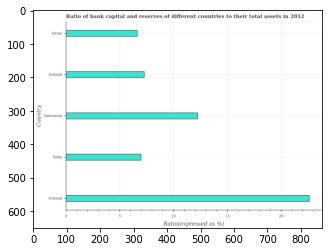

Number of QA =  22





,Country,Ratio(expressed as %)
0,Ireland,7.264871
1,India,7.020296
2,Israel,6.682901
3,Indonesia,12.213178
4,Iceland,22.558033


> what is the title of the graph ?
PREDICTED =  Ratio of bank capital and reserves of different countries to their total assets in 2012
EXPECTED =  Ratio of bank capital and reserves of different countries to their total assets in 2012




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Ratio(expressed as %)
EXPECTED =  Ratio(expressed as %)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 3 / 5 = 0.6


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_

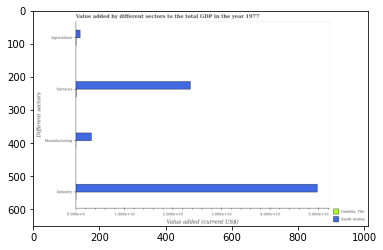

Number of QA =  29





,Different sectors,"Gambia, The",Saudi Arabia
0,Industry,NaN,4.979856
1,Agriculture,NaN,0.098156
2,Services,NaN,2.368053
3,Manufacturing,NaN,0.323673


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing sector in gambia, the and that in saudi arabia ?
PREDICTED =  0.0
EXPECTED =  -3180797654.505327




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing sector in gambia, the and the value added by industrial sector in saudi arabia ?
PREDICTED =  0.0
EXPECTED =  -49737491177.3669




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by services sector and value added by manufacturing sector in saudi arabia ?
PREDICTED =  -1.0
EXPECTED =  20389208858.693172




				 0 / 3 = 0.0




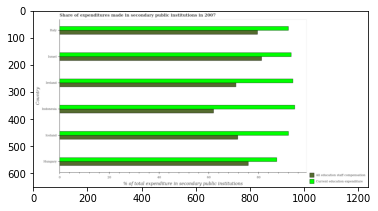

Number of QA =  28





,Country,All education staff compensation,Current education expenditure
0,Italy,80.054119,NaN
1,Iceland,72.391443,92.188380
2,Indonesia,62.459604,94.415714
3,Ireland,71.190893,93.865413
4,Israel,81.516781,94.422713
5,Hungary,76.759781,88.425139


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in education in ireland and that in israel ?
PREDICTED =  -0.5572998461326932
EXPECTED =  0.672




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in staff compensation in iceland and the expenditure in education in italy ?
PREDICTED =  -7.662676532704751
EXPECTED =  -20.379684448242102




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the expenditure in staff compensation in ic

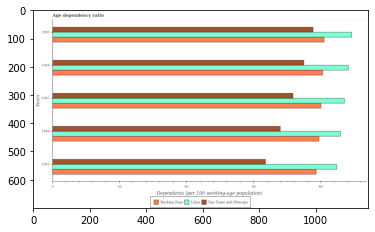

Number of QA =  29





,Years,Burkina Faso,Libya,Sao Tome and Principe
0,1965,82.686102,90.272016,77.989600
1,1961,79.277577,NaN,63.983809
2,1962,80.299162,NaN,68.414378
3,1963,80.427974,87.615957,72.036643
4,1964,81.137917,NaN,76.004031


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the age dependency ratio in in burkina faso in 1962 ?
PREDICTED =  16.059832458251428
EXPECTED =  79.4737133464336




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum age dependency ratio in in burkina faso ?
PREDICTED =  393.0
EXPECTED =  81.00194018005509




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum age dependency ratio in in sao tome and principe ?
PREDICTED =  392.2
EXPECTED =  63.51868271057629




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> i

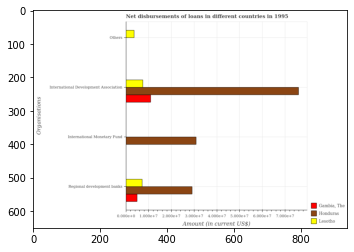

Number of QA =  26





,Organisations,"Gambia, The",Lesotho,Honduras
0,Others,NaN,0.379685,NaN
1,Regional development banks,0.51280,0.731362,2.982524
2,International Monetary Fund,NaN,NaN,3.120695
3,International Development Association,1.10829,0.765922,7.631538


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loan disimbursed by international development association in honduras and that in gambia, the ?
PREDICTED =  6.5232476316848835
EXPECTED =  65052000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loan disimbursed by international monetary fund in honduras and the amount of loan disimbursed by regional development banks in lesotho ?
PREDICTED =  2.3893330645573805
EXPECTED =  23744000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loan disimbursed by international development association and amount of lo

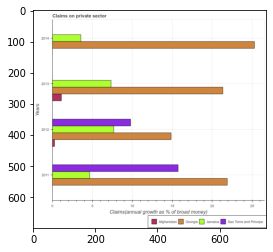

Number of QA =  27





,Years,Jamaica,Georgia,Afghanistan,Sao Tome and Principe
0,2011,4.745336,22.057541,NaN,15.835120
1,2013,7.399143,21.454642,1.207951,NaN
2,2014,3.606622,25.368977,NaN,NaN
3,2012,7.682695,15.058269,0.350772,9.877185


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of broad money claimed on private sector in jamaica in 2011 and that in 2013 ?
PREDICTED =  -2.6538069917160447
EXPECTED =  -2.666923216290031




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the percentage of broad money claimed on private sector in georgia and percentage of broad money claimed on private sector in jamaica ?
PREDICTED =  19.510528326349608
EXPECTED =  17.22995327507918




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evalua

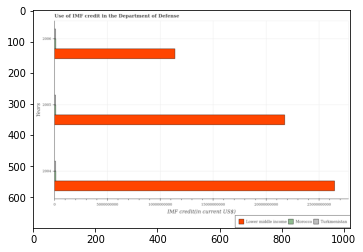

Number of QA =  29





,Years,Morocco,Turkmenistan,Lower middle income
0,2004,3.416655e+08,NaN,4.805072e+10
1,2006,3.415533e+08,2.926278e+08,2.085081e+10
2,2005,NaN,NaN,3.958231e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the imf credit in the department of defense in turkmenistan in 2004 and the imf credit in the department of defense in morocco in 2006 ?
PREDICTED =  -292627845.49038154
EXPECTED =  -20483000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the imf credit in the department of defense in morocco and imf credit in the department of defense in turkmenistan ?
PREDICTED =  48981564.9514631
EXPECTED =  24648000.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
E

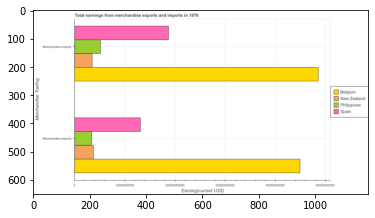

Number of QA =  23





,Merchandise Trading,Spain,Philippines,New Zealand,Belgium
0,Merchandise exports,1.331549e+10,3.565240e+09,3.893384e+09,4.504901e+10
1,Merchandise imports,1.898929e+10,5.270440e+09,3.644381e+09,4.871887e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise exports in new zealand and that in spain ?
PREDICTED =  -9422107324.654167
EXPECTED =  -9375560000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise exports in new zealand and the earnings from merchandise imports in spain ?
PREDICTED =  -9422107324.654167
EXPECTED =  -14973160000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise imports and earnings from merchandise exports in philippines ?
PREDICTED =  -3565240004.9699283
EXPECTED =  1742440000




				 1 / 3 

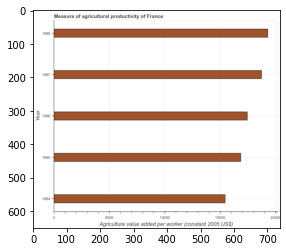

Number of QA =  23





,Year,Agriculture value added per worker (constant 2005 US$)
0,1988,227480.710555
1,1984,182615.086805
2,1987,222172.526289
3,1986,206165.079542
4,1985,198787.455669


> what is the title of the graph ?
PREDICTED =  Measure of agricultural productivity of France
EXPECTED =  Measure of agricultural productivity of France




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Agriculture value added per worker (constant 2005 US$)
EXPECTED =  Agriculture value added per worker (constant 2005 US$)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the agriculture value added per worker in 1986 and 1988 ?
PREDICTED =  -21315.63101358156
EXPECTED =  -1843.788




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median agriculture value added per worker ?
PREDICTED =  206165.0795

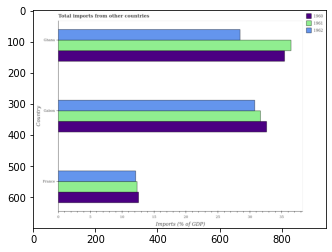

Number of QA =  29





,Country,1962,1961,1960
0,Ghana,28.563775,36.244216,35.341906
1,Gabon,30.792800,31.656882,32.485276
2,France,12.196683,12.408234,12.603480


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports in 1962 in gabon and that in ghana ?
PREDICTED =  2.229025348037169
EXPECTED =  2.298288219651699




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports in 1962 in ghana and the total imports in 1960 in france?
PREDICTED =  16.367092121015673
EXPECTED =  15.9009390549903




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports in 1961 and total imports in 1960 in ghana ?
PREDICTED =  2.0
EXPECTED =  1.008574928542302




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training 

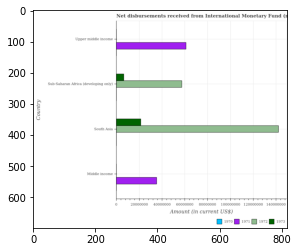

Number of QA =  22





,Country,1972,1971,1970,1973
0,Middle income,NaN,3.551467e+07,NaN,NaN
1,South Asia,1.401556e+08,NaN,NaN,2.169748e+07
2,Upper middle income,NaN,6.110703e+07,NaN,NaN
3,Sub-Saharan Africa (developing only),5.780528e+07,NaN,NaN,7.035126e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from international monetary fund in 1973 in south asia and that in sub-saharan africa (developing only) ?
PREDICTED =  14662349.020256696
EXPECTED =  14879000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from international monetary fund in 1972 in sub-saharan africa (developing only) and the amount of disbursements received from international monetary fund in 1973 in upper middle income?
PREDICTED =  -1.0
EXPECTED =  57377000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


> 

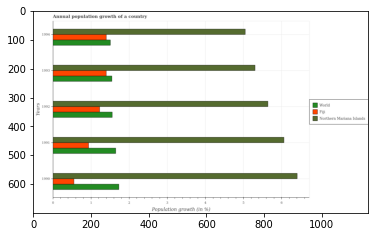

Number of QA =  29





,Years,Fiji,Northern Mariana Islands,World
0,1991,0.941635,6.102766,1.654834
1,1993,1.423229,5.326363,1.558556
2,1994,1.430997,5.093902,1.538364
3,1992,1.227589,5.678139,1.573979
4,1990,0.568250,6.459751,1.772723


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the annual population growth in northern mariana islands in 1993 and that in 1994 ?
PREDICTED =  0.23246060569663562
EXPECTED =  0.2559843204121197




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the annual population growth in fiji in 1990 and the annual population growth in world in 1994 ?
PREDICTED =  -0.8627468518671705
EXPECTED =  -0.9556786713553319




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1993, what is the difference between the annual population growth in world and annual population growth in northern mariana islands ?
PREDICTED =  0.0
EXPECTED =  -3

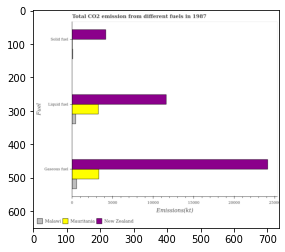

Number of QA =  28





,Fuel,Malawi,New Zealand,Mauritania
0,Solid fuel,NaN,7645.109162,NaN
1,Gaseous fuel,1110.195420,43628.663429,6066.902247
2,Liquid fuel,907.593452,21088.096549,6012.861887


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emissions from solid fuel in malawi and that in mauritania ?
PREDICTED =  1.0
EXPECTED =  58.672000000000004




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emissions from liquid fuel in malawi and the amount of co2 emissions from gaseous fuel in new zealand ?
PREDICTED =  -71454.27568825192
EXPECTED =  -23674.152000000002




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emissions from liquid fuel and amount of co2 emissions from gaseous fuel in new zealand ?
PREDICTED =  -43627.66342893221
EXP

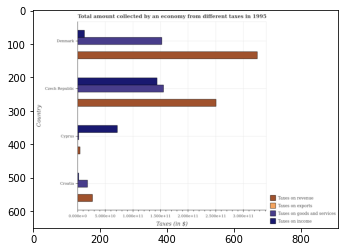

Number of QA =  30





,Country,Taxes on goods and services,Taxes on revenue,Taxes on income,Taxes on exports
0,Czech Republic,28.311777,45.533092,26.132920,NaN
1,Croatia,3.436553,5.054110,NaN,NaN
2,Denmark,27.445950,58.665700,2.540952,NaN
3,Cyprus,NaN,1.076942,13.158886,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected as tax on revenue in cyprus and that in czech republic ?
PREDICTED =  -44.45614937027855
EXPECTED =  -246448412185.725




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected as tax on exports in croatia and the amount collected as tax on revenue in cyprus ?
PREDICTED =  5.054109741526021
EXPECTED =  -4131187814.275209




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected as tax on goods and amount collected as tax on income in cyprus ?
PREDICTED =  15.152890493834738
EXPECTED =  -69995543535.589



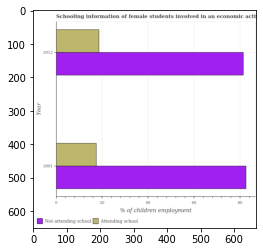

Number of QA =  25





,Year,Attending school,Not attending school
0,2001,17.815642,83.720875
1,2012,19.191830,83.224588


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed females who are attending school in 2001 and that in 2012 ?
PREDICTED =  -1.3761883628013258
EXPECTED =  -1.158




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed females who are attending school in 2012 and the percentage of employed females who are not attending school in 2001 ?
PREDICTED =  -64.52904473487646
EXPECTED =  -63.95771999999997




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after traini

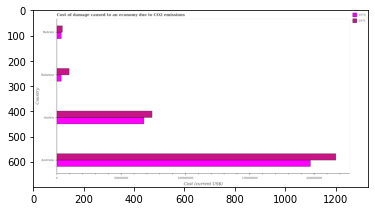

Number of QA =  28





,Country,1971,1970
0,Austria,1.348433e+08,1.229514e+08
1,Bahrain,8.568533e+06,6.964022e+06
2,Bahamas,1.797192e+07,7.034872e+06
3,Australia,3.887268e+08,3.537594e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to co2 emissisons in 1970 in australia and that in bahamas ?
PREDICTED =  346724546.75585824
EXPECTED =  193604221.53976914




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to co2 emissisons in 1970 in bahamas and the cost of damage caused due to co2 emissisons in 1971 in australia?
PREDICTED =  -346724546.75585824
EXPECTED =  -213359086.23282114




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to co2 emissisons in 1971 and cost of damage caused due to co2 emi

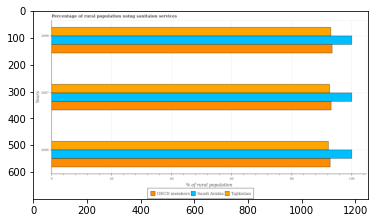

Number of QA =  29





,Years,OECD members,Tajikistan,Saudi Arabia
0,2006,94.302334,92.691657,100.714087
1,2007,93.783765,93.119680,100.005651
2,2008,94.413450,93.428435,100.975826


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population using sanitaion services in tajikistan in 2007 and that in 2008 ?
PREDICTED =  -0.30875496121372237
EXPECTED =  -0.4000000000000057




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population using sanitaion services in oecd members in 2006 and the percentage of rural population using sanitaion services in tajikistan in 2008 ?
PREDICTED =  -0.11111623871481413
EXPECTED =  -0.19922063963392134




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Trai

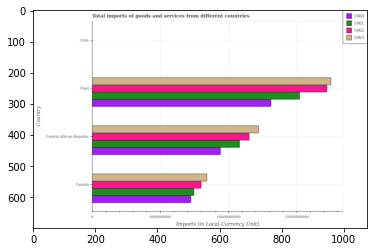

Number of QA =  30





,Country,1963,1962,1961,1960
0,Chad,3.162036e+10,3.109291e+10,2.766814e+10,2.354633e+10
1,Central African Republic,NaN,2.082227e+10,1.950507e+10,1.709349e+10
2,Chile,NaN,NaN,NaN,NaN
3,Canada,NaN,1.447869e+10,1.356662e+10,1.312759e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods and services imports in 1961 in chad and that in chile ?
PREDICTED =  -5536849559.077175
EXPECTED =  15199208200.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods and services imports in 1960 in central african republic and the amount of goods and services imports in 1961 in canada?
PREDICTED =  -8089791153.930229
EXPECTED =  1944496140.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods and services imports in 1963 and amount of goods and services imports in 1960 in chad ?
PREDICTED =  -1

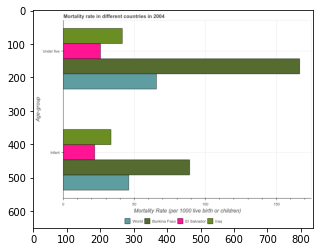

Number of QA =  23





,Age-group,Unnamed: 1,Burkina Faso,El Salvador,World
0,Infant,33.706696,89.291232,22.303185,45.855286
1,Under five,41.924174,167.527676,26.451887,65.109223


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the infant mortality rate in iraq and that in el salvador ?
PREDICTED =  0.0
EXPECTED =  11.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-5 mortality rate in iraq and the infant mortality rate in burkina faso ?
PREDICTED =  -89.29123227179453
EXPECTED =  -47.400000000000006




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-5 mortality rate and infant mortality rate in world ?
PREDICTED =  -23.55210113936923
EXPECTED =  19.5




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predictin

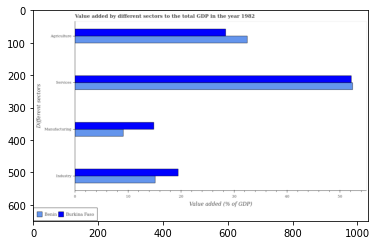

Number of QA =  29





,Different sectors,Burkina Faso,Benin
0,Services,52.520837,51.809497
1,Industry,19.603635,15.185233
2,Agriculture,28.715992,32.658732
3,Manufacturing,15.027028,9.242176


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by industrial sector in benin and that in burkina faso ?
PREDICTED =  -48.16142202896755
EXPECTED =  -4.3351343674709995




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by industrial sector in benin and the value added by agricultural sector in burkina faso ?
PREDICTED =  13.185232909484842
EXPECTED =  -13.2921313082667




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing sector and value added by services sector in burkina faso ?
PREDICTED =  -58.30568880617644
EXPECTED =  -37.262593601

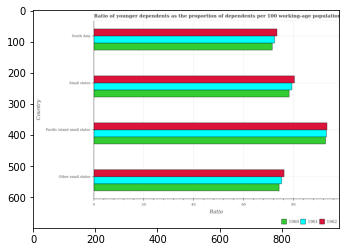

Number of QA =  29





,Country,1962,1961,1960
0,Other small states,77.424462,75.935317,74.915752
1,South Asia,74.205068,72.924848,72.153943
2,Pacific island small states,94.170684,NaN,93.394382
3,Small states,80.882145,80.174772,79.135964


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 6 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predic

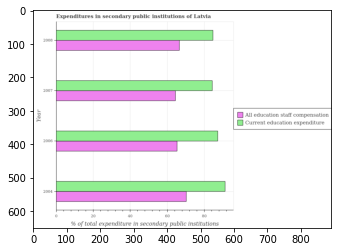

Number of QA =  28





,Year,All education staff compensation,Current education expenditure
0,2004,71.299061,92.159104
1,2008,67.332382,85.584896
2,2007,65.054478,85.512864
3,2006,66.717189,88.090320


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in staff compensation in 2004 and that in 2006 ?
PREDICTED =  4.58187184385983
EXPECTED =  4.99




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in education in 2008 and the expenditure in staff compensation in 2007 ?
PREDICTED =  0.07203237166515919
EXPECTED =  20.2805557250977




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the expenditure in staff compensation and expenditure in education ?
PREDICTED =  0.0
EXPECTED =  -18.138




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: Fal

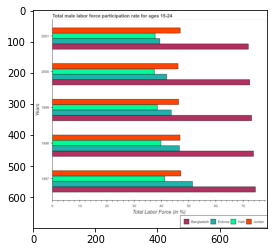

Number of QA =  30





,Years,Estonia,Jordan,Haiti,Bangladesh
0,1997,51.279415,NaN,NaN,74.442383
1,2000,41.632044,45.616425,36.928168,73.502326
2,1999,43.488463,NaN,38.270012,73.061452
3,2001,38.911708,46.827269,37.715425,71.036714
4,1998,45.688049,46.867141,39.587695,72.778515


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in haiti in 1998 and that in 2001 ?
PREDICTED =  1.87226926066149
EXPECTED =  2.0999984741209943




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in estonia in 1999 and the male labor force participation rate in bangladesh in 2001 ?
PREDICTED =  4.576755144906436
EXPECTED =  -28.300003051757805




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the male labor force participation rate in estonia and male labor force participation rate in jordan ?
PREDICTE

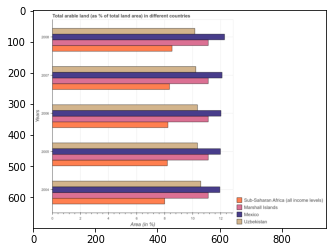

Number of QA =  30





,Years,Uzbekistan,Mexico,Sub-Saharan Africa (all income levels),Marshall Islands
0,2008,NaN,12.405945,NaN,NaN
1,2007,10.275691,NaN,NaN,NaN
2,2004,10.674902,11.977377,8.030990,11.202544
3,2005,10.413437,12.279925,8.235792,11.131966
4,2006,10.390003,12.216543,8.324256,11.323893


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of arable land in sub-saharan africa (all income levels) in 2004 and that in 2008 ?
PREDICTED =  8.030990182673946
EXPECTED =  -0.5283716562934497




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of arable land in sub-saharan africa (all income levels) in 2006 and the percentage of arable land in mexico in 2007 ?
PREDICTED =  nan
EXPECTED =  -3.861715468597959




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step

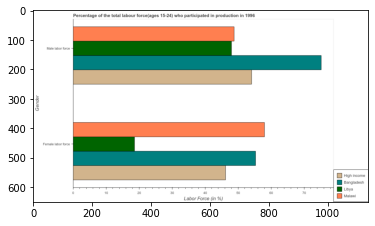

Number of QA =  23





,Gender,Malawi,Bangladesh,Libya,High income
0,Female labor force,58.094422,55.273815,18.643743,46.311581
1,Male labor force,49.032205,75.399671,48.672379,53.934405


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force in libya and that in bangladesh ?
PREDICTED =  -36.63007191337347
EXPECTED =  -36.69999885559079




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force in malawi and the percentage of male labour force in bangladesh ?
PREDICTED =  2.8206073139333867
EXPECTED =  -17.1999969482422




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percen

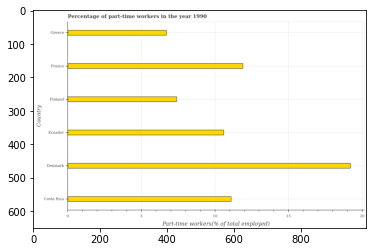

Number of QA =  22





,Country,Part-time workers(% of total employed)
0,Ecuador,10.612611
1,Costa Rica,11.192375
2,France,11.772872
3,Greece,6.772157
4,Finland,7.420894
5,Denmark,19.372524


> what is the title of the graph ?
PREDICTED =  Percentage of part-time workers in the year 1990
EXPECTED =  Percentage of part-time workers in the year 1990




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Part-time workers(% of total employed)
EXPECTED =  Part-time workers(% of total employed)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of part-time workers in costa rica and denmark ?
PREDICTED =  -8.180148876945271
EXPECTED =  -8.1




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of part-time workers ?
PREDICTED =  10.90249291082066
EXPECTED =  10.850

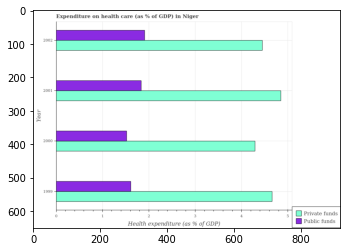

Number of QA =  28





,Year,Private funds,Public funds
0,2002,4.490216,1.929425
1,2000,4.315495,1.542153
2,1999,4.736063,1.638764
3,2001,4.883985,1.850166


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of private funds spent in healthcare in 1999 and that in 2001 ?
PREDICTED =  -0.14792151162710176
EXPECTED =  -0.188




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of public funds spent in healthcare in 2002 and the amount of private funds spent in healthcare in 2000 ?
PREDICTED =  -3.3923184303610734
EXPECTED =  -2.3809359614596697




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the amount of public funds spent in healthcare and amount of private funds spent in healthcare ?
PREDICTED =  0.0792587281863554

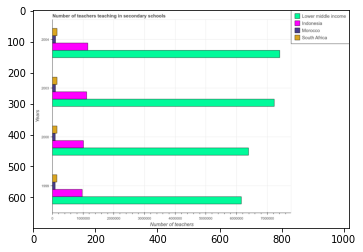

Number of QA =  30





,Years,Lower middle income,South Africa,Indonesia,Morocco
0,2004,7.343657e+06,165565.439234,1.153444e+06,118288.822847
1,2000,6.324079e+06,159325.824683,1.012304e+06,106217.587126
2,2003,7.132803e+06,158661.915154,1.112569e+06,115443.989306
3,1999,6.127197e+06,157385.325341,9.763990e+05,105651.841418


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of teachers teaching in secondary schools in morocco in 1999 and that in 2003 ?
PREDICTED =  -9792.147887477186
EXPECTED =  -9214.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of teachers teaching in secondary schools in indonesia in 2004 and the number of teachers teaching in secondary schools in south africa in 2000 ?
PREDICTED =  141139.63479492557
EXPECTED =  1004012.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the number of teachers teaching in secondary schools in south africa and number of t

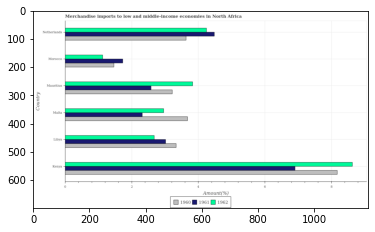

Number of QA =  29





,Country,1962,1961,1960
0,Libya,NaN,3.012148,3.356444
1,Malta,NaN,2.380666,3.624717
2,Mauritius,3.764060,2.608250,3.257439
3,Morocco,1.134516,1.756844,1.480267
4,Netherlands,4.259011,4.512972,3.708152
5,Kenya,8.671637,6.912484,8.101091


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in 1962 in malta and that in mauritius ?
PREDICTED =  -2.62954400637097
EXPECTED =  -0.8695234160577399




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in 1961 in netherlands and the percentage of amount earned from merchandise imports in 1962 in libya?
PREDICTED =  1.5008239652296025
EXPECTED =  1.8055504330561103




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in 1961 and perc

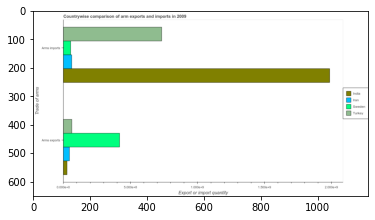

Number of QA =  23





,Trade of arms,Sweden,Turkey,India,Iran
0,Arms imports,0.584985,7.368548,20.166398,0.660759
1,Arms exports,4.208290,0.660391,0.324580,0.489086


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the arms exports in india and the arms imports in iran ?
PREDICTED =  -0.16450618149261448
EXPECTED =  -35000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Export or import quantity
EXPECTED =  500000000.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Countrywise comparison of

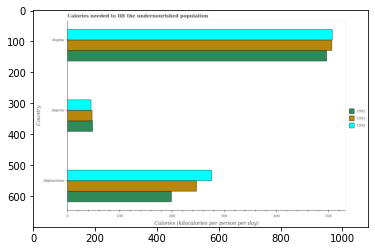

Number of QA =  29





,Country,1992,1993,1994
0,Algeria,49.817396,48.644532,46.335926
1,Angola,498.010358,508.254528,514.017621
2,Afghanistan,200.874234,249.915055,278.744410


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total calories needed to lift the undernourished population in 1994 in algeria and that in angola ?
PREDICTED =  43.33592641089386
EXPECTED =  -462.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total calories needed to lift the undernourished population in 1992 in afghanistan and the total calories needed to lift the undernourished population in 1994 in angola?
PREDICTED =  -297.13612399880884
EXPECTED =  -308.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total calories needed to lift the undernourished population in 1993 and 

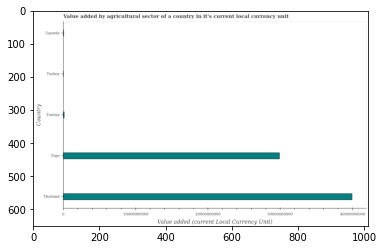

Number of QA =  22





,Country,Value added (current Local Currency Unit)
0,Turkey,NaN
1,Uganda,1.541259e+08
2,Togo,2.984207e+10
3,Tunisia,2.391908e+08
4,Thailand,4.009961e+10


> what is the title of the graph ?
PREDICTED =  Value added by agricultural sector of a country in it's current local currency unit
EXPECTED =  Value added by agricultural sector of a country in it's current local currency unit




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Value added (current Local Currency Unit)
EXPECTED =  Value added (current Local Currency Unit)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agriculture sector in thailand and tunisia ?
PREDICTED =  -239190799.36940452
EXPECTED =  39839398500.0




				 3 / 4 = 0.75


> what is the median value added by agriculture sector ?
PREDICTED =  None
EXPECTED =  107800000.0




				 3 / 6 = 0.5


is_built_with_cuda: True
is_

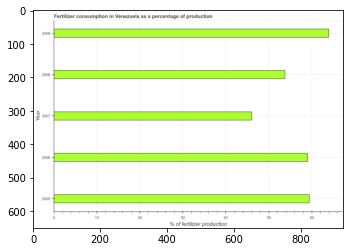

Number of QA =  23





,Year,% of fertilizer production
0,2005,59.462186
1,2006,58.782094
2,2008,53.622070
3,2009,64.092296
4,2007,46.003488


> what is the title of the graph ?
PREDICTED =  Fertilizer consumption in Venezuela as a percentage of production
EXPECTED =  Fertilizer consumption in Venezuela as a percentage of production




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  % of fertilizer production
EXPECTED =  % of fertilizer production




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of fertilizer consumption in 2005 and 2007 ?
PREDICTED =  13.458698443232137
EXPECTED =  13.418




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median amount of fertilizer consumption ?
PREDICTED =  58.782093742687906
EXPECTED =  59.046

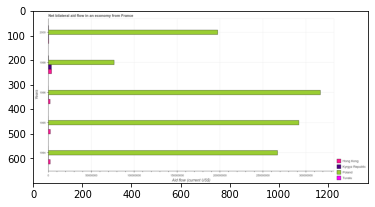

Number of QA =  30





,Years,Kyrgyz Republic,Tuvalu,Poland,Hong Kong
0,1998,7.091557e+06,NaN,1.380800e+08,7.237530e+06
1,2000,NaN,NaN,3.544875e+08,NaN
2,1995,NaN,NaN,5.220850e+08,4.787987e+06
3,1996,NaN,NaN,5.678314e+08,4.242568e+06
4,1994,NaN,NaN,4.804682e+08,4.691094e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in hong kong in 1998 and that in 2000 ?
PREDICTED =  0.0
EXPECTED =  3260000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in hong kong in 1994 and the net bilateral aid flow in tuvalu in 1995 ?
PREDICTED =  -96893.55798960384
EXPECTED =  2170000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the net bilateral aid flow in poland and net bilateral aid flow in hong kong ?
PREDICTED =  546872199.7953951
EXPECTED =  314900000.0




				 0 / 3 = 0.0


is_built_with_cuda: Tr

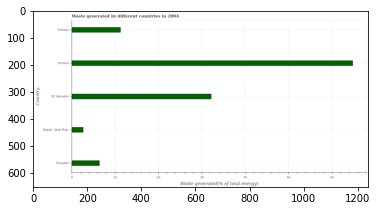

Number of QA =  22





,Country,Waste generated(% of total enerqy)
0,Eritrea,64.870680
1,Estonia,11.454796
2,Ecuador,6.573692
3,El Salvador,32.360979
4,"Egypt, Arab Rep.",2.767998


> what is the title of the graph ?
PREDICTED =  Waste generated by different countries in 2004
EXPECTED =  Waste generated by different countries in 2004




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Waste generated(% of total enerqy)
EXPECTED =  Waste generated(% of total energy)




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of waste generated in eritrea and estonia ?
PREDICTED =  53.41588313766142
EXPECTED =  53.533




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 3 / 5 = 0.6


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fin

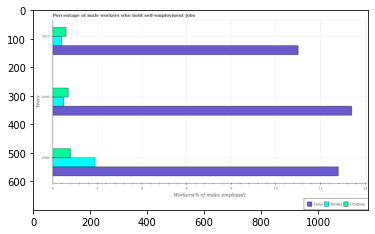

Number of QA =  29





,Years,Uruguay,India,Jordan
0,2010,0.630622,11.026818,0.423891
1,2000,0.813088,12.901100,1.949139
2,2005,0.723384,13.330755,0.520389


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed male workers in india in 2000 and that in 2010 ?
PREDICTED =  1.8742820725722424
EXPECTED =  1.8000001907349006




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed male workers in india in 2010 and the percentage of self-employed male workers in uruguay in 2000 ?
PREDICTED =  -1.8742820725722424
EXPECTED =  10.199999988079073




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the percentage of self-employed male workers in uruguay and percentage of self-employed male worke

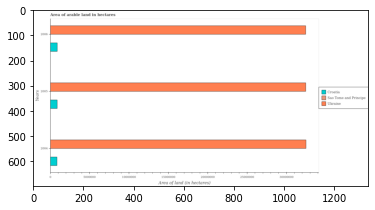

Number of QA =  29





,Years,Ukraine,Croatia,Sao Tome and Principe
0,2006,5.852972e+07,1.673106e+06,NaN
1,2005,5.884473e+07,1.665965e+06,NaN
2,2004,5.896112e+07,1.638325e+06,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total arable land in croatia in 2004 and that in 2005 ?
PREDICTED =  -27639.594898329582
EXPECTED =  -26000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the total arable land in ukraine in 2005 to that in 2006 ?
PREDICTED =  1.005381989604637
EXPECTED =  1.0001849226406954




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Eva

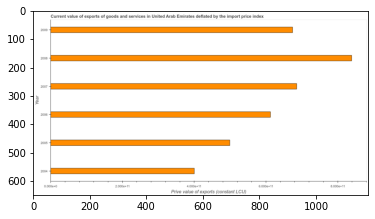

Number of QA =  23





,Year,Prive value of exports (constant LCU)
0,2009,6.746784
1,2006,6.125547
2,2004,4.022341
3,2008,8.394218
4,2005,5.044781
5,2007,6.857647


> what is the title of the graph ?
PREDICTED =  Current value of exports of goods and services in United Arab Emirates deflated by the import price index
EXPECTED =  Current value of exports of goods and services in United Arab Emirates deflated by the import price index




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Prive value of exports (constant LCU)
EXPECTED =  Prive value of exports (constant LCU)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the price value of exports in 2005 and 2008 ?
PREDICTED =  -3.3494363024768337
EXPECTED =  -339480826419.291




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





>

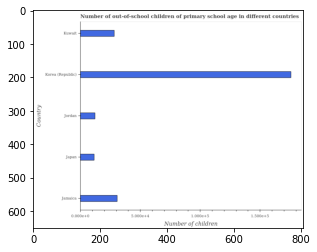

Number of QA =  22





,Country,Number of children
0,Japan,2.167560
1,Jamaica,5.617893
2,Kuwait,5.242443
3,Jordan,2.300019
4,Korea (Republic),31.727747


> what is the title of the graph ?
PREDICTED =  Number of out-of-school children of primary school age in different countries
EXPECTED =  Number of out-of-school children of primary school age in different countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Number of children
EXPECTED =  Number of children




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of out-of-school children in korea (republic) and kuwait ?
PREDICTED =  26.48530442492609
EXPECTED =  147521.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of out-of-school children ?
PREDICTED =  5.24244

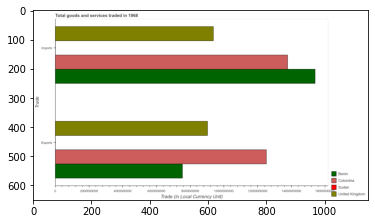

Number of QA =  23





,Trade,Colombia,United Kingdom,Sudan,Benin
0,Imports,1.373734e+10,9.338864e+09,NaN,1.548762e+10
1,Exports,1.262775e+10,8.963430e+09,NaN,7.613628e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Trade (in Local Currency Unit)
EXPECTED =  2000000000.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Total goods and services traded in 1968
EXPECTED =  Total goods and services traded in 1968




				 1 / 6 = 0.1667


> what is the label or title of the x-axis ?
PRED

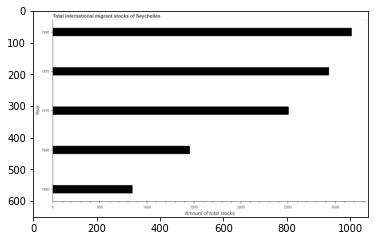

Number of QA =  23





,Year,Amount of total stocks
0,1980,3169.595671
1,1960,855.361878
2,1965,1460.482506
3,1975,2941.144852
4,1970,2514.063260


> what is the title of the graph ?
PREDICTED =  Total international migrant stocks of Seychelles
EXPECTED =  Total international migrant stocks of Seychelles




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Amount of total stocks
EXPECTED =  Amount of total stocks




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total number of international migrant stock in 1970 and 1980 ?
PREDICTED =  -655.5324108387913
EXPECTED =  -670.0




				 4 / 4 = 1.0


> what is the median total number of international migrant stock ?
PREDICTED =  None
EXPECTED =  2506.0




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what 

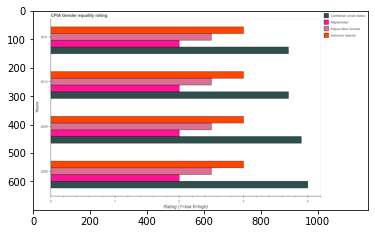

Number of QA =  30





,Years,Papua New Guinea,Afghanistan,Solomon Islands,Caribbean small states
0,2011,NaN,2.005275,3.012313,3.688797
1,2008,2.540533,2.006873,2.966466,3.969493
2,2009,2.506600,2.012874,3.007611,3.894151
3,2010,2.519268,2.009836,2.988559,3.710300


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in papua new guinea in 2008 and that in 2009 ?
PREDICTED =  0.0339327045698381
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in solomon islands in 2009 and the cpia rating in papua new guinea in 2011 ?
PREDICTED =  -0.004701494893268876
EXPECTED =  0.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the cpia rating in caribbean small states and cpia rating in afghanistan ?
PREDICTED =  -0.18431489385566335
EXPECTED =  1.9




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_ava

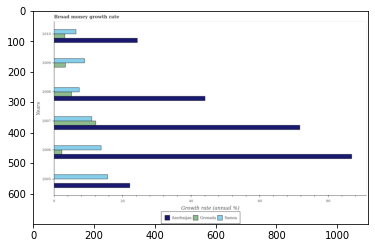

Number of QA =  26





,Years,Grenada,Azerbaijan,Samoa
0,2005,NaN,22.323531,15.715214
1,2010,3.245355,25.009797,6.611136
2,2009,3.479637,NaN,9.037210
3,2008,5.240348,44.874471,7.534566
4,2006,2.430675,87.674703,13.855518
5,2007,12.508001,72.214861,11.208423


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the growth rate in grenada in 2007 and that in 2009 ?
PREDICTED =  9.028363838382356
EXPECTED =  8.83654078826127




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the growth rate in samoa in 2005 and the growth rate in grenada in 2007 ?
PREDICTED =  4.506791100413212
EXPECTED =  3.473985564358399




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the growth rate in azerbaijan and growth rate in samoa ?
PREDICTED =  246.0973627748437
EXPECTED =  73.06189624593802




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: Fa

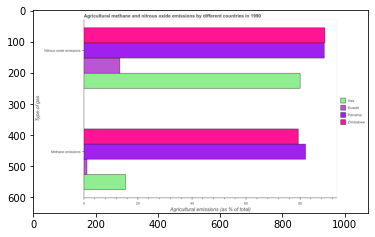

Number of QA =  23





,Type of gas,Unnamed: 1,Zimbabwe,Panama,Kuwait
0,Methane emissions,15.491020,79.837792,82.312097,1.226124
1,Nitrous oxide emissions,80.078755,89.895626,89.093522,13.187380


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of nitrous oxide emissions in iraq and that in zimbabwe ?
PREDICTED =  -88.89562630705515
EXPECTED =  -9.117734526205496




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emissions in panama and the amount of nitrous oxide emissions in zimbabwe ?
PREDICTED =  2.474305232723708
EXPECTED =  -7.117159965269096




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of nitrous oxide emissions and amount of methane emissions in panama ?
PREDICTED =  -88.09352168613371
EXPECTED =  6.9276364075176105




				 0 / 3 = 0.

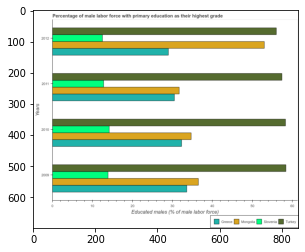

Number of QA =  30





,Years,Slovenia,Turkey,Greece,Mongolia
0,2012,12.652428,56.460284,29.143833,53.395568
1,2009,14.176171,58.436573,33.870091,37.539318
2,2011,12.979240,57.417882,31.095545,31.890510
3,2010,14.414893,58.655466,32.754020,35.675311


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force with primary education in slovenia in 2009 and that in 2011 ?
PREDICTED =  1.196931435821357
EXPECTED =  1.0999994277953995




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force with primary education in turkey in 2010 and the percentage of male labor force with primary education in greece in 2011 ?
PREDICTED =  1.2375840484048624
EXPECTED =  27.799999237060497




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of male labor force with primary education 

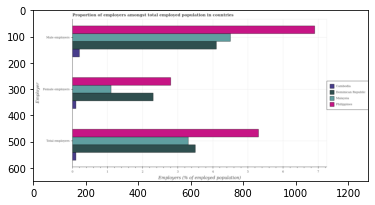

Number of QA =  28





,Employer,Cambodia,Dominican Republic,Philippines,Malaysia
0,Male employers,0.213941,4.156185,6.973950,4.549069
1,Total employers,0.116762,3.518092,5.321171,3.326233
2,Female employers,0.114121,2.333745,2.836798,1.126646


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of male employers in malaysia to that in cambodia ?
PREDICTED =  21.263190843972833
EXPECTED =  22.499999664723905




				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predi

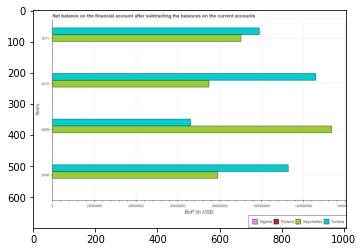

Number of QA =  27





,Years,Algeria,Finland,Seychelles,Tunisia
0,2009,NaN,NaN,1.331412e+08,6.622868e+07
1,2010,NaN,NaN,7.492480e+07,1.259436e+08
2,2008,NaN,NaN,7.901892e+07,1.129686e+08
3,2011,NaN,NaN,9.058168e+07,9.904746e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments in tunisia in 2009 and that in 2011 ?
PREDICTED =  -32818779.140396
EXPECTED =  -32818234.819999993




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments in algeria in 2009 and the balance of payments in tunisia in 2008 ?
PREDICTED =  -46739879.927481875
EXPECTED =  -112730543.7




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the balance of payments in seychelles and balance of payments in tunisia ?
PREDICTED =  7197587.809693575
EXPECTED =  67391419.52




				 1 / 3 = 0.3333


is_built

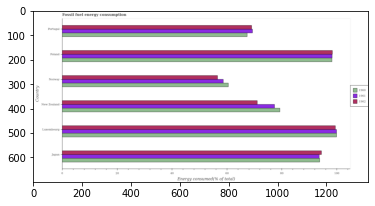

Number of QA =  29





,Country,1962,1961,1960
0,Poland,98.972643,NaN,100.064294
1,Norway,56.639918,58.191413,60.283135
2,Luxembourg,NaN,99.314194,NaN
3,New Zealand,71.734815,76.385779,78.049229
4,Japan,93.889988,93.511132,93.436786
5,Portugal,68.709399,68.866584,67.521216


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of energy consumed in 1962 in luxembourg and that in portugal ?
PREDICTED =  -68.70939912743518
EXPECTED =  30.5081726001317




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of energy consumed in 1962 in new zealand and the percentage of energy consumed in 1961 in japan?
PREDICTED =  -22.15517312601723
EXPECTED =  -22.567053362441




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of energy consumed in 1962 and percentage of energy consumed in 1960 in poland ?
PREDICTED =  -1.091651471542761
EXPECTED =  0.

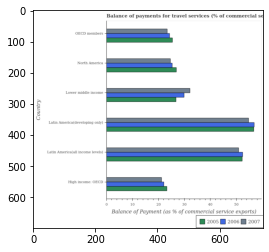

Number of QA =  29





,Country,2007,2005,2006
0,North America,25.146375,27.527657,25.861385
1,Lower middle income,32.732670,27.403246,NaN
2,OECD members,NaN,25.811077,24.773373
3,Latin America(developing only),55.639614,57.601734,57.693281
4,High income: OECD,21.720592,23.780681,NaN
5,Latin America(all income levels),51.760971,53.044904,52.632401


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for travel services in 2007 in latin america(all income levels) and that in lower middle income ?
PREDICTED =  19.02830136354372
EXPECTED =  18.754375191393102




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for travel services in 2007 in latin america(all income levels) and the balance of payments for travel services in 2006 in oecd members?
PREDICTED =  48.76097136529469
EXPECTED =  26.5989175928963




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for travel services in 2006

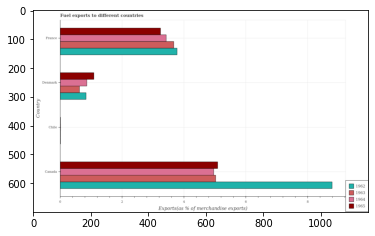

Number of QA =  30





,Country,1965,1964,1962,1963
0,France,3.257365,3.458947,3.801192,3.681854
1,Chile,NaN,NaN,NaN,NaN
2,Canada,5.088667,4.971113,8.828618,5.078197
3,Denmark,1.101655,0.879697,0.854867,0.643778


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in 1964 in canada and that in france ?
PREDICTED =  2.0
EXPECTED =  1.5363019956371917




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in 1964 in chile and the percentage of exports to different countries in 1965 in denmark?
PREDICTED =  2.1203033208864785
EXPECTED =  -1.0778519321843278




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in 1963 and percentage of exports to different countries in 1964 in 

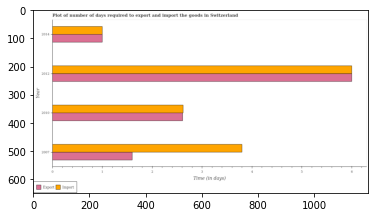

Number of QA =  28





,Year,Unnamed: 1,Import
0,2014,1.015181,1.012309
1,2012,6.046462,6.064368
2,2010,2.626919,2.646145
3,2007,1.618808,3.828078


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the time required to import in 2007 and that in 2010 ?
PREDICTED =  1.1819331250883272
EXPECTED =  1.18




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the time required to import in 2014 and the time required to export in 2012 ?
PREDICTED =  -5.052059190144794
EXPECTED =  -5.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the time required to export in 2012 to that in 2014 ?
PREDICTED =  332.1038572

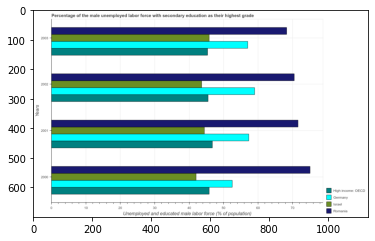

Number of QA =  30





,Years,Germany,High income: OECD,israel,Romania
0,2001,57.213188,46.671708,44.555292,71.660570
1,2003,57.533486,45.345386,46.118853,68.067804
2,2002,59.322399,45.389096,43.509526,70.720580
3,2000,53.282089,46.053070,42.023824,75.274668


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed male labor force with secondary education in romania in 2000 and that in 2003 ?
PREDICTED =  7.206863901342771
EXPECTED =  6.799995422363196




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed male labor force with secondary education in romania in 2000 and the percentage of the unemployed male labor force with secondary education in israel in 2001 ?
PREDICTED =  30.719376026518894
EXPECTED =  30.699996948242095




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_ava

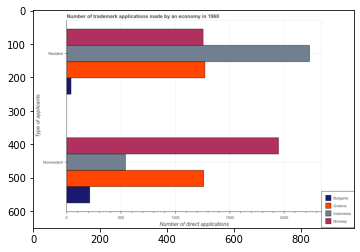

Number of QA =  23





,Type of applicants,Bulgaria,Greece,Norway,Indonesia
0,Resident,44.181876,1285.773011,1265.942295,2244.014232
1,Nonresident,218.076571,1266.300110,1958.589368,538.570296


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by residents in norway and that in greece ?
PREDICTED =  0.0
EXPECTED =  -16




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by residents in norway and the number of trademark applications made by non residents in indonesia ?
PREDICTED =  -1.0
EXPECTED =  715




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by residents and number of trademark applications made by non residents in bulgaria ?
PREDICTED =  -1.0
EXPECTED =  -1

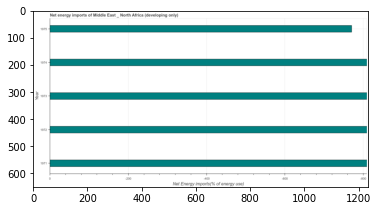

Number of QA =  12





,Year,Net Energy imports(% of energy use)
0,1973,812.173396
1,1975,767.759278
2,1972,812.173333
3,1971,806.148162
4,1974,812.173354


> what is the title of the graph ?
PREDICTED =  Net energy imports of Middle East North Africa (developing only)
EXPECTED =  Net energy imports of Middle East _ North Africa (developing only)




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Net Energy imports(% of energy use)
EXPECTED =  Net Energy imports(% of energy use)




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median energy imports ?
PREDICTED =  812.1733327357398
EXPECTED =  0.0




				 2 / 4 = 0.5


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Net Energy imports(% of energy use)
EXPECTED =  200.0




				 2 / 5 = 0.4


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished a

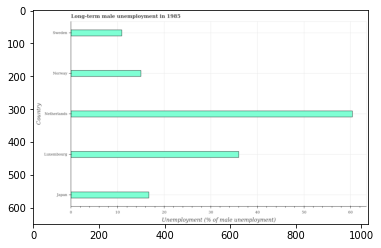

Number of QA =  22





,Country,Unemployment (% of male unemployment)
0,Japan,16.773750
1,Luxembourg,35.839061
2,Netherlands,60.776691
3,Sweden,11.115953
4,Norway,15.184335


> what is the title of the graph ?
PREDICTED =  Long-term male unemployment in 1985
EXPECTED =  Long-term male unemployment in 1985




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Unemployment (% of male unemployment)
EXPECTED =  Unemployment (% of male unemployment)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the long-term male unemployment in luxembourg and netherlands ?
PREDICTED =  -24.937630158911425
EXPECTED =  -24.4




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median long-term male unemployment ?
PREDICTED =  16.77374958388759
EXPECTED =  16.7000007629395




				 5 / 5 = 1.

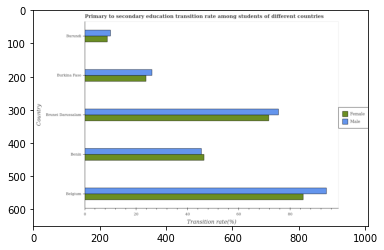

Number of QA =  28





,Country,Female,Male
0,Benin,NaN,45.807730
1,Burundi,8.970801,10.372334
2,Belgium,85.864493,94.952550
3,Brunei Darussalam,71.568756,76.096975
4,Burkina Faso,24.263411,26.352297


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the transition rate among male students in belgium and that in burkina faso ?
PREDICTED =  68.60025288283002
EXPECTED =  68.012




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the transition rate among female students in belgium and the transition rate among male students in brunei darussalam ?
PREDICTED =  14.295737500216532
EXPECTED =  9.626559999999998




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the transition rate among female students and transition rate among male students in burkina faso ?
PREDICTED =  2.0
EXPECTED =  -2.322




				 1

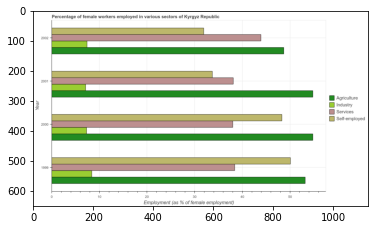

Number of QA =  30





,Year,Industry,Self-employed,Agriculture,Services
0,2001,7.323759,NaN,55.031709,38.292127
1,2000,7.419932,48.602892,54.937347,38.247650
2,1999,8.491133,50.279603,53.224531,38.874958
3,2002,7.523606,NaN,48.898568,43.991084


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self employed female workers in 1999 and that in 2002 ?
PREDICTED =  nan
EXPECTED =  18.2




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female workers in agriculture in 2000 and the percentage of female workers in services in 2002 ?
PREDICTED =  6.038779158636331
EXPECTED =  10.899997711181598




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of self empl

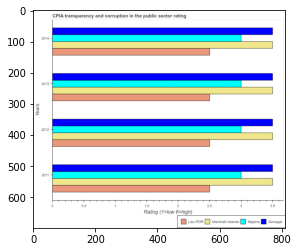

Number of QA =  30





,Years,Marshall Islands,Senegal,Nigeria,Lao PDR
0,2014,3.463472,3.519165,2.982040,2.50917
1,2013,3.477653,3.472150,NaN,NaN
2,2012,3.494508,3.531935,2.992182,NaN
3,2011,3.466155,3.498123,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in lao pdr in 2012 and that in 2013 ?
PREDICTED =  0.0
EXPECTED =  0.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in nigeria in 2011 and the cpia rating in marshall islands in 2014 ?
PREDICTED =  0.010142561971612452
EXPECTED =  -0.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the cpia rating in lao pdr and cpia rating in senegal ?
PREDICTED =  0.0
EXPECTED =  -1.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fin

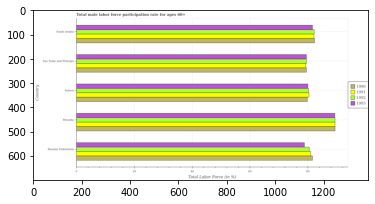

Number of QA =  30





,Country,1992,1993,1991,1990
0,Rwanda,89.664186,88.825230,89.693803,89.667687
1,Saudi Arabia,NaN,81.608805,82.167039,82.465839
2,Russian Federation,80.929751,79.270665,81.046576,81.907904
3,Sao Tome and Principe,79.811466,79.268290,NaN,79.536565
4,Samoa,80.160479,81.060872,80.430001,80.199080


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in 1992 in russian federation and that in rwanda ?
PREDICTED =  0.2
EXPECTED =  -8.900001525878906




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in 1993 in sao tome and principe and the male labor force participation rate in 1991 in samoa?
PREDICTED =  -1.7925817865152283
EXPECTED =  -0.9000015258789062




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in 1991 and male labor force participation rate in 1992 in saudi arabia ?
PRE

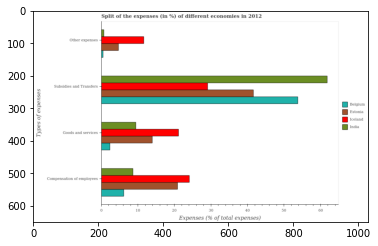

Number of QA =  29





,Types of expenses,Iceland,Belgium,India,Estonia
0,Goods and services,21.604752,2.479286,9.779449,14.195272
1,Subsidies and Transfers,29.246659,54.044676,62.269817,42.192671
2,Other expenses,11.758688,0.598051,0.810482,4.808638
3,Compensation of employees,24.843051,6.321027,8.846950,21.293765


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount spent on subsidies in india and that in estonia ?
PREDICTED =  -42.192671080470454
EXPECTED =  20.210638153169306




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount spent on other expenses in belgium and the percentage of amount spent on subsidies in estonia ?
PREDICTED =  -4.2105869766583375
EXPECTED =  -41.16658950764699




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount spent on goods and services and percentage of amount spent on compensation of employees in india ?
PREDICTE

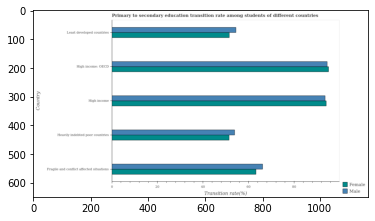

Number of QA =  28





,Country,Female,Male
0,High income,95.335000,94.820272
1,High income: OECD,95.964183,95.541663
2,Fragile and conflict affected situations,64.213326,67.266881
3,Heavily indebted poor countries,52.097648,54.729350
4,Least developed countries,52.384833,55.544641


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the transition rate among female students in heavily indebted poor countries and that in least developed countries ?
PREDICTED =  0.0
EXPECTED =  -0.087




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the transition rate among male students in heavily indebted poor countries and the transition rate among female students in high income: oecd ?
PREDICTED =  -40.09092177185595
EXPECTED =  -41.22246551513659




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the transition rate among female students and transition rate among male students in high income

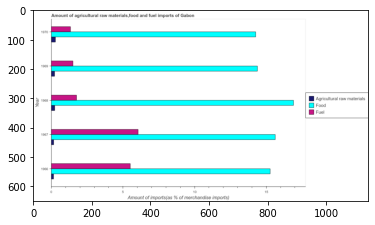

Number of QA =  29





,Year,Agricultural raw materials,Fuel,Food
0,1967,0.205346,6.158595,15.699566
1,1969,0.265248,1.564849,NaN
2,1970,0.333354,1.382159,14.367768
3,1968,0.271607,1.796017,16.984192
4,1966,0.201971,NaN,15.578758


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of raw materials imports in 1966 and that in 1967 ?
PREDICTED =  -0.0033754764318273955
EXPECTED =  -0.01




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of fuel imports in 1969 and the percentage of raw materials imports in 1967 ?
PREDICTED =  -4.5937453660310394
EXPECTED =  1.342258607565252




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1970, what is the difference between the percentage of food imports and percentage of raw materials imports ?
PREDICTED =  62.63028355346964
EXPECTED =  13.978




				 0 / 3 = 0.0


is_built_with_c

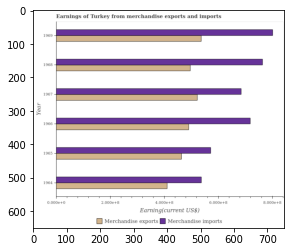

Number of QA =  28





,Year,Merchandise imports,Merchandise exports
0,1968,7.617768,4.970315
1,1969,7.928907,5.385795
2,1964,5.388460,4.137005
3,1967,6.900811,NaN
4,1965,5.701483,4.671535
5,1966,7.200836,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise exports in 1966 and that in 1969 ?
PREDICTED =  -5.385795498963208
EXPECTED =  -46330000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise exports in 1967 and the earnings from merchandise imports in 1965 ?
PREDICTED =  0.298779863667999
EXPECTED =  -49670000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the earnings from merchandise imports in 1

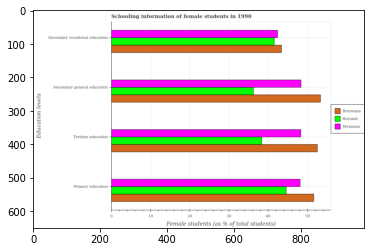

Number of QA =  29





,Education levels,Botswana,Burundi,Myanmar
0,Secondary vocational education,43.769183,41.745416,42.811193
1,Primary education,52.039509,45.258816,48.545214
2,Secondary general education,53.499028,36.691218,48.634753
3,Tertiary education,53.039035,38.580183,48.753991


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female students in secondary vocational education in botswana and that in myanmar ?
PREDICTED =  0.9579892682890545
EXPECTED =  0.9802200000000028




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female students in secondary vocational education in burundi and the percentage of female students in primary education in botswana ?
PREDICTED =  -2.0237663523852447
EXPECTED =  -10.068479999999987




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female students in secondary vocational education and pe

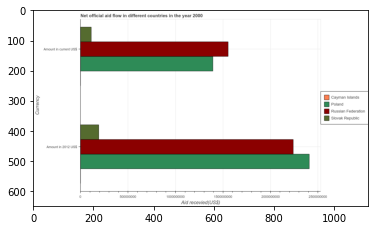

Number of QA =  20





,Currency,Cayman Islands,Russian Federation,Poland,Slovak Republic
0,Amount in 2012 US$,NaN,4.068083e+09,4.324678e+09,3.526788e+08
1,Amount in current US$,NaN,2.792718e+09,2.505869e+09,2.086704e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid received(expressed in us$) in poland and that in slovak republic ?
PREDICTED =  6621876557.914912
EXPECTED =  1280420000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid received(expressed in us$) in slovak republic and the amount of aid received(expressed in 2012 us$) in cayman islands ?
PREDICTED =  0.0
EXPECTED =  112990000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


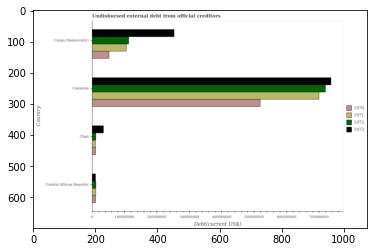

Number of QA =  30





,Country,1972,1971,1970,1973
0,Congo (Democratic),1.161306e+08,1.097236e+08,5.458428e+07,2.587740e+08
1,Colombia,7.271332e+08,7.117538e+08,5.254518e+08,7.453368e+08
2,Central African Republic,1.402297e+07,1.368025e+07,1.331882e+07,1.298811e+07
3,Chad,1.353439e+07,1.215505e+07,1.321613e+07,3.755165e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt in 1972 in colombia and that in congo (democratic) ?
PREDICTED =  611002636.9276028
EXPECTED =  607072000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt in 1973 in congo (democratic) and the total debt in 1972 in central african republic?
PREDICTED =  245785933.1909136
EXPECTED =  241271000.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt in 1971 and total debt in 1973 in congo (democratic) ?
PREDICTED =  588538667.0974059
EXPECTED =  -147364000.0




				 2 / 3 = 0.6667


is_built_with_cuda: True


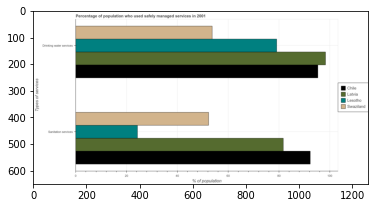

Number of QA =  23





,Types of services,Latvia,Lesotho,Chile,Swaziland
0,Drinking water services,99.617573,79.965664,NaN,54.201613
1,Sanitation services,81.568662,24.564493,NaN,52.741517


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population who used drinking water services in lesotho and that in chile ?
PREDICTED =  0.0
EXPECTED =  -16.200000000000003




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  % of population
EXPECTED =  20.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Percentage of

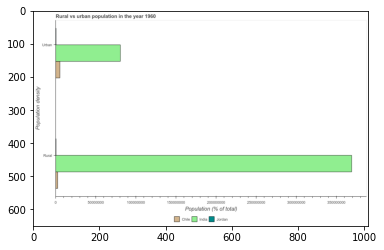

Number of QA =  23





,Population density,India,Chile,Jordan
0,Urban,1.462043e+08,1.089681e+07,NaN
1,Rural,6.629407e+08,5.769363e+06,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population density in india and the rural population density in chile ?
PREDICTED =  135307480.63152164
EXPECTED =  78122152




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population density and rural population density in jordan ?
PREDICTED =  146204287.16318685
EXPECTED =  14838




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major tick

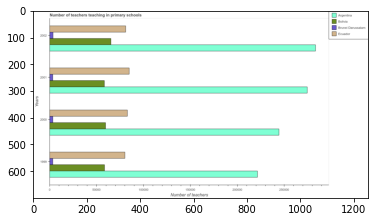

Number of QA =  30





,Years,Brunei Darussalam,Bolivia,Argentina,Ecuador
0,2002,7249.171448,117982.408769,513460.410513,147646.266188
1,2001,6693.835838,106461.345112,499346.166362,155034.405191
2,2000,7131.273877,108880.375894,443201.733102,149896.951331
3,1999,6957.246025,107583.003384,402240.486030,146478.818043


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of teachers teaching in primary schools in brunei darussalam in 2000 and that in 2001 ?
PREDICTED =  437.4380388107238
EXPECTED =  62.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of teachers teaching in primary schools in bolivia in 2000 and the number of teachers teaching in primary schools in ecuador in 2001 ?
PREDICTED =  2419.030782236412
EXPECTED =  -25233.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the number of teachers teaching in primary schools in bolivia and number of teachers teaching

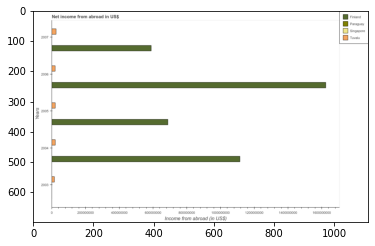

Number of QA =  26





,Years,Finland,Singapore,Tuvalu,Paraguay
0,2007,5.944183e+08,NaN,2.925263e+07,NaN
1,2004,1.125413e+09,NaN,2.364165e+07,NaN
2,2006,1.623027e+09,NaN,2.315905e+07,NaN
3,2005,6.901990e+08,NaN,2.366387e+07,NaN
4,2003,NaN,NaN,2.002190e+07,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net income from abroad in finland in 2005 and that in 2007 ?
PREDICTED =  95780724.61995637
EXPECTED =  99000000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net income from abroad in paraguay in 2004 and the net income from abroad in singapore in 2005 ?
PREDICTED =  0.0
EXPECTED =  0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net income from abroad in tuvalu in 2003 to that in 20

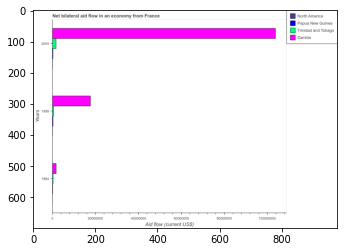

Number of QA =  30





,Years,North America,Zambia,Papua New Guinea,Trinidad and Tobagc
0,1999,NaN,1.811283e+07,559334.227255,8.307306e+05
1,1984,NaN,2.045655e+06,NaN,NaN
2,2004,NaN,1.053687e+08,NaN,1.986566e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in papua new guinea in 2004 and the net bilateral aid flow in north america in 1984 ?
PREDICTED =  0.0
EXPECTED =  230000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1984, what is the difference between the net bilateral aid flow in north america and net bilateral aid flow in trinidad and tobago ?
PREDICTED =  -2.0
EXPECTED =  -320000.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net

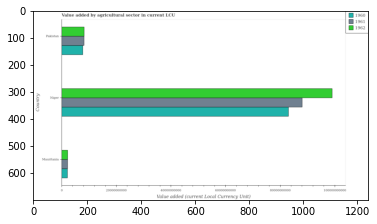

Number of QA =  29





,Country,1962,1961,1960
0,Niger,1.000383e+11,8.852070e+10,8.368739e+10
1,Mauritania,2.370963e+09,2.342234e+09,2.275785e+09
2,Pakistan,8.360327e+09,8.421414e+09,7.972274e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector in 1960 in mauritania and that in pakistan ?
PREDICTED =  -5696488588.949083
EXPECTED =  -5607949600.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector in 1962 in pakistan and the value added by agricultural sector in 1961 in mauritania?
PREDICTED =  5989363495.90589
EXPECTED =  6056110600.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector in 1961 and value added by agricultural sector in 1962 in mauritania ?
PREDICTED =  96913384589

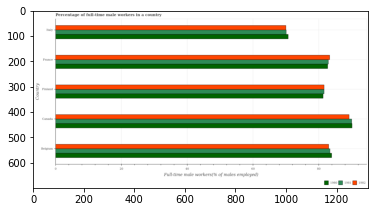

Number of QA =  29





,Country,1982,1980,1981
0,France,83.544059,83.314324,82.933869
1,Canada,89.355554,89.508507,90.473075
2,Finland,82.229478,81.581436,80.783453
3,Belgium,83.470687,83.932381,83.525444
4,Italy,70.024404,70.461577,70.400420


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time male workers in 1981 in canada and that in france ?
PREDICTED =  7.539205036707813
EXPECTED =  7.099998474121094




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time male workers in 1981 in italy and the percentage of full-time male workers in 1980 in finland?
PREDICTED =  -10.38303281157215
EXPECTED =  -11.200004577636804




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time male workers in 1982 and percentage of full-time male workers in 1980 in finland ?
PREDICTED =  7.77

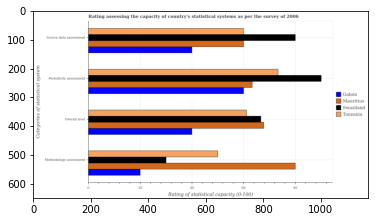

Number of QA =  29





,Categories of statistical system,Tanzania,Mauritius,Gabon,Swaziland
0,Overall level,61.633361,67.924100,40.442879,66.631063
1,Methodology assessment,NaN,80.308561,20.235132,30.396877
2,Periodicity assessment,73.312283,63.495501,60.577577,NaN
3,Source data assessment,60.276897,59.956135,39.979471,80.166105


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the periodicity assessment rating in gabon and that in mauritius ?
PREDICTED =  -2.9179245711362753
EXPECTED =  -3.3333299999999966




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the methodology assessment rating in tanzania and the source data assessment rating in gabon ?
PREDICTED =  -39.97947106707768
EXPECTED =  10




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the source data assessment rating and methodology assessment rating in tanzania ?
PREDICTED =  19.889208042675435
EXPECTED =  10




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gp

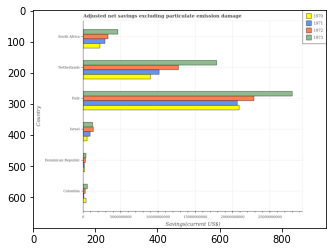

Number of QA =  30





,Country,1972,1971,1970,1973
0,South Africa,6.141076e+09,5.399285e+09,4.175938e+09,8.474505e+09
1,Dominican Republic,6.888469e+08,4.173585e+08,4.497819e+08,8.473305e+08
2,Netherlands,2.293466e+10,1.843927e+10,1.626831e+10,3.151582e+10
3,Colombia,6.186547e+08,NaN,8.211791e+08,1.159876e+09
4,Israel,2.589160e+09,1.797596e+09,1.100059e+09,2.439902e+09
5,Italy,4.115631e+10,NaN,3.759893e+10,5.048902e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adjusted net savings in 1972 in israel and that in italy ?
PREDICTED =  -38567145628.36649
EXPECTED =  -21502894271.50724




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adjusted net savings in 1970 in colombia and the adjusted net savings in 1973 in south africa?
PREDICTED =  -3354758498.136821
EXPECTED =  -4248251500.983969




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adjusted net savings in 1971 and adjusted net savings in 1972 in dominican republic ?
PREDICTED =  -688846943.3740793
EXPECTED =  -157144500.895377




				 0 / 3 =

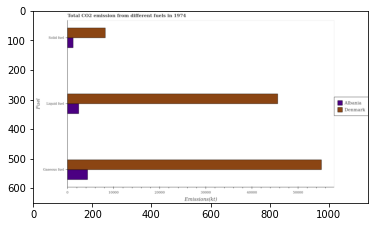

Number of QA =  28





,Fuel,Albania,Denmark
0,Solid fuel,1377.518849,8388.389585
1,Gaseous fuel,4507.397556,55310.554499
2,Liquid fuel,2576.526822,45744.317550


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emissions from solid fuel in denmark and that in albania ?
PREDICTED =  7010.870735510685
EXPECTED =  6978.301




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emissions from liquid fuel in albania and the amount of co2 emissions from solid fuel in denmark ?
PREDICTED =  -51556.18031291313
EXPECTED =  -5764.523999999999




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emissions from liquid fuel and amount of co2 emissions from gaseous fuel in albania ?
PREDICTED =  -1930.8707335486442
EXPECTED =

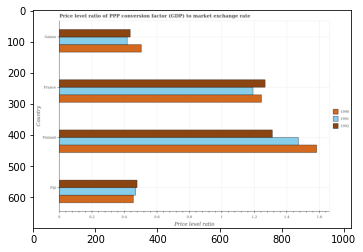

Number of QA =  29





,Country,1992,1990,1991
0,Gabon,0.437759,0.509375,0.416081
1,France,1.264506,1.239681,1.192271
2,Finland,1.306323,1.576250,1.471198
3,Fiji,0.481934,0.457585,0.472607


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the price level ratio in 1992 in france ?
PREDICTED =  0.31612652377831396
EXPECTED =  1.26620570012392




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum price level ratio in 1991 ?
PREDICTED =  0.3677995283708185
EXPECTED =  1.47133068666373




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum price level ratio in 1990 ?
PREDICTED =  0.11439634809682606
EXPECTED =  0.45490475582866




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0

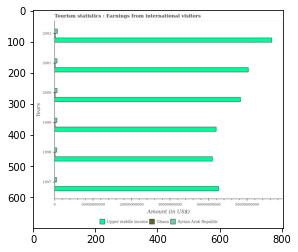

Number of QA =  29





,Years,Syrian Arab Republic,Ghana,Upper middle income
0,1997,6.912073e+08,NaN,4.321392e+10
1,2001,8.363540e+08,NaN,5.094927e+10
2,1998,7.496475e+08,NaN,4.104410e+10
3,2002,9.265291e+08,NaN,5.695318e+10
4,2000,8.321375e+08,NaN,4.895527e+10
5,1999,7.853814e+08,NaN,4.262100e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from international visitors in syrian arab republic in 1998 and that in 2002 ?
PREDICTED =  -176881646.78735065
EXPECTED =  -177000000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from international visitors in syrian arab republic in 1997 and the earnings from international visitors in upper middle income in 2001 ?
PREDICTED =  -145146697.7992059
EXPECTED =  -49764959303.9868




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the earnings from international visitors in ghana and earnings from interna

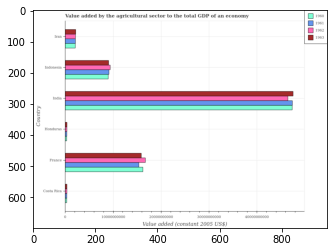

Number of QA =  30





,Country,1963,1962,1961,1960
0,France,NaN,1.697902e+10,1.549088e+10,1.627847e+10
1,Costa Rica,4.872219e+08,4.769013e+08,4.635310e+08,4.454676e+08
2,Indonesia,9.251839e+09,9.546168e+09,9.264491e+09,9.066823e+09
3,India,4.741846e+10,NaN,4.721507e+10,4.732434e+10
4,Honduras,4.880016e+08,4.743743e+08,4.720382e+08,4.270768e+08
5,Iran,2.298456e+09,2.216856e+09,2.246779e+09,2.254611e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the agricultural sector in 1962 in france and that in indonesia ?
PREDICTED =  7432848978.243166
EXPECTED =  7340330250.68902




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the agricultural sector in 1963 in india and the value added by the agricultural sector in 1962 in honduras?
PREDICTED =  46930458149.242035
EXPECTED =  47211149603.95697




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the agricultural sector in 1962 and value added by the agricultural sector in 1960 in france ?
PREDICT

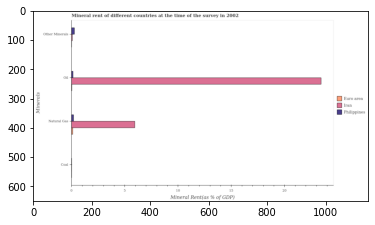

Number of QA =  29





,Minerals,Philippines,Iran,Euro area
0,Coal,NaN,NaN,NaN
1,Other Minerals,0.316944,NaN,NaN
2,Natural Gas,0.234983,6.012652,0.159146
3,Oil,0.184602,23.484785,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the natural gas rent in euro area to that in iran ?
PREDICTED =  1.0
EXPECTED =  0.018656296211954592




				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finishe

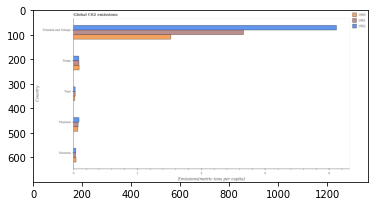

Number of QA =  29





,Country,1962,1961,1960
0,Trinidad and Tobago,8.270312,5.395502,3.030158
1,Thailand,0.172839,0.147310,0.136744
2,Tanzania,0.076499,0.073812,0.089710
3,Tonga,0.166983,0.173832,0.183169
4,Togo,0.057681,0.058023,0.043521


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in in 1960 in thailand and that in tonga ?
PREDICTED =  -0.04642481355973446
EXPECTED =  -0.04300176367320788




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in in 1962 in trinidad and tobago and the amount of co2 emitted in in 1960 in tanzania?
PREDICTED =  8.193812824806633
EXPECTED =  8.14330869516198




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in in 1961 and amount of co2 emitted in in 1960 in tanzania ?
PREDICTED =  4.9102903701991325
EXPECTED =  -0.01438924633

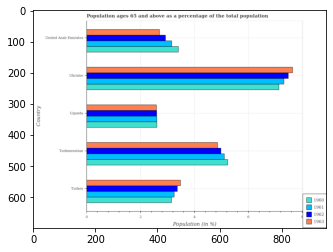

Number of QA =  30





,Country,1963,1962,1961,1960
0,Turkmenistan,4.898208,4.975488,NaN,5.236316
1,Turkey,3.506891,3.383623,3.280789,3.176000
2,Ukraine,7.646007,7.532819,7.366676,7.129076
3,United Arab Emirates,2.735774,2.948832,3.161217,3.437507
4,Uganda,2.607142,2.625601,2.631548,2.626684


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of the population ages 65 and above in 1961 in turkmenistan to that in ukraine ?
PREDICTED =  1.0
EXPECTED =  0.6977958211834513




				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Tra

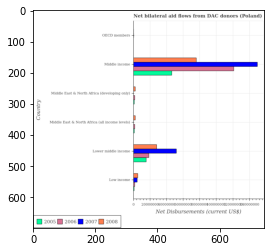

Number of QA =  27





,Country,2007,2005,2006,2008
0,Lower middle income,5.079021e+09,1.540518e+09,1.841813e+09,2.697187e+09
1,Middle income,1.419825e+10,4.492692e+09,1.151047e+10,7.255356e+09
2,Low income,5.052399e+08,NaN,NaN,5.678863e+08
3,OECD members,NaN,NaN,NaN,NaN
4,Middle East & North Africa (all income levels),NaN,1.878348e+08,NaN,2.845117e+08
5,Middle East & North Africa (developing only),NaN,NaN,NaN,2.795471e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flows in 2008 in middle east & north africa (developing only) and that in middle income ?
PREDICTED =  282029374.9517833
EXPECTED =  -73700000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flows in 2005 in lower middle income and the net bilateral aid flows in 2007 in middle east & north africa (all income levels)?
PREDICTED =  1352683069.6081843
EXPECTED =  15320000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation 

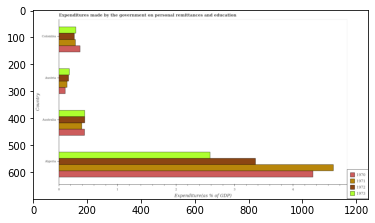

Number of QA =  30





,Country,1972,1971,1970,1973
0,Australia,0.453812,0.402854,0.451292,0.450408
1,Austria,0.173907,0.150502,0.117121,0.189370
2,Colombia,0.272841,0.293634,0.367630,0.296457
3,Algeria,3.372061,4.690384,4.360745,2.572440


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditures made by the government on personal remittances and education in 1973 in austria and that in colombia ?
PREDICTED =  3.810630319994407
EXPECTED =  -0.11028564620633688




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditures made by the government on personal remittances and education in 1970 in austria and the expenditures made by the government on personal remittances and education in 1971 in algeria?
PREDICTED =  3.849497797364576
EXPECTED =  -4.57951072054551




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expendit

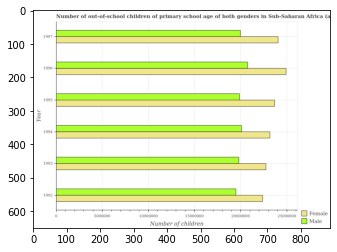

Number of QA =  28





,Year,Female,Male
0,1994,4.220067e+07,3.670766e+07
1,1996,4.528846e+07,3.755221e+07
2,1997,4.381847e+07,3.622508e+07
3,1995,4.285019e+07,3.604730e+07
4,1993,4.126056e+07,3.597256e+07
5,1992,4.074180e+07,3.541275e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of female out-of-school students in 1992 and that in 1996 ?
PREDICTED =  -4546655.286072701
EXPECTED =  -2533576




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of female out-of-school students in 1992 and the number of male out-of-school students in 1996 ?
PREDICTED =  -4546655.286072701
EXPECTED =  1638800




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the number of male out-of-school students and number of female out-of-school students ?
PREDICTED =  0.0
EXPECTED =  -4087768




				 0 / 3 = 0.0


is_bu

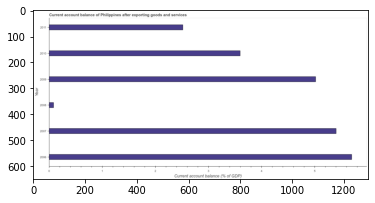

Number of QA =  23





,Year,Current account balance (% of GDP)
0,2011,2.525800
1,2010,3.612311
2,2008,0.091829
3,2007,5.394257
4,2009,5.021246
5,2006,5.749515


> what is the title of the graph ?
PREDICTED =  Current account balance of Philippines after exporting goods and services
EXPECTED =  Current account balance of Philippines after exporting goods and services




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Current account balance (% of GDP)
EXPECTED =  Current account balance (% of GDP)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the current account balance in 2006 and 2009 ?
PREDICTED =  0.728268556806813
EXPECTED =  0.679




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median current account balance ?
PREDICTED =  0.09182904789401666
EXPE

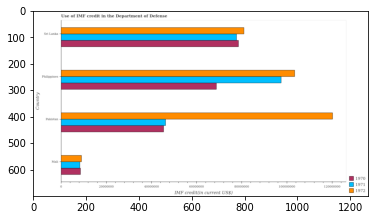

Number of QA =  29





,Country,1972,1971,1970
0,Sri Lanka,8.153288e+07,7.791476e+07,7.904924e+07
1,Philippines,1.035264e+08,9.798389e+07,6.947380e+07
2,Pakistan,1.217387e+08,4.662136e+07,4.623702e+07
3,Mali,9.191982e+06,8.536415e+06,8.812198e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the imf credit in the department of defense in 1970 in philippines and that in sri lanka ?
PREDICTED =  -9575443.313448116
EXPECTED =  -9770000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the imf credit in the department of defense in 1971 in sri lanka and the imf credit in the department of defense in 1970 in philippines?
PREDICTED =  -20069124.573562905
EXPECTED =  8914000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.

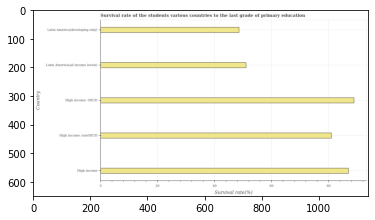

Number of QA =  22





,Country,Survival rate(%)
0,High income,87.781970
1,Latin America(all income levels),52.040049
2,High income: OECD,89.826564
3,High income: nonOECD,81.577799
4,Latin America(developing only),49.311263


> what is the title of the graph ?
PREDICTED =  Survival rate of the students various countries to the last grade of primary educatic
EXPECTED =  Survival rate of the students various countries to the last grade of primary education




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Survival rate(%)
EXPECTED =  Survival rate(%)




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the survival rate in primary education in high income: nonoecd and latin america(all income levels) ?
PREDICTED =  29.53774913726047
EXPECTED =  29.939




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median survival 

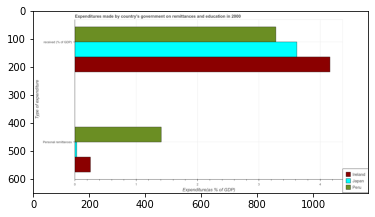

Number of QA =  23





,Type of expenditure,Japan,lreland,Peru
0,received (% of GDP),3.648053,4.163094,3.286762
1,Personal remittances,0.039372,0.268028,1.414898


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Expenditure(as % of GDP)
EXPECTED =  1.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Expenditures made by country's government on remittances and education in 2000
EXPECTED =  Expenditures made by country's government on remittances and education in 2000




				 1 /

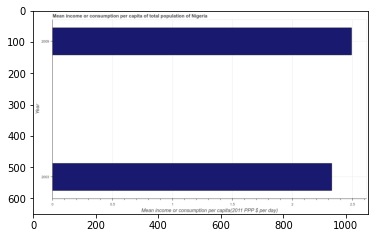

Number of QA =  19





,Year,Mean income or consumption per capita(2011 PPP $ per day)
0,2009,2.506747
1,2003,2.313018


> what is the title of the graph ?
PREDICTED =  Mean income or consumption per capita of total population of Nigeria
EXPECTED =  Mean income or consumption per capita of total population of Nigeria




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Mean income or consumption per capita(2011 PPP $ per day)
EXPECTED =  Mean income or consumption per capita(2011 PPP $ per day)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the mean income or consumption in 2003 and 2009 ?
PREDICTED =  -0.19372971055772936
EXPECTED =  -0.166




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median mean income or consu

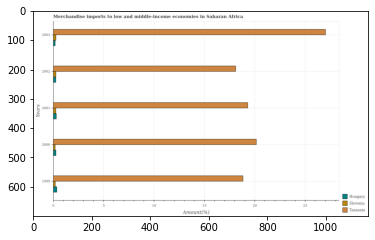

Number of QA =  29





,Years,Tanzania,Slovenia,Hungary
0,2003,26.957775,0.332687,0.234379
1,2000,20.294930,0.248105,0.312512
2,2002,18.268647,0.326681,0.304923
3,2001,19.367045,0.320514,0.343903
4,1999,18.751699,0.258089,0.392194


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in hungary in 2000 and that in 2003 ?
PREDICTED =  0.07813318376844572
EXPECTED =  0.0734557293778951




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in hungary in 2000 and the percentage of amount earned from merchandise imports in tanzania in 2003 ?
PREDICTED =  0.07813318376844572
EXPECTED =  -26.748688355338373




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the percentage of amount earned from merchandise import

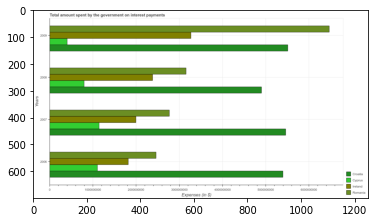

Number of QA =  30





,Years,Cyprus,Croatia,Romania,Ireland
0,2009,4.054730e+08,5.532841e+09,6.497101e+09,3.295467e+09
1,2008,8.107879e+08,4.914817e+09,3.148880e+09,2.390439e+09
2,2007,1.156414e+09,5.478996e+09,2.767606e+09,2.015857e+09
3,2006,1.111219e+09,5.441183e+09,2.465880e+09,1.830111e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on interest payments by the government in romania in 2006 and that in 2007 ?
PREDICTED =  -301726118.31091595
EXPECTED =  -308513890.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on interest payments by the government in croatia in 2006 and the amount spent on interest payments by the government in cyprus in 2008 ?
PREDICTED =  526365822.7472334
EXPECTED =  4601987749.327665




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the amount spent on interest payments by the government in croatia and

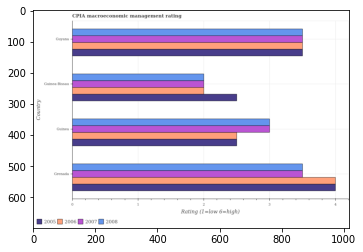

Number of QA =  30





,Country,2007,2005,2006,2008
0,Guinea,2.987262,2.507200,2.518330,3.017895
1,Grenada,3.522378,4.035346,4.043309,3.514493
2,Guinea-Bissau,1.997403,2.524284,2.032040,2.019542
3,Guyana,3.536447,3.517677,3.544793,3.520926


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2008 in guinea-bissau and that in guyana ?
PREDICTED =  -1.5013844533717147
EXPECTED =  -1.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2008 in guinea and the cpia rating in 2006 in guinea-bissau?
PREDICTED =  0.9983532531558845
EXPECTED =  1.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cpia rating in 2007 in guinea-bissau to that in guyana ?
PREDICTE

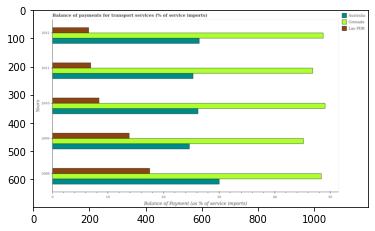

Number of QA =  29





,Years,Grenada,Australia,Lao PDR
0,2010,49.911244,26.427297,8.576155
1,2012,49.200371,26.800417,6.652344
2,2011,47.049848,25.552854,7.009453
3,2009,45.435606,24.719639,NaN
4,2008,48.754277,30.190911,17.740327


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services in australia in 2008 and that in 2011 ?
PREDICTED =  4.638056550804649
EXPECTED =  4.7151070233481995




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services in australia in 2009 and the balance of payments for transport services in grenada in 2012 ?
PREDICTED =  -28.508074625413187
EXPECTED =  -24.07708399218531




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the balance of payments for transport services in lao pdr and balance of payments for

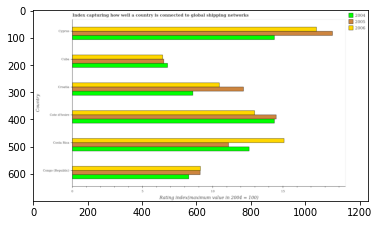

Number of QA =  29





,Country,2005,2004,2006
0,Cuba,6.598519,6.779347,6.512814
1,Croatia,12.144842,8.574320,10.490994
2,Costa Rica,11.169510,12.699709,15.222703
3,Cote d'Ivoire,14.390123,14.419207,12.990280
4,Cyprus,19.127579,14.439400,17.447415
5,Congo (Republic),9.157915,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating index in 2005 in cote d'ivoire and that in cyprus ?
PREDICTED =  -4.737455853540787
EXPECTED =  -4.010000000000002




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating index in 2006 in cote d'ivoire and the rating index in 2005 in costa rica?
PREDICTED =  -2.232422962048533
EXPECTED =  1.8600000000000012




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating index in 2004 and rating index in 2005 in cote d'ivoire ?
PREDICTED =  0.049277217411212604
EXPECTED =  -0.129999999999999




				 0 / 3 = 0.0


is_built_with_cuda: True

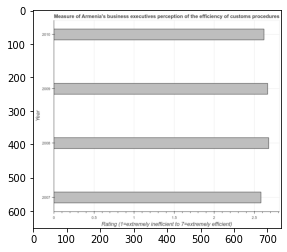

Number of QA =  23





,Year,Rating (1=extremely inefficient to 7=extremely efficient)
0,2007,2.571925
1,2009,2.651209
2,2008,2.667352
3,2010,2.609967


> what is the title of the graph ?
PREDICTED =  Measure of Armenia's business executives perception of the efficiency of customs procedures
EXPECTED =  Measure of Armenia's business executives perception of the efficiency of customs procedures




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Rating (1=extremely inefficient to 7=extremely efficient)
EXPECTED =  Rating (1=extremely inefficient to 7=extremely efficient)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating measuring burden of customs procedure in 2007 and 2010 ?
PREDICTED =  -0.038042102343571305
EXPECTED =  -0.038




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after

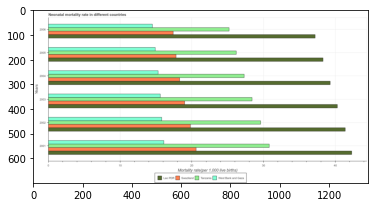

Number of QA =  30





,Years,Tanzania,West Bank and Gaza,Swaziland,Lao PDR
0,2004,NaN,15.387511,NaN,NaN
1,2006,26.277291,NaN,17.249219,37.249487
2,2005,26.286247,14.783099,17.687847,37.758123
3,2003,NaN,NaN,18.970723,NaN
4,2001,30.923726,NaN,20.351825,42.243889
5,2002,29.856292,NaN,19.641615,41.125335


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the neonatal mortality rate in tanzania in 2005 and the neonatal mortality rate in west bank and gaza in 2001 ?
PREDICTED =  -4.6374786360296305
EXPECTED =  10.099999999999998




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the hig

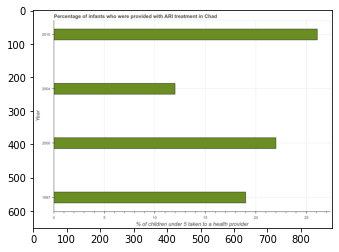

Number of QA =  23





,Year,% of children under 5 taken to a health provider
0,2004,12.045234
1,1997,18.841631
2,2000,22.002033
3,2010,26.145909


> what is the title of the graph ?
PREDICTED =  Percentage of infants who were provided with ARI treatment in Chad
EXPECTED =  Percentage of infants who were provided with ARI treatment in Chad




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  % of children under 5 taken to a health provider
EXPECTED =  % of children under 5 taken to a health provider




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who were provided with ari treatment in 2004 and 2010 ?
PREDICTED =  -14.100674579532715
EXPECTED =  -14.1




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage o

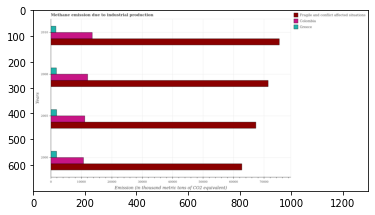

Number of QA =  29





,Years,Fragile and conflict affected situations,Greece,Colombia
0,2010,75223.075227,1821.492912,13723.266505
1,2000,62576.397128,2061.022079,10966.327974
2,2005,67443.774803,2075.962528,11368.675984
3,2008,71455.821816,1998.797993,12175.316769


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emitted in greece in 2000 and that in 2005 ?
PREDICTED =  -14.9404485119544
EXPECTED =  -24.600000000000136




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emitted in colombia in 2010 and the amount of methane emitted in fragile and conflict affected situations in 2005 ?
PREDICTED =  2354.5905212920443
EXPECTED =  -53697.100000000006




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the amount of methane emitted in fragile and conflict affected situations and amount of methane emitted in

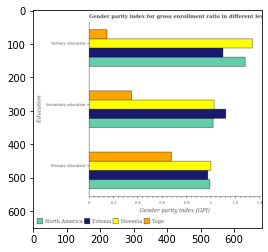

Number of QA =  28





,Education,Estonia,Slovenia,Togo,North America
0,Primary education,0.974115,0.999963,0.676013,0.987702
1,Secondary education,1.121144,1.030859,0.351129,1.018735
2,Tertiary education,1.096153,1.344255,0.150236,1.277537


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gender parity index in secondary education in slovenia and that in north america ?
PREDICTED =  0.012124482384396451
EXPECTED =  0.007959964637759942




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gender parity index in tertiary education in slovenia and the gender parity index in primary education in north america ?
PREDICTED =  0.0667183750899758
EXPECTED =  0.347979989013672




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gender parity index in secondary education and gender parity index in tertiary education in estonia ?
PREDICTE

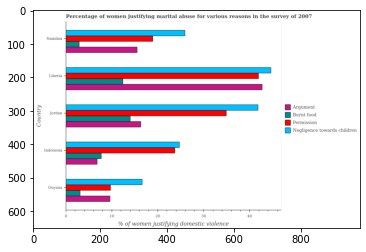

Number of QA =  30





,Country,Permission,Negligence towards children,Argument,Burnt food
0,Liberia,42.376442,45.048092,43.202763,12.674027
1,Namibia,18.947390,NaN,15.696742,3.004791
2,Guyana,9.885339,16.856983,9.684864,3.170110
3,Jordan,35.538071,42.021597,16.440971,14.105812
4,Indonesia,23.593054,NaN,7.000386,7.844423


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of women justifying abuse in the case of an argument in indonesia and that in liberia ?
PREDICTED =  -36.2023765611628
EXPECTED =  -35.9




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of women justifying abuse in the case of an argument in liberia to that in namibia ?
PREDICTED =  2.752339514560934
EXPECTED =  2.755




				 2 / 4 = 0.5


is_built_with_cuda: 

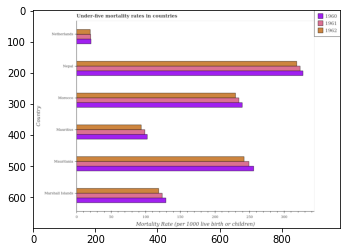

Number of QA =  29





,Country,1962,1961,1960
0,Nepal,575.045617,586.263713,592.212064
1,Morocco,416.960411,423.283882,434.537346
2,Mauritius,171.403709,NaN,188.067175
3,Marshall Islands,NaN,226.065635,234.254652
4,Netherlands,36.487694,38.177116,38.717786
5,Mauritania,439.320093,451.160330,463.508513


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-five mortality rate in 1961 in morocco and that in nepal ?
PREDICTED =  -162.97983071818396
EXPECTED =  -88.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-five mortality rate in 1960 in netherlands and the under-five mortality rate in 1962 in mauritius?
PREDICTED =  -149.34938894815855
EXPECTED =  -72.60000000000001




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the under-five mort

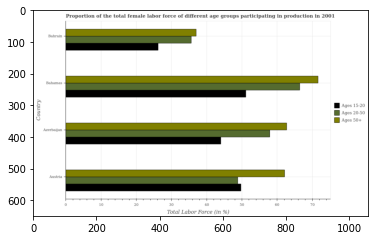

Number of QA =  29





,Country,Ages 50+,Ages 20-50,Ages 15-20
0,Austria,62.667423,48.976455,49.859786
1,Bahamas,71.382970,66.437382,50.995190
2,Bahrain,36.868699,35.669934,26.098381
3,Azerbaijan,62.671684,57.632952,43.959387


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force within the age group 15-20 in austria and that in azerbaijan ?
PREDICTED =  5.900398671851285
EXPECTED =  5.7




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force within the age group 15-20 in austria and the percentage of female labor force within the age group 20-50 in bahrain ?
PREDICTED =  14.18985189804917
EXPECTED =  14.100002288818402




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fini

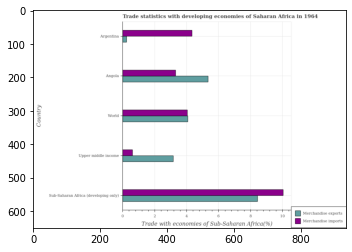

Number of QA =  28





,Country,Merchandise imports,Merchandise exports
0,Argentina,4.341515,0.289284
1,Angola,3.329041,5.365630
2,World,4.060322,4.073683
3,Upper middle income,0.664074,3.206749
4,Sub-Saharan Africa (developing only),9.992718,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in sub-saharan africa (developing only) and that in world ?
PREDICTED =  nan
EXPECTED =  4.364




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in world and the merchandise imports in upper middle income ?
PREDICTED =  0.8669335607048092
EXPECTED =  3.4607870154269467




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports and merchandise imports in sub-saharan africa (developing only) ?
PREDICTED =  -6.3525026251089685
EXPECTED =  -1.606




				 0 / 3 = 0.0


is_built_with_cuda: Tru

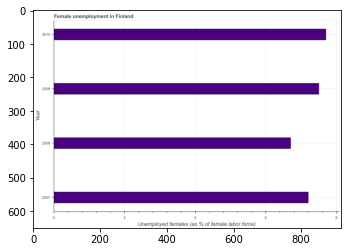

Number of QA =  23





,Year,Unemployed females (as % of female labor force)
0,2007,7.194800
1,2008,6.737260
2,2009,7.450364
3,2010,7.742469


> what is the title of the graph ?
PREDICTED =  Female unemployment in Finland
EXPECTED =  Female unemployment in Finland




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Unemployed females (as % of female labor force)
EXPECTED =  Unemployed females (as % of female labor force)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed females population in 2007 and 2008 ?
PREDICTED =  0.45754005730208114
EXPECTED =  0.5




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed females population ?
PREDICTED =  2008.5
EXPECTED =  7.34999990463257




				 3 / 5 = 0.6


is_built_with

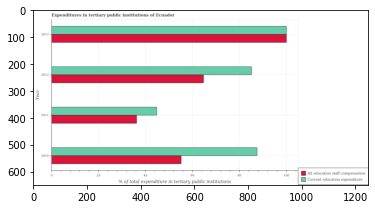

Number of QA =  28





,Year,All education staff compensation,Current education expenditure
0,2011,36.845563,45.481880
1,2012,65.394932,85.918266
2,2013,101.204249,100.493118
3,2010,55.954064,87.213905


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in education in 2011 and that in 2012 ?
PREDICTED =  -40.43638607815693
EXPECTED =  -40.336




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in education in 2011 and the expenditure in staff compensation in 2010 ?
PREDICTED =  -41.73202475619722
EXPECTED =  -10.362960815429702




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the expenditure in education and expenditure in staff compensation ?
PREDICTED =  27.621767638662902
EXPECTED =  32.343




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu

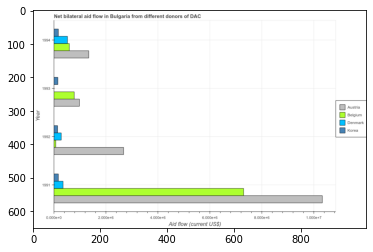

Number of QA =  27





,Year,Korea,Belgium,Austria,Denmark
0,1993,0.169322,0.809548,0.997591,NaN
1,1992,0.163414,0.088714,2.691450,0.303968
2,1991,0.189978,7.223711,10.328062,0.368759
3,1994,0.190525,0.608137,1.360858,0.535524


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by korea in 1991 and that in 1994 ?
PREDICTED =  -0.0005476355571141511
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by denmark in 1994 and the amount of aid given by austria in 1993 ?
PREDICTED =  0.5355243106317238
EXPECTED =  -460000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1992, what is the difference between the amount of aid given by denmark and amount of aid given by korea ?
PREDICTED =  2.286760883552888
EXPECTED =  140000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available

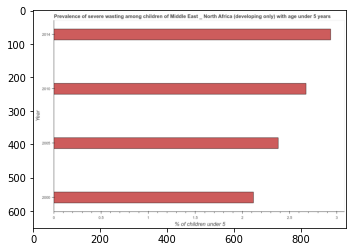

Number of QA =  23





,Year,% of children under 5
0,2000,2.114808
1,2005,2.375980
2,2014,2.947197
3,2010,2.670181


> what is the title of the graph ?
PREDICTED =  Prevalence of severe wasting among children of Middle East North Africa (developing only) with age under 5 years
EXPECTED =  Prevalence of severe wasting among children of Middle East _ North Africa (developing only) with age under 5 years




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  % of children under 5
EXPECTED =   % of children under 5




				 0 / 2 = 0.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the prevalence of severe wasting in 2000 and 2014 ?
PREDICTED =  -0.8323896134198332
EXPECTED =  -0.819




				 2 / 4 = 0.5


> what is the median prevalence of severe wasting ?
PREDICTED =  None
EXPECTED =  2.526898




				 2 / 6 = 0.3333


is_built_with_cuda: True
is_gpu_ava

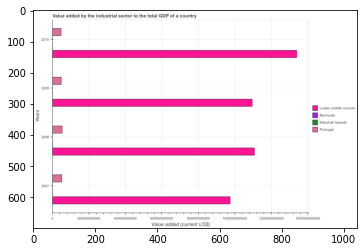

Number of QA =  30





,Years,Portugal,Bermuda,Marshall Islands,Lower middie income
0,2010,5.102597e+10,NaN,NaN,1.340238e+12
1,2008,5.639719e+10,NaN,NaN,1.105106e+12
2,2009,5.156452e+10,NaN,NaN,1.092122e+12
3,2007,5.420083e+10,NaN,NaN,9.735692e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector to the total gdp in marshall islands in 2008 and that in 2010 ?
PREDICTED =  -235131737630.54932
EXPECTED =  1196975.4266093895




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector to the total gdp in bermuda in 2010 and the value added by the industrial sector to the total gdp in portugal in 2008 ?
PREDICTED =  1283840893999.9763
EXPECTED =  -53114425520.5801




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predic

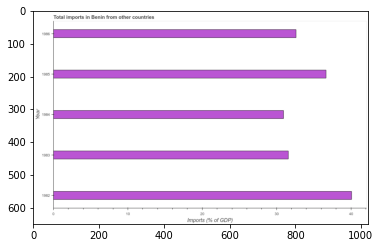

Number of QA =  23





,Year,Imports (% of GDP)
0,1986,32.653691
1,1982,40.159788
2,1983,31.672022
3,1984,30.832992
4,1985,36.769275


> what is the title of the graph ?
PREDICTED =  Total imports in Benin from other countries
EXPECTED =  Total imports in Benin from other countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Imports (% of GDP)
EXPECTED =  Imports (% of GDP)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports in 1985 and 1986 ?
PREDICTED =  4.115584311437921
EXPECTED =  4.033




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total imports ?
PREDICTED =  32.65369088209191
EXPECTED =  32.6154967527009




				 5 / 5 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training 

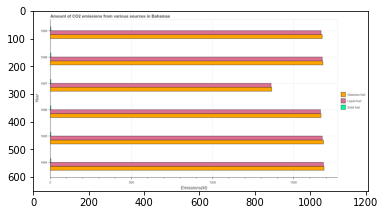

Number of QA =  29





,Year,Gaseous fuel,Liquid fuel,Solid fuel
0,1994,1692.582955,1682.368546,NaN
1,1996,NaN,1669.453793,NaN
2,1998,1674.921271,1683.828132,NaN
3,1995,NaN,1666.729699,NaN
4,1997,1355.278083,1356.621352,NaN
5,1999,1658.448730,1671.883139,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emissions from gaseous fuel in 1997 and that in 1999 ?
PREDICTED =  -303.17064675268193
EXPECTED =  -311.695




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emissions from gaseous fuel in 1996 and the amount of co2 emissions from solid fuel in 1998 ?
PREDICTED =  -1672.9212713698678
EXPECTED =  1664.818




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the amount of co2 emissions from liquid fuel and amount of co2 emissions from gaseous fuel ?
PREDICTED =  9726.884660616446
EXPECTED =  -7.334




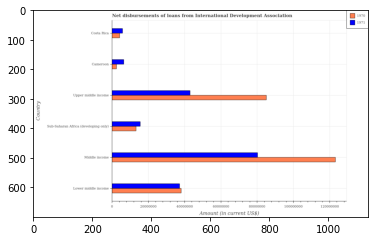

Number of QA =  28





,Country,1971,1970
0,Cameroon,6.773958e+06,2.686302e+06
1,Lower middle income,3.759171e+07,3.832574e+07
2,Middle income,8.141871e+07,1.227680e+08
3,Costa Rica,6.081917e+06,4.566492e+06
4,Upper middle income,4.336223e+07,8.678409e+07
5,Sub-Saharan Africa (developing only),1.581886e+07,1.339774e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loans disbursed in 1971 in cameroon and that in upper middle income ?
PREDICTED =  -36588271.799237855
EXPECTED =  -36579000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loans disbursed in 1971 in costa rica and the amount of loans disbursed in 1970 in lower middle income?
PREDICTED =  -31509797.847124416
EXPECTED =  -32354000.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loans disbursed in 1971 and amount of loans disbursed in 1970 in sub-saharan africa (developing only) ?
PREDICTED =  177649654

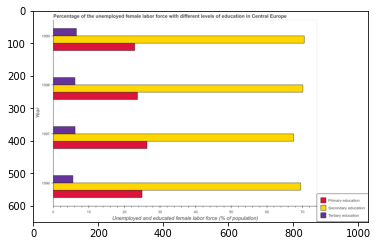

Number of QA =  29





,Year,Secondary education,Tertiary education,Primary education
0,1999,71.089235,6.688345,23.354596
1,1996,70.718853,5.761226,25.210200
2,1998,71.107821,6.164647,24.122512
3,1997,68.049823,6.352212,26.719501


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received secondary education in 1996 and that in 1997 ?
PREDICTED =  2.669029524463184
EXPECTED =  1.978




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received secondary education in 1998 and the percentage of female labor force who received primary education in 1996 ?
PREDICTED =  0.38896822545856935
EXPECTED =  45.1989111964012




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fini

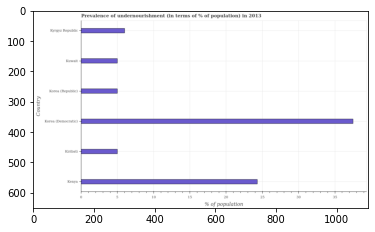

Number of QA =  22





,Country,% of population
0,Kuwait,5.092874
1,Kiribati,5.079316
2,Kenya,24.592907
3,Kyrgyz Republic,6.117665
4,Korea (Republic),5.127417
5,Korea (Democratic),37.571336


> what is the title of the graph ?
PREDICTED =  Prevalence of undernourishment (in terms of % of population) in 2013
EXPECTED =  Prevalence of undernourishment (in terms of % of population) in 2013




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  % of population
EXPECTED =  % of population




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished population in kenya and kyrgyz republic ?
PREDICTED =  18.475241233626473
EXPECTED =  18.3




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of undernourished population ?
PREDICTED =  37.57133585880042
EXPEC

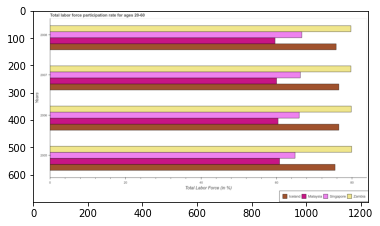

Number of QA =  30





,Years,Iceland,Zambia,Singapore,Malaysia
0,2008,76.764133,80.811140,67.892361,59.672049
1,2005,76.041348,80.474495,65.655075,61.212054
2,2007,77.681841,79.379497,NaN,60.600213
3,2006,77.285173,80.403884,66.705796,60.791205


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in singapore in 2007 and that in 2008 ?
PREDICTED =  -67.89236143090628
EXPECTED =  -0.3999938964844034




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in zambia in 2006 and the labor force participation rate in malaysia in 2005 ?
PREDICTED =  -0.07061169586604876
EXPECTED =  19.0000038146973




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the labor force participation rate in singapore and labor force participation rate in iceland ?
PREDICTED =  128.360871000

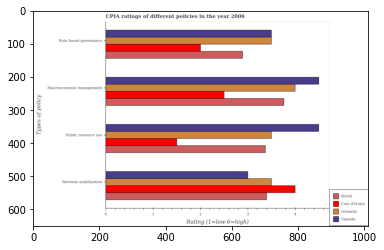

Number of QA =  29





,Types of policy,Grenada,Cote d'Ivoire,Uganda,World
0,Public resource use,3.520742,1.523787,4.507003,3.365501
1,Revenue mobilization,3.556170,4.044622,3.025799,3.443285
2,Rule based governance,NaN,2.009433,3.528177,2.907783
3,Macroeconomic management,4.036407,2.515569,4.536824,3.781587


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of revenue mobilization in world and that in cote d'ivoire ?
PREDICTED =  -0.6013369707668033
EXPECTED =  -0.6025641025641




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of public resource use in world and the cpia rating of revenue mobilization in uganda ?
PREDICTED =  1.365500976222953
EXPECTED =  0.37179487179487003




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of rule based governance and cpia rating of public resource use in cote d'ivoire ?
PREDICTED =  1.383995934633181
EXPECTED =  0.5






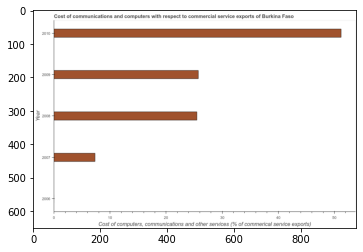

Number of QA =  21





,Year,"Cost of computers, communications and other services (% of commerical service exports)"
0,2007,7.427888
1,2009,25.879260
2,2008,25.921778
3,2006,NaN
4,2010,51.134587


> what is the title of the graph ?
PREDICTED =  Cost of communications and computers with respect to commercial service exports of Burkina Faso
EXPECTED =  Cost of communications and computers with respect to commercial service exports of Burkina Faso




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Cost of computers, communications and other services (% of commerical service exports)
EXPECTED =  Cost of computers, communications and other services (% of commerical service exports)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 3 / 4 = 0.75


> what is the median cost of communications ?
PREDICTED =  None
EXPECTED =  25.4921776309398




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...

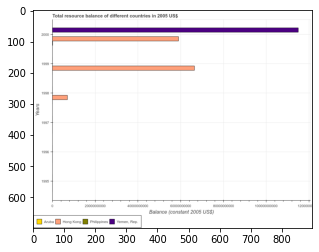

Number of QA =  23





,Years,Yemen. Rep.,Philippines,Aruba,Hong Kong
0,1997,NaN,NaN,NaN,NaN
1,1995,NaN,NaN,NaN,NaN
2,1998,NaN,NaN,NaN,7.164460e+09
3,1996,NaN,NaN,NaN,NaN
4,2000,1.136411e+11,NaN,NaN,5.939178e+10
5,1999,NaN,NaN,NaN,6.625276e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total resource balance in philippines in 1995 and the total resource balance in aruba in 1999 ?
PREDICTED =  0.0
EXPECTED =  0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the total resource balance in yemen, rep. and total resource balance in aruba ?
PREDICTED =  0.0
EXPECTED =  114867624121.673




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest total resource balance in hong kong ?
PREDICTED =  0.0
EXPECTED =  7448000000.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_availabl

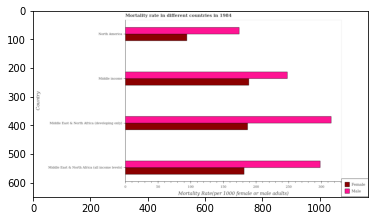

Number of QA =  28





,Country,Female,Male
0,North America,172.275933,315.394163
1,Middle income,343.271579,448.347732
2,Middle East & North Africa (all income levels),330.579666,541.610582
3,Middle East & North Africa (developing only),341.424706,569.814643


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male mortality rate in middle east & north africa (developing only) and that in middle income ?
PREDICTED =  121.46691018328727
EXPECTED =  67.089




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male mortality rate in middle income and the female mortality rate in middle east & north africa (developing only) ?
PREDICTED =  -121.46691018328727
EXPECTED =  60.853240981387984




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female mortality rate and male mortality rate in middle east & north africa (all income levels) ?
PREDICTED =  -72.8

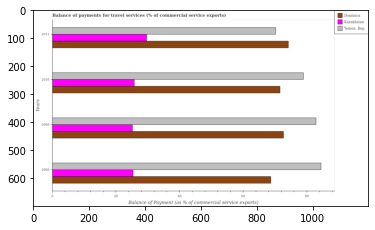

Number of QA =  29





,Years,Dominica,"Yemen, Rep.",Kazakhstan
0,2011,74.768432,NaN,30.221882
1,2010,72.145572,78.785417,26.258664
2,2008,69.303352,85.706000,25.717684
3,2009,73.506612,83.250571,25.775498


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for travel services in yemen, rep. in 2009 and that in 2010 ?
PREDICTED =  4.465154615924931
EXPECTED =  3.951668422201678




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for travel services in kazakhstan in 2009 and the balance of payments for travel services in dominica in 2008 ?
PREDICTED =  -43.52785441290067
EXPECTED =  -43.491623209216485




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the balance of payments for travel services in kazakhstan and balance of payments for trave

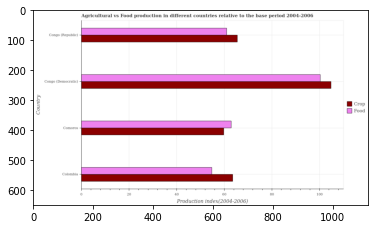

Number of QA =  28





,Country,Crop,Food
0,Colombia,63.775859,55.074282
1,Comoros,60.767177,63.106778
2,Congo (Republic),65.938001,61.939162
3,Congo (Democratic),105.914323,101.123717


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the food production index in colombia and that in congo (democratic) ?
PREDICTED =  -46.04943572599137
EXPECTED =  -45.57




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the food production index in congo (democratic) and the crop production index in congo (republic) ?
PREDICTED =  39.18455547558408
EXPECTED =  34.85000000000001




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the crop production index and food production index in comoros ?
PREDICTED =  45.1471462566777
EXPECTED =  -3.16




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_av

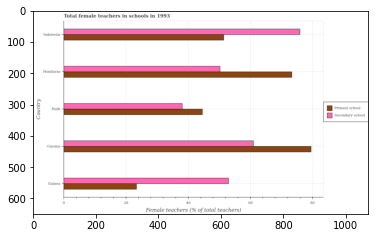

Number of QA =  28





,Country,Primary school,Secondary school
0,Haiti,44.620961,38.299548
1,Indonesia,51.587630,75.885769
2,Guinea,23.802545,NaN
3,Honduras,73.332511,50.448398
4,Guyana,79.870234,61.192003


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in primary schools in guyana and that in indonesia ?
PREDICTED =  28.282604893842176
EXPECTED =  28.076




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in primary schools in honduras and the percentage of female teachers in secondary schools in indonesia ?
PREDICTED =  21.74488159112417
EXPECTED =  -2.5922999999999803




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female teachers in primary schools and percentage of female teachers in secondary schools in haiti

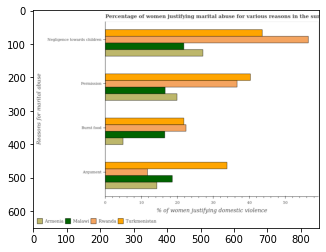

Number of QA =  29





,Reasons for marital abuse,Rwanda,Malawi,Armenia,Turkmenistan
0,Burnt food,22.426029,16.650699,5.074683,21.941705
1,Permission,36.939061,16.573817,20.014976,NaN
2,Argument,11.923771,18.927864,14.387552,33.979235
3,Negligence towards children,56.406029,22.002415,27.083812,43.746841


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 6 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?

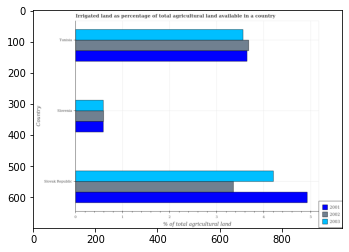

Number of QA =  29





,Country,2002,2003,2001
0,Tunisia,3.712623,3.595566,3.684970
1,Slovenia,0.612339,0.606084,0.605790
2,Slovak Republic,3.399624,4.240918,4.988349


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of irrigated land in 2003 in slovak republic and that in slovenia ?
PREDICTED =  3.634833769690868
EXPECTED =  3.6157003051667926




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of irrigated land in 2002 in tunisia and the percentage of irrigated land in 2001 in slovenia?
PREDICTED =  3.100283088405338
EXPECTED =  3.0889131233769733




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of irrigated land in 2003 and percentage of irrigated land in 2002 in tunisia ?
PREDICTED =  -0.39391557789819487
EXPECTED =

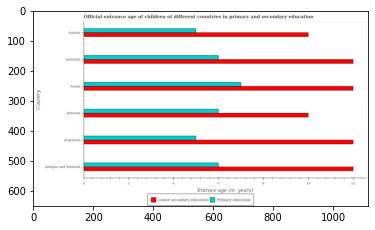

Number of QA =  28





,Country,Lower secondary education,Primary education
0,Austria,NaN,5.025556
1,Aruba,12.216950,7.014617
2,Australia,12.144730,6.043101
3,Argentina,12.112708,NaN
4,Antigua and Barbuda,12.022691,6.049466
5,Armenia,NaN,6.085946


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the entrance age of chiildren in primary education in antigua and barbuda and that in argentina ?
PREDICTED =  -5.973225025166962
EXPECTED =  1




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the entrance age of children in lower secondary education in australia and the entrance age of chiildren in primary education in antigua and barbuda ?
PREDICTED =  0.12203872825146256
EXPECTED =  6




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the entrance age of children in lower secondary education and entrance age of chiildren in primary education in ar

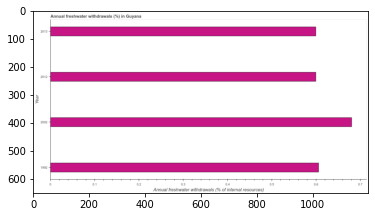

Number of QA =  23





,Year,Annual freshwater withdrawals (% of internal resources)
0,2013,0.600241
1,1992,0.608460
2,2012,0.600677
3,2002,0.677704


> what is the title of the graph ?
PREDICTED =  Annual freshwater withdrawals (%) in Guyana
EXPECTED =  Annual freshwater withdrawals (%) in Guyana




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Annual freshwater withdrawals (% of internal resources)
EXPECTED =  Annual freshwater withdrawals (% of internal resources)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the annual freshwater withdrawals in 1992 and 2012 ?
PREDICTED =  0.007783308377241949
EXPECTED =  0.006




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median annual freshwater withdrawals ?
PREDICTED =  0.6045682534310848
EXPECTED

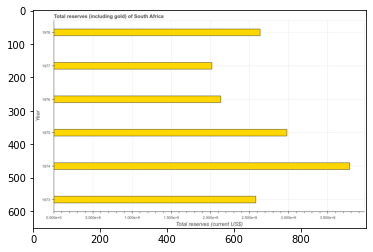

Number of QA =  23





,Year,Total reserves (current US$)
0,1978,26.373495
1,1975,29.359375
2,1974,37.761060
3,1977,20.251278
4,1973,25.869632
5,1976,21.101635


> what is the title of the graph ?
PREDICTED =  Total reserves (including gold) of South Africa
EXPECTED =  Total reserves (including gold) of South Africa




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Total reserves (current US$)
EXPECTED =  Total reserves (current US$)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total reserves (including gold) in 1973 and 1978 ?
PREDICTED =  -0.5038631796383228
EXPECTED =  -55200617.343




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total reserves (including gold) ?
PREDICTED =  26.121563635694788
EXPECTED =  2608100254.589385




				 3 / 

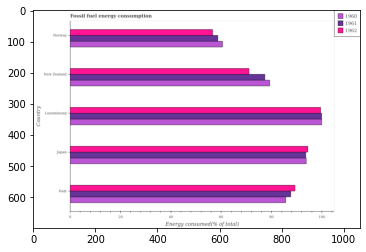

Number of QA =  29





,Country,1962,1961,1960
0,Italy,89.822158,87.632003,86.243721
1,Norway,56.900121,59.040502,60.508306
2,Luxembourg,100.169051,100.506971,99.808079
3,Japan,94.656290,94.197736,94.206627
4,New Zealand,71.289128,76.994282,79.689241


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of energy consumed in 1960 in japan and that in luxembourg ?
PREDICTED =  -5.601451201042849
EXPECTED =  -6.148136025906112




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of energy consumed in 1960 in luxembourg and the percentage of energy consumed in 1962 in norway?
PREDICTED =  42.907957197696604
EXPECTED =  43.354916268428305




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of energy consumed in 1962 and percentage of energy consumed in 1960 in norway ?
PREDICTED =  39.66074548517945
EXPECTED =  -3

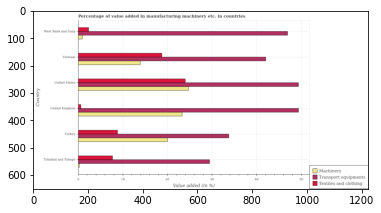

Number of QA =  29





,Country,Transport equipments,Machinery,Textiles and clothing
0,Turkey,34.154676,NaN,8.738052
1,United Kingdom,49.488023,23.536381,0.721864
2,West Bank and Gaza,47.201524,1.030596,2.470873
3,Vietnam,42.810432,14.081350,18.864845
4,United States,49.365154,NaN,24.079368
5,Trinidad and Tobago,29.754877,0.404218,7.884315


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added in manufacturing textile and clothing in trinidad and tobago and that in united states ?
PREDICTED =  0.0
EXPECTED =  -16.311




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added in manufacturing textile and clothing in united states and the value added in manufacturing machinery in vietnam ?
PREDICTED =  -18.864845209006923
EXPECTED =  10.0837333057325




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added in manufacturing machinery and value added in manufacturing textile and clothing in turkey ?
PREDICTED = 

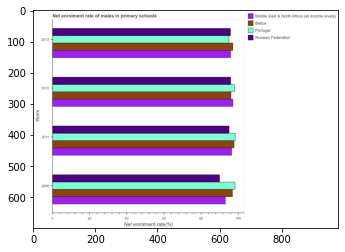

Number of QA =  30





,Years,Portugal,Belize,Russian Federation,Middle East & North Africa (all income levels)
0,2013,95.614849,97.749478,96.471948,96.343633
1,2006,98.863905,97.368093,90.656567,93.676135
2,2012,98.335439,96.785281,96.679735,97.625596
3,2011,99.065976,98.707671,95.729796,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum net enrolment rate of males in primary schools in russian federation ?
PREDICTED =  501.5
EXPECTED =  89.9818801879883




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the net enrolment rate of males in primary schools in russian federation minimum?
PREDICTED =  501.5
EXPECTED =  2006




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate of males in primary schools in belize in 2006 and that in 2012 ?
PREDICTED =  0.5828124622263289
EXPECTED =  0.8068466186523011




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GP

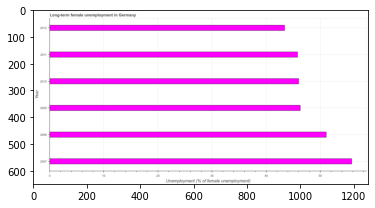

Number of QA =  23





,Year,Unemployment (% of female unemployment)
0,2011,46.054687
1,2012,43.661568
2,2008,51.293781
3,2010,46.171759
4,2007,55.848007
5,2009,46.588334


> what is the title of the graph ?
PREDICTED =  Long-term female unemployment in Germany
EXPECTED =  Long-term female unemployment in Germany




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Unemployment (% of female unemployment)
EXPECTED =  Unemployment (% of female unemployment)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the long-term female unemployment in 2007 and 2012 ?
PREDICTED =  12.186439186055239
EXPECTED =  12.4




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median long-term female unemployment ?
PREDICTED =  46.380046685086825
EXPECTED =  46.149999618530245




				 5 / 5 = 1.

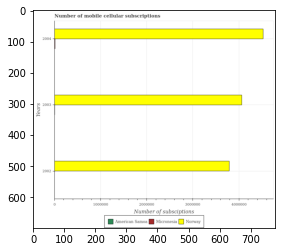

Number of QA =  29





,Years,Micronesia,Norway,American Samoa
0,2002,NaN,3.819402e+06,NaN
1,2004,NaN,4.539998e+06,NaN
2,2003,NaN,4.098181e+06,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of mobile cellular subscriptions in norway in 2002 and that in 2003 ?
PREDICTED =  -278779.49604783254
EXPECTED =  -270829




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of mobile cellular subscriptions in american samoa in 2003 and the number of mobile cellular subscriptions in norway in 2002 ?
PREDICTED =  -1.0
EXPECTED =  -3787900.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the number of mobile cellular subscriptions in micronesia and number of mobile cellular subscriptions in norway ?
PREDICTED =

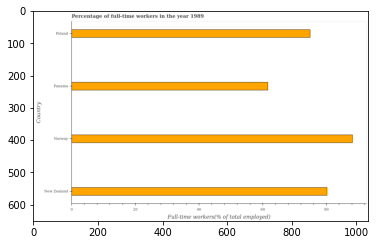

Number of QA =  22





,Country,Full-time workers(% of total employed)
0,Poland,74.943464
1,Panama,61.933649
2,Norway,89.040097
3,New Zealand,80.713545


> what is the title of the graph ?
PREDICTED =  Percentage of full-time workers in the year 1989
EXPECTED =  Percentage of full-time workers in the year 1989




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Full-time workers(% of total employed)
EXPECTED =  Full-time workers(% of total employed)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time workers in norway and panama ?
PREDICTED =  27.1064474948263
EXPECTED =  26.6




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of full-time workers ?
PREDICTED =  77.82850440605836
EXPECTED =  77.5499992370

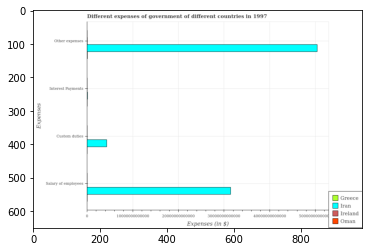

Number of QA =  26





,Expenses,Oman,Greece,Iran,Ireland
0,Custom duties,NaN,NaN,4.422100e+12,NaN
1,Interest Payments,NaN,NaN,NaN,NaN
2,Other expenses,NaN,NaN,5.019952e+13,NaN
3,Salary of employees,NaN,NaN,3.139783e+13,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on salary of employees in iran and that in greece ?
PREDICTED =  0.0
EXPECTED =  31438537000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on interest payments in greece and the amount spent on salary of employees in iran ?
PREDICTED =  -31397829784005.035
EXPECTED =  -31438908000000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 4 = 0.25


is_built_with_cuda: True
is_gp

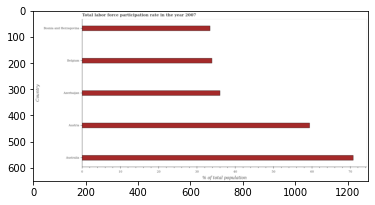

Number of QA =  22





,Country,% of total population
0,Belgium,34.235513
1,Australia,71.233422
2,Azerbaijan,36.274734
3,Austria,59.754438
4,Bosnia and Herzegovina,33.607925


> what is the title of the graph ?
PREDICTED =  Total labor force participation rate in the year 2007
EXPECTED =  Total labor force participation rate in the year 2007




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  % of total population
EXPECTED =  % of total population




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total labor force participation rate in belgium and bosnia and herzegovina ?
PREDICTED =  0.6275884887001695
EXPECTED =  0.5




				 3 / 4 = 0.75


> what is the median total labor force participation rate ?
PREDICTED =  None
EXPECTED =  36.0




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0

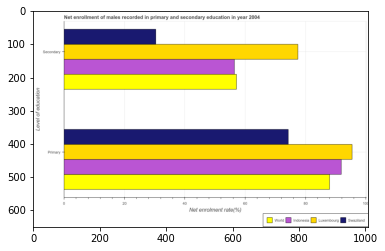

Number of QA =  23





,Level of education,Luxembourg,Indonesia,Swaziland,World
0,Secondary,77.677130,56.575958,30.602172,57.131704
1,NaN,95.923735,92.207672,74.733480,88.379182


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in secondary education in indonesia and that in world ?
PREDICTED =  -0.5557454361839405
EXPECTED =  -0.6883926391602131




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in primary education in luxembourg and the enrollment rate in secondary education in swaziland ?
PREDICTED =  47.07495767152483
EXPECTED =  65.02989768981928




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in primary education and enrollment rate in secondary education in swaziland ?
PREDICTED =  -29.60217245691321
EXPECT

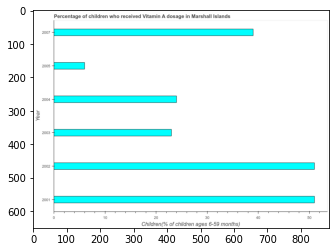

Number of QA =  23





,Year,Children(% of children ages 6-59 months)
0,2001,50.817839
1,2004,23.894147
2,2007,38.921442
3,2005,6.161108
4,2003,23.079431
5,2002,51.081938


> what is the title of the graph ?
PREDICTED =  Percentage of children who received Vitamin A dosage in Marshall Islands
EXPECTED =  Percentage of children who received Vitamin A dosage in Marshall Islands




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Children(% of children ages 6-59 months)
EXPECTED =  Children(% of children ages 6-59 months)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the vitamin a supplementation coverage rate in 2005 and 2007 ?
PREDICTED =  -32.76033424902945
EXPECTED =  -33.0




				 4 / 4 = 1.0


> what is the median vitamin a supplementation coverage rate ?
PREDICTED =  None
EXPECTED =  31.5




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training 

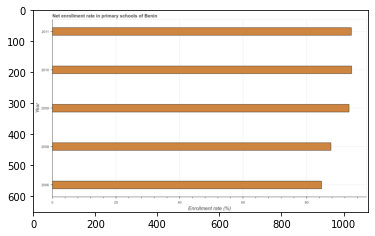

Number of QA =  23





,Year,Enrollment rate (%)
0,2006,84.783518
1,2008,87.932896
2,2010,94.468075
3,2011,93.595246
4,2009,93.530342


> what is the title of the graph ?
PREDICTED =  Net enrollment rate in primary schools of Benin
EXPECTED =  Net enrollment rate in primary schools of Benin




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Enrollment rate (%)
EXPECTED =  Enrollment rate (%)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrollment rate in primary schools in 2009 and 2011 ?
PREDICTED =  -0.06490440211301518
EXPECTED =  -0.748




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median net enrollment rate in primary schools ?
PREDICTED =  2009.0
EXPECTED =  93.31304931640629




				 3 / 5 = 0.6


is_built_wit

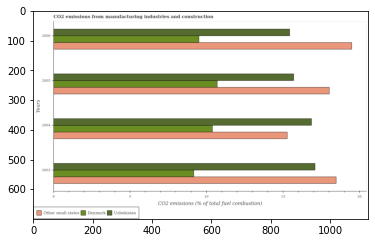

Number of QA =  29





,Years,Uzbekistan,Other small states,Denmark
0,2006,15.395580,19.526083,9.500819
1,2004,16.790790,15.251759,10.394197
2,2005,15.601255,18.014368,10.746359
3,2003,17.058694,18.506647,9.183725


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in denmark in 2003 and that in 2004 ?
PREDICTED =  -1.210471705580348
EXPECTED =  -1.2193357292334106




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in uzbekistan in 2006 and the amount of co2 emitted in denmark in 2003 ?
PREDICTED =  -1.663114700372427
EXPECTED =  6.264361460097609




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the amount of co2 emitted in other small states and amount of co2 emitted in uzbekistan ?
PREDICTED =  55.08727659910655
EXPECTED =  2.32787033369509

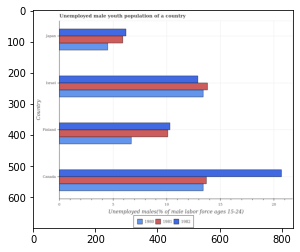

Number of QA =  29





,Country,1982,1980,1981
0,Israel,12.942977,13.469650,13.828550
1,Japan,6.287723,4.522778,5.971347
2,Finland,10.365772,6.710733,10.298129
3,Canada,20.759522,13.518631,13.789120


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed male youth population in 1981 in finland and that in israel ?
PREDICTED =  -3.530420890749573
EXPECTED =  -3.6999998092652007




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed male youth population in 1981 in israel and the percentage of unemployed male youth population in 1980 in japan?
PREDICTED =  7.85720303595654
EXPECTED =  9.3000001907349




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed male youth population in 1981 and percentage of unemployed male youth po

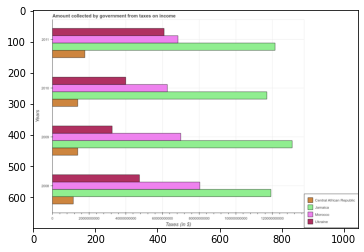

Number of QA =  30





,Years,Central African Republic,Jamaica,Ukraine,Morocco
0,2009,1.413041e+10,1.310131e+11,3.296412e+10,7.101838e+10
1,2011,1.783811e+10,1.216818e+11,6.150529e+10,NaN
2,2010,1.396396e+10,1.170010e+11,4.024767e+10,6.314892e+10
3,2008,1.177405e+10,1.181018e+11,4.794583e+10,8.024730e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected by government from taxes on income in central african republic in 2010 and that in 2011 ?
PREDICTED =  -3874151528.195795
EXPECTED =  -3872916713.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected by government from taxes on income in morocco in 2011 and the amount collected by government from taxes on income in jamaica in 2008 ?
PREDICTED =  -80247297449.39232
EXPECTED =  -50708904040.40401




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the amount collected by government from taxes on i

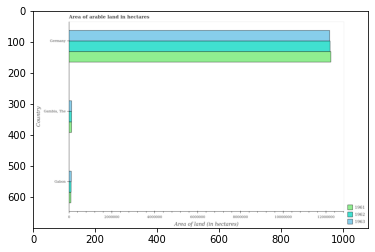

Number of QA =  29





,Country,1963,1962,1961
0,Gabon,1.271746e+05,1.192176e+05,1.141904e+05
1,Germany,1.223972e+07,1.222495e+07,1.217381e+07
2,"Gambia, The",1.389829e+05,1.370567e+05,1.409304e+05


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total arable land in 1961 in gabon and that in gambia, the ?
PREDICTED =  -26740.027297578432
EXPECTED =  -31000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total arable land in 1963 in gambia, the and the total arable land in 1962 in gabon?
PREDICTED =  11808.329241274274
EXPECTED =  23000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total arable land in 1962 and total arable land in 1961 in gabon ?
PREDICTED =  12367030.910558175
EXPECTED =  10000.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
G

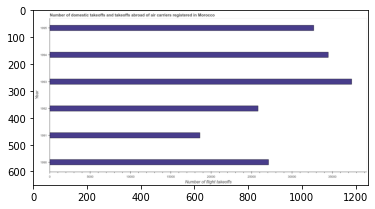

Number of QA =  23





,Year,Number of flight takeoffs
0,1994,406097.146362
1,1995,385877.046443
2,1990,320343.603937
3,1991,220068.114141
4,1992,304419.646642
5,1993,439868.789874


> what is the title of the graph ?
PREDICTED =  Number of domestic takeoffs and takeoffs abroad of air carriers registered in Morocco
EXPECTED =  Number of domestic takeoffs and takeoffs abroad of air carriers registered in Morocco




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Number of flight takeoffs
EXPECTED =  Number of flight takeoffs




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of flight takeoffs in 1992 and 1993 ?
PREDICTED =  -135449.14323191863
EXPECTED =  -11600.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of flight takeoffs ?
PREDICTED =  353110.32

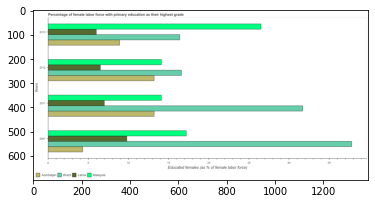

Number of QA =  30





,Years,Azerbaijan,Latvia,Malaysia,Brazil
0,2013,NaN,6.003683,26.496219,16.376873
1,2007,4.334357,9.833928,17.022084,38.138161
2,2011,13.212153,7.023155,13.988243,31.796314
3,2012,13.308929,6.614942,14.056136,16.736375


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force with primary education in brazil in 2007 and that in 2013 ?
PREDICTED =  21.761287866969155
EXPECTED =  21.3999996185302




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force with primary education in azerbaijan in 2013 and the percentage of female labor force with primary education in brazil in 2012 ?
PREDICTED =  -13.308928726457284
EXPECTED =  -7.700000762939432




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of female labor force with primary 

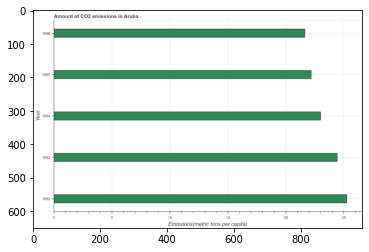

Number of QA =  23





,Year,Emissions(metric tons per capita)
0,1996,21.668292
1,1994,23.010464
2,1992,25.177052
3,1995,22.204180
4,1993,24.315222


> what is the title of the graph ?
PREDICTED =  Amount of CO2 emissions in Aruba
EXPECTED =  Amount of CO2 emissions in Aruba




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Emissions(metric tons per capita)
EXPECTED =  Emissions(metric tons per capita)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emissions in 1994 and 1995 ?
PREDICTED =  0.8062843365557804
EXPECTED =  0.81




				 4 / 4 = 1.0


> what is the median amount of co2 emissions ?
PREDICTED =  None
EXPECTED =  22.9964406779661




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount of co2 emission

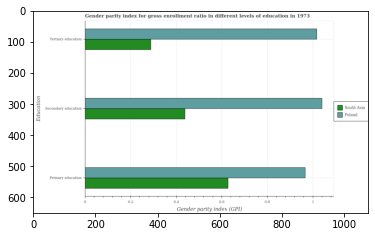

Number of QA =  28





,Education,South Asia,Poland
0,Primary education,0.629998,0.966488
1,Secondary education,0.443195,1.051917
2,Tertiary education,0.293585,1.024433


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gender parity index in tertiary education in poland and that in south asia ?
PREDICTED =  0.730848248842189
EXPECTED =  0.7284399890327449




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gender parity index in secondary education in south asia and the gender parity index in primary education in poland ?
PREDICTED =  -0.5232930200430939
EXPECTED =  -0.5279900083351141




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gender parity index in secondary education and gender parity index in primary education in poland ?
PREDICTED =  -0.523293

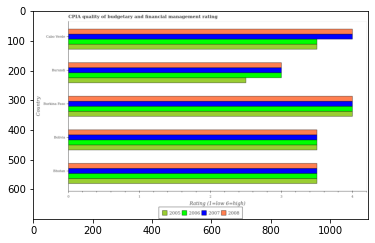

Number of QA =  30





,Country,2007,2005,2008,2006
0,Burundi,3.015229,2.519164,3.011261,3.016452
1,Bolivia,3.507958,3.523291,3.537747,3.485136
2,Bhutan,3.516267,3.492319,3.530964,3.521399
3,Burkina Faso,3.960266,3.997845,4.001403,3.995994
4,Cabo Verde,4.038663,3.517079,4.006478,3.566632


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2007 in burundi and that in cabo verde ?
PREDICTED =  -1.0234340996470341
EXPECTED =  -1.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2008 in burundi and the cpia rating in 2007 in burkina faso?
PREDICTED =  -0.9901422135941229
EXPECTED =  -1.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2007 and cpia rating in 2006 in cabo verde ?
PREDICTED =  0.04104412376903488
EXPECTED =  0.5




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predict

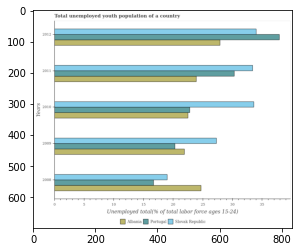

Number of QA =  29





,Years,Portugal,Albania,Slovak Republic
0,2011,30.215924,NaN,33.338965
1,2012,37.593451,27.818949,34.010045
2,2009,NaN,21.765482,27.197041
3,2008,16.590893,24.528489,NaN
4,2010,NaN,22.731519,33.551073


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total unemployed youth population of a country in portugal in 2010 and that in 2012 ?
PREDICTED =  30.215924117324512
EXPECTED =  -15.100002288818398




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total unemployed youth population of a country in portugal in 2011 and the percentage of total unemployed youth population of a country in albania in 2008 ?
PREDICTED =  13.625030793315268
EXPECTED =  5.599998474121001




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of total unemploye

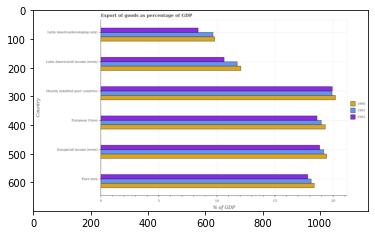

Number of QA =  29





,Country,1962,1961,1960
0,Euro area,17.942402,18.169456,18.496599
1,Latin America(all income levels),10.667737,11.799535,12.060341
2,Heavily indebted poor countries,19.908129,19.965094,20.195945
3,Latin America(developing only),8.480733,9.713551,9.791070
4,European Union,18.706504,18.928573,19.225227
5,Europe(all income levels),18.890904,19.246442,19.394855


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export of goods as percentage of gdp in 1961 in europe(all income levels) and that in latin america(all income levels) ?
PREDICTED =  0.0
EXPECTED =  7.443222675987299




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the export of goods as percentage of gdp in 1962 in europe(all income levels) to that in latin america(developing only) ?
PREDICTED =  2.2275083853592847
EXPECTED =  2.2471894

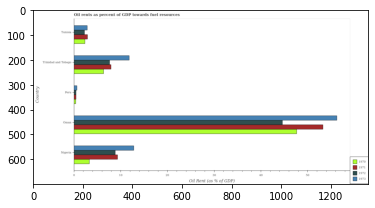

Number of QA =  30





,Country,1972,1971,1970,1973
0,Tunisia,2.289160,2.959238,2.422190,2.919958
1,Oman,45.318468,53.282083,47.940401,58.270483
2,Nigeria,9.027598,9.485144,3.361884,13.075177
3,Trinidad and Tobago,7.919836,8.020285,6.446754,11.822193
4,NaN,0.515487,0.508092,0.468476,0.716263


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oil rent in 1973 in trinidad and tobago and that in tunisia ?
PREDICTED =  8.90223491581292
EXPECTED =  8.98143656493289




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oil rent in 1972 in nigeria and the oil rent in 1973 in trinidad and tobago?
PREDICTED =  1.1077617755779041
EXPECTED =  -2.9937656397880694




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the oil rent in 1972 in oman to that in

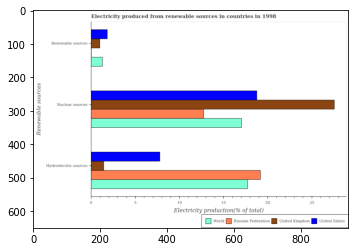

Number of QA =  28





,Renewable sources,United Kingdom,Russian Federation,United States,World
0,Nuclear sources,27.721157,12.863129,18.908651,17.166553
1,Hydroelectric sources,1.480802,19.440216,7.775635,17.849611
2,Renewable sources,1.025053,NaN,1.849398,1.314166


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the percentage of electricity produced by nuclear sources in russian federation ?
PREDICTED =  4.287709579615642
EXPECTED =  12.7476884829016




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by renewable sources in russian federation and that in united states ?
PREDICTED =  0.3333333333333333
EXPECTED =  -1.8188157185167264




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by nuclear sources in united states and the percentage of electricity produced by hydroelectric sources in world ?
PREDICTED

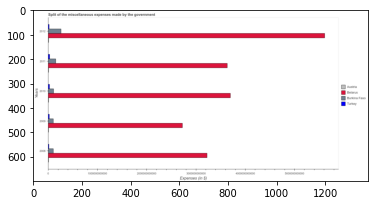

Number of QA =  30





,Years,Turkey,Austria,Burkina Faso,Belarus
0,2011,3.748246e+10,NaN,1.592768e+11,3.643428e+12
1,2008,2.446638e+10,NaN,1.085836e+11,3.249018e+12
2,2010,3.483892e+10,NaN,1.156100e+11,3.700329e+12
3,2012,2.738127e+10,NaN,2.695092e+11,5.587440e+12
4,2009,3.038960e+10,NaN,1.101405e+11,2.747416e+12


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the miscellaneous expenses made by the government in turkey in 2009 and that in 2010 ?
PREDICTED =  -4449317746.42622
EXPECTED =  -4338383522.888699




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the miscellaneous expenses made by the government in austria in 2008 and the miscellaneous expenses made by the government in burkina faso in 2012 ?
PREDICTED =  0.0
EXPECTED =  -253101810918.118




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the miscellaneous expenses made by the government in belarus and miscellaneous expenses made 

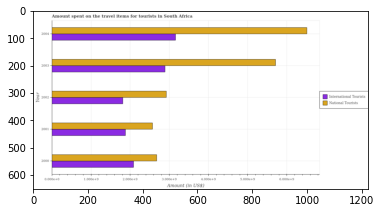

Number of QA =  28





,Year,International Tourists,National Tounsts
0,2004,3.171620,6.508097
1,2002,1.820073,2.901452
2,2001,1.882690,2.563870
3,2003,2.895477,5.725573
4,2000,2.083647,2.682510


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on travel items of national tourists in 2000 and that in 2004 ?
PREDICTED =  -1.0879728829129687
EXPECTED =  -3836000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on travel items of international tourists in 2003 and the amount spent on travel items of national tourists in 2000 ?
PREDICTED =  0.8118305792362928
EXPECTED =  212000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the amount spent on travel items of national tourists and amount spent on travel items of international tourist

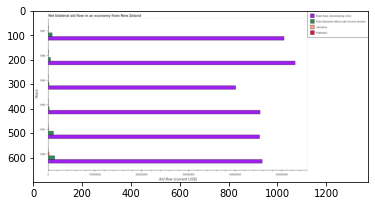

Number of QA =  30





,Years,East Asia (developing only),Sub-Saharan Africa (all income levels),Jamaica,Pakistan
0,1987,5.090104e+07,9.356297e+05,NaN,NaN
1,1986,5.313919e+07,5.651299e+05,NaN,NaN
2,1980,4.590424e+07,1.434870e+06,255436.849238,NaN
3,1981,4.537906e+07,1.214444e+06,NaN,NaN
4,1984,4.034079e+07,2.500897e+05,NaN,NaN
5,1983,4.537628e+07,2.609421e+05,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in jamaica in 1980 and that in 1984 ?
PREDICTED =  0.0
EXPECTED =  160000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in sub-saharan africa (all income levels) in 1980 and the net bilateral aid flow in jamaica in 1987 ?
PREDICTED =  499240.2991749012
EXPECTED =  1350000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1980, what is the difference between the net bilateral aid flow in east asia (developing only) and net bilateral aid flow in sub-saharan africa (all income levels) ?
PREDICTED =  281040593.2

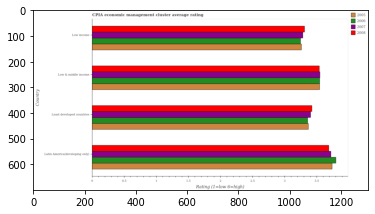

Number of QA =  30





,Country,2007,2005,2006,2008
0,Low income,3.308770,3.288542,3.273147,3.318167
1,Low & middle income,3.566398,3.588168,3.591190,3.548908
2,Least developed countries,3.416746,3.380096,3.383263,3.434461
3,Latin America(developing only),3.754286,3.727582,3.837187,3.711988


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2007 in latin america(developing only) and that in low & middle income ?
PREDICTED =  0.18788834590276826
EXPECTED =  0.17111111111110988




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2006 in latin america(developing only) and the cpia rating in 2005 in least developed countries?
PREDICTED =  0.45392334745624385
EXPECTED =  0.4291666666666698




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





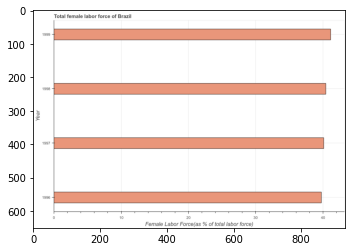

Number of QA =  23





,Year,Female Labor Force(as % of total labor force)
0,1998,40.674705
1,1996,39.992343
2,1999,41.295192
3,1997,40.064446


> what is the title of the graph ?
PREDICTED =  Total female labor force of Brazil
EXPECTED =  Total female labor force of Brazil




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Female Labor Force(as % of total labor force)
EXPECTED =  Female Labor Force(as % of total labor force)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total female labor force in 1996 and 1998 ?
PREDICTED =  -0.6823611100963944
EXPECTED =  -0.664




				 4 / 4 = 1.0


> what is the median total female labor force ?
PREDICTED =  None
EXPECTED =  40.26993357716155




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the r

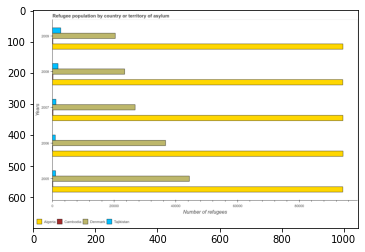

Number of QA =  30





,Years,Unnamed: 1,Cambodia,Tajikistan,Denmark
0,2006,NaN,NaN,1123.954198,37108.729798
1,2007,94339.048555,NaN,1317.643015,27195.599123
2,2005,95502.220765,NaN,1237.195533,44792.950545
3,2009,NaN,NaN,2881.321748,20700.474533
4,2008,93975.165836,NaN,2019.761988,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of refugees in algeria in 2008 and the number of refugees in tajikistan in 2007 ?
PREDICTED =  66779.5667131311
EXPECTED =  92960.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the number of refugees in algeria and number of refugees in cambodia ?
PREDICTED =  5.0
EXPECTED =  94002.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the number of refugees in algeria in 2005 t

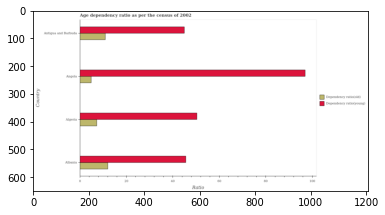

Number of QA =  28





,Country,Dependency ratio{old),Dependency ratio{young)
0,Albania,12.356164,46.174249
1,Algeria,7.436692,NaN
2,Angola,5.034360,97.392132
3,Antigua and Barbuda,11.239273,45.587412


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the age dependency ratio(old) in antigua and barbuda ?
PREDICTED =  2.8098181528154407
EXPECTED =  10.91939473017981




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum age dependency ratio(old) ?
PREDICTED =  3.089041039378221
EXPECTED =  12.0188729049118




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum age dependency ratio(young) ?
PREDICTED =  11.396852877596931
EXPECTED =  44.9356365265146




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







			

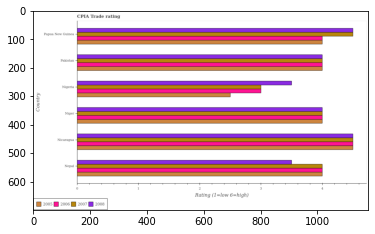

Number of QA =  30





,Country,2007,2005,2008,2006
0,Nepal,4.017034,4.041269,3.536166,NaN
1,Pakistan,4.030500,4.011653,4.037112,4.024579
2,Nicaragua,NaN,4.512176,NaN,NaN
3,Niger,3.991011,4.032477,4.017226,NaN
4,Nigeria,2.985894,2.599335,3.547353,3.010294
5,Papua New Guinea,4.513131,3.978612,4.548525,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2005 in nicaragua and that in pakistan ?
PREDICTED =  0.5005229152350346
EXPECTED =  0.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2006 in niger and the cpia rating in 2005 in pakistan?
PREDICTED =  -2.0245789335682467
EXPECTED =  0.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cpia rating in 2007 in niger to that in nigeria ?
PREDICTED =  1.336621617

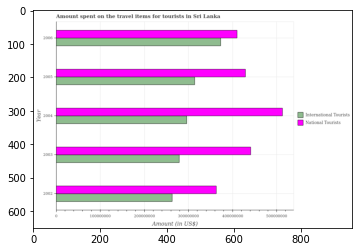

Number of QA =  28





,Year,National Tounists,International Tourists
0,2002,3.686538e+08,2.662222e+08
1,2003,4.412302e+08,2.816040e+08
2,2005,4.319439e+08,3.202393e+08
3,2006,4.126899e+08,NaN
4,2004,5.172304e+08,3.003526e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on travel items of international tourists in 2002 and that in 2006 ?
PREDICTED =  266222168.68311065
EXPECTED =  -110000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on travel items of national tourists in 2005 and the amount spent on travel items of international tourists in 2006 ?
PREDICTED =  320239281.94726723
EXPECTED =  56000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the amount spent on travel items of national tourists and amount spent on travel items of international touri

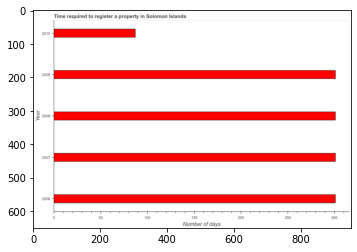

Number of QA =  23





,Year,Number of days
0,2006,299.372338
1,2007,300.297782
2,2010,87.143780
3,2008,299.019639
4,2009,300.218746


> what is the title of the graph ?
PREDICTED =  Time required to register a property in Solomon Islands
EXPECTED =  Time required to register a property in Solomon Islands




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Number of days
EXPECTED =  Number of days




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to register property in 2007 and 2008 ?
PREDICTED =  1.278142976032541
EXPECTED =  0.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of days required to register property ?
PREDICTED =  299.37233822914624
EXPECTED =  301.0




				 4 / 5 = 0.8




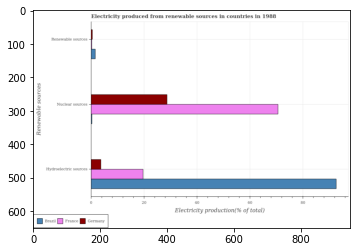

Number of QA =  28





,Renewable sources,Germany,Brazil,France
0,Hydroelectric sources,3.890986,92.573036,20.113992
1,Renewable sources,0.657023,1.785747,NaN
2,Nuclear sources,29.163828,NaN,71.236434


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by nuclear sources in brazil and that in france ?
PREDICTED =  -71.23643385639453
EXPECTED =  -70.32154925843689




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by hydroelectric sources in france and the percentage of electricity produced by nuclear sources in germany ?
PREDICTED =  3.5865854640993184
EXPECTED =  -9.054031901191202




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finis

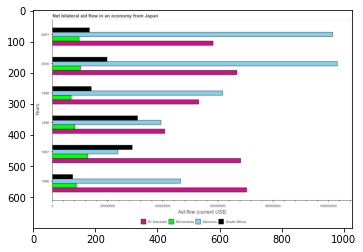

Number of QA =  30





,Years,Micronesia,South Africa,El Salvador,Morocco
0,1997,1.280388e+07,2.895035e+07,6.811247e+07,2.370274e+07
1,2001,9.840057e+06,1.373903e+07,5.815786e+07,NaN
2,1996,8.940831e+06,7.533471e+06,7.040367e+07,4.624166e+07
3,2000,1.024261e+07,1.998122e+07,6.740786e+07,1.009558e+08
4,1999,6.854226e+06,NaN,5.333480e+07,6.183351e+07
5,1998,8.278245e+06,3.115865e+07,4.091754e+07,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in south africa in 1998 and that in 1999 ?
PREDICTED =  31158654.94170403
EXPECTED =  16770000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in south africa in 1996 and the net bilateral aid flow in el salvador in 2000 ?
PREDICTED =  -12447745.831037633
EXPECTED =  -59580000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the net bilateral aid flow in south africa and net bilateral aid flow in morocco ?
PREDICTED =  101362720.39588957
EXPECTED =  -8530000.0




				 0 /

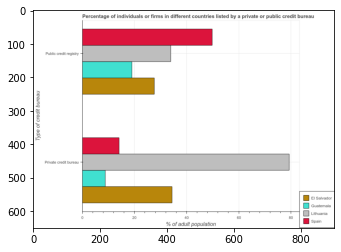

Number of QA =  23





,Type of credit bureau,Spain,El Salvador,Lithuania,Guatemala
0,Public credit registry,50.372385,28.025234,34.484265,19.361213
1,Private credit bureau,14.404172,35.160427,80.535202,9.099650


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of firms listed by private credit bureau in spain and that in lithuania ?
PREDICTED =  -66.13103002275443
EXPECTED =  -65.2




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 4 = 0.25


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  % of adult population
EXPECTED =  20.0




				 1 / 5 = 0.2


> what is the title of the graph ?
PREDICTED =  Percen

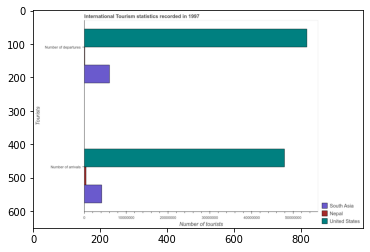

Number of QA =  23





,Tourists,South Asia,Nepal,United States
0,Number of arrivals,4.273450e+06,543852.545297,4.853802e+07
1,Number of departures,6.138727e+06,NaN,5.368790e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Number of tourists
EXPECTED =  10000000.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  International Tourism statistics recorded in 1997
EXPECTED =  International Tourism statistics recorded in 1997




				 1 / 6 = 0.1667


> what is the label or title of the x-axis 

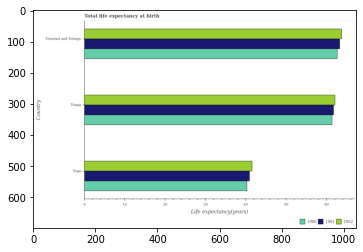

Number of QA =  29





,Country,1962,1961,1960
0,Tonga,63.072356,62.424326,62.063569
1,Togo,42.022504,41.328679,40.379967
2,Trinidad and Tobago,64.585017,63.860464,63.328414


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the life expectancy at birth in in 1962 in tonga and that in trinidad and tobago ?
PREDICTED =  -1.5126610979363093
EXPECTED =  -1.6629024390243998




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the life expectancy at birth in in 1962 in togo and the life expectancy at birth in in 1960 in trinidad and tobago?
PREDICTED =  -22.562512904363167
EXPECTED =  -21.102487804878102




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the life expectancy at birth in in 1962 and life expectancy at birth in in 1960 in tonga ?
PREDICTED =  -9.516138977743573
EXPE

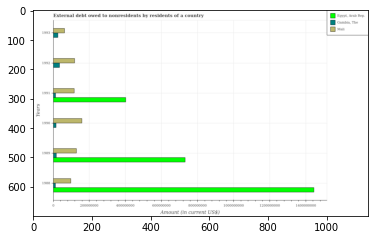

Number of QA =  26





,Years,"Gambia, The",Mali,"Egypt, Arab Rep."
0,1992,3.860269e+07,1.223979e+08,NaN
1,1989,2.047087e+07,1.315623e+08,7.358686e+08
2,1991,1.560035e+07,1.208296e+08,4.088969e+08
3,1990,1.831554e+07,1.628835e+08,NaN
4,1988,1.526323e+07,1.003595e+08,1.463256e+09
5,1993,2.824116e+07,6.461915e+07,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the external debt owed by residents in gambia, the in 1991 and that in 1992 ?
PREDICTED =  -23002339.542271093
EXPECTED =  -21848000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the external debt owed by residents in mali in 1990 and the external debt owed by residents in egypt, arab rep. in 1989 ?
PREDICTED =  31321193.423238054
EXPECTED =  -572268000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1991, what is the difference between the external debt owed by residents in gambia, the and external debt owed by residents in egypt, arab rep. ?
PREDICTED =  152632

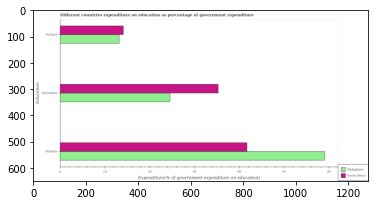

Number of QA =  28





,Education,Philippines,South Africa
0,Tertiary,13.488513,14.316253
1,Primary,58.941637,42.177454
2,Secondary,24.813014,35.407714


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure on primary education in south africa and that in philippines ?
PREDICTED =  -16.76418316432452
EXPECTED =  -17.37142944335931




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure on secondary education in philippines and the expenditure on tertiary education in south africa ?
PREDICTED =  -24.91095280118072
EXPECTED =  10.429540634155298




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure on tertiary education and expenditure on secondary education in south africa ?
PREDICTED =  -36.23545444095497
EXPECTED =

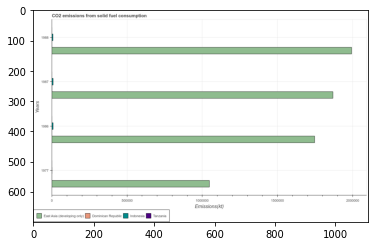

Number of QA =  30





,Years,East Asia (developing only),Dominican Republic,Tanzania,Indonesia
0,1977,1.888732e+06,NaN,NaN,NaN
1,1987,3.389242e+06,NaN,NaN,21314.548604
2,1988,3.595220e+06,NaN,NaN,NaN
3,1986,3.133900e+06,NaN,NaN,21544.275974


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in tanzania in 1987 and that in 1988 ?
PREDICTED =  -205977.70506415423
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in indonesia in 1987 and the amount of co2 emitted in east asia (developing only) in 1986 ?
PREDICTED =  -229.72736930328392
EXPECTED =  -1739271.68978639




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1977, what is the difference between the amount of co2 emitted in indonesia and amount of co2 emitted in east asia (developing only) ?
PREDICTED =  -11964234.473724997
EXPECTED =  

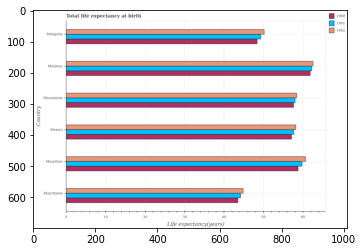

Number of QA =  29





,Country,1962,1961,1960
0,Mauritius,60.616729,59.955659,59.196369
1,Mexico,58.727238,57.934314,57.465986
2,Moldova,62.429792,62.425427,62.007703
3,Micronesia,58.452132,58.387718,58.301128
4,Mauritania,44.827055,44.217675,43.812942
5,Mongolia,51.006903,49.430521,48.286342


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the life expectancy at birth in in 1962 in moldova and that in mongolia ?
PREDICTED =  11.422888950857931
EXPECTED =  12.38414634146342




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the life expectancy at birth in in 1961 in mauritius and the life expectancy at birth in in 1962 in mexico?
PREDICTED =  1.2284211659306976
EXPECTED =  1.56812195121951




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the lif

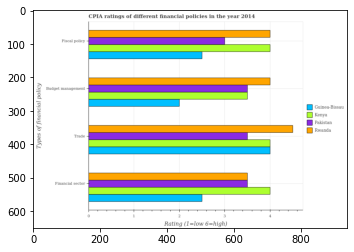

Number of QA =  29





,Types of financial policy,Rwanda,Guinea-Bissau,Kenya,Pakistan
0,Trade,4.528070,NaN,4.014965,3.503822
1,Financial sector,3.524488,2.523289,4.049877,3.518022
2,Fiscal policy,4.030986,2.529878,4.045152,3.036818
3,Budget management,4.015423,2.013340,NaN,3.518963


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of trade in rwanda and that in kenya ?
PREDICTED =  0.5131050222629874
EXPECTED =  0.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of trade in kenya and the cpia rating of financial sector in rwanda ?
PREDICTED =  0.49047729989606514
EXPECTED =  0.5




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of financial sector and cpia rating of budget management in pakistan ?
PREDICTED =  0.005524523214691435
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: 

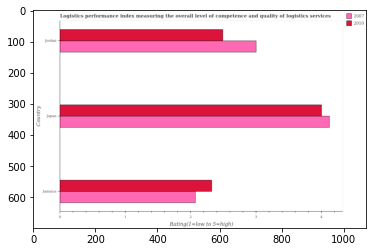

Number of QA =  28





,Country,2007,2010
0,Jordan,3.017560,2.519481
1,Japan,4.141177,4.028834
2,Jamaica,2.087689,2.343801


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in 2010 in japan and that in jordan ?
PREDICTED =  1.5093530169291007
EXPECTED =  1.5099999999999998




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in 2007 in jamaica and the logistic performance index in 2010 in jordan?
PREDICTED =  -0.9298712972810232
EXPECTED =  -0.4200000000000004




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in 2007 and logistic performance index in 2010 in jordan ?
PREDICTED =  -0.4317921131295077
EXPECTED =  0.5099999999999998



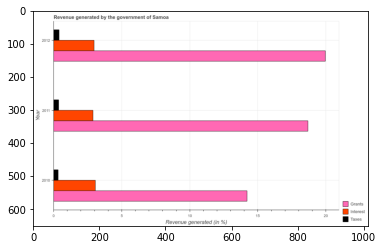

Number of QA =  29





,Year,Taxes,Grants,Interest
0,2011,0.418773,18.756579,2.902223
1,2012,0.445232,20.010432,3.041531
2,2010,0.383689,14.217058,3.100756


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue generated by grants in 2010 and that in 2011 ?
PREDICTED =  -4.539521492778434
EXPECTED =  -4.475




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue generated by taxes in 2011 and the percentage of revenue generated by interest in 2012 ?
PREDICTED =  -0.026458920734792946
EXPECTED =  -2.6034206780227986




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of revenue generated by interest and percentage of revenue generated by taxes ?
PREDICTED =  8.599278710756279
EXPECT

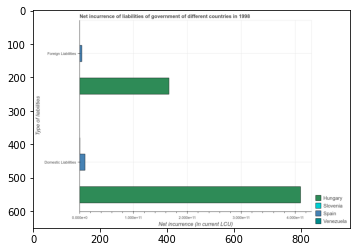

Number of QA =  23





,Type of liabilities,Spain,Slovenia,Hungary,Venezuela
0,Domestic Liabilities,0.109249,NaN,4.170845,NaN
1,Foreign Liabilities,0.049275,NaN,1.671371,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net incurrence of foreign liabilities in venezuela and that in slovenia ?
PREDICTED =  0.0
EXPECTED =  23571935.570021696




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net incurrence of foreign liabilities in slovenia and the net incurrence of domestic liabilities in hungary ?
PREDICTED =  -1.6713707309780967
EXPECTED =  -409947845935.57




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is th

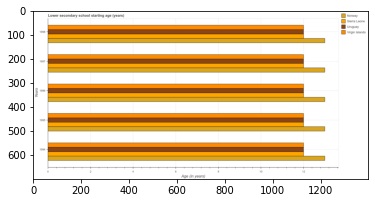

Number of QA =  30





,Years,Uruguay,Sierra Leone,Norway,Virgin Islands
0,1996,12.012663,NaN,12.983453,11.977791
1,1998,11.974867,NaN,12.965301,11.985691
2,1997,11.906967,11.967073,13.006285,11.972300
3,1995,11.886567,12.049918,12.950575,12.010068
4,1994,11.925287,NaN,13.047188,12.045462


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lower secondary school starting age of children in uruguay in 1996 and the lower secondary school starting age of children in norway in 1997 ?
PREDICTED =  0.10569577718202439
EXPECTED =  -1




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the lower secondary school starting age of children in norway in 1995 to that in 1997 ?
PREDICTED =  0.9974677430842696
EXPECTED =  1.0




				 1 / 4 =

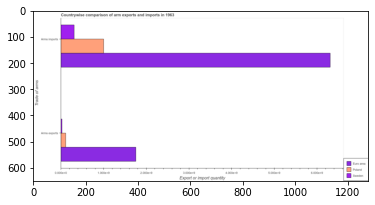

Number of QA =  23





,Trade of arms,Sweden,Poland,Euro area
0,Arms imports,0.317350,1.003519,6.402789
1,Arms exports,0.032667,0.119212,1.770369


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Export or import quantity
EXPECTED =  1000000000.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Countrywise comparison of arm exports and imports in 1963
EXPECTED =  Countrywise comparison of arm exports and imports in 1963




				 1 / 6 = 0.1667


> what is the labe

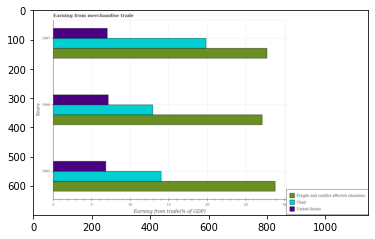

Number of QA =  29





,Years,Fragile and conflict affected situations,Chad,United States
0,1967,27.754432,20.004068,7.172849
1,1965,28.952928,14.323305,6.886993
2,1966,27.279643,13.174815,7.208910


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from trade in united states in 1965 and that in 1967 ?
PREDICTED =  -0.2858561227517411
EXPECTED =  -0.1904337746887803




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from trade in chad in 1966 and the earnings from trade in fragile and conflict affected situations in 1965 ?
PREDICTED =  -1.1484900817683474
EXPECTED =  -15.883100356385901




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1967, what is the difference between the earnings from trade in chad and earnings from trade in united states ?
PREDICTED =  -1918.4978110269255
EXPECTED =

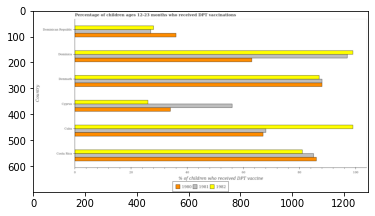

Number of QA =  29





,Country,1982,1980,1981
0,Cuba,99.324911,67.464883,NaN
1,Dominica,98.908973,NaN,97.435891
2,Costa Rica,81.435718,86.101760,85.439863
3,Denmark,86.785720,88.543904,NaN
4,Cyprus,26.226770,NaN,NaN
5,Dominican Republic,27.875656,36.356070,27.346887


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who received dpt vaccination in 1980 in cyprus and that in dominican republic ?
PREDICTED =  -36.3560696777153
EXPECTED =  -2.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who received dpt vaccination in 1980 in cyprus and the percentage of children who received dpt vaccination in 1982 in costa rica?
PREDICTED =  -86.1017600714542
EXPECTED =  -47.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who received dpt vaccination in 1982 and percentage of children who 

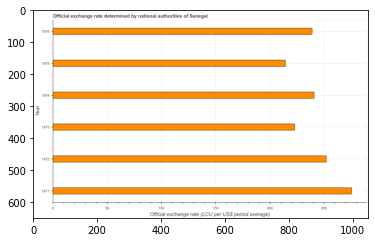

Number of QA =  23





,Year,Official exchange rate (LCU per US$ period average)
0,1976,238.011031
1,1973,222.252801
2,1974,241.325713
3,1971,273.797667
4,1975,214.285243
5,1972,251.662073


> what is the title of the graph ?
PREDICTED =  Official exchange rate determined by national authorities of Senegal
EXPECTED =  Official exchange rate determined by national authorities of Senegal




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Official exchange rate (LCU per US$ period average)
EXPECTED =  Official exchange rate (LCU per US$ period average)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the official exchange rate in 1972 and 1973 ?
PREDICTED =  29.409271743287007
EXPECTED =  29.138




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median official exchange rate ?
PREDICTED =  2

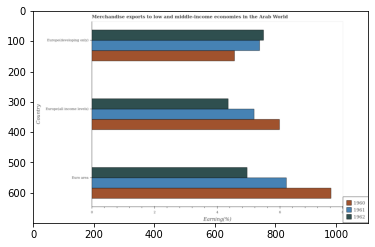

Number of QA =  29





,Country,1962,1961,1960
0,Euro area,4.996521,6.202744,7.602859
1,Europe(all income levels),4.370221,5.182517,5.996847
2,Europe(developing only),5.529973,5.335877,4.560585


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in 1960 in europe(all income levels) and that in europe(developing only) ?
PREDICTED =  3.9968473284939323
EXPECTED =  1.4359390597401287




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in 1961 and percentage of amount earned from merchandise exports in 1962 in euro area ?
PREDICTED =  0.18599627513334838
EXPECTED =  1.25237810275598




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training

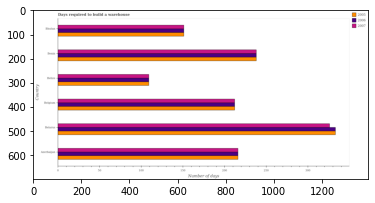

Number of QA =  29





,Country,2007,2005,2006
0,Belgium,383.611864,381.092696,377.879849
1,Bhutan,274.611269,272.883382,274.226377
2,Belarus,587.508636,602.246199,599.136470
3,Belize,198.693818,197.805658,197.682766
4,Azerbaijan,384.824642,393.159868,391.859485
5,Benin,430.419246,429.020494,430.878890


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the days required to build a warehouse in in 2006 in belize and that in bhutan ?
PREDICTED =  -76.54361078403943
EXPECTED =  -42.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the days required to build a warehouse in in 2006 in benin and the days required to build a warehouse in in 2005 in belgium?
PREDICTED =  52.99904127036746
EXPECTED =  26.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the days required to build a warehouse in in 2006 and days required to build a warehouse in in 2007 in benin ?
PREDICTED =  -428.41924562637263
EXPECTED

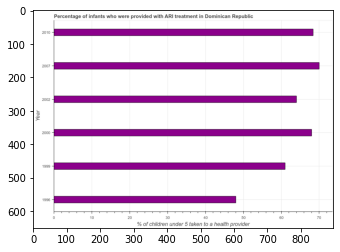

Number of QA =  23





,Year,% of children under 5 taken to a health provider
0,2010,68.490788
1,2000,68.201313
2,1999,60.938240
3,2007,70.267406
4,1996,48.242554
5,2002,64.387631


> what is the title of the graph ?
PREDICTED =  Percentage of infants who were provided with ARI treatment in Dominican Republic
EXPECTED =  Percentage of infants who were provided with ARI treatment in Dominican Republic




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  % of children under 5 taken to a health provider
EXPECTED =  % of children under 5 taken to a health provider




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who were provided with ari treatment in 2000 and 2007 ?
PREDICTED =  -2.0660935598047274
EXPECTED =  -2.0




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what

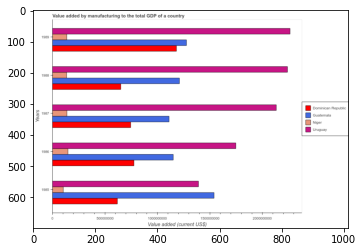

Number of QA =  30





,Years,Uruguay,Dominican Republic,Guatemala,Niger
0,1989,4.059578e+09,2.140289e+09,2.281476e+09,2.505369e+08
1,1985,2.499444e+09,1.117105e+09,2.769100e+09,1.934749e+08
2,1987,3.904165e+09,1.339289e+09,1.988158e+09,2.508490e+08
3,1986,3.149003e+09,1.397980e+09,2.063506e+09,2.760698e+08
4,1988,4.004578e+09,1.175457e+09,2.177653e+09,2.483271e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing to the total gdp in dominican republic in 1985 and that in 1987 ?
PREDICTED =  -222184524.89802098
EXPECTED =  -126978101.7385838




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing to the total gdp in guatemala in 1987 and the value added by manufacturing to the total gdp in dominican republic in 1988 ?
PREDICTED =  -189494551.3081503
EXPECTED =  459963088.8849031




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1988, what is the difference between the value added by manufacturing to the total gdp in uru

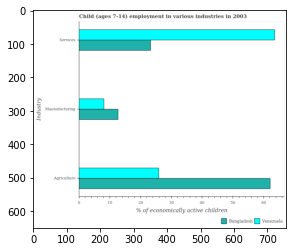

Number of QA =  28





,Industry,Venezuela,Bangladesh
0,Services,63.921834,23.489539
1,Maunufacturing,8.251331,12.711476
2,Agriculture,26.070119,62.194172


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active children in agriculture in venezuela and that in bangladesh ?
PREDICTED =  -36.124053653976986
EXPECTED =  -36.1999549825




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active children in agriculture in bangladesh and the percentage of economically active children in services in venezuela ?
PREDICTED =  61.19417220609207
EXPECTED =  -1.4735751568999973




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active children in agriculture and percentage of

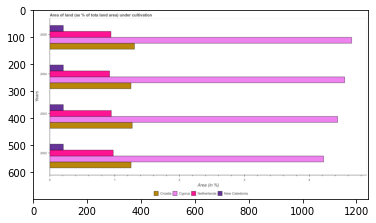

Number of QA =  30





,Years,New Caledonia,Cyprus,Croatia,Netherlands
0,2005,0.211805,4.684132,1.312996,0.950199
1,2004,0.215788,4.537602,1.263653,0.930065
2,2003,0.215707,4.434333,1.280080,0.956389
3,2002,0.213685,NaN,1.259502,0.986888


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land under cultivation in new caledonia in 2004 and that in 2005 ?
PREDICTED =  0.003983017248306242
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land under cultivation in cyprus in 2004 and the percentage of land under cultivation in croatia in 2005 ?
PREDICTED =  -0.1465305279274931
EXPECTED =  3.2409513288712795




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the percentage of land under cultivation in netherlands and percentage of land under cultivation in cyprus ?
PREDI

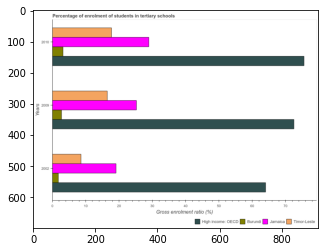

Number of QA =  30





,Years,Timor-Leste,Burundi,High income: OECD,Jamaica
0,2010,17.930103,3.340659,75.796054,29.257698
1,2009,16.596899,2.893552,72.863398,25.433215
2,2002,8.703291,1.956184,64.489674,19.430558


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of students enrolled in tertiary schools in burundi in 2002 and that in 2010 ?
PREDICTED =  -1.384475045200668
EXPECTED =  -1.40206015110016




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of students enrolled in tertiary schools in burundi in 2010 and the percentage of students enrolled in tertiary schools in high income: oecd in 2009 ?
PREDICTED =  0.0
EXPECTED =  -69.36148333549497




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the percentage of students enrolled in tertiary schools in burundi a

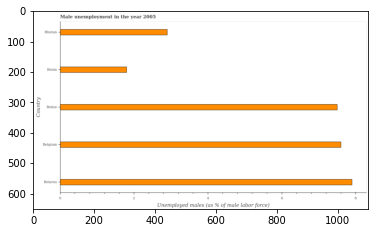

Number of QA =  22





,Country,Unemployed males (as % of male labor force)
0,Benin,1.815515
1,Bhutan,2.917073
2,Belize,7.520380
3,Belarus,7.935822
4,Belgium,7.627849


> what is the title of the graph ?
PREDICTED =  Male unemployment in the year 2005
EXPECTED =  Male unemployment in the year 2005




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Unemployed males (as % of male labor force)
EXPECTED =  Unemployed males (as % of male labor force)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed males population in belarus and belize ?
PREDICTED =  0.41544137300465867
EXPECTED =  0.4




				 4 / 4 = 1.0


> what is the median unemployed males population ?
PREDICTED =  None
EXPECTED =  7.5




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio

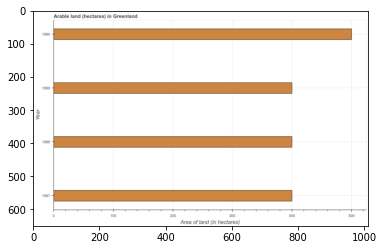

Number of QA =  23





,Year,Area of land (in hectares)
0,1990,504.353847
1,1989,402.519197
2,1987,401.371061
3,1988,399.904634


> what is the title of the graph ?
PREDICTED =  Arable land (hectares) in Greenland
EXPECTED =  Arable land (hectares) in Greenland




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Area of land (in hectares)
EXPECTED =  Area of land (in hectares)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the area of land in 1988 and 1989 ?
PREDICTED =  -2.6145627727361784
EXPECTED =  0.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median area of land ?
PREDICTED =  1988.5
EXPECTED =  400.0




				 3 / 5 = 0.6


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evalu

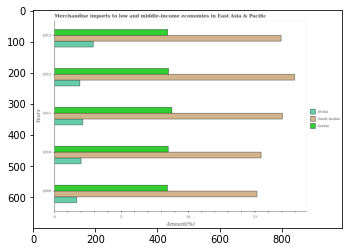

Number of QA =  29





,Years,Aruba,Serbia,Saudi Arabia
0,2012,1.924038,NaN,18.018837
1,2010,2.024856,NaN,15.443709
2,2013,2.949369,NaN,16.955199
3,2009,1.684927,NaN,15.141784
4,2011,2.154904,NaN,17.162323


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in aruba in 2010 and that in 2013 ?
PREDICTED =  -0.9245133757422344
EXPECTED =  -0.9059831728382599




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in saudi arabia in 2010 and the percentage of amount earned from merchandise imports in aruba in 2013 ?
PREDICTED =  -1.5114900968507854
EXPECTED =  12.558022915681091




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of amount earned from merchandise import

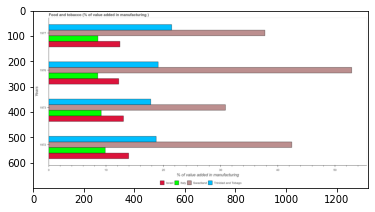

Number of QA =  30





,Years,Trinidad and Tobago,israel,Swaziland,Italy
0,1977,21.688861,12.475719,37.660361,8.524083
1,1976,19.035659,12.187165,53.339885,8.580793
2,1973,17.842271,13.111477,30.892257,9.261315
3,1972,18.785347,14.031532,42.475191,9.958854


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added in manufacturing food and tobacco in italy in 1973 and that in 1976 ?
PREDICTED =  -4.580793405338964
EXPECTED =  0.6079681759832969




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added in manufacturing food and tobacco in israel in 1973 and the value added in manufacturing food and tobacco in italy in 1972 ?
PREDICTED =  -15.220168379293131
EXPECTED =  3.18522227104609




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1973, what is the difference between the value added in manufacturing food and tobacco in swaziland and value added in manu

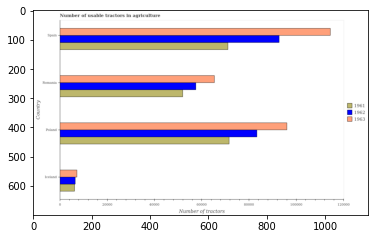

Number of QA =  29





,Country,1963,1962,1961
0,Poland,96010.047015,83035.010559,71223.546444
1,Romania,65600.702042,57932.256189,52439.753535
2,Spain,114602.270933,93603.002274,71011.546987
3,Iceland,7286.963629,6708.115841,6316.226392


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of usable tractors in agriculture in 1963 in romania and that in spain ?
PREDICTED =  -49001.56889089623
EXPECTED =  -49059.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of usable tractors in agriculture in 1963 in poland and the number of usable tractors in agriculture in 1961 in romania?
PREDICTED =  30409.344973368352
EXPECTED =  44069.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of usable tractors in agriculture in 1963 and number of usable tractors in agriculture in 1961 in romania ?
PREDICTED =  231

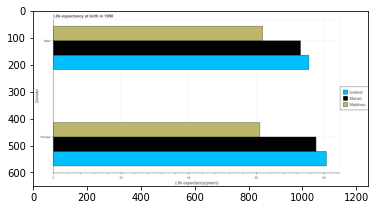

Number of QA =  23





,Gender,Macao,Maldives,iceland
0,Female,NaN,60.995727,80.820391
1,Male,73.086083,62.001939,76.127905


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the life expectancy(female) in maldives to that in macao ?
PREDICTED =  0.8345737603735202
EXPECTED =  0.7857529305680796




				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Life expectancy(years)
EXPECTED =  20.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Life expectancy at birth in 1990
EXP

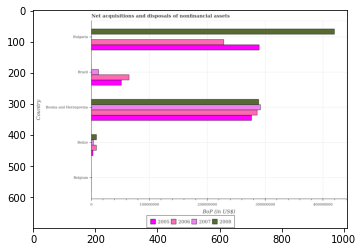

Number of QA =  27





,Country,2007,2005,2008,2006
0,Belize,4.482162e+06,3.736897e+06,9.525777e+06,9.424158e+06
1,Bosnia and Herzegovina,NaN,2.784802e+08,2.904077e+08,2.872095e+08
2,Belgium,NaN,NaN,NaN,NaN
3,Brazil,1.351292e+07,5.314067e+07,NaN,6.641042e+07
4,Bulgaria,NaN,2.920014e+08,4.213221e+08,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments in 2007 in bosnia and herzegovina and that in brazil ?
PREDICTED =  -9030761.075639091
EXPECTED =  279645923.7




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments in 2008 in belize and the balance of payments in 2006 in bosnia and herzegovina?
PREDICTED =  -280881948.39559233
EXPECTED =  -277477479.07




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments in 2006 and balance of payments in 2005 in bulgaria ?
PREDICTED =  71042683.65838224
EXPECTED =  -61191399.900000036




				 1 / 3 =

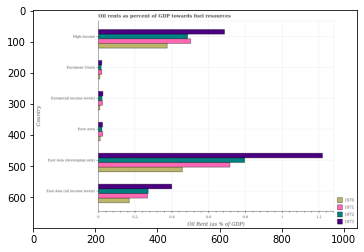

Number of QA =  30





,Country,1972,1971,1970,1973
0,Europe(all income levels),0.022658,0.023848,0.009750,0.026257
1,European Union,0.018243,0.020920,0.009983,0.021105
2,East Asia (developing only),0.799145,NaN,0.464205,1.224488
3,High income,0.491718,NaN,NaN,0.686682
4,East Asia (all income levels),0.274159,0.270548,0.169755,0.406726
5,Euro area,0.021675,0.025144,0.012244,0.024855


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oil rent in 1970 in east asia (all income levels) and that in euro area ?
PREDICTED =  0.1575101527414588
EXPECTED =  0.15824536216953247




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oil rent in 1972 in east asia (developing only) and the oil rent in 1971 in east asia (all income levels)?
PREDICTED =  0.5249862210828152
EXPECTED =  0.528049337654519




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the rat

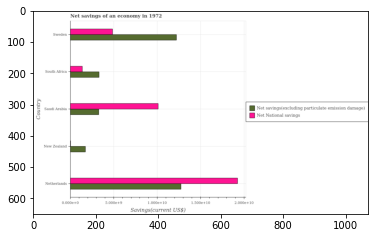

Number of QA =  28





,Country,Net National savings,Net savings(excluding particulate emission damage)
0,New Zealand,NaN,3.317705
1,Netherlands,34.890328,23.058129
2,Saudi Arabia,18.211385,6.109710
3,South Africa,2.690785,6.157683
4,Sweden,9.048007,22.008570


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net savings(excluding particulate emission damage) in new zealand and that in south africa ?
PREDICTED =  -2.839978355437096
EXPECTED =  -1567420036.904




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net national savings in south africa and the net savings(excluding particulate emission damage) in new zealand ?
PREDICTED =  2.690784543802572
EXPECTED =  -357804705.32263994




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net savings(excluding particulate emission damage) and net national savings in saudi arabia ?
PREDICTED =  54.54208

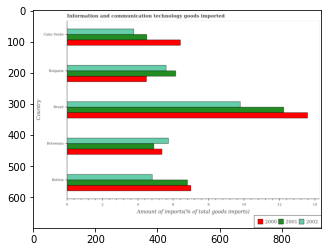

Number of QA =  29





,Country,2002,2000,2001
0,Brazil,9.820391,13.613519,12.290087
1,Cabo Verde,3.782273,6.375850,4.512780
2,Bolivia,4.842797,7.002154,6.821332
3,Bulgaria,5.632753,4.505896,6.153806
4,Botswana,5.797995,5.366800,4.934165


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods imported in 2000 in brazil and that in cabo verde ?
PREDICTED =  7.23766910189783
EXPECTED =  7.174622096900001




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods imported in 2001 in brazil and the amount of goods imported in 2000 in bulgaria?
PREDICTED =  6.136281386415092
EXPECTED =  7.742280635500001




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods imported in 2002 and amount of goods imported in 2000 in bulgaria ?
PREDICTED =  25.37031354491227
EXPECTED =  1.1091219001




				 1 / 3 = 0

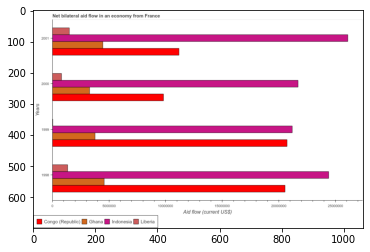

Number of QA =  30





,Years,Ghana,Congo (Republic’,Liberia,Indonesia
0,2001,8.136798e+06,2.041281e+07,2.775273e+06,4.678361e+07
1,1999,6.885478e+06,3.738848e+07,NaN,3.832935e+07
2,1998,8.303857e+06,3.704199e+07,2.530239e+06,4.417565e+07
3,2000,5.934447e+06,1.793752e+07,1.543721e+06,3.907263e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in congo (republic) in 1999 and that in 2000 ?
PREDICTED =  19450958.987636182
EXPECTED =  10920000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in indonesia in 2000 and the net bilateral aid flow in liberia in 1998 ?
PREDICTED =  -5103021.203537457
EXPECTED =  20360000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the net bilateral aid flow in liberia and net bilateral aid flow in indonesia ?
PREDICTED =  -165585974.3137432
EXPECTED =  -21160000.0




				 0 / 3 = 0

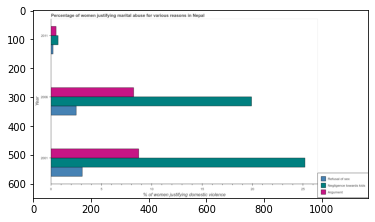

Number of QA =  29





,Year,Negligence towards kids,Refusal of sex,Argument
0,2011,0.764077,0.260494,0.569819
1,2001,25.011767,3.128136,8.887019
2,2006,20.011373,2.559565,8.285029


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of women justifying domestic violence due to arguments in 2006 and that in 2011 ?
PREDICTED =  7.715209475639279
EXPECTED =  7.7




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of women justifying domestic violence due to refusal of sex in 2001 and the percentage of women justifying domestic violence due to negligence towards kids in 2011 ?
PREDICTED =  2.867642490184117
EXPECTED =  2.4000000000000004




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the percentage of women justifying domestic violenc

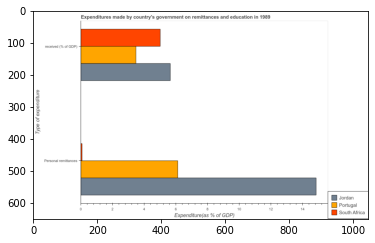

Number of QA =  23





,Type of expenditure,Portugal,South Africa,Jordan
0,received (% of GDP),3.504869,5.023169,5.692319
1,Personal remittances,6.203703,0.103004,14.960789


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in personal remittances in portugal and the expenditure in education in jordan ?
PREDICTED =  -8.757086545993293
EXPECTED =  0.4713107164985004




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Expenditure(as % of GDP)
EXPECTED =  2.0




				 0 / 5 = 0.0


> what is the title of the graph ?


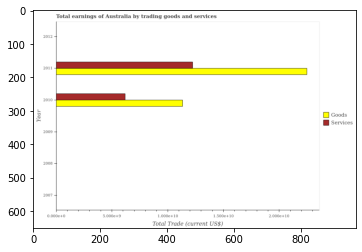

Number of QA =  21





,Year,Goods,Services
0,2007,NaN,NaN
1,2012,NaN,NaN
2,2008,NaN,NaN
3,2009,NaN,NaN
4,2010,20.500295,11.112150
5,2011,40.678257,22.028127


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned by trading goods in 2011 and the amount earned by trading services in 2007 ?
PREDICTED =  40.67825701634529
EXPECTED =  22480715748




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the lowest amount earned by trading services ?
PREDICTED =  1989.999704680449
EXPECTED =  12237256181




				 0 / 3 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Total Trade (current US$)
EXPECTED =  5000000000.0




				 0 / 4 = 0.0


> what is the title of the graph ?
P

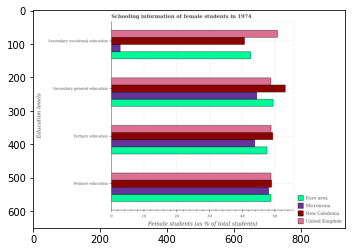

Number of QA =  29





,Education levels,United Kingdom,Micronesia,New Caledonia,Euro area
0,Tertiary education,49.779444,44.561475,50.070359,48.409209
1,Secondary general education,49.683650,45.279100,54.057599,50.346119
2,Primary education,49.560803,48.786965,49.853577,NaN
3,Secondary vocational education,51.417119,2.864535,41.203285,43.140188


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female students in secondary vocational education in micronesia and that in new caledonia ?
PREDICTED =  -38.33875051121069
EXPECTED =  -38.00646




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female students in secondary vocational education in united kingdom and the percentage of female students in tertiary education in micronesia ?
PREDICTED =  48.55258399069431
EXPECTED =  6.999610000000004




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicti

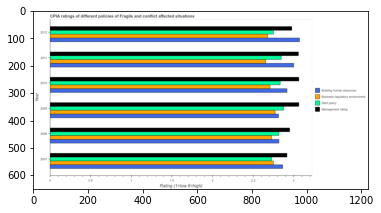

Number of QA =  30





,Year,Management rating,Building human resources,Debt policy,Business regulatory environment
0,2012,2.961898,3.031724,NaN,2.700574
1,2008,2.960589,2.824946,NaN,NaN
2,2009,NaN,2.810966,NaN,2.739704
3,2011,3.072909,3.010297,NaN,NaN
4,2007,2.942152,2.862024,2.732902,2.750009
5,2010,3.050737,2.856556,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of business regulatory environment in 2008 and that in 2012 ?
PREDICTED =  -1.7005736043403297
EXPECTED =  0.049




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of business regulatory environment in 2007 and the cpia rating of management in 2011 ?
PREDICTED =  nan
EXPECTED =  -0.30769230769231015




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the cpia rating of debt policy and cpia rating of building human resources ?
PREDICTED =  nan
EXPECTED =  0.0




				 0 / 3 = 0.0


is_built_with_cuda: Tru

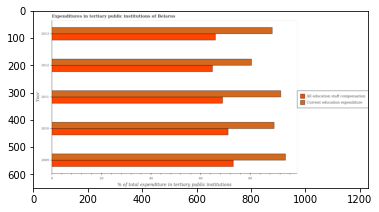

Number of QA =  28





,Year,All education staff compensation,Current education expenditure
0,2009,NaN,95.044655
1,2010,71.168114,90.090934
2,2013,66.133288,89.173990
3,2012,65.493605,81.483794
4,2011,68.818156,92.596177


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in staff compensation in 2010 and that in 2011 ?
PREDICTED =  2.349957841212742
EXPECTED =  2.226




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in education in 2011 and the expenditure in staff compensation in 2009 ?
PREDICTED =  4.3319527947737555
EXPECTED =  19.156890869140497




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the expenditure in education and expenditure in staff compensation ?
PREDICTED =  0.0
EXPECTED =  15.745




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: F

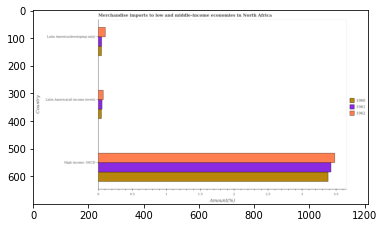

Number of QA =  29





,Country,1962,1961,1960
0,Latin America(all income levels),0.080224,0.062445,0.053134
1,High income: OECD,3.487800,3.427166,3.396672
2,Latin America(developing only),0.110678,0.055971,0.053206


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in 1962 in high income: oecd and that in latin america(all income levels) ?
PREDICTED =  3.4075764966427
EXPECTED =  3.406852948977451




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in 1960 in high income: oecd and the percentage of amount earned from merchandise imports in 1962 in latin america(all income levels)?
PREDICTED =  3.4075764966427
EXPECTED =  3.309034504198561




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentag

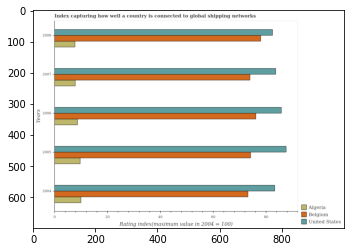

Number of QA =  29





,Years,Algeria,Belgium,United States
0,2007,8.001043,74.358344,83.945778
1,2005,9.860833,74.518434,88.593579
2,2008,7.896284,77.846066,82.749125
3,2006,8.940865,76.884887,86.274126
4,2004,10.016351,73.440533,84.054848


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating index in belgium in 2004 and that in 2006 ?
PREDICTED =  -3.444353335100544
EXPECTED =  -2.990000000000009




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating index in belgium in 2006 and the rating index in algeria in 2008 ?
PREDICTED =  -0.9611793376602833
EXPECTED =  68.4




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the rating index in united states and rating index in belgium ?
PREDICTED =  9.713838100890001
EXPECTED =  10.14




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs

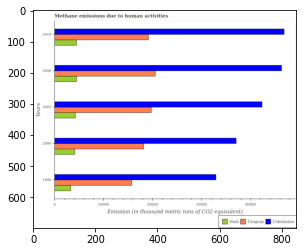

Number of QA =  29





,Years,Uzbekistan,Uruguay,Haiti
0,2010,47320.986480,19417.363083,4637.704467
1,2000,37140.992109,18396.160136,4266.104314
2,1990,33470.061708,NaN,3489.907331
3,2008,46657.098630,20762.771123,4640.154862
4,2005,42647.960670,19945.717033,4396.609505


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emitted in uruguay in 2005 and that in 2010 ?
PREDICTED =  528.3539499138278
EXPECTED =  586.3999999999978




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emitted in haiti in 1990 and the amount of methane emitted in uzbekistan in 2000 ?
PREDICTED =  -776.1969831782408
EXPECTED =  -33771.2




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the amount of methane emitted in uzbekistan and amount of methane emitted in haiti ?
PREDICTED =  185806.61911677453
EXPECTED =  41846.6




				 0 / 3

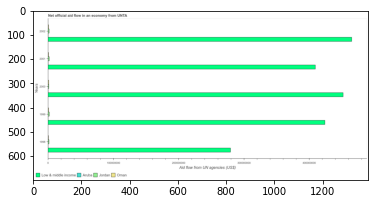

Number of QA =  30





,Years,Low & middle income,Aruba,Oman,Jordan
0,1998,2.823293e+08,NaN,NaN,NaN
1,2000,4.478533e+08,NaN,NaN,1.744917e+06
2,2002,4.655804e+08,NaN,NaN,2.254462e+06
3,1999,4.189794e+08,NaN,NaN,2.388836e+06
4,2001,4.089065e+08,NaN,NaN,2.416091e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in oman in 2001 and that in 2002 ?
PREDICTED =  nan
EXPECTED =  -80000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in low & middle income in 1999 and the net official aid flow in oman in 2002 ?
PREDICTED =  -46601033.42474663
EXPECTED =  423120000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the net official aid flow in jordan and net official aid flow in low & middle income ?
PREDICTED =  -402528696.88489234
EXPECTED =  -407510000.0




				 1 / 3 = 0.3333


is_buil

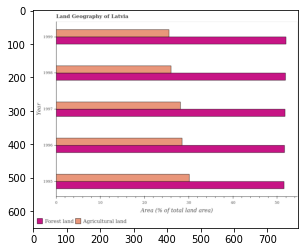

Number of QA =  28





,Year,Agricultural land,Forest land
0,1999,NaN,52.483493
1,1995,NaN,51.942475
2,1998,NaN,52.100017
3,1996,29.158979,52.209063
4,1997,28.384985,52.190072


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land area under forests in 1996 and that in 1999 ?
PREDICTED =  -0.2744307313009955
EXPECTED =  -0.328




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of land area under forests in 1996 to that in 1997 ?
PREDICTED =  1.0003638655340181
EXPECTED =  0.998




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...

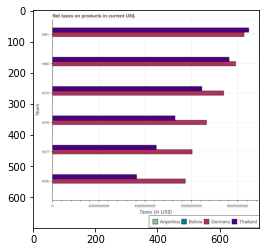

Number of QA =  27





,Years,Bolivia,Germany,Thailand,Argentina
0,1979,NaN,7.458756e+10,6.513277e+10,NaN
1,1978,NaN,6.704696e+10,5.335033e+10,NaN
2,1980,NaN,7.897562e+10,7.656168e+10,NaN
3,1981,NaN,8.309194e+10,8.538189e+10,NaN
4,1976,NaN,5.761969e+10,3.634489e+10,NaN
5,1977,NaN,5.947245e+10,4.494388e+10,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net taxes on products in bolivia in 1980 and that in 1981 ?
PREDICTED =  nan
EXPECTED =  -2835.8683999999994




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net taxes on products in bolivia in 1981 and the net taxes on products in thailand in 1978 ?
PREDICTED =  -53350330534.3787
EXPECTED =  -52899984768.8611




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net taxes on products in thailand 

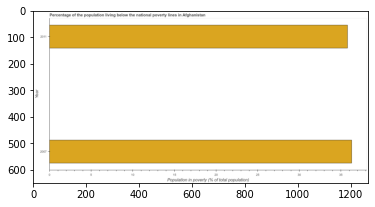

Number of QA =  19





,Year,Population in poverty (% of total population)
0,2007,36.339221
1,2011,36.161793


> what is the title of the graph ?
PREDICTED =  Percentage of the population living below the national poverty lines in Afghanistan
EXPECTED =  Percentage of the population living below the national poverty lines in Afghanistan




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Population in poverty (% of total population)
EXPECTED =  Population in poverty (% of total population)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population living below poverty line in 2007 and 2011 ?
PREDICTED =  0.1774288940852884
EXPECTED =  0.5




				 3 / 4 = 0.75


> what is the median percentage of population living below poverty line ?
PREDICTED =  None
EXPECTED =  36.05




				 3 / 6 = 0.5


is_built_with_cu

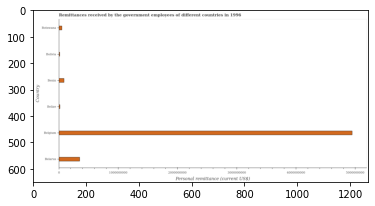

Number of QA =  22





,Country,Personal remittance (current US$)
0,Bolivia,2.209995e+07
1,Belize,2.659568e+07
2,Benin,9.479061e+07
3,Botswana,5.877754e+07
4,Belarus,3.626796e+08
5,Belgium,4.944926e+09


> what is the title of the graph ?
PREDICTED =  Remittances received by the government employees of different countries in 1996
EXPECTED =  Remittances received by the government employees of different countries in 1996




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Personal remittance (current US$)
EXPECTED =  Personal remittance (current US$)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the personal remittances in belize and bolivia ?
PREDICTED =  4495731.7735338025
EXPECTED =  3750000.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median personal remittances ?
PREDICTED =  7678

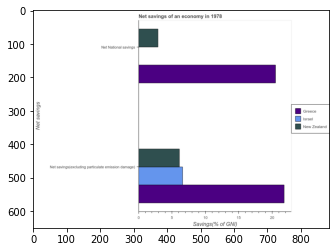

Number of QA =  20





,Net savings,New Zealand,Greece,Israel
0,Net National savings,3.039543,20.726011,NaN
1,Net savings(excluding particulate emission dam...,6.206653,22.098839,6.67169


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net savings(excluding particulate emission damage) in greece and that in israel ?
PREDICTED =  15.42714970934752
EXPECTED =  15.20310162350628




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net national savings in greece and the net savings(excluding particulate emission damage) in new zealand ?
PREDICTED =  14.519357489161523
EXPECTED =  14.394158475174951




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is t

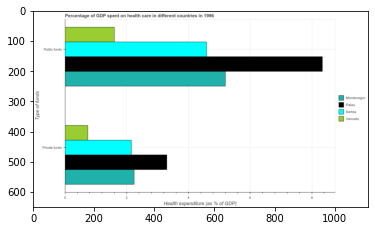

Number of QA =  23





,Type of funds,Palau,Vanuatu,Serbia,Montenegro
0,Public funds,NaN,1.633577,4.634276,5.193348
1,Private funds,NaN,0.754697,2.195640,2.279880


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of public funds spent in healthcare and amount of private funds spent in healthcare in vanuatu ?
PREDICTED =  -1.3882740572832515
EXPECTED =  0.8600320766073608




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount of public funds spent in healthcare in serbia to that in vanuatu ?
PREDICTED =  2.836889470241029
EXPECTED =  2.868901671259645




				 1 / 4 = 0.25


> what is th

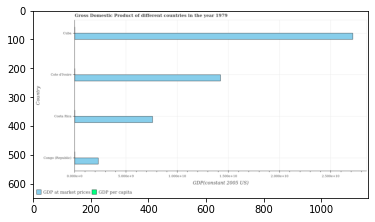

Number of QA =  28





,Country,GDP per capita,GDP at market prices
0,Costa Rica,NaN,13.682990
1,Cote d'Ivoire,NaN,25.602828
2,Cuba,NaN,48.703631
3,Congo (Republic),NaN,4.243294


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp per capita in congo (republic) and that in cote d'ivoire ?
PREDICTED =  nan
EXPECTED =  -484.883




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp at market prices in costa rica and the gdp per capita in cote d'ivoire ?
PREDICTED =  -11.919838348733789
EXPECTED =  7600755797.775082




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp at market prices and gdp per capita in congo (republic) ?
PREDICTED =  44.46033722453441
EXPECTED =  2299417348.324




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Tr

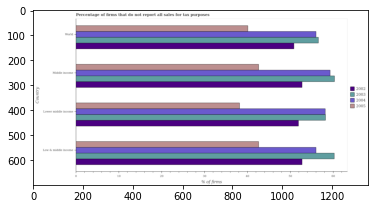

Number of QA =  30





,Country,2002,2005,2004,2003
0,World,51.283090,40.294960,NaN,56.341324
1,Middle income,52.949254,43.080398,59.974351,61.243778
2,Lower middle income,52.334116,38.101517,57.773734,58.737680
3,Low & middle income,52.860773,42.839401,56.153131,60.822300


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 6 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?

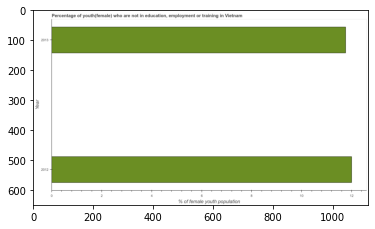

Number of QA =  19





,Year,% of female youth population
0,2012,12.068159
1,2013,11.833067


> what is the title of the graph ?
PREDICTED =  Percentage of youth(female) who are not in education, employment or training in Vietnam
EXPECTED =  Percentage of youth(female) who are not in education, employment or training in Vietnam




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  % of female youth population
EXPECTED =  % of female youth population




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed female youth population in 2012 and 2013 ?
PREDICTED =  0.23509202056286327
EXPECTED =  0.24




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed female youth population ?

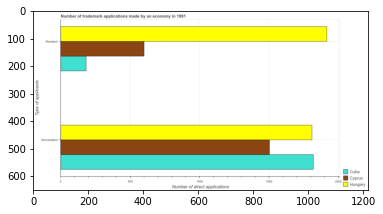

Number of QA =  23





,Type of applicants,Cyprus,Cuba,Hungary
0,Nonresident,17848.363872,21294.186560,21323.546926
1,Resident,7101.873353,2181.435662,22582.363636


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by non residents in cuba and that in cyprus ?
PREDICTED =  0.0
EXPECTED =  316




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by non residents in cuba and the number of trademark applications made by residents in hungary ?
PREDICTED =  0.0
EXPECTED =  -97




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by non residents and number of trademark applications made by residents in cyprus ?
PREDICTED =  0.0
EXPECTED =  903






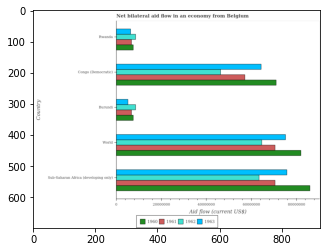

Number of QA =  30





,Country,1963,1962,1961,1960
0,World,7.550037e+07,6.420257e+07,7.074609e+07,8.265566e+07
1,Congo (Democratic),6.382590e+07,4.597683e+07,5.734625e+07,7.146604e+07
2,Rwanda,6.570741e+06,8.425890e+06,6.915505e+06,7.826863e+06
3,Sub-Saharan Africa (developing only),7.612691e+07,NaN,7.064819e+07,8.608118e+07
4,Burundi,5.432790e+06,8.839041e+06,6.923749e+06,7.800968e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1962 in congo (democratic) and that in sub-saharan africa (developing only) ?
PREDICTED =  45976829.88216753
EXPECTED =  -17100000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1960 in burundi and the net bilateral aid flow in 1962 in world?
PREDICTED =  -74854688.39359365
EXPECTED =  -57110000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1960 and net bilateral aid flow in 1963 in world ?
PREDICTED =  10580808.935343668
EXPECTED =  6840000.0




			

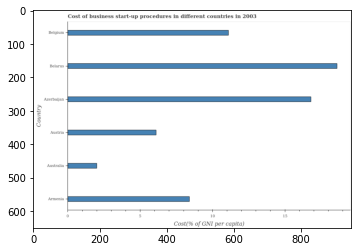

Number of QA =  22





,Country,Cost(% of GNI per capita)
0,Australia,2.039208
1,Austria,6.171976
2,Belarus,18.664355
3,Belgium,11.124692
4,Armenia,8.466906
5,Azerbaijan,16.805921


> what is the title of the graph ?
PREDICTED =  Cost of business start-up procedures in different countries in 2003
EXPECTED =  Cost of business start-up procedures in different countries in 2003




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Cost(% of GNI per capita)
EXPECTED =  Cost(% of GNI per capita)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of business startup procedures in armenia and belgium ?
PREDICTED =  -2.657785822492162
EXPECTED =  -2.7




				 4 / 4 = 1.0


> what is the median cost of business startup procedures ?
PREDICTED =  None
EXPECTED =  9.75




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished

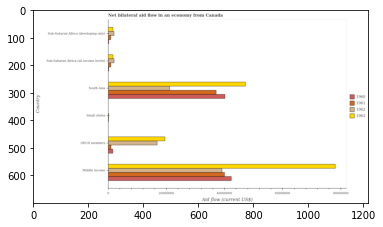

Number of QA =  30





,Country,1963,1962,1961,1960
0,Small states,NaN,NaN,NaN,NaN
1,South Asia,NaN,NaN,NaN,NaN
2,OECD members,1.975370e+07,1.706233e+07,1.163064e+06,1.789770e+06
3,Middle income,7.854564e+07,3.951971e+07,4.038059e+07,4.267925e+07
4,Sub-Saharan Africa (all income levels),1.856911e+06,2.191958e+06,1.076661e+06,NaN
5,Sub-Saharan Africa (developing only),1.798284e+06,2.235912e+06,1.071560e+06,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1960 in sub-saharan africa (all income levels) and the net bilateral aid flow in 1961 in oecd members?
PREDICTED =  -1163064.2165612585
EXPECTED =  -750000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net bilateral aid flow in 1962 in oecd members to that in south asia ?
PREDICTED =  1.0
EXPECTED =  0.7972524869729986




				 0 / 4 = 0.0


is_built_with

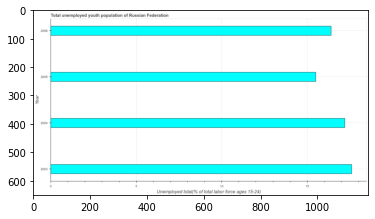

Number of QA =  23





,Year,Unemployed total(% of total labor force ages 15-24)
0,2003,17.538859
1,2006,16.383643
2,2005,15.469725
3,2004,17.222695


> what is the title of the graph ?
PREDICTED =  Total unemployed youth population of Russian Federation
EXPECTED =  Total unemployed youth population of Russian Federation




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Unemployed total(% of total labor force ages 15-24)
EXPECTED =  Unemployed total(% of total labor force ages 15-24)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed youth in 2005 and 2006 ?
PREDICTED =  -0.9139175577319953
EXPECTED =  -0.9




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed youth ?
PREDICTED =  2004.5
EXPECTED =  16.8000001907349






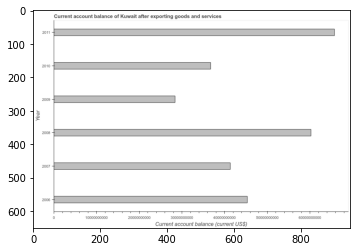

Number of QA =  23





,Year,Current account balance (current US$)
0,2008,6.045357e+10
1,2011,6.576939e+10
2,2010,3.693526e+10
3,2006,4.550316e+10
4,2007,4.136601e+10
5,2009,2.850285e+10


> what is the title of the graph ?
PREDICTED =  Current account balance of Kuwait after exporting goods and services
EXPECTED =  Current account balance of Kuwait after exporting goods and services




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Current account balance (current US$)
EXPECTED =  Current account balance (current US$)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the current account balance in 2006 and 2010 ?
PREDICTED =  8567902308.762093
EXPECTED =  8585016525.0




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median current account balance ?
PREDICTED =  65769392675.6877
EXPEC

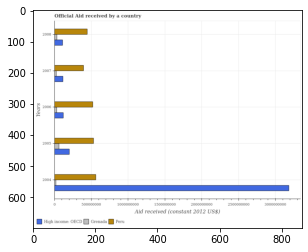

Number of QA =  29





,Years,Grenada,Peru,High income: OECD
0,2007,6.075370e+07,7.224039e+08,2.227342e+08
1,2008,7.490458e+07,8.151320e+08,2.144129e+08
2,2004,4.874649e+07,1.026075e+09,5.797931e+09
3,2006,7.249567e+07,9.527844e+08,2.320510e+08
4,2005,1.236263e+08,9.730201e+08,3.826351e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid received in grenada in 2007 and that in 2008 ?
PREDICTED =  -14150877.991547838
EXPECTED =  -8050000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid received in peru in 2006 and the net official aid received in grenada in 2007 ?
PREDICTED =  230380404.36440074
EXPECTED =  494960000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the net official aid received in high income: oecd and net official aid received in peru ?
PREDICTED =  -1026072601.3604788
EXPECTED =  -334730000.0




				

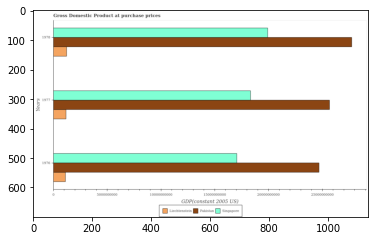

Number of QA =  29





,Years,Liechtenstein,Singapore,Pakistan
0,1978,2.300552e+09,3.620757e+10,5.089951e+10
1,1977,2.184713e+09,3.335025e+10,4.685578e+10
2,1976,2.109578e+09,3.125206e+10,4.502187e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp at purchase prices in singapore in 1977 and that in 1978 ?
PREDICTED =  -2857319080.6593857
EXPECTED =  -1594660919.3269005




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp at purchase prices in liechtenstein in 1978 and the gdp at purchase prices in pakistan in 1977 ?
PREDICTED =  115838492.74225664
EXPECTED =  -24428977947.95118




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1976, what is the difference between the gdp at purchase prices in singapore and gdp at purchase prices in liechtenstein ?
PREDICTED =  100809882670.2053
EXPECTED =  159244987

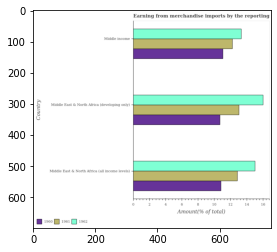

Number of QA =  29





,Country,1962,1961,1960
0,Middle income,13.403742,12.440376,11.187941
1,Middle East & North Africa (all income levels),15.183193,12.953719,10.835588
2,Middle East & North Africa (developing only),16.121816,13.136843,10.886414


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in 1961 in middle income and the percentage of amount earned from merchandise imports in 1962 in middle east & north africa (all income levels)?
PREDICTED =  -0.5133426673348929
EXPECTED =  -2.7927250147183997




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in 1962 and percentage of amount earned from merchandise imports in 1960 in middle income ?
PREDICTED =  -8.187940689333443
EXPECTED =  2.2660250005594005




				 0 /

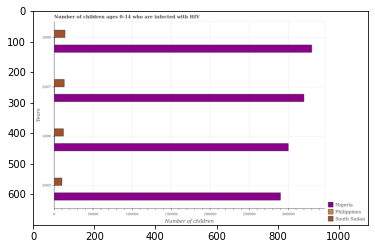

Number of QA =  29





,Years,Philippines,Nigeria,South Sudan
0,2008,NaN,603627.087848,26624.073900
1,2007,NaN,580223.513886,24656.212453
2,2006,NaN,542456.526608,23104.972175
3,2005,NaN,526752.452319,19667.858360


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of hiv infected children in nigeria in 2005 and that in 2008 ?
PREDICTED =  -76874.63552957424
EXPECTED =  -40000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of hiv infected children in south sudan in 2006 and the number of hiv infected children in philippines in 2005 ?
PREDICTED =  3437.1138147624843
EXPECTED =  11800




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the number of hiv infected children in philippines and number of hiv infected children in nigeria ?
PREDICTED =  2002.5
EXPECTED =  -289800

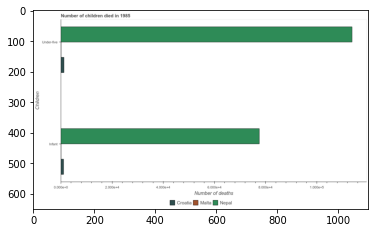

Number of QA =  23





,Children,Nepal,Malta,Croatia
0,Under-five,11.434074,NaN,0.148533
1,Infant,7.794632,NaN,0.131778


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of infant deaths in malta and that in nepal ?
PREDICTED =  0.0
EXPECTED =  -77461




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of infant deaths in croatia and the number of under-five deaths in malta ?
PREDICTED =  -1.8682220000528629
EXPECTED =  965




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of infant deaths and number of under-five deaths in nepal ?
PREDICTED =  -5.794631579664805
EXPECTED =  -36248




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ..

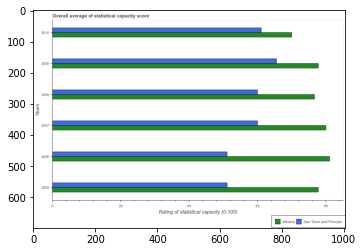

Number of QA =  28





,Years,Albania,Sao Tome and Principe
0,2010,70.234160,61.746144
1,2009,78.172698,65.721671
2,2007,80.054984,60.000377
3,2006,81.892025,51.518630
4,2008,76.902103,60.213326
5,2005,78.194363,51.288926


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in albania in 2005 and that in 2010 ?
PREDICTED =  7.960203015124506
EXPECTED =  7.7777777777778




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in albania in 2008 and the rating of statistical capacity in sao tome and principe in 2007 ?
PREDICTED =  -3.152880615504799
EXPECTED =  16.6666666666667




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the rating of statistical capacity in albania and rating of statistical capacity in sao tome and principe ?
PREDICTED

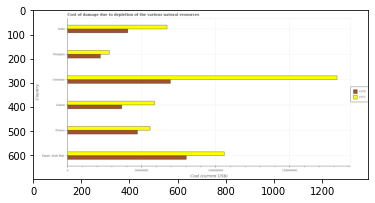

Number of QA =  28





,Country,1971,1970
0,Hungary,5.138379e+07,4.048806e+07
1,France,1.013228e+08,8.614854e+07
2,India,NaN,NaN
3,Gabon,1.054280e+08,6.598134e+07
4,Germany,NaN,1.262446e+08
5,"Egypt, Arab Rep.",1.914756e+08,1.469801e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of various natural resources in 1971 in egypt, arab rep. and that in gabon ?
PREDICTED =  86047659.46364005
EXPECTED =  47090498.837752804




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of various natural resources in 1970 in germany and the cost of damage caused due to the depletion of various natural resources in 1971 in hungary?
PREDICTED =  85756532.84538427
EXPECTED =  41210430.1753105




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of dam

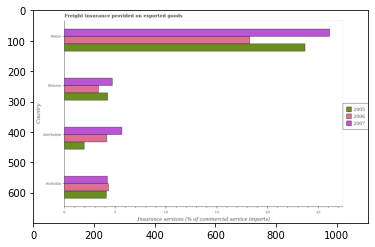

Number of QA =  29





,Country,2007,2005,2006
0,Belize,25.966915,23.830229,18.221709
1,Australia,4.270019,4.175473,4.427720
2,Azerbaijan,5.673696,1.994687,4.204385
3,Belarus,4.804981,4.274407,3.445499


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the freight insurance provided on exported goods in 2005 in azerbaijan and that in belize ?
PREDICTED =  -21.83554159642771
EXPECTED =  -21.75674478835743




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the freight insurance provided on exported goods in 2006 in belarus and the freight insurance provided on exported goods in 2007 in australia?
PREDICTED =  -0.9822203041448274
EXPECTED =  -0.8837118538587196




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finish

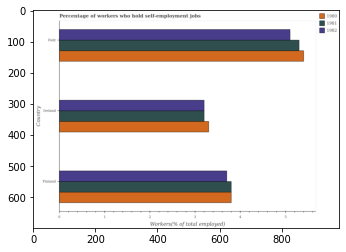

Number of QA =  29





,Country,1982,1980,1981
0,Italy,5.129188,5.407364,5.269716
1,Finland,3.726211,3.798804,3.809639
2,Ireland,3.192068,3.294606,3.190525


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers in 1982 in ireland and that in italy ?
PREDICTED =  -1.9371194869610924
EXPECTED =  -1.8999998569488503




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers in 1982 in ireland and the percentage of self-employed workers in 1981 in finland?
PREDICTED =  -0.6175711283861935
EXPECTED =  -0.5999999046325604




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers in 1981 and percentage of self-employed workers in 1982 in ireland ?
PREDICTED =  -0

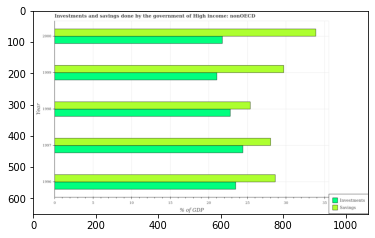

Number of QA =  28





,Year,Savings,Investments
0,2000,34.002003,21.781449
1,1996,28.720207,NaN
2,1999,29.727962,20.996209
3,1998,25.262698,22.714763
4,1997,27.898645,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the savings of government in 1999 and that in 2000 ?
PREDICTED =  -4.274040421790669
EXPECTED =  -4.16




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the savings of government in 1998 and the investments of government in 1996 ?
PREDICTED =  -3.4575087608295014
EXPECTED =  1.8899272513588983




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the savings of government and investments of government ?
PREDICTED =  -2.370371104678302
EXPECTED =  5.13




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Tr

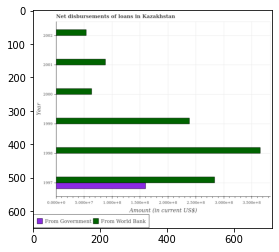

Number of QA =  23





,Year,From World Bank,From Government
0,1998,65.844601,NaN
1,2000,11.761344,NaN
2,2002,9.872495,NaN
3,1999,43.079374,NaN
4,2001,15.961608,NaN
5,1997,51.450083,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net disbursements of loan from world bank in 1997 and that in 1999 ?
PREDICTED =  8.370709852096873
EXPECTED =  45092000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net disbursements of loan from world bank in 1999 and the net disbursements of loan from government in 2002 ?
PREDICTED =  33.20687840884607
EXPECTED =  238456000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the net disbursements of loan from world bank in 1997 to that in 1998 ?
PREDICTED =  0.7813865140120693
EXPECTED =  0.776




				 1 / 3 = 0.3333


is_built_with_cuda: True
i

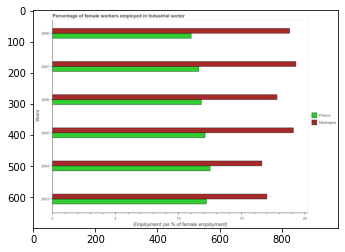

Number of QA =  28





,Years,France,Nicaragua
0,2007,11.652323,19.266381
1,2008,11.106750,18.751447
2,2003,12.416141,17.043941
3,2004,12.579048,16.705322
4,2006,11.922802,17.897090
5,2005,12.170370,18.898458


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females employed in industrial sector in france in 2003 and that in 2008 ?
PREDICTED =  1.3093902179483266
EXPECTED =  1.1999998092650994




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females employed in industrial sector in nicaragua in 2004 and the percentage of females employed in industrial sector in france in 2005 ?
PREDICTED =  -2.1931359866642666
EXPECTED =  4.500000000000002




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the percentage of females employed in industrial sector in fra

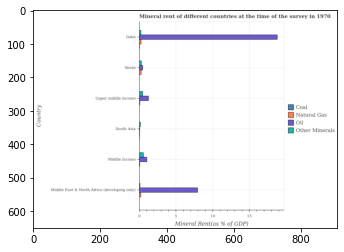

Number of QA =  30





,Country,Natural Gas,Oil,Other Minerals,Coal
0,Upper middle income,NaN,1.351314,0.600505,NaN
1,India,0.357333,19.074344,0.325598,NaN
2,Middle income,NaN,1.144257,0.694257,NaN
3,South Asia,NaN,NaN,NaN,NaN
4,World,0.393143,0.582464,0.393507,NaN
5,Middle East & North Africa (developing only),0.322293,8.063915,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the coal rent in india and that in middle east & north africa (developing only) ?
PREDICTED =  nan
EXPECTED =  0.047




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the natural gas rent in world and the coal rent in upper middle income ?
PREDICTED =  0.3931432715568207
EXPECTED =  0.2602066330625314




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oil rent and  rent of other minerals in south asia ?
PREDICTED =  3.0780349327628542
EXPECTED =  -0.105




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or pr

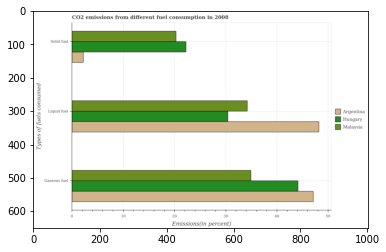

Number of QA =  28





,Types of fuels consumed,Unnamed: 1,Malaysia,Hungary
0,Solid fuel,2.348316,20.352461,22.209973
1,Liquid fuel,48.373417,34.316929,30.606767
2,Gaseous fuel,47.455183,35.215623,44.339498


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of solid fuel emission in argentina and that in malaysia ?
PREDICTED =  1.8575118878497996
EXPECTED =  -18.08787971927118




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of liquid fuel emission in malaysia and the percentage of gaseous fuel emission in hungary ?
PREDICTED =  3.710161405365085
EXPECTED =  -9.894167613757212




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of solid fuel emission and percentage of gaseous fuel emission in argentina ?
PREDICTED =  20.352461255873273
EXPECTED =  -44.86831023

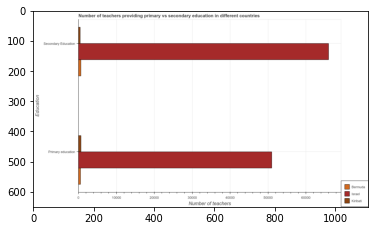

Number of QA =  23





,Education,Bermuda,israel,Kiribati
0,Secondary Education,845.115925,66518.864026,649.756667
1,Primary education,728.624685,51236.510912,857.617028


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of secondary teachers in bermuda and that in kiribati ?
PREDICTED =  195.35925772929647
EXPECTED =  196




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of primary teachers in israel and the number of secondary teachers in kiribati ?
PREDICTED =  49729.13721737996
EXPECTED =  50533




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of primary teachers and number of secondary teachers in bermuda ?
PREDICTED =  -1.0
EXPECTED =  -109




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Trai

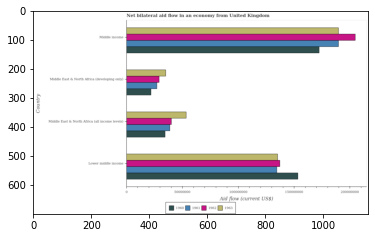

Number of QA =  30





,Country,1963,1962,1961,1960
0,Lower middle income,2.465276e+08,NaN,2.451750e+08,2.791317e+08
1,Middle income,3.455975e+08,3.719888e+08,3.465506e+08,3.139570e+08
2,Middle East & North Africa (all income levels),9.756204e+07,7.407626e+07,7.185165e+07,6.307346e+07
3,Middle East & North Africa (developing only),6.445297e+07,5.447742e+07,5.036570e+07,4.044767e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1960 in lower middle income and that in middle income ?
PREDICTED =  0.0
EXPECTED =  -19040000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1960 in middle income and the net bilateral aid flow in 1962 in middle east & north africa (developing only)?
PREDICTED =  273509351.5663892
EXPECTED =  143260000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the

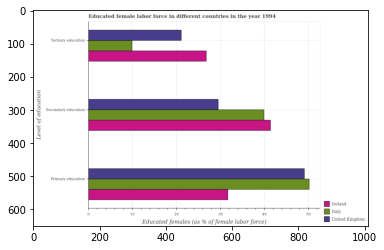

Number of QA =  28





,Level of education,United Kingdom,Italy,Ireland
0,Tertiary education,21.543460,10.179210,27.350933
1,Primary education,49.571179,50.518987,32.096107
2,Secondary education,29.936855,40.478248,41.852106


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received primary education in italy and that in ireland ?
PREDICTED =  18.42287976523211
EXPECTED =  18.500000000000004




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received primary education in italy and the percentage of female labor force who received secondary education in united kingdom ?
PREDICTED =  20.582131856246605
EXPECTED =  20.700000762939503




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received secondary e

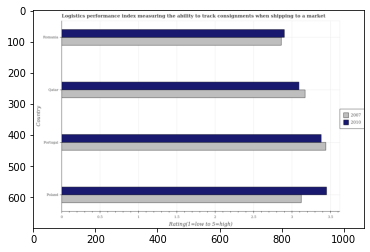

Number of QA =  28





,Country,2007,2010
0,Poland,3.139088,3.453666
1,Qatar,3.183441,3.108698
2,Portugal,3.433055,3.401609
3,Romania,2.880204,2.933464


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in 2007 in poland and that in romania ?
PREDICTED =  0.2588842325833163
EXPECTED =  0.26000000000000023




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in 2007 in portugal and the logistic performance index in 2010 in qatar?
PREDICTED =  0.24961320722389502
EXPECTED =  0.3500000000000001




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in 2007 and logistic performance index in 2010 in poland ?
PREDICTED =  9.182122236471791
EXPECTED =  -0.33000000000000007

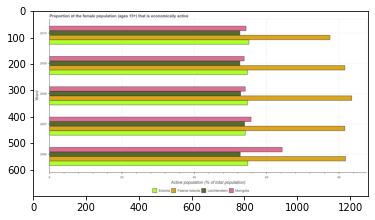

Number of QA =  30





,Years,Estonia,Faeroe Islands,Liechtenstein,Mongolia
0,2008,55.029524,83.751388,54.083776,54.385680
1,2009,55.090329,82.055991,52.959179,53.876213
2,2006,56.448207,84.146049,52.393063,64.262456
3,2010,55.135652,77.768747,53.363104,54.009656
4,2007,55.336208,80.340543,54.488072,56.041017


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female population that is economically active in estonia in 2008 and that in 2009 ?
PREDICTED =  -0.0608046146612935
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female population that is economically active in mongolia in 2010 and the proportion of the female population that is economically active in faeroe islands in 2009 ?
PREDICTED =  0.13344300797856334
EXPECTED =  -27.299999237060497




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Tr

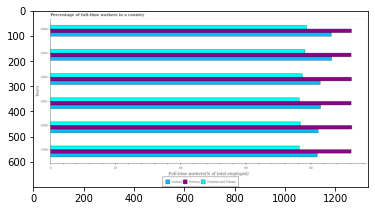

Number of QA =  29





,Years,Iceland,Norway,Trinidad and Tobago
0,2004,NaN,94.360856,NaN
1,2001,82.484450,94.625281,NaN
2,2003,NaN,94.071735,78.432464
3,2000,80.588326,94.673648,77.401529
4,2002,82.378509,95.885248,78.015282
5,1999,84.188072,94.556402,76.887727


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time workers in iceland in 2000 and that in 2004 ?
PREDICTED =  80.58832570356296
EXPECTED =  -4.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time workers in trinidad and tobago in 2001 and the percentage of full-time workers in iceland in 2003 ?
PREDICTED =  77.1446278415817
EXPECTED =  -9.900001525878892




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the percentage of full-time workers in norway and percentage of full-time workers in iceland ?
PREDICTED =  13.475408704912297


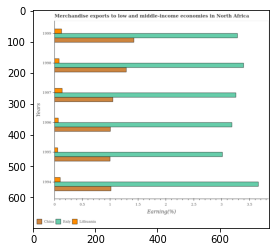

Number of QA =  29





,Years,Unnamed: 1,China,Lithuania
0,1995,3.056584,NaN,0.070329
1,1998,3.431443,NaN,0.095148
2,1999,3.305178,1.440244,0.138607
3,1994,3.691743,1.031121,0.115650
4,1997,3.295503,1.073658,0.147673
5,1996,3.198311,1.017392,0.079138


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in lithuania in 1996 and that in 1997 ?
PREDICTED =  -0.06853577185250569
EXPECTED =  -0.0701486004011273




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in china in 1994 and the percentage of amount earned from merchandise exports in italy in 1996 ?
PREDICTED =  -0.9688791119730982
EXPECTED =  -2.1707779820209296




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the percentage of amount earned from merchandise exports

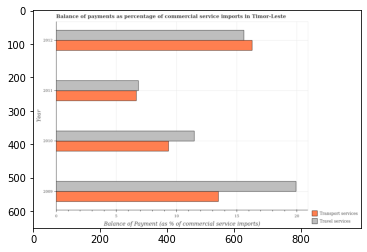

Number of QA =  28





,Year,Travel services,Transport services
0,2012,15.650637,16.282490
1,2009,19.872730,13.520090
2,2011,6.844719,6.768841
3,2010,11.471656,9.426099


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services in 2010 and that in 2011 ?
PREDICTED =  2.657257510649555
EXPECTED =  2.673




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of travel services in 2012 and the balance of payments of transport services in 2010 ?
PREDICTED =  4.178981415848167
EXPECTED =  6.26065482124711




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the balance of payments of travel services and balance of payments of transport services ?
PREDICTED =  0.07587807955285619
EXPECTED =  6.448





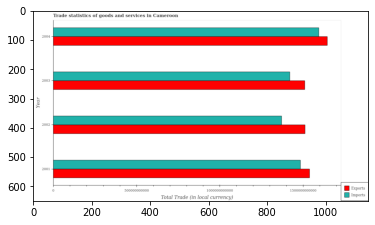

Number of QA =  28





,Year,Imports,Exports
0,2004,2.880260e+12,2.957822e+12
1,2001,2.675837e+12,2.769374e+12
2,2002,2.488272e+12,2.715489e+12
3,2003,2.555313e+12,2.719327e+12


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export of goods and services in 2001 and that in 2003 ?
PREDICTED =  238494663843.83203
EXPECTED =  28583314900




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export of goods and services in 2002 and the imports of goods and services in 2004 ?
PREDICTED =  121166616101.91357
EXPECTED =  -82563923900




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the imports of goods and services and export of goods and services ?
PREDICTED =  7719421955213.163
EXPECTED =  -54750491600




				 0 / 3 = 0.0


is_built_with_cuda: True
is_

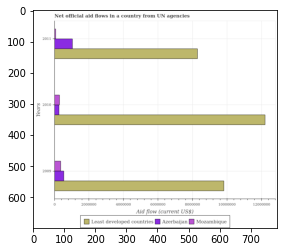

Number of QA =  29





,Years,Azerbaijan,Least developed countries,Mozambique
0,2011,1.084562e+06,8.379706e+06,NaN
1,2010,3.118687e+05,1.234554e+07,332649.923757
2,2009,5.835637e+05,9.956115e+06,401541.191104


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in mozambique in 2009 and that in 2011 ?
PREDICTED =  401541.1911041704
EXPECTED =  290000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in azerbaijan in 2010 and the net official aid flow in mozambique in 2011 ?
PREDICTED =  -772693.26359566
EXPECTED =  190000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the net official aid flow in mozambique and net official aid flow in azerbaijan ?
PREDICTED =  -1245803.2233033269
EXPECTED =  30000.0




				 0 / 3 = 0.0


is_built

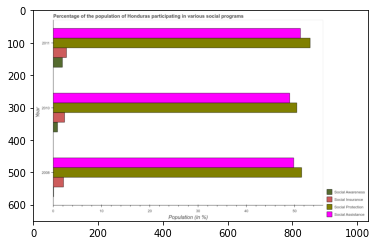

Number of QA =  30





,Year,Social Awareness,Social Protection,Social Insurance,Social Assistance
0,2008,NaN,51.638619,2.228449,49.987492
1,2010,1.003117,50.647962,2.441009,49.207746
2,2011,2.012785,53.394447,2.873425,51.628942


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the participation of population in social awareness programs in 2010 and that in 2011 ?
PREDICTED =  -1.0096672104083255
EXPECTED =  -1.01




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the participation of population in social protection programs and participation of population in social insurance programs ?
PREDICTED =  0.0
EXPECTED =  48.133




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the 

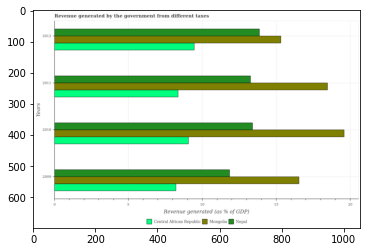

Number of QA =  29





,Years,Unnamed: 1,Central African Republic,Mongolia
0,2012,13.903167,9.447973,15.010975
1,2011,13.348866,NaN,18.477393
2,2009,11.831555,8.319565,16.597922
3,2010,13.441075,8.991041,19.632949


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the revenue generated by the government in nepal in 2009 and that in 2011 ?
PREDICTED =  -1.5173106699737833
EXPECTED =  -1.4157069895082




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the revenue generated by the government in mongolia in 2010 and the revenue generated by the government in central african republic in 2009 ?
PREDICTED =  3.0350274357353015
EXPECTED =  11.375836150903408




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the revenue generated by the government in mongolia and revenue generated by the government in 

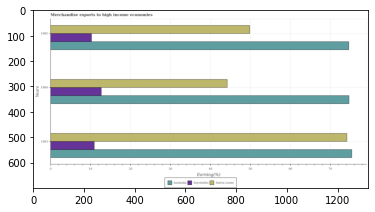

Number of QA =  29





,Years,Australia,Sierra Leone,Seychelles
0,1985,74.884348,50.624342,10.553031
1,1984,75.313222,44.657515,13.122371
2,1983,76.336117,75.163769,11.125909


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in seychelles in 1984 and that in 1985 ?
PREDICTED =  2.569339634963443
EXPECTED =  2.4420024420023996




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in sierra leone in 1985 and the percentage of amount earned from merchandise exports in australia in 1983 ?
PREDICTED =  -24.539426256384907
EXPECTED =  -25.51764074521199




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1985, what is the difference between the percentage of amount earned from merchandise 

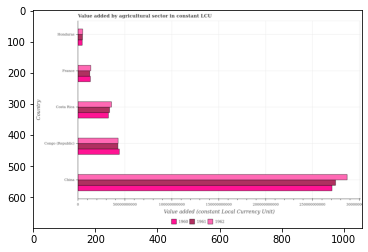

Number of QA =  29





,Country,1962,1961,1960
0,France,2.562593e+10,2.363625e+10,2.504801e+10
1,Costa Rica,6.582024e+10,6.242910e+10,5.942602e+10
2,China,5.172815e+11,5.002671e+11,4.911222e+11
3,Congo (Republic),7.828250e+10,7.766645e+10,8.036796e+10
4,Honduras,1.018594e+10,1.000259e+10,9.103508e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector in 1962 in france and that in honduras ?
PREDICTED =  15439995447.049883
EXPECTED =  8625058000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector in 1962 in honduras and the value added by agricultural sector in 1960 in france?
PREDICTED =  -15439995447.049883
EXPECTED =  -8202339000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector in 1962 and value added by agricultural sector in 1960 in honduras ?
PREDICTED =  508177958927.2613


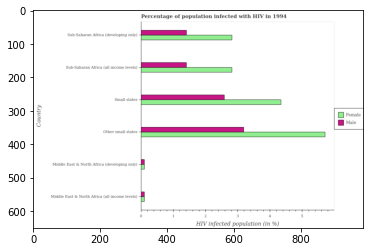

Number of QA =  28





,Country,Female,Male
0,Other small states,5.771872,NaN
1,Small states,4.313135,2.612050
2,Sub-Saharan Africa (all income levels),2.840872,1.437200
3,Sub-Saharan Africa (developing only),2.851986,1.425904
4,Middle East & North Africa (developing only),0.128481,0.131050
5,Middle East & North Africa (all income levels),0.126519,0.123153


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females who are infected with hiv in middle east & north africa (developing only) and that in sub-saharan africa (developing only) ?
PREDICTED =  -2.723504688704815
EXPECTED =  -2.717




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of males who are infected with hiv in sub-saharan africa (developing only) and the percentage of females who are infected with hiv in middle east & north africa (all income levels) ?
PREDICTED =  -0.011296680593660069
EXPECTED =  1.3053066223563818




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333



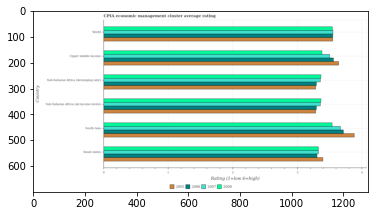

Number of QA =  30





,Country,2007,2005,2008,2006
0,Upper middle income,3.507901,3.696675,3.403654,3.571974
1,Small states,NaN,3.402801,3.367724,3.316157
2,Sub-Saharan Africa (all income levels),NaN,3.299951,3.377686,3.309075
3,South Asia,NaN,3.981388,3.530507,3.716055
4,Sub-Saharan Africa (developing only),3.361304,NaN,3.384990,3.296031
5,World,NaN,3.567839,3.572651,3.539586


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2006 in sub-saharan africa (developing only) and that in world ?
PREDICTED =  -1.309075462398824
EXPECTED =  -0.2528413028413099




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2005 in world and the cpia rating in 2006 in upper middle income?
PREDICTED =  -0.12883541464833925
EXPECTED =  -0.012280701754380008




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2007 and cpia rating in 2006 in small states ?
PREDICTED =  -1.31615707711296
EXPECTED =  0.021666666666670054




				 0 / 3 = 0.0


is

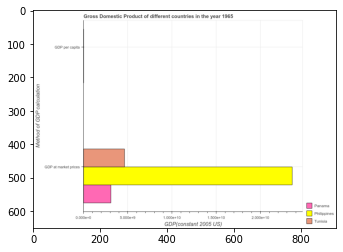

Number of QA =  23





,Method of GDP calculation,Panama,Philippines,Tunisia
0,GDP per capita,NaN,NaN,NaN
1,GDP at market prices,3.193337,23.706066,4.766831


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the gdp at market prices in philippines to that in tunisia ?
PREDICTED =  4.9731291756573075
EXPECTED =  5.096770566386263




				 1 / 4 = 0.25


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  GDP(constant 2005 US)
EXPECTED =  5000000000.0




				 1 / 5 = 0.2


> what is the title of the graph ?
PREDICTED =  Gross Domestic Product of d

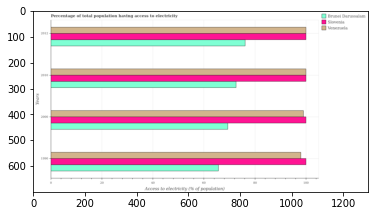

Number of QA =  29





,Years,Slovenia,Brunei Darussalam,Venezuela
0,2010,101.098945,72.914221,100.159044
1,2000,100.519362,70.112524,99.111326
2,2012,101.861794,NaN,100.439693
3,1990,100.365901,66.453826,98.879009


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population that have access to electricity in venezuela in 1990 and that in 2012 ?
PREDICTED =  -1.5606839864779687
EXPECTED =  -2




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population that have access to electricity in brunei darussalam in 2000 and the percentage of population that have access to electricity in venezuela in 2012 ?
PREDICTED =  -2.8016971765674583
EXPECTED =  -30.637259999999998




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the percentage of population that have access 

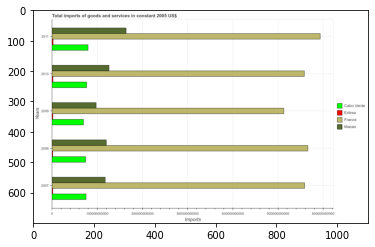

Number of QA =  30





,Years,Cabo Verde,Macao,France,Eritrea
0,2010,7.791254e+10,1.267351e+11,5.588645e+11,3.485426e+09
1,2009,7.107796e+10,9.962796e+10,5.149039e+11,3.210386e+09
2,2007,7.686259e+10,1.187686e+11,5.626857e+11,3.297524e+09
3,2008,7.588560e+10,1.203539e+11,5.662879e+11,3.023180e+09
4,2011,8.111873e+10,1.659594e+11,5.932137e+11,3.782534e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports of goods and services in cabo verde in 2007 and that in 2008 ?
PREDICTED =  -152748189006.4397
EXPECTED =  897685600.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports of goods and services in cabo verde in 2010 and the total imports of goods and services in france in 2008 ?
PREDICTED =  -1125152388848.4731
EXPECTED =  -489424312000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the total imports of goods and services in eritrea and total imports of goods and services in france ?
PREDICTED =

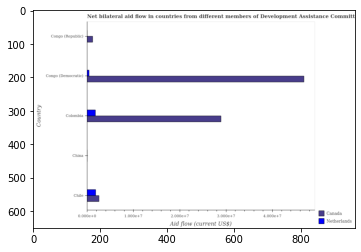

Number of QA =  25





,Country,Netherlands,Canada
0,China,NaN,NaN
1,Congo (Democratic),0.055824,4.700396
2,Congo (Republic),NaN,0.131774
3,Colombia,0.196247,2.927752
4,Chile,0.201743,0.267986


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by netherlands in colombia and that in congo (democratic) ?
PREDICTED =  0.14042302040771243
EXPECTED =  1370000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by canada in china and the amount of aid given by netherlands in congo (republic) ?
PREDICTED =  0.0
EXPECTED =  0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by canada and amount of aid given by netherlands in congo (democratic) ?
PREDICTED =  6.027908254362774
EXPECTED =  46410000




				 1 / 3 = 0.3333


is_bu

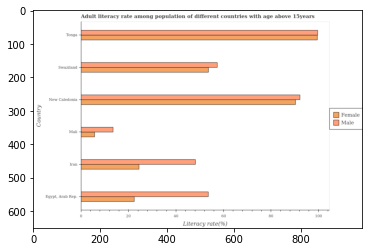

Number of QA =  28





,Country,Female,Male
0,Mali,5.897003,13.857569
1,Swaziland,54.410057,58.426650
2,Iran,24.735732,48.860991
3,Tonga,100.660976,100.401548
4,New Caledonia,91.171297,92.696251
5,"Egypt, Arab Rep.",23.072802,54.210412


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female adult literacy rate in mali and that in new caledonia ?
PREDICTED =  -85.27429377518257
EXPECTED =  -84.575




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female adult literacy rate in mali and the male adult literacy rate in egypt, arab rep. ?
PREDICTED =  -17.17579936007042
EXPECTED =  -47.87992




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female adult literacy rate and male adult literacy rate in mali ?
PREDICTED =  94.76397355599947
EXPECTED =  -7.778




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: 

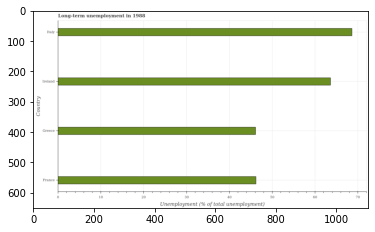

Number of QA =  22





,Country,Unemployment (% of total unemployment)
0,Greece,46.016698
1,Italy,69.032893
2,France,46.633248
3,Ireland,63.991553


> what is the title of the graph ?
PREDICTED =  Long-term unemployment in 1988
EXPECTED =  Long-term unemployment in 1988




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Unemployment (% of total unemployment)
EXPECTED =  Unemployment (% of total unemployment)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the long-term unemployment in france and italy ?
PREDICTED =  -22.399645378278734
EXPECTED =  -22.4




				 4 / 4 = 1.0


> what is the median long-term unemployment ?
PREDICTED =  None
EXPECTED =  54.8999996185303




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the long-te

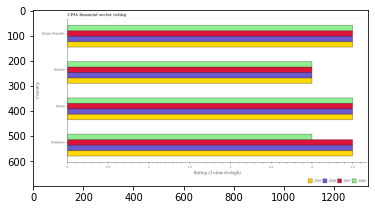

Number of QA =  30





,Country,2007,2005,2006,2008
0,Kiribati,2.987769,2.994565,3.005695,3.003180
1,Honduras,3.486240,3.492887,3.503648,3.030770
2,Kenya,3.484605,3.496354,3.487350,3.458852
3,Kyrgyz Republic,3.454501,3.506269,3.495319,3.473053


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2007 in honduras and that in kenya ?
PREDICTED =  0.001634303450204655
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2007 in kenya and the cpia rating in 2008 in kiribati?
PREDICTED =  0.49683634944098287
EXPECTED =  0.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cpia rating in 2008 in kenya to that in kyrgyz republic ?
PREDICTED =  0.995

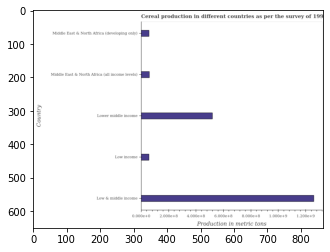

Number of QA =  22





,Country,Production in metric tons
0,Lower middle income,5.264344
1,Low & middle income,12.679854
2,Low income,0.627309
3,Middle East & North Africa (developing only),0.622747
4,Middle East & North Africa (all income levels),0.661689


> what is the title of the graph ?
PREDICTED =  Cereal production in different countries as per the survey of 199.
EXPECTED =  Cereal production in different countries as per the survey of 1998




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Production in metric tons
EXPECTED =  Production in metric tons




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cereal production in low & middle income and lower middle income ?
PREDICTED =  0.0
EXPECTED =  739419005.8




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median cereal production ?
PREDICTED =  0.661688873094941
EXPECTED =  59754905

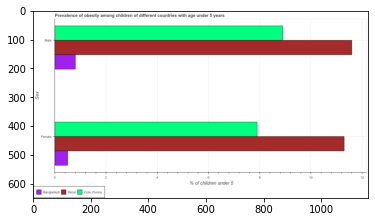

Number of QA =  23





,Sex,Benin,Cote d'Ivoire,Bangladesh
0,Male,11.371514,8.910435,0.825454
1,Female,11.294684,7.907436,0.525325


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of obese female children in bangladesh and that in benin ?
PREDICTED =  -10.769358550173404
EXPECTED =  -10.8000001907349




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of obese male children in cote d'ivoire and the percentage of obese female children in bangladesh ?
PREDICTED =  8.084981502818557
EXPECTED =  8.39999961853027




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of obese male children and percentage of obese female children in benin ?
PREDICTED =  -11.371513848237017
EXPECTED =  0.30000019

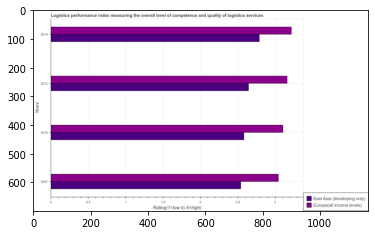

Number of QA =  28





,Years,East Asia (developing only),Europe(all income levels)
0,2007,2.549384,3.043397
1,2012,2.648040,3.161700
2,2010,2.602367,3.104095
3,2014,2.805828,3.203710


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in europe(all income levels) in 2007 and that in 2014 ?
PREDICTED =  -0.16031305764557224
EXPECTED =  -0.17351186266924




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in east asia (developing only) in 2014 and the logistic performance index in europe(all income levels) in 2007 ?
PREDICTED =  -0.23756873313761595
EXPECTED =  -0.2558228951049002




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the logistic performance index in europe(all income levels) and logistic perf

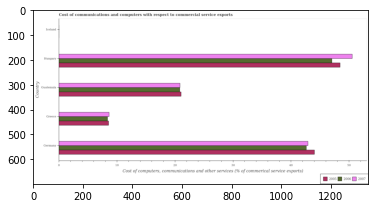

Number of QA =  26





,Country,2007,2005,2006
0,Greece,8.803732,8.618949,8.535482
1,Iceland,NaN,NaN,NaN
2,Germany,43.137570,44.293842,43.009398
3,Guatemala,NaN,21.105284,20.946675
4,Hungary,50.529193,47.936825,46.923511


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers in 2006 in germany and that in greece ?
PREDICTED =  -42.92593036612995
EXPECTED =  34.27188325293715




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers in 2006 in greece and the cost of communications and computers in 2005 in iceland?
PREDICTED =  0.08346718042684032
EXPECTED =  8.36487468641306




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers in 2005 and cost of communications and computers in 2006 in hungary ?
PREDICTED =  -39

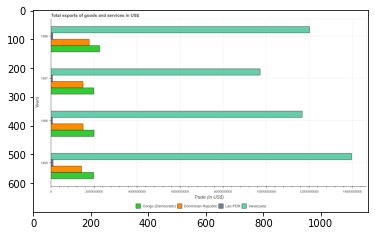

Number of QA =  30





,Years,Dominican Republic,Congo (Democratic,Venezuela,Lao PDR
0,1986,1.529828e+09,2.005961e+09,1.168646e+10,8.434414e+07
1,1985,1.443681e+09,1.981692e+09,1.399469e+10,1.189354e+08
2,1988,1.795520e+09,2.250676e+09,1.199051e+10,1.010653e+08
3,1987,1.504950e+09,2.004555e+09,9.718713e+09,8.371990e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total exports of goods and services in dominican republic in 1986 and that in 1988 ?
PREDICTED =  -3325347528.836495
EXPECTED =  -283303984.55737996




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total exports of goods and services in congo (democratic) in 1985 and the total exports of goods and services in venezuela in 1986 ?
PREDICTED =  -3987652231.1345634
EXPECTED =  -9695917705.21179




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1988, what is the difference between the total exports of goods and services in congo (democratic) and total exports of go

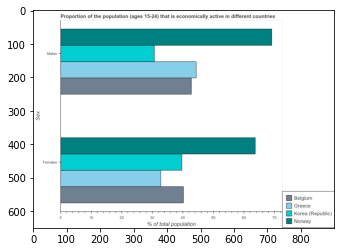

Number of QA =  23





,Sex,Korea (Republic),Belgium,Greece,Norway
0,Males,30.835956,43.008295,44.569473,69.381314
1,Females,39.980765,40.560374,33.095801,63.456980


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active female population in korea (republic) and that in belgium ?
PREDICTED =  -0.5796091883033654
EXPECTED =  -0.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active female population in korea (republic) and the percentage of economically active male population in greece ?
PREDICTED =  6.884964238102938
EXPECTED =  -4.700000762939396




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active male population and percentage of economically active female p

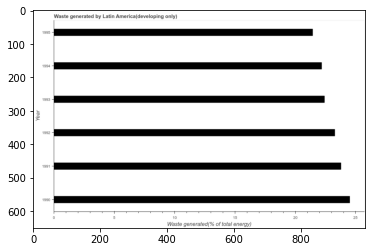

Number of QA =  23





,Year,Waste generated(% of total energy)
0,1995,21.563691
1,1994,22.222724
2,1991,23.678163
3,1992,23.413755
4,1990,24.579116
5,1993,22.418874


> what is the title of the graph ?
PREDICTED =  Waste generated by Latin America(developing only)
EXPECTED =  Waste generated by Latin America(developing only)




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Waste generated(% of total energy)
EXPECTED =  Waste generated(% of total energy)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of waste generated in 1990 and 1991 ?
PREDICTED =  0.9009532517001304
EXPECTED =  0.728




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median amount of waste generated ?
PREDICTED =  22.916314805047477
EXPECTED =  22.846293378692103




				 4 / 5 = 

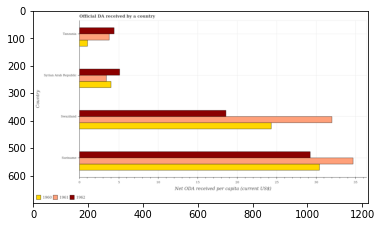

Number of QA =  29





,Country,1962,1961,1960
0,Suriname,29.434328,34.665210,30.456730
1,Swaziland,18.534265,31.850780,24.251092
2,Tanzania,4.422611,3.811268,1.077711
3,Syrian Arab Republic,5.069670,3.481965,3.982688


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the oda received in in 1962 in suriname to that in tanzania ?
PREDICTED =  6.655419500157814
EXPECTED =  6.647487880222107




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 5 = 0.2


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting 

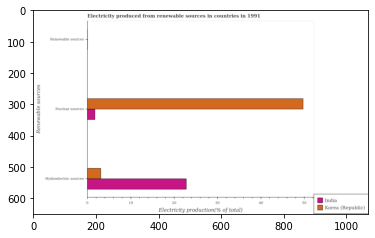

Number of QA =  28





,Renewable sources,Korea (Republic),India
0,Renewable sources,NaN,NaN
1,Hydroelectric sources,3.288206,22.795129
2,Nuclear sources,50.007179,1.902188


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by nuclear sources in korea (republic) and that in india ?
PREDICTED =  48.10499043611502
EXPECTED =  47.98995602670784




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by hydroelectric sources in india and the percentage of electricity produced by renewable sources in korea (republic) ?
PREDICTED =  19.506922853893848
EXPECTED =  22.79430334494192




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by nuclear sources and percentage of 

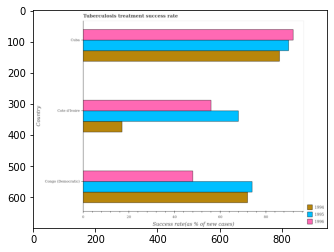

Number of QA =  29





,Country,1996,1994,1995
0,Cuba,92.699323,86.942706,90.641855
1,Cote d'Ivoire,56.681291,17.580359,68.454669
2,Congo (Democratic),48.937634,72.523343,74.361971


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the tuberculosis treatment success rate in 1996 in cote d'ivoire and that in cuba ?
PREDICTED =  -36.018032331071026
EXPECTED =  -36.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the tuberculosis treatment success rate in 1995 in cuba and the tuberculosis treatment success rate in 1996 in congo (democratic)?
PREDICTED =  16.279883380710245
EXPECTED =  42.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the tuberculosis treatment success rate in 1994 and tuberculosis treatment success rate in 1995 in cote d'ivoire ?
PREDICTED =  -9.4392003748

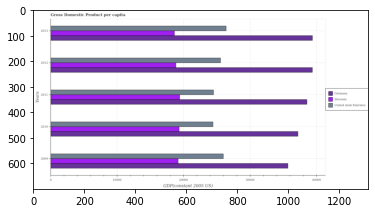

Number of QA =  29





,Years,Slovenia,Germany,United Arab Emirates
0,2013,18745.214525,39321.666941,26753.102694
1,2011,19469.164399,37944.736030,24669.558186
2,2012,18830.034152,39101.846022,25610.436815
3,2010,19257.647387,36964.882070,24475.466275
4,2009,19226.358307,35453.244186,25337.520669


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp per capita in slovenia in 2009 and that in 2013 ?
PREDICTED =  481.1437821731706
EXPECTED =  554.0236820790014




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp per capita in united arab emirates in 2011 and the gdp per capita in slovenia in 2012 ?
PREDICTED =  -940.878628789218
EXPECTED =  5655.010813996301




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the gdp per capita in germany and gdp per capita in united arab emirates ?
PREDICTED =  -87524.41769832306
EXPECTED =  14052.717933596487




				 0 / 3 = 0.0


i

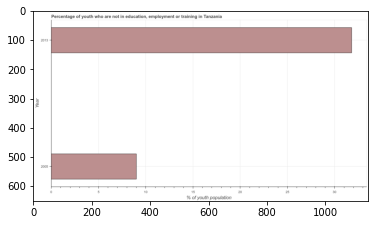

Number of QA =  19





,Year,% of youth population
0,2013,31.612102
1,2005,9.112620


> what is the title of the graph ?
PREDICTED =  Percentage of youth who are not in education, employment or training in Tanzania
EXPECTED =  Percentage of youth who are not in education, employment or training in Tanzania




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  % of youth population
EXPECTED =  % of youth population




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed youth population in 2005 and 2013 ?
PREDICTED =  -22.499482049852144
EXPECTED =  -22.79




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed youth population ?
PREDICTED =  2009.0
EXPECTED =  20.4049

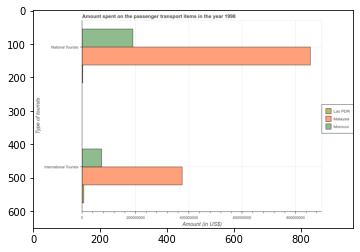

Number of QA =  23





,Type of tourists,Morocco,Malaysia,Lao PDR
0,National Tourists,1.920633e+08,8.517450e+08,NaN
1,International Tourists,7.496349e+07,3.768324e+08,8.786762e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on transport items of national tourists in morocco and that in malaysia ?
PREDICTED =  -659681665.1365017
EXPECTED =  -666000000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on transport items of national tourists in malaysia and the amount spent on transport items of international tourists in morocco ?
PREDICTED =  584718171.0901185
EXPECTED =  783000000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on transport items of national tourists and amount spent on transport items of international

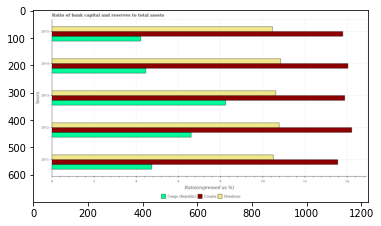

Number of QA =  29





,Years,Congo (Republic),Croatia,Honduras
0,2014,4.517113,14.324483,10.881367
1,2013,8.298618,14.186618,10.671698
2,2011,4.767127,13.766226,10.571709
3,2015,NaN,14.013710,10.513895
4,2012,6.671246,14.339399,10.820824


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of bank capital and reserves to total assets in croatia in 2014 ?
PREDICTED =  0.3490527315164908
EXPECTED =  14.0438924056915




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum ratio of bank capital and reserves to total assets in croatia ?
PREDICTED =  1007.0
EXPECTED =  14.2241789244675




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum ratio of bank capital and reserves to total assets in honduras ?
PREDICTED =  0.998014888337469
EXPECTED =  10.462931074651




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training o

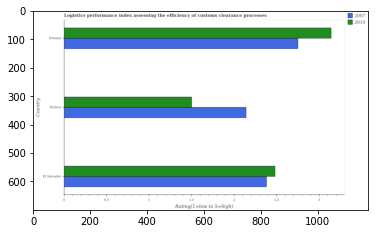

Number of QA =  28





,Country,2007,2010
0,El Salvador,2.405456,2.473865
1,Estonia,2.758658,3.150030
2,Eritrea,2.149036,1.512592


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in 2010 in el salvador and that in estonia ?
PREDICTED =  -0.676164725388229
EXPECTED =  -0.6600000000000001




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in 2010 in estonia and the logistic performance index in 2007 in el salvador?
PREDICTED =  0.676164725388229
EXPECTED =  0.7600000000000002




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in 2007 and logistic performance index in 2010 in el salvador ?
PREDICTED =  4.8392844828304735
EXPECTED =  -0.100

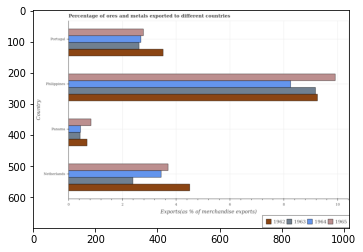

Number of QA =  30





,Country,1965,1964,1962,1963
0,Panama,0.842036,0.457031,0.702276,0.446368
1,Netherlands,3.730321,3.472331,4.545965,2.378765
2,Portugal,2.803319,2.712630,3.530427,2.620719
3,Philippines,9.939643,8.324978,9.326965,9.169757


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in 1964 in panama and that in philippines ?
PREDICTED =  -7.867947315636275
EXPECTED =  -7.809580021418504




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in 1965 in panama and the percentage of exports to different countries in 1962 in philippines?
PREDICTED =  -9.097607795259714
EXPECTED =  -8.419325458175841




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in 1962 and percentage of exports to differe

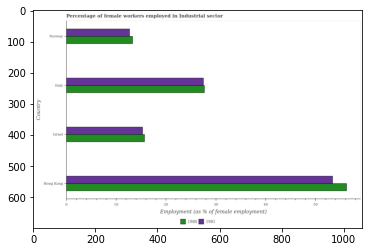

Number of QA =  28





,Country,1980,1981
0,Israel,15.915108,15.539836
1,Italy,27.908789,27.747475
2,Hong Kong,56.630698,54.199072
3,Norway,13.577289,12.918244


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females employed in industrial sector in 1980 in israel and that in norway ?
PREDICTED =  2.3378186480923606
EXPECTED =  2.399999618530199




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females employed in industrial sector in 1980 in italy and the percentage of females employed in industrial sector in 1981 in israel?
PREDICTED =  11.993680947322455
EXPECTED =  12.400000572204599




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females employed in industrial sector in 1981 and percentage of fe

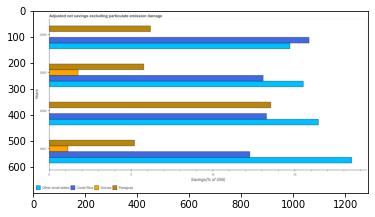

Number of QA =  27





,Years,Guinea,Costa Rica,Other small states,Paraguay
0,2002,NaN,13.416953,16.094310,13.521197
1,2004,NaN,15.878510,14.740814,6.221340
2,2001,1.152725,12.332629,18.549321,5.224527
3,2003,1.781195,12.951974,15.612726,5.780491


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adjusted net savings in paraguay in 2001 and that in 2003 ?
PREDICTED =  -0.5559635234196163
EXPECTED =  -0.5691330827067098




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adjusted net savings in guinea in 2003 and the adjusted net savings in costa rica in 2002 ?
PREDICTED =  -1.1527251783865011
EXPECTED =  -11.51552461174119




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the adjusted net savings in costa rica and adjusted net savings in guinea ?
PREDICTED =  52.58006646633049
EXPECTED =  11.311142429904091




				 1 

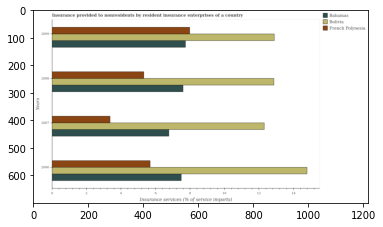

Number of QA =  29





,Years,Bolivia,French Polynesia,Bahamas
0,2008,12.758951,5.373299,7.654271
1,2006,14.919348,5.775803,7.538373
2,2007,12.394512,3.404503,6.869132
3,2009,NaN,8.050885,7.796302


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the insurance provided to nonresidents in bolivia in 2006 and that in 2008 ?
PREDICTED =  2.1603967306566094
EXPECTED =  1.9208157480889003




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the insurance provided to nonresidents in french polynesia in 2006 to that in 2009 ?
PREDICTED =  104.53132182525273
EXPECTED =  0.7127458769227336




				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_avai

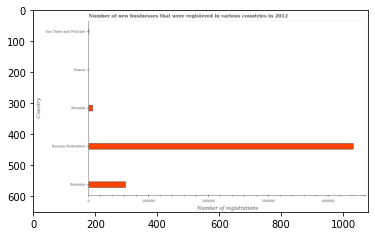

Number of QA =  22





,Country,Number of registrations
0,Romania,62736.108692
1,Samoa,NaN
2,Russian Federation,444269.235630
3,Sao Tome and Principe,NaN
4,Rwanda,7573.292809


> what is the title of the graph ?
PREDICTED =  Number of new businesses that were registered in various countries in 2012
EXPECTED =  Number of new businesses that were registered in various countries in 2012




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Number of registrations
EXPECTED =  Number of registrations




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the number of new business registrations in russian federation ?
PREDICTED =  148089.74521010774
EXPECTED =  442165




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum number of new business registrations ?
PREDICTED =  1.0
E

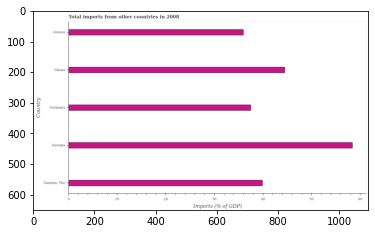

Number of QA =  22





,Country,Imports (% of GDP)
0,Germany,37.825391
1,Ghana,44.892179
2,Greece,36.438436
3,"Gambia, The",40.362189
4,Georgia,58.673736


> what is the title of the graph ?
PREDICTED =  Total imports from other countries in 2008
EXPECTED =  Total imports from other countries in 2008




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Imports (% of GDP)
EXPECTED =  Imports (% of GDP)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports in gambia, the and greece ?
PREDICTED =  -36.43843569826481
EXPECTED =  3.912




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total imports ?
PREDICTED =  40.3621885273222
EXPECTED =  39.8797787073686




				 4 / 5 = 0.8


is_built_with_cuda: True
is_gpu_available: False
GPUs

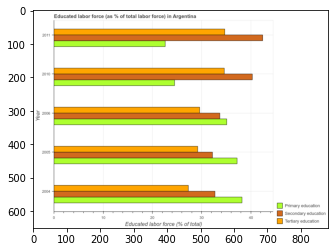

Number of QA =  29





,Year,Secondary education,Tertiary education,Primary education
0,2010,NaN,34.942036,24.560217
1,2004,32.977812,27.329936,NaN
2,2005,NaN,29.420070,37.478211
3,2011,42.896403,NaN,NaN
4,2006,33.770882,29.822860,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received primary education in 2004 and that in 2011 ?
PREDICTED =  12.917994296058964
EXPECTED =  15.6




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the percentage of labor force who received tertiary education and percentage of labor force who received secondary education ?
PREDICTED =  -31.806658094824883
EXPECTED =  -3.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> w

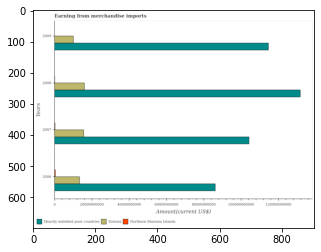

Number of QA =  29





,Years,Estonia,Heavily indebted poor countries,Northern Mariana Islands
0,2009,1.054410e+10,1.155351e+11,NaN
1,2007,1.594346e+10,1.048484e+11,NaN
2,2008,1.642080e+10,1.323423e+11,NaN
3,2006,1.397440e+10,8.681319e+10,8.507656e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise imports in northern mariana islands in 2006 and that in 2009 ?
PREDICTED =  -114684373735.18506
EXPECTED =  419000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise imports in estonia in 2006 and the amount earned from merchandise imports in heavily indebted poor countries in 2009 ?
PREDICTED =  3430295665.1853466
EXPECTED =  -101196563885.22519




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the amount earned from merchandise imports in estonia and amount 

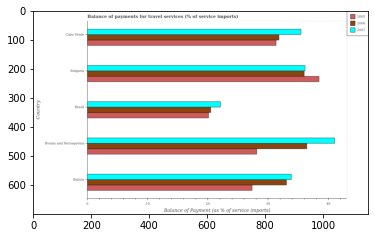

Number of QA =  29





,Country,2007,2005,2006
0,Bulgaria,36.144812,38.423391,36.106430
1,Bolivia,34.085643,27.665728,33.385641
2,Cabo Verde,35.599797,31.515057,31.973726
3,Brazil,22.260419,20.214202,20.532269
4,Bosnia and Herzegovina,41.392013,28.230162,36.479374


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for travel services in 2006 in bosnia and herzegovina and that in brazil ?
PREDICTED =  -20.532268681314967
EXPECTED =  15.94782831445649




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for travel services in 2005 in bolivia and the balance of payments for travel services in 2006 in bulgaria?
PREDICTED =  -10.75766275161422
EXPECTED =  -8.6559069218304




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for travel services in 2007 and balance of payments for travel services in 20

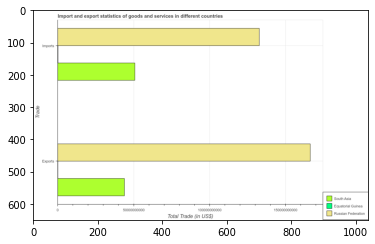

Number of QA =  23





,Trade,South Asia,Russian Federation,Equatorial Guinea
0,Exports,7.977386e+10,2.994582e+11,NaN
1,Imports,9.185557e+10,2.407198e+11,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export of goods and services in south asia and that in russian federation ?
PREDICTED =  1.0
EXPECTED =  -122325063797.51208




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the imports of goods and services in south asia and the export of goods and services in russian federation ?
PREDICTED =  1.0
EXPECTED =  -115442795828.13219




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the imports of 

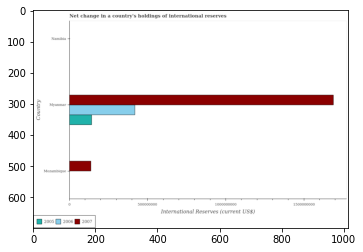

Number of QA =  23





,Country,2007,2005,2006
0,Mozambique,2.564793e+08,NaN,NaN
1,Namibia,NaN,NaN,NaN
2,Myanmar,3.061571e+09,2.656498e+08,7.675159e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the international reserves in 2007 in mozambique and that in myanmar ?
PREDICTED =  -2805091922.1718264
EXPECTED =  -1551216534.7




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the international reserves in 2007 in namibia and the international reserves in 2005 in myanmar?
PREDICTED =  -3061571188.2966337
EXPECTED =  -142101965.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the international reserves in 2005 and international reserves in 2007 in myanmar ?
PREDICTED =  -2795921402.66557
EXPECTED =  -1546227772.0




				 0 / 3 = 0.0


is_built

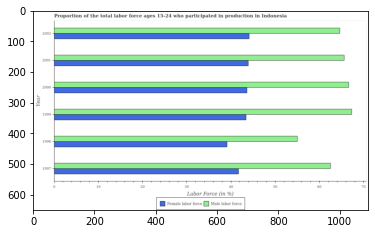

Number of QA =  28





,Year,Female labor force,Male labor force
0,2002,44.700677,65.029082
1,1997,42.083484,63.582934
2,2000,43.966414,67.702590
3,1999,43.827011,68.013712
4,1998,39.283887,55.660609
5,2001,44.115031,67.675778


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force in 1998 and that in 2001 ?
PREDICTED =  -4.831143862564481
EXPECTED =  -4.8




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force in 2000 and the percentage of male labour force in 2001 ?
PREDICTED =  -0.14861719039419086
EXPECTED =  -21.999999999999893




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the percentage of female labor force and percentage of male labour force ?
PREDICTED =  0.8736667895682189
EXPECTED =  -20.5




				 1 / 3 = 0.3333


is_built_with

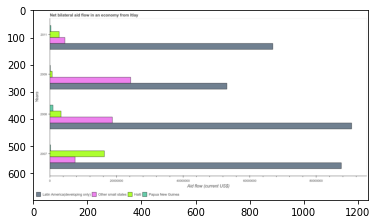

Number of QA =  30





,Years,Other small states,Latin America(developing only},Papua New Guinea,Haiti
0,2011,4.669416e+06,6.705347e+07,NaN,2.914774e+06
1,2009,2.437199e+07,5.373520e+07,NaN,8.182705e+05
2,2008,1.902618e+07,9.126606e+07,1.084290e+06,3.532729e+06
3,2007,7.740073e+06,8.737361e+07,NaN,1.651796e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in papua new guinea in 2008 and that in 2009 ?
PREDICTED =  0.0
EXPECTED =  810000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in latin america(developing only) in 2009 and the net bilateral aid flow in papua new guinea in 2011 ?
PREDICTED =  -13318270.44923225
EXPECTED =  52870000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the net bilateral aid flow in papua new guinea and net bilateral aid flow in other small states ?
PREDICTED =  -54723372.20993397
EXPECTED = 

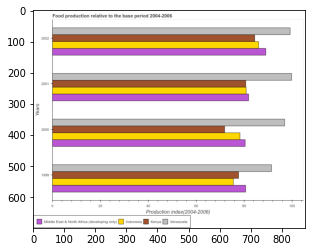

Number of QA =  30





,Years,Middle East & North Africa (developing only),Indonesia,Venezuela,Kenya
0,2002,89.100280,86.002990,99.934573,84.570874
1,1999,NaN,76.013937,92.182906,NaN
2,2001,82.209772,81.296431,100.381263,80.932631
3,2000,81.059926,78.775902,97.624063,72.509268


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the food production index in venezuela in 2000 and that in 2002 ?
PREDICTED =  -2.3105099461915586
EXPECTED =  -2.280000000000001




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the food production index in indonesia in 2001 and the food production index in kenya in 2002 ?
PREDICTED =  -4.706559508058746
EXPECTED =  -3.549999999999997




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the food production index in kenya and food production index in middle east & north africa (developing only) ?
PREDICTED =  235.01277258774508
EXPECT

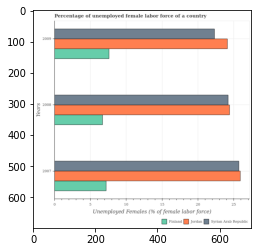

Number of QA =  29





,Years,Finland,Syrian Arab Republic,Jordan
0,2009,7.638796,22.274354,23.954806
1,2007,7.230783,25.585787,25.751444
2,2008,6.692463,24.309793,24.276152


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed female labor force in jordan in 2007 and that in 2009 ?
PREDICTED =  1.7966378486517662
EXPECTED =  1.799999237060618




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed female labor force in jordan in 2008 and the percentage of unemployed female labor force in finland in 2007 ?
PREDICTED =  -1.4752914621361448
EXPECTED =  17.19999980926517




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the percentage of unemployed female labor force in jordan and percentage of unemployed fe

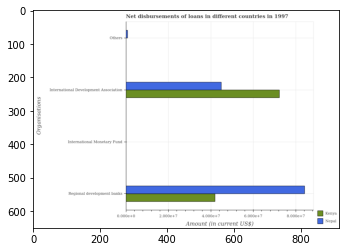

Number of QA =  25





,Organisations,Kenya,Nepal
0,Others,NaN,0.100470
1,International Monetary Fund,NaN,NaN
2,Regional development banks,4.223779,8.516247
3,International Development Association,7.293525,4.526588


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loan disimbursed by international development association in kenya and that in nepal ?
PREDICTED =  2.7669371612583493
EXPECTED =  27378000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loan disimbursed by other organisations in nepal and the amount of loan disimbursed by international monetary fund in kenya ?
PREDICTED =  0.10047042700273906
EXPECTED =  761000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loan disimbursed by regional development banks and amount of loan disimbursed by international d

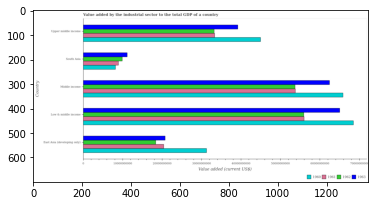

Number of QA =  30





,Country,1963,1962,1961,1960
0,South Asia,1.117181e+10,1.007658e+10,9.109951e+09,8.355620e+09
1,Low & middle income,6.522991e+10,5.595812e+10,5.678493e+10,6.992657e+10
2,Upper middle income,3.976039e+10,3.351332e+10,NaN,4.604309e+10
3,East Asia (developing only),2.113940e+10,1.870907e+10,2.049995e+10,3.107636e+10
4,Middle income,6.365002e+10,5.442401e+10,5.425316e+10,6.675880e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector to the total gdp in 1963 in middle income and that in south asia ?
PREDICTED =  52478208382.80044
EXPECTED =  51274717043.7079




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector to the total gdp in 1960 in middle income and the value added by the industrial sector to the total gdp in 1961 in upper middle income?
PREDICTED =  10357852838.241982
EXPECTED =  32525845720.267998




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector to the 

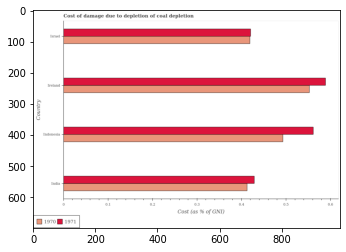

Number of QA =  28





,Country,1971,1970
0,India,0.431248,0.413347
1,Ireland,0.590215,0.558294
2,Israel,0.423852,0.422948
3,Indonesia,0.569033,0.496092


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to coal depletion in 1970 in india and that in ireland ?
PREDICTED =  -0.14494669253817422
EXPECTED =  -0.13999806051533398




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to coal depletion in 1971 in indonesia and the cost of damage caused due to coal depletion in 1970 in israel?
PREDICTED =  0.14518112166852087
EXPECTED =  0.14243751143919697




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to coal depletion in 1971 and cost of damage caused due to coal dep

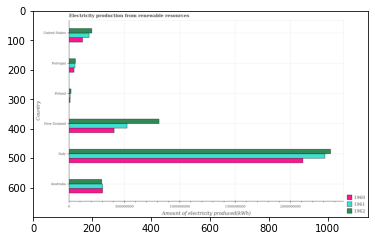

Number of QA =  29





,Country,1962,1961,1960
0,Poland,3.962368e+07,NaN,NaN
1,New Zealand,1.462332e+09,9.451504e+08,7.313375e+08
2,United States,3.764246e+08,3.338221e+08,2.264349e+08
3,Australia,5.371748e+08,5.527134e+08,5.552237e+08
4,Portugal,1.107965e+08,1.036792e+08,8.967323e+07
5,Italy,4.289552e+09,4.157569e+09,3.799347e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of electricity produced in 1960 in italy and that in united states ?
PREDICTED =  3572912100.545129
EXPECTED =  1990000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of electricity produced in 1961 in united states and the amount of electricity produced in 1962 in portugal?
PREDICTED =  230142895.6920237
EXPECTED =  123000000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of electricity produced in 1962 and amount of electricity produced in 1961 in poland ?
PREDICTED =  4289551967.397665
EXPECTED =  7000

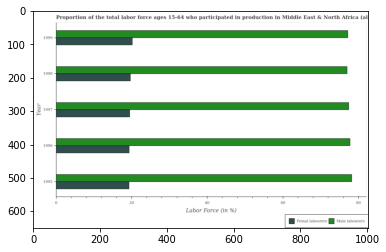

Number of QA =  28





,Year,Femal labourers,Male labourers
0,1999,20.367710,77.222123
1,1997,19.839096,77.975662
2,1998,19.901173,77.121667
3,1995,19.705110,78.398611
4,1996,19.593213,79.241586


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labour force in 1996 and that in 1997 ?
PREDICTED =  1.2659241829991004
EXPECTED =  0.341




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labour force in 1995 and the percentage of female labor force in 1996 ?
PREDICTED =  -0.8429751694272056
EXPECTED =  58.88695129205551




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the percentage of female labor force and percentage of male labour force ?
PREDICTED =  -58.58841330825156
EXPECTED =  -57.944




				 1 / 3 = 0.3333


is_built_with_

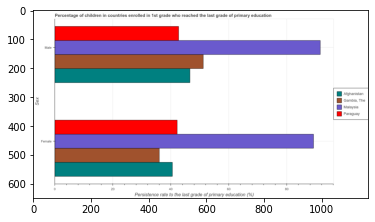

Number of QA =  23





,Sex,"Gambia, The",Malaysia,Afghanistan,Paraguay
0,Male,51.577549,92.285545,47.000416,43.385965
1,Female,36.592083,90.114126,41.367468,42.373953


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the persistence rate of female students in malaysia and that in paraguay ?
PREDICTED =  47.740172548993414
EXPECTED =  47.02962




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the persistence rate of male students in malaysia and the persistence rate of female students in paraguay ?
PREDICTED =  49.91159167821887
EXPECTED =  49.3688




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the persistence rate of male students and persistence rate of female students in malaysia ?
PREDICTED =  0.0
EXPECTED =  2.339179999999999




				 2 / 3 = 0.6667


is_b

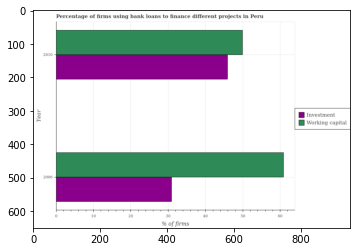

Number of QA =  25





,Year,Investment,Working capital
0,2006,31.252662,61.828554
1,2010,46.968623,50.009022


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of firms using banks to finance working capital in 2006 and that in 2010 ?
PREDICTED =  11.819531535338498
EXPECTED =  11.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of firms using banks to finance investment in 2010 and the percentage of firms using banks to finance working capital in 2006 ?
PREDICTED =  15.715960445028088
EXPECTED =  -15.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of firms using banks to finance working capital and percentage of firms using banks to fina

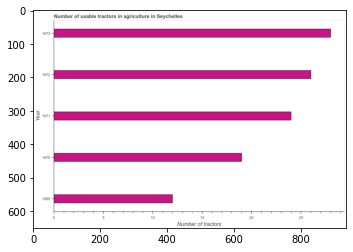

Number of QA =  23





,Year,Number of tractors
0,1969,12.057177
1,1973,27.970348
2,1971,23.913405
3,1970,18.885663
4,1972,25.989938


> what is the title of the graph ?
PREDICTED =  Number of usable tractors in agriculture in Seychelles
EXPECTED =  Number of usable tractors in agriculture in Seychelles




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Number of tractors
EXPECTED =  Number of tractors




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tractors in 1969 and 1973 ?
PREDICTED =  -15.913171178610376
EXPECTED =  -16.0




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of tractors ?
PREDICTED =  23.91340523862261
EXPECTED =  24.0




				 5 / 5 = 1.0


is_built_with_cuda: True
is_gpu_available: Fa

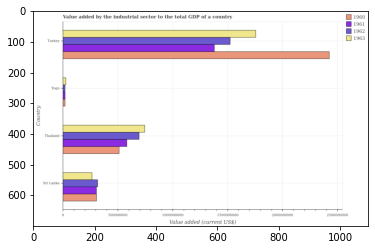

Number of QA =  30





,Country,1963,1962,1961,1960
0,Togo,5.746113e+07,4.613289e+07,4.548337e+07,4.412824e+07
1,Turkey,3.163361e+09,2.770425e+09,2.511924e+09,4.366406e+09
2,Sri Lanka,4.862977e+08,5.766698e+08,5.598308e+08,5.605909e+08
3,Thailand,1.342007e+09,1.253643e+09,1.063182e+09,9.272659e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector to the total gdp in 1962 in togo and that in turkey ?
PREDICTED =  -2724292080.184443
EXPECTED =  -1503447786.0541809




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector to the total gdp in 1960 in togo and the value added by the industrial sector to the total gdp in 1963 in sri lanka?
PREDICTED =  -516462686.367669
EXPECTED =  -245273070.2989616




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector to the total gdp in 1960 and value a

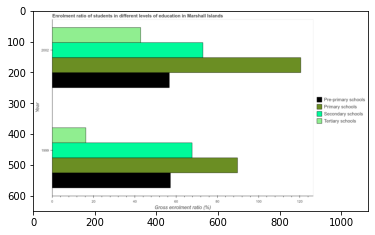

Number of QA =  27





,Year,Secondary schools,Pre-primary schools,Tertiary schools,Primary schools
0,1999,68.618626,57.219911,16.413636,89.562871
1,2002,73.682963,56.713647,43.217447,121.153846


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the gross enrolment ratio in secondary schools in 1999 ?
PREDICTED =  34.309312757242516
EXPECTED =  67.76248168945311




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum gross enrolment ratio in tertiary schools ?
PREDICTED =  21.608723604694603
EXPECTED =  42.8617515563965




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum gross enrolment ratio in pre-primary schools ?
PREDICTED =  28.356823574138623
EXPECTED =  56.7348518371582




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after

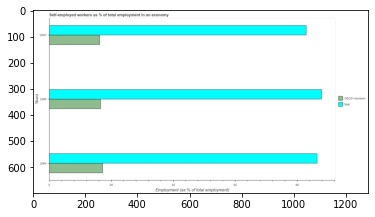

Number of QA =  28





,Years,OECD members,Mali
0,2007,16.427576,83.144759
1,2006,16.689286,88.125332
2,2004,17.592687,86.768010


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers in oecd members in 2004 and that in 2006 ?
PREDICTED =  0.9034007252570966
EXPECTED =  0.6786231172544994




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers in mali in 2004 and the percentage of self-employed workers in oecd members in 2006 ?
PREDICTED =  -1.3573227996580925
EXPECTED =  69.86325995658751




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the percentage of self-employed workers in mali and percentage of self-employed workers in oecd members

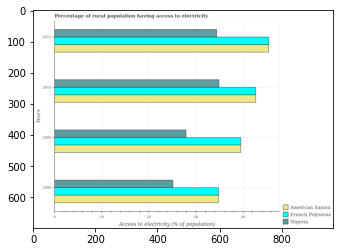

Number of QA =  29





,Years,Nigeria,American Samoa,French Polynesia
0,2010,35.132602,42.976043,43.068863
1,2012,34.368488,45.833491,45.992243
2,1990,25.343518,35.253800,35.023083
3,2000,28.162337,NaN,39.388777


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population having access to electricity in american samoa in 2000 and that in 2012 ?
PREDICTED =  -2.8574483250358824
EXPECTED =  -5.933809999999987




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population having access to electricity in american samoa in 2000 and the percentage of rural population having access to electricity in french polynesia in 2012 ?
PREDICTED =  -2.8574483250358824
EXPECTED =  -5.933809999999987




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentag

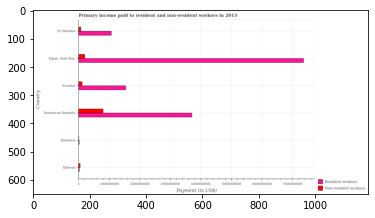

Number of QA =  28





,Country,Non-resident workers,Resident workers
0,Dominica,NaN,NaN
1,Djibouti,6.826379e+07,NaN
2,Dominican Republic,8.175720e+08,3.738743e+09
3,El Salvador,9.399512e+07,1.099564e+09
4,Ecuador,1.373104e+08,1.550964e+09
5,"Egypt, Arab Rep.",2.201371e+08,7.342073e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the payment made to non-resident workers in ecuador and that in el salvador ?
PREDICTED =  43315272.46637018
EXPECTED =  42616424.56




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the payment made to resident workers in egypt, arab rep. and the payment made to non-resident workers in el salvador ?
PREDICTED =  7121936303.812989
EXPECTED =  7289882485.46




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the payment made to non-resident workers and payment made to resident workers in egypt, arab rep. ?
PREDICTED =  597434891.5000119
EXPECTED =  -716

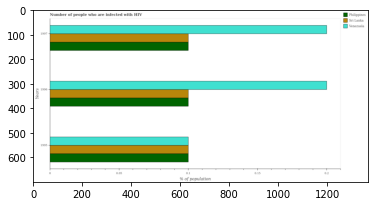

Number of QA =  29





,Years,Philippines,Venezuela,Sri Lanka
0,1997,0.100590,0.201334,0.101478
1,1995,0.100885,0.101683,0.100801
2,1996,0.100428,0.202109,0.101531


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected population in in sri lanka in 1996 and that in 1997 ?
PREDICTED =  5.259538912578965e-05
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected population in in venezuela in 1996 and the percentage of hiv infected population in in philippines in 1995 ?
PREDICTED =  0.10042602373574556
EXPECTED =  0.1




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the percentage of hiv infected population in in venezuela and percentage of hiv infected population in in philipp

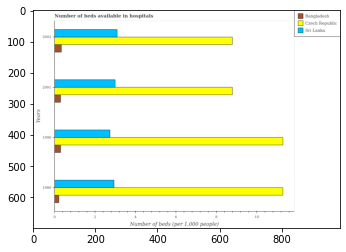

Number of QA =  29





,Years,Czech Republic,Sri Lanka,Bangladesh
0,1980,11.347836,2.988339,0.241073
1,2002,8.821272,3.161088,0.367383
2,2001,8.869149,3.046333,0.327337
3,1990,11.267568,2.798241,0.333359


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of beds in the hospiatls of in czech republic in 1990 and that in 2001 ?
PREDICTED =  2.3984194533517016
EXPECTED =  2.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of beds in the hospiatls of in sri lanka in 1990 and the number of beds in the hospiatls of in czech republic in 2002 ?
PREDICTED =  -0.36284699268842946
EXPECTED =  -6.0565001964




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the number of beds in the hospiatls of in sri lanka and number of beds in the hospiatls of in czech republic ?
PRED

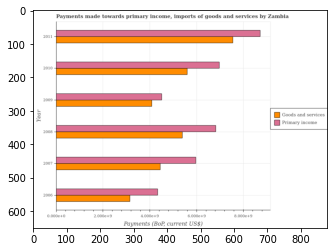

Number of QA =  28





,Year,Goods and services,Primary income
0,2011,7.631336,8.802139
1,2010,NaN,7.057705
2,2009,4.138681,4.570391
3,2008,NaN,6.856049
4,2007,4.511048,NaN
5,2006,3.184283,4.369355


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the second highest payments made towards goods and services ?
PREDICTED =  2.0
EXPECTED =  1949231292




				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predict

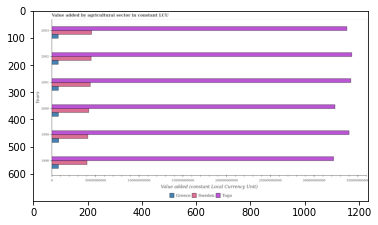

Number of QA =  29





,Years,Sweden,Togo,Greece
0,2003,8.298910e+10,6.110957e+11,1.422455e+10
1,2000,7.621708e+10,5.743700e+11,1.457265e+10
2,2001,8.055756e+10,6.117127e+11,1.452380e+10
3,1999,7.449992e+10,6.004127e+11,1.500939e+10
4,1998,7.350142e+10,5.706729e+11,1.473518e+10
5,2002,8.204779e+10,6.140517e+11,1.366973e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector in greece in 2000 and that in 2002 ?
PREDICTED =  902919306.3806801
EXPECTED =  200974800.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector in greece in 2000 and the value added by agricultural sector in sweden in 2003 ?
PREDICTED =  348103606.97317314
EXPECTED =  -37931463400.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the value added by agricultural sector in togo and value added by agricultural sector in sweden ?
PREDICTED =  1142158286552.522

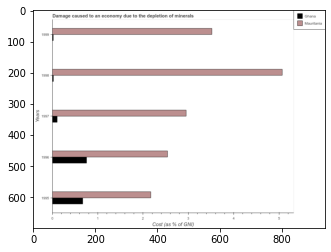

Number of QA =  28





,Years,Mauritania,Ghana
0,1999,3.533069,0.030100
1,1998,5.079986,0.033370
2,1995,2.172860,0.681763
3,1996,2.562380,0.772860
4,1997,2.977758,0.115961


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of minerals in mauritania in 1995 and that in 1998 ?
PREDICTED =  -2.907125632103831
EXPECTED =  -2.90109259884916




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of minerals in ghana in 1998 and the cost of damage caused due to the depletion of minerals in mauritania in 1997 ?
PREDICTED =  -0.0825901860691307
EXPECTED =  -2.9302603091214916




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predi

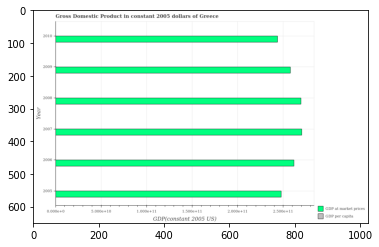

Number of QA =  28





,Year,GDP per capita,GDP at market prices
0,2006,NaN,47.099889
1,2009,NaN,46.436136
2,2010,NaN,43.554107
3,2005,NaN,44.717099
4,2008,NaN,48.539855
5,2007,NaN,48.562336


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp at market prices in 2008 and that in 2010 ?
PREDICTED =  4.98574856507372
EXPECTED =  25716940792.164




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp per capita in 2009 and the gdp at market prices in 2010 ?
PREDICTED =  nan
EXPECTED =  -243735940242.32245




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the gdp per capita and gdp at market prices ?
PREDICTED =  nan
EXPECTED =  -261788748290.358




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation f

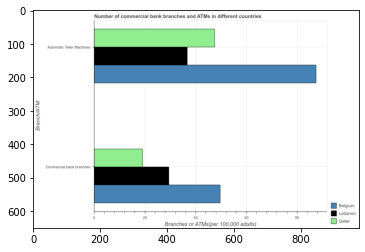

Number of QA =  23





,Branch/ATM,Lebanon,Belgium,Qatar
0,Automatic Teller Machines,36.624894,87.236521,47.674275
1,Commercial bank branches,29.575016,50.352380,19.495350


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of atms in belgium and that in qatar ?
PREDICTED =  0.0
EXPECTED =  40.023179672226206




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of atms in belgium and the number of commercal bank branches in lebanon ?
PREDICTED =  0.0
EXPECTED =  58.05295805259722




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of commercal bank branches and number of atms in qatar ?
PREDICTED =  -1.0
EXPECTED =  -28.404707128635714




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...


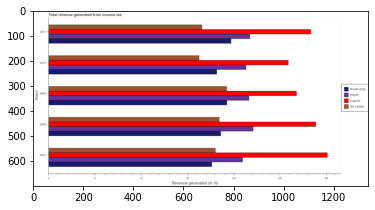

Number of QA =  30





,Years,South Asia,Cyprus,Sri Lanka,World
0,2009,19.116711,26.049610,19.272080,21.747898
1,2008,18.767229,28.693662,18.356664,22.024402
2,2010,18.137922,25.585634,16.296981,21.233136
3,2007,17.721738,29.877973,17.810605,20.893274
4,2011,19.537071,27.957685,16.605136,22.123375


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total revenue generated in south asia in 2007 and that in 2008 ?
PREDICTED =  -1.0454908410163313
EXPECTED =  -0.9646459687542013




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total revenue generated in sri lanka in 2010 and the total revenue generated in cyprus in 2007 ?
PREDICTED =  -13.580992049080365
EXPECTED =  -13.863095710408501




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the total revenue generated in cyprus and total revenue generated in world ?
PREDICTED =  30.1424795684472
EXPECTED =  5.1366816305895





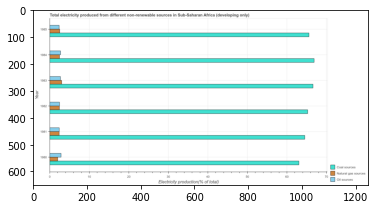

Number of QA =  29





,Year,Natural gas sources,Oil sources,Coal sources
0,1984,2.571118,2.810237,67.740067
1,1985,2.596551,2.489454,66.650218
2,1980,2.115647,2.896355,63.196672
3,1981,2.477814,2.508257,NaN
4,1983,3.099053,2.811372,67.818918
5,1982,2.554068,2.546170,65.385489


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by natural gas in 1982 and that in 1983 ?
PREDICTED =  -0.5449847482298371
EXPECTED =  -0.582




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by natural gas in 1984 and the percentage of electricity produced by oil sources in 1983 ?
PREDICTED =  -0.5279351357658149
EXPECTED =  -0.24123099330198894




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1981, what is the difference between the percentage of electricity produced by oil sources and percentage of electricity produced by coal ?
PREDIC

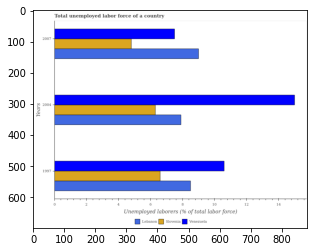

Number of QA =  29





,Years,Lebanon,Slovenia,Venezuela
0,2007,9.132230,4.846330,7.648800
1,1997,8.565737,6.680821,10.794342
2,2004,8.000788,6.361569,15.325805


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total unemployed labor force in slovenia in 1997 and that in 2004 ?
PREDICTED =  0.3192520766556486
EXPECTED =  0.2999997138977104




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total unemployed labor force in venezuela in 2004 and the total unemployed labor force in lebanon in 1997 ?
PREDICTED =  4.531462248148889
EXPECTED =  6.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the total unemployed labor force in venezuela and total unemployed labor force in lebanon ?
PREDICTED =  30.768946905224688
EXPECTED =  -1.5





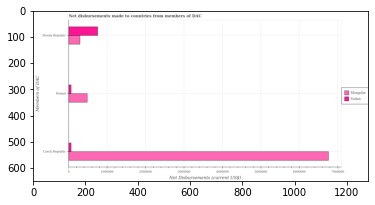

Number of QA =  28





,Members of DAC,Sudan,Mongolia
0,Poland,75667.489380,4.979500e+05
1,Slovak Republic,772847.451652,3.075844e+05
2,Czech Republic,75583.332255,6.738578e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net disbursements made by czech republic in sudan and that in mongolia ?
PREDICTED =  -6662995.026365856
EXPECTED =  -6700000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net disbursements made by slovak republic in mongolia and the net disbursements made by czech republic in sudan ?
PREDICTED =  -540846.4139220405
EXPECTED =  230000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net disbursements made by czech republic and net disbursements made by poland in sudan ?
PREDICTED =  -84.15712509286823
EXPECTED =  0




				 1 / 3 = 0

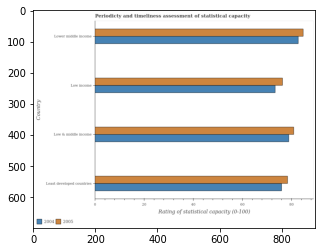

Number of QA =  28





,Country,2005,2004
0,Low income,77.082814,73.896233
1,Low & middle income,81.819388,79.172601
2,Lower middle income,85.123783,83.494137
3,Least developed countries,78.992063,76.573653


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in 2004 in low & middle income and that in low income ?
PREDICTED =  83.49413715654197
EXPECTED =  5.544872692307592




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in 2004 in low income and the rating of statistical capacity in 2005 in low & middle income?
PREDICTED =  -2.638184184386347
EXPECTED =  -7.564039230769211




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in 2005 and rating of statistical capacity in 2004 in lower middle income ?
PR

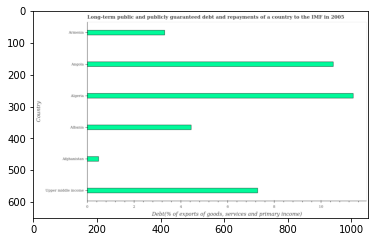

Number of QA =  22





,Country,"Debt(% of exports of goods, services and primary income)"
0,Armenia,3.346686
1,Angola,10.555747
2,Albania,4.467716
3,Afghanistan,0.521498
4,Algeria,11.388932
5,Upper middle income,7.274325


> what is the title of the graph ?
PREDICTED =  Long-term public and publicly guaranteed debt and repayments of a country to the IMF in 2005
EXPECTED =  Long-term public and publicly guaranteed debt and repayments of a country to the IMF in 2005




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Debt(% of exports of goods, services and primary income)
EXPECTED =  Debt(% of exports of goods, services and primary income)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the debt service in angola and upper middle income ?
PREDICTED =  3.2814223598970402
EXPECTED =  3.233




				 4 / 4 = 1.0


> what is the median debt service ?
PREDICTED =  None
EXPECTED =  5.865126454463136




				 4 / 6 = 0.6667


is_built_with

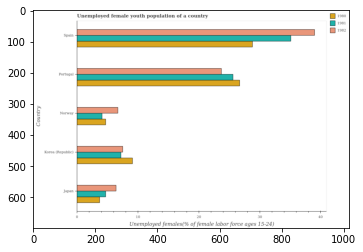

Number of QA =  29





,Country,1982,1980,1981
0,Spain,39.182900,29.328146,35.310611
1,Norway,6.760517,4.882521,4.226259
2,Japan,6.462475,3.845842,4.847749
3,Korea (Republic),7.598595,9.272199,7.346923
4,Portugal,23.812139,26.706946,25.801977


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed female youth population in 1982 in korea (republic) and that in portugal ?
PREDICTED =  -16.21354436613706
EXPECTED =  -16.2000007629395




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed female youth population in 1981 in japan and the percentage of unemployed female youth population in 1980 in norway?
PREDICTED =  0.6214900263547909
EXPECTED =  0.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed female youth population in 1981 and percentage of unemployed female

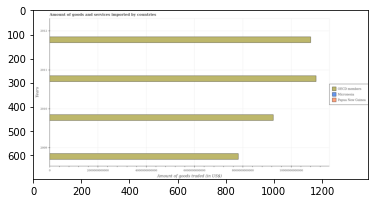

Number of QA =  29





,Years,OECD members,Micronesia,Papua New Guinea
0,2010,9.323161e+12,NaN,NaN
1,2009,7.909070e+12,NaN,NaN
2,2011,1.111577e+13,NaN,NaN
3,2012,1.085878e+13,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount of goods and services imported in oecd members in 2009 and that in 2010 ?
PREDICTED =  -9323160517578.633
EXPECTED =  -1448735312099.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the total amount of goods and services imported in oecd members and total amount of goods and services imported in papua new guinea ?
PREDICTED =  4.0
EXPECTED =  7808118839151.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training

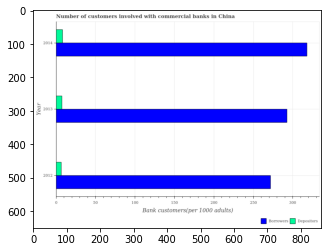

Number of QA =  28





,Year,Depositors,Borrowers
0,2014,15.816173,579.854366
1,2012,13.102025,495.083217
2,2013,14.165091,530.519785


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of depositors in 2013 and that in 2014 ?
PREDICTED =  13.16509081678498
EXPECTED =  -0.771




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of borrowers in 2013 and the number of depositors in 2014 ?
PREDICTED =  -49.334581440807256
EXPECTED =  284.46211583732855




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the number of depositors and number of borrowers ?
PREDICTED =  -576.854366217311
EXPECTED =  -285.233




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predi

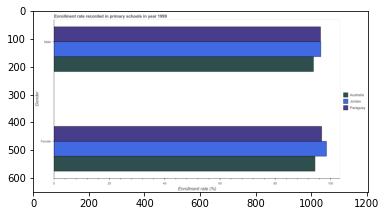

Number of QA =  23





,Gender,Australia,Jordan,Paraguay
0,Male,93.999503,96.727398,96.539685
1,Female,94.600966,98.835039,97.113700


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate of male students in jordan and that in paraguay ?
PREDICTED =  0.18771327029791962
EXPECTED =  0.10882568359370737




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate of male students in jordan and the enrollment rate of female students in paraguay ?
PREDICTED =  -96.92598678039613
EXPECTED =  -0.29238128662109375




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate of male students and enrollment rate of female students in jordan ?
PREDICTED =  -99.02275187041666
EXPECTED =  -2.0466918945312926


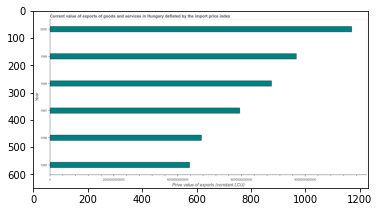

Number of QA =  23





,Year,Prive value of exports (constant LCU)
0,1996,4.743846e+12
1,2000,9.424320e+12
2,1999,7.734743e+12
3,1995,4.360339e+12
4,1997,5.987000e+12
5,1998,6.966963e+12


> what is the title of the graph ?
PREDICTED =  Current value of exports of goods and services in Hungary deflated by the import price index
EXPECTED =  Current value of exports of goods and services in Hungary deflated by the import price index




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Prive value of exports (constant LCU)
EXPECTED =  Prive value of exports (constant LCU)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the price value of exports in 1999 and 2000 ?
PREDICTED =  -1689577382153.9004
EXPECTED =  -1733221245846.92




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median price v

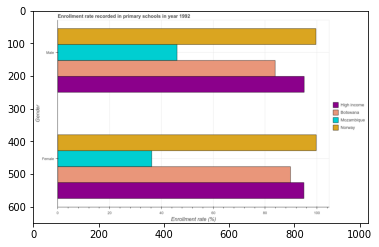

Number of QA =  23





,Gender,Botswana,Mozambique,Norway,High income
0,Female,89.938772,36.841299,100.204171,95.168737
1,Male,84.120659,46.519198,101.083934,95.424564


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate of male students in botswana and that in mozambique ?
PREDICTED =  37.60146152529288
EXPECTED =  37.88367




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate of male students in mozambique and the enrollment rate of female students in botswana ?
PREDICTED =  -127.54023311761381
EXPECTED =  -43.794270000000004




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate of female students and enrollment rate of male students in botswana ?
PREDICTED =  -137.2181317763647
EXPECTED =  5.910600000000002




	

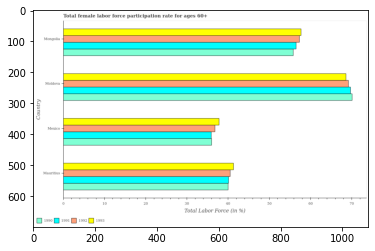

Number of QA =  30





,Country,1992,1993,1991,1990
0,Mexico,NaN,38.185687,36.229968,NaN
1,Mauritius,40.94185,NaN,40.560641,40.656245
2,Moldova,69.90016,69.496854,70.413111,70.533740
3,Mongolia,NaN,57.950775,57.203115,56.390944


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate in 1993 in mauritius and that in mexico ?
PREDICTED =  15.655583173510017
EXPECTED =  3.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate in 1991 in mauritius and the female labor force participation rate in 1992 in mexico?
PREDICTED =  4.330673791413574
EXPECTED =  3.2999992370606037




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate in 1992 and female labor force participation rate in 1993 in mexico ?
PREDICTED =  17.235317

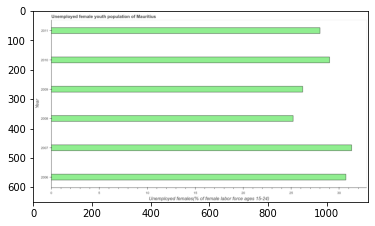

Number of QA =  23





,Year,Unemployed females(% of female labor force ages 15-24)
0,2007,31.314584
1,2006,30.927335
2,2009,26.286027
3,2011,27.931134
4,2008,25.271202
5,2010,28.948769


> what is the title of the graph ?
PREDICTED =  Unemployed female youth population of Mauritius
EXPECTED =  Unemployed female youth population of Mauritius




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Unemployed females(% of female labor force ages 15-24)
EXPECTED =  Unemployed females(% of female labor force ages 15-24)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed female youth in 2010 and 2011 ?
PREDICTED =  1.0176342509843082
EXPECTED =  1.0




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed female youth ?
PREDICTED =  2008.5
EXPECTED =  28.5




				 4 / 5

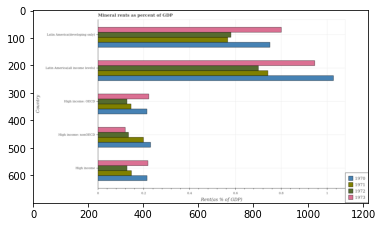

Number of QA =  30





,Country,1972,1971,1970,1973
0,Latin America(all income levels),0.712788,0.747423,1.032687,0.956681
1,High income,0.130638,0.148890,0.216526,0.219023
2,High income: nonOECD,0.136616,0.202706,0.234432,0.123088
3,Latin America(developing only),0.582159,NaN,NaN,0.801932
4,High income: OECD,0.131020,0.147984,0.217592,0.225634


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the mineral rent in 1970 in high income: oecd and that in high income: nonoecd ?
PREDICTED =  -0.0168401478735829
EXPECTED =  -0.016134373038955985




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the mineral rent in 1973 in high income and the mineral rent in 1970 in high income: oecd?
PREDICTED =  -0.006611095868933825
EXPECTED =  0.0044217790628960085




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the mineral rent in 1972 and mineral rent in 1973 in high income ?
PREDICTED =  -0.0883852295380741
EXPECTED =  -0.09137306061317302




				 2 / 3 

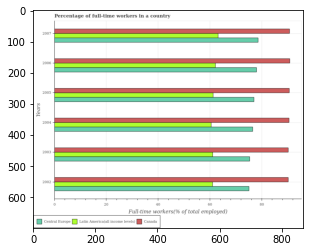

Number of QA =  29





,Years,Central] Europe,Latin America(all income levels),Canada
0,2002,76.073319,62.378087,91.084007
1,2003,77.286491,61.926379,91.042746
2,2005,78.208459,NaN,89.906776
3,2006,77.717866,61.928046,93.543270
4,2007,80.726055,63.609900,91.626369
5,2004,78.470025,61.354411,90.078172


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time workers in latin america(all income levels) in 2002 and that in 2005 ?
PREDICTED =  30.573136729770788
EXPECTED =  -0.21978978185340026




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time workers in latin america(all income levels) in 2004 and the percentage of full-time workers in central europe in 2005 ?
PREDICTED =  -2.255488459314499
EXPECTED =  -16.489218737325494




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the percentage of full-time workers in latin america(all incom

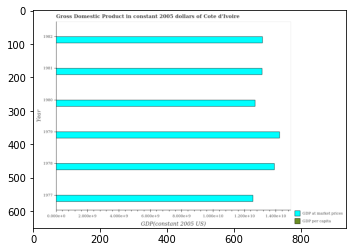

Number of QA =  28





,Year,GDP per capita,GDP at market prices
0,1981,NaN,NaN
1,1982,NaN,13.359804
2,1977,NaN,NaN
3,1979,NaN,14.417788
4,1980,NaN,NaN
5,1978,NaN,14.050346


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp at market prices in 1977 and that in 1982 ?
PREDICTED =  nan
EXPECTED =  -610502669.31




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gdp per capita in 1981 and the gdp at market prices in 1980 ?
PREDICTED =  nan
EXPECTED =  -12674219183.994326




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the gdp per capita in 1977 to that in 1979 ?
PREDICTED =  nan
EXPECTED =  0.963




				 0 / 4 = 0.0



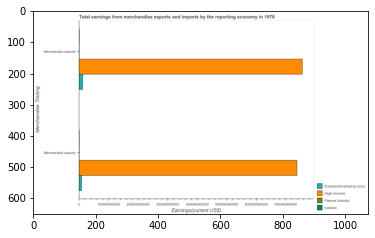

Number of QA =  23





,Merchandise Trading,Iceland,Faeroe Islands,Europe(developing only),High income
0,Merchandise exports,NaN,NaN,1.172206e+10,7.416827e+11
1,Merchandise imports,NaN,NaN,1.589277e+10,7.593719e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise exports in faeroe islands and that in europe(developing only) ?
PREDICTED =  0.0
EXPECTED =  -7993298000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise exports and earnings from merchandise imports in europe(developing only) ?
PREDICTED =  -17689225375.99292
EXPECTED =  -3736840000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the earnings fro

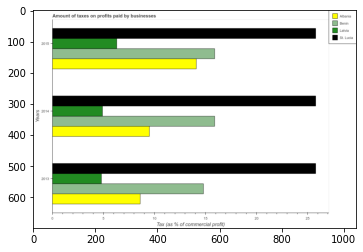

Number of QA =  30





,Years,Latvia,Albania,St. Lucia,Benin
0,2015,6.402983,14.209340,25.885330,16.008488
1,2014,4.998184,9.624693,25.795857,15.969765
2,2013,4.889495,8.673320,25.864618,14.886034


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of taxes paid by businesses in benin in 2013 and that in 2014 ?
PREDICTED =  -1.0837307537945264
EXPECTED =  -1.0999999999999996




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of taxes paid by businesses in albania in 2014 and the percentage of taxes paid by businesses in benin in 2015 ?
PREDICTED =  -4.584646562709899
EXPECTED =  -6.4




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2015, what is the difference between the percentage of taxes paid by businesses in benin and percentage of taxes paid by businesses in st. lucia ?
PREDICT

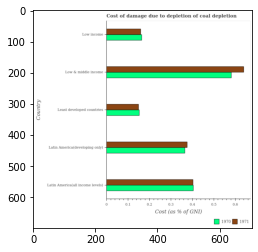

Number of QA =  28





,Country,1971,1970
0,Low & middle income,0.647244,0.587311
1,Latin America(developing only),0.382429,0.372316
2,Least developed countries,0.153258,0.155936
3,Latin America(all income levels),0.408929,0.410540
4,Low income,0.163268,0.167137


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to coal depletion in 1971 in low & middle income and that in low income ?
PREDICTED =  -0.16326783809271683
EXPECTED =  0.4802342175699041




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to coal depletion in 1970 in low & middle income and the cost of damage caused due to coal depletion in 1971 in latin america(developing only)?
PREDICTED =  0.2048818318389543
EXPECTED =  0.20575553622567




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to coal depletion in 1

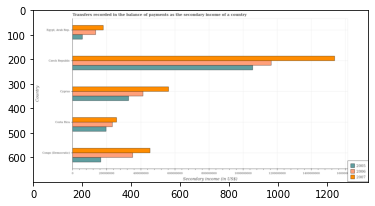

Number of QA =  29





,Country,2007,2005,2006
0,Cyprus,NaN,3.336228e+08,4.188324e+08
1,Costa Rica,2.629998e+08,2.021416e+08,2.397602e+08
2,Congo (Democratic),4.597455e+08,1.728859e+08,3.575207e+08
3,"Egypt, Arab Rep.",1.843035e+08,6.169559e+07,1.408418e+08
4,Czech Republic,1.574504e+09,1.074818e+09,1.182784e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the secondary income of in 2006 in costa rica and that in egypt, arab rep. ?
PREDICTED =  98918352.29275209
EXPECTED =  98007579.4




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the secondary income of in 2005 in congo (democratic) and the secondary income of in 2006 in egypt, arab rep.?
PREDICTED =  111190293.72538367
EXPECTED =  30200000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the secondar

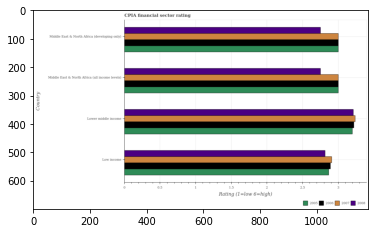

Number of QA =  30





,Country,2007,2005,2008,2006
0,Lower middle income,3.272860,3.216744,3.241807,3.247910
1,Low income,2.929934,2.904249,2.839875,2.925228
2,Middle East & North Africa (developing only),3.025616,3.042471,2.768401,3.032877
3,Middle East & North Africa (all income levels),3.016724,3.029618,2.790422,3.032251


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2008 in low income and that in middle east & north africa (developing only) ?
PREDICTED =  0.07147455017776894
EXPECTED =  0.06481481481481




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2008 in middle east & north africa (all income levels) and the cpia rating in 2006 in lower middle income?
PREDICTED =  -0.45138531615685995
EXPECTED =  -0.46794871794871984




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2008 and cpia rating in 2007 in lower middle income ?
PREDICTED =  -0.362733864320706

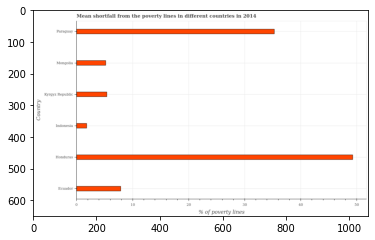

Number of QA =  22





,Country,% of poverty lines
0,Ecuador,8.076228
1,Honduras,49.367353
2,Indonesia,1.933793
3,Paraguay,35.479370
4,Kyrgyz Republic,5.546592
5,Mongolia,5.341871


> what is the title of the graph ?
PREDICTED =  Mean shortfall from the poverty lines in different countries in 2014
EXPECTED =  Mean shortfall from the poverty lines in different countries in 2014




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  % of poverty lines
EXPECTED =  % of poverty lines




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the poverty gap at national poverty lines in ecuador and honduras ?
PREDICTED =  -41.29112467389155
EXPECTED =  -41.43




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median poverty gap at national poverty lines ?
PREDICTED =  6.8114100320808895
EXPEC

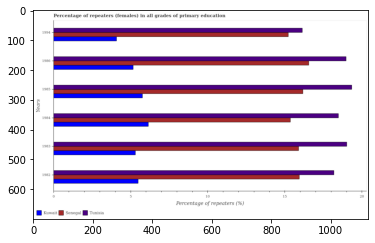

Number of QA =  29





,Years,Senegal,Tunisia,Kuwait
0,1994,15.161749,16.096685,4.100740
1,1986,16.392495,18.702657,5.200209
2,1983,16.003718,19.238809,5.402500
3,1985,16.451116,19.224805,5.775743
4,1982,16.188284,18.263952,5.536928
5,1984,15.304486,18.626114,6.170692


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of repeaters (females) in senegal in 1985 and that in 1994 ?
PREDICTED =  1.2893672359023718
EXPECTED =  0.9462700000000002




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of repeaters (females) in tunisia in 1985 and the percentage of repeaters (females) in kuwait in 1986 ?
PREDICTED =  0.5221474114926465
EXPECTED =  14.174890000000001




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1986, what is the difference between the percentage of repeaters (females) in senegal and percentage of repeaters (females) in tunisia ?
PREDICTED =  -0.9

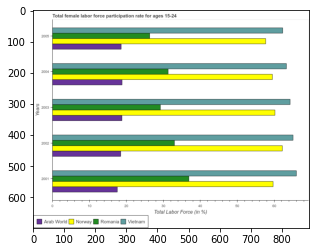

Number of QA =  30





,Years,Arab World,Norway,Romania,Vietnam
0,2002,18.506348,62.118477,33.085564,65.174379
1,2005,18.699831,57.956166,26.591112,62.372264
2,2004,18.980677,59.582387,31.410494,62.998025
3,2003,18.971575,60.241947,29.400712,65.039243
4,2001,17.765190,59.723923,37.021825,65.023815


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate in vietnam in 2002 and that in 2004 ?
PREDICTED =  2.176354011868824
EXPECTED =  1.7999992370604971




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate in romania in 2005 and the female labor force participation rate in vietnam in 2001 ?
PREDICTED =  -10.430713000664522
EXPECTED =  -39.700000762939496




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the female labor force participation rate in vietnam and female labor force participation rate in arab 

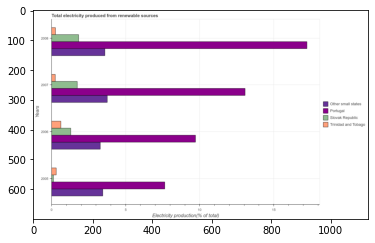

Number of QA =  30





,Years,Portugal,Other small states,Slovak Republic,Trinidad and Tobago
0,2006,9.759734,3.313395,1.343401,0.656807
1,2007,13.040677,3.814445,1.751346,0.286518
2,2005,7.719886,3.526581,0.160433,0.350466
3,2008,17.213259,3.660861,1.855126,0.305239


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced in other small states in 2005 and that in 2006 ?
PREDICTED =  0.21318597850052834
EXPECTED =  0.16743327099400895




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced in other small states in 2006 and the total electricity produced in slovak republic in 2008 ?
PREDICTED =  -0.3474662714384844
EXPECTED =  1.46408128164405




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the total electricity produced in slovak republic and total electricity produced in trinidad and tobago ?


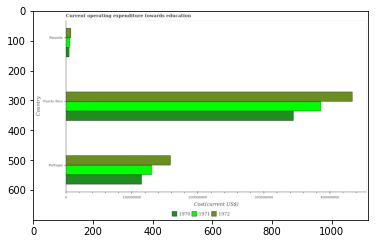

Number of QA =  29





,Country,1972,1971,1970
0,Rwanda,8.147054e+06,6.568391e+06,5.503889e+06
1,Puerto Rico,4.401836e+08,3.859358e+08,3.472166e+08
2,Portugal,1.588624e+08,1.312800e+08,1.160016e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure towards education in 1970 in portugal and that in rwanda ?
PREDICTED =  110497759.67764114
EXPECTED =  109727642.72760001




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure towards education in 1972 in rwanda and the expenditure towards education in 1970 in puerto rico?
PREDICTED =  -432036584.5638356
EXPECTED =  -337229534.47385097




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ra

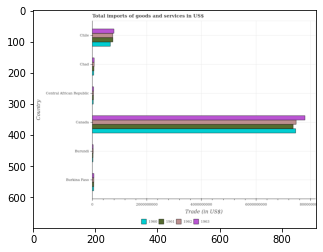

Number of QA =  30





,Country,1963,1962,1961,1960
0,Chad,8.840677e+07,8.845149e+07,8.183326e+07,NaN
1,Burkina Faso,8.058207e+07,7.767234e+07,7.771060e+07,7.261169e+07
2,Central African Republic,6.470925e+07,NaN,NaN,5.641153e+07
3,Chile,8.089527e+08,7.797347e+08,7.673644e+08,6.892425e+08
4,Canada,7.856633e+09,7.503547e+09,7.394596e+09,7.475497e+09
5,Burundi,5.074406e+07,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports of goods and services in 1961 in central african republic and that in chile ?
PREDICTED =  -767364403.753192
EXPECTED =  -711425584.773121




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports of goods and services in 1962 in chad and the total imports of goods and services in 1960 in central african republic?
PREDICTED =  -88451479.46154472
EXPECTED =  31863334.47404349




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports of goods and services in 1963 and total imports of goods and services in 1960 in c

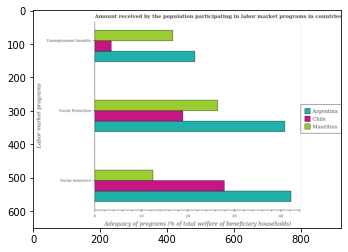

Number of QA =  28





,Labor market programs,Mauritius,Chile,Argentina
0,Social insurance,12.785655,28.157935,42.352321
1,Social Protection,26.509090,19.343223,41.164108
2,Unemployment benefits,17.023934,3.739259,21.810852


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount received by the population participating in social protection programs in argentina and that in chile ?
PREDICTED =  21.82088420419051
EXPECTED =  21.931927918707203




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount received by the population participating in social protection programs in argentina and the amount received by the population participating in social insurance programs in chile ?
PREDICTED =  -6.337051159689615
EXPECTED =  13.006773883512501




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount received by th

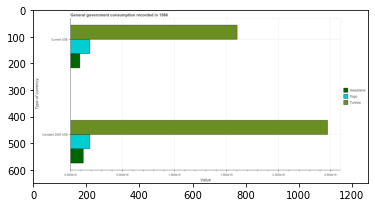

Number of QA =  23





,Type of currency,Unnamed: 1,Tunisia,Swaziland
0,Current US$,1.905113,16.008978,0.965879
1,Constant 2005 US$,1.913449,24.775811,1.296267


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value consumed in constant 2005 us$ in swaziland and that in tunisia ?
PREDICTED =  -23.47954442214924
EXPECTED =  -2348587056.0437927




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value consumed in current us$ in togo and the value consumed in constant 2005 us$ in swaziland ?
PREDICTED =  -0.1651942139800574
EXPECTED =  62411715.92009701




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value consumed in current us$ and value consumed in constant 2005 us$ in togo ?
PREDICTED =  -0.0948865312217042
EXPECTED =  400900.1902471185




		

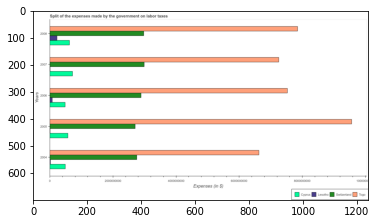

Number of QA =  30





,Years,Switzerland,Unnamed: 2,Lesotho,Cyprus
0,2005,2.727177e+09,9.539712e+09,NaN,5.878116e+08
1,2007,3.015639e+09,7.223848e+09,NaN,7.311209e+08
2,2006,2.891734e+09,7.536168e+09,8.886805e+07,4.949844e+08
3,2004,2.793411e+09,NaN,NaN,5.088401e+08
4,2008,2.985976e+09,7.851303e+09,2.408617e+08,6.312195e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenses made by the government on labor taxes in cyprus in 2006 and that in 2007 ?
PREDICTED =  -236136431.37035966
EXPECTED =  -233394956.89198607




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenses made by the government on labor taxes in togo in 2006 and the expenses made by the government on labor taxes in switzerland in 2007 ?
PREDICTED =  -2520654274.394743
EXPECTED =  4539339921.82




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the expenses made by the government on labor taxes in togo and expenses made by 

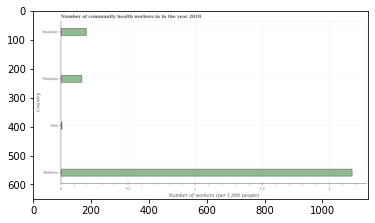

Number of QA =  22





,Country,"Number of workers (per 1,000 people)"
0,Mali,0.011869
1,Mongolia,0.160161
2,Myanmar,0.192088
3,Maldives,2.165532


> what is the title of the graph ?
PREDICTED =  Number of community health workers in in the year 2010
EXPECTED =  Number of community health workers in in the year 2010




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Number of workers (per 1,000 people)
EXPECTED =  Number of workers (per 1,000 people)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of community health workers in maldives and mali ?
PREDICTED =  2.1536630263424277
EXPECTED =  2.163




				 4 / 4 = 1.0


> what is the median number of community health workers ?
PREDICTED =  None
EXPECTED =  0.172




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after

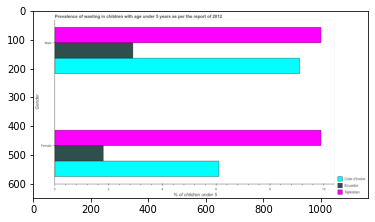

Number of QA =  23





,Gender,Tajikistan,Cote d'Ivoire,Ecuador
0,Male,9.873175,9.158295,2.916599
1,Female,9.851385,6.121402,1.821353


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished male children in cote d'ivoire and that in tajikistan ?
PREDICTED =  0.0
EXPECTED =  -0.7999992370605398




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished female children in tajikistan and the percentage of undernourished male children in ecuador ?
PREDICTED =  8.03003230392098
EXPECTED =  6.99999952316284




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is t

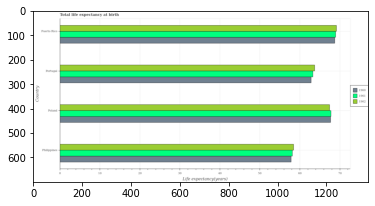

Number of QA =  29





,Country,1962,1961,1960
0,Portugal,63.998650,63.749853,63.453189
1,Poland,67.533147,68.353958,68.282899
2,Puerto Rico,69.433327,69.585662,69.445033
3,Philippines,59.075369,58.732482,58.166237


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the life expectancy at birth in in 1960 in portugal and that in puerto rico ?
PREDICTED =  -5.99184411119947
EXPECTED =  -5.91068292682931




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the life expectancy at birth in in 1962 in puerto rico and the life expectancy at birth in in 1960 in portugal?
PREDICTED =  5.434677110356702
EXPECTED =  6.336000000000013




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the life expectancy at birth in in 1962 and life expectancy at birth in in 1960 in philippines ?
PREDICTED =  6.843885798773407
EXPECTED =  0.61

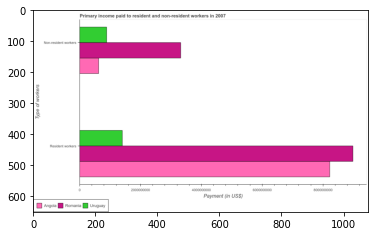

Number of QA =  23





,Type of workers,Angola,Uruguay,Romania
0,Non-resident workers,6.468822e+08,9.026721e+08,3.362803e+09
1,Resident workers,8.336199e+09,1.400376e+09,9.027620e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the payment made to non-resident workers in romania and that in uruguay ?
PREDICTED =  2460131313.193472
EXPECTED =  2435954685.6




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the payment made to resident workers in romania and the payment made to non-resident workers in angola ?
PREDICTED =  8380738000.11949
EXPECTED =  8360442618.6




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the payment made to non-resident workers and payment made to resident workers in uruguay ?
PREDICTED =  -255789887.67362022
EXPECTED =  -515882289.6




				 2 / 3 = 

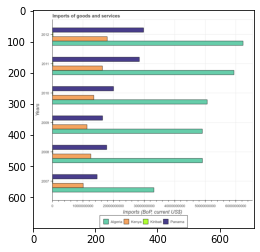

Number of QA =  30





,Years,Unnamed: 1,Panama,Kiribat,Kenya
0,2007,3.409801e+10,1.486804e+10,NaN,1.021779e+10
1,2010,5.117250e+10,2.005562e+10,NaN,1.371249e+10
2,2011,6.071420e+10,2.894368e+10,NaN,1.655192e+10
3,2009,4.900580e+10,1.655073e+10,NaN,1.163749e+10
4,2012,6.325082e+10,3.009752e+10,NaN,1.814176e+10
5,2008,5.000514e+10,1.788030e+10,NaN,1.283184e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on imports in panama in 2010 and that in 2011 ?
PREDICTED =  -8888065754.120277
EXPECTED =  -8439600000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on imports in algeria in 2011 and the amount spent on imports in panama in 2007 ?
PREDICTED =  45846168014.834335
EXPECTED =  44786505662.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the amount spent on imports in 

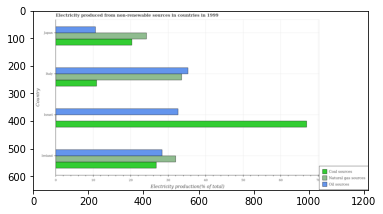

Number of QA =  29





,Country,Natural gas sources,Oil sources,Coal sources
0,Israel,NaN,33.091869,67.854678
1,Ireland,32.309502,28.745591,27.171184
2,Japan,24.455605,10.773838,20.574072
3,Italy,34.052387,35.561493,11.137167


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by natural gas in israel and that in italy ?
PREDICTED =  -34.05238723346684
EXPECTED =  -33.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by oil sources in japan and the percentage of electricity produced by coal in israel ?
PREDICTED =  -22.31803040016601
EXPECTED =  -56.314337337126204




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by natural gas and percentage of electricity produced by oil sources in japan ?
PREDICTED =  

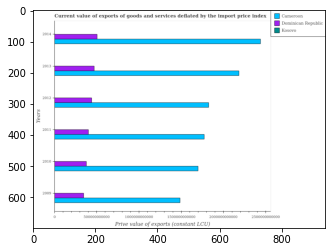

Number of QA =  29





,Years,Dominican Republic,Cameroon,Kosovo
0,2010,6.944656e+11,3.098727e+12,NaN
1,2009,6.325683e+11,2.734789e+12,NaN
2,2013,8.724138e+11,3.951388e+12,NaN
3,2011,7.340710e+11,3.201507e+12,NaN
4,2012,8.058672e+11,3.323413e+12,NaN
5,2014,9.286990e+11,4.418315e+12,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the prive value of exports in dominican republic in 2009 and that in 2011 ?
PREDICTED =  -101502705705.34387
EXPECTED =  -56213462040.02301




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the prive value of exports in kosovo in 2014 and the prive value of exports in dominican republic in 2012 ?
PREDICTED =  0.0
EXPECTED =  -438538151114.3122




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the prive value of exports in dominican republic and prive value of exports in kosovo ?
PREDICTED =  928699013703.2324
EXPECTED =  40036158414

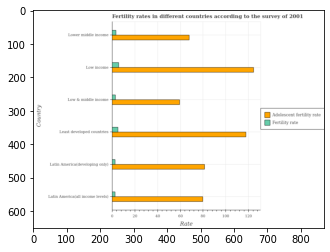

Number of QA =  28





,Country,Fertility rate,Adolescent fertility rate
0,Lower middle income,4.057904,68.622108
1,Least developed countries,5.855113,119.186747
2,Low income,6.301990,125.277827
3,Low & middle income,3.516762,60.764232
4,Latin America(all income levels),3.163790,NaN
5,Latin America(developing only),3.190164,81.916310


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the fertility rate in latin america(all income levels) and that in low & middle income ?
PREDICTED =  -0.35297284770438475
EXPECTED =  -0.302




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the fertility rate in lower middle income and the adolescent fertility rate in latin america(all income levels) ?
PREDICTED =  -64.56420415479067
EXPECTED =  -76.33513241920437




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adolescent fertility rate and fertility rate in latin america(all income levels) ?
PREDICTED =  125.27782660684423
EXPECTED =  77.142

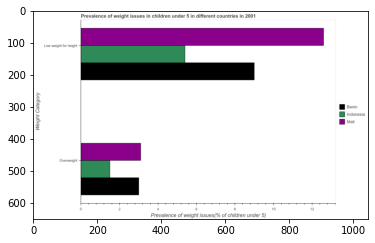

Number of QA =  23





,Weight Category,Mali,Indonesia,Benin
0,Overweight,3.128497,1.522739,3.002573
1,Low weight for height,12.640498,5.399523,8.964856


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of overweight children in mali and that in benin ?
PREDICTED =  0.1259247478618084
EXPECTED =  0.09999990463257014




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of overweight children and percentage of underweight children in indonesia ?
PREDICTED =  1.6057589053591097
EXPECTED =  -3.900000095367429




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference betw

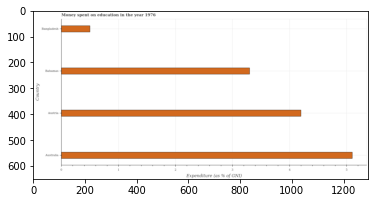

Number of QA =  22





,Country,Expenditure (as % of GNI)
0,Austria,4.203086
1,Australia,5.144508
2,Bahamas,3.304897
3,Bangladesh,0.512915


> what is the title of the graph ?
PREDICTED =  Money spent on education in the year 1976
EXPECTED =  Money spent on education in the year 1976




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Expenditure (as % of GNI)
EXPECTED =  Expenditure (as % of GNI)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure on education in australia and bahamas ?
PREDICTED =  1.8396119314836659
EXPECTED =  1.8




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median expenditure on education ?
PREDICTED =  3.7539911102722354
EXPECTED =  3.75




				 5 / 5 = 1.0


is_built_with_cuda: True
is_gpu_a

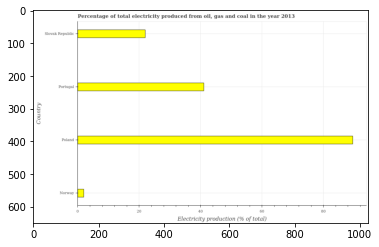

Number of QA =  22





,Country,Electricity production (% of total)
0,Norway,2.254209
1,Portugal,41.606482
2,Poland,89.972179
3,Slovak Republic,22.298720


> what is the title of the graph ?
PREDICTED =  Percentage of total electricity produced from oil, gas and coal in the year 2013
EXPECTED =  Percentage of total electricity produced from oil, gas and coal in the year 2013




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Electricity production (% of total)
EXPECTED =  Electricity production (% of total)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the electricity production in norway and poland ?
PREDICTED =  -87.71797039129888
EXPECTED =  -87.583




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median electricity production ?
PREDICTED =

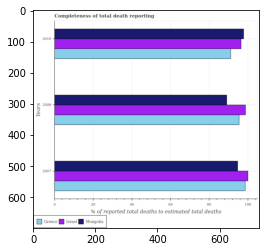

Number of QA =  29





,Years,Greece,Israel,Mongolia
0,2010,NaN,97.355524,98.840174
1,2007,99.634474,99.973201,95.840100
2,2008,96.520228,99.782949,90.107039


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total deaths reported in israel in 2007 and that in 2008 ?
PREDICTED =  0.1902525180434651
EXPECTED =  1.2393785509577953




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total deaths reported in mongolia in 2010 and the percentage of total deaths reported in greece in 2007 ?
PREDICTED =  3.0000742981216604
EXPECTED =  -0.8172414371642844




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the percentage of total deaths reported in mongolia and percentage of total deaths reported in israel ?
PREDIC

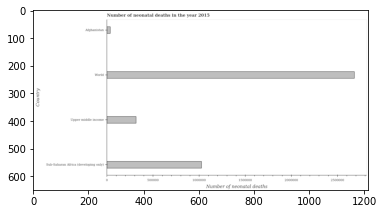

Number of QA =  22





,Country,Number of neonatal deaths
0,Upper middle income,5.827559e+05
1,Afghanistan,7.797930e+04
2,World,4.864938e+06
3,Sub-Saharan Africa (developing only),1.861606e+06


> what is the title of the graph ?
PREDICTED =  Number of neonatal deaths in the year 2015
EXPECTED =  Number of neonatal deaths in the year 2015




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Number of neonatal deaths
EXPECTED =  Number of neonatal deaths




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of neonatal deaths in upper middle income and world ?
PREDICTED =  0.0
EXPECTED =  -2366844.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of neonatal deaths ?
PREDICTED =  1222181.118417741
EXPECTED =  670379.5




				 3 / 5 = 0.6


is_built_with_cuda: True


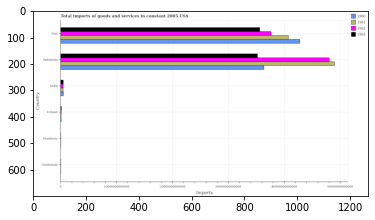

Number of QA =  30





,Country,1963,1962,1961,1960
0,Iceland,2.015772e+11,2.160141e+11,NaN,NaN
1,Honduras,NaN,NaN,NaN,NaN
2,Guatemala,NaN,NaN,NaN,NaN
3,Indonesia,NaN,NaN,5.039590e+13,3.641480e+13
4,India,5.935326e+11,5.884486e+11,5.745970e+11,6.164680e+11
5,Iran,3.566311e+13,NaN,4.037853e+13,4.289962e+13


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports of goods and services in 1960 in iceland and that in iran ?
PREDICTED =  -42899616374914.09
EXPECTED =  -42674580778099.7




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports of goods and services in 1961 in guatemala and the total imports of goods and services in 1963 in iran?
PREDICTED =  -40378534642081.57
EXPECTED =  -35588719243776.5




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports of goods and services in 1960 and total imports of goods and services in 1961 in guatemala ?
PREDICTED =  -3703126

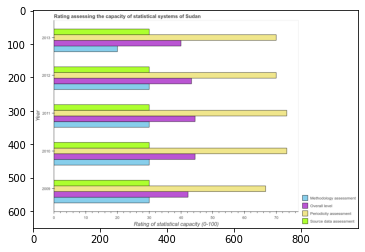

Number of QA =  30





,Year,Periodicity assessment,Methodology assessment,Overall level,Source data assessment
0,2013,70.266761,20.062247,NaN,30.178866
1,2009,66.643838,30.083570,42.088334,30.148427
2,2010,72.928580,NaN,NaN,30.170874
3,2012,69.686108,29.937307,NaN,NaN
4,2011,73.185513,29.890036,44.086498,30.236301


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the methodology assessment rating in 2010 and that in 2011 ?
PREDICTED =  nan
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the methodology assessment rating in 2010 and the overall level rating in 2013 ?
PREDICTED =  nan
EXPECTED =  -10.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the methodology assessment rating in 2010 to that in 2013 ?
PREDICTED =  nan
EXPECTED =  1.5




				 0 

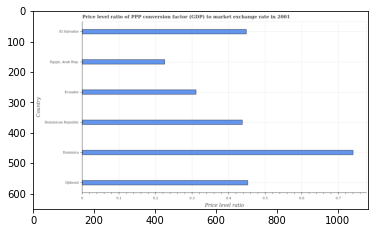

Number of QA =  22





,Country,Price level ratio
0,Ecuador,0.310529
1,Djibouti,0.452181
2,Dominica,0.734968
3,El Salvador,0.452007
4,Dominican Republic,0.436077
5,"Egypt, Arab Rep.",0.227906


> what is the title of the graph ?
PREDICTED =  Price level ratio of PPP conversion factor (GDP) to market exchange rate in 2001
EXPECTED =  Price level ratio of PPP conversion factor (GDP) to market exchange rate in 2001




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Price level ratio
EXPECTED =  Price level ratio




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the price level ratio in dominica ?
PREDICTED =  0.10499548139335672
EXPECTED =  0.740329327868979




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum price level ratio ?
PREDICTED =  0.10499548139335672
EXPECTED =  0.7403293

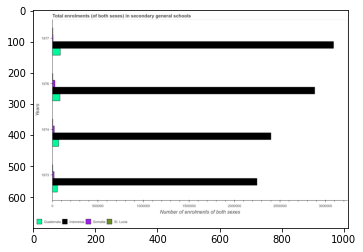

Number of QA =  30





,Years,Somalia,Indonesia,St. Lucia,Guatemala
0,1977,NaN,2.441709e+04,NaN,166494.597698
1,1974,43553.739310,4.358575e+06,NaN,131658.142223
2,1976,59315.606363,5.201931e+06,NaN,159890.297988
3,1973,40067.164818,4.070777e+06,NaN,107848.740248


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary schools in st. lucia in 1974 and that in 1976 ?
PREDICTED =  43553.739309783006
EXPECTED =  -259.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary schools in somalia in 1973 and the number of enrolments in secondary schools in indonesia in 1976 ?
PREDICTED =  -5161863.505833954
EXPECTED =  -2863587.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1977, what is the difference between the number of enrolments in secondary schools in guatemala and number of enrolments in secondary schools in 

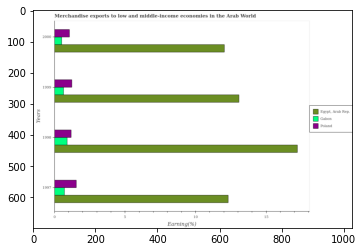

Number of QA =  29





,Years,Gabon,Poland,"Egypt, Arab Rep"
0,1997,0.736346,1.565275,12.058135
1,2000,0.540331,1.094978,12.017203
2,1998,0.922440,1.201573,17.224425
3,1999,0.668715,1.256516,13.075287


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in gabon in 1997 and that in 1998 ?
PREDICTED =  -0.1860937245612896
EXPECTED =  -0.19350177477238195




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in gabon in 1997 and the percentage of amount earned from merchandise exports in egypt, arab rep. in 1999 ?
PREDICTED =  0.06763159497412086
EXPECTED =  -12.369246483223671




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the percentage of amount earned from merchandise 

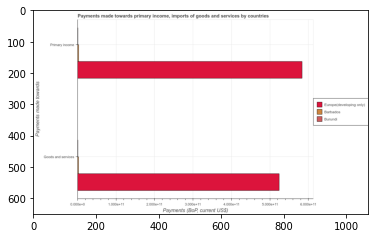

Number of QA =  23





,Payments made towards,Burundi,Europe(developing only),Barbados
0,Primary income,NaN,5.857699,NaN
1,Goods and services,NaN,5.327923,0.039819


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the payments made towards goods and services in europe(developing only) to that in barbados ?
PREDICTED =  1.0
EXPECTED =  233.8693403857282




				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Payments (BoP, current US$)
EXPECTED =  100000000000.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Pa

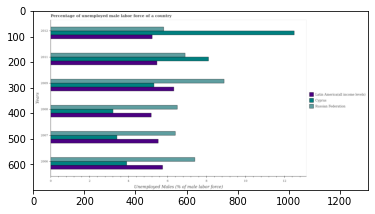

Number of QA =  29





,Years,Russian Federation,Cyprus,Latin America(all income levels)
0,2012,5.939125,12.719605,5.240272
1,2008,6.407056,3.198249,5.154808
2,2007,6.477121,3.411024,5.569118
3,2011,6.996764,8.159541,5.513226
4,2006,7.362881,3.874980,5.720646
5,2009,8.861993,5.309832,6.381204


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the percentage of unemployed male labor force in russian federation in 2011 ?
PREDICTED =  0.003482998646879645
EXPECTED =  6.900000095367429




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum percentage of unemployed male labor force in russian federation ?
PREDICTED =  1.0000829668962083
EXPECTED =  8.89999961853027




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the total percentage of unemployed male labor force in russian federation in the graph ?
PREDICTED =  0.0029868082635028624
EXPECTED =  41.90000009536742




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False


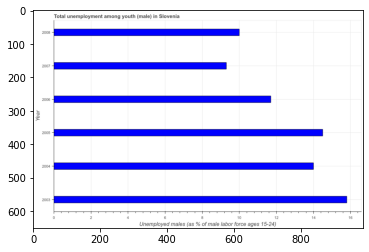

Number of QA =  23





,Year,Unemployed males (as % of male labor force ages 15-24)
0,2008,10.045963
1,2005,14.430815
2,2004,13.958374
3,2007,9.206586
4,2003,15.727820
5,2006,11.615767


> what is the title of the graph ?
PREDICTED =  Total unemployment among youth (male) in Slovenia
EXPECTED =  Total unemployment among youth (male) in Slovenia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Unemployed males (as % of male labor force ages 15-24)
EXPECTED =  Unemployed males (as % of male labor force ages 15-24)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed male youth population in 2003 and 2006 ?
PREDICTED =  4.1120524017137345
EXPECTED =  4.1




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed male youth population ?
PREDICTED =  2005.5
EXPECTED 

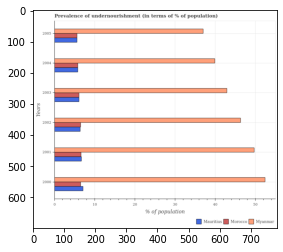

Number of QA =  29





,Years,Myanmar,Mauritius,Morocco
0,2004,40.390781,5.941884,6.023861
1,2005,37.061536,5.768745,5.756269
2,2001,50.095400,6.828581,6.758915
3,2003,43.245912,6.270355,6.267556
4,2000,52.929209,7.343626,6.720191
5,2002,46.557981,6.526876,6.704836


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished population in myanmar in 2000 and that in 2004 ?
PREDICTED =  12.538428722657187
EXPECTED =  12.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished population in myanmar in 2000 and the percentage of undernourished population in mauritius in 2002 ?
PREDICTED =  6.37122831014743
EXPECTED =  46.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the percentage of undernourished population in morocco and percentage of undernourished population in myanmar ?
PREDICTED =  -

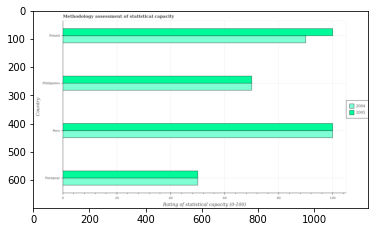

Number of QA =  28





,Country,2005,2004
0,NaN,100.618031,100.571827
1,Poland,100.130449,90.617585
2,Philippines,70.323960,NaN
3,Paraguay,50.309367,50.241726


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in 2005 in philippines and that in poland ?
PREDICTED =  -29.80648829082044
EXPECTED =  -30.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in 2005 in philippines and the rating of statistical capacity in 2004 in peru?
PREDICTED =  -4.895947467260299
EXPECTED =  -30.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in 2005 and rating of statistical capacity in 2004 in paraguay ?
PREDICTED =  250.95215172808335
EXPECTED =  0.0




				 1 / 3 

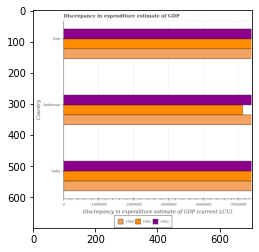

Number of QA =  16





,Country,1962,1961,1960
0,Iran,5.411005e+06,5.405822e+06,5.416357e+06
1,Indonesia,5.418929e+06,5.183913e+06,5.422215e+06
2,India,5.417595e+06,5.425608e+06,5.421467e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the discrepancy in expenditure estimate of gdp in 1962 in india and the discrepancy in expenditure estimate of gdp in 1961 in indonesia?
PREDICTED =  -5418928.033620112
EXPECTED =  0




				 0 / 1 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Discrepancy in expenditure estimate of GDP (current LCU)
EXPECTED =  1000000.0




				 0 / 2 = 0.0


> what is the title of the graph ?
PREDICTED =  Discrepancy in expenditure estimate of
EXPECTED =  Discrepancy in expenditure estimate of GDP




				 0 / 3 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Discrepancy in expenditure estimate of GDP (current LCU)
EXPECTED =  Discrepancy in expenditure estimate of GDP (current LCU)




				 1 / 4 = 0.25


> what is the label or title of the y-axis ?
PREDICTED =  Count

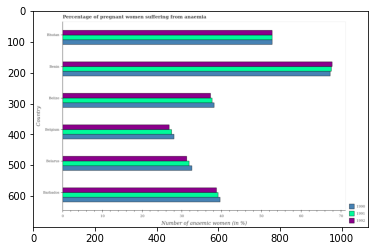

Number of QA =  29





,Country,1992,1990,1991
0,Belarus,31.407918,32.542640,31.905107
1,Bhutan,53.148365,52.943078,NaN
2,Belize,37.446658,38.190341,37.421065
3,Benin,67.956941,67.660278,67.877619
4,Barbados,38.898560,39.833864,39.277503
5,Belgium,27.097050,28.159244,27.638744


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of anaemic women in 1991 in belgium and that in benin ?
PREDICTED =  -66.87761908924915
EXPECTED =  -40.199999999999996




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of anaemic women in 1992 in barbados and the number of anaemic women in 1990 in belgium?
PREDICTED =  11.801509428880003
EXPECTED =  10.700000000000003




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of anaemic women in 1991 and number of anaemic women in 1992 in belgium ?
PREDICTED =  4.0
EXPECTED =  0.5999999999999979




				 0 / 3 = 0.0


is_bui

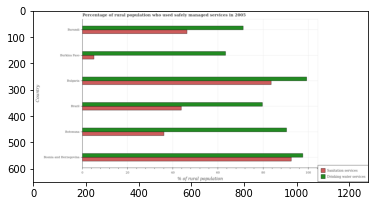

Number of QA =  28





,Country,Drinking water services,Sanitation services
0,Botswana,90.640060,36.586499
1,Bosnia and Herzegovina,97.818325,NaN
2,Bulgaria,100.264840,84.216908
3,Brazil,80.699957,44.074677
4,Burundi,71.866321,46.723034
5,Burkina Faso,63.808998,5.445317


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population who used sanitation services in bosnia and herzegovina and that in botswana ?
PREDICTED =  0.0
EXPECTED =  56.4




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population who used drinking water services in burundi and the percentage of rural population who used sanitation services in bulgaria ?
PREDICTED =  -28.39851857181904
EXPECTED =  -12.399999999999991




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population who used drinking water services and percentage o

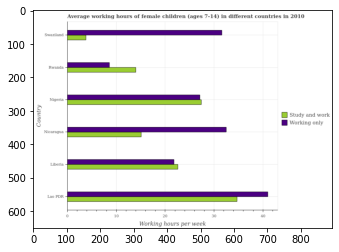

Number of QA =  28





,Country,Study and work,Working only
0,Liberia,NaN,21.949932
1,Lao PDR,34.909372,41.435557
2,Rwanda,14.164879,8.660105
3,Swaziland,3.945964,NaN
4,Nigeria,NaN,27.211346
5,Nicaragua,NaN,32.646441


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the average working hour of children involved in study and work in lao pdr and that in rwanda ?
PREDICTED =  0.0
EXPECTED =  20.7




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the average working hour of children involved in only work in rwanda and the average working hour of children involved in study and work in liberia ?
PREDICTED =  -13.289827566071601
EXPECTED =  -14.000000000000002




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the average working hour of children involved in study and work and average working hour of children involved i

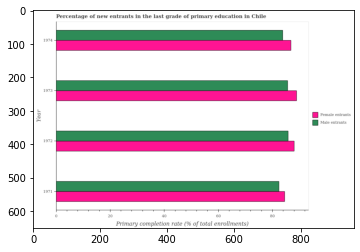

Number of QA =  28





,Year,Male entrants,Female entrants
0,1974,83.565972,87.179285
1,1972,86.789127,89.404307
2,1973,86.128840,89.262973
3,1971,83.083550,84.997179


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the primary completion rate of male entrants in 1973 and that in 1974 ?
PREDICTED =  2.562868257792573
EXPECTED =  1.827




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the primary completion rate of male entrants in 1973 and the primary completion rate of female entrants in 1972 ?
PREDICTED =  -0.6602870397594387
EXPECTED =  -2.4255899999999997




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1972, what is the difference between the primary completion rate of male entrants and primary completion rate of female entrants ?
PREDICTED =  0.0
EXPECTED =  -2.243




				

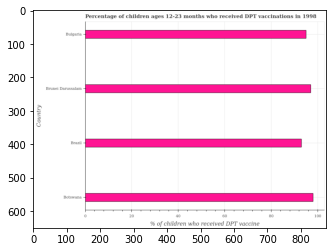

Number of QA =  22





,Country,% of children who received DPT vaccine
0,Botswana,99.084193
1,Bulgaria,96.283086
2,Brazil,94.528334
3,Brunei Darussalam,97.919112


> what is the title of the graph ?
PREDICTED =  Percentage of children ages 12-23 months who received DPT vaccinations in 1998
EXPECTED =  Percentage of children ages 12-23 months who received DPT vaccinations in 1998




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  % of children who received DPT vaccine
EXPECTED =  % of children who received DPT vaccine




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who received dpt vaccine in brunei darussalam and bulgaria ?
PREDICTED =  0.0
EXPECTED =  2.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of 

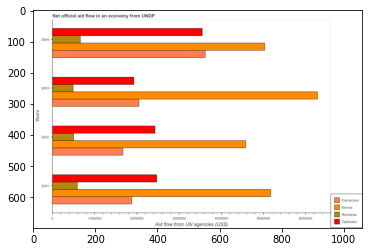

Number of QA =  30





,Years,Tajikistan,Kenya,Cameroon,Romania
0,2004,3.544705e+06,5.012660e+06,NaN,672852.732020
1,2002,2.428172e+06,4.578320e+06,1.680087e+06,514896.030703
2,2003,1.944568e+06,6.281557e+06,2.073560e+06,509611.682013
3,2001,2.504639e+06,5.198160e+06,1.911786e+06,605802.057801


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in cameroon in 2002 and that in 2004 ?
PREDICTED =  1680086.6491034594
EXPECTED =  -1950000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in cameroon in 2004 and the net official aid flow in romania in 2003 ?
PREDICTED =  -2073559.726798937
EXPECTED =  3130000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the net official aid flow in kenya and net official aid flow in tajikistan ?
PREDICTED =  4336989.559397934
EXPECTED =  2700000.0




				 0 / 3 = 0.0


is_built_with_cu

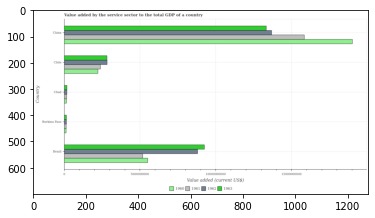

Number of QA =  30





,Country,1963,1962,1961,1960
0,Brazil,1.678500e+10,NaN,9.394580e+09,9.867499e+09
1,Chad,3.632681e+08,3.624467e+08,3.438627e+08,3.182897e+08
2,China,2.414806e+10,2.466764e+10,2.845712e+10,3.517644e+10
3,Chile,5.066094e+09,5.165530e+09,4.383553e+09,4.062594e+09
4,Burkina Faso,3.010132e+08,3.048931e+08,2.937751e+08,2.820192e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the service sector to the total gdp in 1963 in burkina faso and that in chile ?
PREDICTED =  -5066093658.488007
EXPECTED =  -2675555975.706497




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the service sector to the total gdp in 1961 in chad and the value added by the service sector to the total gdp in 1962 in china?
PREDICTED =  -28113254200.021458
EXPECTED =  -13522581410.941662




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the service sector to the total gdp in 1962 and value added by

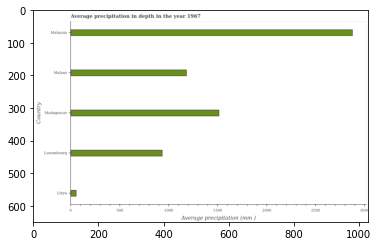

Number of QA =  22





,Country,Average precipitation (mm )
0,Libya,114.995775
1,Malaysia,5119.585287
2,Malawi,2135.831684
3,Luxembourg,1690.436976
4,Madagascar,2728.550585


> what is the title of the graph ?
PREDICTED =  Average precipitation in depth in the year 1967
EXPECTED =  Average precipitation in depth in the year 1967




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Average precipitation (mm )
EXPECTED =  Average precipitation (mm )




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the average precipitation in depth in luxembourg and malaysia ?
PREDICTED =  -3429.148311141723
EXPECTED =  -1941.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median average precipitation in depth ?
PREDICTED =  2135.8316842167287
EXPECTED =  1181.0




				 3 / 5 = 0.

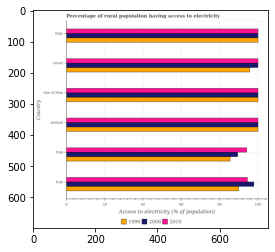

Number of QA =  29





,Country,2000,1990,2010
0,Iran,98.312426,90.943709,96.507520
1,Italy,99.994452,100.054492,100.967777
2,Israel,100.526707,NaN,101.062344
3,Ireland,100.618781,100.549967,100.927762
4,Iraq,90.428565,NaN,95.481710
5,Isle of Man,100.336205,100.745793,100.537390


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population having access to electricity in 2000 in iran and that in italy ?
PREDICTED =  -1.6820263195675125
EXPECTED =  -2.200000000000003




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population having access to electricity in 2010 in israel and the percentage of rural population having access to electricity in 2000 in italy?
PREDICTED =  1.0678916669475313
EXPECTED =  0.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population having access to electricity in 2000 and 

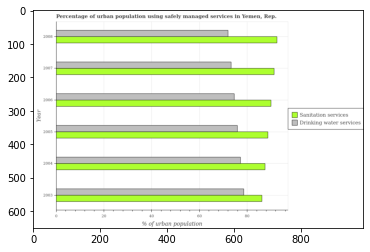

Number of QA =  28





,Year,Drinking water services,Sanitation services
0,2008,NaN,93.356970
1,2004,77.812439,88.311743
2,2007,74.070653,91.893704
3,2006,74.712145,92.088457
4,2005,NaN,NaN
5,2003,79.306517,87.144301


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population who used sanitation services in 2006 and that in 2008 ?
PREDICTED =  -1.2685123679159318
EXPECTED =  -2.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population who used sanitation services in 2004 and the percentage of urban population who used drinking water services in 2005 ?
PREDICTED =  88.31174343942325
EXPECTED =  11.599999999999994




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percentage of urban population who used sanitation services and percentage of

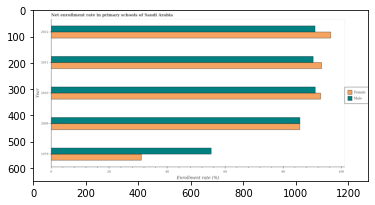

Number of QA =  28





,Year,Female,Male
0,2011,NaN,91.235774
1,2012,96.732750,91.246002
2,2009,NaN,86.585263
3,2010,93.714174,91.083536
4,1979,NaN,56.088212


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate of male students in 2009 and that in 2012 ?
PREDICTED =  -4.660739046683503
EXPECTED =  -5.213




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate of male students in 2012 and the enrollment rate of female students in 1979 ?
PREDICTED =  35.15778972894888
EXPECTED =  59.858941484374995




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the enrollment rate of male students and enrollment rate of female students ?
PREDICTED =  -126.24132527143072
EXPECTED =  -1.845




				 0 / 3 = 0.0


is_built_w

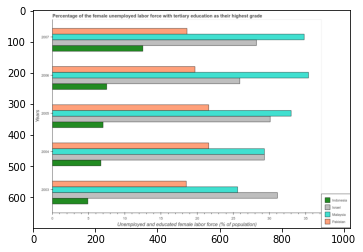

Number of QA =  30





,Years,Malaysia,Israel,Indonesia,Pakistan
0,2006,35.474256,25.760523,7.686396,20.001457
1,2007,34.991136,28.392206,12.672877,18.728107
2,2003,25.661623,31.540197,5.037769,NaN
3,2004,29.356294,29.400131,6.781457,21.826363
4,2005,33.327517,30.332721,7.058790,21.767263


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed female labor force with tertiary education in pakistan in 2003 and that in 2007 ?
PREDICTED =  3.03915576802455
EXPECTED =  -0.1000003814697017




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed female labor force with tertiary education in israel in 2004 and the percentage of the unemployed female labor force with tertiary education in indonesia in 2003 ?
PREDICTED =  -2.1400659239053574
EXPECTED =  24.399999141693073




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gp

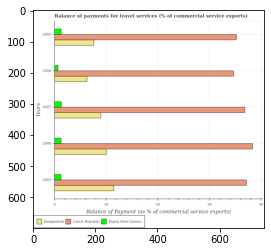

Number of QA =  29





,Years,Papua New Guinea,Czech Republic,Bangladesh
0,2009,1.404412,35.459344,7.736758
1,2006,1.386374,38.576013,10.141117
2,2005,1.374576,37.912287,11.632362
3,2008,0.799770,35.213938,6.507707
4,2007,1.421999,37.341443,9.129488


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for travel services in bangladesh in 2005 and that in 2006 ?
PREDICTED =  1.4912448185937706
EXPECTED =  1.4376819556852993




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for travel services in bangladesh in 2005 and the balance of payments for travel services in czech republic in 2009 ?
PREDICTED =  -23.82698231227903
EXPECTED =  -23.7298361038521




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the balance of payments for travel services in bangladesh and balance of payments for 

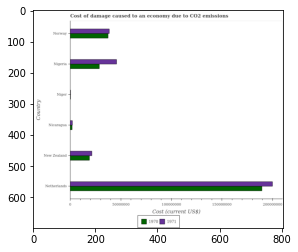

Number of QA =  28





,Country,1971,1970
0,Niger,NaN,NaN
1,Netherlands,3.591874e+08,3.376692e+08
2,New Zealand,3.891825e+07,3.518045e+07
3,Nigeria,8.335821e+07,5.236091e+07
4,Norway,7.004191e+07,6.841463e+07
5,Nicaragua,4.907086e+06,4.496829e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to co2 emissisons in 1971 in new zealand and that in niger ?
PREDICTED =  38918245.580873616
EXPECTED =  21043627.203333586




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to co2 emissisons in 1970 in nicaragua and the cost of damage caused due to co2 emissisons in 1971 in new zealand?
PREDICTED =  -30683621.411024563
EXPECTED =  -19496795.27820249




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to co2 emissisons in 1971 and cost of damage caused due to co2 

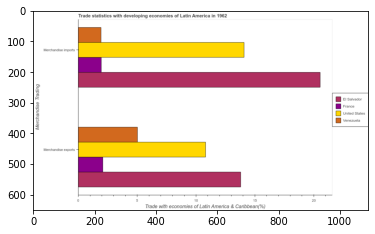

Number of QA =  23





,Merchandise Trading,France,El Salvador,Venezuela,United States
0,Merchandise exports,2.103035,13.916925,5.038549,10.842601
1,Merchandise imports,2.001749,20.561607,1.976502,14.120987


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Trade with economies of Latin America & Caribbean(%)
EXPECTED =  5.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Trade statistics with developing economies of Latin America in 1962
EXPECTED =  Trade statistics with developing economies of Latin America in 1962




		

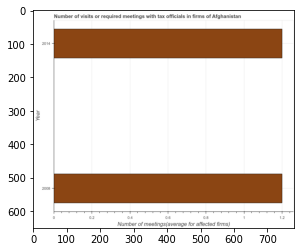

Number of QA =  19





,Year,Number of meetings(average for affected firms)
0,2014,1.199476
1,2008,1.206226


> what is the title of the graph ?
PREDICTED =  Number of visits or required meetings with tax officials in firms of Afghanistan
EXPECTED =  Number of visits or required meetings with tax officials in firms of Afghanistan




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Number of meetings(average for affected firms)
EXPECTED =  Number of meetings(average for affected firms)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of required meetings with tax officials in 2008 and 2014 ?
PREDICTED =  0.006750508748853745
EXPECTED =  0.0




				 3 / 4 = 0.75


> what is the median number of required meetings with tax officials ?
PREDICTED =  None
EXPECTED =  1.2




				 3 / 6 = 0.5


is_built_with_cuda: True
is_

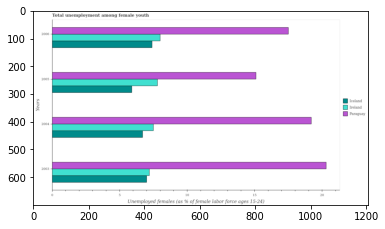

Number of QA =  29





,Years,Iceland,Ireland,Paraguay
0,2006,7.441137,7.995400,17.530924
1,2005,5.939044,7.720753,15.165813
2,2004,6.731919,7.617638,19.179908
3,2003,7.065078,7.265559,20.309228


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed females in in ireland in 2003 and that in 2006 ?
PREDICTED =  -0.7298402671253772
EXPECTED =  -0.8000001907348606




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of unemployed females in in iceland in 2004 and the percentage of unemployed females in in paraguay in 2005 ?
PREDICTED =  -8.433894619294383
EXPECTED =  -8.400000572204561




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percentage of unemployed females in in ireland and percentage of unemployed females in in paraguay ?
PR

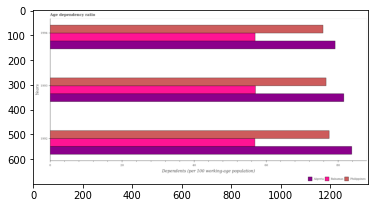

Number of QA =  29





,Years,Algeria,Philippines,Bahamas
0,1992,83.994277,78.159768,57.459061
1,1994,79.747575,76.352664,57.514191
2,1993,81.785334,77.164328,57.471658


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the age dependency ratio in in bahamas in 1994 ?
PREDICTED =  19.17139701517562
EXPECTED =  56.92980610080028




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum age dependency ratio in in algeria ?
PREDICTED =  664.0
EXPECTED =  83.7712807944221




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum age dependency ratio in in bahamas ?
PREDICTED =  664.0
EXPECTED =  56.8736442516269




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the age d

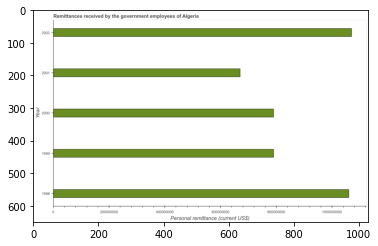

Number of QA =  23





,Year,Personal remittance (current US$)
0,1998,1.058246e+09
1,1999,7.880766e+08
2,2001,6.694502e+08
3,2002,1.066177e+09
4,2000,7.899064e+08


> what is the title of the graph ?
PREDICTED =  Remittances received by the government employees of Algeria
EXPECTED =  Remittances received by the government employees of Algeria




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Personal remittance (current US$)
EXPECTED =  Personal remittance (current US$)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the personal remittances in 1999 and 2001 ?
PREDICTED =  118626405.10930002
EXPECTED =  120000000.0




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median personal remittances ?
PREDICTED =  789906380.8041277
EXPECTED =  790000000.0




				 5 /

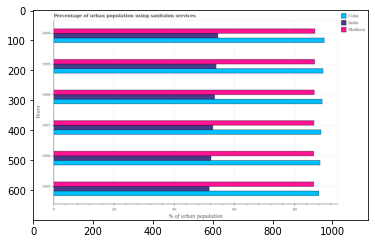

Number of QA =  29





,Years,India,Moldova,Cuba
0,1999,54.609859,NaN,90.127725
1,1998,53.954974,85.698036,89.796903
2,1997,52.355210,87.036840,NaN
3,1995,52.074031,86.762156,87.876260
4,2000,55.282125,NaN,90.458711
5,1996,52.826158,86.812652,88.078466


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population using sanitaion services in cuba in 1996 and that in 1997 ?
PREDICTED =  88.07846638263443
EXPECTED =  -0.29999999999999716




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population using sanitaion services in moldova in 1997 and the percentage of urban population using sanitaion services in india in 1998 ?
PREDICTED =  1.3388032701687251
EXPECTED =  33.00000000000001




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the percentage of urban population using sanitaion serv

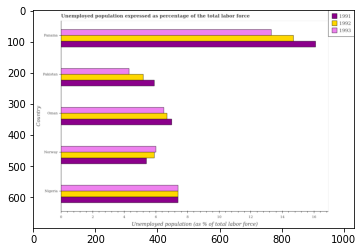

Number of QA =  29





,Country,1992,1993,1991
0,Nigeria,7.440579,7.433282,7.419584
1,Panama,14.673540,13.316447,16.177665
2,Oman,NaN,6.548233,7.032098
3,Pakistan,5.239776,4.330779,5.955344
4,Norway,5.947100,NaN,5.443451


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in in 1992 in norway and that in panama ?
PREDICTED =  -8.7264399017937
EXPECTED =  -8.79999971389767




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in in 1991 in oman and the unemployment in in 1992 in nigeria?
PREDICTED =  -0.38748577120357375
EXPECTED =  -0.400000095367429




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in in 1993 and unemployment in in 1992 in panama ?
PREDICTED =  -8.569442178775446
EXPECTED =  -1.3999996185301988




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_av

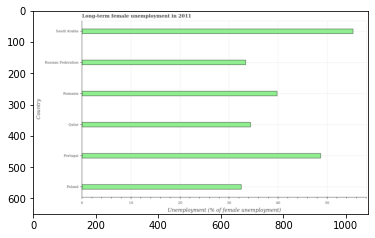

Number of QA =  22





,Country,Unemployment (% of female unemployment)
0,Poland,32.650770
1,Romania,39.918116
2,Qatar,34.195385
3,Saudi Arabia,55.717239
4,Portugal,48.785064
5,Russian Federation,33.511258


> what is the title of the graph ?
PREDICTED =  Long-term female unemployment in 2011
EXPECTED =  Long-term female unemployment in 2011




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Unemployment (% of female unemployment)
EXPECTED =  Unemployment (% of female unemployment)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the long-term female unemployment in portugal and russian federation ?
PREDICTED =  0.16666666666666666
EXPECTED =  15.3




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median long-term female unemployment ?
PREDICTED =  37.05675066981543
EXPECTED =  37.1000003814697




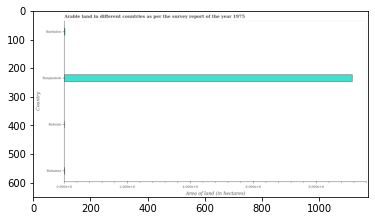

Number of QA =  22





,Country,Area of land (in hectares)
0,Bahrain,NaN
1,Bahamas,0.029629
2,Barbados,0.037913
3,Bangladesh,9.190461


> what is the title of the graph ?
PREDICTED =  Arable land in different countries as per the survey report of the year 1975
EXPECTED =  Arable land in different countries as per the survey report of the year 1975




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Area of land (in hectares)
EXPECTED =  Area of land (in hectares)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the area of land in bangladesh and barbados ?
PREDICTED =  9.152548098988058
EXPECTED =  9128000.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median area of land ?
PREDICTED =  0.037912966101533344
EXPECTED =  115

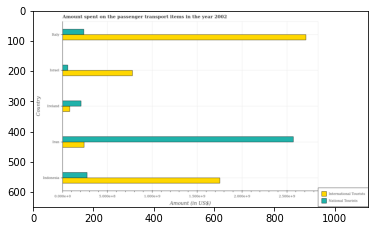

Number of QA =  28





,Country,International Tourists,National Tourists
0,Ireland,1.551792,3.838243
1,Israel,NaN,1.146604
2,Italy,49.018682,4.407893
3,Indonesia,31.726001,5.086517
4,Iran,4.398765,46.415866


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on transport items of international tourists in ireland and that in italy ?
PREDICTED =  -47.4668897129689
EXPECTED =  -2632000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on transport items of international tourists in israel and the amount spent on transport items of national tourists in italy ?
PREDICTED =  -49.01868189804322
EXPECTED =  542000000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on transport items of national tourists and amount spent on transport items of internatio

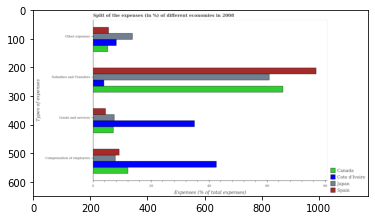

Number of QA =  29





,Types of expenses,Japan,Spain,Cote d'Ivoire,Canada
0,Compensation of employees,7.782641,9.176183,42.828254,12.173604
1,Goods and services,7.500354,4.474004,35.162126,7.254191
2,Other expenses,13.696819,5.419614,8.136421,5.179855
3,Subsidies and Transfers,60.996142,76.992459,3.874206,65.853109


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount spent on goods and services in japan and that in spain ?
PREDICTED =  -3.474003624775949
EXPECTED =  2.9956239407771523




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount spent on compensation of employees in spain and the percentage of amount spent on other expenses in japan ?
PREDICTED =  1.3935422300343792
EXPECTED =  -4.56547728189862




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.


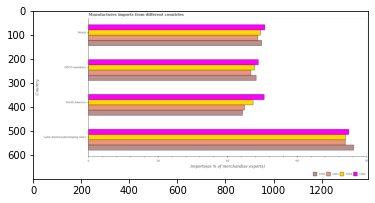

Number of QA =  30





,Country,1965,1964,1962,1963
0,OECD members,49.048708,NaN,48.662577,46.736153
1,Latin America(developing only),75.819266,73.842527,76.143341,74.012343
2,World,NaN,49.436530,50.007154,49.013743
3,North America,50.738302,47.526572,44.338546,45.182142


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in 1962 in latin america(developing only) and that in world ?
PREDICTED =  0.0
EXPECTED =  26.45055466493261




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_avail

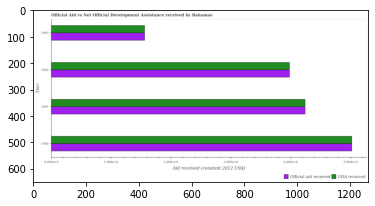

Number of QA =  28





,Year,Official aid received,ODA received
0,1991,4.267057,4.269601
1,1992,4.006585,3.999331
2,1993,1.585583,1.583547
3,1990,5.057911,5.016800


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received in 1990 and that in 1993 ?
PREDICTED =  3.433252682020871
EXPECTED =  3460000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received in 1993 and the official aid received in 1991 ?
PREDICTED =  -2.6860541213508244
EXPECTED =  -2680000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the official aid received and oda received ?
PREDICTED =  0.0
EXPECTED =  0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training st

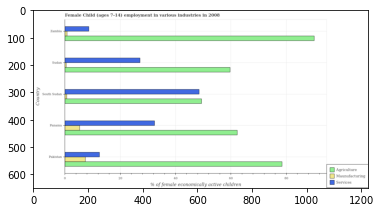

Number of QA =  29





,Country,Agriculture,Maunufacturing,Services
0,Sudan,60.321003,0.655927,27.491384
1,Pakistan,78.893850,7.607658,12.804709
2,Zambia,90.330435,0.982761,8.892264
3,South Sudan,49.477831,0.883405,48.614813
4,Panama,62.629913,5.542579,32.541518


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active children in services in pakistan and that in sudan ?
PREDICTED =  -14.686674259846422
EXPECTED =  -14.65




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active children in manufacturing in panama and the percentage of economically active children in agriculture in south sudan ?
PREDICTED =  13.152082314145424
EXPECTED =  -44.06




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active children in services and percentage of economically active children

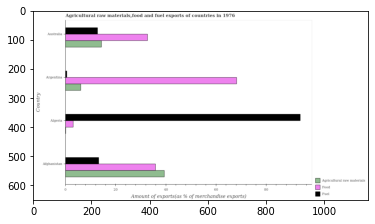

Number of QA =  29





,Country,Agricultural raw materials,Fuel,Food
0,Australia,14.581532,13.180278,33.666025
1,Afghanistan,39.877240,13.721603,36.567131
2,Argentina,6.335460,0.736795,NaN
3,Algeria,NaN,0.345852,3.296915


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of fuel exports in algeria and that in australia ?
PREDICTED =  -12.834425386097006
EXPECTED =  80.843




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of fuel exports in australia and the percentage of food exports in afghanistan ?
PREDICTED =  -0.5413250467621324
EXPECTED =  -23.104021399123912




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of fuel exports and percentage of food exports in argentina ?
PREDICTED =  12.984807297729777
EXPECTED =  -67.74




				 0 / 3 = 0.0


is_built_with_cuda: True
i

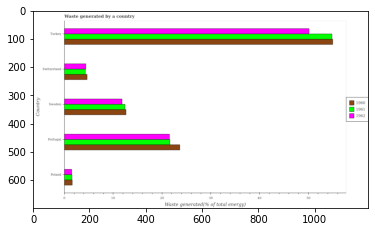

Number of QA =  29





,Country,1962,1961,1960
0,Poland,1.598328,1.689508,1.733717
1,Turkey,50.293407,55.232272,54.588499
2,Switzerland,4.536451,4.457152,4.779503
3,Sweden,11.990228,12.626689,12.736070
4,Portugal,21.716920,21.827755,23.806636


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total waste generated in 1960 in portugal and that in turkey ?
PREDICTED =  -30.781862396683582
EXPECTED =  -31.33877666284881




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total waste generated in 1961 in turkey and the total waste generated in 1960 in portugal?
PREDICTED =  33.404516771013995
EXPECTED =  31.182154409831103




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total waste generated in 1962 and total waste generated in 1961 in switzerland ?
PREDICTED =  85.67818174596736
EXPECTED =  0.10963383962868267




				 1 / 3 = 0.

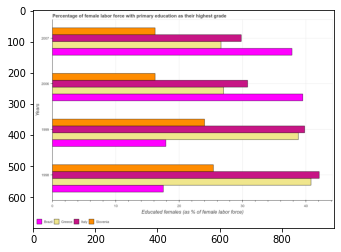

Number of QA =  30





,Years,Slovenia,Greece,Brazil,Italy
0,2007,NaN,NaN,38.289207,29.839565
1,2006,16.285717,27.304065,39.700976,30.611269
2,1999,24.202981,39.106386,18.147220,40.730715
3,1998,25.629660,41.012630,17.709036,42.652624


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force with primary education in brazil in 2006 and that in 2007 ?
PREDICTED =  1.4117691778032793
EXPECTED =  1.7000007629395029




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force with primary education in slovenia in 2007 and the percentage of female labor force with primary education in greece in 1999 ?
PREDICTED =  -7.9172646936134825
EXPECTED =  -22.599998474120998




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the percentage of female labor force with primary

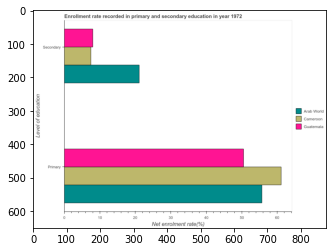

Number of QA =  23





,Level of education,Arab World,Cameroon,Guatemala
0,Secondary,21.271890,7.589278,8.240803
1,NaN,55.822062,62.043539,50.763226


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in primary education in arab world and that in guatemala ?
PREDICTED =  55.82206186087478
EXPECTED =  5.166711135253898




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in secondary education in arab world and the enrollment rate in primary education in guatemala ?
PREDICTED =  13.031087654706116
EXPECTED =  -29.4139296575928




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in secondary education and enrollment rate in primary education in cameroon ?
PREDICTED =  13.682612653718557
EXPECTE

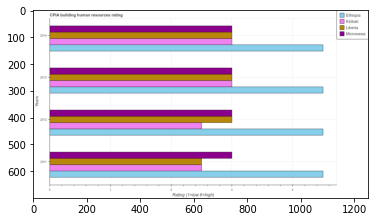

Number of QA =  30





,Years,Micronesia,Liberia,Ethiopia,Kiribati
0,2014,2.996419,NaN,4.478184,3.021652
1,2011,2.983683,2.510308,4.507472,2.516561
2,2012,3.006467,3.000399,4.503509,2.523133
3,2013,3.011334,3.002678,4.521455,3.009598


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in micronesia in 2012 and that in 2013 ?
PREDICTED =  -0.004866857568916583
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in micronesia in 2014 and the cpia rating in liberia in 2012 ?
PREDICTED =  -0.010048392500183745
EXPECTED =  0.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cpia rating in ethiopia in 2012 to that in 2014 ?
PREDICTED =  1.00565

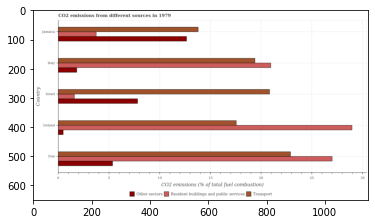

Number of QA =  29





,Country,Resident buildings and public services,Transport,Other sectors
0,Ireland,29.100463,17.691569,0.534820
1,Israel,1.641856,20.798909,7.899270
2,Jamaica,3.736907,13.828217,12.514538
3,Italy,20.899590,19.566447,1.864388
4,Iran,27.082693,22.970263,5.377811


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of co2 emissions from transport in ireland and that in jamaica ?
PREDICTED =  3.8633519129817326
EXPECTED =  3.763




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of co2 emissions from transport in israel and the percentage of co2 emissions from other sectors in italy ?
PREDICTED =  1.232461256179814
EXPECTED =  19.02067423131119




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of co2 emissions from other sectors and percentage of co2 emissions from transport in jamaica ?
PREDICTED =  -10.82821702936106

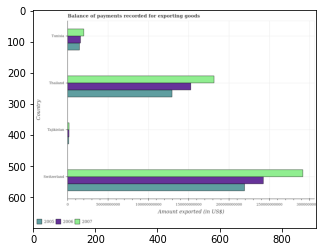

Number of QA =  29





,Country,2007,2005,2006
0,Tunisia,3.778089e+10,2.807641e+10,3.037848e+10
1,Switzerland,5.296516e+11,3.980467e+11,4.374860e+11
2,Thailand,3.259528e+11,NaN,2.801560e+11
3,Tajikistan,4.468788e+09,3.773727e+09,4.312561e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount exported in 2006 in thailand and that in tunisia ?
PREDICTED =  249777556538.8665
EXPECTED =  136637938600.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount exported in 2007 in thailand and the amount exported in 2006 in tajikistan?
PREDICTED =  321484010564.35736
EXPECTED =  179702986400.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount exported in 2005 and amount exported in 2006 in switzerland ?
PREDICTED =  -405635831736.9232
EXPECTED =  -23351000000.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_ava

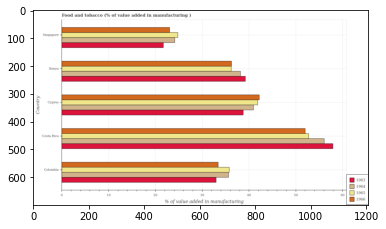

Number of QA =  30





,Country,1963,1966,1964,1965
0,Colombia,33.266008,33.539826,35.813653,35.819917
1,Costa Rica,57.944069,52.499210,55.971689,53.002151
2,Cyprus,NaN,42.237026,41.122830,NaN
3,Kenya,39.114757,36.500581,38.095864,36.611055
4,Singapore,21.837530,23.340138,NaN,24.856867


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added in manufacturing food and tobacco in 1964 in cyprus and that in singapore ?
PREDICTED =  -36.122829773572434
EXPECTED =  16.83016743578329




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added in manufacturing food and tobacco in 1963 in kenya and the value added in manufacturing food and tobacco in 1966 in costa rica?
PREDICTED =  -92.05882639191253
EXPECTED =  -12.787599486287




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added in manufacturing food and tobacco in 1965 and value added in manufacturing food 

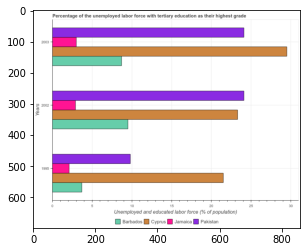

Number of QA =  30





,Years,Jamaica,Cyprus,Barbados,Pakistan
0,2003,3.067274,29.579252,8.827210,24.180326
1,2002,2.949704,23.450001,9.552187,24.260453
2,1995,2.181392,21.617135,3.803758,9.830322


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed labor force with tertiary education in barbados in 1995 and that in 2002 ?
PREDICTED =  -5.7484284263010235
EXPECTED =  -5.799999952316281




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed labor force with tertiary education in pakistan in 2003 and the percentage of the unemployed labor force with tertiary education in barbados in 2002 ?
PREDICTED =  -0.08012762050240951
EXPECTED =  14.600000381469691




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the percentage of

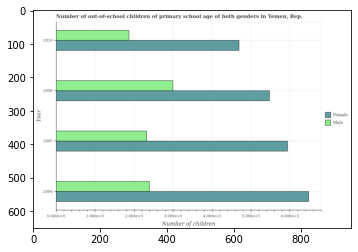

Number of QA =  28





,Year,Female,Male
0,2004,6.558306,2.431138
1,2010,4.738768,1.899722
2,2005,5.996398,2.372339
3,2008,5.516292,3.024797


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of female out-of-school students in 2008 and that in 2010 ?
PREDICTED =  0.7775248505351984
EXPECTED =  78049




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of female out-of-school students in 2008 and the number of male out-of-school students in 2010 ?
PREDICTED =  0.7775248505351984
EXPECTED =  360160




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the number of male out-of-school students and number of female out-of-school students ?
PREDICTED =  3.024796963533362
EXPECTED =  -247512




				 0 / 3 = 0.

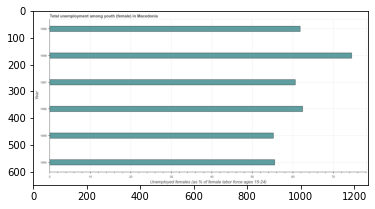

Number of QA =  23





,Year,Unemployed females (as % of female labor force ages 15-24)
0,1999,61.858067
1,1998,74.356057
2,1994,55.345803
3,1995,55.195757
4,1997,60.617533
5,1996,62.444499


> what is the title of the graph ?
PREDICTED =  Total unemployment among youth (female) in Macedonia
EXPECTED =  Total unemployment among youth (female) in Macedonia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Unemployed females (as % of female labor force ages 15-24)
EXPECTED =  Unemployed females (as % of female labor force ages 15-24)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed female youth population in 1996 and 1997 ?
PREDICTED =  1.8269666451207058
EXPECTED =  1.8




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed female youth population ?
PREDICTED =

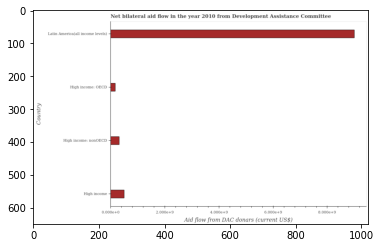

Number of QA =  22





,Country,Aid flow from DAC donars (current US$)
0,High income,0.519860
1,High income: nonOECD,0.334294
2,High income: OECD,0.192817
3,Latin America(all income levels),9.004375


> what is the title of the graph ?
PREDICTED =  Net bilateral aid flow in the year 2010 from Development Assistance Committee
EXPECTED =  Net bilateral aid flow in the year 2010 from Development Assistance Committee




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Aid flow from DAC donars (current US$)
EXPECTED =  Aid flow from DAC donars (current US$)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flows from dac donors in high income: oecd and latin america(all income levels) ?
PREDICTED =  -8.811558915079685
EXPECTED =  -8825460000.0




				 3 / 4 = 0.75


> what is the median net bilateral aid flows from dac donors ?
PREDICTED =  None
EXPECTED =  410665000.1




				 3 / 6 = 0.5


i

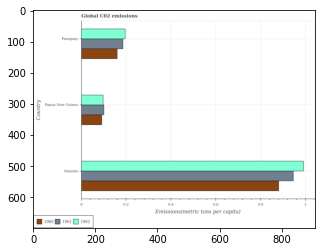

Number of QA =  29





,Country,1962,1961,1960
0,Panama,0.993474,0.954960,0.893615
1,Papua New Guinea,0.099459,0.104494,0.095160
2,Paraguay,0.198372,0.190656,0.162843


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in in 1962 in panama and that in papua new guinea ?
PREDICTED =  0.8940150321057544
EXPECTED =  0.8939838575798408




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in in 1960 in panama and the amount of co2 emitted in in 1962 in papua new guinea?
PREDICTED =  0.7984548576880963
EXPECTED =  0.7831952487699275




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in in 1962 and amount of co2 emitted in in 1960 in paraguay ?
PREDICTED =  2.0
EXPECTED =  0.03571406526670598




		

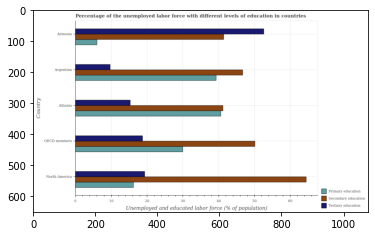

Number of QA =  29





,Country,Secondary education,Tertiary education,Primary education
0,Armenia,41.454903,52.467326,6.167583
1,Argentina,46.570018,9.779190,NaN
2,OECD members,49.748478,18.788799,NaN
3,North America,64.652889,19.391645,16.334538
4,Albania,41.172403,15.451039,40.422643


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received tertiary education in armenia and that in north america ?
PREDICTED =  33.07568072551821
EXPECTED =  33.26




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received secondary education in oecd members and the percentage of labor force who received tertiary education in north america ?
PREDICTED =  -14.904411646897074
EXPECTED =  30.79118391771081




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Eva

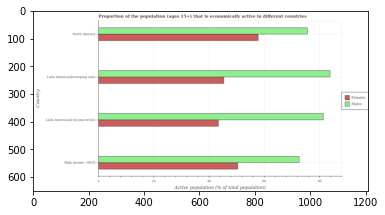

Number of QA =  28





,Country,Males,Females
0,North America,76.162078,58.361907
1,Latin America(all income levels),82.013600,43.850685
2,Latin America(developing only),85.011112,46.070537
3,High income: OECD,73.366652,51.337528


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active female population in high income: oecd and that in latin america(developing only) ?
PREDICTED =  5.266991336465395
EXPECTED =  5.018




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active female population in latin america(developing only) and the percentage of economically active male population in latin america(all income levels) ?
PREDICTED =  0.0
EXPECTED =  -36.0066113636736




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Tra

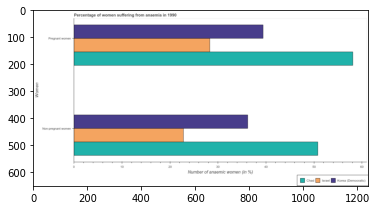

Number of QA =  23





,Women,Israel,Chad,Korea (Democratic)
0,Non-pregnant women,22.769704,51.168376,36.197857
1,Pregnant women,28.195597,58.281669,39.095515


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of pregnant anaemic women in israel and that in chad ?
PREDICTED =  -30.08607163149674
EXPECTED =  -29.8




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of pregnant anaemic women in korea (democratic) and the percentage of non-pregnant anaemic women in israel ?
PREDICTED =  2.8976575966380054
EXPECTED =  16.599999999999998




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of non-pregnant anaemic women and percentage of pregnant anaemic women in korea (democratic) ?
PREDICTED =  -35.19785746895264
EXPECTE

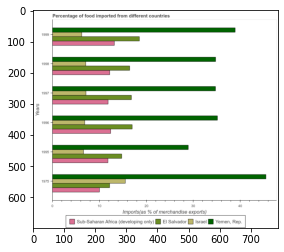

Number of QA =  30





,Years,Sub-Saharan Africa (developing only),Israel,El Salvador,"Yemen, Rep."
0,1996,NaN,6.865368,17.136762,35.280823
1,1999,13.233352,6.305236,18.695114,39.034078
2,1998,12.310615,7.104672,16.390703,34.981321
3,1995,11.902824,6.738991,14.870913,28.826025
4,1975,10.197771,15.646177,12.370498,45.891182
5,1997,11.920772,7.194612,16.840742,34.702650


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in israel in 1975 and that in 1997 ?
PREDICTED =  8.451564747569101
EXPECTED =  8.39596444183809




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in el salvador in 1998 and the percentage of imports to different countries in yemen, rep. in 1995 ?
PREDICTED =  1.5197895475413787
EXPECTED =  -12.487093076812197




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the percentage of imports to different countries in yemen, rep. and percentage

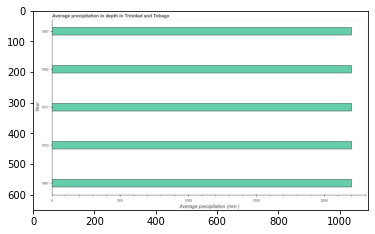

Number of QA =  23





,Year,Average precipitation (mm )
0,1982,2205.027952
1,1967,2211.471947
2,1987,2201.881357
3,1977,2196.876930
4,1972,2203.796112


> what is the title of the graph ?
PREDICTED =  Average precipitation in depth in Trinidad and Tobago
EXPECTED =  Average precipitation in depth in Trinidad and Tobago




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Average precipitation (mm )
EXPECTED =  Average precipitation (mm )




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the average precipitation in depth in 1972 and 1982 ?
PREDICTED =  -1.2318406482841056
EXPECTED =  0.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median average precipitation in depth ?
PREDICTED =  2196.8769300406343
EXPECTED =  2200.0




				 4 / 5 = 0.8


is_

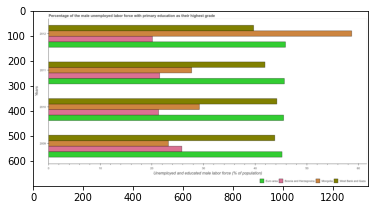

Number of QA =  30





,Years,Bosnia and Herzegovina,West Bank and Gaza,Mongolia,Euro area
0,2010,NaN,44.100389,29.464018,45.409101
1,2009,25.860521,43.445650,23.272766,45.420137
2,2012,NaN,39.810077,58.836077,45.912184
3,2011,NaN,41.623703,27.971577,45.704380


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed male labor force with primary education in west bank and gaza in 2009 and that in 2012 ?
PREDICTED =  -3.6355733061355764
EXPECTED =  4.099998474120994




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed male labor force with primary education in mongolia in 2010 and the percentage of the unemployed male labor force with primary education in west bank and gaza in 2012 ?
PREDICTED =  -10.346058588919455
EXPECTED =  -10.500000000000004




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with

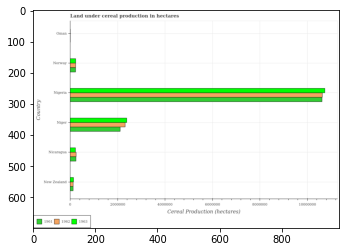

Number of QA =  29





,Country,1963,1962,1961
0,Oman,NaN,NaN,NaN
1,New Zealand,1.679277e+05,1.582816e+05,1.527457e+05
2,Nigeria,1.075523e+07,NaN,1.071624e+07
3,Norway,2.595827e+05,2.491080e+05,2.529124e+05
4,Nicaragua,2.402135e+05,2.751284e+05,2.725423e+05
5,Niger,2.395292e+06,2.358599e+06,2.141125e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the land under cereal production in 1961 in new zealand and that in nicaragua ?
PREDICTED =  -119796.56395966365
EXPECTED =  -119125.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the land under cereal production in 1963 in nicaragua and the land under cereal production in 1962 in oman?
PREDICTED =  240213.49218715608
EXPECTED =  220500.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 4 = 0.25


is_built_with_

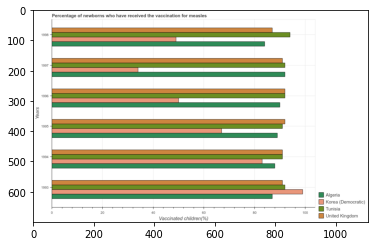

Number of QA =  30





,Years,United Kingdom,Algeria,Tunisia,Korea (Democratic)
0,1994,90.538407,88.817311,91.438826,83.805991
1,1998,89.733722,83.375455,94.125252,NaN
2,1993,90.888184,88.692802,93.423014,NaN
3,1997,90.864931,92.363555,92.605467,34.303742
4,1996,93.211006,90.373950,NaN,50.655283
5,1995,92.434555,89.603181,91.099651,67.068279


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of vaccinated children in korea (democratic) in 1994 and that in 1997 ?
PREDICTED =  49.50224876122472
EXPECTED =  49




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of vaccinated children in tunisia in 1993 and the percentage of vaccinated children in algeria in 1996 ?
PREDICTED =  93.42301402206428
EXPECTED =  2.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the percentage of vaccinated children in algeria and percentage of vaccinated children in united kingdom ?
PREDICTED =  -6.35826772981477


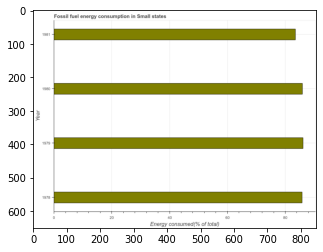

Number of QA =  23





,Year,Energy consumed(% of total)
0,1980,86.224872
1,1981,83.902575
2,1978,86.227211
3,1979,86.318615


> what is the title of the graph ?
PREDICTED =  Fossil fuel energy consumption in Small states
EXPECTED =  Fossil fuel energy consumption in Small states




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Energy consumed(% of total)
EXPECTED =  Energy consumed(% of total)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the fossil fuel energy consumption in 1979 and 1981 ?
PREDICTED =  2.416040020295341
EXPECTED =  2.633




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median fossil fuel energy consumption ?
PREDICTED =  86.22604167541361
EXPECTED =  85.87493026440302




				 4 / 5 = 0.8


is_buil

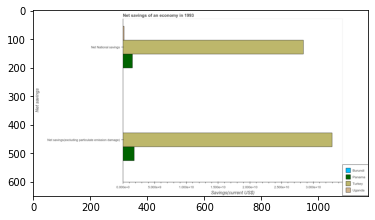

Number of QA =  20





,Net savings,Turkey,Panama,Burundi,Uganda
0,Net National savings,28.590168,1.536119,NaN,NaN
1,Net savings(excluding particulate emission dam...,33.152377,1.830609,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net national savings in turkey and the net savings(excluding particulate emission damage) in burundi ?
PREDICTED =  28.590167714191235
EXPECTED =  28437108078.1124




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Savings(current US$)
EXPECTED =  5000000000.0




				 0 / 5 = 0.0


> what is the title of

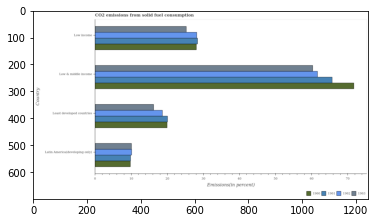

Number of QA =  30





,Country,1963,1962,1961,1960
0,Low income,25.517802,28.519340,28.562317,28.210400
1,Low & middle income,60.455996,61.534666,65.904997,71.707935
2,Latin America(developing only),10.171938,10.253865,10.014392,9.982264
3,Least developed countries,16.395729,18.962242,20.147381,20.145062


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1961 in latin america(developing only) and that in least developed countries ?
PREDICTED =  -20.147381206043086
EXPECTED =  -10.24425367664391




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1962 in least developed countries and the total co2 emitted in 1960 in low & middle income?
PREDICTED =  -71.09176343143041
EXPECTED =  -53.08004763215639




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1962 and total co2 emitted in 1963 in latin america(developing only) ?
PREDICTED = 

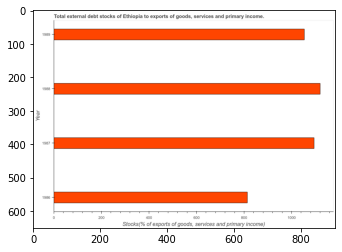

Number of QA =  23





,Year,"Stocks(% of exports of goods, services and primary income)"
0,1988,1126.195995
1,1989,1058.678324
2,1986,811.783931
3,1987,1095.530477


> what is the title of the graph ?
PREDICTED =  Total external debt stocks of Ethiopia to exports of goods, services and primary income.
EXPECTED =  Total external debt stocks of Ethiopia to exports of goods, services and primary income.




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Stocks(% of exports of goods, services and primary income)
EXPECTED =  Stocks(% of exports of goods, services and primary income)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the external debt stocks in 1986 and 1987 ?
PREDICTED =  -283.74654621008995
EXPECTED =  -280.874




				 4 / 4 = 1.0


> what is the median external debt stocks ?
PREDICTED =  None
EXPECTED =  1074.05932220644




				 4 / 6 = 0.6667


is_built_with_cuda: T

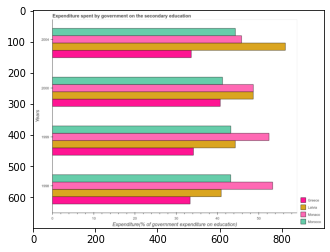

Number of QA =  30





,Years,Latvia,Greece,Monaco,Morocco
0,2004,56.577072,33.475511,45.799195,43.957106
1,1999,44.584468,34.384550,52.620153,43.113324
2,2000,49.127425,40.719791,48.755436,41.500975
3,1998,NaN,33.447462,53.519186,43.327473


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure spent by government on the secondary education in monaco in 1999 and that in 2004 ?
PREDICTED =  6.820957471633193
EXPECTED =  6.646942138671825




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure spent by government on the secondary education in greece in 2000 and the expenditure spent by government on the secondary education in morocco in 1999 ?
PREDICTED =  6.335240333938664
EXPECTED =  -2.5552101135253977




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the expenditure spent by government on the se

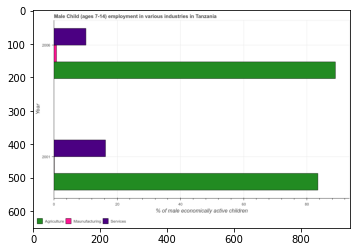

Number of QA =  26





,Year,Agriculture,Maunufacturing,Services
0,2006,89.648647,1.001224,10.268054
1,2001,83.609519,NaN,16.569774


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active children in services in 2001 and that in 2006 ?
PREDICTED =  6.301719707366635
EXPECTED =  6.181




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active children in services in 2006 and the percentage of economically active children in agriculture in 2001 ?
PREDICTED =  -6.301719707366635
EXPECTED =  -73.349640038




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percentage of economically active children in agriculture and percentage of economically active ch

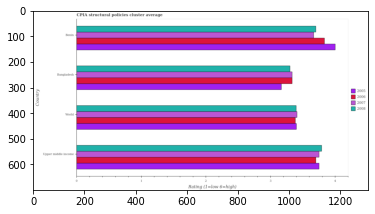

Number of QA =  30





,Country,2007,2005,2008,2006
0,Benin,3.671554,4.022144,3.704044,3.853309
1,Bangladesh,3.327747,3.194948,3.307160,3.348094
2,World,3.416476,3.409726,3.403498,3.383718
3,Upper middle income,3.763589,3.758453,3.811939,3.721696


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2008 in benin and that in world ?
PREDICTED =  0.30054537119943125
EXPECTED =  0.30400000000000027




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2008 in world and the cpia rating in 2005 in upper middle income?
PREDICTED =  -0.4084411101622307
EXPECTED =  -0.3540000000000001




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2008 and cpia rating in 2006 in benin ?
PREDICTED =  -0.04136960017918545
EXPECTED =  -0.13333333333332886




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_avai

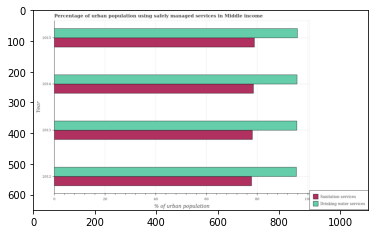

Number of QA =  28





,Year,Drinking water services,Sanitation services
0,2015,95.933999,79.598170
1,2013,96.618472,78.435741
2,2014,96.391480,78.880679
3,2012,95.962493,78.304079


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population who used sanitation services in 2013 and that in 2014 ?
PREDICTED =  -0.44493795699520433
EXPECTED =  -0.402




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population who used drinking water services in 2014 and the percentage of urban population who used sanitation services in 2013 ?
PREDICTED =  -0.2269917794385634
EXPECTED =  17.603618008710498




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of urban population who used drinking water services and perc

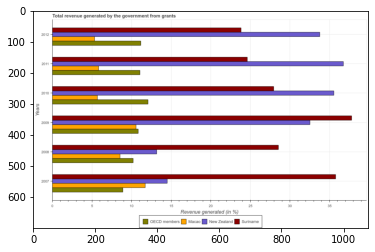

Number of QA =  30





,Years,OECD members,New Zealand,Macao,Suriname
0,2010,12.169065,35.726416,5.721668,28.042637
1,2011,11.188249,35.973325,5.896355,24.848814
2,2012,11.351817,33.699165,5.353258,23.913297
3,2007,8.936909,14.568436,11.659197,35.971552
4,2008,10.283340,13.165222,8.578428,28.463511
5,2009,10.786433,NaN,NaN,38.067555


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total revenue generated in new zealand in 2008 and that in 2011 ?
PREDICTED =  -22.808102686637707
EXPECTED =  -23.582651547736894




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total revenue generated in new zealand in 2011 and the total revenue generated in suriname in 2008 ?
PREDICTED =  22.808102686637707
EXPECTED =  8.207806394981898




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the total revenue generated in suriname and total revenue generated in macao ?
PREDICTED =  0.8586484821553668
EXPECTED =  22.2705035933

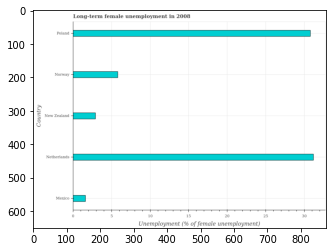

Number of QA =  22





,Country,Unemployment (% of female unemployment)
0,New Zealand,3.015839
1,Poland,31.078639
2,Netherlands,31.500360
3,Norway,5.893848
4,Mexico,1.681774


> what is the title of the graph ?
PREDICTED =  Long-term female unemployment in 2008
EXPECTED =  Long-term female unemployment in 2008




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Unemployment (% of female unemployment)
EXPECTED =  Unemployment (% of female unemployment)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the long-term female unemployment in mexico and new zealand ?
PREDICTED =  -1.3340646055977434
EXPECTED =  -1.3




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median long-term female unemployment ?
PREDICTED =  5.893848453462801
EXPECTED =  5.800000190734861




				 5 

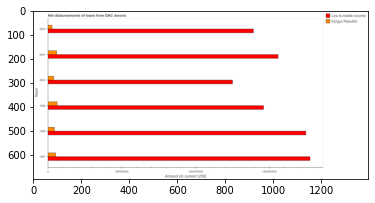

Number of QA =  28





,Years,Kyrgyz Republic,Low & middle income
0,2002,5.527080e+07,2.508759e+09
1,2001,1.094584e+08,2.812777e+09
2,1998,8.253856e+07,3.185754e+09
3,1997,9.846579e+07,3.195548e+09
4,2000,7.401824e+07,2.253448e+09
5,1999,1.160116e+08,2.626359e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loans disbursed in kyrgyz republic in 2000 and that in 2002 ?
PREDICTED =  18747439.187371336
EXPECTED =  11037000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loans disbursed in low & middle income in 1998 and the amount of loans disbursed in kyrgyz republic in 2002 ?
PREDICTED =  676995441.6550889
EXPECTED =  1718806000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the amount of loans disbursed in kyrgyz republic and amount of loans disbursed in low & middle income ?
PREDICTED =  -160468812

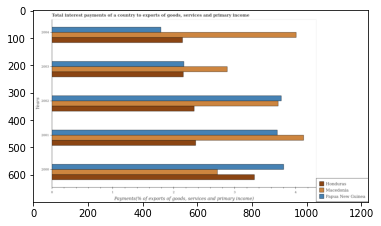

Number of QA =  29





,Years,Papua New Guinea,Macedonia,Honduras
0,2003,2.214642,2.893913,2.190233
1,2000,3.872167,2.715353,3.376691
2,2004,1.807587,4.000534,2.166563
3,2001,3.708759,4.143554,2.393735
4,2002,3.781332,3.728656,2.358290


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total interest payments in papua new guinea in 2000 and that in 2004 ?
PREDICTED =  2.06457919663633
EXPECTED =  2.01436505853402




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total interest payments in honduras in 2000 and the total interest payments in papua new guinea in 2001 ?
PREDICTED =  0.982956776839778
EXPECTED =  -0.37466050885746016




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the total interest payments in papua new guinea and total interest payments in honduras ?
PREDICTED =  10.38448789101614
EXPECTED 

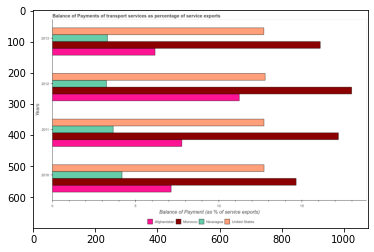

Number of QA =  30





,Years,Morocco,Afghanistan,Nicaragua,United States
0,2012,18.141548,11.290283,3.268638,12.893884
1,2013,16.428515,6.236047,3.378878,12.749046
2,2011,17.389681,7.834101,3.674017,12.775563
3,2010,14.785187,7.252666,4.194914,12.733562


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services in nicaragua in 2012 and that in 2013 ?
PREDICTED =  -0.11024002574388714
EXPECTED =  -0.0583329921000697




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of transport services in united states in 2010 and the balance of payments of transport services in morocco in 2012 ?
PREDICTED =  -0.16032200436514543
EXPECTED =  -5.2666596527983




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the balance of payments of transport services in nicaragua and balance of payment

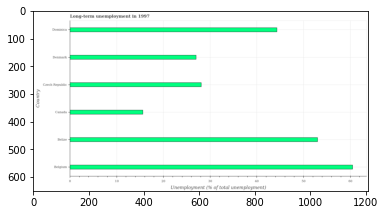

Number of QA =  22





,Country,Unemployment (% of total unemployment)
0,Canada,15.791526
1,Dominica,44.461473
2,Belize,53.078554
3,Belgium,59.990884
4,Denmark,27.276446
5,Czech Republic,28.340971


> what is the title of the graph ?
PREDICTED =  Long-term unemployment in 1997
EXPECTED =  Long-term unemployment in 1997




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Unemployment (% of total unemployment)
EXPECTED =  Unemployment (% of total unemployment)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the long-term unemployment in belgium and czech republic ?
PREDICTED =  31.649912697133818
EXPECTED =  32.4




				 4 / 4 = 1.0


> what is the median long-term unemployment ?
PREDICTED =  None
EXPECTED =  36.199999809265094




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of t

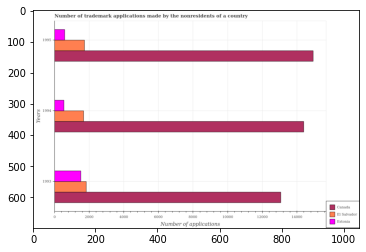

Number of QA =  29





,Years,Estonia,E] Salvador,Canada
0,1995,617.629784,1763.272337,14961.225787
1,1993,1562.753884,1878.727996,13106.008658
2,1994,578.388556,1713.617036,14519.020255


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by the nonresidents in canada in 1994 and that in 1995 ?
PREDICTED =  0.0
EXPECTED =  -547.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by the nonresidents in el salvador in 1993 and the number of trademark applications made by the nonresidents in canada in 1995 ?
PREDICTED =  1.0
EXPECTED =  -13104.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1993, what is the difference between the number of trademark applications made by the nonresidents in estonia and number of tradema

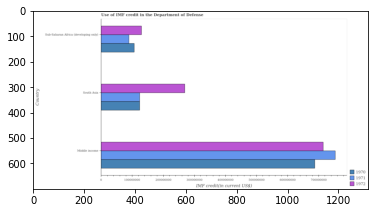

Number of QA =  29





,Country,1972,1971,1970
0,South Asia,2.725821e+08,1.263570e+08,1.265719e+08
1,Middle income,7.237359e+08,7.519746e+08,6.913358e+08
2,Sub-Saharan Africa (developing only),1.331285e+08,9.119980e+07,1.087980e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the imf credit in the department of defense in 1970 in middle income and that in sub-saharan africa (developing only) ?
PREDICTED =  582537758.4207119
EXPECTED =  581020000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the imf credit in the department of defense in 1970 in middle income and the imf credit in the department of defense in 1971 in south asia?
PREDICTED =  564978781.5813463
EXPECTED =  563510000.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the imf credit in the department of defense in 1971 and imf credit in the department o

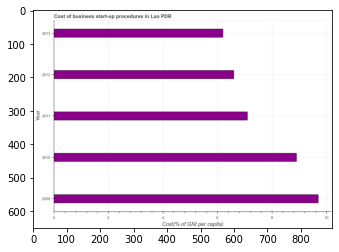

Number of QA =  23





,Year,Cost(% of GNI per capita)
0,2009,9.743194
1,2010,8.881317
2,2013,6.252241
3,2011,7.112394
4,2012,6.616152


> what is the title of the graph ?
PREDICTED =  Cost of business start-up procedures in Lao PDR
EXPECTED =  Cost of business start-up procedures in Lao PDR




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Cost(% of GNI per capita)
EXPECTED =  Cost(% of GNI per capita)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of business startup procedures in 2010 and 2013 ?
PREDICTED =  2.6290754792367537
EXPECTED =  2.7




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median cost of business startup procedures ?
PREDICTED =  2011.0
EXPECTED =  7.1




				 4 / 5 = 0.8


is_built_with_cuda: True
i

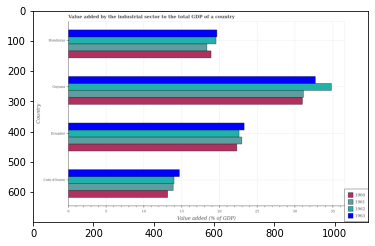

Number of QA =  30





,Country,1963,1962,1961,1960
0,Ecuador,23.154261,22.430251,22.879025,22.311325
1,Cote d'Ivoire,14.676733,13.938571,13.926062,13.144469
2,Guyana,32.481461,34.572875,31.002970,30.869887
3,Honduras,19.608281,19.416084,18.231836,18.785735


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector to the total gdp in 1961 in cote d'ivoire and that in guyana ?
PREDICTED =  -17.076908825743153
EXPECTED =  -17.24294280699361




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector to the total gdp in 1962 in honduras and the value added by the industrial sector to the total gdp in 1960 in ecuador?
PREDICTED =  -3.0141666592068646
EXPECTED =  -2.751877308137999




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector to the total gdp in 196

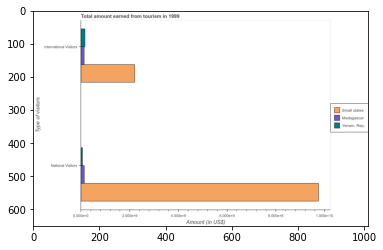

Number of QA =  23





,Type of visitors,Small states,"Yemen, Rep.",Madagascar
0,International Visitors,2.218497,0.191116,0.152172
1,National Visitors,9.768756,0.085480,0.160164


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from international visitors in small states and that in madagascar ?
PREDICTED =  0.0
EXPECTED =  2072571599.8983898




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from international visitors in small states and the amount earned from national visitors in madagascar ?
PREDICTED =  0.0
EXPECTED =  2068571599.8983898




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the am

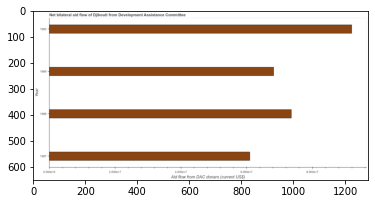

Number of QA =  23





,Year,Aid flow from DAC donars (current US$)
0,1990,9.172049
1,1989,6.825590
2,1987,6.134861
3,1988,7.353775


> what is the title of the graph ?
PREDICTED =  Net bilateral aid flow of Djibouti from Development Assistance Committee
EXPECTED =  Net bilateral aid flow of Djibouti from Development Assistance Committee




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Aid flow from DAC donars (current US$)
EXPECTED =  Aid flow from DAC donars (current US$)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flows from dac donors in 1987 and 1990 ?
PREDICTED =  -3.037187894252754
EXPECTED =  -30970000.0




				 3 / 4 = 0.75


> what is the median net bilateral aid flows from dac donors ?
PREDICTED =  None
EXPECTED =  70905000.0




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Tra

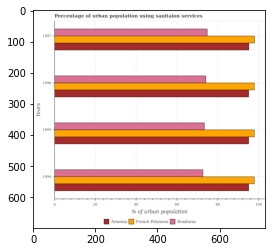

Number of QA =  29





,Years,Armenia,French Polynesia,Honduras
0,1997,96.703484,99.332923,75.207856
1,1994,96.674938,98.327483,73.802167
2,1995,96.533722,99.023231,74.407898
3,1996,96.485139,99.147263,75.377784


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population using sanitaion services in honduras in 1994 and that in 1995 ?
PREDICTED =  -0.6057313322142477
EXPECTED =  -0.7000000000000028




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population using sanitaion services in french polynesia in 1995 and the percentage of urban population using sanitaion services in honduras in 1997 ?
PREDICTED =  -0.3096917737831859
EXPECTED =  23.10000000000001




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training 

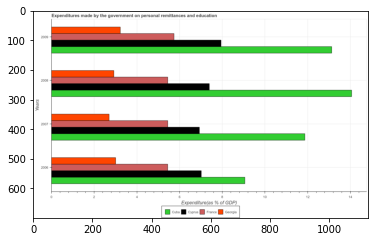

Number of QA =  30





,Years,Cuba,Cyprus,France,Georgia
0,2009,13.224566,8.021089,5.753919,3.239766
1,2006,9.144456,7.059921,5.442556,3.028854
2,2007,11.939923,6.950802,5.441749,2.715215
3,2008,14.129622,7.436775,5.500821,2.945300


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditures made by the government on personal remittances and education in cuba in 2006 and that in 2009 ?
PREDICTED =  -9.224565536020474
EXPECTED =  -4.06785964965823




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditures made by the government on personal remittances and education in georgia in 2008 and the expenditures made by the government on personal remittances and education in france in 2007 ?
PREDICTED =  -1.6605146629182972
EXPECTED =  -2.5256299972534193




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between

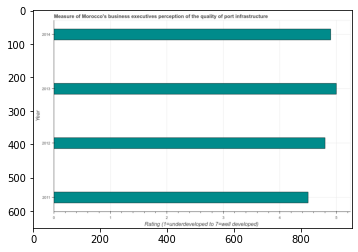

Number of QA =  23





,Year,Rating (1=underdeveloped to 7=well developed)
0,2013,4.974443
1,2011,4.499520
2,2014,4.903246
3,2012,4.826058


> what is the title of the graph ?
PREDICTED =  Measure of Morocco's business executives perception of the quality of port infrastructure
EXPECTED =  Measure of Morocco's business executives perception of the quality of port infrastructure




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Rating (1=underdeveloped to 7=well developed)
EXPECTED =  Rating (1=underdeveloped to 7=well developed) 




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating measuring quality of port infrastructure in 2013 and 2014 ?
PREDICTED =  0.07119666590496809
EXPECTED =  0.1




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> w

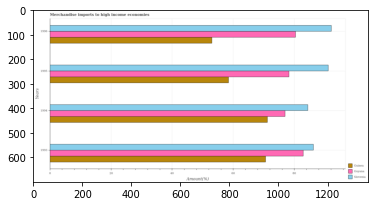

Number of QA =  29





,Years,Slovenia,Guinea,Guyana
0,1993,85.666059,71.485714,83.338152
1,1996,93.265232,52.899540,80.490975
2,1995,91.539540,58.562472,78.290667
3,1994,84.437637,72.008183,76.649789


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in guyana in 1994 and that in 1996 ?
PREDICTED =  -3.8411854218712165
EXPECTED =  -3.431103644298304




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in slovenia in 1993 and the percentage of amount earned from merchandise imports in guyana in 1995 ?
PREDICTED =  -5.873481621281101
EXPECTED =  7.994170683788198




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the percentage of amount earned from merchandise imports in 

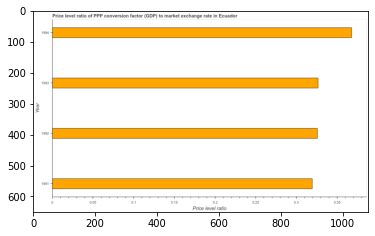

Number of QA =  23





,Year,Price level ratio
0,1993,0.326592
1,1991,0.322745
2,1994,0.370900
3,1992,0.328108


> what is the title of the graph ?
PREDICTED =  Price level ratio of PPP conversion factor (GDP) to market exchange rate in Ecuador
EXPECTED =  Price level ratio of PPP conversion factor (GDP) to market exchange rate in Ecuador




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Price level ratio
EXPECTED =  Price level ratio




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the price level ratio in 1992 ?
PREDICTED =  0.08202709824814348
EXPECTED =  0.3257856832000011




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum price level ratio ?
PREDICTED =  0.0927249070655181
EXPECTED =  0.36781506609761


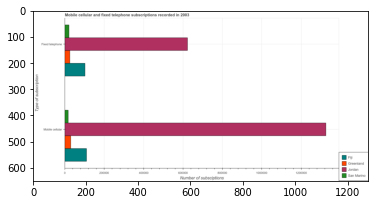

Number of QA =  23





,Type of subscription,Fiji,Greenlanc,San Marino,Jordan
0,Mobile cellular,112965.484562,32316.531451,19657.625609,1.334618e+06
1,Fixed telephone,104713.248753,27733.099717,23853.800014,6.252298e+05


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of fixed telephone subscriptions in jordan and that in san marino ?
PREDICTED =  0.0
EXPECTED =  601883




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of mobile cellular subscriptions in greenland and the number of fixed telephone subscriptions in san marino ?
PREDICTED =  -1.0
EXPECTED =  9060




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of mobile cellular subscriptions and number of fixed telephone subscriptions in san marino ?
PREDICTED =  -1.0
EXPECTED =  -3789




				 0 / 3 = 0.0


is_built_with_cuda: Tr

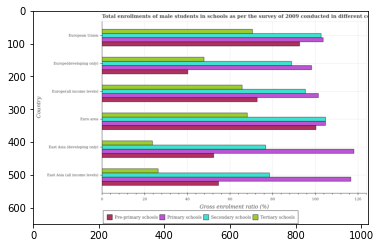

Number of QA =  30





,Country,Tertiary schools,Secondary schools,Pre-primary schools,Primary schools
0,Euro area,68.931297,NaN,100.970529,NaN
1,European Union,70.984940,NaN,93.630513,101.992797
2,Europe(all income levels),67.060371,96.994176,73.429229,98.722972
3,East Asia (developing only),23.825665,77.918918,52.791964,NaN
4,East Asia (all income levels),26.875007,78.875527,54.977610,NaN
5,Europe(developing only),NaN,89.342904,NaN,98.720268


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the gross enrolment ratio(male) in secondary schools in east asia (developing only) ?
PREDICTED =  12.986486277375073
EXPECTED =  76.71441650390629




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum gross enrolment ratio(male) in primary schools ?
PREDICTED =  15.605085429107966
EXPECTED =  118.099426269531




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training o


Image:

/home/pessat/Capstone/plotqa/TEST/png/10753.png


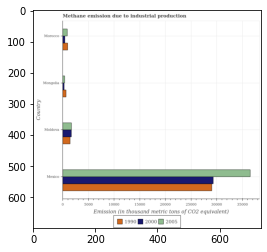

Number of QA =  29





,Country,2005,2000,1990
0,Mexico,65738.759317,52854.401951,52299.678959
1,Morocco,1830.606795,927.180427,1955.115724
2,Moldova,3284.386590,3260.189182,2757.933345
3,Mongolia,862.361759,698.725177,1334.942250


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emitted in 1990 in moldova and that in mongolia ?
PREDICTED =  1422.9910941305059
EXPECTED =  785.8




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emitted in 1990 in moldova and the amount of methane emitted in 2000 in morocco?
PREDICTED =  802.8176205618884
EXPECTED =  1014.6999999999999




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emitted in 2000 and amount of methane emitted in 2005 in mexico ?
PREDICTED =  -7998.262579864102
EXPECTED =  -7207.9000000000015




				 0 / 3 = 

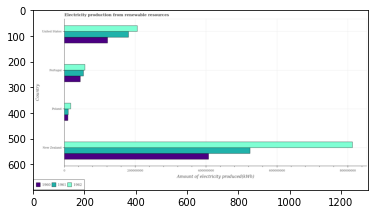

Number of QA =  29





,Country,1962,1961,1960
0,Poland,1.958603e+07,1.251966e+07,1.130180e+07
1,New Zealand,8.172972e+08,5.283155e+08,4.168266e+08
2,United States,2.074758e+08,1.828832e+08,1.231165e+08
3,Portugal,5.958500e+07,5.649350e+07,4.602418e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of electricity produced in 1961 in new zealand and that in united states ?
PREDICTED =  345432301.04624176
EXPECTED =  343000000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of electricity produced in 1962 in new zealand and the amount of electricity produced in 1961 in portugal?
PREDICTED =  757712240.1781855
EXPECTED =  759000000.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of electricity produced in 1961 and amount of electricity produced in 1962 in poland ?
PREDICTED =  760625808.3982558
EXPECTED =  

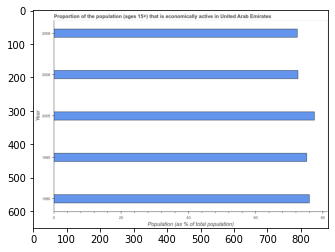

Number of QA =  23





,Year,Population (as % of total population)
0,2009,72.693886
1,1980,76.230704
2,1995,75.480634
3,2008,72.587907
4,2005,77.727271


> what is the title of the graph ?
PREDICTED =  Proportion of the population (ages 15+) that is economically active in United Arab Emirates
EXPECTED =  Proportion of the population (ages 15+) that is economically active in United Arab Emirates




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Population (as % of total population)
EXPECTED =  Population (as % of total population)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active population in 1980 and 2009 ?
PREDICTED =  3.5368182303461566
EXPECTED =  3.6




				 4 / 4 = 1.0


> what is the median percentage of economically active population ?
PREDICTED =  None
EXPECTED =  75.1999969482422




				 4 / 6 = 0.6667


is_built_with_c

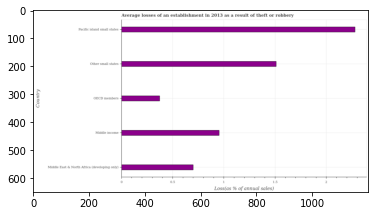

Number of QA =  22





,Country,Loss(as % of annual sales)
0,Other small states,1.504891
1,OECD members,0.378978
2,Pacific island small states,2.296478
3,Middle income,0.960313
4,Middle East & North Africa (developing only),0.704409


> what is the title of the graph ?
PREDICTED =  Average losses of an establishment in 2013 as a result of theft or robbery
EXPECTED =  Average losses of an establishment in 2013 as a result of theft or robbery




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Loss(as % of annual sales)
EXPECTED =  Loss(as % of annual sales)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the losses due to theft in middle income and oecd members ?
PREDICTED =  0.5813348396453988
EXPECTED =  0.581




				 4 / 4 = 1.0


> what is the median losses due to theft ?
PREDICTED =  None
EXPECTED =  0.953488372093023




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation

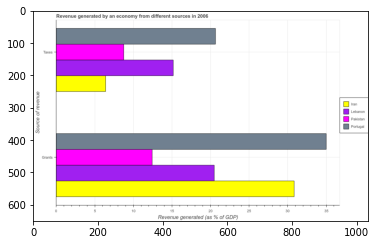

Number of QA =  23





,Source of revenue,Portugal,Unnamed: 2,Iran,Pakistan
0,Taxes,20.806385,15.190821,6.418245,8.714431
1,Grants,35.195174,20.476816,30.807461,12.487107


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the revenue generated by taxes in pakistan and the revenue generated by grants in iran ?
PREDICTED =  2.2961865300754507
EXPECTED =  -22.09482684342189




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the revenue generated by grants and revenue generated by taxes in lebanon ?
PREDICTED =  -7.714431033409273
EXPECTED =  5.316556089841102




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the revenue generated 

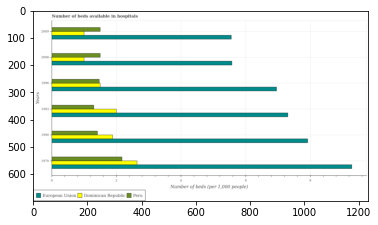

Number of QA =  29





,Years,Dominican Republic,Peru,European Union
0,1990,1.905622,1.426718,7.908079
1,2009,1.006903,1.532737,5.515627
2,2008,1.014262,1.509610,5.516819
3,1996,1.552936,1.484218,7.079039
4,1993,2.014557,1.316128,7.299968
5,1970,2.672128,2.178082,9.246363


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of beds in the hospiatls of in peru in 1990 and that in 1996 ?
PREDICTED =  -0.05749948645712255
EXPECTED =  -0.05680000779999994




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of beds in the hospiatls of in european union in 1990 and the number of beds in the hospiatls of in dominican republic in 1993 ?
PREDICTED =  5.8935220870895595
EXPECTED =  5.91636789087678




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the number of beds in the hospiatls of in peru and number of beds in the hospiatls of in europea

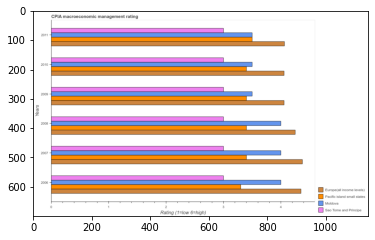

Number of QA =  30





,Years,Pacific island small states,Europe(all income levels),Moldova,Sao Tome and Principe
0,2007,NaN,4.401855,4.015530,3.031662
1,2009,3.406776,NaN,3.493255,3.003917
2,2011,3.493964,4.094730,NaN,2.989308
3,2006,3.314398,NaN,4.018613,3.012239
4,2010,NaN,4.131100,3.561897,2.981694
5,2008,3.397772,4.295821,4.095854,3.023166


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in moldova in 2006 and that in 2011 ?
PREDICTED =  nan
EXPECTED =  0.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in sao tome and principe in 2006 and the cpia rating in moldova in 2008 ?
PREDICTED =  -1.0641913031432737
EXPECTED =  -1.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cpia rating in pacific island small states in 2010 to that in 2011 ?
PREDICTED = 

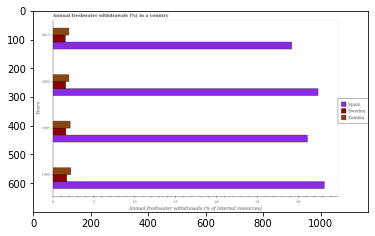

Number of QA =  29





,Years,Sweden,Spain,Zambia
0,1992,1.732150,33.252822,2.229606
1,2013,1.595659,29.528619,2.023005
2,1997,1.646112,31.229664,2.187014
3,2002,1.629928,32.446556,2.010956


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of annual freshwater withdrawals in spain in 1992 and that in 1997 ?
PREDICTED =  2.0231574066412463
EXPECTED =  2.068345323740999




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of annual freshwater withdrawals in zambia in 1997 and the percentage of annual freshwater withdrawals in sweden in 2013 ?
PREDICTED =  0.5913551484723998
EXPECTED =  0.5973574834842701




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the percentage of annual freshwater withdrawals in spain and percentage of annual freshwate

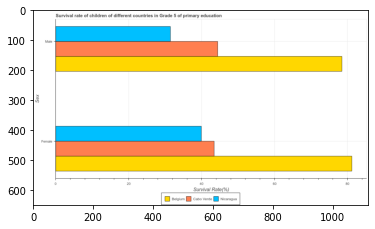

Number of QA =  23





,Sex,Belgium,Cabo Verde,Nicaragua
0,Male,78.773021,44.909886,31.952045
1,Female,82.027880,43.570685,40.291197


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the survival rate of female students in primary education in nicaragua and that in belgium ?
PREDICTED =  -41.73668311612337
EXPECTED =  -41.275169999999996




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the survival rate of male students in primary education in cabo verde and the survival rate of female students in primary education in belgium ?
PREDICTED =  -33.86313487666911
EXPECTED =  -36.79350999999999




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the survival rate of female students in primary education and survival rate of male student

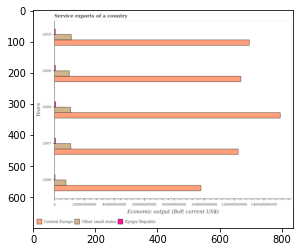

Number of QA =  29





,Years,Kyrgyz Republic,Central Europe,Other small states
0,2010,9.899000e+08,1.328445e+11,1.177243e+10
1,2006,NaN,9.951371e+10,8.097247e+09
2,2007,1.136958e+09,1.250286e+11,1.150358e+10
3,2008,NaN,1.526562e+11,1.115284e+10
4,2009,1.082975e+09,NaN,1.036023e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the service exports in other small states in 2007 and that in 2008 ?
PREDICTED =  350734625.56207275
EXPECTED =  143734923.13770103




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the service exports in kyrgyz republic in 2008 and the service exports in central europe in 2007 ?
PREDICTED =  -123891630634.44171
EXPECTED =  -121948324199.2




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the service exports in kyrgyz republic and service exports in other small states ?
PREDICTED =  -2004.0
EXPECTED =  -9313190841.688751




				 1 

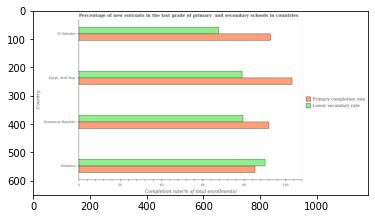

Number of QA =  28





,Country,Primary completion rate,Lower secondary rate
0,Dominica,85.432248,91.261014
1,"Egypt, Arab Rep.",104.758407,79.329958
2,El Salvador,93.739102,67.515925
3,Dominican Republic,92.556333,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the completion rate in secondary schools in dominican republic and that in el salvador ?
PREDICTED =  -67.51592452887975
EXPECTED =  11.755




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the completion rate in primary schools in dominican republic and the completion rate in secondary schools in egypt, arab rep. ?
PREDICTED =  -12.202073792858485
EXPECTED =  12.905944824218793




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the completion rate in secondary schools and completion rate in primary schools in egypt, arab rep. ?
PREDICTED =  -25.42844

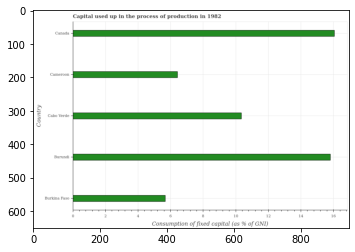

Number of QA =  22





,Country,Consumption of fixed capital (as % of GNI)
0,Canada,16.133276
1,Burundi,15.945596
2,Burkina Faso,5.691238
3,Cameroon,6.472903
4,Cabo Verde,10.415385


> what is the title of the graph ?
PREDICTED =  Capital used up in the process of production in 1982
EXPECTED =  Capital used up in the process of production in 1982




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Consumption of fixed capital (as % of GNI)
EXPECTED =  Consumption of fixed capital (as % of GNI)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the consumption of fixed capital in burundi and cabo verde ?
PREDICTED =  5.530210353003797
EXPECTED =  5.461




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median consumption of fixed capital ?
PREDICTED =  10.415385258670506
EXPECTE

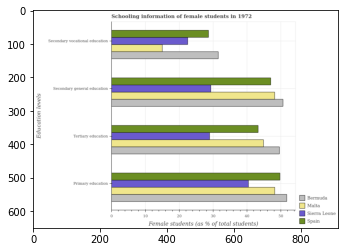

Number of QA =  29





,Education levels,Bermuda,Sierra Leone,Malta,Spain
0,Secondary general education,NaN,29.475193,48.876144,47.173496
1,Tertiary education,49.863834,29.180430,44.917968,43.536514
2,Primary education,NaN,40.477059,48.325351,50.348218
3,Secondary vocational education,31.770887,22.871385,15.191367,28.980226


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female students in secondary education in bermuda and that in spain ?
PREDICTED =  2.790661373991572
EXPECTED =  3.6287499999999966




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female students in tertiary education in bermuda and the percentage of female students in primary education in spain ?
PREDICTED =  6.327320488894792
EXPECTED =  -0.16100000000000136




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female students in primary education and percentage of female students in secondary voc

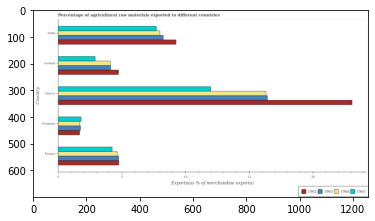

Number of QA =  30





,Country,1964,1962,1963,1965
0,Iceland,4.132935,4.761137,4.132853,2.934475
1,Greece,16.189475,23.056129,16.582089,12.074689
2,France,4.708308,4.785257,4.772095,4.303170
3,Germany,1.746830,1.702919,1.791426,1.827393
4,India,8.016835,9.277194,NaN,7.739971


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in 1964 in germany and that in greece ?
PREDICTED =  -1.253169549249021
EXPECTED =  -14.608278561565772




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in 1963 in iceland and the percentage of exports to different countries in 1965 in germany?
PREDICTED =  2.3414263252439262
EXPECTED =  2.30710811521168




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in 1964 and percentage of exports to different count

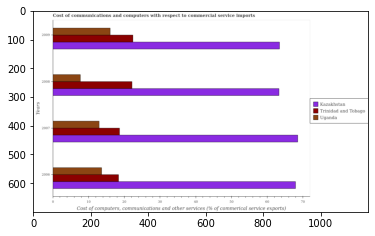

Number of QA =  29





,Years,Trinidad and Tobago,Uganda,Kazakhstan
0,2008,22.478980,7.857298,63.383376
1,2006,18.647697,13.846837,68.632147
2,2009,22.663261,16.128141,64.470995
3,2007,18.945694,13.089602,68.989009


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers in uganda in 2006 and that in 2008 ?
PREDICTED =  0.9591259609576142
EXPECTED =  5.9542297992377025




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers in uganda in 2008 and the cost of communications and computers in kazakhstan in 2007 ?
PREDICTED =  1.7163607964915784
EXPECTED =  -60.84934122437331




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the cost of communications and computers in kazakhstan and cost of communications and computers in trinida

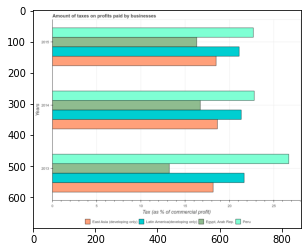

Number of QA =  30





,Years,Latin America(developing only),Peru,"Egypt, Arab Rep",East Asia (developing onty
0,2015,21.393395,22.819341,16.487020,18.357494
1,2014,21.420760,22.954666,16.850361,18.745806
2,2013,21.920721,26.796163,13.298781,18.303133


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of taxes paid by businesses in egypt, arab rep. in 2014 and that in 2015 ?
PREDICTED =  0.3633413031475854
EXPECTED =  0.3999999999999986




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of taxes paid by businesses in east asia (developing only) in 2014 and the percentage of taxes paid by businesses in latin america(developing only) in 2013 ?
PREDICTED =  0.4426726346654988
EXPECTED =  -3.0203007518797023




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the percentage of taxes paid by businesses in eg

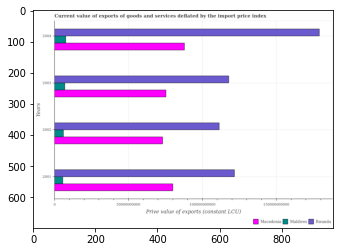

Number of QA =  29





,Years,Rwanda,Maldives,Macedonia
0,2004,3.231842e+11,1.452759e+10,1.596378e+11
1,2002,2.003133e+11,1.150521e+10,1.329066e+11
2,2001,2.216989e+11,1.087946e+10,1.451059e+11
3,2003,2.126858e+11,1.324891e+10,1.369485e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the prive value of exports in rwanda in 2002 and that in 2003 ?
PREDICTED =  -12372471352.901367
EXPECTED =  -6484919869.194992




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the prive value of exports in rwanda in 2001 and the prive value of exports in macedonia in 2002 ?
PREDICTED =  21385560359.023865
EXPECTED =  48558420014.3412




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the prive value of exports in rwanda and prive value of exports in maldives ?
PREDICTED =  188435443159.0328
EXPECTED =  105287689787.204




				 0 /

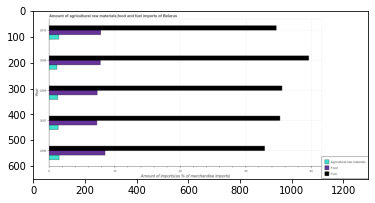

Number of QA =  29





,Year,Agricultural raw materials,Fuel,Food
0,2010,1.525107,34.747799,7.866861
1,2006,1.582451,33.227000,8.584534
2,2008,1.385356,35.600931,7.506649
3,2007,1.456022,35.313745,7.333524
4,2009,1.266348,39.275476,7.877763


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of fuel imports in 2009 and that in 2010 ?
PREDICTED =  4.527677547771788
EXPECTED =  4.951




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of fuel imports in 2010 and the percentage of raw materials imports in 2009 ?
PREDICTED =  -4.527677547771788
EXPECTED =  33.48661205268564




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of food imports and percentage of fuel imports ?
PREDICTED =  -24.642466079041768
EXPECTED =  -26.794




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_avai

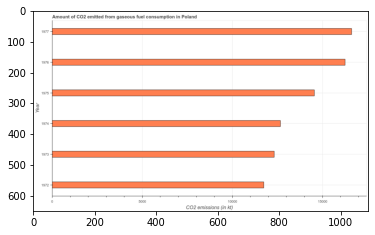

Number of QA =  23





,Year,CO2 emissions (in kt)
0,1974,149638.019974
1,1973,145636.159799
2,1976,191029.761467
3,1977,194720.781825
4,1975,171078.822329
5,1972,139033.693525


> what is the title of the graph ?
PREDICTED =  Amount of CO2 emitted from gaseous fuel consumption in Poland
EXPECTED =  Amount of CO2 emitted from gaseous fuel consumption in Poland




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  CO2 emissions (in kt)
EXPECTED =  CO2 emissions (in kt)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 emissions from gaseous fuel consumption in 1975 and 1977 ?
PREDICTED =  -23641.959496638214
EXPECTED =  -2068.188




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median co2 emissions from gaseous fuel consumption ?
PREDICTED =  160358.421151541
EXPECTED = 

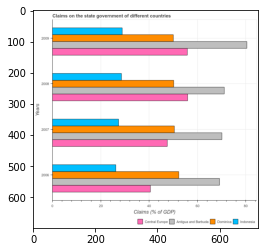

Number of QA =  30





,Years,Dominica,Central Europe,Indonesia,Antigua and Barbuda
0,2009,50.498656,55.926907,28.944772,NaN
1,2006,52.618003,40.799907,26.482983,69.500707
2,2008,50.343182,56.268027,28.775319,70.519332
3,2007,50.603079,47.694939,27.326126,70.340520


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of gdp claimed on the state government in central europe in 2007 and that in 2008 ?
PREDICTED =  -8.573088388263088
EXPECTED =  -8.418551652227606




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of gdp claimed on the state government in indonesia in 2009 and the percentage of gdp claimed on the state government in central europe in 2007 ?
PREDICTED =  -27.15269450433227
EXPECTED =  -18.64629299005218




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the percentage of gdp claimed on the state governmen

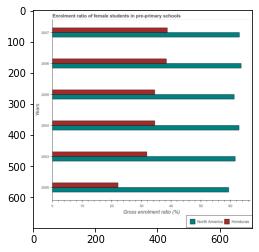

Number of QA =  28





,Years,North America,Honduras
0,2004,63.228240,34.353965
1,2006,63.636881,38.473779
2,2007,62.719245,38.686122
3,2003,61.868096,31.874193
4,2000,59.942158,22.203471
5,2005,60.908979,34.290501


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the enrolment ratio of female students in pre-primary schools in north america in 2006 ?
PREDICTED =  12.727376148787027
EXPECTED =  63.579418182373




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum enrolment ratio of female students in pre-primary schools in honduras ?
PREDICTED =  7.737224346715877
EXPECTED =  38.6966514587402




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum enrolment ratio of female students in pre-primary schools in north america ?
PREDICTED =  11.988431516242231
EXPECTED =  59.39062881469729




				 0 / 3 = 0.0


is_built_with_cuda: Tr

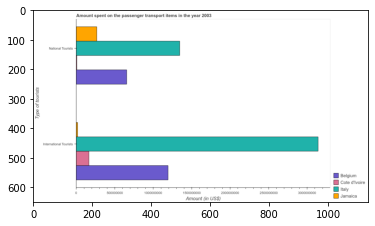

Number of QA =  23





,Type of tourists,Jamaica,Belgium,Cote d'Ivoire,Italy
0,National Tourists,4.903933e+08,1.196475e+09,NaN,2.436734e+09
1,International Tourists,4.560979e+07,2.147747e+09,3.112834e+08,5.684383e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on transport items of national tourists in jamaica and that in belgium ?
PREDICTED =  -706081828.9657795
EXPECTED =  -389000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on transport items of international tourists in italy and the amount spent on transport items of national tourists in jamaica ?
PREDICTED =  5148379773.07865
EXPECTED =  2876000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on transport items of national tourists and amount spent on transport items of international tou

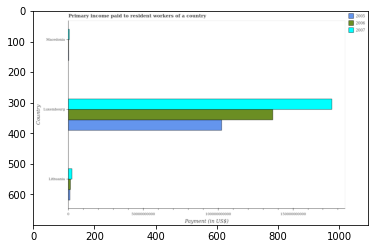

Number of QA =  29





,Country,2007,2005,2006
0,Macedonia,2.261435e+09,NaN,NaN
1,Lithuania,5.206615e+09,2.923946e+09,3.639533e+09
2,Luxembourg,3.166178e+11,1.855180e+11,2.466129e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount paid to workers in 2007 in lithuania and that in macedonia ?
PREDICTED =  2945180374.6118255
EXPECTED =  1747503848.9




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount paid to workers in 2007 in luxembourg and the amount paid to workers in 2006 in lithuania?
PREDICTED =  311411215501.23755
EXPECTED =  174564493629.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount paid to workers in 2005 and amount paid to workers in 2006 in luxembourg ?
PREDICTED =  -58170961704.663635
EXPECTED =  -34150000000.0




				 0 / 3 = 0.0

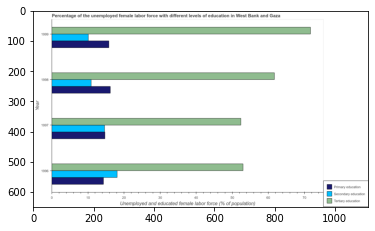

Number of QA =  29





,Year,Secondary education,Tertiary education,Primary education
0,1998,11.010220,61.324209,16.321075
1,1997,14.712153,52.036323,14.920463
2,1999,10.195389,71.360900,15.954157
3,1996,18.275823,53.069656,14.429814


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received primary education in 1996 and that in 1997 ?
PREDICTED =  -0.4906487825953789
EXPECTED =  -0.4




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received secondary education in 1999 and the percentage of female labor force who received primary education in 1998 ?
PREDICTED =  -0.8148308993094489
EXPECTED =  -6.100000381469799




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the percentage of female labor force who received secondary education

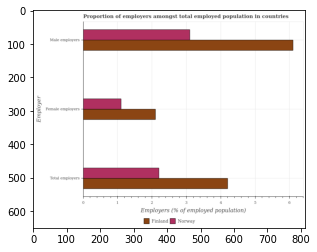

Number of QA =  28





,Employer,Finland,Norway
0,Male employers,6.193883,3.159246
1,Female employers,2.149399,1.129866
2,Total employers,4.267573,2.224907


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of female employers in finland to that in norway ?
PREDICTED =  1.9023489011463675
EXPECTED =  1.9090907810148139




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 5 = 0.2


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predi

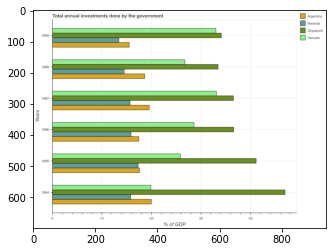

Number of QA =  30





,Years,Rwanda,Singapore,Vanuatu,Argentina
0,1989,NaN,34.311252,33.213350,15.776503
1,1985,NaN,41.513113,26.165778,NaN
2,1984,15.911509,47.274685,19.948825,20.391039
3,1987,15.858533,36.856677,33.320950,19.847021
4,1986,NaN,36.608816,28.893337,17.775507
5,1988,14.691591,33.733115,26.950947,18.820368


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual investments done by the government in rwanda in 1985 and that in 1987 ?
PREDICTED =  -12.858533344484005
EXPECTED =  1.6447390494642011




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual investments done by the government in rwanda in 1984 and the total annual investments done by the government in singapore in 1986 ?
PREDICTED =  -57.55398520147176
EXPECTED =  -20.7805168986648




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1987, what is the difference between the total annual investments done by the government in singapore and total

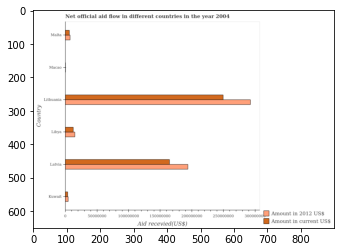

Number of QA =  28





,Country,Amount in current US$,Amount in 2012 US$
0,Macao,NaN,NaN
1,Malta,1.321775e+07,1.519786e+07
2,Latvia,2.965063e+08,NaN
3,Libya,2.430992e+07,2.889392e+07
4,Kuwait,8.624739e+06,1.010708e+07
5,Lithuania,4.513050e+08,5.298670e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid received(expressed in 2012 us$) in latvia and that in libya ?
PREDICTED =  -28893922.53330064
EXPECTED =  178830000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid received(expressed in us$) in latvia and the amount of aid received(expressed in 2012 us$) in macao ?
PREDICTED =  0.0
EXPECTED =  164570000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid received(expressed in us$) and amount of aid received(expressed in 2012 us$) in libya ?
PREDICTED =  -28893918.53330064
EXPECTED =  -2580000






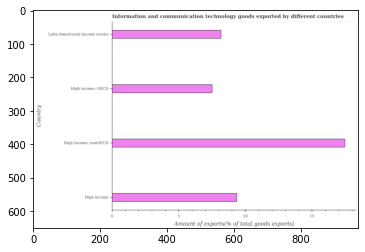

Number of QA =  22





,Country,Amount of exports(% of total goods exports)
0,High income,9.464972
1,High income: OECD,7.529994
2,High income: nonOECD,17.436364
3,Latin America(all income levels),8.214530


> what is the title of the graph ?
PREDICTED =  Information and communication technology goods exported by different countries
EXPECTED =  Information and communication technology goods exported by different countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Amount of exports(% of total goods exports)
EXPECTED =  Amount of exports(% of total goods exports)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of ict goods exports in high income: oecd and high income: nonoecd ?
PREDICTED =  -9.906370845274985
EXPECTED =  -9.952




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 4 / 5 = 0

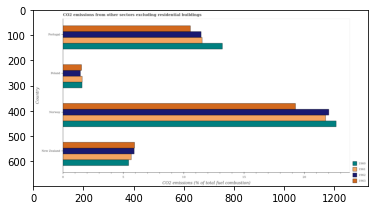

Number of QA =  30





,Country,1963,1962,1961,1960
0,Poland,1.571234,1.483017,1.631093,1.622107
1,Portugal,10.603323,11.451545,11.518105,13.355474
2,Norway,19.434283,22.253014,21.981161,22.794761
3,New Zealand,5.979053,5.948322,5.693047,5.499280


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1963 in norway and that in portugal ?
PREDICTED =  8.830959548879559
EXPECTED =  8.7038109046362




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1961 in norway and the total co2 emitted in 1962 in new zealand?
PREDICTED =  16.28811411100321
EXPECTED =  15.855120112086112




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1961 and total co2 emitted in 1963 in new zealand ?
PREDICTED =  -1.9790526704701623
EXPECTED =  -0.27088351310783043




				 2 / 3 = 0.6667


is_built_with

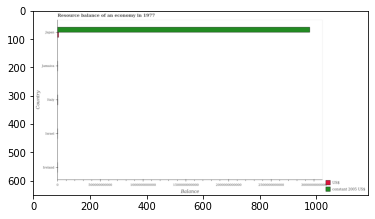

Number of QA =  25





,Country,US$,constant 2005 US$
0,Italy,NaN,NaN
1,Israel,NaN,NaN
2,Ireland,NaN,NaN
3,Jamaica,NaN,NaN
4,Japan,3.402864e+10,5.331148e+12


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the resource balance in constant us$ in jamaica and that in japan ?
PREDICTED =  -5331147935962.003
EXPECTED =  -2950484640300.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the resource balance in constant us$ in jamaica and the resource balance in us$ in italy ?
PREDICTED =  0.0
EXPECTED =  -2410558415.62431




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the resource balance in us$ and resource balance in constant us$ in jamaica ?
PREDICTED =  34028644765.69643
EXPECTED =  4090045.856




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_a

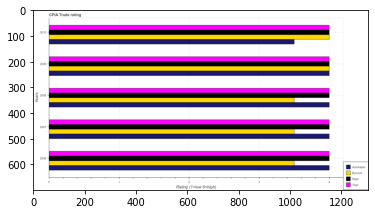

Number of QA =  30





,Years,Azerbaijan,Unnamed: 2,Burundi,Niger
0,2008,4.007157,4.031229,NaN,NaN
1,2007,4.015066,4.035874,3.494655,3.987300
2,2006,4.079279,4.000913,3.505523,4.058808
3,2009,4.006940,NaN,NaN,4.024624
4,2010,3.524726,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in niger in 2006 and that in 2010 ?
PREDICTED =  nan
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in togo in 2006 and the cpia rating in niger in 2007 ?
PREDICTED =  -0.4817775263589539
EXPECTED =  0.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cpia rating in niger in 2008 to that in 2009 ?
PREDICTED =  nan
EXPECTED =  1.0




				 0 / 4 = 0.0




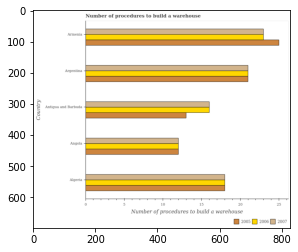

Number of QA =  29





,Country,2007,2005,2006
0,Armenia,23.170628,24.989729,23.358213
1,Algeria,18.029233,18.050853,NaN
2,Antigua and Barbuda,16.101699,13.088087,16.009514
3,Angola,12.052354,12.113268,NaN
4,Argentina,21.169116,NaN,21.058713


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of procedures to build a warehouse in in 2006 in algeria and that in antigua and barbuda ?
PREDICTED =  2.0
EXPECTED =  2.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of procedures to build a warehouse in in 2006 in antigua and barbuda and the number of procedures to build a warehouse in in 2007 in armenia?
PREDICTED =  0.0
EXPECTED =  -7.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of procedures to build a warehouse in in 2005 and number of procedures to build a warehouse in in 2006 in antigua and barbu

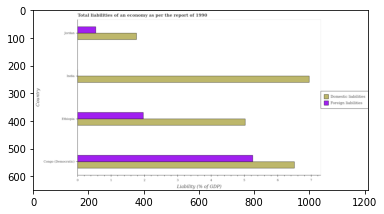

Number of QA =  25





,Country,Foreign liabilities,Domestic liabilities
0,Jordan,0.564755,1.787675
1,India,NaN,6.976512
2,Congo (Democratic),5.259266,6.502875
3,Ethiopia,2.013291,5.049491


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the incurrence of domestic liabilities in congo (democratic) and that in india ?
PREDICTED =  -0.4736373908614988
EXPECTED =  -0.444




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the incurrence of foreign liabilities in ethiopia and the incurrence of domestic liabilities in congo (democratic) ?
PREDICTED =  -3.2459750477854064
EXPECTED =  -4.53095357898896




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the incurrence of foreign liabilities and incurrence of domestic liabilities in ethiopia ?
PREDICTED =  0.986709088041855
EXPECTED =  -3.056




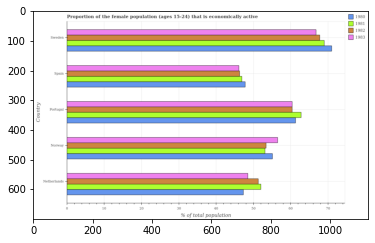

Number of QA =  30





,Country,1982,1980,1983,1981
0,Sweden,69.658401,71.717603,67.660679,69.179468
1,Norway,54.251764,55.703827,57.614304,53.869140
2,Netherlands,51.886024,48.201748,49.325594,52.482693
3,Portugal,60.916741,61.856857,60.989051,63.378649
4,Spain,46.818655,48.316995,46.782739,47.428483


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female population that is economically active in 1982 in netherlands and that in portugal ?
PREDICTED =  -9.030717473958589
EXPECTED =  -9.100002288818402




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female population that is economically active in 1983 in sweden and the proportion of the female population that is economically active in 1980 in norway?
PREDICTED =  11.956852222951731
EXPECTED =  11.700004577636697




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female population

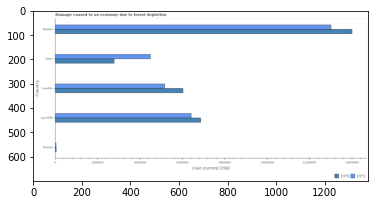

Number of QA =  28





,Country,1971,1970
0,Malawi,1.312873e+07,1.381738e+07
1,Kuwait,6.513722e+04,7.163723e+04
2,Lesotho,5.221672e+06,6.080401e+06
3,Libya,NaN,2.801050e+06
4,Lao PDR,6.466575e+06,6.888314e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to forest depletion in 1970 in lesotho and that in libya ?
PREDICTED =  3279350.747682323
EXPECTED =  3244159.6835562405




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to forest depletion in 1971 in kuwait and the cost of damage caused due to forest depletion in 1970 in malawi?
PREDICTED =  -13063587.87018629
EXPECTED =  -13967092.629511418




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to forest depletion in 1970 and cost of damage caused due to forest de

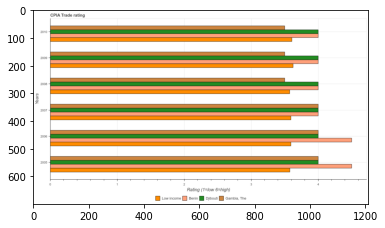

Number of QA =  30





,Years,Low income,"Gambia, The",Djibouti,Benin
0,2006,3.606043,4.053585,4.132101,4.146901
1,2008,NaN,3.508191,4.013044,4.000606
2,2010,3.628727,3.535937,3.983075,3.902849
3,2005,3.586137,NaN,4.199175,4.365068
4,2007,3.560709,4.026566,4.042977,4.007477
5,2009,NaN,3.497800,4.060983,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in djibouti in 2005 and that in 2010 ?
PREDICTED =  0.21610007498651207
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the cpia rating in low income and cpia rating in benin ?
PREDICTED =  -0.08458019430311303
EXPECTED =  -0.4074074074074101




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cpia rating in djibouti in 2006 to that in 2010 ?
PREDICTED =  1.

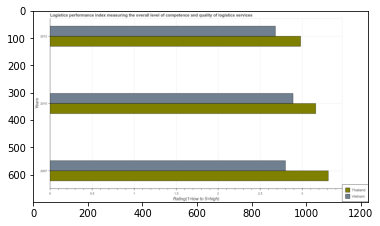

Number of QA =  28





,Years,Thailand,Vietnam
0,2012,3.001693,2.681191
1,2010,3.155790,2.900546
2,2007,3.309418,2.800820


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in vietnam in 2010 and that in 2012 ?
PREDICTED =  0.2193554578043675
EXPECTED =  0.20999999999999996




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in vietnam in 2007 and the logistic performance index in thailand in 2012 ?
PREDICTED =  0.11962878204355398
EXPECTED =  -0.18000000000000016




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the logistic performance index in vietnam and logistic performance index in thailand ?
PREDICTED =  5.226922477151303
EXPECTED =  -0

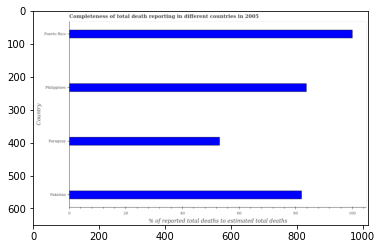

Number of QA =  22





,Country,% of reported total deaths to estimated total deaths
0,Pakistan,82.764387
1,Puerto Rico,100.608672
2,Philippines,84.622328
3,Paraguay,53.700352


> what is the title of the graph ?
PREDICTED =  Completeness of total death reporting in different countries in 2005
EXPECTED =  Completeness of total death reporting in different countries in 2005




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  % of reported total deaths to estimated total deaths
EXPECTED =  % of reported total deaths to estimated total deaths




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the completeness of total death reports in pakistan and philippines ?
PREDICTED =  -1.8579407850897098
EXPECTED =  -1.703




				 3 / 4 = 0.75


> what is the median completeness of total death reports ?
PREDICTED =  None
EXPECTED =  82.90239817959315




				 3 / 6 = 0.5


is_built_with_cuda: True
is_g

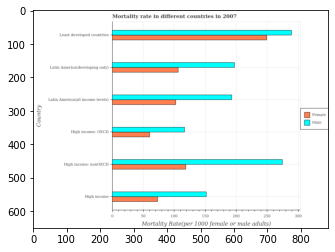

Number of QA =  28





,Country,Female,Male
0,Least developed countries,NaN,NaN
1,High income,132.560443,277.458696
2,High income: nonOECD,215.422361,497.907548
3,High income: OECD,111.146400,212.419185
4,Latin America(developing only),193.640547,354.246900
5,Latin America(all income levels),186.509117,345.139104


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female mortality rate in high income and that in latin america(all income levels) ?
PREDICTED =  -53.94867445807867
EXPECTED =  -29.292




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female mortality rate in high income: oecd and the male mortality rate in high income: nonoecd ?
PREDICTED =  -104.27596115352145
EXPECTED =  -214.28485356114373




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female mortality rate and male mortality rate in high income ?
PREDICTED =  82.86191840343821
EXPECTED =  -78.74




				 0 / 3 = 0.0


is_built_w

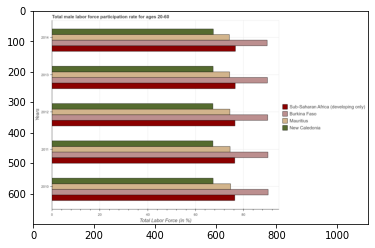

Number of QA =  30





,Years,Sub-Saharan Africa (developing only),Mauritius,Burkina Faso,New Caledonia
0,2014,77.280885,74.593646,91.081656,68.116463
1,2013,76.914687,74.562917,91.041182,68.233053
2,2011,77.266888,75.148665,91.065238,67.948654
3,2010,76.990069,74.914662,92.332422,67.737621
4,2012,77.294069,74.662913,92.750050,68.074095


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in sub-saharan africa (developing only) in 2010 and that in 2014 ?
PREDICTED =  -0.2908162912509624
EXPECTED =  -0.27642050971059007




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male labor force participation rate in new caledonia in 2013 and the male labor force participation rate in sub-saharan africa (developing only) in 2012 ?
PREDICTED =  0.1589580155158501
EXPECTED =  -9.1445853995627




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the male labor force participation rate in ma

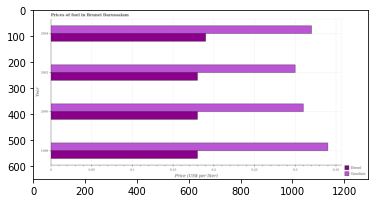

Number of QA =  28





,Year,Gasoline,Diesel
0,2004,0.319744,0.189989
1,2002,0.299872,0.180231
2,1998,0.339650,0.180110
3,2000,0.309212,0.181951


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the diesel price in 1998 and that in 2002 ?
PREDICTED =  -0.00012053859326038863
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the diesel price in 1998 and the gasoline price in 2000 ?
PREDICTED =  -0.0018412008586660422
EXPECTED =  -0.13




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the diesel price and gasoline price ?
PREDICTED =  0.006918838431366731
EXPECTED =  -0.13




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after train

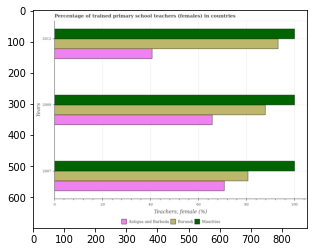

Number of QA =  29





,Years,Mauritius,Burundi,Antigua and Barbuda
0,2012,100.550844,94.433454,41.615787
1,2007,101.047364,81.139314,71.149847
2,2009,100.439133,88.636660,66.009697


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of trained primary school teachers (females) in burundi in 2007 and that in 2009 ?
PREDICTED =  -7.497345853057453
EXPECTED =  -7.228187561035085




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of trained primary school teachers (females) in mauritius in 2009 and the percentage of trained primary school teachers (females) in burundi in 2007 ?
PREDICTED =  -0.6082306226904279
EXPECTED =  19.40650939941409




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the percentage of trained primary school teacher

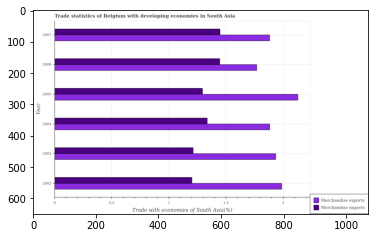

Number of QA =  28





,Year,Merchandise imports,Merchandise exports
0,2004,1.350433,1.895488
1,2006,1.459748,1.785458
2,2003,1.225909,1.920943
3,2007,1.453528,1.896031
4,2005,1.308152,2.148243
5,2002,1.207569,1.991810


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in 2006 and that in 2007 ?
PREDICTED =  -0.11057245339176269
EXPECTED =  -0.113




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in 2004 and the merchandise imports in 2007 ?
PREDICTED =  -0.0005425477033984549
EXPECTED =  0.43546763092595




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the merchandise imports and merchandise exports ?
PREDICTED =  -10.17822531297099
EXPECTED =  -0.786




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or pr

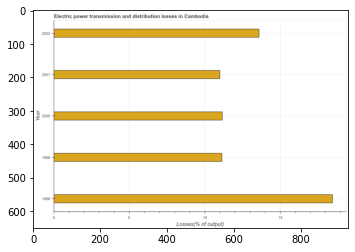

Number of QA =  23





,Year,Losses(% of output)
0,1998,18.533461
1,1999,11.177620
2,2002,13.543420
3,2001,10.979106
4,2000,11.240838


> what is the title of the graph ?
PREDICTED =  Electric power transmission and distribution losses in Cambodia
EXPECTED =  Electric power transmission and distribution losses in Cambodia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Losses(% of output)
EXPECTED =  Losses(% of output)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 3 / 4 = 0.75


> what is the median electric power transmission and distribution losses ?
PREDICTED =  None
EXPECTED =  11.1607142857143




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the electric power transmission and distribution losses in 2001 to that in 2002?
PREDICTED =  0.8

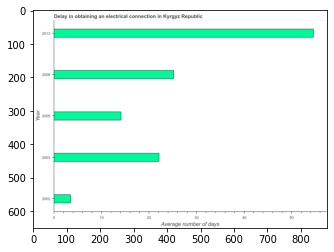

Number of QA =  23





,Year,Average number of days
0,2009,25.045891
1,2003,22.122731
2,2013,54.507461
3,2002,3.652357
4,2005,14.067854


> what is the title of the graph ?
PREDICTED =  Delay in obtaining an electrical connection in Kyrgyz Republic
EXPECTED =  Delay in obtaining an electrical connection in Kyrgyz Republic




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Average number of days
EXPECTED =  Average number of days




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the dalay in electrical connection in 2002 and 2013 ?
PREDICTED =  -50.85510402673
EXPECTED =  -51.1




				 4 / 4 = 1.0


> what is the median dalay in electrical connection ?
PREDICTED =  None
EXPECTED =  22.1




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is t

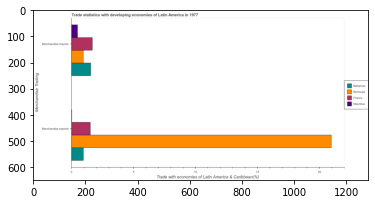

Number of QA =  23





,Merchandise Trading,Bermuda,Mauritius,France,Bahamas
0,Merchandise imports,0.985709,0.512628,1.703941,1.570157
1,Merchandise exports,20.970280,NaN,1.535846,0.982263


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the merchandise exports in mauritius to that in bahamas ?
PREDICTED =  0.0
EXPECTED =  0.015470170900638147




				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Trade with economies of Latin America & Caribbean(%)
EXPECTED =  5.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Trade statistics with

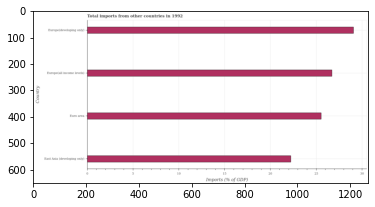

Number of QA =  22





,Country,Imports (% of GDP)
0,Euro area,25.600694
1,Europe(all income levels),26.698920
2,East Asia (developing only),22.273369
3,Europe(developing only),29.056849


> what is the title of the graph ?
PREDICTED =  Total imports from other countries in 1992
EXPECTED =  Total imports from other countries in 1992




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Imports (% of GDP)
EXPECTED =  Imports (% of GDP)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports in euro area and europe(developing only) ?
PREDICTED =  -3.4561548941560396
EXPECTED =  -3.527




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total imports ?
PREDICTED =  26.149807393841925
EXPECTED =  26.13076577903125




				 5 / 5 = 1.0


is_built_with_cuda: True
is_gpu_av

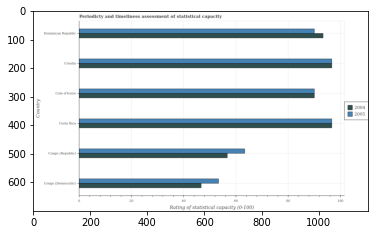

Number of QA =  28





,Country,2005,2004
0,Croatia,96.854946,96.682430
1,Cote d'Ivoire,90.326919,90.423867
2,Costa Rica,97.531363,97.189840
3,Dominican Republic,91.041492,93.732483
4,Congo (Democratic),53.852490,47.007140
5,Congo (Republic),63.775695,57.350733


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in 2005 in congo (republic) and that in croatia ?
PREDICTED =  -33.079251051563375
EXPECTED =  -33.33334




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in 2004 in cote d'ivoire and the rating of statistical capacity in 2005 in congo (republic)?
PREDICTED =  33.07313405134032
EXPECTED =  26.666670000000003




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in 2005 and rating of statistical capacity in 2004 in congo (republic) ?
PREDICTED =  40.18

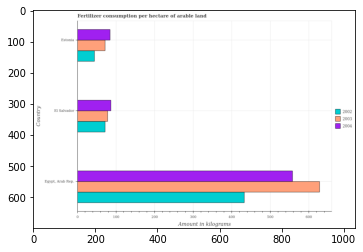

Number of QA =  29





,Country,2002,2003,2004
0,El Salvador,73.095668,79.733790,88.433068
1,Estonia,45.580060,72.027190,86.021618
2,"Egypt, Arab Rep.",433.586887,637.839433,559.503860


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of fertilizer consumption in 2002 in egypt, arab rep. and that in estonia ?
PREDICTED =  -45.58005963754181
EXPECTED =  388.4756012997232




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of fertilizer consumption in 2003 in estonia and the amount of fertilizer consumption in 2002 in egypt, arab rep.?
PREDICTED =  -565.8122428511243
EXPECTED =  -360.8831562632803




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of fertilizer consumption in 2003 and amount of fertilizer consumption in 2004 in egypt, arab rep. ?
PREDIC

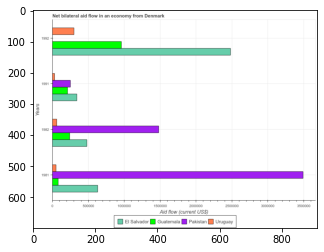

Number of QA =  27





,Years,Uruguay,El Salvador,Pakistan,Guatemala
0,1992,548684.673134,4.480864e+06,NaN,1.736074e+06
1,1991,66976.365863,6.210510e+05,4.590921e+05,3.929270e+05
2,1981,102290.746484,1.147788e+06,6.243003e+06,1.574869e+05
3,1982,120005.096683,8.859122e+05,2.673062e+06,4.415811e+05


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in guatemala in 1981 and that in 1992 ?
PREDICTED =  -1578587.1571005506
EXPECTED =  -880000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in guatemala in 1981 and the net bilateral aid flow in pakistan in 1982 ?
PREDICTED =  -284094.2461564371
EXPECTED =  -1400000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1982, what is the difference between the net bilateral aid flow in uruguay and net bilateral aid flow in guatemala ?
PREDICTED =  548680.673134482
EXPECTED =  -180000.0




				 0 / 3 = 0.0


is_bu

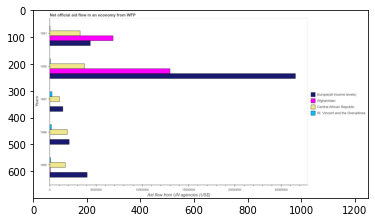

Number of QA =  30





,Years,Central African Republic,Europe(all income levels),St. Vincent and the Grenadines,Afghanistan
0,1987,2.024917e+06,2.660814e+06,536644.039793,NaN
1,1985,3.101513e+06,7.410366e+06,230815.400847,NaN
2,1990,6.775511e+06,4.779101e+07,NaN,2.357415e+07
3,1991,5.863372e+06,7.895189e+06,NaN,1.236346e+07
4,1986,3.512257e+06,3.892268e+06,409807.675784,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in europe(all income levels) in 1985 and that in 1986 ?
PREDICTED =  3518097.9928556
EXPECTED =  1940000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in st. vincent and the grenadines in 1990 and the net official aid flow in central african republic in 1986 ?
PREDICTED =  -3119834.8067869567
EXPECTED =  -1840000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1987, what is the difference between the net official aid flow in europe(all income levels) and net official aid flow in st. vincent and the grenadines 

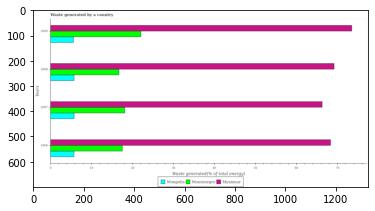

Number of QA =  29





,Years,Montenegro,Myanmar,Mongolia
0,2009,22.431223,74.102329,5.737617
1,2007,18.333117,66.652567,5.965146
2,2006,17.854492,69.539578,5.904728
3,2008,16.990135,70.408963,5.908982


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total waste generated in myanmar in 2007 and that in 2009 ?
PREDICTED =  -7.449761742583945
EXPECTED =  -7.224031511167098




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total waste generated in montenegro in 2009 and the total waste generated in mongolia in 2008 ?
PREDICTED =  5.4410885235674975
EXPECTED =  16.293942235991494




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the total waste generated in mongolia and total waste generated in myanmar ?
PREDICTED =  -257.1869643929629
EXPECTED =  -67.86399971395193




				

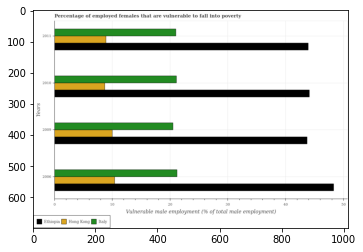

Number of QA =  29





,Years,Hong Kong,Ethiopia,Italy
0,2011,9.114573,44.584883,21.427756
1,2010,8.952479,44.499577,21.329368
2,2009,10.153255,44.165422,20.817711
3,2006,10.664021,48.620178,21.459711


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed females who are vulnerable to fall into poverty in italy in 2006 and that in 2010 ?
PREDICTED =  0.13034318840696812
EXPECTED =  0.10000038146979762




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed females who are vulnerable to fall into poverty in hong kong in 2010 and the percentage of employed females who are vulnerable to fall into poverty in italy in 2009 ?
PREDICTED =  -11.86523246637253
EXPECTED =  -11.800000190734862




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the 

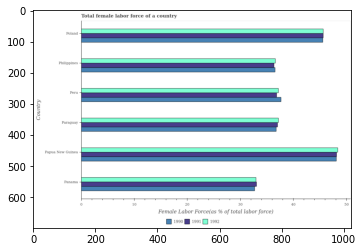

Number of QA =  29





,Country,1992,1990,1991
0,Poland,45.951882,45.466881,45.792971
1,NaN,37.392722,37.975389,36.917545
2,Philippines,37.059162,36.514886,36.513876
3,Paraguay,37.625146,37.069147,37.169205
4,Panama,33.274264,32.887260,33.306461
5,Papua New Guinea,48.942947,48.442816,48.675182


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force in 1992 in panama and that in philippines ?
PREDICTED =  -3.78489785456361
EXPECTED =  -3.6552918868205992




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force in 1990 in peru and the percentage of female labor force in 1991 in philippines?
PREDICTED =  0.5542609688864459
EXPECTED =  1.3336796737340038




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force in 1991 and percentage of female labor force in 1992 in poland ?
PREDICTED =  -8.7826773211499

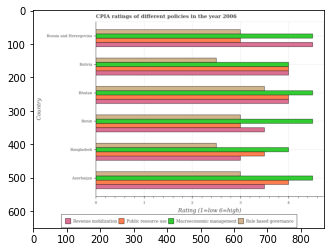

Number of QA =  30





,Country,Public resource use,Rule based governance,Macroeconomic management,Revenue mobilization
0,Bolivia,NaN,NaN,3.976577,NaN
1,Bangladesh,NaN,2.494523,3.999604,3.025760
2,Benin,2.997768,NaN,4.365505,3.559888
3,Bhutan,4.058951,3.544442,4.491251,3.984423
4,Bosnia and Herzegovina,3.101999,3.028258,4.510202,4.391618
5,Azerbaijan,3.990744,3.000858,NaN,3.530876


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of public resource use in benin and that in bosnia and herzegovina ?
PREDICTED =  -0.10423125670791178
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of revenue mobilization in bangladesh and the cpia rating of macroeconomic management in bhutan ?
PREDICTED =  -0.9586632931915258
EXPECTED =  -1.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating of public resource use and cpia rating of macroeconomic management in bhutan ?
PREDICTED =  3.0
EXPECTED =  -0.5




				 0 / 3 = 0.0


is_bu

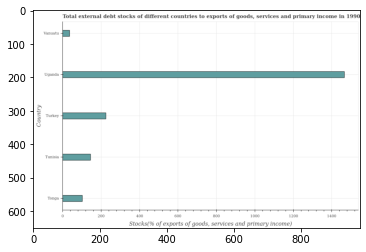

Number of QA =  22





,Country,"Stocks(% of exports of goods, services and primary income)"
0,Vanuatu,39.936725
1,Tonga,105.645760
2,Tunisia,149.414441
3,Uganda,1471.060276
4,Turkey,227.153887


> what is the title of the graph ?
PREDICTED =  Total external debt stocks of different countries to exports of goods, services and primary income in 1990
EXPECTED =  Total external debt stocks of different countries to exports of goods, services and primary income in 1990




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Stocks(% of exports of goods, services and primary income)
EXPECTED =  Stocks(% of exports of goods, services and primary income)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the external debt stocks in tunisia and vanuatu ?
PREDICTED =  109.47771613960529
EXPECTED =  108.982




				 4 / 4 = 1.0


> what is the median external debt stocks ?
PREDICTED =  None
EXPECTED =  145.096892946652



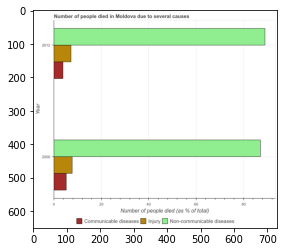

Number of QA =  26





,Year,Injury,Non-communicable diseases,Communicable diseases
0,2000,7.831279,87.007042,5.437882
1,2012,7.333248,88.580702,3.995893


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of people who dies of non-communicable diseases in 2000 and the number of people who died of communicable diseases in 2012 ?
PREDICTED =  -87.58070229874313
EXPECTED =  83.3




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the number of people who died of injury and number of people who died of communicable diseases ?
PREDICTED =  0.0
EXPECTED =  2.5




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> 

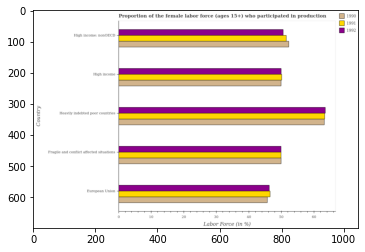

Number of QA =  29





,Country,1992,1990,1991
0,High income,50.783299,50.782883,NaN
1,European Union,46.971546,46.538306,47.476735
2,Heavily indebted poor countries,64.045256,64.065644,64.222842
3,Fragile and conflict affected situations,50.733156,50.592402,50.704300
4,High income: nonOECD,51.418144,53.185534,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female labor force who participated in production in 1990 in high income and the proportion of the female labor force who participated in production in 1991 in high income: nonoecd?
PREDICTED =  -2.4026509742197675
EXPECTED =  -1.5892781102322786




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female labor force who participated in production in 1990 and proportion of the female labor force who participated in production in 1991 in high income ?
PREDICTED =  64.06564359222628
EXPECTED =  -0

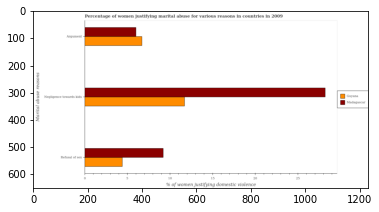

Number of QA =  28





,Marital abuse reasons,Guyana,Madagascar
0,Refusal of sex,4.412921,9.201886
1,Argument,6.735021,6.053241
2,Negligence towards kids,11.747703,28.207346


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 6 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?

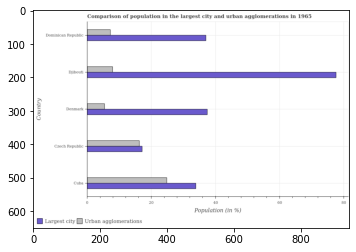

Number of QA =  28





,Country,Urban agglomerations,Largest city
0,Djibouti,8.216279,78.174935
1,Denmark,5.721579,37.839214
2,Cuba,25.264828,33.676794
3,Czech Republic,16.550337,17.419378
4,Dominican Republic,7.448916,37.476101


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the population in urban agglomerations in dominican republic ?
PREDICTED =  1.4897831327925295
EXPECTED =  7.19533017630854




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum population in urban agglomerations ?
PREDICTED =  5.052965577147221
EXPECTED =  24.8093729214991




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum population in urban agglomerations ?
PREDICTED =  1.1443157115581903
EXPECTED =  5.37618714096948




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after trai

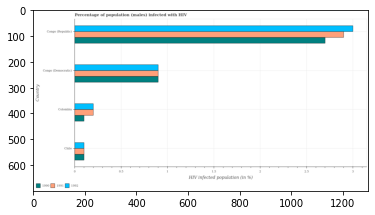

Number of QA =  29





,Country,1992,1990,1991
0,Colombia,0.206918,0.106718,0.207471
1,Chile,0.108379,0.107564,0.107984
2,Congo (Democratic),0.905172,0.903391,0.900270
3,Congo (Republic),2.985882,2.714147,2.894254


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected male population in 1990 in chile and that in congo (democratic) ?
PREDICTED =  -0.7958277394858492
EXPECTED =  -0.8




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected male population in 1990 in congo (republic) and the percentage of hiv infected male population in 1992 in congo (democratic)?
PREDICTED =  1.8107555431343618
EXPECTED =  1.8000000000000003




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected male population in 1990 and percentage of hiv infected mal

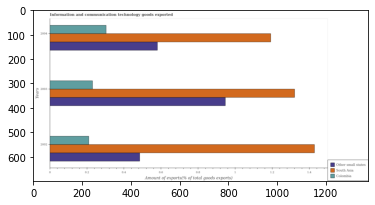

Number of QA =  29





,Years,Other small states,South Asia,Colombia
0,2004,0.590359,1.203730,0.308046
1,2003,0.947113,1.331057,0.233688
2,2002,0.488601,1.429318,0.211852


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods exported in south asia in 2002 and that in 2004 ?
PREDICTED =  0.22558734965188187
EXPECTED =  0.2360958328570999




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods exported in south asia in 2003 and the amount of goods exported in other small states in 2002 ?
PREDICTED =  -0.0982605741275302
EXPECTED =  0.8357357308950331




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the amount of goods exported in south asia and amount of goods exported in colombia ?
PREDICTED =  0.9641051823432281
EXPECT

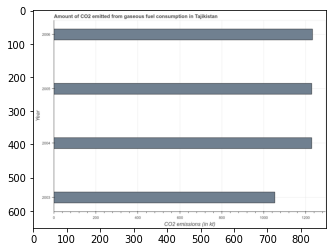

Number of QA =  23





,Year,CO2 emissions (in kt)
0,2003,1048.654771
1,2004,1230.674719
2,2005,1223.690386
3,2006,1237.613656


> what is the title of the graph ?
PREDICTED =  Amount of CO2 emitted from gaseous fuel consumption in Tajikistan
EXPECTED =  Amount of CO2 emitted from gaseous fuel consumption in Tajikistan




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  CO2 emissions (in kt)
EXPECTED =  CO2 emissions (in kt)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 emissions from gaseous fuel consumption in 2003 and 2006 ?
PREDICTED =  -188.95888509331917
EXPECTED =  -179.683




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median co2 emissions from gaseous fuel consumption ?
PREDICTED =  1227.18255246128
EXPE

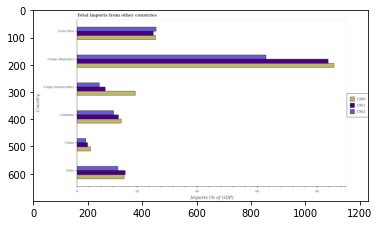

Number of QA =  29





,Country,1962,1961,1960
0,Chile,13.766806,16.256957,15.946363
1,China,3.152232,3.814444,4.702963
2,Costa Rica,26.610692,25.777428,26.296645
3,Congo (Democratic),7.713936,9.773129,19.856660
4,Congo (Republic),63.296991,81.370389,86.866075
5,Colombia,12.399745,14.213057,14.995102


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports in 1962 in china and that in colombia ?
PREDICTED =  -9.247512993674526
EXPECTED =  -9.25425219954742




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports in 1961 in chile and the total imports in 1962 in colombia?
PREDICTED =  2.043899695734636
EXPECTED =  3.8600572312811003




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total imports in 1961 and total imports in 1962 in costa rica ?
PREDICTED =  124.59471000974827
EXPECTED =  -0.9461385431928981




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_availa

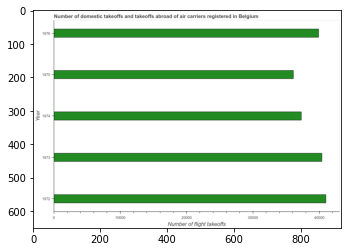

Number of QA =  23





,Year,Number of flight takeoffs
0,1974,37226.775777
1,1973,40441.597296
2,1976,40038.974248
3,1975,36248.226442
4,1972,40978.981773


> what is the title of the graph ?
PREDICTED =  Number of domestic takeoffs and takeoffs abroad of air carriers registered in Belgium
EXPECTED =  Number of domestic takeoffs and takeoffs abroad of air carriers registered in Belgium




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Number of flight takeoffs
EXPECTED =  Number of flight takeoffs




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of flight takeoffs in 1973 and 1976 ?
PREDICTED =  402.623047840294
EXPECTED =  500.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of flight takeoffs ?
PREDICTED =  40038.974248359

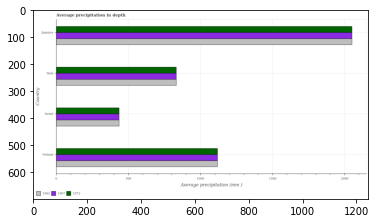

Number of QA =  29





,Country,1972,1967,1962
0,Jamaica,3698.602047,3690.126547,3700.515855
1,Ireland,2025.071500,2004.552050,2034.838438
2,Israel,796.016491,794.027622,788.680588
3,Italy,1512.584321,1504.687467,1506.663899


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the average precipitation in 1967 in italy and that in jamaica ?
PREDICTED =  -2185.439080342454
EXPECTED =  -1219.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the average precipitation in 1972 in ireland and the average precipitation in 1967 in jamaica?
PREDICTED =  -1673.5305465396862
EXPECTED =  -933.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the average precipitation in 1962 and average precipitation in 1967 in israel ?
PREDICTED =  2906.4882330245664
EXPECTED =  0.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available

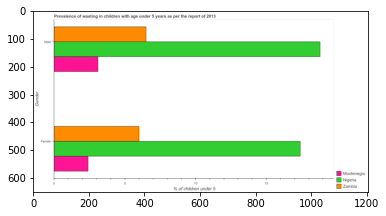

Number of QA =  23





,Gender,Zambia,Nigeria,Montenegro
0,Male,6.539838,18.819161,3.156223
1,Female,6.000518,17.319143,2.452617


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished female children in nigeria and that in zambia ?
PREDICTED =  11.31862492081784
EXPECTED =  11.399999618530298




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished female children in zambia and the percentage of undernourished male children in montenegro ?
PREDICTED =  3.547900552964815
EXPECTED =  2.90000009536743




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of undernourished male children and percentage of undernourished female children in nigeria ?
PREDICTED =  -11.3

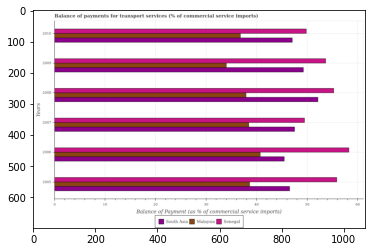

Number of QA =  29





,Years,Senegal,Malaysia,South Asia
0,2006,59.588557,NaN,46.041981
1,2007,49.897919,38.913085,47.910973
2,2010,49.933910,36.947686,46.552324
3,2009,53.153445,34.216221,48.846012
4,2008,56.452163,38.226709,52.126486
5,2005,56.557158,39.343216,47.280443


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services in malaysia in 2007 and that in 2010 ?
PREDICTED =  1.9653991065749778
EXPECTED =  1.6448623360490089




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services in senegal in 2009 and the balance of payments for transport services in south asia in 2008 ?
PREDICTED =  -3.2987181195514523
EXPECTED =  1.5331811559006994




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the balance of payments for transport services in south asia and balance of payments

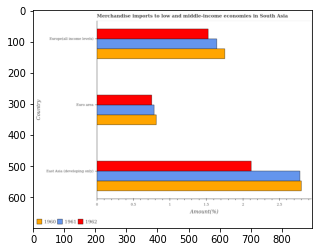

Number of QA =  29





,Country,1962,1961,1960
0,Euro area,0.759730,0.791091,0.821705
1,East Asia (developing only),2.132138,2.804318,2.813593
2,Europe(all income levels),1.536761,1.638926,1.750914


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in 1960 in euro area and the percentage of amount earned from merchandise imports in 1962 in east asia (developing only)?
PREDICTED =  -1.3104327191478529
EXPECTED =  -1.300252483906449




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of amount earned from merchandise imports in 1962 in euro area to that in europe(all i

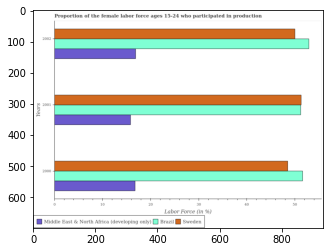

Number of QA =  29





,Years,Sweden,Middle East & North Africa (developing only),Brazil
0,2002,50.517815,17.287695,53.321185
1,2000,49.103083,17.155587,51.792906
2,2001,52.023125,16.037166,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female labor force who participated in production in middle east & north africa (developing only) in 2001 and that in 2002 ?
PREDICTED =  -1.2505288512075978
EXPECTED =  -1.0528592262432994




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the female labor force who participated in production in sweden in 2000 and the proportion of the female labor force who participated in production in middle east & north africa (developing only) in 2002 ?
PREDICTED =  31.81538802790431
EXPECTED =  31.6281185484812




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0

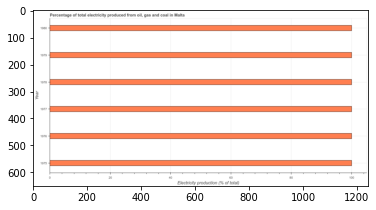

Number of QA =  23





,Year,Electricity production (% of total)
0,1980,99.842255
1,1975,100.322687
2,1978,99.962209
3,1977,99.381881
4,1976,100.035484
5,1979,99.868801


> what is the title of the graph ?
PREDICTED =  Percentage of total electricity produced from oil, gas and coal in Malta
EXPECTED =  Percentage of total electricity produced from oil, gas and coal in Malta




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Electricity production (% of total)
EXPECTED =  Electricity production (% of total)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the electricity production in 1976 and 1979 ?
PREDICTED =  0.16668281991782408
EXPECTED =  0.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median electricity production ?
PREDICTED =  99.38188139247387
EXPECTED

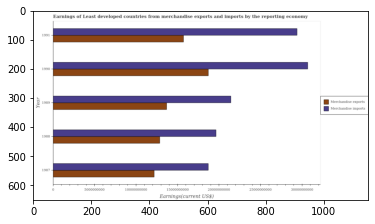

Number of QA =  28





,Year,Merchandise imports,Merchandise exports
0,1991,5.348014e+10,2.856099e+10
1,1990,5.576075e+10,3.409846e+10
2,1988,3.556512e+10,2.347105e+10
3,1989,3.885231e+10,2.473310e+10
4,1987,3.399903e+10,2.222675e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise imports in 1990 and that in 1991 ?
PREDICTED =  2280608214.0172195
EXPECTED =  1288612779.291




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise exports in 1990 and the earnings from merchandise imports in 1989 ?
PREDICTED =  9365365699.017159
EXPECTED =  -2713595451.1843987




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the earnings from merchandi

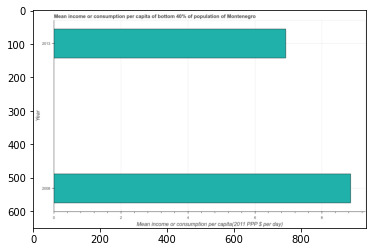

Number of QA =  19





,Year,Mean income or consumption per capita(2011 PPP $ per day)
0,2008,8.823293
1,2013,7.054004


> what is the title of the graph ?
PREDICTED =  Mean income or consumption per capita of bottom 40% of population of Montenegro
EXPECTED =  Mean income or consumption per capita of bottom 40% of population of Montenegro




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Mean income or consumption per capita(2011 PPP $ per day)
EXPECTED =  Mean income or consumption per capita(2011 PPP $ per day)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the mean income or consumption in 2008 and 2013 ?
PREDICTED =  1.769289789393314
EXPECTED =  1.936




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median me

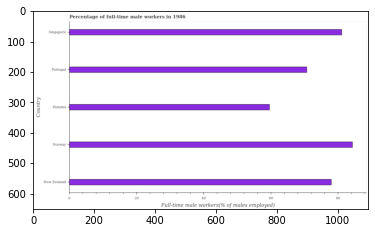

Number of QA =  22





,Country,Full-time male workers(% of males employed)
0,Panama,59.549571
1,Norway,84.448456
2,Portugal,71.029761
3,New Zealand,78.419227
4,Singapore,81.144179


> what is the title of the graph ?
PREDICTED =  Percentage of full-time male workers in 1986
EXPECTED =  Percentage of full-time male workers in 1986




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Full-time male workers(% of males employed)
EXPECTED =  Full-time male workers(% of males employed)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of full-time male workers in new zealand and singapore ?
PREDICTED =  -2.724951596820489
EXPECTED =  -3.1




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of full-time male workers ?
PREDICTED =  78.41922717686967
EX

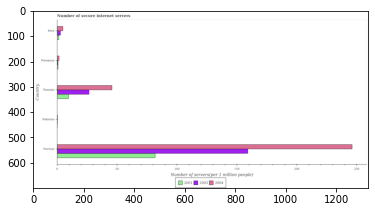

Number of QA =  29





,Country,2003,2004,2001
0,Pakistan,NaN,NaN,NaN
1,NaN,5.929563,9.342533,3.178477
2,Norway,287.970452,444.918480,148.408216
3,Paraguay,NaN,3.879515,NaN
4,Panama,48.701341,83.297805,18.215095


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of secure internet servers in 2004 in paraguay and that in peru ?
PREDICTED =  -1.0
EXPECTED =  -3.1520086125096305




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of secure internet servers in 2001 in peru and the number of secure internet servers in 2004 in norway?
PREDICTED =  1.0
EXPECTED =  -244.75220605178532




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of secure internet servers in 2003 and number of secure internet servers in 2001 in panama ?
PREDICTED =  2.0
EXPECTED =  17.1470953072443




				 0 / 3 

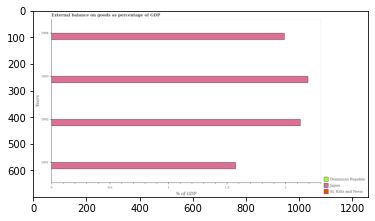

Number of QA =  23





,Years,Japan,Dominican Republic,St. Kitts and Nevis
0,1994,1.995270,NaN,NaN
1,1991,1.580063,NaN,NaN
2,1992,2.134421,NaN,NaN
3,1993,2.188675,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the external balance on goods as percentage of gdp in japan in 1993 and that in 1994 ?
PREDICTED =  nan
EXPECTED =  0.20132394729713998




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the external balance on goods as percentage of gdp in japan in 1991 to that in 1992 ?
PREDICTED =  0.7402768490004563
EXPECTED =  0.7398192518270681




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the lowe

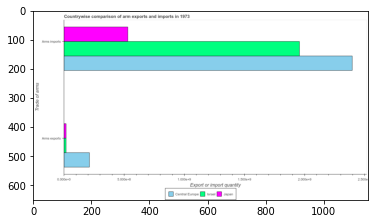

Number of QA =  23





,Trade of arms,Japan,Central Europe,Israe’
0,Arms exports,0.235448,2.201421,0.235662
1,Arms imports,5.382677,24.171048,19.688664


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the arms exports in israel and that in japan ?
PREDICTED =  0.7645515489886541
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Export or import quantity
EXPECTED =  500000000.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Countrywise comparison of arm exports and imp

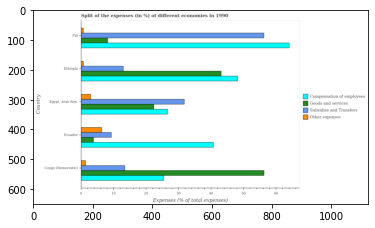

Number of QA =  30





,Country,Compensation of employees,Goods and services,Other expenses,Subsidies and Transfers
0,Congo (Democratic),25.890820,56.149230,1.650555,13.951433
1,Fiji,64.527051,8.543092,1.000208,56.517554
2,Ethiopia,48.738494,43.552239,0.996512,13.321085
3,Ecuador,NaN,4.099964,6.668000,9.705890
4,"Egypt, Arab Rep.",26.892743,22.535124,3.251417,32.169311


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount spent on other expenses in fiji and the percentage of amount spent on goods and services in ecuador ?
PREDICTED =  -5.667791493947062
EXPECTED =  -3.105191155720346




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount spent on other expenses and percentage of amount spent on goods and services in ethiopia ?
PREDICTED =  -36.88423919720044
EXPECTED =  -42.406




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after

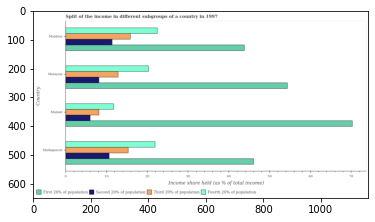

Number of QA =  30





,Country,First 20% of population,Third 20% of population,Fourth 20% of populatior,Second 20% of population
0,Moldova,43.905551,15.963608,22.709228,11.621313
1,Madagascar,46.180171,15.409400,22.016175,10.791090
2,Malawi,70.450350,8.247757,11.909983,6.156968
3,Malaysia,54.590195,13.032431,NaN,8.424770


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the share of the income held by second 20% of the population in malawi and that in malaysia ?
PREDICTED =  -2.2678015971368035
EXPECTED =  -2.15




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the share of the income held by second 20% of the population in malaysia and the share of the income held by fourth 20% of the population in malawi ?
PREDICTED =  -62.0255807752464
EXPECTED =  -3.6099999999999994




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the share of the income held by first 20% of the population and share of the income held by second

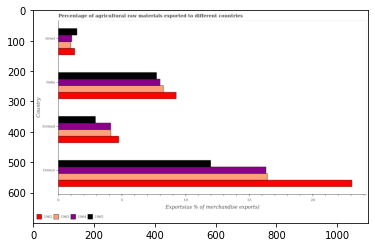

Number of QA =  30





,Country,1965,1964,1962,1963
0,Greece,11.992299,16.328477,22.998844,16.439814
1,Israel,NaN,1.101325,1.327256,1.019258
2,Iceland,NaN,4.183140,4.815622,4.228292
3,India,7.775423,8.010738,9.421223,8.378159


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in 1963 in greece and that in israel ?
PREDICTED =  15.420555517533884
EXPECTED =  15.46306159138383




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in 1964 in iceland and the percentage of exports to different countries in 1963 in israel?
PREDICTED =  3.0818149309984495
EXPECTED =  3.1490093438015734




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in 1963 and percentage of exports to different countri

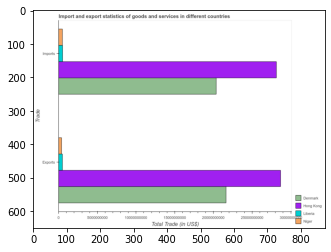

Number of QA =  23





,Trade,Niger,Liberia,Hong Kong,Denmark
0,Imports,9.726368e+08,9.914164e+08,5.048752e+10,3.668792e+10
1,Exports,7.724555e+08,9.517795e+08,5.146354e+10,3.884958e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Total Trade (in US$)
EXPECTED =  5000000000.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Import and export statistics of goods and services in different countries
EXPECTED =  Import and export statistics of goods and services in different countries




				 1 / 6 = 

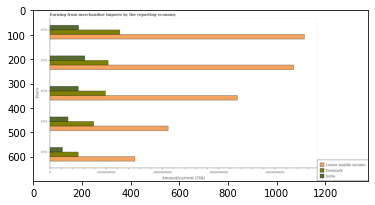

Number of QA =  29





,Years,India,Lower middle income,Denmark
0,1974,5.124220e+09,3.335383e+10,9.972912e+09
1,1975,6.229096e+09,4.367909e+10,1.043671e+10
2,1972,2.299459e+09,1.518975e+10,5.115354e+09
3,1976,5.136844e+09,4.463287e+10,1.250639e+10
4,1973,3.291030e+09,NaN,7.889756e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise imports in india in 1973 and that in 1975 ?
PREDICTED =  -2938065905.0511656
EXPECTED =  -2964090000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise imports in india in 1973 and the amount earned from merchandise imports in denmark in 1974 ?
PREDICTED =  -1833190744.3612747
EXPECTED =  -6643060000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1974, what is the difference between the amount earned from merchandise imports in lower middle income and amount earned from merchandise imports in denma

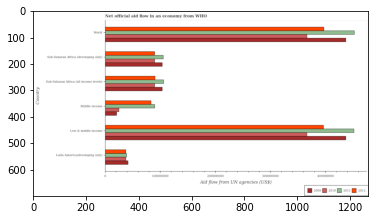

Number of QA =  30





,Country,2010,2012,2009,2011
0,World,3.681230e+08,4.056659e+08,4.407606e+08,NaN
1,Sub-Saharan Africa (developing only),9.206557e+07,9.258222e+07,1.049971e+08,1.093336e+08
2,Low & middle income,3.690131e+08,4.005833e+08,4.395205e+08,4.297908e+08
3,Sub-Saharan Africa (all income levels),9.079647e+07,9.351920e+07,1.047690e+08,1.073290e+08
4,Latin America(developing only),3.910891e+07,3.871564e+07,4.214250e+07,3.987318e+07
5,Middle income,2.593085e+07,8.508713e+07,2.185626e+07,9.092211e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in 2009 in low & middle income and that in middle income ?
PREDICTED =  -21856256.069113612
EXPECTED =  415990000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in 2011 in latin america(developing only) and the net official aid flow in 2009 in world?
PREDICTED =  0.0
EXPECTED =  -397810000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in 2010 and net official aid flow in 2011 in sub-saharan africa (developing only) ?
PREDICTED =  259679478.82774436
EXPECTED =  -1

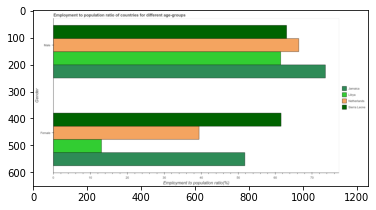

Number of QA =  23





,Gender,Netherlands,Sierra Leone,Jamaica,Libya
0,Male,66.706269,63.242834,73.982120,62.173041
1,Female,39.792990,61.670477,52.460426,13.037030


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum employment to population ratio(female) ?
PREDICTED =  1.3183333459265025
EXPECTED =  13.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluatio

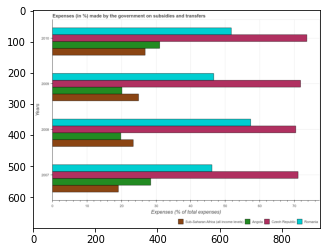

Number of QA =  30





,Years,Angola,Czech Republic,Sub-Saharan Africa (all income levels},Romania
0,2010,31.248529,73.956705,26.927314,51.825414
1,2009,20.330997,72.257308,24.669749,NaN
2,2007,28.544196,71.339998,19.341791,NaN
3,2008,19.744813,70.703572,23.572745,57.605760


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenses made by the government on subsidies and transfers in czech republic in 2008 and that in 2009 ?
PREDICTED =  -45.32999409948528
EXPECTED =  -1.3885117500841915




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenses made by the government on subsidies and transfers in romania in 2009 and the percentage of expenses made by the government on subsidies and transfers in sub-saharan africa (all income levels) in 2007 ?
PREDICTED =  2.2575643126399676
EXPECTED =  27.59649243156039




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the yea

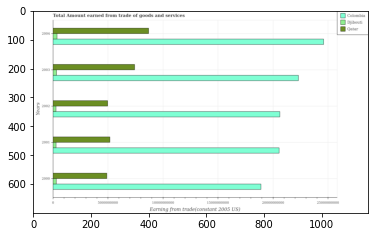

Number of QA =  29





,Years,Colombia,Djibouti,Qatar
0,2004,4.461814e+10,7.854774e+08,1.584868e+10
1,2001,3.722927e+10,6.158570e+08,9.428795e+09
2,2002,3.730218e+10,5.900761e+08,9.096464e+09
3,2003,4.005264e+10,6.811835e+08,NaN
4,2000,3.417117e+10,6.457747e+08,8.929714e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount earned by trading goods and services in qatar in 2000 and that in 2002 ?
PREDICTED =  -9096464431.469322
EXPECTED =  -70451490.63370991




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount earned by trading goods and services in qatar in 2000 and the total amount earned by trading goods and services in colombia in 2002 ?
PREDICTED =  -9096464431.469322
EXPECTED =  -15726028968.17721




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the total amount earned by trading goods and services in djibouti and t

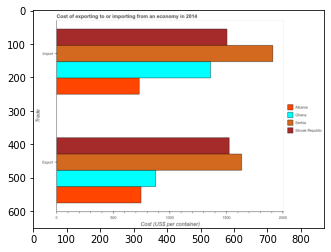

Number of QA =  23





,Trade,Unnamed: 1,Albania,Ghana,Slovak Republic
0,Import,1913.347830,732.681144,1364.414154,1529.583484
1,Export,1639.758602,746.693079,877.827302,1526.756462


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export cost in albania and the import cost in ghana ?
PREDICTED =  -617.7210754515802
EXPECTED =  -615




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the import cost in slovak republic to that in ghana ?
PREDICTED =  1.1210551276222056
EXPECTED =  1.1066176470588236




				 2 / 4 = 0.5


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Cost (U

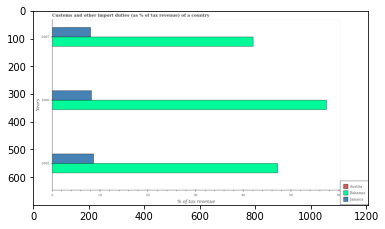

Number of QA =  26





,Years,Austria,Jamaica,Bahamas
0,2005,NaN,8.797830,47.535866
1,2007,NaN,8.232793,42.273523
2,2006,NaN,8.424719,57.519946


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of tax revenue from customs in bahamas in 2005 and that in 2007 ?
PREDICTED =  5.262343044340838
EXPECTED =  5.127137157321499




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of tax revenue from customs in bahamas in 2005 and the percentage of tax revenue from customs in austria in 2007 ?
PREDICTED =  5.262343044340838
EXPECTED =  47.1970587159022




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the percentage of tax revenue from customs in austria and percentage of tax revenue from customs in bahama

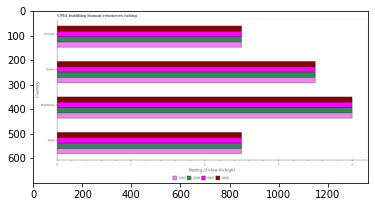

Number of QA =  30





,Country,2007,2005,2008,2006
0,Kiribati,2.512414,2.523809,2.518446,2.507149
1,Honduras,4.016253,4.014265,4.010135,4.005601
2,Haiti,2.503324,2.526398,2.512448,2.512544
3,Kenya,3.523983,3.509118,3.519350,3.509464


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2005 in haiti and that in kenya ?
PREDICTED =  -0.9827194149955472
EXPECTED =  -1.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2008 in honduras and the cpia rating in 2007 in kiribati?
PREDICTED =  1.491688885730917
EXPECTED =  1.5




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2008 and cpia rating in 2005 in kenya ?
PREDICTED =  9.051261895482156
EXPECTED =  0.0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation f

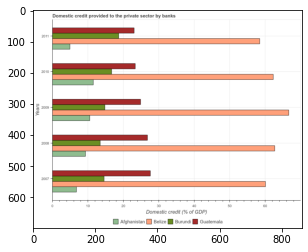

Number of QA =  30





,Years,Belize,Burundi,Afghanistan,Guatemala
0,2007,60.351122,14.694930,6.854072,27.915694
1,2010,62.444845,16.767025,11.710801,23.677630
2,2008,62.835600,13.664772,9.502347,27.214335
3,2009,66.810376,14.533911,10.751334,24.992321
4,2011,58.703128,18.783888,5.089879,23.316521


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the domestic credit provided to the private sector by banks in afghanistan in 2007 and that in 2011 ?
PREDICTED =  1.7641930988739105
EXPECTED =  1.8415770750564384




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the domestic credit provided to the private sector by banks in belize in 2010 and the domestic credit provided to the private sector by banks in afghanistan in 2008 ?
PREDICTED =  -0.39075520462860425
EXPECTED =  52.94180907967112




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or

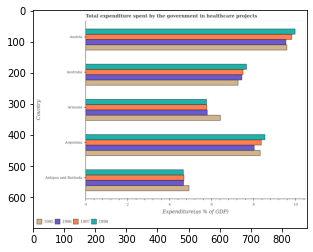

Number of QA =  30





,Country,1996,1995,1997,1998
0,Antigua and Barbuda,4.695685,4.940642,4.693388,4.675943
1,Armenia,NaN,NaN,NaN,5.781362
2,Australia,7.481354,7.323580,NaN,7.693652
3,Austria,9.634043,9.599675,9.857380,9.976307
4,Argentina,8.041620,NaN,NaN,8.537531


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total expenditure spent by the government in healthcare projects in 1997 in armenia and that in australia ?
PREDICTED =  4.693388421289582
EXPECTED =  -1.7279209600000005




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total expenditure spent by the government in healthcare projects in 1996 in argentina and the total expenditure spent by the government in healthcare projects in 1995 in antigua and barbuda?
PREDICTED =  3.345935065388379
EXPECTED =  3.1007957499999996




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total expenditure sp

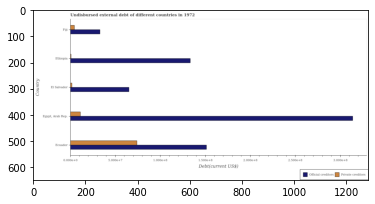

Number of QA =  28





,Country,Official creditors,Private creditors
0,El Salvador,11.854091,0.405297
1,Fiji,5.961074,0.894511
2,Ethiopia,24.154426,NaN
3,"Egypt, Arab Rep.",55.590285,2.049823
4,Ecuador,27.327413,13.237992


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the undisbursed external debt of official creditors in el salvador and that in ethiopia ?
PREDICTED =  -12.30033588240111
EXPECTED =  -68140000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the undisbursed external debt of official creditors in fiji and the undisbursed external debt of private creditors in el salvador ?
PREDICTED =  5.555776771943054
EXPECTED =  31141000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the undisbursed external debt of private creditors and undisbursed external debt of official creditors in el salvador ?
PRED

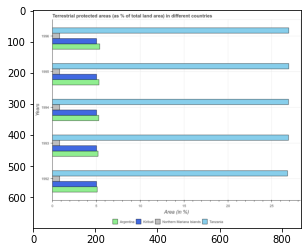

Number of QA =  30





,Years,Tanzania,Argentina,Kiribati,Northern Mariana Islands
0,1993,26.969429,5.287819,5.116931,0.876627
1,1995,27.017724,5.347583,5.100523,0.868419
2,1996,27.005442,5.420208,5.172288,0.880573
3,1994,26.968687,5.359610,5.119238,0.873957
4,1992,NaN,5.205897,5.124484,0.871750


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of terrestrial protected land in argentina in 1993 and that in 1996 ?
PREDICTED =  -0.132388552871606
EXPECTED =  -0.19282245607198956




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of terrestrial protected land in northern mariana islands in 1993 and the percentage of terrestrial protected land in kiribati in 1994 ?
PREDICTED =  0.002670046253239633
EXPECTED =  -4.212966213723662




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the percentage of terrestrial protected land in tanzania and percentage

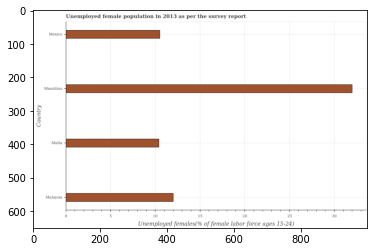

Number of QA =  22





,Country,Unemployed females(% of female labor force ages 15-24)
0,Malaysia,12.067429
1,Mauritius,32.037280
2,Mexico,10.478890
3,Malta,10.409845


> what is the title of the graph ?
PREDICTED =  Unemployed female population in 2013 as per the survey report
EXPECTED =  Unemployed female population in 2013 as per the survey report




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Unemployed females(% of female labor force ages 15-24)
EXPECTED =  Unemployed females(% of female labor force ages 15-24)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed female youth in mauritius and mexico ?
PREDICTED =  21.55838941354494
EXPECTED =  21.5




				 4 / 4 = 1.0


> what is the median unemployed female youth ?
PREDICTED =  None
EXPECTED =  11.25




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting 

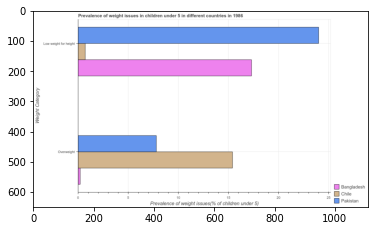

Number of QA =  23





,Weight Category,Chile,Pakistan,Bangladesh
0,Overweight,15.498102,7.814050,0.255727
1,Low weight for height,0.751110,24.093466,17.413834


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of underweight children in pakistan to that in chile ?
PREDICTED =  10.403330952885508
EXPECTED =  34.28571486959653




				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Prevalence of weight issues(% of children under 5)
EXPECTED =  5.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED = 

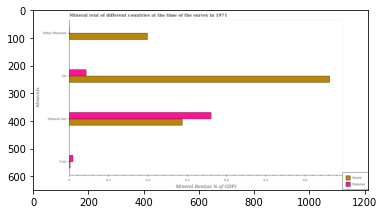

Number of QA =  29





,Minerals,Pakistan,World
0,Coal,0.010674,0.003813
1,Other Minerals,NaN,0.201395
2,Natural Gas,0.360769,0.290162
3,Oil,0.044713,0.665854


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the  rent of other minerals in pakistan and that in world ?
PREDICTED =  -0.2013952626204456
EXPECTED =  -0.1985969441790671




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oil rent in pakistan and the coal rent in world ?
PREDICTED =  0.04089971847700421
EXPECTED =  0.04075056424506389




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the  rent of other minerals in pakistan to that in world ?
PREDIC

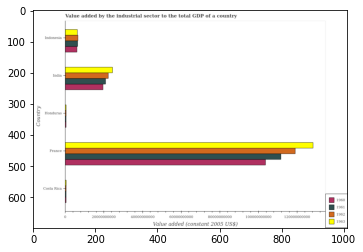

Number of QA =  30





,Country,1963,1962,1961,1960
0,Costa Rica,7.370721e+08,NaN,NaN,NaN
1,France,1.291663e+11,1.207260e+11,1.131058e+11,1.038839e+11
2,Indonesia,6.529682e+09,6.904315e+09,6.725200e+09,6.295570e+09
3,India,2.498118e+10,2.256402e+10,2.123245e+10,1.987825e+10
4,Honduras,7.609109e+08,NaN,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector in 1961 in india and that in indonesia ?
PREDICTED =  14507248150.779758
EXPECTED =  14459562151.937729




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector in 1963 in india and the value added by the industrial sector in 1961 in honduras?
PREDICTED =  24220264625.541584
EXPECTED =  24061444759.44951




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector in 1962 and value added by the industrial sector in 1963 in france ?
PREDICTED =  21

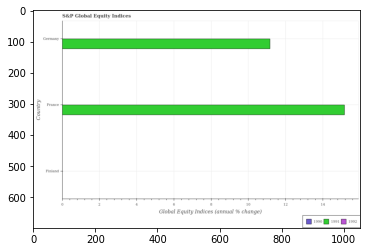

Number of QA =  21





,Country,1992,1990,1991
0,France,NaN,NaN,15.355252
1,Finland,NaN,NaN,NaN
2,Germany,NaN,NaN,11.247059


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the global equity indices in 1991 in france and that in germany ?
PREDICTED =  4.108192187297838
EXPECTED =  4.0041594292339




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the global equity indices in 1990 in finland and the global equity indices in 1991 in france?
PREDICTED =  nan
EXPECTED =  -15.1665639259892




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the global equity indices in 1991 in france to that in germany ?
PREDICTED =  1.365268114263621
EXPECTED =  1.3587183595073833




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: Fals

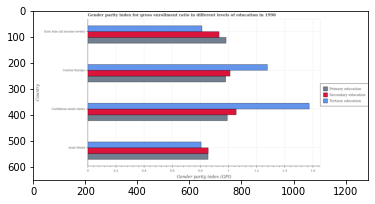

Number of QA =  29





,Country,Secondary education,Tertiary education,Primary education
0,Arab World,0.870296,0.809677,0.859108
1,East Asia (all income levels),0.937681,0.817613,0.987776
2,Central Europe,1.018524,1.280920,NaN
3,Caribbean small states,1.060021,1.570067,0.996101


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gender parity index in tertiary education in central europe and that in east asia (all income levels) ?
PREDICTED =  0.46330710287466725
EXPECTED =  0.465




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gender parity index in secondary education in central europe and the gender parity index in primary education in caribbean small states ?
PREDICTED =  -0.04149626967946518
EXPECTED =  0.019550025463105025




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the gender parity index in secondary education and gender parity index in tertiary educa

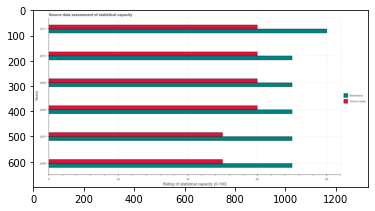

Number of QA =  28





,Years,Timor-Leste,Botswana
0,2010,61.047651,70.440832
1,2011,60.149495,80.631769
2,2007,50.456512,70.058985
3,2009,60.293693,70.436739
4,2008,60.611088,70.670682
5,2006,50.410187,69.611915


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in botswana in 2007 and that in 2008 ?
PREDICTED =  -0.6116972531636264
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in timor-leste in 2011 and the rating of statistical capacity in botswana in 2007 ?
PREDICTED =  9.692982505110088
EXPECTED =  -10.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the rating of statistical capacity in timor-leste and rating of statistical capacity in botswana ?
PREDICTED =  -10.927503139803584
EXPECTED =  -20.0

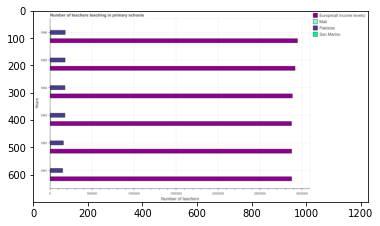

Number of QA =  30





,Years,Mali,San Marino,Europe(all income levels),Pakistan
0,1986,NaN,NaN,5.330898e+06,336183.337409
1,1983,NaN,NaN,5.183450e+06,332007.988236
2,1985,28381.959337,NaN,5.249212e+06,332312.176999
3,1984,NaN,NaN,5.199160e+06,327712.053297
4,1981,NaN,NaN,5.176481e+06,278355.271672
5,1982,NaN,NaN,5.187366e+06,292177.124910


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of teachers teaching in primary schools in europe(all income levels) in 1981 and that in 1984 ?
PREDICTED =  -22679.346764571033
EXPECTED =  -8923.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of teachers teaching in primary schools in europe(all income levels) in 1985 and the number of teachers teaching in primary schools in mali in 1983 ?
PREDICTED =  65761.71597416885
EXPECTED =  2909144.25




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1986, what is the difference between the number of teachers teaching in primary schools in europe(al

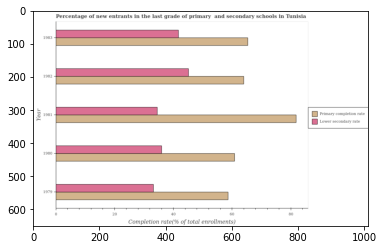

Number of QA =  28





,Year,Primary completion rate,Lower secondary rate
0,1983,66.017403,42.130614
1,1982,64.163844,45.792810
2,1979,58.753474,33.539443
3,1980,61.572509,36.603684
4,1981,82.550466,34.773428


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the completion rate in primary schools in 1979 and that in 1980 ?
PREDICTED =  -2.8190357619819153
EXPECTED =  -2.215




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the completion rate in secondary schools in 1980 and the completion rate in primary schools in 1979 ?
PREDICTED =  -22.149789977815225
EXPECTED =  -22.62287




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1983, what is the difference between the completion rate in primary schools and completion rate in secondary schools ?
PREDICTED =  0.0
EXPECTED =  23.605




				 1 / 3 = 0.3333


is_built_with_cuda:

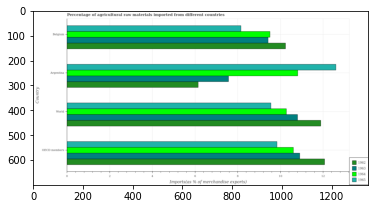

Number of QA =  30





,Country,1965,1964,1962,1963
0,Argentina,12.615805,10.897250,6.169194,7.590103
1,World,9.587697,10.297366,11.841619,10.750410
2,Belgium,8.161051,9.525204,10.339786,9.427741
3,OECD members,9.882835,10.578399,12.010219,10.990670


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in 1962 in argentina and that in world ?
PREDICTED =  3.1691939300934866
EXPECTED =  -5.744939851890599




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in 1964 in argentina and the percentage of imports to different countries in 1962 in belgium?
PREDICTED =  1.372045703803094
EXPECTED =  0.5741750578504998




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in 1963 and percentage of imports to different co

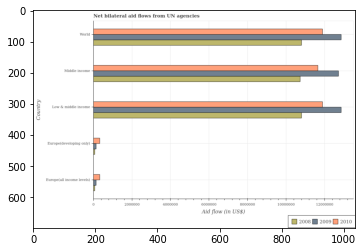

Number of QA =  29





,Country,2008,2010,2009
0,Low & middle income,1.086878e+07,1.193293e+07,1.293397e+07
1,World,1.080919e+07,1.186801e+07,1.292280e+07
2,Middle income,1.081389e+07,1.173680e+07,1.276955e+07
3,Europe(all income levels),1.086165e+05,3.642767e+05,1.700172e+05
4,Europe(developing only),1.082848e+05,3.665440e+05,1.711958e+05


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 2009 in low & middle income and that in middle income ?
PREDICTED =  -12769554.12025421
EXPECTED =  140000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 2008 in europe(developing only) and the net bilateral aid flow in 2010 in world?
PREDICTED =  -10700901.132072868
EXPECTED =  -11820000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the n

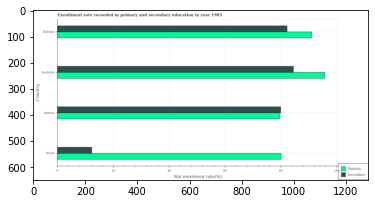

Number of QA =  28





,Country,Secondary,Primary
0,Bahrain,82.222142,91.480742
1,World,12.584755,80.466751
2,Algeria,79.931260,79.838582
3,Australia,85.071835,96.893232


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in primary education in algeria and that in australia ?
PREDICTED =  -17.054650419868594
EXPECTED =  -16.093




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in secondary education in australia and the enrollment rate in primary education in algeria ?
PREDICTED =  5.14057491926782
EXPECTED =  4.840359999999976




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in secondary education and enrollment rate in primary education in world ?
PREDICTED =  179.34324052320216
EXPECTED =  -67.807




		

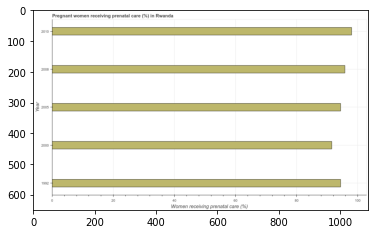

Number of QA =  23





,Year,Women receiving prenatal care (%)
0,1992,94.983335
1,2010,97.622173
2,2000,91.915904
3,2008,96.205752
4,2005,94.558091


> what is the title of the graph ?
PREDICTED =  Pregnant women receiving prenatal care (%) in Rwanda
EXPECTED =  Pregnant women receiving prenatal care (%) in Rwanda




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Women receiving prenatal care (%)
EXPECTED =  Women receiving prenatal care (%)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of pregnant women receiving prenatal care in 2008 and 2010 ?
PREDICTED =  -1.4164214000197006
EXPECTED =  -2.2




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of pregnant women receiving prenatal care ?
PREDICTED =  2005.0
EX

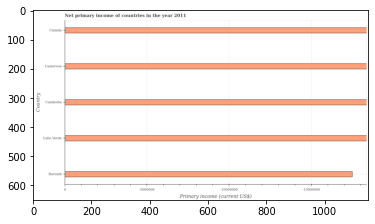

Number of QA =  12





,Country,Primary income (current US$)
0,Canada,1.104507e+07
1,Cambodia,1.113221e+07
2,Burundi,1.056687e+07
3,Cabo Verde,1.113221e+07
4,Cameroon,1.113221e+07


> what is the title of the graph ?
PREDICTED =  Net primary income of countries in the year 2011
EXPECTED =  Net primary income of countries in the year 2011




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Primary income (current US$)
EXPECTED =  Primary income (current US$)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 3 / 4 = 0.75


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Primary income (current US$)
EXPECTED =  5000000.0




				 3 / 5 = 0.6


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the amount of primary income in cabo verde ?
EXPECTED =  0
PREDICTED =  11132212.341491196





	

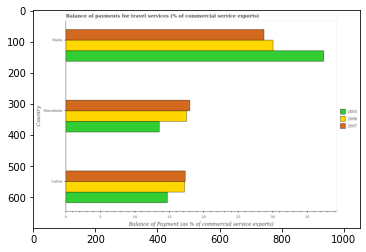

Number of QA =  29





,Country,2007,2005,2006
0,Malta,28.780927,36.975871,30.034140
1,Latvia,17.414888,14.742291,17.349201
2,Macedonia,17.991071,13.611400,17.642584


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for travel services in 2006 in macedonia and that in malta ?
PREDICTED =  -12.391555794365175
EXPECTED =  -12.541644429805999




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for travel services in 2005 in malta and the balance of payments for travel services in 2007 in latvia?
PREDICTED =  22.233580421743994
EXPECTED =  20.083407199183704




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for travel services in 2007 and balance of payments for travel services in 2005 in macedoni

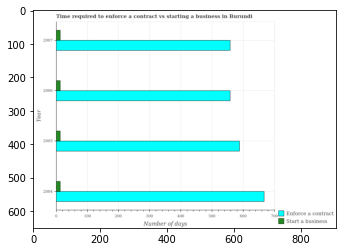

Number of QA =  28





,Year,Enforce a contract,Start a business
0,2007,561.056067,14.599667
1,2004,667.991388,14.424385
2,2005,588.539149,14.663586
3,2006,559.982130,14.442608


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days to start a business in 2004 and that in 2005 ?
PREDICTED =  -0.23920081105499946
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days to start a business in 2005 and the number of days to enforece a contract in 2004 ?
PREDICTED =  0.23920081105499946
EXPECTED =  -654




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the number of days to enforece a contract and number of days to start a business ?
PREDICTED =  0.0
EXPECTED =  545




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_

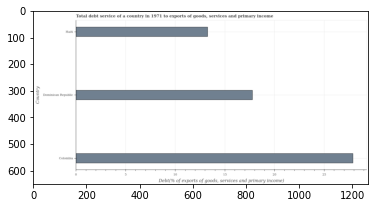

Number of QA =  22





,Country,"Debt(% of exports of goods, services and primary income)"
0,Haiti,13.307948
1,Dominican Republic,17.849409
2,Colombia,27.801140


> what is the title of the graph ?
PREDICTED =  Total debt service of a country in 1971 to exports of goods, services and primary incc
EXPECTED =  Total debt service of a country in 1971 to exports of goods, services and primary income




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Debt(% of exports of goods, services and primary income)
EXPECTED =  Debt(% of exports of goods, services and primary income)




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total debt service in dominican republic and haiti ?
PREDICTED =  15.84940892429886
EXPECTED =  4.518




				 2 / 4 = 0.5


> what is the median total debt service ?
PREDICTED =  None
EXPECTED =  17.7723688721289




				 2 / 6 = 0.3333


is_built_wit

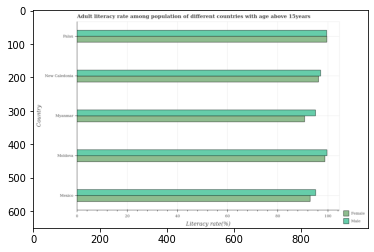

Number of QA =  28





,Country,Female,Male
0,Palau,100.084482,99.776751
1,Mexico,93.214785,95.362155
2,Moldova,98.861595,99.883269
3,Myanmar,91.133625,95.519558
4,New Caledonia,96.925870,97.054093


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male adult literacy rate in myanmar and that in new caledonia ?
PREDICTED =  -5.920467983859183
EXPECTED =  -2.049




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male adult literacy rate in moldova and the female adult literacy rate in palau ?
PREDICTED =  0.10651757265878814
EXPECTED =  0.06956481933599434




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female adult literacy rate and male adult literacy rate in moldova ?
PREDICTED =  -7.727970742085603
EXPECTED =  -0.853




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_availab

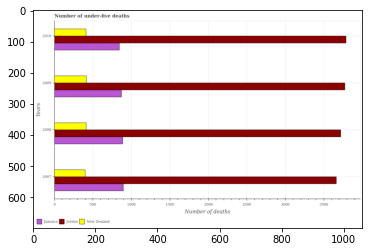

Number of QA =  29





,Years,Jamaica,New Zealand,Jordan
0,2009,1600.910851,759.760886,6833.016213
1,2010,1550.862387,754.171423,6840.492016
2,2008,1620.418170,764.353836,6751.208779
3,2007,1631.578924,735.343245,6658.532411


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of under-five deaths in jamaica in 2008 and that in 2010 ?
PREDICTED =  0.0
EXPECTED =  43




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of under-five deaths in jordan in 2010 and the number of under-five deaths in jamaica in 2007 ?
PREDICTED =  -6656.5324108516015
EXPECTED =  2894




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the number of under-five deaths in jordan and number of under-five deaths in new zealand ?
PREDICTED =  0.0
EXPECTED =  3263




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu

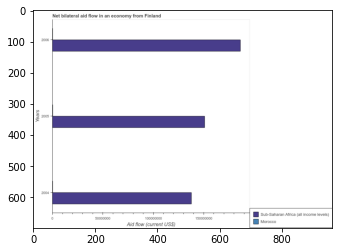

Number of QA =  28





,Years,Sub-Saharan Africa (all income levels.,Morocco
0,2006,3.361268e+08,NaN
1,2005,2.737121e+08,NaN
2,2004,2.499020e+08,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in morocco in 2005 and that in 2006 ?
PREDICTED =  -62414755.10423875
EXPECTED =  100000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in morocco in 2004 and the net bilateral aid flow in sub-saharan africa (all income levels) in 2005 ?
PREDICTED =  0.0
EXPECTED =  -150650000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the net bilateral aid flow in morocco and net bilateral aid flow in sub-saharan africa (all income levels) ?
PREDICTED =  -859740861.8013941
EXPECTED

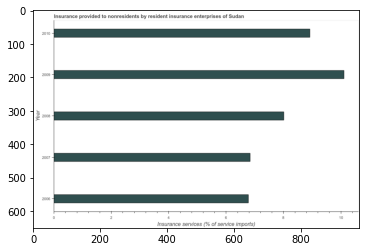

Number of QA =  23





,Year,Insurance services (% of service imports)
0,2006,6.811891
1,2007,6.849573
2,2010,8.932329
3,2009,10.147738
4,2008,7.997434


> what is the title of the graph ?
PREDICTED =  Insurance provided to nonresidents by resident insurance enterprises of Sudan
EXPECTED =  Insurance provided to nonresidents by resident insurance enterprises of Sudan




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Insurance services (% of service imports)
EXPECTED =  Insurance services (% of service imports)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the insurance and financial services in 2007 and 2010 ?
PREDICTED =  -7.634108927323124
EXPECTED =  -2.083




				 3 / 4 = 0.75


> what is the median insurance and financial services ?
PREDICTED =  None
EXPECTED =  8.01132682387196




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []


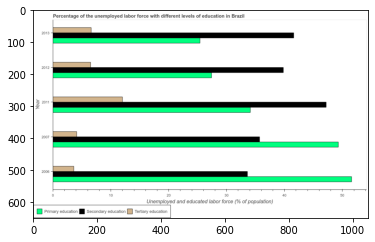

Number of QA =  29





,Year,Secondary education,Tertiary education,Primary education
0,2006,NaN,3.688303,NaN
1,2007,35.948202,4.153001,49.367639
2,2012,NaN,6.586866,NaN
3,2011,47.446376,12.153178,34.227743
4,2013,41.991761,6.703130,25.630719


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received primary education in 2006 and that in 2012 ?
PREDICTED =  15.13989569342278
EXPECTED =  24.2




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received primary education in 2006 and the percentage of labor force who received tertiary education in 2012 ?
PREDICTED =  15.13989569342278
EXPECTED =  45.0999984741211




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of labor force who received secondary education and percentage of labor force who 

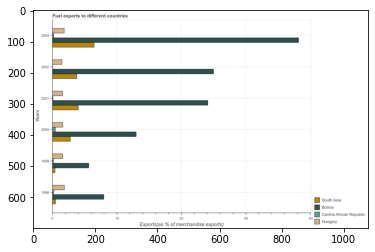

Number of QA =  30





,Years,Central African Republic,Bolivia,South Asia,Hungary
0,1999,NaN,5.755586,0.473088,1.654582
1,2000,0.537569,13.000063,2.861211,1.693321
2,2001,NaN,23.897291,4.079616,1.663043
3,2002,NaN,25.070150,3.821134,1.563314
4,2004,NaN,37.988600,6.491909,1.890123
5,1998,NaN,8.030892,0.563367,1.910192


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in central african republic in 1999 and that in 2000 ?
PREDICTED =  0.46243052534404183
EXPECTED =  -0.301008188301487




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in central african republic in 2004 and the percentage of exports to different countries in hungary in 2002 ?
PREDICTED =  0.0
EXPECTED =  -1.2940289071003799




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the percentage of exports to different countries in south asia

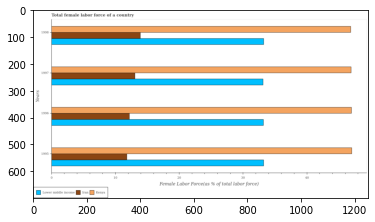

Number of QA =  29





,Years,Unnamed: 1,Kenya,Lower middle income
0,1996,12.374525,47.293206,33.369780
1,1998,14.180627,47.340615,33.524112
2,1995,12.000211,47.117971,33.594777
3,1997,13.203237,46.822060,33.431306


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force in iran in 1996 and that in 1998 ?
PREDICTED =  -0.154331739359705
EXPECTED =  -1.7134415026696015




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force in kenya in 1995 and the percentage of female labor force in iran in 1998 ?
PREDICTED =  -0.22264471084513815
EXPECTED =  33.114111794439786




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the percentage of female labor force in lower middle income and percentage of female labor force in kenya ?
PREDICTED =  33.

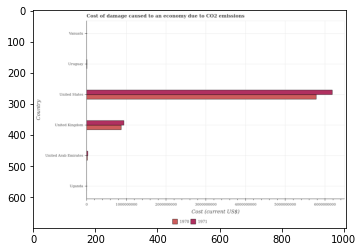

Number of QA =  28





,Country,1971,1970
0,United States,6.152119e+09,5.782065e+09
1,Uruguay,NaN,NaN
2,United Kingdom,9.467285e+08,8.876016e+08
3,Uganda,NaN,NaN
4,United Arab Emirates,NaN,3.519956e+07
5,Vanuatu,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to co2 emissisons in 1971 in united states and that in uruguay ?
PREDICTED =  0.0
EXPECTED =  6174243932.256407




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to co2 emissisons in 1971 in uganda and the cost of damage caused due to co2 emissisons in 1970 in united kingdom?
PREDICTED =  6152118983.410578
EXPECTED =  -869658529.4485718




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training

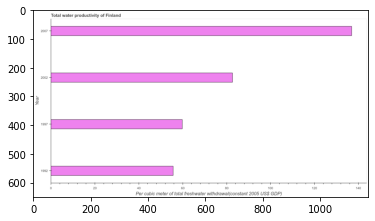

Number of QA =  23





,Year,Per cubic meter of total freshwater withdrawal(constant 2005 US$ GDP)
0,2007,136.927911
1,2002,82.824616
2,1997,60.364702
3,1992,55.831754


> what is the title of the graph ?
PREDICTED =  Total water productivity of Finland
EXPECTED =  Total water productivity of Finland




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Per cubic meter of total freshwater withdrawal(constant 2005 US$ GDP)
EXPECTED =  Per cubic meter of total freshwater withdrawal(constant 2005 US$ GDP)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total water productivity in 1997 and 2007 ?
PREDICTED =  -76.56320860191639
EXPECTED =  -77.128




				 4 / 4 = 1.0


> what is the median total water productivity ?
PREDICTED =  None
EXPECTED =  71.2374120056167




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fin

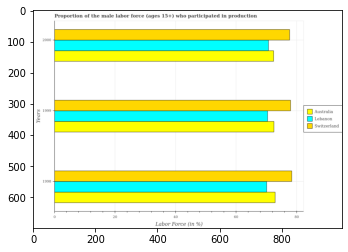

Number of QA =  29





,Years,Switzerland,Australia,Lebanon
0,2000,78.019293,72.978360,71.330505
1,1999,78.348425,73.040737,70.611458
2,1998,78.705812,73.154684,70.809191


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male labor force who participated in production in australia in 1998 and that in 2000 ?
PREDICTED =  0.17632391364161037
EXPECTED =  0.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male labor force who participated in production in australia in 1998 and the proportion of the male labor force who participated in production in lebanon in 1999 ?
PREDICTED =  0.11394770253198772
EXPECTED =  2.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the proportion of the male labor force who p

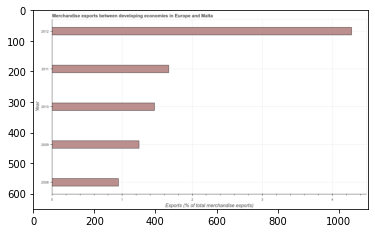

Number of QA =  23





,Year,Exports (% of total merchandise exports)
0,2012,4.276824
1,2011,1.660325
2,2008,0.952247
3,2009,1.246650
4,2010,1.473657


> what is the title of the graph ?
PREDICTED =  Merchandise exports between developing economies in Europe and Malta
EXPECTED =  Merchandise exports between developing economies in Europe and Malta




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Exports (% of total merchandise exports)
EXPECTED =  Exports (% of total merchandise exports)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in 2009 and 2010 ?
PREDICTED =  -0.22700677158796334
EXPECTED =  -0.221




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median merchandise exports ?
PREDICTED =  1.4736568480483907
EXPECTED

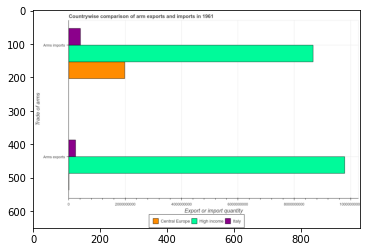

Number of QA =  23





,Trade of arms,Italy,Central Europe,High income
0,Arms exports,2.618811e+08,NaN,9.832245e+09
1,Arms imports,4.372434e+08,2.005483e+09,8.672304e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Export or import quantity
EXPECTED =  2000000000.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Countrywise comparison of arm exports and imports in 1961
EXPECTED =  Countrywise comparison of arm exports and imports in 1961




				 1 / 6 = 0.1667


> what is the labe

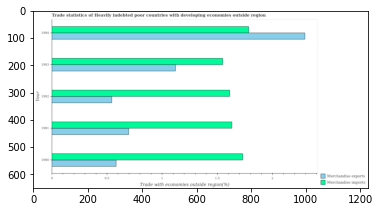

Number of QA =  28





,Year,Merchandise imports,Merchandise exports
0,1983,1.552989,1.127824
1,1980,1.729124,0.587557
2,1981,1.639064,0.702174
3,1984,1.791679,2.289364
4,1982,1.623887,0.553566


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in 1981 and that in 1983 ?
PREDICTED =  -0.4256501698952312
EXPECTED =  -0.424




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in 1981 and the merchandise imports in 1983 ?
PREDICTED =  -0.4256501698952312
EXPECTED =  -0.852212635433965




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1981, what is the difference between the merchandise imports and merchandise exports ?
PREDICTED =  -0.6220150235104034
EXPECTED =  0.936




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or pred

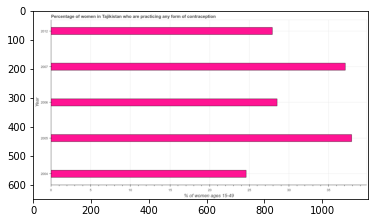

Number of QA =  23





,Year,% of women ages 15-49
0,2012,28.003551
1,2007,37.044751
2,2005,38.107939
3,2004,24.733580
4,2006,28.613037


> what is the title of the graph ?
PREDICTED =  Percentage of women in Tajikistan who are practicing any form of contraception
EXPECTED =  Percentage of women in Tajikistan who are practicing any form of contraception




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  % of women ages 15-49
EXPECTED =  % of women ages 15-49




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the contraceptive prevalence in 2006 and 2007 ?
PREDICTED =  -8.431713944700125
EXPECTED =  -8.6




				 4 / 4 = 1.0


> what is the median contraceptive prevalence ?
PREDICTED =  None
EXPECTED =  28.5




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step

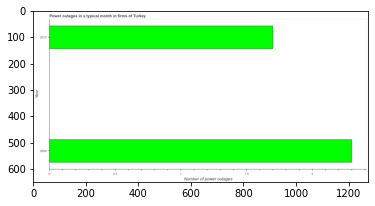

Number of QA =  19





,Year,Number of power outages
0,2013,1.721235
1,2008,2.315478


> what is the title of the graph ?
PREDICTED =  Power outages in a typical month in firms of Turkey
EXPECTED =  Power outages in a typical month in firms of Turkey




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Number of power outages
EXPECTED =  Number of power outages




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of power outages in 2008 and 2013 ?
PREDICTED =  0.5942426024003982
EXPECTED =  0.6




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of power outages ?
PREDICTED =  2.0183564851437095
EXPECTED =  2.0




				 5 / 5 = 1.0


is_built_with_cuda: True
is_gpu_av

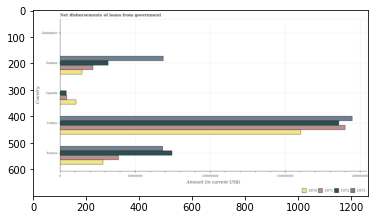

Number of QA =  27





,Country,1972,1971,1970,1973
0,Turkey,3.342814e+08,3.500556e+08,NaN,3.513906e+08
1,Uganda,8.140005e+06,8.912015e+06,1.997732e+07,NaN
2,Tunisia,1.342614e+08,7.100353e+07,5.229666e+07,1.241633e+08
3,Zimbabwe,NaN,NaN,NaN,NaN
4,Zambia,5.851335e+07,3.982208e+07,2.731834e+07,1.226568e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loan disbursed from government in 1972 in tunisia and that in uganda ?
PREDICTED =  126121369.98821892
EXPECTED =  70404000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loan disbursed from government in 1971 in tunisia and the amount of loan disbursed from government in 1972 in turkey?
PREDICTED =  -263277865.03758457
EXPECTED =  -146788000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loan disbursed from government in 1970 and amount of loan disbursed from government in 1972 in tunisia ?
PREDICT

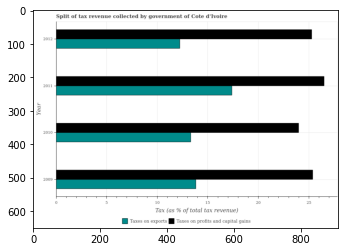

Number of QA =  28





,Year,Taxes on profits and capital gains,Taxes on exports
0,2012,25.464091,12.333009
1,2011,26.695593,17.558022
2,2009,25.549670,13.949752
3,2010,24.374456,13.510847


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue obtained from taxes on exports in 2011 and that in 2012 ?
PREDICTED =  5.225012753718152
EXPECTED =  5.15




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue obtained from taxes on exports in 2012 and the percentage of revenue obtained from taxes on profits and capital gains in 2011 ?
PREDICTED =  -5.225012753718152
EXPECTED =  -14.269494624112099




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the percentage of revenue obtained from taxes on exports and percentage of revenue obtai

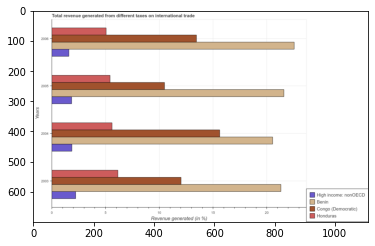

Number of QA =  30





,Years,Congo (Democratic),High income: nonOECD,Honduras,Benin
0,2006,13.474447,1.625582,5.110671,22.525763
1,2003,12.174602,2.243620,6.206061,NaN
2,2004,15.594523,1.926963,5.670328,20.648058
3,2005,10.600642,1.890995,5.463384,21.572613


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total revenue generated in congo (democratic) in 2003 and that in 2006 ?
PREDICTED =  -11.230826866477305
EXPECTED =  -1.4343262509597992




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total revenue generated in honduras in 2005 and the total revenue generated in high income: nonoecd in 2003 ?
PREDICTED =  -0.7426768587180099
EXPECTED =  3.1997702944743103




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the total revenue generated in congo (democratic) and total revenue generated in high income: nonoecd ?
PREDICTED =  4

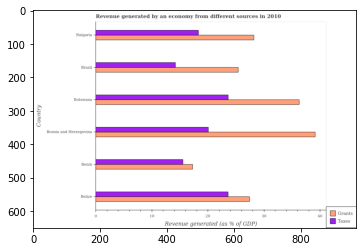

Number of QA =  28





,Country,Grants,Taxes
0,Brazil,25.127312,NaN
1,Belize,NaN,23.659233
2,Botswana,36.294531,23.761449
3,Bulgaria,NaN,18.332101
4,Benin,17.348659,15.695495
5,Bosnia and Herzegovina,NaN,19.976737


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the revenue generated by grants in benin and that in botswana ?
PREDICTED =  -18.945872348502892
EXPECTED =  -19.007




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the revenue generated by taxes in benin and the revenue generated by grants in brazil ?
PREDICTED =  15.695495203569994
EXPECTED =  -9.8642104477492




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the revenue generated by taxes and revenue generated by grants in brazil ?
PREDICTED =  76.29770319793698
EXPECTED =  -11.207




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_availa

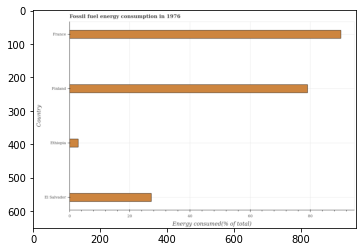

Number of QA =  22





,Country,Energy consumed(% of total)
0,Ethiopia,3.054843
1,Finland,80.281812
2,France,90.821274
3,El Salvador,27.532090


> what is the title of the graph ?
PREDICTED =  Fossil fuel energy consumption in 1976
EXPECTED =  Fossil fuel energy consumption in 1976




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Energy consumed(% of total)
EXPECTED =  Energy consumed(% of total)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the fossil fuel energy consumption in finland and france ?
PREDICTED =  -10.539461724682923
EXPECTED =  -11.064




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median fossil fuel energy consumption ?
PREDICTED =  53.906950951636055
EXPECTED =  53.140872209268




				 5 / 5 = 1.0


is_built_w

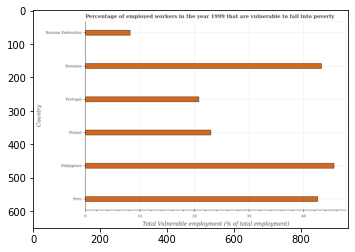

Number of QA =  22





,Country,Total Vulnerable employment (% of total employment)
0,NaN,42.795711
1,Philippines,45.831055
2,Poland,22.957005
3,Russian Federation,8.388930
4,Portugal,21.000368
5,Romania,43.536025


> what is the title of the graph ?
PREDICTED =  Percentage of employed workers in the year 1999 that are vulnerable to fall into poverty
EXPECTED =  Percentage of employed workers in the year 1999 that are vulnerable to fall into poverty




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Total Vulnerable employment (% of total employment)
EXPECTED =  Total Vulnerable employment (% of total employment)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total vulnerable employment in peru and romania ?
PREDICTED =  -27.86305787245516
EXPECTED =  -0.7




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what 

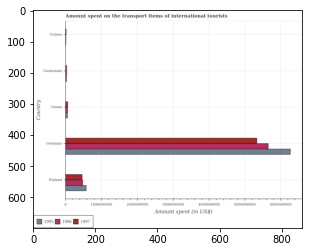

Number of QA =  29





,Country,1997,1996,1995
0,Ghana,7.974901e+07,7.624486e+07,7.128746e+07
1,Guinea,3.421237e+07,NaN,NaN
2,Finland,4.816408e+08,4.985110e+08,5.973925e+08
3,Guatemala,4.833855e+07,4.747276e+07,4.572135e+07
4,Germany,5.332242e+09,5.645453e+09,6.264982e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the transport items of international tourists in 1997 in finland and that in guinea ?
PREDICTED =  447428460.08222944
EXPECTED =  445000000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the transport items of international tourists in 1996 in guatemala and the amount spent on the transport items of international tourists in 1995 in ghana?
PREDICTED =  -28772098.17699927
EXPECTED =  -25000000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the transport items of international touris

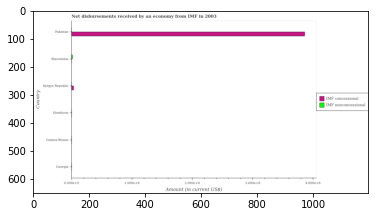

Number of QA =  19





,Country,IMF concessional,IMF nonconcessional
0,Honduras,NaN,NaN
1,Pakistan,3.857748,NaN
2,Georgia,NaN,NaN
3,Macedonia,NaN,0.025305
4,Guinea-Bissau,NaN,NaN
5,Kyrgyz Republic,0.042731,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net non concessional disbursements from imf in kyrgyz republic and the net concessional disbursements from imf in macedonia ?
PREDICTED =  nan
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the highest and the lowest net concessional disbursements from imf ?
PREDICTED =  0.9572687773785608
EXPECTED =  386071000.0




				 0 / 2 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Amount (in current US$)
EXPECTED =  100000000.0




				 0 / 3 = 0.0


> what is the title of the graph ?
PREDICTED =  Net disbursements received by an economy from IMF in 2003
EXPECTED =  Net disbursements received by an economy from IMF in 2003

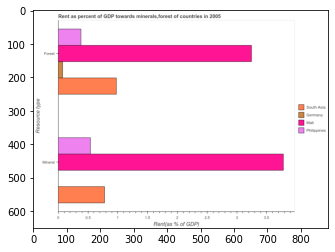

Number of QA =  23





,Resource type,Mali,Philippines,South Asia,Germany
0,Forest,3.240829,0.384909,0.958258,0.075346
1,Mineral,3.765402,0.543556,0.776924,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the forest rent in germany and the mineral rent in south asia ?
PREDICTED =  -0.7015774205398347
EXPECTED =  -0.7049831965286274




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the mineral rent and forest rent in mali ?
PREDICTED =  0.0
EXPECTED =  0.5353366951119809




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the mineral rent in philippines to that in south asia ?
PREDICTED =  0.6996259861011411
E

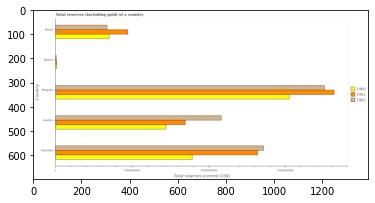

Number of QA =  29





,Country,1962,1961,1960
0,Brazil,6.052377e+08,8.562118e+08,6.337929e+08
1,Bolivia,NaN,1.932461e+07,1.844514e+07
2,Austria,1.970810e+09,1.546510e+09,1.307001e+09
3,Australia,2.450358e+09,2.374118e+09,1.600954e+09
4,Belgium,3.179731e+09,3.332477e+09,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total reserves (including gold) in 1961 in australia and that in belgium ?
PREDICTED =  -958359070.0932088
EXPECTED =  -499180817.74995995




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total reserves (including gold) in 1962 in australia and the total reserves (including gold) in 1960 in belgium?
PREDICTED =  -729372862.2381706
EXPECTED =  -167985020.52861




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total reserves (including gold) in 1960 and total reserves (including gold) in 1961 in austria ?
PREDICTED =  -1546509629.612393
EX

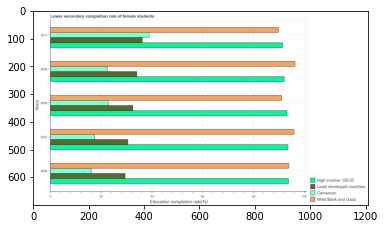

Number of QA =  30





,Years,Least developed countries,West Bank and Gaza,Cameroon,4igh income: OECD
0,2008,33.156732,91.822839,22.972153,93.681547
1,2007,30.923089,96.146013,17.461706,93.802814
2,2006,29.954423,94.061044,16.323478,94.935836
3,2009,34.275484,97.369923,22.655914,92.633204
4,2011,36.715998,90.401074,39.686570,91.928457


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lower secondary completion rate of female students in cameroon in 2008 and that in 2011 ?
PREDICTED =  -16.714416663727704
EXPECTED =  -16.124540328979517




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lower secondary completion rate of female students in high income: oecd in 2011 and the lower secondary completion rate of female students in cameroon in 2007 ?
PREDICTED =  -1.8743571977244073
EXPECTED =  74.00939369201649




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the lower secondary completion rate of female stude

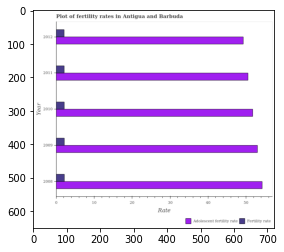

Number of QA =  28





,Year,Fertility rate,Adolescent fertility rate
0,2011,2.318515,50.898555
1,2008,2.360549,54.823201
2,2012,2.300962,49.483061
3,2010,2.364654,52.255473
4,2009,2.349966,53.466076


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adolescent fertility rate in 2008 and that in 2009 ?
PREDICTED =  1.3571255950460497
EXPECTED =  1.246




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the fertility rate in 2008 and the adolescent fertility rate in 2010 ?
PREDICTED =  -0.004105569325980163
EXPECTED =  -49.591




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the fertility rate and adolescent fertility rate ?
PREDICTED =  -249.23172062792324
EXPECTED =  -48.394




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicti

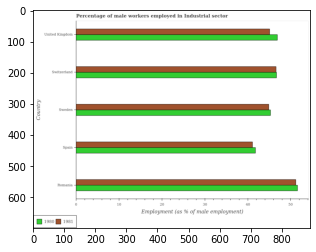

Number of QA =  28





,Country,1980,1981
0,Spain,41.636366,41.490609
1,Romania,51.835261,51.363439
2,Sweden,45.671313,45.214315
3,Switzerland,NaN,46.712143
4,United Kingdom,47.413169,45.370270


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers employed in industrial sector in 1981 in sweden and that in united kingdom ?
PREDICTED =  -0.15595575463935774
EXPECTED =  -0.1999969482422017




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers employed in industrial sector in 1981 in romania and the percentage of male workers employed in industrial sector in 1980 in sweden?
PREDICTED =  6.149124483707176
EXPECTED =  5.900001525879006




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers employed in industrial sec

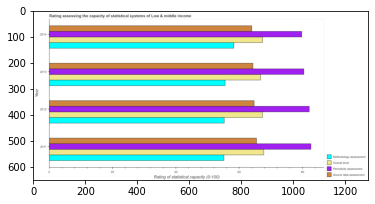

Number of QA =  30





,Year,Periodicity assessment,Source data assessment,Overall level,Methodology assessment
0,2014,79.703120,64.488685,67.923545,58.872309
1,2013,80.531291,64.819153,67.142054,NaN
2,2012,83.082378,64.832038,68.402426,NaN
3,2011,83.693929,66.111044,68.928169,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the periodicity assessment rating in 2012 and that in 2013 ?
PREDICTED =  2.55108707658988
EXPECTED =  1.691




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the overall level rating in 2013 and the periodicity assessment rating in 2011 ?
PREDICTED =  -1.7861154074278431
EXPECTED =  -15.887976425188299




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the overall level rating in 2012 to that in 2013 ?
PREDIC

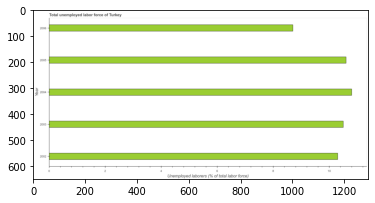

Number of QA =  23





,Year,Unemployed laborers (% of total labor force)
0,2004,10.873034
1,2002,10.422203
2,2006,8.701954
3,2005,10.703287
4,2003,10.576536


> what is the title of the graph ?
PREDICTED =  Total unemployed labor force of Turkey
EXPECTED =  Total unemployed labor force of Turkey




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Unemployed laborers (% of total labor force)
EXPECTED =  Unemployed laborers (% of total labor force)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total unemployed labour force in 2002 and 2004 ?
PREDICTED =  -0.45083052464827844
EXPECTED =  -0.5




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total unemployed labour force ?
PREDICTED =  2004.0
EXPECTED =  10.5




				 3 / 5 = 0.6


is_built_with

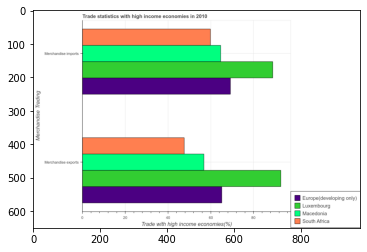

Number of QA =  23





,Merchandise Trading,Luxembourg,South Africa,Europe(developing only),Macedonia
0,Merchandise exports,92.810380,47.630644,65.018018,57.430691
1,Merchandise imports,89.586734,60.283812,69.458262,65.316950


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in luxembourg and the merchandise imports in south africa ?
PREDICTED =  45.17973521349266
EXPECTED =  32.94917570155079




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the merchandise exports in europe(developing only) to that in south africa ?
PREDICTED =  1.0
EXPECTED =  1.369012230781476




				 0 / 4 = 0.0


> what is the difference between two consecutive major 

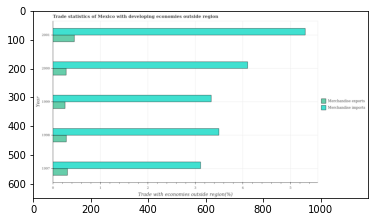

Number of QA =  28





,Year,Merchandise imports,Merchandise exports
0,2001,5.345120,0.460500
1,1998,3.507937,0.297959
2,1997,3.143082,0.321459
3,1999,3.329486,0.268951
4,2000,4.117119,0.294217


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in 1997 and that in 1998 ?
PREDICTED =  0.023500523785218164
EXPECTED =  0.024




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in 1998 and the merchandise imports in 2000 ?
PREDICTED =  0.003742139605626138
EXPECTED =  -3.8167317515976444




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the merchandise exports and merchandise imports ?
PREDICTED =  -4.884619853895573
EXPECTED =  -3.211




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or pr

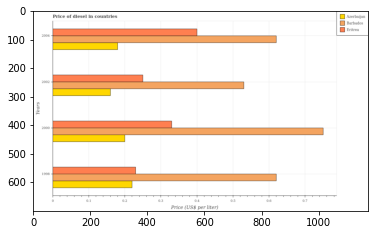

Number of QA =  29





,Years,Azerbaijan,Eritrea,Barbados
0,2004,0.183060,0.400872,0.623560
1,2002,0.161590,0.256525,0.532759
2,2000,0.203002,0.328746,0.761908
3,1998,0.222552,0.233447,0.623203


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the price of diesel in barbados in 1998 and that in 2004 ?
PREDICTED =  -0.0003570743082192962
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the price of diesel in azerbaijan in 2004 and the price of diesel in barbados in 2002 ?
PREDICTED =  0.02147001549738134
EXPECTED =  -0.35000000000000003




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the price of diesel in eritrea and price of diesel in azerbaijan ?
PREDICTED =  0.20832042288924016
EXPECTED =  0.13




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_a

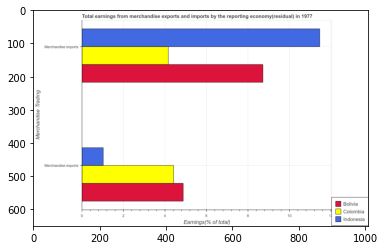

Number of QA =  23





,Merchandise Trading,Bolivia,Indonesia,Colombia
0,Merchandise imports,8.741976,11.524686,4.212413
1,Merchandise exports,4.940868,1.059399,4.459882


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise exports in bolivia and that in indonesia ?
PREDICTED =  3.881469346631625
EXPECTED =  3.85278902261141




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 4 = 0.25


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Eamings(% of total)
EXPECTED =  2.0




				 1 / 5 = 0.2


> what is the title of the graph ?
PREDICTED =  Total earnings 

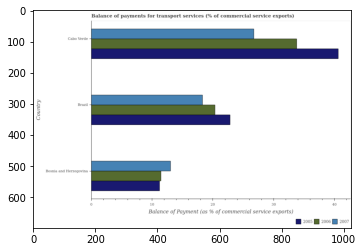

Number of QA =  29





,Country,2007,2005,2006
0,Cabo Verde,27.000380,41.071755,34.493321
1,Brazil,18.638939,23.242694,20.362812
2,Bosnia and Herzegovina,13.201371,11.471451,11.624207


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services in 2005 in bosnia and herzegovina and that in cabo verde ?
PREDICTED =  -29.600303313726013
EXPECTED =  -29.418460866920004




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services in 2006 in bosnia and herzegovina and the balance of payments for transport services in 2005 in cabo verde?
PREDICTED =  31.98701967967591
EXPECTED =  -29.190954198862904




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments for transport services in 2006 and balance 

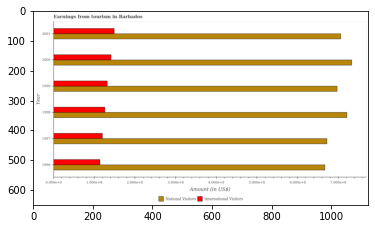

Number of QA =  28





,Year,National Visitors,International Visitors
0,2000,7.328070,1.420270
1,1996,6.675238,1.164216
2,2001,7.071126,1.512292
3,1997,6.783012,1.228217
4,1999,6.971279,1.341541
5,1998,7.280303,1.284292


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from international visitors in 1996 and that in 1997 ?
PREDICTED =  -0.06400120504984019
EXPECTED =  -6000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from international visitors in 1999 and the amount earned from national visitors in 2000 ?
PREDICTED =  -0.07872835874917583
EXPECTED =  -601000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the amount earned from national visitors and amount earned from international visitors ?
PREDICTED =  0.2569435302145955
EXPECTED =  557000000



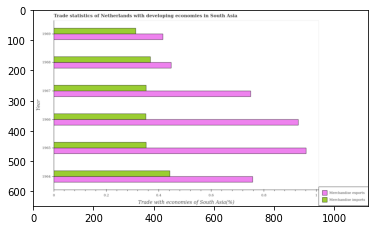

Number of QA =  28





,Year,Merchandise imports,Merchandise exports
0,1966,0.354163,0.937124
1,1969,0.315361,0.419710
2,1968,NaN,0.444812
3,1964,0.446341,0.754062
4,1967,0.353314,NaN
5,1965,0.353304,0.964033


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in 1964 and that in 1969 ?
PREDICTED =  0.3343516861480067
EXPECTED =  0.342




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in 1967 and the merchandise imports in 1969 ?
PREDICTED =  -0.4197100922765208
EXPECTED =  0.43798448217556807




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1966, what is the difference between the merchandise imports and merchandise exports ?
PREDICTED =  -3.1552430813236048
EXPECTED =  -0.581




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or pred

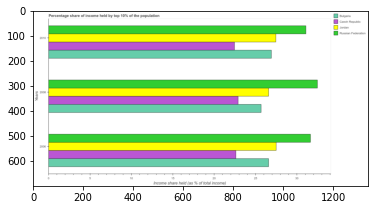

Number of QA =  30





,Years,Bulgaria,Czech Republic,Russian Federation,Jordan
0,2008,25.632128,NaN,32.433875,26.341835
1,2006,26.435662,22.721946,31.590116,27.441753
2,2010,26.860104,NaN,31.155266,27.591100


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage share of income held by top 10% of the population in czech republic in 2006 and that in 2010 ?
PREDICTED =  0.0
EXPECTED =  0.1700000000000017




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage share of income held by top 10% of the population in russian federation in 2006 and the percentage share of income held by top 10% of the population in czech republic in 2008 ?
PREDICTED =  0.3333333333333333
EXPECTED =  8.739999999999998




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage share of in

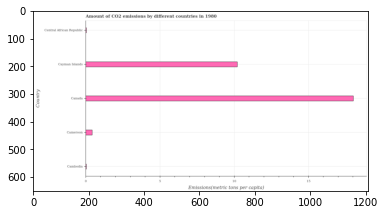

Number of QA =  22





,Country,Emissions(metric tons per capita)
0,Cambodia,0.079536
1,Cayman Islands,10.235000
2,Cameroon,0.472676
3,Canada,18.198456
4,Central African Republic,0.085698


> what is the title of the graph ?
PREDICTED =  Amount of CO2 emissions by different countries in 1980
EXPECTED =  Amount of CO2 emissions by different countries in 1980




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Emissions(metric tons per capita)
EXPECTED =  Emissions(metric tons per capita)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emissions in cameroon and central african republic ?
PREDICTED =  0.38697828838104836
EXPECTED =  0.39




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 4 / 5 = 0.8


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or pre

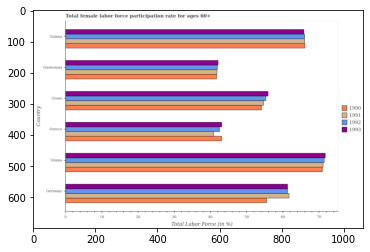

Number of QA =  30





,Country,1992,1993,1990,1991
0,Greece,NaN,43.083960,42.962056,NaN
1,Guinea,65.901485,NaN,NaN,66.129123
2,Ghana,NaN,71.712015,70.735962,NaN
3,Guam,55.246798,56.026147,54.247570,55.016248
4,Germany,61.327636,61.118987,NaN,61.551298
5,Guatemala,41.949606,42.241503,41.648198,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate in 1993 in germany and that in greece ?
PREDICTED =  18.035026919893646
EXPECTED =  18.200000762939396




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate in 1991 in guinea and the female labor force participation rate in 1992 in guatemala?
PREDICTED =  nan
EXPECTED =  24.0999984741211




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female labor force participation rate in 1991 and female labor force participation rate in 1990 in greece ?
PREDICTED =  -39.96205596

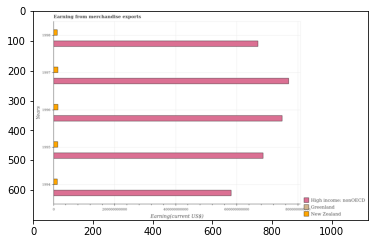

Number of QA =  29





,Years,New Zealand,Greenland,High income: nonOECD
0,1997,1.590229e+10,NaN,7.748576e+11
1,1994,1.443916e+10,NaN,5.907889e+11
2,1998,1.449039e+10,NaN,6.739168e+11
3,1996,1.607199e+10,NaN,7.533312e+11
4,1995,1.583132e+10,NaN,6.898861e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise exports in new zealand in 1997 and that in 1998 ?
PREDICTED =  1411898662.5387974
EXPECTED =  2151000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise exports in new zealand in 1994 and the amount earned from merchandise exports in high income: nonoecd in 1998 ?
PREDICTED =  -51236172.90293503
EXPECTED =  -657200210410.022




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the amount earned from merchandise exports in new zealand and amount earned from mercha

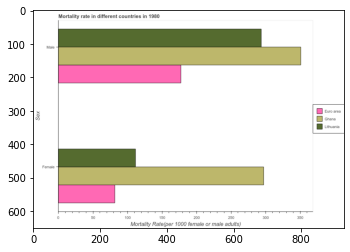

Number of QA =  23





,Sex,Ghana,Lithuania,Euro area
0,Female,297.923256,111.967874,81.380558
1,Male,350.991144,292.773593,176.765935


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female mortality rate in lithuania and that in euro area ?
PREDICTED =  111.96787423350716
EXPECTED =  29.957573610734215




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male mortality rate in euro area and the female mortality rate in lithuania ?
PREDICTED =  176.76593547276147
EXPECTED =  65.71374578778399




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female mortality rate and male mortality rate in lithuania ?
PREDICTED =  185.9553814955573
EXPECTED =  -182.06799999999998




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_ava

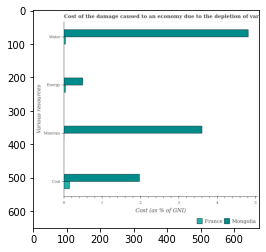

Number of QA =  29





,Various resources,France,Mongolia
0,Water,0.057922,4.842860
1,Minerals,NaN,3.613479
2,Coal,0.159804,1.992432
3,Energy,0.055305,0.514330


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of coal in mongolia and that in france ?
PREDICTED =  1.8326281217198532
EXPECTED =  1.8267582334213501




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of coal in france and the cost of damage due to depletion of energy in mongolia ?
PREDICTED =  -0.3545259875361725
EXPECTED =  -0.34501048538776097




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of coal and cost of damage due to depletion of energy in mongolia ?
PREDICTED =  -0.354525987536

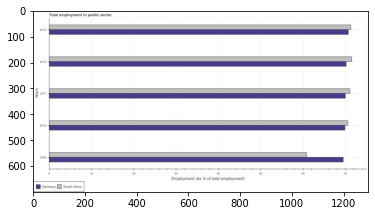

Number of QA =  28





,Years,South Africa,Germany
0,2013,71.108887,70.830813
1,2012,71.980175,71.008037
2,2011,71.591889,70.750121
3,2009,61.075447,69.313280
4,2010,70.358047,69.797253


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the employment in public sector in south africa in 2009 and that in 2012 ?
PREDICTED =  -10.904727775712018
EXPECTED =  -10.700000762939503




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the employment in public sector in south africa in 2010 and the employment in public sector in germany in 2013 ?
PREDICTED =  -0.7508393640242872
EXPECTED =  -0.09999847412120744




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the employment in public sector in germany and employment in public sector in south africa ?
PREDICTED =  -1940.6600993

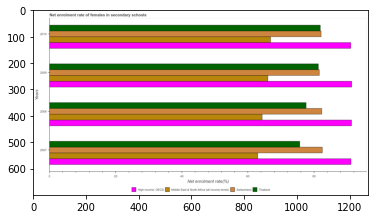

Number of QA =  30





,Years,Switzerland,High income: OECD,Thailand,Middle East & North Africa (all income levels)
0,2008,82.766216,92.777460,77.774548,64.107271
1,2010,82.278623,90.533300,82.098219,66.950689
2,2009,81.840182,91.791329,80.878272,66.067190
3,2007,84.065426,92.129900,75.957720,63.134611


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate of females in secondary schools in high income: oecd in 2008 and that in 2009 ?
PREDICTED =  0.9861310271279677
EXPECTED =  -0.05217742919919033




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate of females in secondary schools in thailand in 2010 and the net enrolment rate of females in secondary schools in middle east & north africa (all income levels) in 2008 ?
PREDICTED =  26.42602912267249
EXPECTED =  17.579277038574304




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the net enrolm

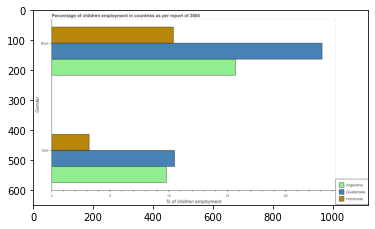

Number of QA =  23





,Gender,Honduras,Guatemala,Argentina
0,Girls,3.285374,10.515679,9.887098
1,NaN,10.579113,23.128783,15.713435


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed boys in argentina and that in honduras ?
PREDICTED =  6.601723215400969
EXPECTED =  5.299999999999999




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed girls in honduras and the percentage of employed boys in guatemala ?
PREDICTED =  -7.230304228553325
EXPECTED =  -19.900000000000002




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of emplo

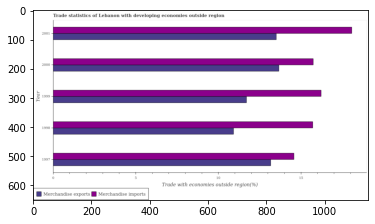

Number of QA =  28





,Year,Merchandise imports,Merchandise exports
0,1999,16.232596,11.687499
1,2001,18.010290,13.495361
2,2000,15.730525,13.635067
3,1997,14.525912,13.165254
4,1998,15.699358,10.889539


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in 1998 and that in 2001 ?
PREDICTED =  -2.6058217304661895
EXPECTED =  -2.586




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in 1999 and the merchandise imports in 1997 ?
PREDICTED =  -1.4777557545670437
EXPECTED =  -2.8738842673060994




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the merchandise imports and merchandise exports ?
PREDICTED =  3.465191962472691
EXPECTED =  1.407




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predi

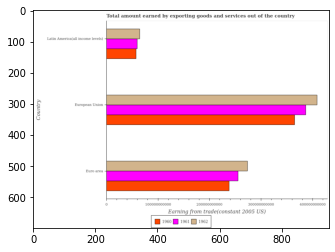

Number of QA =  29





,Country,1962,1961,1960
0,Euro area,NaN,2.567749e+11,2.395216e+11
1,European Union,4.117364e+11,3.892089e+11,3.687608e+11
2,Latin America(all income levels),6.581392e+10,6.122442e+10,5.877462e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount earned by exporting goods and services in 1961 in euro area and that in european union ?
PREDICTED =  -645983802753.5881
EXPECTED =  -131355699501.45389




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount earned by exporting goods and services in 1960 in euro area and the total amount earned by exporting goods and services in 1961 in european union?
PREDICTED =  -645983802753.5881
EXPECTED =  -148625579392.00296




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total amount earned by exporting goods and services in

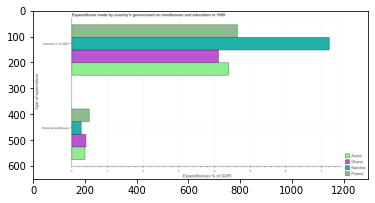

Number of QA =  23





,Type of expenditure,Poland,Aruba,Ghana,Namibia
0,Personal remittances,0.504901,0.387878,0.412821,0.279102
1,received (% of GDP),4.661469,4.301578,4.101974,7.228664


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in personal remittances in aruba and that in ghana ?
PREDICTED =  -0.024942272964930512
EXPECTED =  -0.028029047515012118




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in personal remittances in namibia and the expenditure in education in poland ?
PREDICTED =  -0.2257987493050545
EXPECTED =  -4.373245229280696




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the expenditur

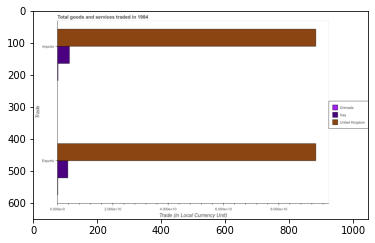

Number of QA =  23





,Trade,Grenada,United Kingdom,Iraq
0,Exports,NaN,9.376275,0.384923
1,Imports,NaN,9.321186,0.442535


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the imports of goods and services in grenada to that in iraq ?
PREDICTED =  0.0
EXPECTED =  0.04450467982578074




				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Trade (in Local Currency Unit)
EXPECTED =  20000000000.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Total goods and services trad

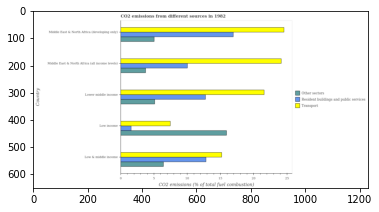

Number of QA =  29





,Country,Resident buildings and public services,Transport,Other sectors
0,Low income,1.662557,7.506181,15.873702
1,Low & middle income,12.974312,15.171545,6.500650
2,Lower middle income,NaN,NaN,5.178776
3,Middle East & North Africa (developing only),NaN,24.357121,5.183125
4,Middle East & North Africa (all income levels),10.110682,24.261512,3.845665


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of co2 emissions from transport in lower middle income and that in middle east & north africa (all income levels) ?
PREDICTED =  -24.26151222214459
EXPECTED =  -2.577




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of co2 emissions from resident buildings and public services and percentage of co2 emissions from transport in low income ?
PREDICTED =  1.3374427320909898
EXPECTED =  -5.89




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation f

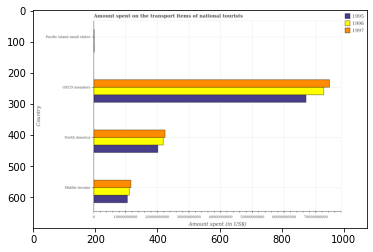

Number of QA =  29





,Country,1996,1997,1995
0,North America,2.215521e+10,2.270510e+10,2.051822e+10
1,Pacific island small states,NaN,NaN,NaN
2,OECD members,7.273815e+10,7.492516e+10,6.740478e+10
3,Middle income,1.138308e+10,1.187185e+10,1.085907e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the transport items of national tourists in 1995 in north america and that in oecd members ?
PREDICTED =  -46886556261.248726
EXPECTED =  -46742179207.99339




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the transport items of national tourists in 1996 in middle income and the amount spent on the transport items of national tourists in 1995 in pacific island small states?
PREDICTED =  11383082513.88745
EXPECTED =  11074188857.88224




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the tra

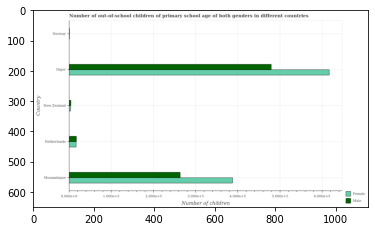

Number of QA =  28





,Country,Female,Male
0,Norway,NaN,NaN
1,Netherlands,0.189036,0.195029
2,New Zealand,0.054564,0.060768
3,Mozambique,3.945922,2.682237
4,Niger,6.327943,4.865523


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of male out-of-school students in mozambique and that in netherlands ?
PREDICTED =  2.4872081863226727
EXPECTED =  246123




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of male out-of-school students in norway and the number of female out-of-school students in mozambique ?
PREDICTED =  -2.6822372287252607
EXPECTED =  -386943




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of male out-of-school students and number of female out-of-school students in netherlands ?
PREDICTED =  4.670494003234739
EXPECTED =  665






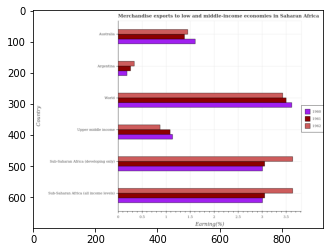

Number of QA =  29





,Country,1962,1961,1960
0,Australia,1.458305,NaN,1.631511
1,World,3.456768,3.506733,3.633981
2,Upper middle income,0.873458,1.110450,1.144265
3,Argentina,0.349500,0.273437,0.192489
4,Sub-Saharan Africa (all income levels),3.659325,3.039406,3.026368
5,Sub-Saharan Africa (developing only),3.647488,3.069349,3.025351


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in 1961 in sub-saharan africa (all income levels) and that in upper middle income ?
PREDICTED =  1.9588983984079151
EXPECTED =  1.9679373941348497




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise exports in 1961 in sub-saharan africa (all income levels) and the percentage of amount earned from merchandise exports in 1962 in australia?
PREDICTED =  5.108754725710718
EXPECTED =  1.6000150179469799




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_

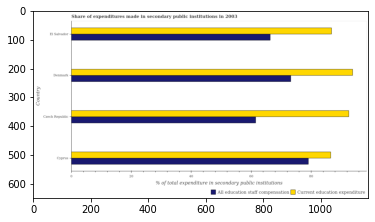

Number of QA =  28





,Country,All education staff compensation,Current education expenditure
0,Cyprus,79.930790,86.963881
1,El Salvador,66.826437,87.298627
2,Denmark,73.739624,94.202031
3,Czech Republic,61.896268,93.476180


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in staff compensation in cyprus and that in czech republic ?
PREDICTED =  18.03452195211819
EXPECTED =  17.589




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in education in cyprus and the expenditure in staff compensation in el salvador ?
PREDICTED =  20.137443569320254
EXPECTED =  20.214088439941506




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditure in staff compensation and expenditure in education in denmark ?
PREDICTED =  267.7386874803961
EXPECTED =  -20.641




				 2 / 3 = 0.6667


is_built_wi

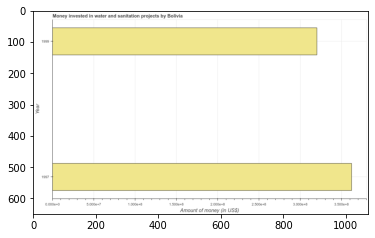

Number of QA =  19





,Year,Amount of money (in US$)
0,1997,65.654945
1,1999,57.387166


> what is the title of the graph ?
PREDICTED =  Money invested in water and sanitation projects by Bolivia
EXPECTED =  Money invested in water and sanitation projects by Bolivia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Amount of money (in US$)
EXPECTED =  Amount of money (in US$)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the investment in 1997 and 1999 ?
PREDICTED =  8.267779206191385
EXPECTED =  42000000.0




				 3 / 4 = 0.75


> what is the median investment ?
PREDICTED =  None
EXPECTED =  341000000.0




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the investment in 19

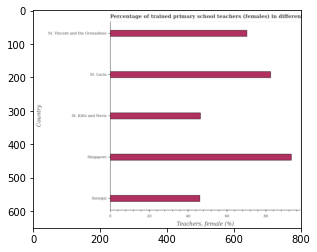

Number of QA =  22





,Country,"Teachers, female (%)"
0,St. Lucia,82.858836
1,St. Kitts and Nevis,47.061661
2,Singapore,94.086524
3,St. Vincent and the Grenadines,70.658977
4,Senegal,46.177086


> what is the title of the graph ?
PREDICTED =  Percentage of trained primary school teachers (females) in different
EXPECTED =  Percentage of trained primary school teachers (females) in different countries




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Teachers, female (%)
EXPECTED =  Teachers, female (%)




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of trained female teachers in st. lucia and st. vincent and the grenadines ?
PREDICTED =  12.199858921004207
EXPECTED =  12.227




				 3 / 4 = 0.75


> what is the median percentage of trained female teachers ?
PREDICTED =  None
EXPECTED =  70.3125




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training 

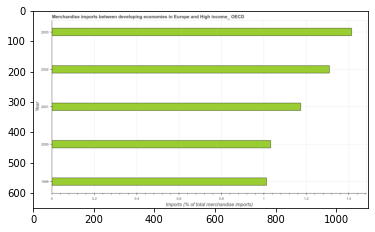

Number of QA =  23





,Year,Imports (% of total merchandise imports)
0,1999,1.025266
1,2003,1.406398
2,2002,1.310110
3,2000,1.031828
4,2001,1.173199


> what is the title of the graph ?
PREDICTED =  Merchandise imports between developing economies in Europe and High income_ OECD
EXPECTED =  Merchandise imports between developing economies in Europe and High income_ OECD




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Imports (% of total merchandise imports)
EXPECTED =  Imports (% of total merchandise imports)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in 1999 and 2002 ?
PREDICTED =  -0.2848438612751658
EXPECTED =  -0.297




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median merchandise imports ?
PREDICTED =  1.17

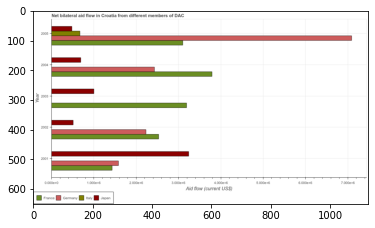

Number of QA =  26





,Year,Japan,Germany,France,Italy
0,2002,0.523810,2.247077,NaN,NaN
1,2001,3.255841,1.618036,1.440581,NaN
2,2003,1.024451,NaN,3.207944,NaN
3,2005,0.490580,7.111574,3.110940,0.680778
4,2004,0.702315,2.444655,3.697401,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by france in 2003 and that in 2005 ?
PREDICTED =  0.09700414178485195
EXPECTED =  90000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by italy in 2004 and the amount of aid given by japan in 2002 ?
PREDICTED =  0.6807783958798923
EXPECTED =  -510000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the amount of aid given by japan and amount of aid given by france ?
PREDICTED =  -6.456864985611434
EXPECTED =  1810000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available:

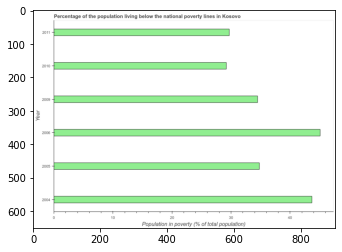

Number of QA =  23





,Year,Population in poverty (% of total population)
0,2005,34.714154
1,2006,45.370564
2,2011,29.950087
3,2004,43.706936
4,2010,29.491569
5,2009,34.568069


> what is the title of the graph ?
PREDICTED =  Percentage of the population living below the national poverty lines in Kosovo
EXPECTED =  Percentage of the population living below the national poverty lines in Kosovo




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Population in poverty (% of total population)
EXPECTED =  Population in poverty (% of total population)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population living below poverty line in 2004 and 2011 ?
PREDICTED =  13.756849586516566
EXPECTED =  14.0




				 4 / 4 = 1.0


> what is the median percentage of population living below poverty line ?
PREDICTED =  None
EXPECTED =  34.65




				 4 / 6 = 0.6667


is_built_with_cuda: Tru

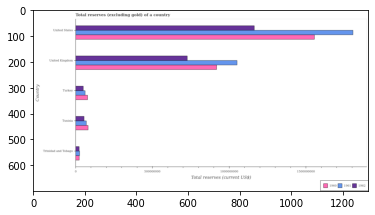

Number of QA =  29





,Country,1962,1961,1960
0,Turkey,9.647708e+07,1.171233e+08,1.470356e+08
1,Tunisia,1.050675e+08,1.298810e+08,1.532252e+08
2,United States,2.115855e+09,3.271230e+09,NaN
3,Trinidad and Tobago,4.890470e+07,5.318594e+07,4.925725e+07
4,United Kingdom,1.322542e+09,1.908266e+09,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total reserves (excluding gold) in 1962 in trinidad and tobago and that in tunisia ?
PREDICTED =  3534873783.512015
EXPECTED =  -31800000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total reserves (excluding gold) in 1960 in trinidad and tobago and the total reserves (excluding gold) in 1962 in turkey?
PREDICTED =  -96477077.30878451
EXPECTED =  -26400000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total reserves (excluding gold) in 1961 and total reserves (excluding gold) in 1960 in trinidad and tobago ?
PREDICTED =  0.0


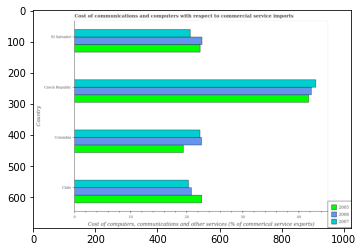

Number of QA =  29





,Country,2007,2005,2006
0,Chile,20.504662,22.866412,21.126942
1,Colombia,22.335521,19.653569,22.865160
2,El Salvador,20.838561,22.482261,22.834864
3,Czech Republic,43.250803,42.091651,42.320107


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers in 2007 in czech republic and that in el salvador ?
PREDICTED =  18.494417491978908
EXPECTED =  22.364834849179587




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers in 2007 in el salvador and the cost of communications and computers in 2005 in czech republic?
PREDICTED =  18.494417491978908
EXPECTED =  -21.0913474061242




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers in 2005 and cost of communications and computers in 2006 in c

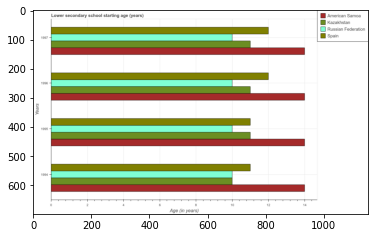

Number of QA =  30





,Years,Spain,Russian Federation,American Samoa,Kazakhstan
0,1997,11.945414,9.947918,13.978755,10.983009
1,1995,10.928326,NaN,13.925813,11.010878
2,1996,12.046940,9.914302,13.988509,10.926385
3,1994,10.921713,9.924558,13.959315,9.981674


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum lower secondary school starting age of children in russian federation ?
PREDICTED =  499.0
EXPECTED =  10




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lower secondary school starting age of children in american samoa in 1994 and that in 1997 ?
PREDICTED =  -2.0
EXPECTED =  0.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lower secondary school starting age of children in kazakhstan in 1997 and the lower secondary school starting age of children in russian federation in 1995 ?
PREDICTED =  0.25
EXPECTED =  1




				 0 / 3 = 0

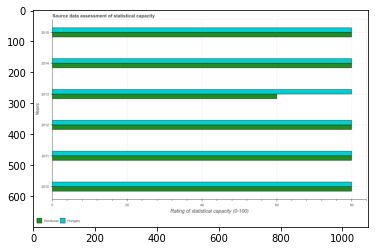

Number of QA =  28





,Years,Hungary,Honduras
0,2015,80.333722,79.501577
1,2014,79.085267,79.836016
2,2010,79.719432,80.286763
3,2013,81.520307,60.178346
4,2012,79.769983,79.663948
5,2011,80.181592,80.354609


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in honduras in 2011 and that in 2015 ?
PREDICTED =  0.8530325163020791
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in hungary in 2011 and the rating of statistical capacity in honduras in 2012 ?
PREDICTED =  0.4116086390847471
EXPECTED =  0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the rating of statistical capacity in honduras and rating of statistical capacity in hungary ?
PREDICTED =  319.54119546221006
EXPECTED =  0




				 0 / 3 =

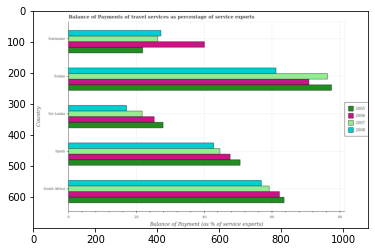

Number of QA =  30





,Country,2007,2005,2008,2006
0,Sudan,75.951166,77.818739,61.717788,71.067950
1,Spain,45.294251,50.855924,43.077814,NaN
2,Suriname,26.356448,22.010174,27.327037,40.209060
3,South Africa,59.290472,64.234251,57.280149,62.359875
4,Sri Lanka,21.990365,28.092723,17.167389,25.379516


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of travel services in 2005 in south africa and that in sudan ?
PREDICTED =  -13.584487960006769
EXPECTED =  -13.989122230159708




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of travel services in 2007 in sudan and the balance of payments of travel services in 2006 in suriname?
PREDICTED =  49.59471801050087
EXPECTED =  36.2819341848713




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of travel services in 2006 and balance of payments of travel services in 2008 in south afric

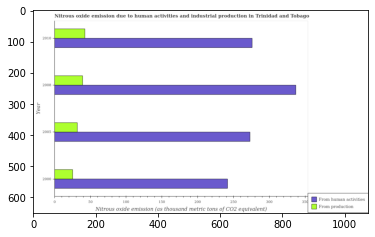

Number of QA =  28





,Year,From human activities,From production
0,2010,500.400648,77.573610
1,2000,439.945998,46.634691
2,2005,492.789317,59.048767
3,2008,608.032120,71.612041


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of emissions generated from industries in 2000 and that in 2010 ?
PREDICTED =  -30.938919082733214
EXPECTED =  -17.1




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of emissions generated from industries in 2000 and the amount of emissions from human activities in 2005 ?
PREDICTED =  -446.1546261337469
EXPECTED =  -247.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the amount of emissions from human activities and amount of emissions generated from industries ?
PREDICTED =  -1433.1359627581285
EXPECTED =

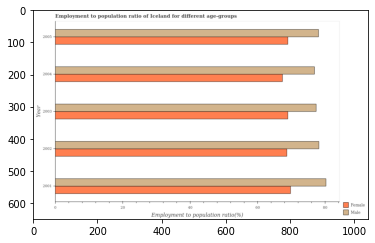

Number of QA =  28





,Year,Female,Male
0,2002,69.179408,77.883973
1,2005,69.107389,78.682596
2,2001,NaN,80.228793
3,2004,68.275780,76.936038
4,2003,68.902157,77.309906


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum employment to population ratio(male) ?
PREDICTED =  24.991027766572362
EXPECTED =  80.3000030517578




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum employment to population ratio(male) ?
PREDICTED =  26.04761097842858
EXPECTED =  76.9000015258789




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the employment to population ratio(male) maximum?
PREDICTED =  1.00199900049975
EXPECTED =  2001




	

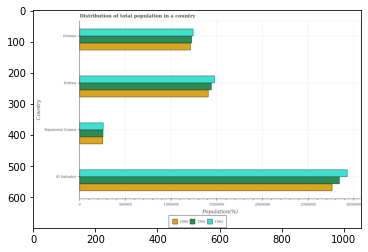

Number of QA =  29





,Country,1962,1961,1960
0,Eritrea,NaN,2.613222e+06,2.545302e+06
1,Estonia,2.251018e+06,2.232624e+06,2.203353e+06
2,El Salvador,5.270376e+06,5.101133e+06,4.987374e+06
3,Equatorial Guinea,4.833278e+05,4.768957e+05,4.706830e+05


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the population of in 1961 in equatorial guinea and that in eritrea ?
PREDICTED =  -2136326.081006653
EXPECTED =  -1186197.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the population of in 1960 in equatorial guinea and the population of in 1962 in estonia?
PREDICTED =  -1732669.6961009395
EXPECTED =  -989508.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the population of in 1961 and population of in 1960 in estonia ?
PREDICTED =  2897780.0015231203
EXPECTED =  13540.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False

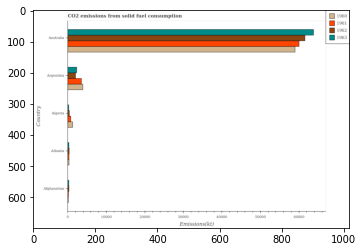

Number of QA =  30





,Country,1963,1962,1961,1960
0,Algeria,460.118874,599.176413,950.462774,1436.443663
1,Australia,63908.125684,61659.038484,60475.895203,59219.636082
2,Argentina,2487.285233,2198.928604,3687.510912,4108.700921
3,Afghanistan,473.552903,506.287798,NaN,NaN
4,Albania,483.897956,544.633861,515.067416,518.795873


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in 1961 in afghanistan and that in argentina ?
PREDICTED =  -3685.5109121450496
EXPECTED =  -3366.306




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in 1960 in australia and the amount of co2 emitted in 1961 in argentina?
PREDICTED =  55110.935161435686
EXPECTED =  55434.039




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in 1960 and amount of co2 emitted in 1962 in argentina ?
PREDICTED =  3865.0118525763496
EXPECTED =  1899.5059999999999




				 1 / 3 = 0.3333


is_

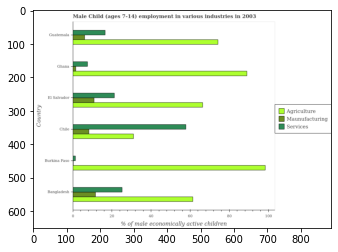

Number of QA =  29





,Country,Agriculture,Maunufacturing,Services
0,Ghana,89.557572,1.712180,7.809805
1,Guatemala,74.799779,6.382536,16.966487
2,El Salvador,67.199866,11.108091,21.814303
3,Burkina Faso,99.504799,NaN,1.523179
4,Chile,31.528199,8.387684,58.614918
5,Bangladesh,NaN,11.637155,25.718962


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active children in manufacturing in el salvador and that in guatemala ?
PREDICTED =  -7.599912977702942
EXPECTED =  4.829




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active children in services in guatemala and the percentage of economically active children in agriculture in ghana ?
PREDICTED =  9.156682115641708
EXPECTED =  -72.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active children in manufacturing and percentage of economically active chi

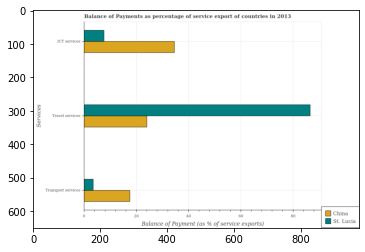

Number of QA =  28





,Services,China,St. Lucia
0,Travel services,24.410963,87.307839
1,ICT services,35.163866,7.958878
2,Transport services,17.932901,3.778097


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payment of transport services in china and that in st. lucia ?
PREDICTED =  14.154803798996271
EXPECTED =  14.034254593682379




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payment of travel services in st. lucia and the balance of payment of transport services in china ?
PREDICTED =  -3.778097479308272
EXPECTED =  69.05720604371702




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payment of transport services and balance of payment of travel services in china ?
PREDICTED =  -24.410963232797446
EXPECTE

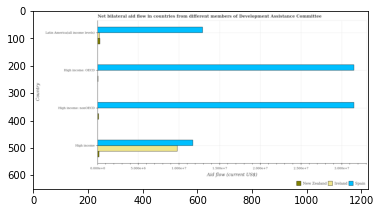

Number of QA =  29





,Country,Spain,New Zealand,Ireland
0,Latin America(all income levels),NaN,0.663097,0.528062
1,High income: nonOECD,57.627396,0.364777,NaN
2,High income: OECD,57.627202,NaN,NaN
3,High income,21.243031,0.478506,17.930266


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid provided by spain in high income and that in high income: oecd ?
PREDICTED =  -54.627202384431804
EXPECTED =  -19800000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid provided by spain in high income and the amount of aid provided by ireland in latin america(all income levels) ?
PREDICTED =  2.471938125580097
EXPECTED =  11480000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid provided by spain and amount of aid provided by ireland in latin america(all income levels) ?
PREDICTED =  2.47193812

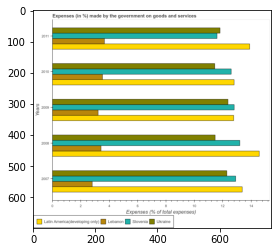

Number of QA =  30





,Years,Latin America(developing only),Slovenia,Lebanon,Ukraine
0,2007,13.853466,12.960601,2.848490,12.381991
1,2010,12.920391,12.653759,3.625300,11.562042
2,2008,14.634633,13.242441,3.471653,11.499636
3,2009,12.905092,NaN,3.281739,12.468356
4,2011,13.992440,11.632817,3.703303,11.831583


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenses made by the government on goods and services in lebanon in 2008 and that in 2010 ?
PREDICTED =  1.5283469689636218
EXPECTED =  -0.09988278690447006




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenses made by the government on goods and services in ukraine in 2010 and the percentage of expenses made by the government on goods and services in lebanon in 2011 ?
PREDICTED =  -6.831582565495427
EXPECTED =  7.77378561956151




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage

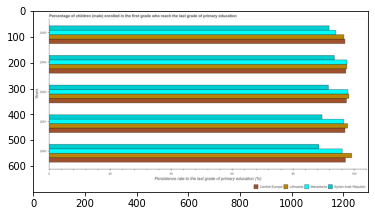

Number of QA =  30





,Years,Syrian Arab Republic,Lithuania,Central Europe,Macedonia
0,2003,92.708274,99.138290,NaN,NaN
1,2001,90.945359,98.002991,96.351203,96.121148
2,2004,94.262492,97.775905,97.324274,NaN
3,2005,91.454341,96.732318,97.346881,95.320770
4,2000,88.798586,99.885077,97.177048,95.503976


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the persistence rate of children in lithuania in 2001 and that in 2003 ?
PREDICTED =  -1.1352988866080551
EXPECTED =  -0.4217605590821165




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the persistence rate of children in lithuania in 2004 and the persistence rate of children in central europe in 2001 ?
PREDICTED =  -0.22708629294814386
EXPECTED =  0.616157531738196




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the 

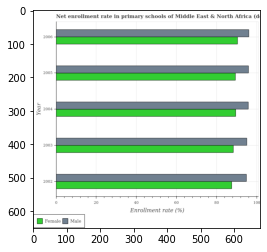

Number of QA =  28





,Year,Female,Male
0,2004,NaN,97.088446
1,2002,89.391257,95.885675
2,2006,91.757710,96.812758
3,2005,90.755103,97.200144
4,2003,89.567850,96.400531


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate of female students in 2002 and that in 2006 ?
PREDICTED =  -2.3664525074910614
EXPECTED =  -2.899




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate of male students in 2005 and the enrollment rate of female students in 2004 ?
PREDICTED =  0.11169744096486056
EXPECTED =  6.384742736816378




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the enrollment rate of male students and enrollment rate of female students ?
PREDICTED =  -96.81275764619447
EXPECTED =  5.64




				 0 / 3 = 0.0


is_built_

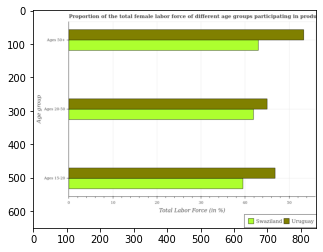

Number of QA =  28





,Age group,Uruguay,Swaziland
0,Ages 50+,53.719353,43.226430
1,Ages 20-50,45.146751,42.121687
2,Ages 15-20,47.117881,39.605656


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force within the age group 15-20 in swaziland and the percentage of female labor force within the age group 20-50 in uruguay ?
PREDICTED =  -7.512225053581261
EXPECTED =  -5.5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of female labor force within the age group 20-50 in uruguay to that in swaziland ?
PREDICTED =  1.0718172548594473
EXPECTED =

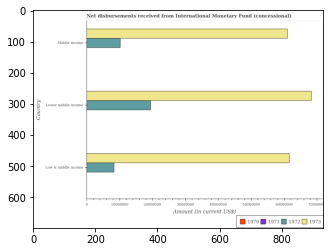

Number of QA =  27





,Country,1972,1971,1970,1973
0,Middle income,1.026230e+07,NaN,NaN,6.101257e+07
1,Lower middle income,1.978369e+07,NaN,NaN,6.836421e+07
2,Low & middle income,8.471970e+06,NaN,NaN,6.139926e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from international monetary fund in 1973 in lower middle income and that in middle income ?
PREDICTED =  -61012568.182068795
EXPECTED =  7250000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of disbursements received from international monetary fund in 1973 in middle income and the amount of disbursements received from international monetary fund in 1971 in low & middle income?
PREDICTED =  -129763469.72666055
EXPECTED =  61004350.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of d

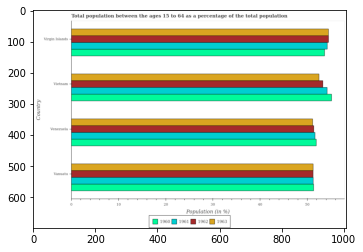

Number of QA =  30





,Country,1963,1962,1961,1960
0,Vanuatu,51.406209,51.310107,51.408828,51.726085
1,Venezuela,51.353800,51.897468,51.855474,51.955700
2,Vietnam,52.610443,53.177039,54.348591,55.181308
3,Virgin Islands,54.730013,55.213755,54.741878,53.759497


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the population ages 15 to 64 in 1962 in venezuela and that in virgin islands ?
PREDICTED =  -3.3162865879556094
EXPECTED =  -3.129946611576699




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the population ages 15 to 64 in 1962 in virgin islands and the percentage of the population ages 15 to 64 in 1960 in vanuatu?
PREDICTED =  3.9036472300886373
EXPECTED =  3.1560311290323




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the population ages 15 to 64 in 1962 and percentage of the population age

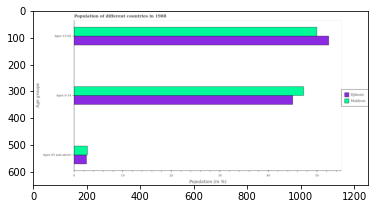

Number of QA =  28





,Age groups,Maldives,Djibouti
0,Ages 65 and above,2.881745,2.676619
1,Ages 15-64,50.289356,52.339178
2,Ages 0-14,47.940758,44.941990


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population within the age-group 0-14 in djibouti and that in maldives ?
PREDICTED =  -2.998767567174589
EXPECTED =  -2.253489499971799




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of population within the age-group 0-14 in maldives to that in djibouti ?
PREDICTED =  1.0667252952863786
EXPECTED =  1.0500483617503829




				 1 / 4 = 0.25


is_built_with_cuda

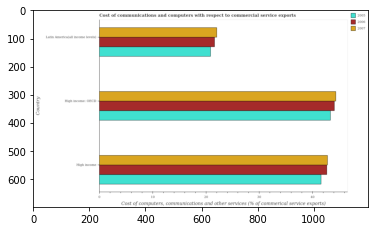

Number of QA =  29





,Country,2007,2005,2006
0,Latin America(all income levels),22.432116,21.061177,21.823887
1,High income: OECD,44.614569,43.529956,44.269580
2,High income,43.062222,41.421915,43.126816


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers in 2006 in high income and that in latin america(all income levels) ?
PREDICTED =  -0.7627104799862252
EXPECTED =  21.052806885376413




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers in 2007 in high income and the cost of communications and computers in 2005 in latin america(all income levels)?
PREDICTED =  -1.3709396085871575
EXPECTED =  21.935969085383505




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of communications and computers in 2007 and cost of co

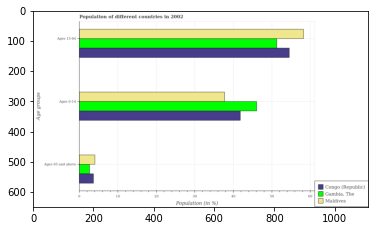

Number of QA =  28





,Age groups,Congo (Republic),"Gambia, The",Maldives
0,Ages 15-64,54.869517,51.452670,58.668535
1,Ages 0-14,42.285219,46.370886,38.176408
2,Ages 65 and above,3.935708,2.870075,4.301832


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of population within the age-group 0-14 in maldives to that in gambia, the ?
PREDICTED =  0.8232839745387189
EXPECTED =  0.8189336418243395




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 5 = 0.2


is_built_with_cuda: True
is_gpu_available: False


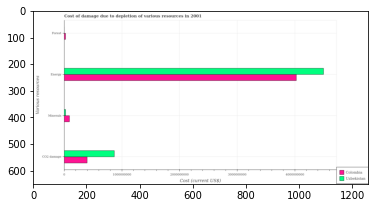

Number of QA =  29





,Various resources,Uzbekistan,Colombia
0,Energy,4.506734e+09,4.037020e+09
1,Forest,NaN,3.336751e+07
2,CO2 damage,8.877630e+08,4.107053e+08
3,Minerals,3.267094e+07,1.012631e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of energy in colombia and that in uzbekistan ?
PREDICTED =  -469713986.1858678
EXPECTED =  -472072471.49491024




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of minerals in uzbekistan and the cost of damage due to depletion of energy in colombia ?
PREDICTED =  -4105612356.4029865
EXPECTED =  -4001894553.9178023




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of coal and cost of damage due to depletion of energy in uzbekistan ?
PREDICTED = 

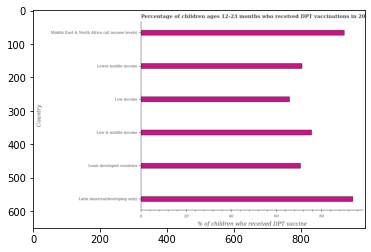

Number of QA =  22





,Country,% of children who received DPT vaccine
0,Least developed countries,70.719449
1,Low & middle income,76.337190
2,Low income,66.421457
3,Lower middle income,71.735749
4,Latin America(developing only),94.334498
5,Middle East & North Africa (all income levels),90.943182


> what is the title of the graph ?
PREDICTED =  Percentage of children ages 12-23 months who received DPT vaccinations in 20
EXPECTED =  Percentage of children ages 12-23 months who received DPT vaccinations in 2005




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  % of children who received DPT vaccine
EXPECTED =  % of children who received DPT vaccine




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who received dpt vaccine in low income and middle east & north africa (all income levels) ?
PREDICTED =  -24.521725523280125
EXPECTED =  -24.24




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after traini

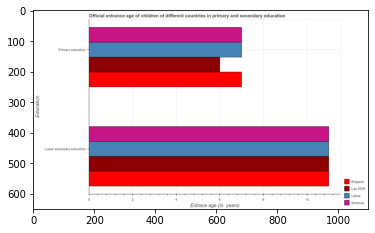

Number of QA =  23





,Education,Latvia,Bulgaria,Moldova,Lao PDR
0,Primary education,7.044202,7.022538,7.026355,5.999892
1,Lower secondary education,11.008453,11.020047,11.136030,10.973889


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the entrance age of chiildren in primary education in latvia and that in moldova ?
PREDICTED =  0.017847762470762696
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the entrance age of children in lower secondary education in moldova and the entrance age of chiildren in primary education in lao pdr ?
PREDICTED =  0.16214185963186445
EXPECTED =  5




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the entrance age of chiildren in primary education and entrance age of children in lower secondary education in moldova ?
PREDICTED =  -11.13

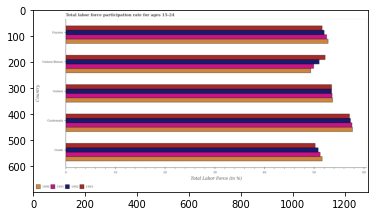

Number of QA =  30





,Country,1992,1993,1991,1990
0,Guinea,53.942061,NaN,54.027778,53.569632
1,Guyana,52.410000,52.377543,52.496068,52.800627
2,Guinea-Bissau,51.439747,NaN,50.197305,49.614191
3,Guam,51.163360,50.133966,51.478110,51.425452
4,Guatemala,57.557041,57.284987,57.301177,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in 1990 in guinea and that in guyana ?
PREDICTED =  0.7690047160750098
EXPECTED =  0.9000015258790057




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in 1990 in guatemala and the labor force participation rate in 1992 in guam?
PREDICTED =  -51.42545193422407
EXPECTED =  6.900001525879006




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in 1993 and labor force participation rate in 1990 in guyana ?
PREDICTED =  158.79649659849971
EXPECTED =  -1.

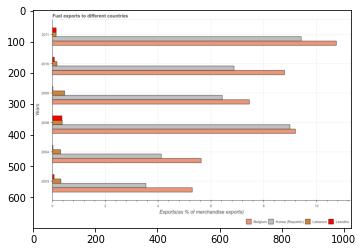

Number of QA =  30





,Years,Korea (Republic),Belgium,Lesotho,Lebanon
0,2010,6.869742,NaN,0.090538,0.188911
1,2009,6.670750,7.437155,NaN,0.478817
2,2004,NaN,5.547358,NaN,0.322637
3,2003,3.606671,5.223423,0.089797,0.343939
4,2008,8.987993,9.223466,0.383628,0.385637
5,2011,9.418077,10.783511,0.163645,0.161729


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in korea (republic) in 2008 and that in 2011 ?
PREDICTED =  -0.4300835481116483
EXPECTED =  -0.426874971093671




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in lebanon in 2010 and the percentage of exports to different countries in belgium in 2003 ?
PREDICTED =  -0.15502779130163927
EXPECTED =  -5.1236528639002294




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the percentage of exports to different countries in lesotho and percen

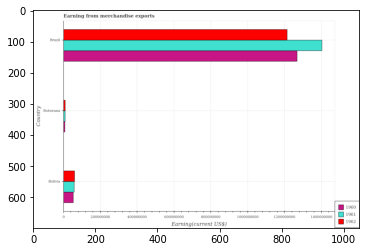

Number of QA =  29





,Country,1962,1961,1960
0,Bolivia,6.253651e+07,6.113646e+07,5.598622e+07
1,Brazil,1.227052e+09,1.416255e+09,1.286328e+09
2,Botswana,1.119817e+07,1.100102e+07,1.017219e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise exports in 1960 in bolivia and that in brazil ?
PREDICTED =  -1230341286.1310015
EXPECTED =  -1215000000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise exports in 1962 in bolivia and the amount earned from merchandise exports in 1961 in botswana?
PREDICTED =  51338343.490637414
EXPECTED =  51178600.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from merchandise exports in 1960 and amount earned from merchandise exports in 1962 in bolivia ?
PREDICTED =  1

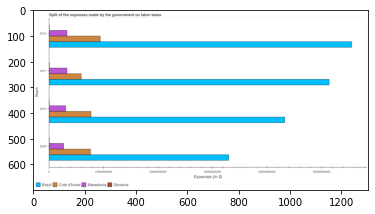

Number of QA =  30





,Years,Slovenia,Cote d'lvoire,Brazil,Macedonia
0,2012,NaN,9.465819e+09,5.539740e+10,3.371034e+09
1,2009,NaN,7.810736e+09,3.309936e+10,2.718876e+09
2,2011,NaN,6.002747e+09,5.112617e+10,3.393848e+09
3,2010,NaN,7.808990e+09,4.335352e+10,3.128052e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenses made by the government on labor taxes in slovenia in 2009 and that in 2012 ?
PREDICTED =  -6002746629.5079975
EXPECTED =  693218.5599999987




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenses made by the government on labor taxes in slovenia in 2009 and the expenses made by the government on labor taxes in brazil in 2011 ?
PREDICTED =  -51126169648.99851
EXPECTED =  -51366882404.6679




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the expenses made by the government on labor taxes in brazil and expenses mad

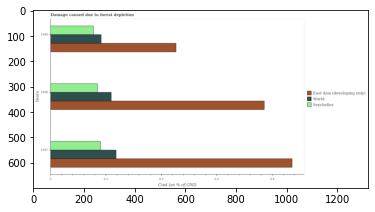

Number of QA =  29





,Years,East Asia (developing only),Seychelles,World
0,1998,0.385962,0.086154,0.111691
1,1997,0.435208,0.091946,0.120618
2,1999,0.229008,0.078365,0.093708


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to forest depletion in east asia (developing only) in 1997 and that in 1998 ?
PREDICTED =  0.04924619564119154
EXPECTED =  0.050199850579369876




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to forest depletion in east asia (developing only) in 1997 and the cost of damage caused due to forest depletion in seychelles in 1998 ?
PREDICTED =  0.04924619564119154
EXPECTED =  0.35098116801257206




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the cost of damage caused due to

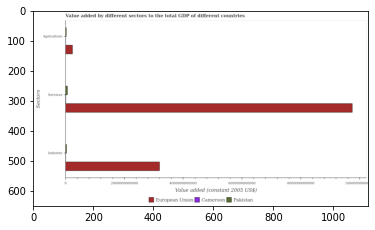

Number of QA =  28





,Sectors,Cameroon,Pakistan,European Union
0,Agriculture,NaN,NaN,2.524274e+11
1,Industry,NaN,4.956275e+10,3.207898e+12
2,Services,NaN,8.140614e+10,9.756840e+12


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by industrial sector in pakistan and that in european union ?
PREDICTED =  -3158335107997.824
EXPECTED =  -3162744002625.427




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by industrial sector in cameroon and the value added by services in pakistan ?
PREDICTED =  -65484447557.649704
EXPECTED =  -58438675118.82165




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by industrial sector and value added by agricultural sector in pakistan ?
PREDICTED =  -49562750657.979965
EXPECTED =  6589096755.426998





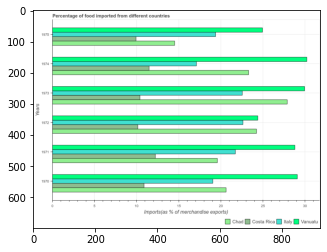

Number of QA =  30





,Years,Vanuatu,Chad,Costa Rica,Italy
0,1975,25.064123,14.349030,9.961465,19.440526
1,1973,30.185086,28.114933,10.366848,22.615934
2,1974,30.441066,23.518293,11.506089,NaN
3,1970,29.058163,NaN,NaN,18.958097
4,1971,NaN,19.621189,NaN,21.839109
5,1972,24.525120,24.593544,10.257499,22.678968


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in vanuatu in 1970 and that in 1971 ?
PREDICTED =  29.058163330329197
EXPECTED =  0.29078261840480835




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in chad in 1970 and the percentage of imports to different countries in vanuatu in 1971 ?
PREDICTED =  0.0
EXPECTED =  -8.171197572211803




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1974, what is the difference between the percentage of imports to different countries in italy and percentage of imports to different cou

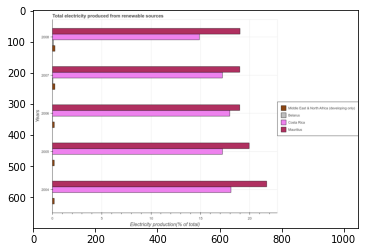

Number of QA =  30





,Years,Belarus,Mauritius,Middle East & North Africa (developing only),Costa Rica
0,2006,NaN,18.943396,0.219318,NaN
1,2005,NaN,20.010422,0.225214,17.218416
2,2004,NaN,21.776826,0.220303,NaN
3,2008,0.149356,19.073937,0.297049,14.981284
4,2007,NaN,18.979932,0.288462,17.228137


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced in costa rica in 2004 and that in 2008 ?
PREDICTED =  34.446553016392436
EXPECTED =  3.1970412576261005




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced in belarus in 2004 and the total electricity produced in mauritius in 2007 ?
PREDICTED =  -37.90451267486567
EXPECTED =  -18.9825971157889




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the total electricity produced in mauritius and total electricity produced in belarus ?
PREDICTED =  93.78451384450582
EXPECTED =  18

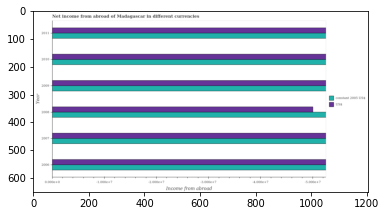

Number of QA =  15





,Year,US$,constant 2005 US$
0,2011,5.253787,5.275140
1,2010,5.256036,5.255777
2,2008,4.975678,5.203967
3,2007,5.242151,5.300708
4,2009,5.278670,5.298170
5,2006,5.220348,5.240193


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income from abroad in constant 2005 us$ in 2006 and the income from abroad in us$ in 2009 ?
PREDICTED =  -0.057976826569051454
EXPECTED =  0




				 0 / 1 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Income from abroad
EXPECTED =  10000000.0




				 0 / 2 = 0.0


> what is the title of the graph ?
PREDICTED =  Net income from abroad of Madagascar in different curre
EXPECTED =  Net income from abroad of Madagascar in different currencies




				 0 / 3 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Income from abroad
EXPECTED =  Income from abroad




				 1 / 4 = 0.25


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 5 = 0.4


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predic

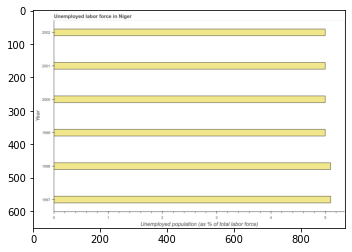

Number of QA =  23





,Year,Unemployed population (as % of total labor force)
0,1999,5.003023
1,2002,4.994843
2,2001,4.995708
3,2000,5.009591
4,1997,5.092539
5,1998,5.076939


> what is the title of the graph ?
PREDICTED =  Unemployed labor force in Niger
EXPECTED =  Unemployed labor force in Niger




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Unemployed population (as % of total labor force)
EXPECTED =  Unemployed population (as % of total labor force)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total unemployed population in 1999 and 2002 ?
PREDICTED =  0.008180001922735158
EXPECTED =  0.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total unemployed population ?
PREDICTED =  1999.5
EXPECTED =  5.0




				 3 / 5 = 0.6


is_built_with_cuda: Tru

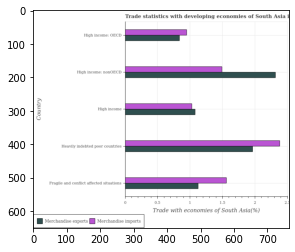

Number of QA =  28





,Country,Merchandise imports,Merchandise exports
0,High income,1.050865,1.088120
1,High income: OECD,0.974335,0.852987
2,Heavily indebted poor countries,2.423493,1.986619
3,High income: nonOECD,1.507782,2.329584
4,Fragile and conflict affected situations,1.580887,1.139912


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in high income and that in high income: nonoecd ?
PREDICTED =  -1.241463829597782
EXPECTED =  -1.238




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in high income: nonoecd and the merchandise imports in fragile and conflict affected situations ?
PREDICTED =  1.1896713689673597
EXPECTED =  0.75538005585521




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports and merchandise imports in fragile and conflict affected situations ?
PREDICTED =  0.7486961609891369
EXPECTED =  -0.436





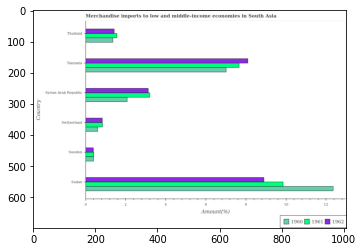

Number of QA =  29





,Country,1962,1961,1960
0,Sudan,9.032222,9.825523,12.444685
1,Syrian Arab Republic,3.183880,3.261845,2.097489
2,Sweden,0.407630,0.430402,0.423167
3,Switzerland,0.857511,0.876699,0.630718
4,Thailand,1.464937,1.572307,1.393731
5,Tanzania,8.195413,7.723395,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in 1960 in switzerland and that in thailand ?
PREDICTED =  -0.7630137260814635
EXPECTED =  -0.7594380492507471




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in 1962 in switzerland and the percentage of amount earned from merchandise imports in 1960 in sweden?
PREDICTED =  0.449881290007367
EXPECTED =  0.437231636839472




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in 1962 an

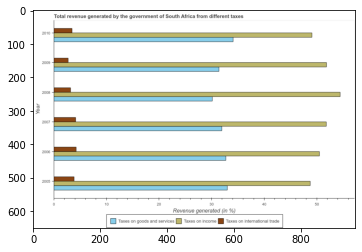

Number of QA =  29





,Year,Taxes on international trade,Taxes on income,Taxes on goods and services
0,2008,3.276701,54.484987,30.360336
1,2010,3.568475,49.230982,34.227564
2,2009,2.838589,51.607198,NaN
3,2006,4.276996,50.431485,32.877841
4,2005,3.962845,48.559031,NaN
5,2007,4.248381,51.679535,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue generated by taxes on goods and services in 2008 and that in 2009 ?
PREDICTED =  -51.60719800229154
EXPECTED =  -1.265




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of revenue generated by taxes on goods and services in 2007 and the percentage of revenue generated by taxes on income in 2008 ?
PREDICTED =  -51.67953471891937
EXPECTED =  -22.516101961226695




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the percentage of revenue generated by taxes on goods and services and percentage of 

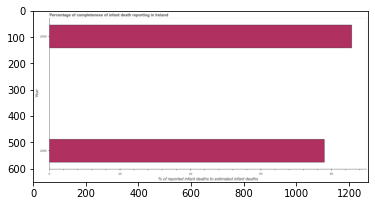

Number of QA =  19





,Year,% of reported infant deaths to estimated infant deaths
0,2009,86.366226
1,2006,77.965638


> what is the title of the graph ?
PREDICTED =  Percentage of completeness of infant death reporting in Ireland
EXPECTED =  Percentage of completeness of infant death reporting in Ireland




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  % of reported infant deaths to estimated infant deaths
EXPECTED =  % of reported infant deaths to estimated infant deaths




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the completeness of infant death reporting in 2006 and 2009 ?
PREDICTED =  -8.400588537046843
EXPECTED =  -7.754




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median completeness of infant dea

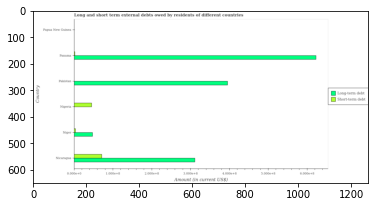

Number of QA =  25





,Country,Long-term debt,Short-term debt
0,Niger,0.477598,0.046708
1,Nigeria,NaN,0.454796
2,Pakistan,3.974185,NaN
3,Panama,6.200065,0.031622
4,Nicaragua,NaN,0.716099
5,Papua New Guinea,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the long-term debts owed by residents in nicaragua and that in niger ?
PREDICTED =  -0.4775983907752741
EXPECTED =  263604000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the long-term debts owed by residents in panama and the short-term debts owed by residents in nicaragua ?
PREDICTED =  nan
EXPECTED =  551768000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the long-term debts owed by residents in 

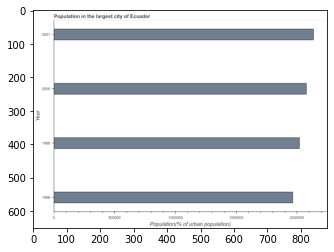

Number of QA =  23





,Year,Population(% of urban population)
0,2001,3.869346e+06
1,1998,3.537694e+06
2,1999,3.676954e+06
3,2000,3.753509e+06


> what is the title of the graph ?
PREDICTED =  Population in the largest city of Ecuador
EXPECTED =  Population in the largest city of Ecuador




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Population(% of urban population)
EXPECTED =  Population(% of urban population)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the population in largest city in 1999 and 2000 ?
PREDICTED =  -76555.62546832999
EXPECTED =  -57038.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median population in largest city ?
PREDICTED =  1999.5
EXPECTED =  2048856.0




				 3 / 5 = 0.6


is_built_with_cuda: True
is_

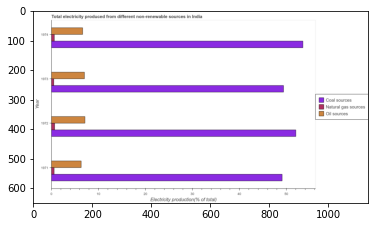

Number of QA =  29





,Year,Coal sources,Oil sources,Natural gas sources
0,1974,53.442646,6.772633,0.707646
1,1973,49.539469,7.122530,0.578400
2,1972,52.029780,7.307574,0.762409
3,1971,49.629119,6.460632,0.648769


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by coal in 1971 and that in 1973 ?
PREDICTED =  0.08965027034994932
EXPECTED =  -0.302




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of electricity produced by oil sources in 1974 and the percentage of electricity produced by coal in 1973 ?
PREDICTED =  -0.34989716233711476
EXPECTED =  -42.76263866221166




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1972, what is the difference between the percentage of electricity produced by coal and percentage of electricity produced by oil sources ?
PREDICTED =  46.52680

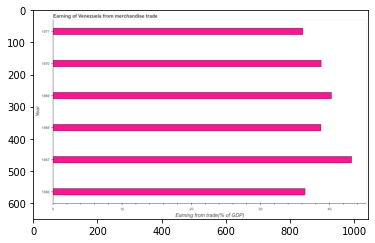

Number of QA =  23





,Year,Eaming from trade(% of GDP)
0,1971,36.345763
1,1968,38.881700
2,1967,43.317681
3,1966,36.551465
4,1969,40.235144
5,1970,38.842362


> what is the title of the graph ?
PREDICTED =  Earning of Venezuela from merchandise trade
EXPECTED =  Earning of Venezuela from merchandise trade




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Eaming from trade(% of GDP)
EXPECTED =  Earning from trade(% of GDP)




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earning from merchandise trade in 1969 and 1971 ?
PREDICTED =  3.889380908661252
EXPECTED =  4.142




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median earning from merchandise trade ?
PREDICTED =  1968.5
EXPECTED =  38.75952808727256




				 2 / 5 = 0.4


is_built_with_cuda: T

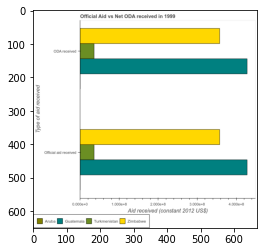

Number of QA =  20





,Type of aid received,Zimbabwe,Aruba,Turkmenistan,Guatemala
0,ODA received,3.557236,NaN,0.368168,4.249724
1,Official aid received,3.562018,NaN,0.366305,4.291013


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received in turkmenistan and that in guatemala ?
PREDICTED =  -3.8815561649339734
EXPECTED =  -392270000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the official aid received in turkmenistan and the oda received in aruba ?
PREDICTED =  nan
EXPECTED =  35670000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received and official aid received in turkmenistan ?
PREDICTED =  3.1899996772531187
EXPECTED =  0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finis

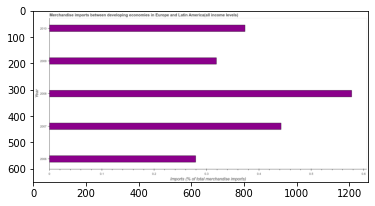

Number of QA =  23





,Year,Imports (% of total merchandise imports)
0,2008,0.581598
1,2010,0.374204
2,2006,0.278842
3,2007,0.443710
4,2009,0.318665


> what is the title of the graph ?
PREDICTED =  Merchandise imports between developing economies in Europe and Latin America(all income levels)
EXPECTED =  Merchandise imports between developing economies in Europe and Latin America(all income levels)




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Imports (% of total merchandise imports)
EXPECTED =  Imports (% of total merchandise imports)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in 2009 and 2010 ?
PREDICTED =  -0.055538345472471884
EXPECTED =  -0.055




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median merchan

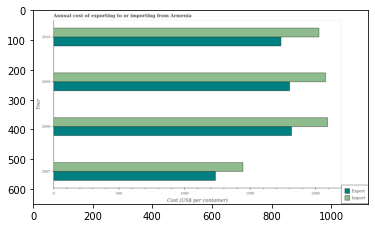

Number of QA =  28





,Year,Import,Export
0,2010,3663.577845,3153.734623
1,2008,3791.561963,3293.826687
2,2009,3786.329669,3262.380465
3,2007,2622.817095,2247.918844


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the import cost in 2009 and that in 2010 ?
PREDICTED =  122.75182415261406
EXPECTED =  51




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export cost in 2008 and the import cost in 2009 ?
PREDICTED =  31.446221291084385
EXPECTED =  -260




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the export cost and import cost ?
PREDICTED =  5510.299309255744
EXPECTED =  -290




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what 

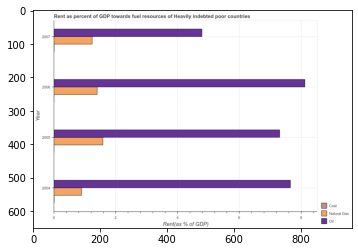

Number of QA =  29





,Year,Natural Gas,Oil,Coal
0,2007,1.264824,4.814528,NaN
1,2005,1.605661,7.337029,NaN
2,2006,1.424561,8.119719,NaN
3,2004,0.916877,7.663679,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rent towards natural gas in 2004 and that in 2006 ?
PREDICTED =  -0.5076847164968294
EXPECTED =  -0.504




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rent towards coal in 2007 and the rent towards natural gas in 2004 ?
PREDICTED =  nan
EXPECTED =  -0.8901560092532718




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the rent towards oil in 2006 to that in 2007 ?
PREDICTED =  1.6865035421098444


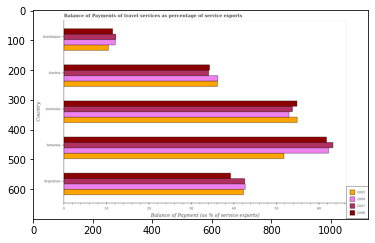

Number of QA =  30





,Country,2007,2005,2008,2006
0,Australia,54.095153,54.746174,55.060202,53.156927
1,Austria,NaN,NaN,34.434222,36.434627
2,Azerbaijan,12.390983,10.714353,11.666535,12.363117
3,Armenia,63.663175,52.018742,61.769448,62.854590
4,Argentina,43.046841,42.649482,39.241795,42.994970


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of travel services in 2006 in australia and that in austria ?
PREDICTED =  16.72230041679807
EXPECTED =  16.743881738276997




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of travel services in 2007 in austria and the balance of payments of travel services in 2008 in armenia?
PREDICTED =  -63.6631749200233
EXPECTED =  -27.740847068523394




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments of travel services in 2007 and balance of payments of travel services in 2006 in argentina ?

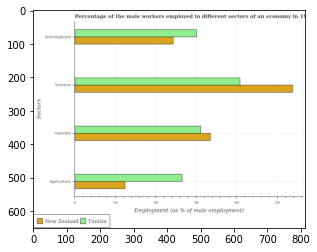

Number of QA =  29





,Sectors,New Zealand,Tunisia
0,Industry,NaN,31.371188
1,Services,54.062717,41.164262
2,Agriculture,12.696491,26.703288
3,Self-employed,24.472993,30.354641


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male workers in agriculture in tunisia and that in new zealand ?
PREDICTED =  14.006797295898291
EXPECTED =  14.1000003814697




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self employed male workers in tunisia and the percentage of male workers in agriculture in new zealand ?
PREDICTED =  5.881647902605231
EXPECTED =  17.70000076293939




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> wh

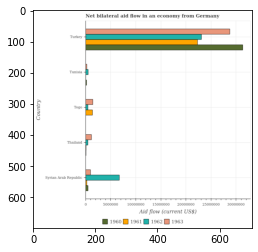

Number of QA =  30





,Country,1963,1962,1961,1960
0,Turkey,5.234544e+07,4.198471e+07,4.107513e+07,5.698187e+07
1,Syrian Arab Republic,1.967886e+06,1.243487e+07,NaN,1.012800e+06
2,Tunisia,NaN,1.117426e+06,NaN,5.123971e+05
3,Thailand,2.176714e+06,9.645495e+05,NaN,NaN
4,Togo,2.795886e+06,1.063194e+06,2.663085e+06,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1962 in tunisia and that in turkey ?
PREDICTED =  -40867286.35951328
EXPECTED =  -22580000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1962 in togo and the net bilateral aid flow in 1963 in thailand?
PREDICTED =  98644.60012318147
EXPECTED =  -700000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1963 and net bilateral aid flow in 1960 in turkey ?
PREDICTED =  -56981864.02847945
EXPECTED =  -2570000.0




				 0 / 3 = 0.0


is_built_with_cuda: True


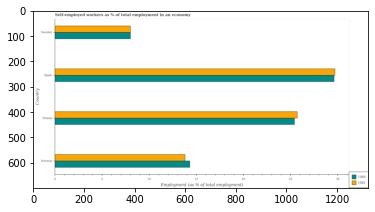

Number of QA =  28





,Country,1980,1981
0,Poland,25.402940,25.749961
1,Spain,29.644494,29.732150
2,Norway,14.334942,13.862343
3,Sweden,8.106673,8.050230


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers in 1981 in norway and that in poland ?
PREDICTED =  -11.887618533327084
EXPECTED =  -11.900000572204599




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers in 1980 in poland and the percentage of self-employed workers in 1981 in norway?
PREDICTED =  11.540597490289565
EXPECTED =  11.599999427795408




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers in 1980 and percentage of self-employed workers in 1981 in poland ?
PREDICTED =  -17.643

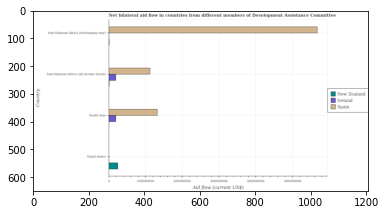

Number of QA =  29





,Country,Spain,New Zealand,Ireland
0,Small states,NaN,2.540375e+07,NaN
1,South Asia,1.342813e+08,NaN,2.018683e+07
2,Sub-Saharan Africa (all income levels),1.135533e+08,NaN,2.024294e+07
3,Sub-Saharan Africa (developing only),5.698489e+08,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid provided by spain in south asia and that in sub-saharan africa (developing only) ?
PREDICTED =  -435567621.36474514
EXPECTED =  -435330000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid provided by spain in sub-saharan africa (all income levels) and the amount of aid provided by new zealand in small states ?
PREDICTED =  0.0
EXPECTED =  87710000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid provided by ireland and amount of aid provided by spain in south asia ?
PREDICTED =  -93851564.908990

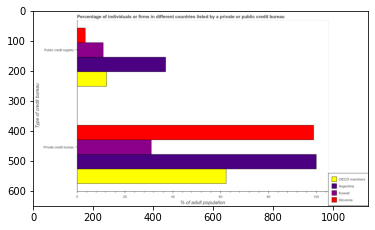

Number of QA =  23





,Type of credit bureau,OECD members,Slovenia,Argentina,Kuwait
0,Private credit bureau,62.656466,99.609018,100.618779,31.607463
1,Public credit registry,12.360849,3.501206,36.961009,11.019277


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of firms listed by private credit bureau in oecd members to that in argentina ?
PREDICTED =  0.6227114476255281
EXPECTED =  0.623096774193548




				 1 / 4 = 0.25


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  % of adult population
EXPECTED =  20.0




				 1 / 5 = 0.2


> what is the title of the graph ?
PREDICTED =  P

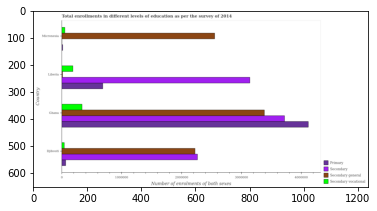

Number of QA =  30





,Country,Unnamed: 1,Secondary general,Secondary,Secondary vocational
0,Micronesia,2.165682e+04,2.549552e+06,NaN,60446.066066
1,Ghana,4.135044e+06,3.397146e+06,3.768217e+06,343701.564864
2,Djibouti,7.389794e+04,2.243018e+06,2.268025e+06,50905.900433
3,Liberia,6.902682e+05,2.140081e+04,3.151019e+06,196085.134765


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in primary education in liberia and that in micronesia ?
PREDICTED =  -2528150.9695679354
EXPECTED =  669670




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary general education in liberia and the number of enrolments in primary education in micronesia ?
PREDICTED =  -2528150.9695679354
EXPECTED =  -2879




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of enrolments in secondary education and number of enrolments in secondary vocational education in djibouti ?
PREDICTED =  -1.0

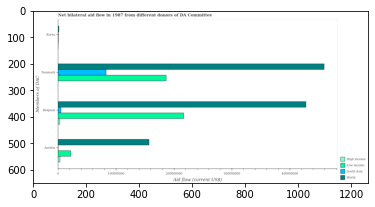

Number of QA =  26





,Members of DAC,Low income,High income,South Asia,World
0,Austria,2.273533e+07,4.369247e+06,NaN,1.584789e+08
1,NaN,NaN,NaN,NaN,2.455068e+06
2,Denmark,1.897087e+08,NaN,8.324436e+07,4.578152e+08
3,Belgium,2.182657e+08,3.859016e+06,5.957164e+06,4.272159e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by austria in world and that in high income ?
PREDICTED =  154109631.98428604
EXPECTED =  153590000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by korea in low income and the amount of aid given by austria in world ?
PREDICTED =  -158478875.87217432
EXPECTED =  -156490000




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by austria and amount of aid given by belgium in world ?
PREDICTED =  -427215872.62779695
EXPECTED =  -270800000




				 2 / 3 = 0.6667


is_built_with_cu

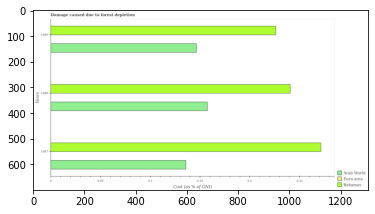

Number of QA =  29





,Years,Arab World,Bahamas,Euro area
0,1988,0.158929,0.242548,NaN
1,1987,0.136490,0.271930,NaN
2,1989,0.147497,0.228702,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to forest depletion in bahamas in 1988 and the cost of damage caused due to forest depletion in arab world in 1989 ?
PREDICTED =  0.01384623130887816
EXPECTED =  0.09422725549746




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cost of damage caused due to forest depletion in arab world in 1988 to that in 1989 ?
PREDICTED =  20.33939226159451
EXPECTED =  1.075

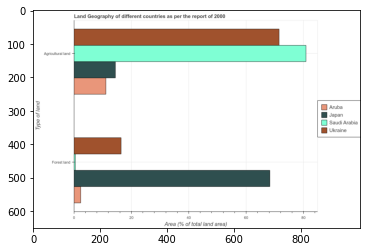

Number of QA =  23





,Type of land,Japan,Aruba,Ukraine,Saudi Arabia
0,Forest land,68.300404,2.482657,16.459626,NaN
1,Agricultural land,14.335315,11.229673,71.769368,80.952285


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land area under agriculture in ukraine and that in japan ?
PREDICTED =  57.43405308224706
EXPECTED =  57.044510527679705




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land area under agriculture in japan and the percentage of land area under forests in ukraine ?
PREDICTED =  -73.89367913288092
EXPECTED =  -1.9897077314425005




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 4 = 

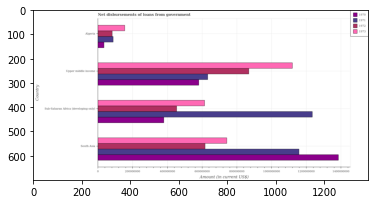

Number of QA =  30





,Country,1972,1971,1970,1973
0,South Asia,6.258775e+08,1.173631e+09,1.397347e+09,7.495576e+08
1,Upper middle income,8.740015e+08,6.405771e+08,5.880985e+08,1.133479e+09
2,Algeria,8.623450e+07,9.123736e+07,3.881087e+07,1.585475e+08
3,Sub-Saharan Africa (developing only),NaN,1.243606e+09,3.895313e+08,6.115543e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loan disbursed from government in 1971 in algeria and that in upper middle income ?
PREDICTED =  -549339707.4306453
EXPECTED =  -544659000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loan disbursed from government in 1970 in south asia and the amount of loan disbursed from government in 1971 in sub-saharan africa (developing only)?
PREDICTED =  153741087.248667
EXPECTED =  150188938.9000001




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loan disbursed from government in 1973 and amount of loan disb

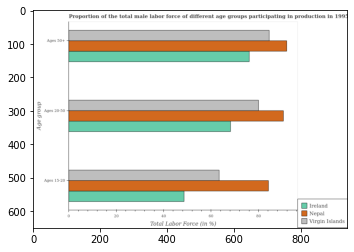

Number of QA =  28





,Age group,Virgin Islands,Nepal,Ireland
0,Ages 15-20,63.998376,84.503044,49.386365
1,Ages 20-50,80.272641,91.167606,68.385653
2,Ages 50+,85.281562,91.469774,76.147604


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force within the age group 15-20 in ireland and that in virgin islands ?
PREDICTED =  -14.612011815490256
EXPECTED =  -14.800003051757798




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of male labor force within the age group 15-20 in ireland to that in virgin islands ?
PREDICTED =  0.7716815229311694
EXPECTED =  0.7665614716788821




				 2 / 

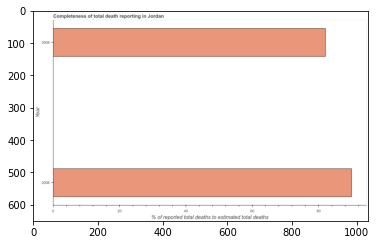

Number of QA =  19





,Year,% of reported total deaths to estimated total deaths
0,2006,90.722757
1,2008,82.277598


> what is the title of the graph ?
PREDICTED =  Completeness of total death reporting in Jordan
EXPECTED =  Completeness of total death reporting in Jordan




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  % of reported total deaths to estimated total deaths
EXPECTED =  % of reported total deaths to estimated total deaths




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the completeness of total death reports in 2006 and 2008 ?
PREDICTED =  8.445159444039021
EXPECTED =  7.864




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median completeness of total death reports ?
PREDICTED =  2007.0
EXPECTED 

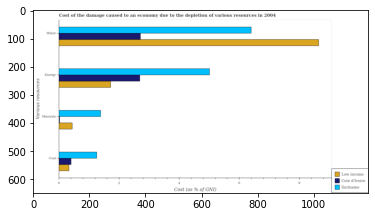

Number of QA =  29





,Various resources,Low income,Cote d'Ivoire,Suriname
0,Coal,0.348144,0.422139,1.288218
1,Water,8.687471,2.742288,6.417200
2,Minerals,0.457854,NaN,1.416534
3,Energy,1.744614,2.677909,5.059691


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of water in suriname and that in low income ?
PREDICTED =  -2.2702710780976325
EXPECTED =  -2.2440594483122904




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of minerals in suriname and the cost of damage due to depletion of coal in cote d'ivoire ?
PREDICTED =  0.9943947346344565
EXPECTED =  0.9827726343012122




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of coal and cost of damage due to depletion of water in suriname ?
PREDICTED =  -6.

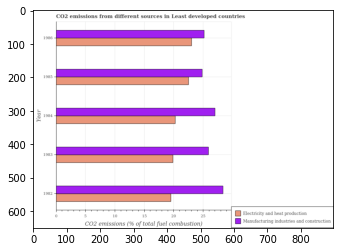

Number of QA =  28





,Year,Manufacturing industries and construction,Electricity and heat production
0,1985,24.782217,22.732600
1,1986,25.167712,23.363416
2,1983,26.038079,19.851157
3,1982,28.445644,19.548919
4,1984,27.125244,20.409286


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 emissions due to manufacturing industries in 1985 and that in 1986 ?
PREDICTED =  -2.4351116623270954
EXPECTED =  -0.326




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1982, what is the difference between the co2 emissions due to electricity and heat production and co2 emissions due to manufacturing industries ?
PREDICTED =  16.181075834845238
EXPECTED =  -8.865




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the c

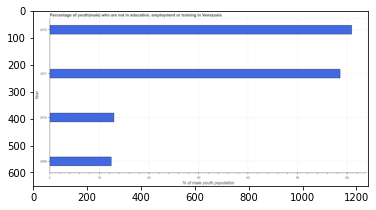

Number of QA =  23





,Year,% of male youth population
0,2010,13.116435
1,2012,60.916354
2,2009,12.517197
3,2011,58.218105


> what is the title of the graph ?
PREDICTED =  Percentage of youth(male) who are not in education, employment or training in Venezuela
EXPECTED =  Percentage of youth(male) who are not in education, employment or training in Venezuela




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  % of male youth population
EXPECTED =  % of male youth population




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed male youth population in 2011 and 2012 ?
PREDICTED =  -2.698249349712178
EXPECTED =  -2.33




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed male youth population ?
PREDIC

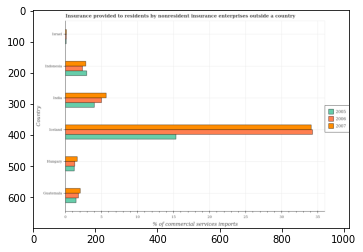

Number of QA =  29





,Country,2007,2005,2006
0,Israel,0.226045,NaN,NaN
1,Iceland,34.149843,NaN,34.267667
2,Guatemala,2.126377,1.557287,1.884473
3,Indonesia,2.910530,3.010954,2.456544
4,India,5.743044,4.065261,5.203968
5,Hungary,1.733549,1.308687,1.376591


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the insurance provided to residents in 2007 in iceland and that in israel ?
PREDICTED =  33.92379785190318
EXPECTED =  33.97064580588417




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the insurance provided to residents in 2005 in israel and the insurance provided to residents in 2006 in guatemala?
PREDICTED =  -1.5572866596894563
EXPECTED =  -1.69890635219357




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ra

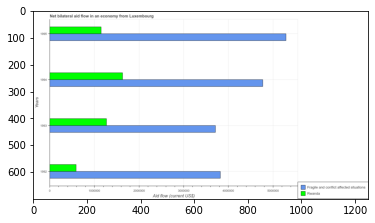

Number of QA =  28





,Years,Rwanda,Fragile and conflict affected situations
0,1992,6.097475e+05,3.840772e+06
1,1995,1.164874e+06,5.305367e+06
2,1993,1.294512e+06,3.776670e+06
3,1994,1.661770e+06,4.759337e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in fragile and conflict affected situations in 1992 and that in 1995 ?
PREDICTED =  -884830.5778008886
EXPECTED =  -1470000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in fragile and conflict affected situations in 1992 and the net bilateral aid flow in rwanda in 1995 ?
PREDICTED =  3255662.6964065963
EXPECTED =  2670000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1992, what is the difference between the net bilateral aid flow in rwanda and net bilateral aid flow in fragile and conflict affected situatio

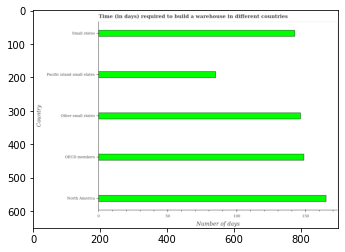

Number of QA =  22





,Country,Number of days
0,Small states,256.116418
1,Other small states,265.968953
2,OECD members,269.531663
3,North America,296.312656
4,Pacific island small states,153.777772


> what is the title of the graph ?
PREDICTED =  Time (in days) required to build a warehouse in different countries
EXPECTED =  Time (in days) required to build a warehouse in different countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Number of days
EXPECTED =  Number of days




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the time required to build a warehouse in oecd members and small states ?
PREDICTED =  13.415245086749167
EXPECTED =  6.643




				 3 / 4 = 0.75


> what is the median time required to build a warehouse ?
PREDICTED =  None
EXPECTED =  146.277777777778




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished af

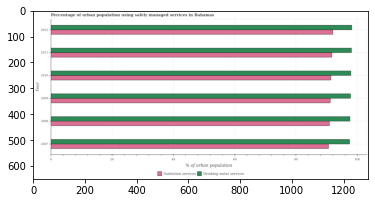

Number of QA =  28





,Year,Drinking water services,Sanitation services
0,2012,98.764494,NaN
1,2010,97.620003,91.417595
2,2008,98.088299,91.270165
3,2011,98.552032,91.539001
4,2009,97.858664,91.732256
5,2007,97.831383,90.947657


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population who used sanitation services in 2007 and that in 2008 ?
PREDICTED =  -0.32250839996264347
EXPECTED =  -0.3




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population who used drinking water services in 2011 and the percentage of urban population who used sanitation services in 2008 ?
PREDICTED =  0.4637325741870626
EXPECTED =  7.199999999999989




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after

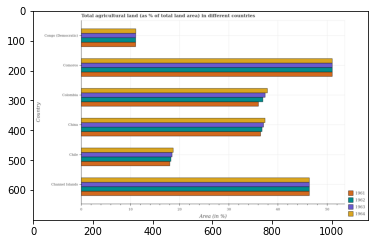

Number of QA =  30





,Country,1964,1962,1961,1963
0,China,37.513479,36.944286,36.595763,37.235413
1,Colombia,38.092740,37.107224,36.310112,37.495027
2,Chile,NaN,18.500655,18.193556,18.664475
3,Comoros,51.120745,50.754723,51.164061,50.929849
4,Channel Islands,46.344526,46.421793,46.635634,46.565644
5,Congo (Democratic),11.157096,11.159711,11.129291,11.215914


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of agricultural land in 1961 in china and that in congo (democratic) ?
PREDICTED =  25.466471888228533
EXPECTED =  25.416193104159497




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of agricultural land in 1964 in colombia and the percentage of agricultural land in 1962 in channel islands?
PREDICTED =  -8.329052850280597
EXPECTED =  -8.541369521889202




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of agricultural land in 1961 and percentage of agricultural land in 1964 in channel islands ?
PREDICTED =

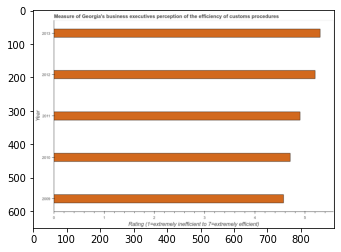

Number of QA =  23





,Year,Rating (1=extremely inefficient to 7=extremely efficient)
0,2009,4.570291
1,2010,4.695719
2,2013,5.293691
3,2011,4.884403
4,2012,5.206850


> what is the title of the graph ?
PREDICTED =  Measure of Georgia's business executives perception of the efficiency of customs procedures
EXPECTED =  Measure of Georgia's business executives perception of the efficiency of customs procedures




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Rating (1=extremely inefficient to 7=extremely efficient)
EXPECTED =  Rating (1=extremely inefficient to 7=extremely efficient)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating measuring burden of customs procedure in 2010 and 2012 ?
PREDICTED =  -0.5111316591475603
EXPECTED =  -0.496




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after t

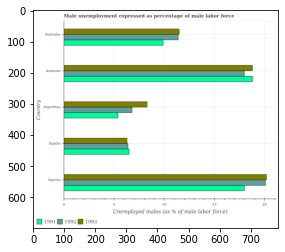

Number of QA =  29





,Country,1992,1993,1991
0,Australia,11.421571,11.460292,9.906590
1,Algeria,20.023453,20.200059,18.016604
2,Angola,6.433291,6.360066,6.574616
3,Armenia,18.062740,18.789076,18.747822
4,Argentina,6.834709,8.318018,5.395163


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in males in in 1992 in armenia and that in australia ?
PREDICTED =  6.641168889281122
EXPECTED =  6.6000003814697




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in males in in 1993 in argentina and the unemployment in males in in 1991 in australia?
PREDICTED =  -3.142273171097564
EXPECTED =  -1.5999994277954084




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployment in males in in 1992 and unemployment in males in in 1993 in angola ?
PREDICTED =  56.41569737142486
EXPECTED =  0.09999990463256836




			

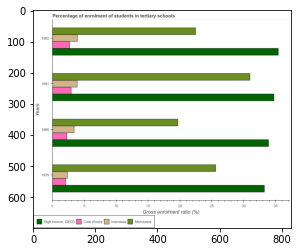

Number of QA =  30





,Years,Micronesia,Indonesia,High income: OECD,Cote d'Ivoire
0,1981,31.019294,3.840668,34.740363,3.004569
1,1982,22.222693,3.938995,35.310212,2.749284
2,1980,19.572825,3.460996,33.921341,2.343270
3,1979,25.665291,2.422809,33.079866,2.147480


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of students enrolled in tertiary schools in indonesia in 1980 and that in 1982 ?
PREDICTED =  -0.4779987132426431
EXPECTED =  -0.5221499999999999




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of students enrolled in tertiary schools in micronesia in 1981 and the percentage of students enrolled in tertiary schools in indonesia in 1980 ?
PREDICTED =  11.4464692672831
EXPECTED =  27.57103000000001




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1982, what is the difference between the percentage of students enrolled in tertiary schools 

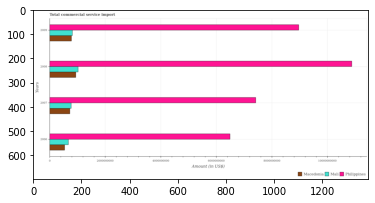

Number of QA =  29





,Years,Mali,Philippines,Macedonia
0,2008,1.039685e+09,1.095895e+10,9.609409e+08
1,2007,7.879587e+08,7.462134e+09,7.423446e+08
2,2009,8.260909e+08,9.029102e+09,7.940718e+08
3,2006,6.859694e+08,6.508090e+09,5.505545e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total commercial service import in macedonia in 2006 and that in 2007 ?
PREDICTED =  -191790067.2517867
EXPECTED =  -189071869.329697




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total commercial service import in mali in 2006 and the total commercial service import in philippines in 2008 ?
PREDICTED =  -353715402.73002756
EXPECTED =  -10201457932.168749




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the total commercial service import in macedonia and total commercial service import in mali ?
PREDICTED =  -108586384

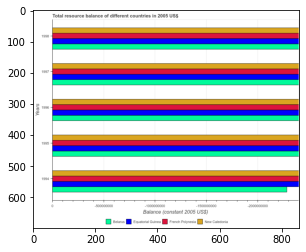

Number of QA =  17





,Years,Belarus,Equatonal Guinea,French Polynesia,New Caledonia
0,1994,1.376476e+09,1.440262e+09,1.441468e+09,1.438156e+09
1,1997,1.435716e+09,1.428473e+09,1.440708e+09,1.433965e+09
2,1995,1.440093e+09,1.443964e+09,1.441294e+09,1.440330e+09
3,1996,1.443695e+09,1.434827e+09,1.443769e+09,1.441359e+09
4,1998,1.432355e+09,1.443833e+09,1.445217e+09,1.430718e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total resource balance in new caledonia in 1996 and the total resource balance in french polynesia in 1998 ?
PREDICTED =  10640793.970481873
EXPECTED =  0




				 0 / 1 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Balance (constant 2005 US$)
EXPECTED =  500000000.0




				 0 / 2 = 0.0


> what is the title of the graph ?
PREDICTED =  Total resource balance of different countries in 2005 US$
EXPECTED =  Total resource balance of different countries in 2005 US$




				 1 / 3 = 0.3333


> what is the label or title of the x-axis ?
PREDICTED =  Balance (constant 2005 US$)
EXPECTED =  Balance (constant 2005 US$)




				 2 / 4 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Years
EXPECTED =  Years




				 3 / 5 = 0.6


is_built_with_cuda: True
is_gpu

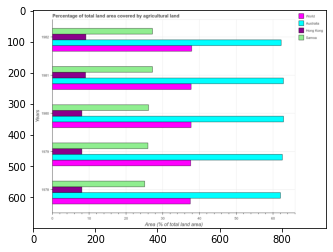

Number of QA =  30





,Years,Australia,Samoa,Hong Kong,World
0,1982,62.385696,27.566901,9.428925,38.250008
1,1980,63.193040,26.439784,8.301136,38.119852
2,1978,61.747380,25.416561,8.211523,37.673614
3,1979,63.024298,26.510338,8.232865,38.201707
4,1981,63.113649,NaN,9.360954,37.998750


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of agricultural land in samoa in 1978 and that in 1979 ?
PREDICTED =  -1.0937772674543282
EXPECTED =  -0.8833922261485014




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of agricultural land in hong kong in 1980 and the percentage of agricultural land in world in 1982 ?
PREDICTED =  -1.127788995282323
EXPECTED =  -29.880805260075803




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1982, what is the difference between the percentage of agricultural land in australia and percentage of agricultural land in world ?
PREDICTED =  -38.25000786

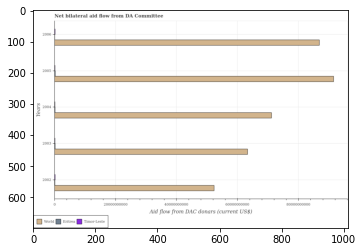

Number of QA =  29





,Years,Timor-Leste,Eritrea,World
0,2006,NaN,NaN,8.731238e+10
1,2004,NaN,NaN,7.161857e+10
2,2002,NaN,NaN,5.265573e+10
3,2003,NaN,NaN,6.387440e+10
4,2005,NaN,NaN,9.144623e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the aid flow in in world in 2004 and that in 2005 ?
PREDICTED =  -19827666718.1613
EXPECTED =  -20366260000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the aid flow in in world and aid flow in in eritrea ?
PREDICTED =  73381462424.8677
EXPECTED =  70966520000.0




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or pre

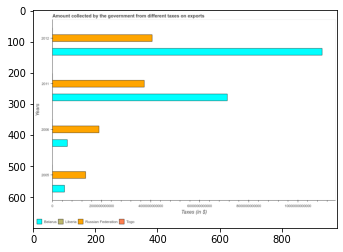

Number of QA =  30





,Years,Togo,Belarus,Liberia,Russian Federation
0,2012,NaN,1.098229e+13,NaN,4.110364e+12
1,2006,NaN,6.377181e+11,NaN,1.912908e+12
2,2011,NaN,7.158215e+12,NaN,3.749618e+12
3,2005,NaN,5.175861e+11,NaN,1.381259e+12


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected by the government from taxes on exports in togo in 2006 and that in 2011 ?
PREDICTED =  -1836709655170.6357
EXPECTED =  -1368544709.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount collected by the government from taxes on exports in togo in 2006 and the amount collected by the government from taxes on exports in liberia in 2011 ?
PREDICTED =  1912907960833.2764
EXPECTED =  391428636.5875736




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the amount collected by the government from taxes on expor

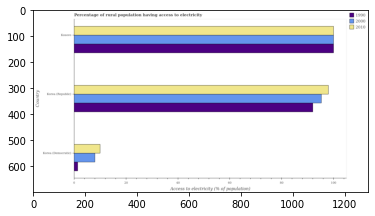

Number of QA =  29





,Country,2000,1990,2010
0,Kosovo,100.234427,100.245527,100.041781
1,Korea (Democratic),8.232992,1.620571,10.185948
2,Korea (Republic),95.424000,92.341034,99.033648


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population having access to electricity in 2000 in korea (republic) and that in kosovo ?
PREDICTED =  -4.810426578353045
EXPECTED =  -4.700000000000003




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population having access to electricity in 2000 in korea (democratic) and the percentage of rural population having access to electricity in 2010 in korea (republic)?
PREDICTED =  -87.19100764303525
EXPECTED =  -90.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population havi

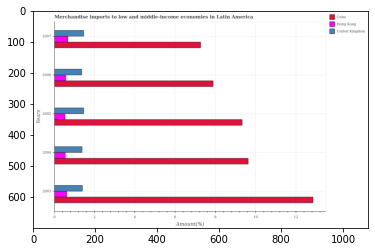

Number of QA =  29





,Years,United Kingdom,Cuba,Hong Kong
0,2004,1.411710,9.705119,0.573286
1,2007,1.509491,7.275046,0.709364
2,2006,1.400989,7.851420,0.587964
3,2003,1.447909,12.962255,0.626589
4,2005,1.482545,9.424284,0.561435


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in hong kong in 2005 and that in 2007 ?
PREDICTED =  -0.14792939208363998
EXPECTED =  -0.14670298602739185




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in united kingdom in 2004 and the percentage of amount earned from merchandise imports in hong kong in 2006 ?
PREDICTED =  0.01072054954021806
EXPECTED =  0.807710750110522




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the percentage of amount earned from merchan

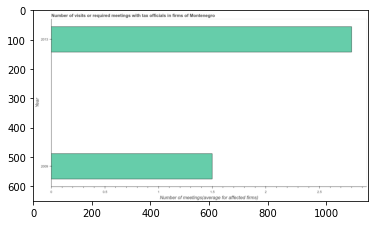

Number of QA =  19





,Year,Number of meetings(average for affected firms)
0,2013,2.812540
1,2009,1.522872


> what is the title of the graph ?
PREDICTED =  Number of visits or required meetings with tax officials in firms of Montenegro
EXPECTED =  Number of visits or required meetings with tax officials in firms of Montenegro




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Number of meetings(average for affected firms)
EXPECTED =  Number of meetings(average for affected firms)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of required meetings with tax officials in 2009 and 2013 ?
PREDICTED =  -1.2896674311302807
EXPECTED =  -1.3




				 4 / 4 = 1.0


> what is the median number of required meetings with tax officials ?
PREDICTED =  None
EXPECTED =  2.15




				 4 / 6 = 0.6667


is_built_with_cuda: True
is

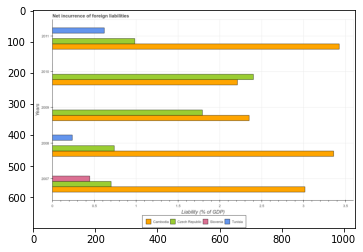

Number of QA =  26





,Years,Cambodia,Slovenia,Tunisia,Czech Republic
0,2008,3.334168,NaN,0.244536,0.744698
1,2011,3.401056,NaN,0.623775,0.992959
2,2007,3.015900,0.446765,NaN,0.700627
3,2010,2.208885,NaN,NaN,2.390880
4,2009,2.322401,NaN,NaN,1.805588


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net incurrence of foreign liabilities in cambodia in 2010 and that in 2011 ?
PREDICTED =  -1.1921708512692635
EXPECTED =  -1.2163333199266897




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the net incurrence of foreign liabilities in cambodia and net incurrence of foreign liabilities in tunisia ?
PREDICTED =  3.0
EXPECTED =  3.122491015329363




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is th

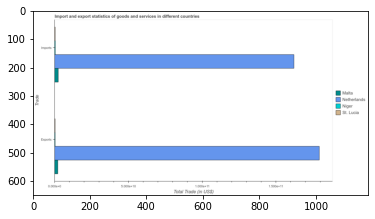

Number of QA =  23





,Trade,St. Lucia,Malta,Netherlands,Niger
0,Exports,NaN,0.446398,32.133933,NaN
1,Imports,NaN,0.510794,29.220343,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Total Trade (in US$)
EXPECTED =  50000000000.0




				 0 / 5 = 0.0


> what is the title of the graph ?
PREDICTED =  Import and export statistics of goods and services in different countries
EXPECTED =  Import and export statistics of goods and services in different countries




				 1 / 6 =

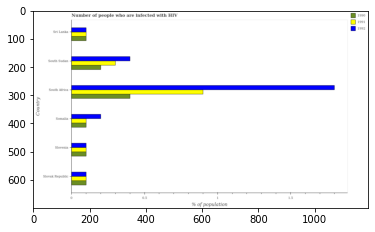

Number of QA =  29





,Country,1992,1990,1991
0,Sri Lanka,0.106311,0.105070,0.105360
1,Slovenia,0.105290,0.106473,0.105227
2,Slovak Republic,0.106293,0.105476,0.105414
3,South Sudan,0.404919,0.206719,0.301352
4,South Africa,1.823857,0.408616,NaN
5,Somalia,0.208195,0.105810,0.105396


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected population in in 1991 in somalia and that in sri lanka ?
PREDICTED =  3.5883039614104106e-05
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected population in in 1990 in somalia and the percentage of hiv infected population in in 1992 in south sudan?
PREDICTED =  -0.10090900959698061
EXPECTED =  -0.30000000000000004




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected population in in 1991 and percentage of hiv infected population in in 1990 in sou

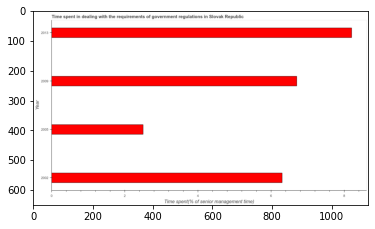

Number of QA =  23





,Year,Time spent(% of senior management time)
0,2005,2.516015
1,2002,6.364227
2,2013,8.257841
3,2009,6.704879


> what is the title of the graph ?
PREDICTED =  Time spent in dealing with the requirements of government regulations in Slovak Republic
EXPECTED =  Time spent in dealing with the requirements of government regulations in Slovak Republic




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Time spent(% of senior management time)
EXPECTED =  Time spent(% of senior management time)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the time spent in dealing with government regulations in 2005 and 2013 ?
PREDICTED =  -5.741825221954988
EXPECTED =  -5.7




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the media

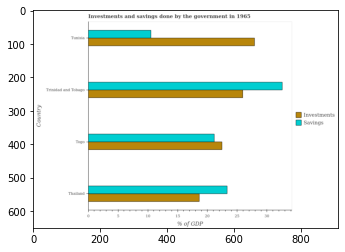

Number of QA =  28





,Country,Savings,Investments
0,Thailand,23.232509,NaN
1,Trinidad and Tobago,32.548300,26.224825
2,Togo,21.294057,22.350596
3,Tunisia,10.644644,27.979016


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the investments of government in togo and that in trinidad and tobago ?
PREDICTED =  -3.8742289433208477
EXPECTED =  -3.488




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the investments of government in trinidad and tobago and the savings of government in thailand ?
PREDICTED =  0.0
EXPECTED =  2.6183177017647914




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the investments of government and savings of government in togo ?
PREDICTED =  54.203840985031235
EXPECTED =  1.295




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False

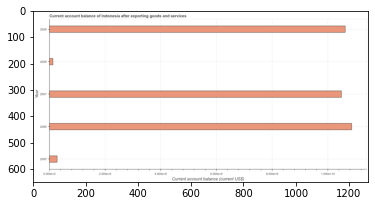

Number of QA =  23





,Year,Current account balance (current US$)
0,2005,0.288802
1,2008,0.142239
2,2007,10.534143
3,2009,10.645609
4,2006,10.986710


> what is the title of the graph ?
PREDICTED =  Current account balance of Indonesia after exporting goods and services
EXPECTED =  Current account balance of Indonesia after exporting goods and services




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Current account balance (current US$)
EXPECTED =  Current account balance (current US$)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the current account balance in 2007 and 2009 ?
PREDICTED =  -0.1114658169075522
EXPECTED =  -137447859.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median current account balance ?
PREDICTED =  10.5341428855

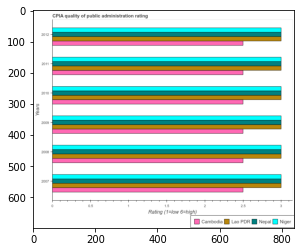

Number of QA =  30





,Years,Cambodia,Niger,Nepal,Lao PDR
0,2010,2.517462,3.017337,2.975656,2.990790
1,2011,NaN,2.974733,2.952713,2.980471
2,2007,2.502559,2.987866,2.987824,2.938404
3,2012,2.494234,2.991937,2.972874,2.988072
4,2008,2.492871,NaN,2.993311,2.977427
5,2009,2.503636,NaN,2.978560,2.977875


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in lao pdr in 2007 and that in 2012 ?
PREDICTED =  -0.04966751856630758
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in nepal in 2009 and the cpia rating in lao pdr in 2008 ?
PREDICTED =  -0.014751739347349524
EXPECTED =  0.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the cpia rating in lao pdr and cpia rating in niger ?
PREDICTED =  -1.0092095848516824
EXPECTED =  0.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ..

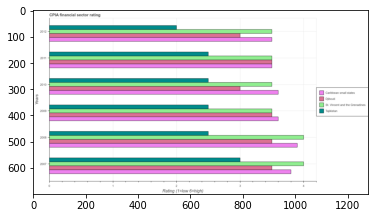

Number of QA =  30





,Years,Tajikistan,Djibouti,St. Vincent and the Grenadines,Caribbean small states
0,2012,2.013180,2.994541,3.623489,3.540823
1,2011,2.498130,3.502250,NaN,NaN
2,2007,3.066722,3.534579,4.070471,3.792659
3,2008,2.510276,3.491289,4.188659,3.891627
4,2010,2.521779,3.006789,3.492800,NaN
5,2009,2.521049,3.537907,3.451586,3.680048


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in caribbean small states in 2009 and that in 2011 ?
PREDICTED =  nan
EXPECTED =  0.10000000000000009




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in tajikistan in 2008 and the cpia rating in caribbean small states in 2007 ?
PREDICTED =  -0.0175306819835801
EXPECTED =  -1.2999999999999998




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the cpia rating in st. vincent and the grenadines and cpia rating in tajikistan ?
PREDICTED =  3.76540097037586
EXPECTED =  1.5




				 0 / 3 = 0.0


is_built_w

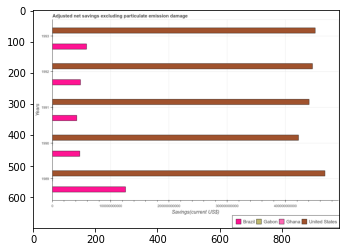

Number of QA =  27





,Years,Gabon,Brazil,Ghana,United States
0,1991,NaN,4.303843e+10,NaN,4.427317e+11
1,1992,NaN,4.950146e+10,NaN,4.487857e+11
2,1990,NaN,4.812221e+10,NaN,4.245605e+11
3,1989,NaN,1.265818e+11,NaN,4.761949e+11
4,1993,NaN,5.966488e+10,NaN,4.533467e+11


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adjusted net savings in united states in 1989 and that in 1993 ?
PREDICTED =  22848182014.16754
EXPECTED =  16706100555.703003




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adjusted net savings in brazil in 1993 and the adjusted net savings in gabon in 1991 ?
PREDICTED =  16626450217.135086
EXPECTED =  58533762285.7251




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the adjusted net savings in u

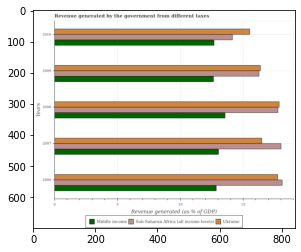

Number of QA =  29





,Years,Ukraine,Sub-Saharan Africa (all income levels),Middle income
0,2010,15.510605,14.143592,12.700919
1,2007,16.544831,17.930022,13.065960
2,2006,17.818803,18.083295,12.904753
3,2009,16.355200,16.234746,12.656866
4,2008,17.978334,17.733105,13.527504


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the revenue generated by the government in sub-saharan africa (all income levels) in 2006 and that in 2010 ?
PREDICTED =  3.9397027983829034
EXPECTED =  3.957965906826299




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the revenue generated by the government in sub-saharan africa (all income levels) in 2006 and the revenue generated by the government in ukraine in 2007 ?
PREDICTED =  0.15327254457601214
EXPECTED =  1.6186356051366992




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the revenue generated by the government in sub-s

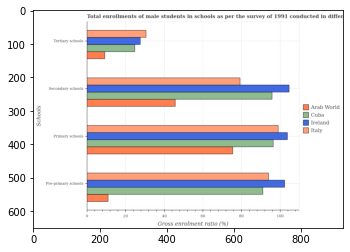

Number of QA =  29





,Schools,Ireland,Cuba,Arab World,Italy
0,Primary schools,104.034599,98.051381,76.979779,100.440172
1,Secondary schools,105.598154,96.910387,46.524495,80.356939
2,Tertiary schools,28.232457,25.274980,9.653899,31.134983
3,Pre-primary schools,102.281619,92.129339,11.407877,95.070655


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 6 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predic

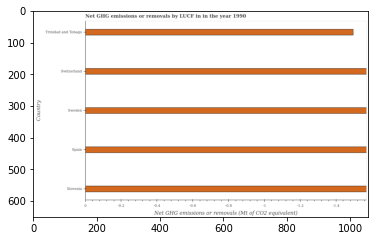

Number of QA =  12





,Country,Net GHG emissions or removals (Mt of CO2 equivalent)
0,Spain,1.582957
1,Switzerland,1.582174
2,Slovenia,1.582523
3,Trinidad and Tobago,1.499041
4,Sweden,1.578941


> what is the title of the graph ?
PREDICTED =  Net GHG emissions or removals by LUCF in in the year 1990
EXPECTED =  Net GHG emissions or removals by LUCF in in the year 1990




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Net GHG emissions or removals (Mt of CO2 equivalent)
EXPECTED =  Net GHG emissions or removals (Mt of CO2 equivalent)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median ghg net emissions or removals ?
PREDICTED =  1.5821742204406681
EXPECTED =  0.0




				 3 / 4 = 0.75


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Net GHG emissions or removals (Mt of CO2 equivalent)
EXPECTED =  0.19999999999999996




				 3 / 5 = 0.6


is_built_with_cuda: True
is_gpu_avail

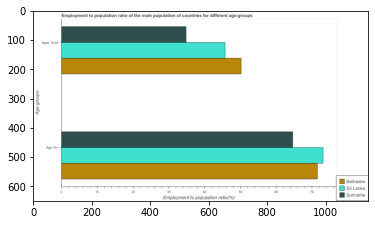

Number of QA =  23





,Age groups,Sri Lanka,Barbados,Suriname
0,Ages 15-24,46.025919,50.629061,35.199295
1,Age 15+,74.223280,71.537018,64.912838


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum employment to population ratio(age 15-24) ?
PREDICTED =  1.5542767922994278
EXPECTED =  50.2000007629395




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum employment to population ratio(age 15-24) ?
PREDICTED =  1.1000119506995403
EXPECTED =  34.7999992370605




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting .

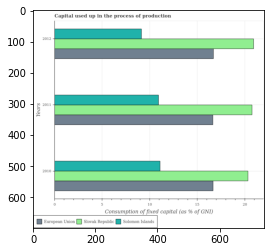

Number of QA =  29





,Years,Slovak Republic,Solomon Islands,European Union
0,2012,21.056540,9.278023,16.780499
1,2011,21.021517,11.056370,16.795144
2,2010,20.486230,11.143628,16.828373


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the capital used up in the process of production in solomon islands in 2010 and that in 2012 ?
PREDICTED =  -0.5703100868294548
EXPECTED =  1.9537312646370335




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the capital used up in the process of production in slovak republic in 2011 and the capital used up in the process of production in solomon islands in 2012 ?
PREDICTED =  -0.03502304392725719
EXPECTED =  11.621876408396133




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the capital used up in the process of production in solo

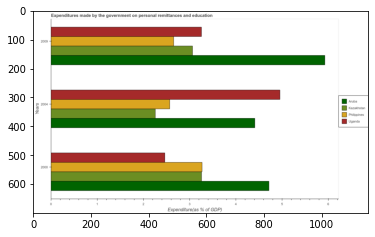

Number of QA =  30





,Years,Unnamed: 1,Philippines,Aruba,Kazakhstan
0,2009,3.291987,2.670235,5.969080,3.086062
1,2000,2.471393,3.270928,4.713031,3.270324
2,2004,4.951179,2.612100,4.406935,2.284619


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditures made by the government on personal remittances and education in aruba in 2000 and that in 2009 ?
PREDICTED =  -1.7130313184315966
EXPECTED =  -1.2099900245666486




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenditures made by the government on personal remittances and education in kazakhstan in 2004 and the expenditures made by the government on personal remittances and education in aruba in 2000 ?
PREDICTED =  0.2225285105494974
EXPECTED =  -2.458770275115971




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference bet

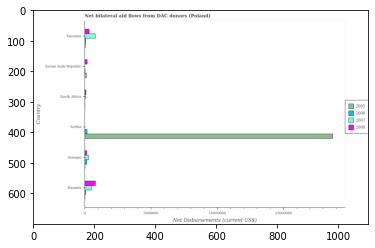

Number of QA =  27





,Country,2007,2005,2006,2008
0,South Africa,NaN,NaN,NaN,2.713970e+05
1,Syrian Arab Republic,NaN,3.068741e+05,NaN,4.312841e+05
2,Senegal,5.934238e+05,NaN,395515.931051,3.611921e+05
3,Tanzania,1.511511e+06,NaN,224622.118335,6.810309e+05
4,Serbia,NaN,3.389577e+07,404213.549636,NaN
5,Rwanda,1.047364e+06,NaN,233815.548097,1.535744e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flows in 2005 in senegal and that in south africa ?
PREDICTED =  0.0
EXPECTED =  0.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flows in 2008 in serbia and the net bilateral aid flows in 2006 in tanzania?
PREDICTED =  -681030.8899240011
EXPECTED =  -70000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GP

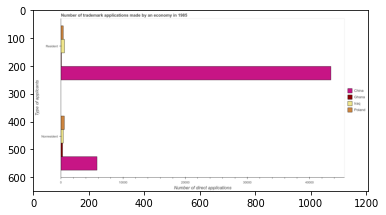

Number of QA =  23





,Type of applicants,Ghana,China,Poland,Iraq
0,Nonresident,309.002993,5843.094585,579.933181,408.572511
1,Resident,NaN,43576.712702,435.436264,614.126102


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by non residents in china and that in ghana ?
PREDICTED =  1.0
EXPECTED =  5548




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by residents in iraq and the number of trademark applications made by non residents in ghana ?
PREDICTED =  -1.0
EXPECTED =  311




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of trademark applications made by non residents and number of trademark applications made by residents in china ?
PREDICTED =  0.0
EXPECTED =  -37647




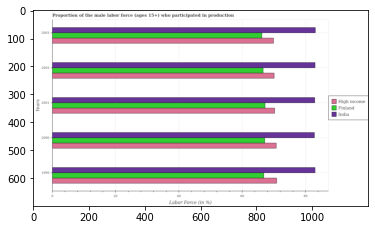

Number of QA =  29





,Years,Finland,India,High income
0,2000,67.541661,84.274616,71.000012
1,2003,66.741736,84.054385,70.267586
2,1999,67.029624,84.437856,71.604523
3,2002,67.276872,84.581580,70.736265
4,2001,67.718531,84.685811,70.387682


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male labor force who participated in production in high income in 2001 and that in 2003 ?
PREDICTED =  0.12009596262227262
EXPECTED =  0.35847258058559817




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male labor force who participated in production in high income in 2000 and the proportion of the male labor force who participated in production in india in 2003 ?
PREDICTED =  0.7324260519165762
EXPECTED =  -12.354720619934199




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the proport

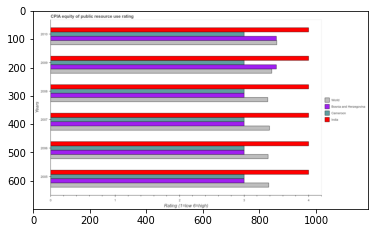

Number of QA =  30





,Years,Bosnia and Herzegovina,India,Cameroon,World
0,2010,3.481939,4.041098,2.984486,3.505852
1,2006,3.013305,3.935004,2.991023,3.507268
2,2005,3.038775,4.033438,2.998343,NaN
3,2009,NaN,NaN,NaN,3.438655
4,2008,3.008527,3.980904,2.980380,NaN
5,2007,2.989956,4.016047,3.008695,3.368838


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in bosnia and herzegovina in 2007 and that in 2010 ?
PREDICTED =  0.0
EXPECTED =  -0.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in world in 2006 and the cpia rating in cameroon in 2005 ?
PREDICTED =  0.0
EXPECTED =  0.37179487179487003




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the cpia rating in cameroon and cpia rating in india ?
PREDICTED =  -1.9913049615196834
EXPECTED =  -1.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ..

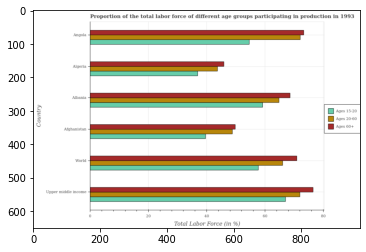

Number of QA =  29





,Country,Ages 15-20,Ages 60+,Ages 20-60
0,World,58.126724,71.872617,66.925508
1,Albania,59.889965,69.079357,65.007476
2,Afghanistan,39.996956,50.431302,48.952886
3,Angola,55.224271,NaN,72.409089
4,Algeria,37.109269,46.663121,44.362423
5,Upper middle income,67.838805,77.209285,73.063479


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force within the age group 15-20 in albania and that in algeria ?
PREDICTED =  22.78069580139322
EXPECTED =  22.3




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of labor force above age 60 in albania to that in upper middle income ?
PREDICTED =  0.012951810077328253
EXPECTED =  0.897




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: 

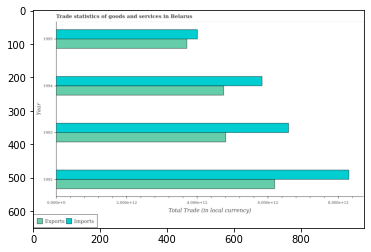

Number of QA =  28





,Year,Imports,Exports
0,1995,4.052494,3.717344
1,1993,6.618477,4.854501
2,1994,5.866060,4.799132
3,1992,8.346059,6.188420


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export of goods and services in 1993 and that in 1994 ?
PREDICTED =  14.70489675537994
EXPECTED =  57675020411.489




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the export of goods and services in 1994 and the imports of goods and services in 1993 ?
PREDICTED =  14.70489675537994
EXPECTED =  -1838418109477.9697




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the export of goods and services and imports of goods and services ?
PREDICTED =  14.669548446308063
EXPECTED =  -299659274571.56




				 0 / 3 = 0.0


is_built_with_

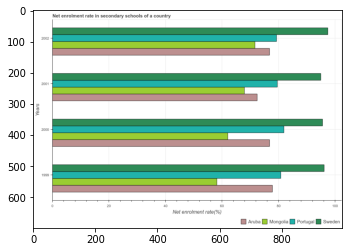

Number of QA =  30





,Years,Sweden,Aruba,Mongolia,Portugal
0,2002,97.619471,77.312372,72.377538,79.755845
1,2001,95.313338,72.726580,68.660993,80.326339
2,1999,98.170834,78.766355,NaN,81.490449
3,2000,96.610274,77.619074,NaN,82.343549


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate in secondary schools in aruba in 1999 and that in 2001 ?
PREDICTED =  6.039775296913888
EXPECTED =  5.391426086425696




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net enrolment rate in secondary schools in portugal in 2000 and the net enrolment rate in secondary schools in aruba in 2002 ?
PREDICTED =  2.5877037140115533
EXPECTED =  5.090126037597599




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the net enrolment rate in secondary schools in aruba and net enrolment rate in secondary schools in swed

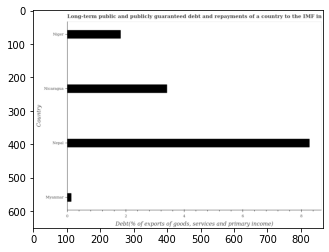

Number of QA =  22





,Country,"Debt(% of exports of goods, services and primary income)"
0,Nepal,8.287458
1,Myanmar,0.151653
2,Niger,1.823273
3,Nicaragua,3.413615


> what is the title of the graph ?
PREDICTED =  Long-term public and publicly guaranteed debt and repayments of a country to the IMF in
EXPECTED =  Long-term public and publicly guaranteed debt and repayments of a country to the IMF in 2008




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Debt(% of exports of goods, services and primary income)
EXPECTED =  Debt(% of exports of goods, services and primary income)




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the debt service in myanmar and nicaragua ?
PREDICTED =  -3.261961442767084
EXPECTED =  -3.271




				 3 / 4 = 0.75


> what is the median debt service ?
PREDICTED =  None
EXPECTED =  2.61218427928762




				 3 / 6 = 0.5


is_built_with_cuda: True
i

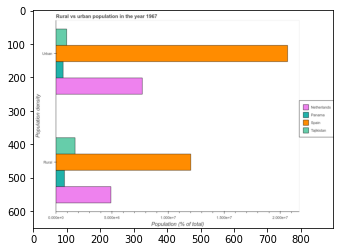

Number of QA =  23





,Population density,Spain,Panama,Tajikistan,Netherlands
0,Urban,20.483182,0.676472,1.012517,7.747147
1,Rural,12.171040,0.802536,1.742634,4.876612


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population density in tajikistan and the rural population density in panama ?
PREDICTED =  0.336044504876048
EXPECTED =  199952




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population density and rural population density in netherlands ?
PREDICTED =  -6.747147486496072
EXPECTED =  2801335




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the rural population density in netherlands to 

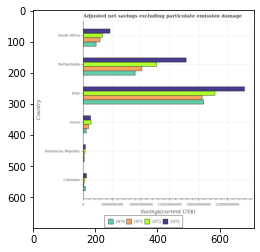

Number of QA =  30





,Country,1972,1971,1970,1973
0,Colombia,6.894515e+08,NaN,8.964661e+08,1.220179e+09
1,Netherlands,2.311424e+10,1.898131e+10,1.636438e+10,3.233862e+10
2,South Africa,6.193284e+09,5.498314e+09,4.243237e+09,8.596042e+09
3,Dominican Republic,7.362210e+08,NaN,NaN,8.808383e+08
4,Israel,2.630368e+09,1.835875e+09,1.166103e+09,2.502389e+09
5,Italy,NaN,3.733947e+10,NaN,5.059076e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adjusted net savings in 1970 in israel and that in south africa ?
PREDICTED =  -3077133938.098608
EXPECTED =  -1709941357.610536




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adjusted net savings in 1972 in italy and the adjusted net savings in 1973 in netherlands?
PREDICTED =  -32338617330.9649
EXPECTED =  4993125795.0569




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adjusted net savings in 1971 and adjusted net savings in 1970 in netherlands ?
PREDICTED =  -16364384003.220787
EXPECTED =  1165810250.6805




				 0 / 3 = 0.0


is

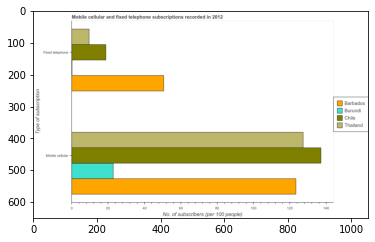

Number of QA =  23





,Type of subscription,Chile,Burundi,Thailand,Barbados
0,Fixed telephone,19.089757,NaN,10.029349,51.261379
1,Mobile cellular,139.618768,22.823403,129.040385,124.118613


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of mobile cellular subscribers in burundi and that in chile ?
PREDICTED =  -138.61876762801208
EXPECTED =  -114.26671912944819




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of mobile cellular subscribers in burundi and the number of fixed telephone subscribers in barbados ?
PREDICTED =  -1.0
EXPECTED =  -27.8025491256053




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of mobile cellular subscribers and number of fixed telephone subscribers in burundi ?
PREDICTED =  0.0
EXPECTED =  22.637863646622467




				 0 /

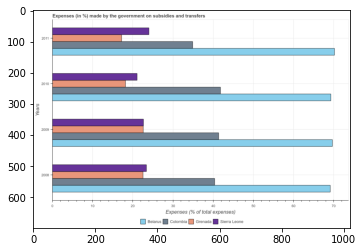

Number of QA =  30





,Years,Grenada,Belarus,Sierra Leone,Colombia
0,2010,18.426065,69.532943,21.192580,42.068702
1,2008,22.794775,69.493263,23.705970,40.756462
2,2011,17.310883,70.529301,24.241324,35.298117
3,2009,NaN,70.063230,22.858721,42.129124


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of expenses made by the government on subsidies and transfers in sierra leone in 2009 and that in 2010 ?
PREDICTED =  -3.8816973757680593
EXPECTED =  1.582221438940909




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of expenses made by the government on subsidies and transfers in sierra leone in 2008 to that in 2010 ?
PREDICTED =  1.075601691223954
EXPECTED =  1.

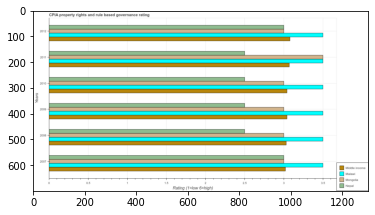

Number of QA =  30





,Years,Malawi,Nepal,Middle income,Mongolia
0,2012,3.598447,2.991754,3.170609,3.079135
1,2011,NaN,2.516453,3.180766,NaN
2,2010,NaN,2.574318,3.158674,3.055724
3,2009,NaN,2.508193,3.057097,2.999992
4,2007,NaN,2.979337,3.082573,3.103013
5,2008,NaN,2.513297,3.238566,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in mongolia in 2011 and that in 2012 ?
PREDICTED =  nan
EXPECTED =  0.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in malawi in 2011 and the cpia rating in middle income in 2008 ?
PREDICTED =  0.35988027524847466
EXPECTED =  0.46875




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the cpia rating in middle income and cpia rating in mongolia ?
PREDICTED =  5.378235711742139
EXPECTED =  0.07843137254902022




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training 

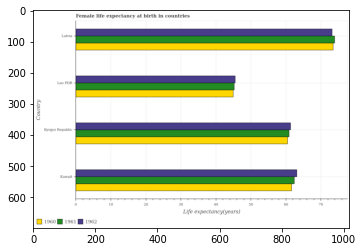

Number of QA =  29





,Country,1962,1961,1960
0,Latvia,73.329635,74.339872,73.668697
1,Lao PDR,45.786321,45.388730,45.223980
2,Kuwait,63.176821,62.915635,61.953192
3,Kyrgyz Republic,61.357368,61.126714,60.531003


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female life expectancy at birth in 1961 in lao pdr and that in latvia ?
PREDICTED =  -28.951142089423435
EXPECTED =  -28.693000000000005




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the female life expectancy at birth in 1960 in kuwait and the female life expectancy at birth in 1962 in kyrgyz republic?
PREDICTED =  0.5958245058502669
EXPECTED =  0.3089999999999975




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what

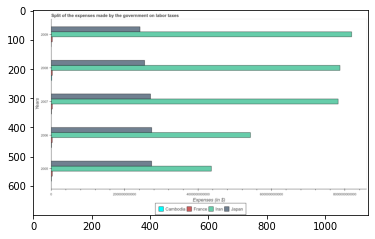

Number of QA =  30





,Years,Japan,Cambodia,lran,France
0,2007,NaN,NaN,7.836827e+12,NaN
1,2005,2.747564e+12,NaN,4.353717e+12,NaN
2,2006,2.757814e+12,NaN,NaN,NaN
3,2009,2.431273e+12,NaN,8.261886e+12,NaN
4,2008,2.581057e+12,NaN,7.943371e+12,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenses made by the government on labor taxes in cambodia in 2005 and that in 2006 ?
PREDICTED =  4353717340238.089
EXPECTED =  -2536162314.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the expenses made by the government on labor taxes in iran in 2005 and the expenses made by the government on labor taxes in cambodia in 2009 ?
PREDICTED =  4353717340238.089
EXPECTED =  4360144268274.24




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the expenses made by the government on labor taxes in cambodia and expenses made by the

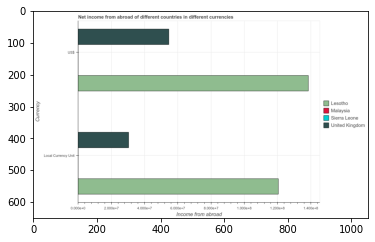

Number of QA =  20





,Currency,United Kingdom,Sierra Leone,Lesotho,Malaysia
0,US$,5.454124,NaN,13.823069,NaN
1,Local Currency Unit,3.065843,NaN,12.111878,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income from abroad in us$ in lesotho and that in united kingdom ?
PREDICTED =  -5.4541239387296345
EXPECTED =  83987758.1903715




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the income from abroad in us$ in lesotho and the income from abroad in constant 2005 us$ in malaysia ?
PREDICTED =  0.0
EXPECTED =  138574999.8795




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the income from abroad in us$ in 

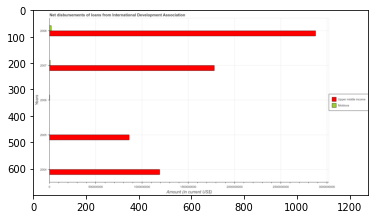

Number of QA =  24





,Years,Upper middie income,Moldova
0,2006,NaN,NaN
1,2008,5.204738e+09,4.482635e+07
2,2005,1.566319e+09,NaN
3,2004,2.197684e+09,NaN
4,2007,3.229639e+09,2.410898e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loans disbursed in moldova in 2007 and that in 2008 ?
PREDICTED =  -1975098915.8403316
EXPECTED =  -11270000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loans disbursed in moldova in 2005 and the amount of loans disbursed in upper middle income in 2007 ?
PREDICTED =  -1663320704.83597
EXPECTED =  -1781232000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the amount of loans disbursed in moldova and amount of loans disbursed in upper middle income ?
PREDICTED =  -12198380642.456192
EXPECTED =  -

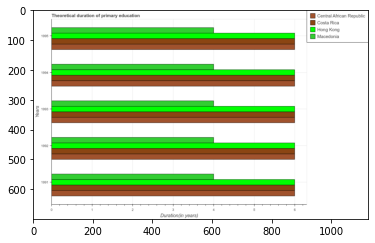

Number of QA =  30





,Years,Central African Republic,Costa Rica,Macedonia,Hong Kong
0,1995,5.988274,6.035663,4.014506,5.969484
1,1993,6.011868,6.022770,4.011073,6.005205
2,1991,6.037805,6.014324,4.029675,6.053695
3,1994,6.016022,6.031419,4.018947,6.011052
4,1992,6.020130,6.030466,4.020437,5.877501


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the total theoretical duration of primary education in macedonia in 1994 ?
PREDICTED =  0.8037894184167957
EXPECTED =  4




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum total theoretical duration of primary education in hong kong ?
PREDICTED =  1.2107389299476776
EXPECTED =  6




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum total theoretical duration of primary education in macedonia ?
PREDICTED =  398.6
EXPECTED =  4




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after train

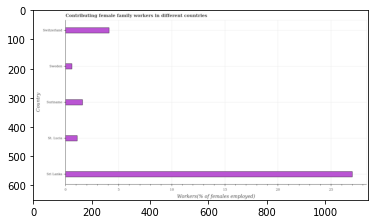

Number of QA =  22





,Country,Workers(% of females employed)
0,St. Lucia,1.163890
1,Switzerland,4.151440
2,Sweden,0.672288
3,Sri Lanka,27.017804
4,Suriname,1.666626


> what is the title of the graph ?
PREDICTED =  Contributing female family workers in different countries
EXPECTED =  Contributing female family workers in different countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Workers(% of females employed)
EXPECTED =  Workers(% of females employed)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the contributing female family workers in sweden and switzerland ?
PREDICTED =  -3.479152401601431
EXPECTED =  -3.5




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 4 / 5 = 0.8


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicti

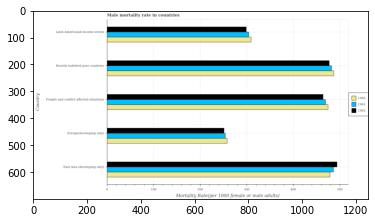

Number of QA =  29





,Country,1962,1961,1960
0,Latin America(all income levels),301.384715,NaN,NaN
1,Heavily indebted poor countries,481.371599,485.506078,484.757547
2,Fragile and conflict affected situations,465.749757,NaN,477.222304
3,East Asia (developing only),495.772993,487.311439,483.436531
4,Europe(developing only),253.607571,255.521015,259.425627


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male mortality rate in 1961 in europe(developing only) and that in latin america(all income levels) ?
PREDICTED =  0.0
EXPECTED =  -50.137605950697974




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the male mortality rate in 1960 in latin america(all income levels) and the male mortality rate in 1961 in fragile and conflict affected situations?
PREDICTED =  -477.22230384824564
EXPECTED =  -159.69594291484702




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fin

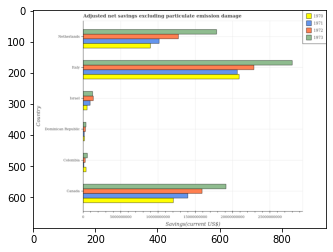

Number of QA =  30





,Country,1972,1971,1970,1973
0,Colombia,6.331743e+08,NaN,8.385067e+08,1.134050e+09
1,Netherlands,NaN,NaN,1.632942e+10,3.210760e+10
2,Israel,2.582218e+09,1.805816e+09,1.114277e+09,2.477194e+09
3,Canada,2.871984e+10,2.528742e+10,2.197217e+10,3.447826e+10
4,Dominican Republic,7.178079e+08,4.450873e+08,4.812583e+08,8.656673e+08
5,Italy,NaN,3.712559e+10,NaN,5.028451e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adjusted net savings in 1971 in israel and that in italy ?
PREDICTED =  -35319770979.000084
EXPECTED =  -19704197047.268448




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adjusted net savings in 1970 in dominican republic and the adjusted net savings in 1973 in colombia?
PREDICTED =  -357248401.582378
EXPECTED =  -383733253.83316505




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the adjusted net savings in 1971 and adjusted net savings in 1972 in canada ?
PREDICTED =  -28719838927.78675
EXPECTED =  -1904071088.0805988




				 0 / 3 = 0

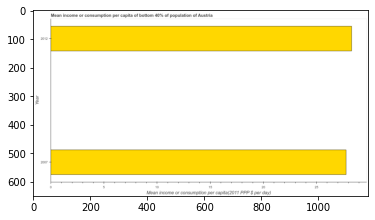

Number of QA =  19





,Year,Mean income or consumption per capita(2011 PPP $ per day)
0,2007,27.976489
1,2012,28.535986


> what is the title of the graph ?
PREDICTED =  Mean income or consumption per capita of bottom 40% of population of Austria
EXPECTED =  Mean income or consumption per capita of bottom 40% of population of Austria




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Mean income or consumption per capita(2011 PPP $ per day)
EXPECTED =  Mean income or consumption per capita(2011 PPP $ per day)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the mean income or consumption in 2007 and 2012 ?
PREDICTED =  -0.559497080980389
EXPECTED =  -0.525




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median mean i

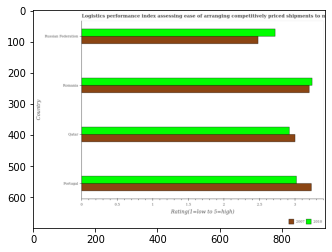

Number of QA =  28





,Country,2007,2010
0,Portugal,3.216907,3.024659
1,Romania,3.207687,3.229646
2,Russian Federation,2.463687,2.718642
3,Qatar,2.998961,2.925742


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in 2007 in portugal and that in russian federation ?
PREDICTED =  0.3333333333333333
EXPECTED =  0.75




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in 2007 in qatar and the logistic performance index in 2010 in romania?
PREDICTED =  -0.20872612652059575
EXPECTED =  -0.2400000000000002




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the logistic performance index in 2007 and logistic performance index in 2010 in portugal ?
PREDICTED =  8.862582443630368
EXPECTED =  0.20999999999999996

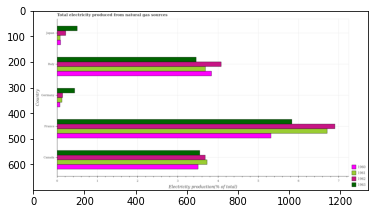

Number of QA =  30





,Country,1963,1962,1961,1960
0,Japan,0.518120,0.217544,0.088187,0.098920
1,Canada,3.573190,3.692392,3.746536,NaN
2,France,5.844218,6.757841,6.868336,NaN
3,Germany,0.446854,0.146228,0.130765,0.084421
4,Italy,3.481989,4.089882,3.686685,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced in 1962 in germany and that in japan ?
PREDICTED =  -0.07131605175635775
EXPECTED =  -0.07744833399924489




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced in 1960 in italy and the total electricity produced in 1961 in germany?
PREDICTED =  0.0989199831760858
EXPECTED =  3.717870354826564




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total electricity produced in 1963 and total electricity produced in 1962 in canada ?
PREDICTED =  10.171978976516732
EXPECTED =  -0.13541283304836993

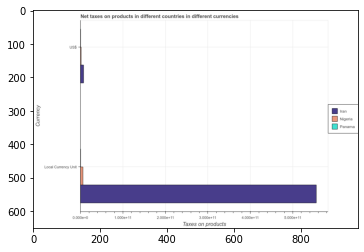

Number of QA =  23





,Currency,Panama,Nigeria,Iran
0,US$,NaN,NaN,0.086991
1,Local Currency Unit,NaN,0.072269,5.581084


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net taxes in us$ in iran and that in nigeria ?
PREDICTED =  0.08699098955523367
EXPECTED =  5662356916.95218




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net taxes in constant 2005 us$ and net taxes in us$ in panama ?
PREDICTED =  -0.9130090104447663
EXPECTED =  0.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICT

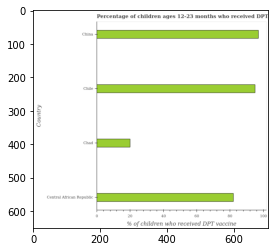

Number of QA =  22





,Country,% of children who received DPT vaccine
0,Chad,20.585181
1,China,98.115579
2,Chile,95.734881
3,Central African Republic,83.206709


> what is the title of the graph ?
PREDICTED =  Percentage of children ages 12-23 months who received DPT
EXPECTED =  Percentage of children ages 12-23 months who received DPT vaccinations in 1990




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  % of children who received DPT vaccine
EXPECTED =  % of children who received DPT vaccine




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who received dpt vaccine in chad and china ?
PREDICTED =  -77.53039729862985
EXPECTED =  -77.0




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of children who rece

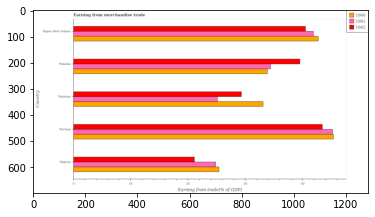

Number of QA =  29





,Country,1962,1961,1960
0,Nigeria,21.386622,25.095910,25.747821
1,Panama,39.786152,34.864719,34.189583
2,Papua New Guinea,40.683330,42.053603,43.062318
3,Norway,43.880408,45.379405,45.330360
4,Pakistan,29.591563,25.336880,33.522281


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from trade in 1962 in pakistan and that in papua new guinea ?
PREDICTED =  -11.091767798131123
EXPECTED =  -11.184150375604801




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from trade in 1961 in panama and the earnings from trade in 1960 in nigeria?
PREDICTED =  9.768808849017844
EXPECTED =  8.9853829846829




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from trade in 1961 and earnings from trade in 1960 in nigeria ?
PREDICTED =  146.9826961980918
EXPECTED =  -0.5989863834729015




				 1 / 3 = 0.3333


i

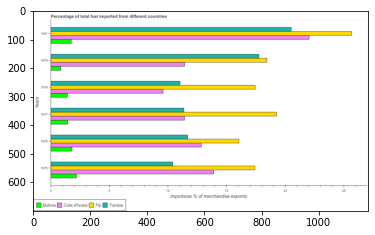

Number of QA =  30





,Years,Fiji,Bolivia,Tunisia,Cote d'Ivoire
0,1976,16.028347,1.844141,11.841828,12.886986
1,1981,23.686896,1.795060,20.690955,22.168254
2,1977,NaN,1.483229,11.374048,11.457942
3,1975,17.586857,2.224561,10.430667,13.913022
4,1979,NaN,0.880905,17.609302,11.476690
5,1978,NaN,1.470302,11.074167,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in fiji in 1975 and that in 1979 ?
PREDICTED =  17.58685690506915
EXPECTED =  -1.0135386063326983




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1976, what is the difference between the percentage of imports to different countries in cote d'ivoire and percentage of imports to different countries in bolivia ?
PREDICTED =  22.168254133067123
EXPECTED =  11.044218288195289




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after t

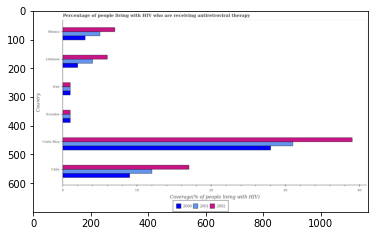

Number of QA =  29





,Country,2002,2000,2001
0,Lebanon,6.060910,2.059450,4.091462
1,Chile,NaN,9.132364,NaN
2,Mexico,7.038350,3.111435,5.085619
3,Ecuador,1.097303,1.085130,1.084863
4,Iran,1.107187,1.089861,1.072718
5,Costa Rica,38.828357,28.273277,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the hiv infected people who are receiving antiretroviral therapy in 2002 in chile and that in lebanon ?
PREDICTED =  -6.060910166633864
EXPECTED =  11.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the hiv infected people who are receiving antiretroviral therapy in 2002 in chile and the percentage of the hiv infected people who are receiving antiretroviral therapy in 2000 in ecuador?
PREDICTED =  -1.0973030782327848
EXPECTED =  16.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the hiv in

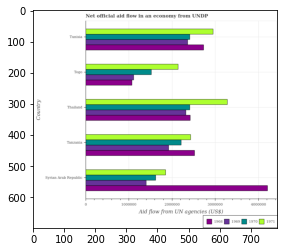

Number of QA =  30





,Country,1971,1970,1969,1968
0,Thailand,3.316639e+06,2.428819e+06,2.341918e+06,2.446474e+06
1,Togo,2.158625e+06,1.522914e+06,1.125340e+06,1.093578e+06
2,Tunisia,2.984698e+06,2.436320e+06,2.374614e+06,2.764824e+06
3,Tanzania,NaN,2.235916e+06,1.930874e+06,2.522983e+06
4,Syrian Arab Republic,1.889670e+06,1.649125e+06,1.439917e+06,4.292881e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in 1968 in tanzania and that in thailand ?
PREDICTED =  76509.10571728228
EXPECTED =  100000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in 1968 in togo and the net official aid flow in 1970 in thailand?
PREDICTED =  -1352896.5971515812
EXPECTED =  -1340000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in 1968 and net official aid flow in 1971 in togo ?
PREDICTED =  465523.4960952578
EXPECTED =  -1070000.0




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_

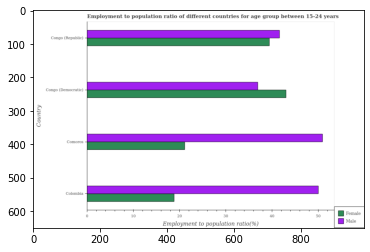

Number of QA =  28





,Country,Female,Male
0,Comoros,21.459959,51.075222
1,Colombia,19.136783,50.237903
2,Congo (Democratic),43.411198,37.285088
3,Congo (Republic),39.476262,41.931983


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum employment to population ratio(male) ?
PREDICTED =  0.01957896542021151
EXPECTED =  50.9000015258789




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ..

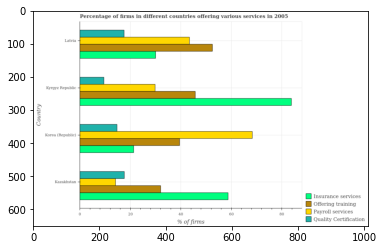

Number of QA =  30





,Country,Offering training,Payroll services,Quality Certification,Insurance services
0,Latvia,52.911156,43.169424,17.704433,29.700227
1,Kazakhstan,32.683688,14.187145,17.923610,59.498081
2,Korea (Republic),39.625789,68.606881,14.891185,21.709212
3,Kyrgyz Republic,46.915759,29.971979,9.826075,83.796648


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of firms offering payroll services in kazakhstan and that in kyrgyz republic ?
PREDICTED =  -15.784834228181747
EXPECTED =  -15.7




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of firms offering quality certification in latvia and the percentage of firms offering insurance services in korea (republic) ?
PREDICTED =  2.8132479139858138
EXPECTED =  -3.8000000000000007




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of firms offering quality certification and percentage of firms offering training in kaza

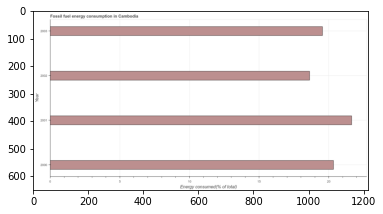

Number of QA =  23





,Year,Energy consumed(% of total)
0,2001,21.714249
1,2002,18.656759
2,2000,20.362799
3,2003,19.476032


> what is the title of the graph ?
PREDICTED =  Fossil fuel energy consumption in Cambodia
EXPECTED =  Fossil fuel energy consumption in Cambodia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Energy consumed(% of total)
EXPECTED =  Energy consumed(% of total)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the fossil fuel energy consumption in 2001 and 2003 ?
PREDICTED =  2.2382171020906263
EXPECTED =  2.095




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median fossil fuel energy consumption ?
PREDICTED =  19.91941548629482
EXPECTED =  19.94170872459335




				 4 / 5 = 0.8


is_built_with_

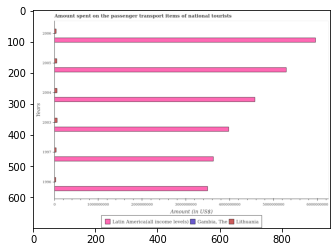

Number of QA =  29





,Years,"Gambia, The",Lithuania,Latin America(all income levels)
0,1996,NaN,NaN,3.521569e+09
1,1997,NaN,5.223739e+07,3.639105e+09
2,2006,NaN,5.214821e+07,6.009167e+09
3,2003,NaN,7.563100e+07,4.018061e+09
4,2004,NaN,7.296592e+07,4.618523e+09
5,2005,NaN,6.782075e+07,5.335635e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the passenger transport items of national tourists in latin america(all income levels) in 1997 and that in 2003 ?
PREDICTED =  -378955678.1635575
EXPECTED =  -349217227.54451036




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on the passenger transport items of national tourists in gambia, the in 2006 and the amount spent on the passenger transport items of national tourists in lithuania in 1997 ?
PREDICTED =  -89186.75750660151
EXPECTED =  -36000000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference 

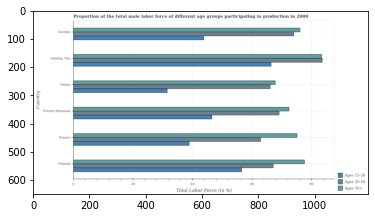

Number of QA =  29





,Country,Ages 20-50,Ages 50+,Ages 15-20
0,France,63.007246,75.869480,39.043767
1,Georgia,73.924065,77.415328,44.128414
2,Finland,66.923344,77.323907,56.854062
3,Gabon,66.320134,69.365632,NaN
4,"Gambia, The",84.619694,88.185331,66.482395
5,French Polynesia,68.586413,72.446664,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force within the age group 15-20 in finland and that in gambia, the ?
PREDICTED =  -9.628333758873808
EXPECTED =  -9.9




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force within the age group 20-50 in finland and the percentage of male labor force within the age group 15-20 in georgia ?
PREDICTED =  -7.000720991967299
EXPECTED =  23.299999237060497




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labor force within the age group 15-20 and percentage of male labor fo

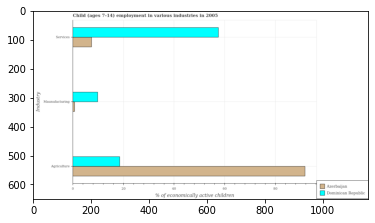

Number of QA =  28





,Industry,Azerbaijan,Dominican Republic
0,Agriculture,91.947126,18.877125
1,Services,7.620393,57.724900
2,Maunufacturing,0.907230,10.058556


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active children in manufacturing in dominican republic and that in azerbaijan ?
PREDICTED =  57.72489988101992
EXPECTED =  9.110000000000001




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active children in manufacturing in dominican republic and the percentage of economically active children in services in azerbaijan ?
PREDICTED =  50.10450664356419
EXPECTED =  2.41




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active children in agriculture and perce

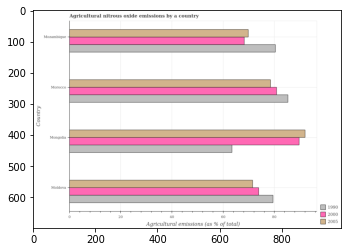

Number of QA =  29





,Country,2005,2000,1990
0,Morocco,79.483229,81.518754,86.449363
1,Mongolia,92.523180,90.909164,64.076071
2,Moldova,71.634978,74.131032,80.426383
3,Mozambique,70.483527,68.790946,81.749014


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of agricultural nitrous oxide emitted in 2005 in moldova and that in mongolia ?
PREDICTED =  -20.888201877636533
EXPECTED =  -20.483797566693184




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of agricultural nitrous oxide emitted in 2005 in moldova and the amount of agricultural nitrous oxide emitted in 1990 in mongolia?
PREDICTED =  -20.888201877636533
EXPECTED =  8.057199107739095




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of agricultural nitrous oxide emitted in 1990 and amount of agricultural nitrous oxi

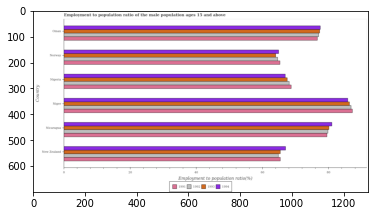

Number of QA =  30





,Country,1994,1992,1993,1991
0,Oman,78.978240,NaN,76.537549,78.172714
1,Norway,64.288418,63.551989,64.403559,65.484140
2,Nicaragua,81.297654,NaN,80.617231,NaN
3,New Zealand,66.831504,NaN,65.626247,65.307262
4,Nigeria,67.539207,NaN,67.347626,68.984950
5,Niger,NaN,NaN,87.789189,89.649169


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the total employment to population ratio in 1994 in the graph ?
PREDICTED =  0.01671611

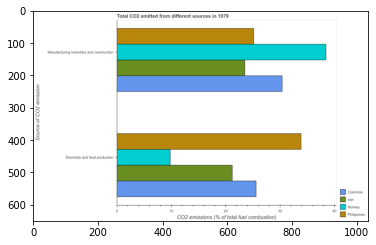

Number of QA =  23





,Source of CO2 emission,Philippines,Norway,Iran,Colombia
0,Electricity and heat production,33.825420,9.870599,21.178574,25.733801
1,Manufacturing industries and construction,25.396977,38.769117,23.806999,30.880994


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 emissions due to manufacturing industries and co2 emissions due to electricity and heat production in norway ?
PREDICTED =  -8.870599301214217
EXPECTED =  28.639294197488933




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  CO2 emissions (% of total fuel combustion)
EXPECTED =  10.0




				 0 / 5 = 

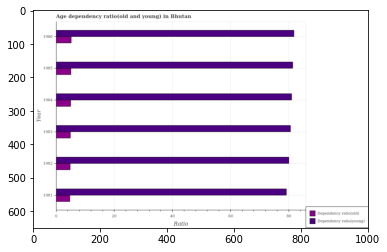

Number of QA =  28





,Year,Dependency ratio(old),Dependency ratio{young)
0,1985,5.237048,81.917145
1,1984,5.137626,81.854831
2,1981,4.940497,79.595989
3,1983,5.171263,81.123949
4,1982,4.986483,80.282788
5,1986,5.281773,82.457501


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the age dependency ratio(young) in 1986 ?
PREDICTED =  13.742916879550933
EXPECTED =  81.79574622571191




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum age dependency ratio(old) ?
PREDICTED =  331.0
EXPECTED =  5.19073237989673




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum age dependency ratio(young) ?
PREDICTED =  330.1666666666667
EXPECTED =  79.1934952012357




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the age dependency 

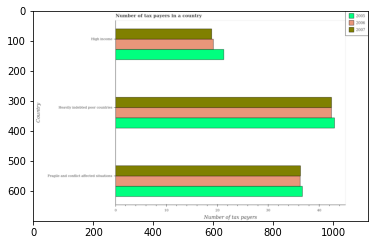

Number of QA =  29





,Country,2007,2005,2006
0,High income,19.141024,21.529134,19.664215
1,Fragile and conflict affected situations,36.795529,36.860094,36.751876
2,Heavily indebted poor countries,42.659420,43.413994,42.800832


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tax payers in in 2006 in fragile and conflict affected situations and that in high income ?
PREDICTED =  0.0
EXPECTED =  17.055862068965503




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tax payers in in 2007 in high income and the number of tax payers in in 2006 in fragile and conflict affected situations?
PREDICTED =  -35.795529094851865
EXPECTED =  -17.389069616135302




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of tax payers in in 2007 and number of tax payers in in 2006 in high income ?
PREDICTED = 

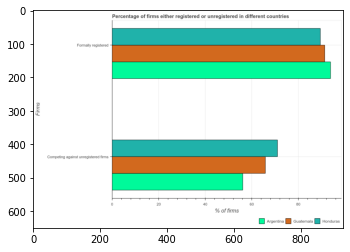

Number of QA =  23





,Firms,Honduras,Guatemala,Argentina
0,Formally registered,89.675936,92.458342,94.077696
1,Competing against unregistered firms,71.257241,66.643178,56.094001


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of registered firms in guatemala and that in argentina ?
PREDICTED =  -1.6193538716622697
EXPECTED =  9.699999999999996




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of formally registered firms in honduras and the percentage of registered firms in guatemala ?
PREDICTED =  -2.782406418381612
EXPECTED =  23.60000000000001




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the p

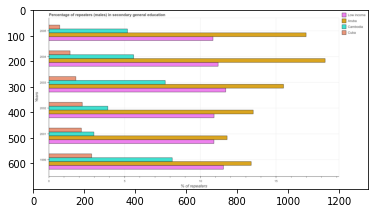

Number of QA =  30





,Years,Cambodia,Low income,Aruba,Cuba
0,2005,5.217733,10.934700,17.073036,0.742310
1,1999,NaN,11.651690,13.506475,2.879884
2,2001,3.009328,10.996772,11.762415,2.151845
3,2004,5.609905,NaN,NaN,1.433564
4,2002,3.901067,10.994156,13.630616,2.239645
5,2003,7.650361,11.917224,15.455695,1.788847


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male repeaters in aruba in 1999 and that in 2003 ?
PREDICTED =  -1.9492200122373564
EXPECTED =  -2.1350708007812003




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male repeaters in aruba in 2005 and the percentage of male repeaters in low income in 2003 ?
PREDICTED =  5.155812331711056
EXPECTED =  5.308260917663601




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the percentage of male repeaters in low income and percentage of male repeaters in cambodia ?
PREDICTED =  0.0
EXPECTED =  3.9945697

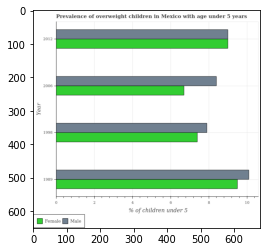

Number of QA =  28





,Year,Female,Male
0,2012,9.029218,9.026330
1,2006,6.721158,8.488858
2,1998,7.457096,7.908464
3,1989,9.549364,10.146169


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of obese male children in 1989 and that in 2006 ?
PREDICTED =  1.657311940395985
EXPECTED =  1.7




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of obese female children in 2006 and the percentage of obese male children in 2012 ?
PREDICTED =  -2.308059784112741
EXPECTED =  -2.3000001907348606




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of obese female children and percentage of obese male children ?
PREDICTED =  0.0
EXPECTED =  0.0




				 3 / 3 = 1.0


is_built_with_cuda: True
i

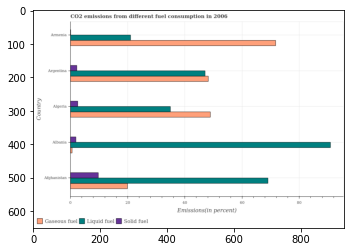

Number of QA =  29





,Country,Gaseous fuel,Liquid fuel,Solid fuel
0,Armenia,71.704609,21.534767,NaN
1,Algeria,47.920478,35.156194,2.837311
2,Afghanistan,20.013719,69.852722,9.939243
3,Argentina,NaN,47.353243,2.487844
4,Albania,0.805438,91.384001,2.181251


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of liquid fuel emission in algeria and that in armenia ?
PREDICTED =  13.621426976664992
EXPECTED =  13.922




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of gaseous fuel emission in argentina and the percentage of solid fuel emission in armenia ?
PREDICTED =  -71.70460931393559
EXPECTED =  48.0905787513919




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of gaseous fuel emission and percentage of liquid fuel emission in algeria ?
PREDICTED =  23.784131471266626
EXPECTED =  13.978




				 1 / 3 = 0.33

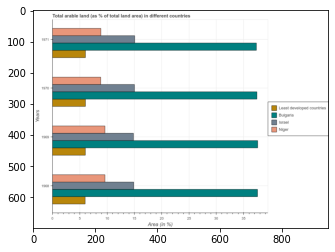

Number of QA =  30





,Years,Least developed countries,Bulgaria,Israel,Niger
0,1969,6.063217,37.724074,14.954085,9.634139
1,1971,6.156831,37.399411,15.185350,8.912711
2,1968,6.101319,37.498516,14.969542,9.645092
3,1970,6.125306,37.364590,15.077700,8.775295


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of arable land in bulgaria in 1969 and that in 1970 ?
PREDICTED =  0.35948328026979937
EXPECTED =  0.1446262315826985




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of arable land in least developed countries in 1969 and the percentage of arable land in niger in 1968 ?
PREDICTED =  -0.03810151823204588
EXPECTED =  -3.5919703900808297




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1970, what is the difference between the percentage of arable land in least developed countries and percentage of arable land in niger ?
PREDICTED =  -2.618

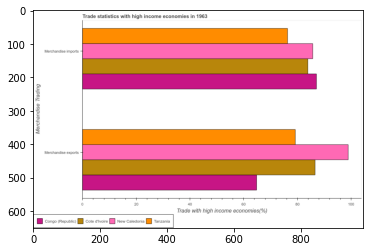

Number of QA =  23





,Merchandise Trading,Congo (Republic),Tanzania,Cote d'ivoire,New Caledonia
0,Merchandise imports,87.986717,76.217836,84.403722,86.442013
1,Merchandise exports,64.711062,79.504404,86.496274,99.526774


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the merchandise exports in tanzania to that in new caledonia ?
PREDICTED =  0.7988242794845524
EXPECTED =  0.80090605773057




				 1 / 4 = 0.25


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Trade with high income economies(%)
EXPECTED =  20.0




				 1 / 5 = 0.2


> what is the title of the graph ?
PREDICTED =  Trade statistics wit

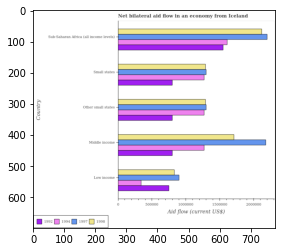

Number of QA =  30





,Country,1997,1992,1994,1998
0,Other small states,2.368715e+06,1.472629e+06,2.319870e+06,2.348483e+06
1,Middle income,NaN,1.465069e+06,2.321159e+06,NaN
2,Small states,2.369173e+06,1.464951e+06,2.317210e+06,2.355978e+06
3,Low income,1.649991e+06,1.368574e+06,6.239227e+05,1.523341e+06
4,Sub-Saharan Africa (all income levels),NaN,2.835147e+06,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1994 in small states and that in sub-saharan africa (all income levels) ?
PREDICTED =  2317210.18468472
EXPECTED =  -340000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1997 in middle income and the net bilateral aid flow in 1992 in low income?
PREDICTED =  -1649990.5854784015
EXPECTED =  1430000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the rati

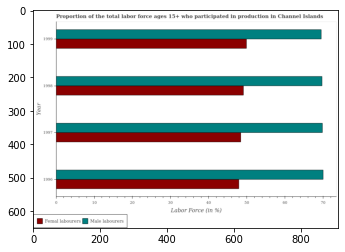

Number of QA =  28





,Year,Femal labourers,Male labourers
0,1999,50.118844,70.424908
1,1996,48.230058,70.275858
2,1998,49.357454,69.851085
3,1997,48.600189,70.521167


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force in 1997 and that in 1999 ?
PREDICTED =  -1.5186543064664662
EXPECTED =  -1.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of male labour force in 1998 and the percentage of female labor force in 1999 ?
PREDICTED =  -0.5738223410840249
EXPECTED =  19.799995422363303




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the percentage of male labour force and percentage of female labor force ?
PREDICTED =  211.22193349767514
EXPECTED =  22.1




				 1 / 3 = 0.3333


is_built_with_c

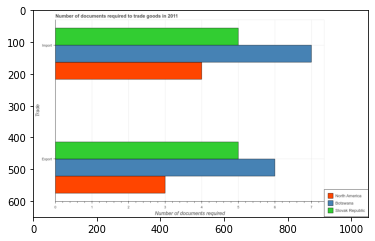

Number of QA =  23





,Trade,North America,Botswana,Slovak Republic
0,Import,4.025727,7.015155,5.007105
1,Export,3.024002,5.980229,5.028880


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of documents required to export goods in north america and that in slovak republic ?
PREDICTED =  -1.0
EXPECTED =  -2




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of documents required to import goods in slovak republic and the number of documents required to export goods in botswana ?
PREDICTED =  -1.0
EXPECTED =  -1




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of documents required to import goods and number of documents required to export goods in botswana ?
PREDICTED =  -1.0
EXPECTED =  1




				 1 / 3 

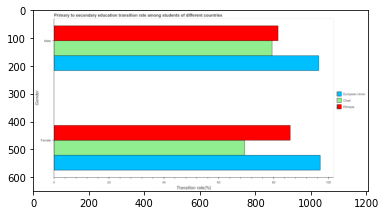

Number of QA =  23





,Gender,Unnamed: 1,Ethiopia,European Union
0,Male,79.338015,82.307741,96.421981
1,Female,69.528270,86.172374,97.165817


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the transition rate among male students in ethiopia and that in chad ?
PREDICTED =  0.0
EXPECTED =  2.174030000000002




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the transition rate among male students in chad and the transition rate among female students in ethiopia ?
PREDICTED =  0.0
EXPECTED =  -6.6144199999999955




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the transition rate among female students and transition rate among male students in chad ?
PREDICTED =  95.1658173961042
EXPECTED =  -10.025260000000003




				 0 / 3 = 0.0


is_b

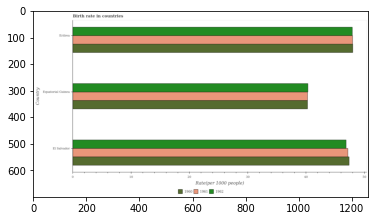

Number of QA =  29





,Country,1962,1961,1960
0,Eritrea,48.448866,48.099139,48.315555
1,Equatorial Guinea,40.467109,40.387234,40.307148
2,El Salvador,47.142924,47.238726,47.526096


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the birth rate in 1961 in equatorial guinea and that in eritrea ?
PREDICTED =  -7.71190508487819
EXPECTED =  -7.725000000000016




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the birth rate in 1962 in equatorial guinea and the birth rate in 1960 in eritrea?
PREDICTED =  -7.98175695169013
EXPECTED =  -7.692999999999991




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the birth rate in 1962 and birth rate in 1961 in el salvador ?
PREDICTED =  -1.8857598134647162
EXPECTED =  -0.30399999999999494




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_

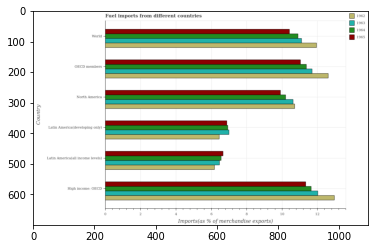

Number of QA =  30





,Country,1963,1964,1962,1965
0,World,11.237594,10.833248,11.979579,10.442838
1,Latin America(all income levels),6.526460,6.622270,6.234917,6.708787
2,Latin America(developing only),7.091176,6.978524,6.512750,6.930773
3,North America,10.671887,10.207835,NaN,9.968575
4,OECD members,11.809012,11.328004,NaN,11.127067
5,High income: OECD,12.094536,11.699298,12.749810,11.413150


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 6 = 0.0


> what is the difference between two consecutive major ticks on the x-axis ?

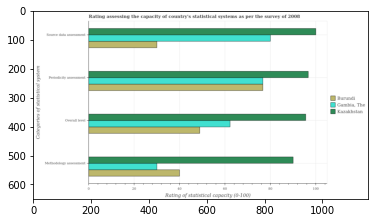

Number of QA =  29





,Categones of statistical system,"Gambia, The",Burundi,Kazakhstan
0,Overall level,62.724511,NaN,96.585238
1,Methodology assessment,30.342886,40.515313,90.220466
2,Source data assessment,80.662107,30.526305,100.011683
3,Periodicity assessment,77.105463,76.788248,98.372691


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the source data assessment rating in burundi and that in gambia, the ?
PREDICTED =  -50.13580223293219
EXPECTED =  -50.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the periodicity assessment rating in gambia, the to that in burundi ?
PREDICTED =  1.0041310454719066
EXPECTED =  1.0




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting .

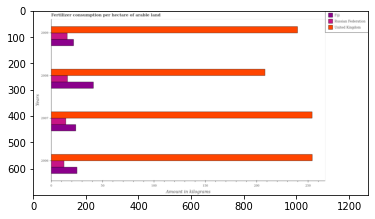

Number of QA =  29





,Years,Fiji,Russian Federation,United Kingdom
0,2006,46.627608,23.547502,457.782121
1,2008,74.762329,29.585106,375.918607
2,2009,40.473224,28.921072,433.520301
3,2007,44.061446,26.305785,459.918182


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum amount of fertilizer consumption in russian federation ?
PREDICTED =  502.0
EXPECTED =  15.8827446177116




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the amount of fertilizer consumption in russian federation maximum?
PREDICTED =  502.0
EXPECTED =  2008




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the amount of fertilizer consumption in russian federation minimum?
PREDICTED =  501.5
EXPECTED =  2006




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what

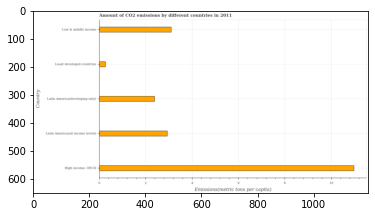

Number of QA =  22





,Country,Emissions(metric tons per capita)
0,Low & middle income,3.141342
1,Least developed countries,0.290270
2,Latin America(all income levels),2.970162
3,Latin America(developing only),2.398775
4,High income: OECD,11.090569


> what is the title of the graph ?
PREDICTED =  Amount of CO2 emissions by different countries in 2011
EXPECTED =  Amount of CO2 emissions by different countries in 2011




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Emissions(metric tons per capita)
EXPECTED =  Emissions(metric tons per capita)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emissions in high income: oecd and latin america(all income levels) ?
PREDICTED =  8.120406573271866
EXPECTED =  8.045




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 4 / 5 = 0.8


is_built_with_cuda: True
is_gpu_available: False
GPUs: []

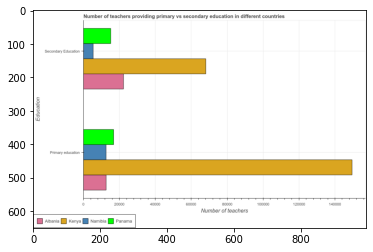

Number of QA =  23





,Education,Panama,Kenya,Albania,Namibia
0,Secondary Education,15551.547931,68513.100066,22501.981753,5842.852154
1,Primary education,17236.796826,151148.400807,13156.795756,13069.319669


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of primary teachers in panama and that in namibia ?
PREDICTED =  4167.477157535233
EXPECTED =  4201




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of secondary teachers in namibia and the number of primary teachers in panama ?
PREDICTED =  -9708.695777164681
EXPECTED =  -11396




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of primary teachers and number of secondary teachers in albania ?
PREDICTED =  -1.0
EXPECTED =  -9673




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Traini

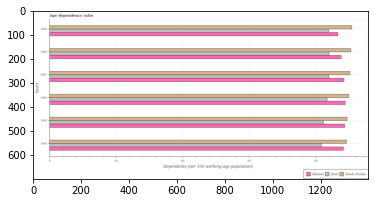

Number of QA =  29





,Years,Albania,Haiti,Saudi Arabia
0,1967,NaN,85.870727,NaN
1,1969,NaN,NaN,89.339390
2,1968,NaN,87.394602,NaN
3,1966,NaN,84.046628,NaN
4,1964,88.743744,83.615878,89.232988
5,1965,90.878733,NaN,89.710320


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the age dependency ratio in in saudi arabia in 1967 ?
PREDICTED =  nan
EXPECTED =  90.2731752614616




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum age dependency ratio in in haiti ?
PREDICTED =  327.3333333333333
EXPECTED =  81.6852938853482




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the age dependency ratio in in haiti maximum?
PREDICTED =  327.8333333333333
EXPECTED =  1968




				 0 / 4 = 0.0


is_built_with_cuda:

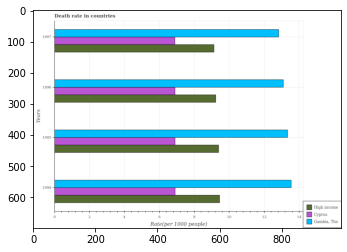

Number of QA =  29





,Years,"Gambia, The",Cyprus,High income
0,1997,12.911722,NaN,9.192064
1,1994,13.607731,6.927700,9.517186
2,1995,13.402233,6.894433,9.445427
3,1996,13.147302,NaN,9.294408


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the death rate in high income in 1995 and that in 1996 ?
PREDICTED =  0.1510191143375561
EXPECTED =  0.16523354569878457




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the death rate in cyprus in 1994 and the death rate in high income in 1995 ?
PREDICTED =  0.03326720884454115
EXPECTED =  -2.488244082410893




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the death rate in gambia, the and death rate in high income ?
PREDICTED =  3.719657427467647
EXPECTED =  3.7020857119855197




				 1 / 3 = 0.3333


is_built_with_cuda: True
i

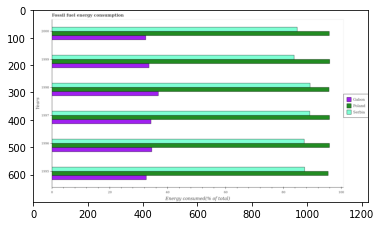

Number of QA =  29





,Years,Serbia,Poland,Gabon
0,1997,89.973700,95.966511,34.428603
1,1999,84.188542,96.619780,33.912570
2,2000,84.895499,96.811781,NaN
3,1996,87.569333,97.029407,34.457959
4,1998,89.833478,96.571800,NaN
5,1995,NaN,96.013738,32.940748


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of energy consumed in poland in 1996 and that in 1998 ?
PREDICTED =  0.4576064395283481
EXPECTED =  0.14771910000379762




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of energy consumed in serbia in 1995 and the percentage of energy consumed in poland in 1998 ?
PREDICTED =  -2.4043668591696274
EXPECTED =  -8.432819518193995




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the

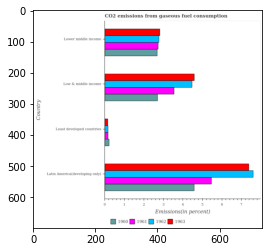

Number of QA =  30





,Country,1963,1962,1961,1960
0,Low & middle income,4.599189,4.521351,3.594180,2.733269
1,Least developed countries,0.202663,0.213525,0.220265,0.271685
2,Lower middle income,2.864878,2.841418,2.787736,2.721213
3,Latin America(developing only),7.430505,7.621053,5.482324,4.617437


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1960 in low & middle income and that in lower middle income ?
PREDICTED =  0.0
EXPECTED =  0.016912746877539853




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1961 in least developed countries and the total co2 emitted in 1960 in low & middle income?
PREDICTED =  -6.161650657817397
EXPECTED =  -2.535537014661283




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1961 and total co2 emitted in 1962 in lower middle income ?
PREDICTED =  1.0
EXPECTED =  -0.04242260996267033






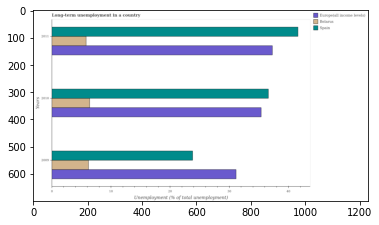

Number of QA =  29





,Years,Belarus,Europe(all income levels),Spain
0,2011,5.961874,37.284866,41.782114
1,2009,6.361695,31.412797,24.063972
2,2010,6.508086,35.848110,36.933272


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of long-term unemployed population in belarus in 2009 and that in 2010 ?
PREDICTED =  -0.14639108455579564
EXPECTED =  -0.2000002861022896




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of long-term unemployed population in spain in 2010 and the percentage of long-term unemployed population in belarus in 2009 ?
PREDICTED =  12.869299662110159
EXPECTED =  30.39999866485596




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the percentage of long-term unemployed population in belarus and percentage of l

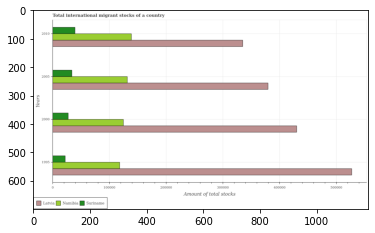

Number of QA =  29





,Years,Latvia,Suriname,Namibia
0,2010,336718.886461,40670.157947,140997.674011
1,2000,431120.287513,28322.767189,126801.862364
2,2005,382538.328149,35177.949033,131730.180427
3,1995,528961.653353,23220.966862,120047.309318


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of total stocks in in latvia in 1995 and that in 2010 ?
PREDICTED =  192242.76689224312
EXPECTED =  192138.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of total stocks in in suriname in 2000 and the amount of total stocks in in latvia in 1995 ?
PREDICTED =  5101.800326607408
EXPECTED =  -499653.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the amount of total stocks in in latvia and amount of total stocks in in suriname ?
PREDICTED =  0.0
EXPECTED =  504889.0




				 1 / 3 = 0.3333


is_built_with

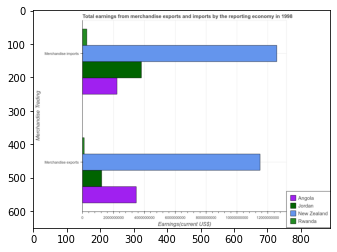

Number of QA =  23





,Merchandise Trading,Rwanda,Angola,New Zealand,Jordan
0,Merchandise imports,3.158427e+08,2.262111e+09,1.260460e+10,3.796619e+09
1,Merchandise exports,1.422082e+08,3.471468e+09,1.139530e+10,1.256389e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise imports in angola and that in rwanda ?
PREDICTED =  1946267979.819973
EXPECTED =  1952803223.3




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the earnings from merchandise exports in rwanda and the earnings from merchandise imports in new zealand ?
PREDICTED =  -11253089937.371822
EXPECTED =  -12463101555.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the earnings from

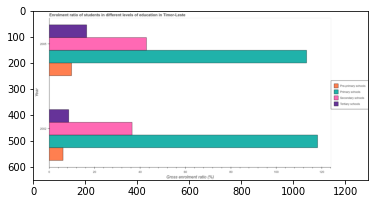

Number of QA =  27





,Year,Secondary schools,Pre-primary schools,Tertiary schools,Primary schools
0,2005,43.638076,10.000326,16.495832,113.484154
1,2002,36.638367,6.225795,8.653458,119.398868


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the gross enrolment ratio in primary schools in 2002 ?
PREDICTED =  3.112897744774484
EXPECTED =  118.191452026367




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum gross enrolment ratio in pre-primary schools ?
PREDICTED =  5.000162857220132
EXPECTED =  9.812379837036133




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum gross enrolment ratio in tertiary schools ?
PREDICTED =  4.326729011692161
EXPECTED =  8.56606960296631




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after trai

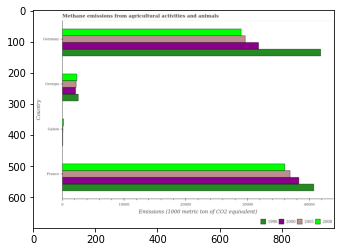

Number of QA =  30





,Country,2005,2000,1990,2008
0,Gabon,NaN,NaN,NaN,293.281873
1,France,37040.393697,38710.433666,40852.151651,36310.313755
2,Georgia,2336.939802,2237.763050,2684.101649,2419.173961
3,Germany,29853.714446,31787.695830,42469.180229,29238.923464


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emitted in 2008 in gabon and that in georgia ?
PREDICTED =  -2125.8920877886194
EXPECTED =  -2147.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emitted in 2005 in france and the amount of methane emitted in 2000 in gabon?
PREDICTED =  37040.393697253836
EXPECTED =  36810.700000000004




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emitted in 2000 and amount of methane emitted in 2005 in germany ?
PREDICTED =  42882.17810087772
EXPECTED =  2155.399999999998




				 2 / 3 = 0.66

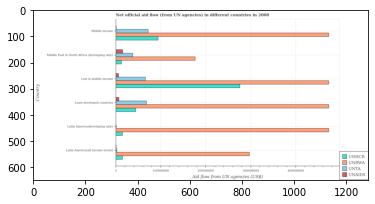

Number of QA =  30





,Country,UNTA,UNRWA,UNAIDS,UNHCR
0,Least developed countries,6.911290e+07,NaN,7.623288e+06,4.445089e+07
1,Low & middle income,6.609894e+07,4.686872e+08,7.031295e+06,2.766727e+08
2,Latin America(all income levels),NaN,2.985454e+08,NaN,1.593748e+07
3,Middle income,7.306322e+07,4.753526e+08,NaN,9.540138e+07
4,Latin America(developing only),NaN,NaN,NaN,1.584477e+07
5,Middle East & North Africa (developing only),3.887487e+07,1.836151e+08,1.654117e+07,1.377858e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by unaids in least developed countries and that in middle east & north africa (developing only) ?
PREDICTED =  -8917881.413910657
EXPECTED =  -8400000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by unrwa in latin america(all income levels) and the amount of aid given by unaids in middle east & north africa (developing only) ?
PREDICTED =  114930386.08760652
EXPECTED =  281530000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by unrwa and amount of aid given by unhcr in l

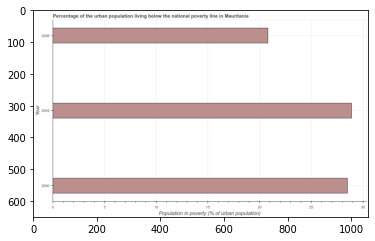

Number of QA =  23





,Year,Population in poverty (% of urban population)
0,2008,20.929813
1,2004,28.821461
2,2000,28.476310


> what is the title of the graph ?
PREDICTED =  Percentage of the urban population living below the national poverty line in Mauritania
EXPECTED =  Percentage of the urban population living below the national poverty line in Mauritania




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Population in poverty (% of urban population)
EXPECTED =  Population in poverty (% of urban population)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of urban population living below poverty line in 2000 and 2004 ?
PREDICTED =  7.546496729341413
EXPECTED =  -0.4




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> 

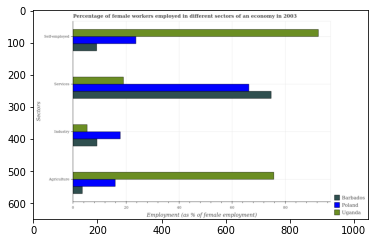

Number of QA =  29





,Sectors,Poland,Barbados,Uganda
0,Services,66.479938,74.562773,19.211747
1,Industry,18.202244,9.229065,5.553193
2,Agriculture,16.205530,3.724291,75.717848
3,Self-employed,24.005550,9.186159,92.108310


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female workers in industry in barbados and that in poland ?
PREDICTED =  -8.97317897607539
EXPECTED =  -8.7999992370605




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self employed female workers in barbados and the percentage of female workers in agriculture in uganda ?
PREDICTED =  -82.92215051971313
EXPECTED =  -66.79999732971193




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what i

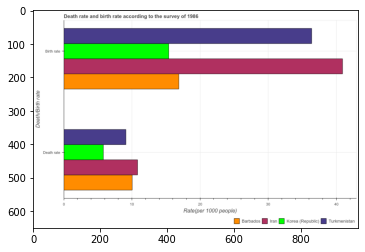

Number of QA =  23





,Death/Birth rate,Korea (Republic),Turkmenistan,Barbados,Iran
0,Birth rate,15.637636,36.635467,17.081196,41.222194
1,Death rate,5.876409,9.158851,10.148337,10.951902


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the death rate in korea (republic) and that in barbados ?
PREDICTED =  5.876409261520077
EXPECTED =  -4.239




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the birth rate in turkmenistan to that in korea (republic) ?
PREDICTED =  2.3427752143461347
EXPECTED =  2.3625974025974026




				 1 / 4 = 0.25


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  R

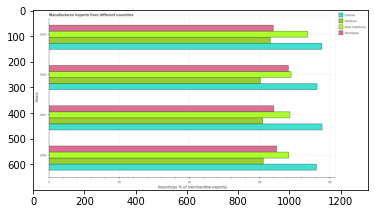

Number of QA =  30





,Years,Estonia,New Caledonia,Maldives,Nicaragua
0,2002,76.586885,69.257279,60.215650,68.208225
1,2003,78.431997,74.303741,63.296287,63.883481
2,2001,78.102112,68.080308,61.142609,64.048592
3,2000,76.195898,68.944030,61.165085,65.173349


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in estonia in 2002 and that in 2003 ?
PREDICTED =  -1.8451125064756155
EXPECTED =  -1.3824457227339053




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in nicaragua in 2003 and the percentage of imports to different countries in maldives in 2002 ?
PREDICTED =  -4.324743595453896
EXPECTED =  3.6633730397783353




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the percentage of imports to different countries in estonia and percentage of 

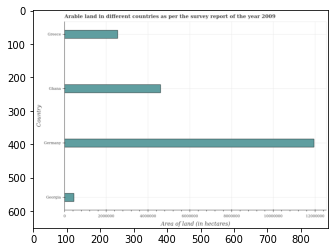

Number of QA =  22





,Country,Area of land (in hectares)
0,Ghana,4.689890e+06
1,Georgia,4.850527e+05
2,Germany,1.207082e+07
3,Greece,2.600133e+06


> what is the title of the graph ?
PREDICTED =  Arable land in different countries as per the survey report of the year 2009
EXPECTED =  Arable land in different countries as per the survey report of the year 2009




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Area of land (in hectares)
EXPECTED =  Area of land (in hectares)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the area of land in ghana and greece ?
PREDICTED =  2089756.9937824896
EXPECTED =  2053000.0




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median area of land ?
PREDICTED =  3645011.282050397
EXPECTED =  3573500.0





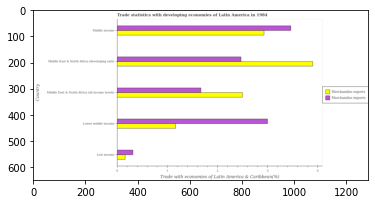

Number of QA =  28





,Country,Merchandise imports,Merchandise exports
0,Lower middle income,NaN,1.170886
1,Low income,0.322321,0.166584
2,Middle income,3.479874,NaN
3,Middle East & North Africa (developing only),2.485062,3.902855
4,Middle East & North Africa (all income levels),1.683722,2.483346


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in low income and that in middle income ?
PREDICTED =  -1.00430229406088
EXPECTED =  -2.77




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in middle east & north africa (all income levels) and the merchandise exports in middle east & north africa (developing only) ?
PREDICTED =  0.0
EXPECTED =  -2.229998358390839




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio 

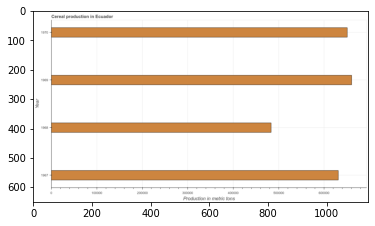

Number of QA =  23





,Year,Production in metric tons
0,1969,658600.000586
1,1967,633132.109976
2,1968,482412.989214
3,1970,650904.067964


> what is the title of the graph ?
PREDICTED =  Cereal production in Ecuador
EXPECTED =  Cereal production in Ecuador




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Production in metric tons
EXPECTED =  Production in metric tons




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cereal production in 1968 and 1970 ?
PREDICTED =  -168491.0787499823
EXPECTED =  -167488.0




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median cereal production ?
PREDICTED =  1968.5
EXPECTED =  640923.5




				 4 / 5 = 0.8


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Eval

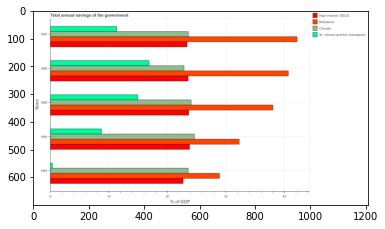

Number of QA =  30





,Years,Botswana,High income: OECD,St. Vincent and the Grenadines,Canada
0,1983,29.206145,22.860145,0.437475,23.665902
1,1986,40.776490,23.682108,17.042269,23.003561
2,1987,42.344054,23.463506,11.303336,23.716674
3,1985,38.202494,23.899833,14.917813,24.231081
4,1984,32.080083,23.839376,8.776232,24.821996


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual savings of the government in high income: oecd in 1984 and that in 1986 ?
PREDICTED =  0.1572678839800865
EXPECTED =  0.23537459788370896




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total annual savings of the government in high income: oecd in 1987 and the total annual savings of the government in st. vincent and the grenadines in 1985 ?
PREDICTED =  -0.4363263473001098
EXPECTED =  8.435168978710902




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1987, what is the difference between the total annual savings of the government in canada and 

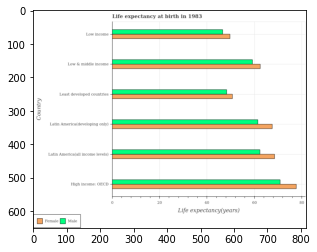

Number of QA =  28





,Country,Female,Male
0,Low income,49.917860,47.220868
1,Low & middle income,62.552667,NaN
2,Least developed countries,51.234079,49.000255
3,Latin America(developing only),68.491949,62.293291
4,High income: OECD,78.514913,71.369500
5,Latin America(all income levels),69.576638,63.416708


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the life expectancy(female) in latin america(all income levels) and that in least developed countries ?
PREDICTED =  1.0846885458549878
EXPECTED =  17.792




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the life expectancy(male) in high income: oecd and the life expectancy(female) in latin america(all income levels) ?
PREDICTED =  7.952792322316036
EXPECTED =  2.3562955550603846




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the life expectancy(female) and life expectancy(male) in low & middle income ?
PREDICTED =  nan
EXPECTED =  3.297




				

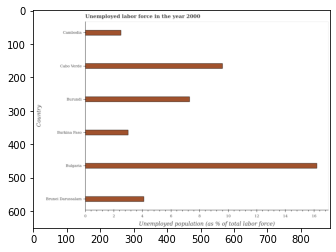

Number of QA =  22





,Country,Unemployed population (as % of total labor force)
0,Bulgaria,16.326908
1,Cambodia,2.547363
2,Brunei Darussalam,4.195581
3,Cabo Verde,9.678486
4,Burkina Faso,3.058552
5,Burundi,7.329552


> what is the title of the graph ?
PREDICTED =  Unemployed labor force in the year 2000
EXPECTED =  Unemployed labor force in the year 2000




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Unemployed population (as % of total labor force)
EXPECTED =  Unemployed population (as % of total labor force)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total unemployed population in burundi and cambodia ?
PREDICTED =  4.782188807022887
EXPECTED =  4.8




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total unemployed population ?
PREDICTED =  5.762566420350809
EXPECTED =  5.700000047683

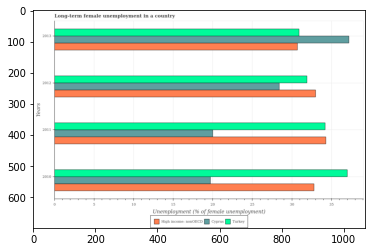

Number of QA =  29





,Years,Turkey,Cyprus,High income: nonOECD
0,2013,31.109870,37.727122,30.703819
1,2012,32.154602,28.436251,33.272390
2,2011,34.234605,NaN,34.086196
3,2010,37.213629,19.981661,32.970115


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of long-term unemployed female population in turkey in 2010 and that in 2013 ?
PREDICTED =  2.266295389574296
EXPECTED =  6.100000381469691




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of long-term unemployed female population in high income: nonoecd in 2011 and the percentage of long-term unemployed female population in cyprus in 2013 ?
PREDICTED =  3.382377015486803
EXPECTED =  -2.9094572726861045




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the percentage of long-term unemployed female popu

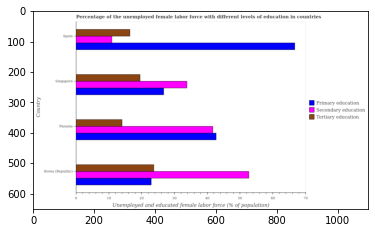

Number of QA =  29





,Country,Secondary education,Tertiary education,Primary education
0,Panama,41.786152,14.231862,42.754042
1,Spain,11.215683,16.754474,66.966533
2,Korea (Republic),53.134037,24.167997,23.018539
3,Singapore,34.248063,19.792595,26.931557


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received tertiary education in singapore and that in spain ?
PREDICTED =  3.038120892645985
EXPECTED =  3.1




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received secondary education in korea (republic) and the percentage of female labor force who received primary education in spain ?
PREDICTED =  41.91835389801325
EXPECTED =  -13.999996185302699




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received secondary education a

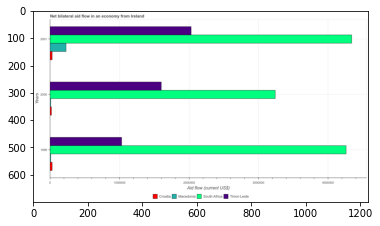

Number of QA =  30





,Years,Timor-Leste,South Africa,Croatia,Macedonia
0,2000,1.626110e+06,3.247565e+06,26747.783003,18044.422209
1,2001,2.037156e+06,4.367779e+06,37750.455759,237220.607089
2,1999,1.036351e+06,4.300160e+06,37800.173523,18774.004965


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in macedonia in 2000 and that in 2001 ?
PREDICTED =  -219176.1848800218
EXPECTED =  -220000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in south africa in 2001 and the net bilateral aid flow in timor-leste in 1999 ?
PREDICTED =  67619.04553216044
EXPECTED =  3310000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1999, what is the difference between the net bilateral aid flow in timor-leste and net bilateral aid flow in macedonia ?
PREDICTED =  1763116.6779816707
EXPECTED =  1020000.0




				 1 / 3 = 0.

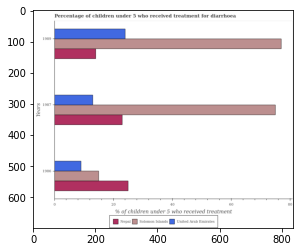

Number of QA =  29





,Years,United Arab Emirates,Nepal,Solomon Islands
0,1989,24.429634,14.164697,78.093620
1,1986,9.128712,25.456526,15.089497
2,1987,13.248214,23.273674,75.614761


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who received treatment for diarrhoea  in solomon islands in 1987 and that in 1989 ?
PREDICTED =  -2.478859012021303
EXPECTED =  -2.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who received treatment for diarrhoea  in solomon islands in 1989 and the percentage of children who received treatment for diarrhoea  in nepal in 1986 ?
PREDICTED =  63.0041234495329
EXPECTED =  52.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1987, what is the difference between the percentage of children who received treatment f

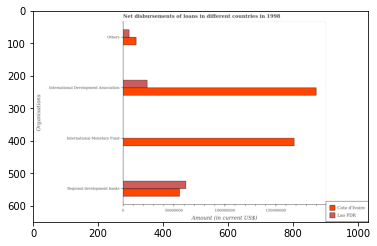

Number of QA =  26





,Organisations,Cote d'Ivoire,Lao PDR
0,Others,2.418261e+07,1.176978e+07
1,International Monetary Fund,3.051683e+08,NaN
2,International Development Association,3.423989e+08,4.400780e+07
3,Regional development banks,9.950149e+07,1.136342e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loan disimbursed by international development association in cote d'ivoire and that in lao pdr ?
PREDICTED =  0.0
EXPECTED =  166069000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loan disimbursed by regional development banks in cote d'ivoire and the amount of loan disimbursed by other organisations in lao pdr ?
PREDICTED =  -25902436.397757545
EXPECTED =  49504000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after trai

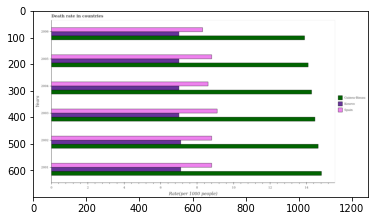

Number of QA =  29





,Years,Guinea-Bissau,Spain,Kosovo
0,2004,14.576886,8.734029,7.080685
1,2002,14.640415,8.961401,7.112316
2,2006,13.853522,8.376661,7.002032
3,2005,13.840622,8.861523,7.031030
4,2003,14.631573,9.221503,7.026238
5,2001,14.684589,8.900034,7.133680


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the death rate in kosovo in 2004 and that in 2006 ?
PREDICTED =  0.07865338469038896
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the death rate in guinea-bissau in 2006 and the death rate in kosovo in 2005 ?
PREDICTED =  0.01289976594258313
EXPECTED =  6.895




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the death rate in guinea-bissau and death rate in spain ?
PREDICTED =  6.307927401236952
EXPECTED =  6.023




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or pred

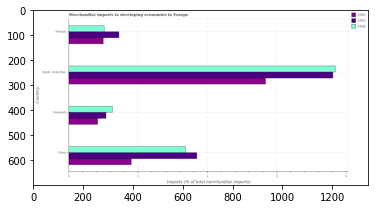

Number of QA =  29





,Country,1992,1993,1994
0,Denmark,0.422642,0.545915,0.636000
1,Finland,0.509129,0.727906,0.516650
2,China,0.913210,1.863658,NaN
3,"Egypt, Arab Rep.",2.844931,3.833973,3.832059


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage total merchandise imports in 1992 in china and that in finland ?
PREDICTED =  0.4040811969027198
EXPECTED =  0.404037278702972




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage total merchandise imports in 1994 in china and the percentage total merchandise imports in 1993 in egypt, arab rep.?
PREDICTED =  -0.8320589089093433
EXPECTED =  -2.1247948508523002




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage total merchandise imports in 1992 and percentage total merchandise imports in 1994 in denmark ?
PREDIC

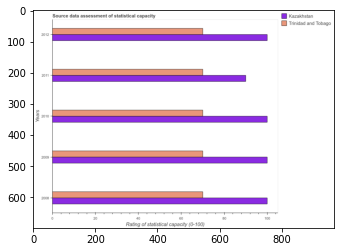

Number of QA =  28





,Years,Trinidad and Tobago,Kazakhstan
0,2009,NaN,99.826202
1,2012,70.462127,100.716433
2,2008,70.454015,100.427191
3,2011,70.559578,91.025570
4,2010,70.180783,100.239998


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in trinidad and tobago in 2009 and that in 2012 ?
PREDICTED =  -66.46212746423681
EXPECTED =  0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in trinidad and tobago in 2008 and the rating of statistical capacity in kazakhstan in 2012 ?
PREDICTED =  -96.57181207433328
EXPECTED =  -30




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the rating of statistical capacity in kazakhstan and rating of statistical capacity in trinidad and tobago ?
PREDICTED =  488.2353

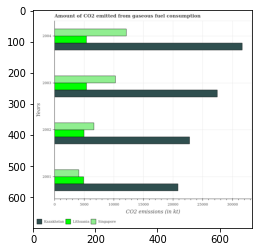

Number of QA =  29





,Years,Singapore,Lithuania,Kazakhstan
0,2004,21872.422673,9906.342716,57243.326092
1,2002,12145.356586,9100.253364,41229.777218
2,2001,7655.713389,8995.488387,38073.412875
3,2003,18579.489467,9924.910366,49969.389639


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in singapore in 2002 and that in 2003 ?
PREDICTED =  -6434.132881714904
EXPECTED =  -3630.33




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in singapore in 2001 and the amount of co2 emitted in kazakhstan in 2003 ?
PREDICTED =  -10923.77607840865
EXPECTED =  -23351.456000000002




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the amount of co2 emitted in kazakhstan and amount of co2 emitted in singapore ?
PREDICTED =  35370.90341930688
EXPECTED =  16127.465999999999




				 0 

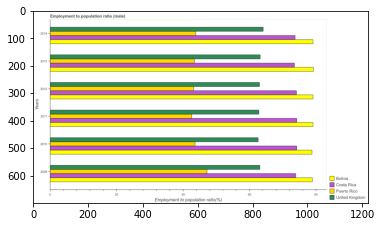

Number of QA =  30





,Years,United Kingdom,Bolivia,Puerto Rico,Costa Rica
0,2011,63.185310,NaN,42.754508,75.393065
1,2012,62.094946,NaN,43.730441,NaN
2,2014,63.261862,80.48372,43.990439,74.248131
3,2013,61.492343,NaN,NaN,NaN
4,2009,61.704837,NaN,47.635734,76.845599
5,2010,61.748374,NaN,NaN,74.599144


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the employment to population ratio in costa rica in 2009 ?
PREDICTED =  0.8232333763121183
EXPECTED =  73.9000015258789




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum employment to population ratio in united kingdom ?
PREDICTED =  31.835926896375092
EXPECTED =  64.099998474121




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum employment to population ratio in united kingdom ?
PREDICTED =  32.73578281692985
EXPECTED =  62.5999984741211




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation fini

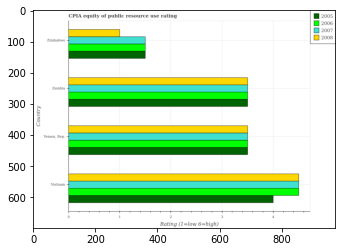

Number of QA =  30





,Country,2007,2005,2008,2006
0,Vietnam,4.541917,4.036674,4.509997,4.533248
1,Zimbabwe,1.527933,1.515765,1.002812,1.523458
2,Zambia,3.524369,3.506009,3.498237,3.519584
3,"Yemen, Rep.",NaN,3.532623,3.545709,3.524021


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2007 in zambia and that in zimbabwe ?
PREDICTED =  1.996436443944647
EXPECTED =  2.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2007 in yemen, rep. and the cpia rating in 2005 in zambia?
PREDICTED =  0.01836025922510931
EXPECTED =  0.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predictin

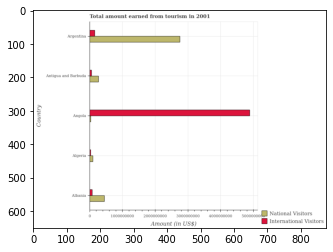

Number of QA =  28





,Country,National Visitors,International Visitors
0,Albania,4.693052e+08,9.768466e+07
1,Antigua and Barbuda,2.901161e+08,7.160260e+07
2,Angola,NaN,4.949777e+09
3,Argentina,2.798335e+09,1.767141e+08
4,Algeria,1.157889e+08,4.875703e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from national visitors in angola and that in antigua and barbuda ?
PREDICTED =  -290116101.65396315
EXPECTED =  -237000000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from national visitors in angola and the amount earned from international visitors in algeria ?
PREDICTED =  -115788852.16323178
EXPECTED =  3000000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount earned from international visitors and amount earned from national visitors in algeria ?
PREDICTED =  4901020224.197222
EXPECTED =  -

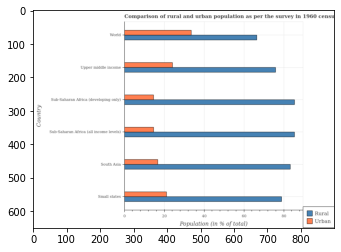

Number of QA =  28





,Country,Urban,Rural
0,Small states,21.556676,79.090714
1,Upper middle income,24.545701,76.464723
2,World,33.975175,NaN
3,South Asia,17.107496,84.605412
4,Sub-Saharan Africa (developing only),14.972445,85.857671
5,Sub-Saharan Africa (all income levels),14.832381,85.677789


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population in south asia and that in sub-saharan africa (developing only) ?
PREDICTED =  -1.252258642041724
EXPECTED =  -2.119




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the urban population in world and the rural population in south asia ?
PREDICTED =  16.867679541070938
EXPECTED =  -49.706846393187114




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population and urban population in sub-saharan africa (developing only) ?
PREDICTED =  396.7238643859573
EXPECTED =  70.766




				 0 / 3 = 0.0


is_built_with_cuda: True
is

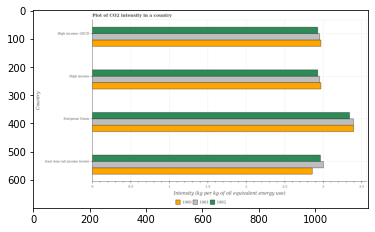

Number of QA =  29





,Country,1962,1961,1960
0,High income,2.943467,2.958517,2.986985
1,European Union,3.346314,3.403555,3.436362
2,East Asia (all income levels),2.982308,3.037769,2.883846
3,High income: OECD,2.947142,2.963169,2.993609


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 intensity in in 1962 in east asia (all income levels) and that in european union ?
PREDICTED =  0.0
EXPECTED =  -0.37841029027789963




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 intensity in in 1961 in high income: oecd and the co2 intensity in in 1960 in european union?
PREDICTED =  -0.22251895201621652
EXPECTED =  -0.44214871539623113




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 intensity in in 1961 and co2 intensity in in 1962 in east asia (all income levels) ?
PREDICTED =  -0.02379119133783103
EXPECTED =  0.03909

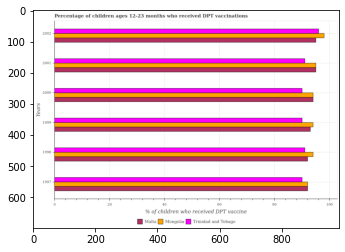

Number of QA =  29





,Years,Malta,Mongolia,Trinidad and Tobago
0,1998,92.277016,NaN,91.553126
1,2001,94.614968,95.091968,91.417113
2,2002,95.085208,99.466477,NaN
3,2000,93.983470,93.692434,NaN
4,1999,93.294348,93.934564,NaN
5,1997,91.912671,92.315538,89.616726


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children who received dpt vaccination in mongolia in 2000 and the percentage of children who received dpt vaccination in trinidad and tobago in 2001 ?
PREDICTED =  -95.09196807853212
EXPECTED =  3




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the percentage of children who received dpt vaccination in trinidad and tobago and percentage of children who received dpt vaccination in mongolia ?
PREDICTED =  -9.849751758480025
EXPECTED =  -2




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_availab

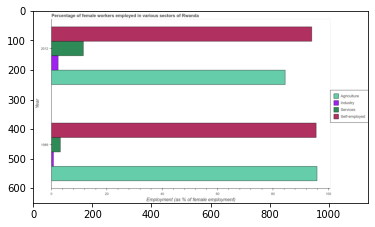

Number of QA =  27





,Year,Industry,Self-employed,Agriculture,Services
0,1989,0.837778,95.928545,96.469347,3.358356
1,2012,2.556684,94.367606,84.703019,11.615142


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female workers in agriculture in 1989 and that in 2012 ?
PREDICTED =  11.766327704762958
EXPECTED =  11.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female workers in agriculture in 2012 and the percentage of self employed female workers in 1989 ?
PREDICTED =  -11.766327704762958
EXPECTED =  -11.199996948242088




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of female workers in agriculture and percentage of self employed female workers ?
PREDICTED =  -94.36760600070619
EXP

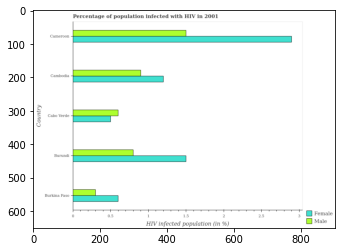

Number of QA =  28





,Country,Female,Male
0,Burkina Faso,0.619503,0.307193
1,Cameroon,2.921433,1.508814
2,Cambodia,1.214385,0.913492
3,Cabo Verde,0.512244,0.608012
4,Burundi,1.525808,0.811594


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females who are infected with hiv in burkina faso and that in burundi ?
PREDICTED =  -1.525807811622462
EXPECTED =  -0.9




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of males who are infected with hiv in burkina faso and the percentage of females who are infected with hiv in cabo verde ?
PREDICTED =  -0.3008188774179981
EXPECTED =  -0.2




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of males who are infected with hiv and percentage of females who are infected with hiv in burundi ?
PREDICTED =  -

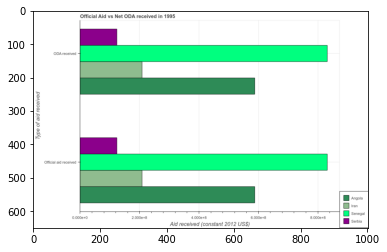

Number of QA =  23





,Type of aid received,Angola,Senegal,Serbia,Iran
0,ODA received,5.862422,8.398354,1.258140,2.086933
1,Official aid received,5.893713,8.330439,1.248066,2.092132


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the official aid received in angola and that in senegal ?
PREDICTED =  -2.4367263496628935
EXPECTED =  -243970000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received in serbia and the official aid received in senegal ?
PREDICTED =  -7.140214710108042
EXPECTED =  -707810000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the oda received in senegal to that in angola ?
PREDICTED =  1.4325742199

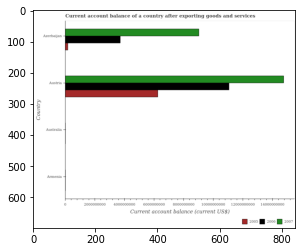

Number of QA =  24





,Country,2007,2005,2006
0,Armenia,NaN,NaN,NaN
1,Australia,NaN,NaN,NaN
2,Austria,1.488691e+10,6.318380e+09,1.110256e+10
3,Azerbaijan,9.062093e+09,2.168304e+08,3.792123e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the account balance in 2006 in austria and that in azerbaijan ?
PREDICTED =  7310434523.987684
EXPECTED =  7347632084.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the account balance in 2007 in azerbaijan and the account balance in 2006 in australia?
PREDICTED =  9062093334.06757
EXPECTED =  9018885000.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the account balance in 2005 in austria to that

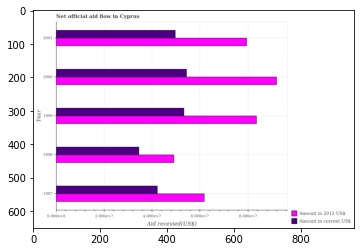

Number of QA =  28





,Year,Amount in current US$,Amount in 2012 US$
0,2001,5.016957,7.986740
1,2000,5.482724,9.236939
2,1999,5.353603,8.429654
3,1997,4.257921,6.228896
4,1998,3.501649,4.926684


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid received(expressed in us$) in 1997 and that in 2001 ?
PREDICTED =  -1.7578444163864804
EXPECTED =  -7480000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid received(expressed in us$) in 2000 and the amount of aid received(expressed in 2012 us$) in 1999 ?
PREDICTED =  -7.4296535328171345
EXPECTED =  -29190000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the amount of aid received(expressed in us$) and amount of aid received(expressed in 2012 us$) ?
PREDICTED =  -31.80891246673186
EXPECTED = 

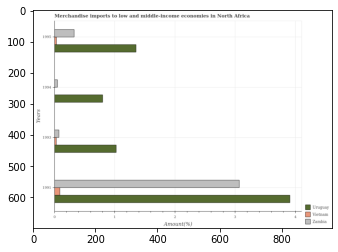

Number of QA =  29





,Years,Uruguay,Zambia,Vietnam
0,1994,0.812323,0.060174,NaN
1,1993,1.044684,0.084320,0.039248
2,1995,1.366092,0.337848,0.042026
3,1991,3.947969,3.087973,0.101770


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in vietnam in 1994 and that in 1995 ?
PREDICTED =  -0.042026174877574166
EXPECTED =  -0.030766883855362578




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in vietnam in 1994 and the percentage of amount earned from merchandise imports in uruguay in 1995 ?
PREDICTED =  -1.3660922725644689
EXPECTED =  -1.35217816940565




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the percentage of amount earned from merchandise impo

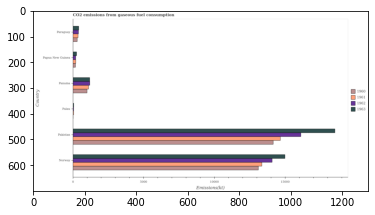

Number of QA =  30





,Country,1963,1962,1961,1960
0,Palau,NaN,NaN,NaN,NaN
1,Paraguay,788.423982,756.740579,704.408185,598.624771
2,Pakistan,33613.057664,28351.475214,NaN,25903.873429
3,Norway,27095.805483,25420.655172,NaN,23904.240124
4,Papua New Guinea,523.889267,423.158217,422.976790,380.274010
5,Panama,2195.937293,2195.022144,2042.851296,1866.095715


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in 1963 in pakistan and that in paraguay ?
PREDICTED =  32824.63368142855
EXPECTED =  18103.979




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in 1962 in panama and the amount of co2 emitted in 1961 in pakistan?
PREDICTED =  -26156.453070627525
EXPECTED =  -13465.224




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in 1960 and amount of co2 emitted in 1963 in pakistan ?
PREDICTED =  -4864.189738903518
EXPECTED =  -4360.063




				 0 / 3 = 0.0


is_built_with_cuda: True

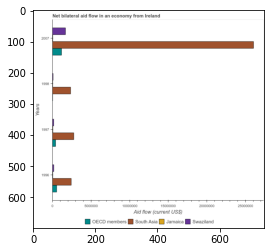

Number of QA =  30





,Years,OECD members,South Asia,Jamaica,Swaziland
0,1997,8.334904e+05,5.089018e+06,NaN,4.171794e+05
1,1996,1.131994e+06,4.466309e+06,NaN,4.228003e+05
2,1998,NaN,4.291784e+06,NaN,NaN
3,2007,2.238631e+06,4.684086e+07,NaN,3.166849e+06


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in south asia in 1997 and that in 2007 ?
PREDICTED =  -41751843.65969917
EXPECTED =  -23290000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in swaziland in 1996 and the net bilateral aid flow in south asia in 1998 ?
PREDICTED =  422800.3456802362
EXPECTED =  -2180000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_ava

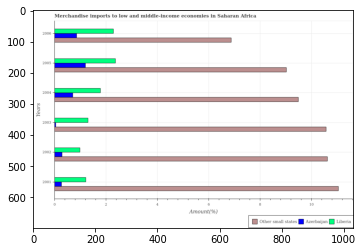

Number of QA =  29





,Years,Azerbaijan,Liberia,Other small states
0,2003,0.066276,1.316453,10.590916
1,2004,0.719683,1.792337,9.499314
2,2001,0.286876,1.251739,11.105556
3,2002,0.312408,1.004867,10.642451
4,2006,0.884768,2.310634,6.892290
5,2005,1.217006,2.423439,9.038953


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in other small states in 2004 and that in 2005 ?
PREDICTED =  0.46036094451248566
EXPECTED =  0.46440800962422024




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of amount earned from merchandise imports in liberia in 2004 and the percentage of amount earned from merchandise imports in other small states in 2001 ?
PREDICTED =  -9.313219215841526
EXPECTED =  -9.26131095326958




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2003, what is the difference between the percentage of amount earned from

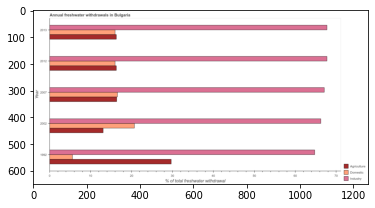

Number of QA =  29





,Year,Industry,Agriculture,Domestic
0,2013,68.317436,16.577384,16.220121
1,2012,68.114578,16.463722,NaN
2,2007,67.271407,16.478661,16.773140
3,2002,67.287292,13.263856,NaN
4,1992,64.927523,30.048095,5.736182


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of freshwater withdrawal for agriculture in 2007 and that in 2013 ?
PREDICTED =  -0.09872295718990642
EXPECTED =  0.09




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of freshwater withdrawal for agriculture in 2002 and the percentage of freshwater withdrawal for industry in 2012 ?
PREDICTED =  -3.1998662387000554
EXPECTED =  -54.67999999999999




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of freshwater withdrawal for domestic purposes and percentage of freshwater withdrawal for agr

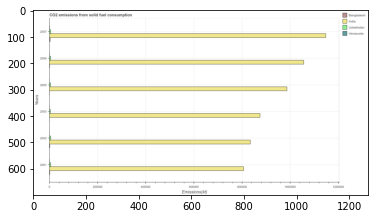

Number of QA =  30





,Years,Uzbekistan,India,Venezuela,Bangladesh
0,2007,5736.993363,1.145214e+06,NaN,4808.416188
1,2001,6603.183504,8.066047e+05,NaN,NaN
2,2002,6198.614056,8.356269e+05,NaN,NaN
3,2006,6200.039712,1.056349e+06,NaN,NaN
4,2005,4986.239659,9.867981e+05,NaN,NaN
5,2003,4755.566876,8.725707e+05,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in uzbekistan in 2006 and that in 2007 ?
PREDICTED =  463.04634912412985
EXPECTED =  -282.35899999999947




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in uzbekistan in 2007 and the amount of co2 emitted in venezuela in 2003 ?
PREDICTED =  981.4264868535302
EXPECTED =  4880.777




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the amount of co2 emitted in venezuela and amount of co2 emitted in bangladesh ?
PREDICTED =  -4807.416188376325
EXPECTED =  -1265.115




				 0 / 3 = 0.

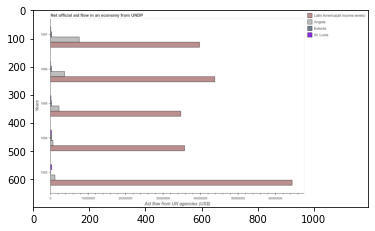

Number of QA =  30





,Years,Estonia,Angola,St. Lucia,Latin America(all income levels)
0,1997,385524.216572,7.795640e+06,NaN,3.945632e+07
1,1996,397385.540324,3.839269e+06,NaN,4.363173e+07
2,1995,NaN,2.383107e+06,NaN,3.451142e+07
3,1994,463092.157999,7.910598e+05,NaN,3.542205e+07
4,1993,NaN,1.310052e+06,425287.69793,6.420173e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in estonia in 1994 and that in 1995 ?
PREDICTED =  463092.15799920744
EXPECTED =  30000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net official aid flow in st. lucia in 1993 and the net official aid flow in estonia in 1994 ?
PREDICTED =  nan
EXPECTED =  10000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the net official aid flow in st. lucia and net official aid flow in angola ?
PREDICTED =  0.0
EXPECTED =  -3690000.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: Fals

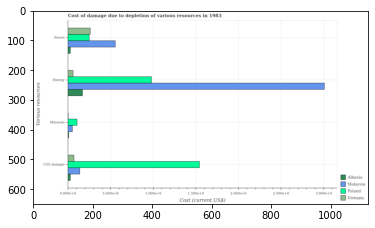

Number of QA =  29





,Various resources,Malaysia,Albania,Poland,Vietnam
0,Minerals,1.081728,0.316631,2.087919,NaN
1,Forest,10.124728,0.664744,4.680650,4.944319
2,CO2 damage,2.688317,0.670724,28.114084,1.423476
3,Energy,54.532319,3.216291,17.952151,1.256697


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of minerals in poland and that in malaysia ?
PREDICTED =  1.006190640762688
EXPECTED =  54913757.236428894




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of minerals in poland and the cost of damage due to depletion of coal in vietnam ?
PREDICTED =  2.087918956448608
EXPECTED =  36145295.557396784




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of energy and cost of damage due to depletion of forests in malaysia ?
PREDICTED =  -8.868031049

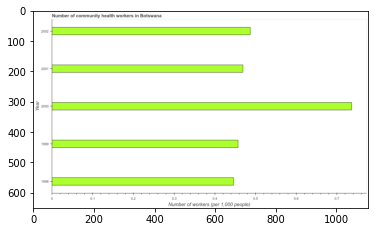

Number of QA =  23





,Year,"Number of workers (per 1,000 people)"
0,2001,0.469344
1,2000,0.736684
2,2002,0.486881
3,1999,0.459447
4,1998,0.447243


> what is the title of the graph ?
PREDICTED =  Number of community health workers in Botswana
EXPECTED =  Number of community health workers in Botswana




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Number of workers (per 1,000 people)
EXPECTED =  Number of workers (per 1,000 people)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of community health workers in 2000 and 2001 ?
PREDICTED =  0.26733990612351577
EXPECTED =  0.267




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median number of community health workers ?
PREDICTED =  2000.0
EXPECTED =  0.469




				 4 / 5 = 0.8


is_

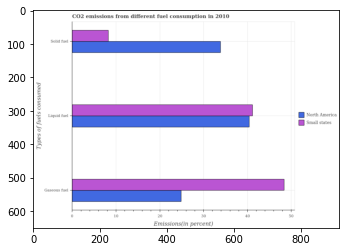

Number of QA =  28





,Types of fuels consumed,North America,Small states
0,Solid fuel,33.856815,8.468172
1,Liquid fuel,40.639023,41.133333
2,Gaseous fuel,25.053255,48.242318


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of solid fuel emission in north america and that in small states ?
PREDICTED =  0.0
EXPECTED =  25.610398520826045




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of gaseous fuel emission in small states and the percentage of liquid fuel emission in north america ?
PREDICTED =  0.0
EXPECTED =  7.965721719038797




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of liquid fuel emission and percentage of gaseous fuel emission in north america ?
PREDICTED =  15.585767745552772
EXPECTED =  15.538200643181902


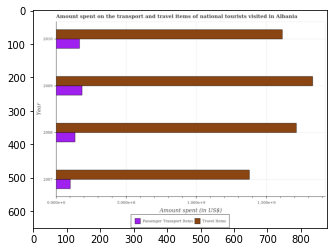

Number of QA =  28





,Year,Travel Items,Passenger Transport Items
0,2007,24.707209,1.895900
1,2010,29.242253,3.057281
2,2008,30.974743,2.500708
3,2009,32.995715,3.394952


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent in travel items in 2007 and that in 2010 ?
PREDICTED =  -4.535044818605602
EXPECTED =  -235000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on passenger transport items in 2009 and the amount spent in travel items in 2010 ?
PREDICTED =  0.33767151454294986
EXPECTED =  -1428000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the amount spent in travel items and amount spent on passenger transport items ?
PREDICTED =  0.0
EXPECTED =  1277000000




				 0 / 3 = 0.0


is_built_with_cuda: T

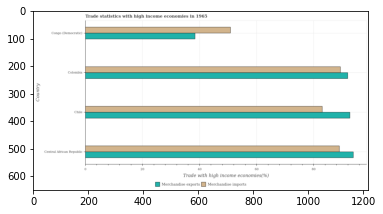

Number of QA =  28





,Country,Merchandise imports,Merchandise exports
0,Colombia,89.886665,93.047319
1,Chile,83.549419,93.331117
2,Central African Republic,89.997604,94.330553
3,Congo (Democratic),51.358386,38.747628


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in chile and that in congo (democratic) ?
PREDICTED =  32.19103239340182
EXPECTED =  32.156




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in central african republic and the merchandise imports in chile ?
PREDICTED =  0.9994359649411848
EXPECTED =  10.88713030946559




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports and merchandise exports in central african republic ?
PREDICTED =  -42.972166420693846
EXPECTED =  -4.899




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu

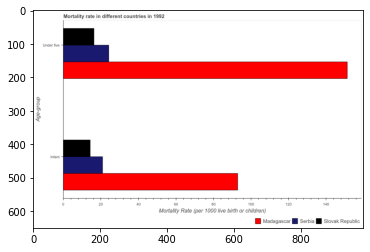

Number of QA =  23





,Age-group,Madagascar,Serbia,Slovak Republic
0,Infant,93.493521,20.850882,14.518741
1,Under five,153.586296,24.494370,16.500209


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the infant mortality rate in slovak republic and that in serbia ?
PREDICTED =  -6.332140457678465
EXPECTED =  -6.599999999999998




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-5 mortality rate in serbia and the infant mortality rate in madagascar ?
PREDICTED =  -72.6426394675819
EXPECTED =  -68.7




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the under-5 mortality rate and infant mortality rate in madagascar ?
PREDICTED =  0.0
EXPECTED =  58.400000000000006




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPU

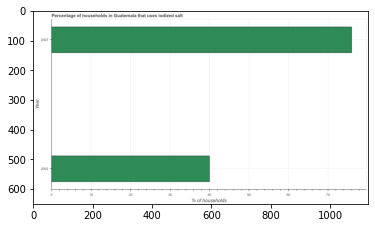

Number of QA =  19





,Year,% of households
0,2002,40.045344
1,2007,75.522221


> what is the title of the graph ?
PREDICTED =  Percentage of households in Guatemala that uses iodized salt
EXPECTED =  Percentage of households in Guatemala that uses iodized salt




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  % of households
EXPECTED =  % of households




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of households where iodized salt is consumed in 2002 and 2007 ?
PREDICTED =  -35.476877428361085
EXPECTED =  -36.0




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of households where iodized salt is consumed ?
PREDICTED =  57.7837825553449
EXPECT

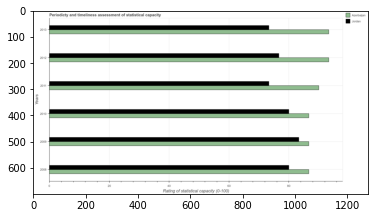

Number of QA =  28





,Years,Azerbaijan,Jordan
0,2012,92.671408,NaN
1,2013,93.301812,73.298211
2,2008,NaN,80.181972
3,2011,89.190941,73.453578
4,2009,86.826135,83.440147
5,2010,86.664544,80.929603


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in jordan in 2011 and that in 2013 ?
PREDICTED =  0.15536689638250323
EXPECTED =  -3.3333332964957663e-06




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating of statistical capacity in jordan in 2008 and the rating of statistical capacity in azerbaijan in 2013 ?
PREDICTED =  6.883760361215707
EXPECTED =  -13.3333333333333




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the rating of statistical capacity in jordan and rating of statistical capacity in azerbaijan ?
PREDICTED =  147.9369932

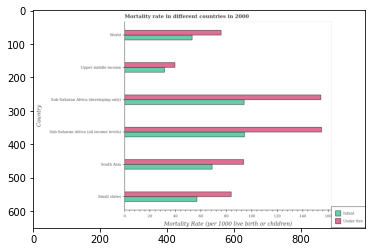

Number of QA =  28





,Country,Infant,Under five
0,World,NaN,77.299389
1,Upper middle income,32.649486,41.529414
2,Small states,NaN,NaN
3,South Asia,70.173709,95.647062
4,Sub-Saharan Africa (developing only),NaN,157.059494
5,Sub-Saharan Africa (all income levels),96.508568,158.055770


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the infant mortality rate in sub-saharan africa (developing only) and that in upper middle income ?
PREDICTED =  63.85908198965607
EXPECTED =  62.6




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the infant mortality rate in south asia and the under-5 mortality rate in sub-saharan africa (developing only) ?
PREDICTED =  -86.88578505688837
EXPECTED =  -85.50000000000001




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what i

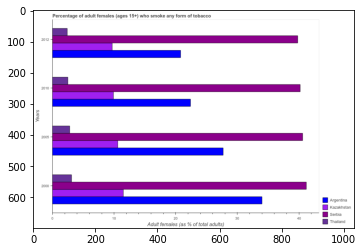

Number of QA =  30





,Years,Kazakhstan,Serbia,Thailand,Argentina
0,2005,10.733835,40.761606,2.908253,28.283322
1,2012,9.991290,39.928111,2.473613,20.983996
2,2010,10.016071,40.425655,2.617833,22.818726
3,2000,11.659679,41.478309,3.190384,34.076201


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of adult females who smoke in serbia in 2000 and that in 2012 ?
PREDICTED =  1.550198240698144
EXPECTED =  1.4000000000000057




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of adult females who smoke in thailand in 2010 and the percentage of adult females who smoke in kazakhstan in 2005 ?
PREDICTED =  -0.2904195623123904
EXPECTED =  -8.1




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of adult females who smoke in serbia and percentage of adult females who smoke in kazakhstan ?
PREDI

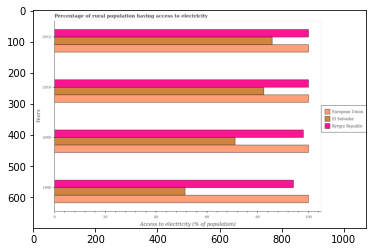

Number of QA =  29





,Years,Kyrgyz Republic,El Salvador,European Union
0,2010,101.276047,83.704490,100.892586
1,2012,99.947038,86.363899,101.774101
2,2000,98.458087,71.809414,101.197591
3,1990,95.356828,52.051370,101.338267


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population having access to electricity in european union in 1990 and that in 2000 ?
PREDICTED =  -3.1012589533078483
EXPECTED =  -0.007839008215412946




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population having access to electricity in el salvador in 1990 and the percentage of rural population having access to electricity in kyrgyz republic in 2010 ?
PREDICTED =  -31.65312071319329
EXPECTED =  -48.6




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the percentage of rural popu

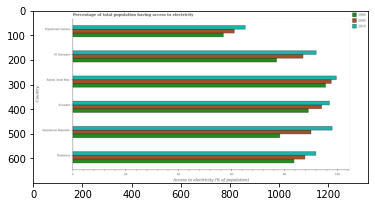

Number of QA =  29





,Country,2000,1990,2010
0,El Salvador,85.799800,77.592476,92.051957
1,Dominica,87.906339,84.513116,92.321927
2,Ecuador,94.576511,89.433627,98.135260
3,Dominican Republic,91.210101,78.848255,99.432648
4,Equatorial Guinea,61.417930,57.377256,65.001277
5,"Egypt, Arab Rep.",98.744724,96.900896,100.368756


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population that have access to electricity in 2010 in ecuador and that in equatorial guinea ?
PREDICTED =  33.13398381680639
EXPECTED =  31.827799999999996




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population that have access to electricity in 1990 in el salvador and the percentage of population that have access to electricity in 2000 in dominica?
PREDICTED =  -6.920639711286398
EXPECTED =  -10.700000000000003




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population that have access to

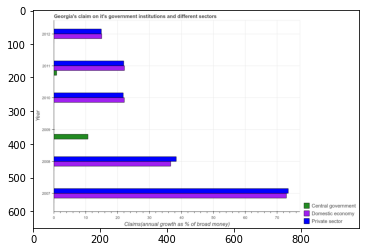

Number of QA =  25





,Year,Private sector,Central government,Domestic economy
0,2007,73.923005,NaN,73.337311
1,2009,NaN,10.988632,NaN
2,2010,22.049189,NaN,22.400007
3,2012,15.171870,NaN,15.159638
4,2008,38.896834,NaN,NaN
5,2011,22.133874,1.084380,22.408391


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of claim on the domestic economy in 2010 and that in 2011 ?
PREDICTED =  -0.008384519256683376
EXPECTED =  -0.038




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of claim on the private sector in 2008 and the percentage of claim on the domestic economy in 2007 ?
PREDICTED =  -35.02617171824083
EXPECTED =  -34.5573799133099




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the percentage of claim on the domestic economy and percentage of claim on the private sector ?
PREDICTED =  7.228136655178533
EXPE

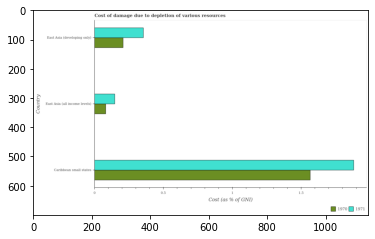

Number of QA =  28





,Country,1971,1970
0,East Asia (all income levels),0.150883,0.087017
1,Caribbean small states,1.895970,1.577007
2,East Asia (developing only),0.361262,0.214160


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of various resources in 1970 in east asia (all income levels) and that in east asia (developing only) ?
PREDICTED =  -0.21415956252691304
EXPECTED =  -0.126193458722682




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to the depletion of various resources in 1971 and cost of damage caused due to the depletion of various resources in 1970 in caribbean small states ?
PREDICTED =  0.8311083030124014
EXPECTED =  0.31578872465943997




				 0 / 3 = 0.0


is_built

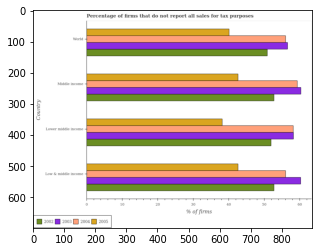

Number of QA =  30





,Country,2002,2003,2004,2005
0,World,51.246296,57.154496,55.759077,40.671651
1,Lower middle income,52.224046,58.834550,58.347462,38.406528
2,Low & middle income,53.227878,60.392172,56.628732,42.897703
3,Middle income,53.111494,61.274226,59.910850,42.889338


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of firms that do not report all sales for tax purposes in 2002 in low & middle income to that in lower middle income ?
PREDICTED =  0.9812777842570038
EXPECTED =  1.0161150703473827




				 1 / 4 = 0.25


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 5 = 0.2


is_buil

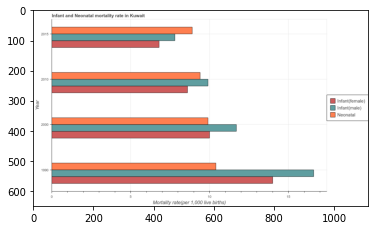

Number of QA =  29





,Year,Infant(male),Neonatal,Infant(female)
0,2015,7.714326,8.932541,6.868241
1,1990,16.662678,10.409465,14.172714
2,2010,9.978326,9.403484,8.578064
3,2000,11.903840,9.937228,10.068068


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the infant mortality rate(female) in 2000 and that in 2010 ?
PREDICTED =  1.4900043557981757
EXPECTED =  1.4




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the neonatal mortality rate in 2010 and the infant mortality rate(male) in 2015 ?
PREDICTED =  0.4709431320462407
EXPECTED =  1.6000000000000005




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2015, what is the difference between the infant mortality rate(male) and infant mortality rate(female) ?
PREDICTED =  0.8460848308506144
EXPECTED =  1.0




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: Fa

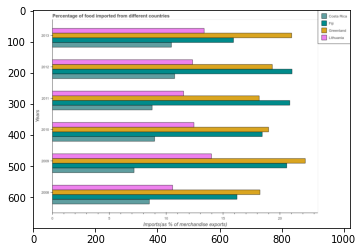

Number of QA =  30





,Years,Costa Rica,Fiji,Greenland,Lithuania
0,2013,10.471629,15.997822,21.802454,13.421675
1,2012,10.818121,21.126457,19.284657,12.435552
2,2009,NaN,21.175909,22.134422,14.074882
3,2011,8.861936,20.924302,NaN,NaN
4,2010,NaN,18.487743,18.954784,12.563428
5,2008,NaN,16.299095,18.219925,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in fiji in 2008 and that in 2012 ?
PREDICTED =  -4.8273621784077605
EXPECTED =  -4.836787415045599




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of imports to different countries in lithuania in 2008 and the percentage of imports to different countries in costa rica in 2012 ?
PREDICTED =  -12.43555231292692
EXPECTED =  -0.1809950875373012




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2013, what is the difference between the percentage of imports to different countries in costa rica and percentage o

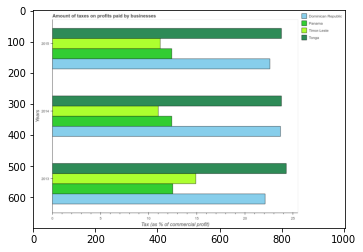

Number of QA =  30





,Years,Timor-Leste,Panama,Dominican Republic,Tonga
0,2015,11.248885,12.486722,22.540806,23.731102
1,2013,14.955108,12.559171,22.025096,24.274637
2,2014,11.131162,12.526289,23.605467,23.841649


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of taxes paid by businesses in tonga in 2013 and that in 2015 ?
PREDICTED =  0.5435350425308201
EXPECTED =  0.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of taxes paid by businesses in tonga in 2013 and the percentage of taxes paid by businesses in panama in 2015 ?
PREDICTED =  11.787915289261688
EXPECTED =  11.9




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2014, what is the difference between the percentage of taxes paid by businesses in tonga and percentage of taxes paid by businesses in timor-leste ?
PREDICTED =  68.8473877

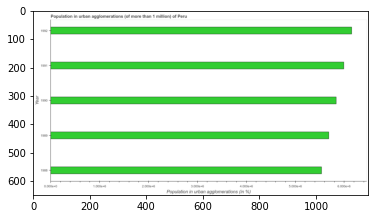

Number of QA =  23





,Year,Population in urban agglomerations (in %)
0,1991,5.991625
1,1992,6.204777
2,1988,5.552817
3,1990,5.858577
4,1989,5.658929


> what is the title of the graph ?
PREDICTED =  Population in urban agglomerations (of more than 1 million) of Peru
EXPECTED =  Population in urban agglomerations (of more than 1 million) of Peru




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Population in urban agglomerations (in %)
EXPECTED =  Population in urban agglomerations (in %)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the population in urban agglomerations in 1991 ?
PREDICTED =  0.9656471311182042
EXPECTED =  5992365




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the maximum population in urban agglomerations ?
PREDICTED =  1.0
EXPECT

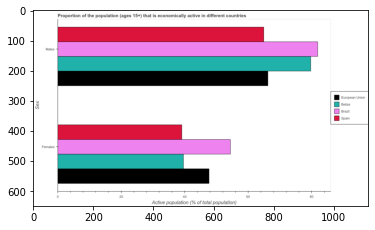

Number of QA =  23





,Sex,Spain,Belize,Brazil,European Union
0,Females,39.363877,39.888552,55.285101,47.916192
1,Males,65.180758,80.036881,81.591910,66.335460


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active male population in spain and that in brazil ?
PREDICTED =  -16.411151772267417
EXPECTED =  -17.000000000000014




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active male population in european union and the percentage of economically active female population in belize ?
PREDICTED =  -13.701420943548385
EXPECTED =  26.600880070178796




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active female population and percentage of economically active male 

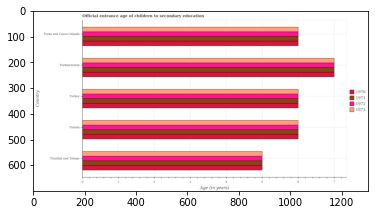

Number of QA =  30





,Country,1972,1971,1970,1973
0,Trinidad and Tobago,5.045599,5.035419,5.064580,5.036219
1,Turkey,6.095822,6.034791,6.035363,6.013169
2,Turks and Caicos Islands,6.047527,6.055715,6.040756,6.130567
3,Tunisia,6.045137,6.037495,6.096227,6.060446
4,Turkmenistan,7.042514,7.115216,7.106682,7.106197


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the secondary school starting age of children in 1971 in turkmenistan and that in turks and caicos islands ?
PREDICTED =  1.05950081148504
EXPECTED =  1.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the secondary school starting age of children in 1972 in turks and caicos islands and the secondary school starting age of children in 1971 in turkey?
PREDICTED =  0.0
EXPECTED =  0.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the secondary school starting age of children in 1972 and secondary school starting age of children in 1970 in trinid

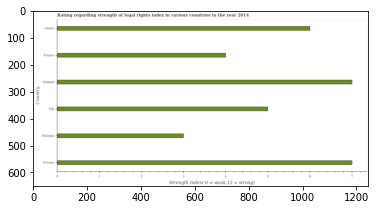

Number of QA =  22





,Country,"Strength Index( 0 = weak,12 = strong)"
0,France,3.999117
1,Finland,6.949885
2,Gabon,5.993753
3,Estonia,6.954857
4,Ethiopia,2.996598
5,Fiji,5.005942


> what is the title of the graph ?
PREDICTED =  Rating regarding strength of legal rights index in various countries in the year 2014
EXPECTED =  Rating regarding strength of legal rights index in various countries in the year 2014




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Strength Index( 0 = weak,12 = strong)
EXPECTED =  Strength Index( 0 = weak,12 = strong)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the strength of legal rights index in estonia and gabon ?
PREDICTED =  0.9611039972560098
EXPECTED =  1.0




				 4 / 4 = 1.0


> what is the median strength of legal rights index ?
PREDICTED =  None
EXPECTED =  5.5




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []


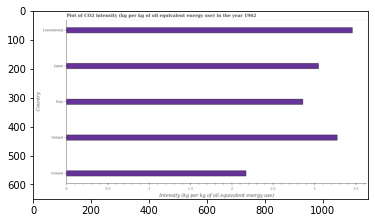

Number of QA =  22





,Country,Intensity (kg per kg of oil equivalent energy use)
0,Japan,3.052425
1,Ireland,3.294260
2,Iceland,2.205344
3,Italy,2.861894
4,Luxembourg,3.464853


> what is the title of the graph ?
PREDICTED =  Plot of CO2 intensity (kg per kg of oil equivalent energy use) in the year 1962
EXPECTED =  Plot of CO2 intensity (kg per kg of oil equivalent energy use) in the year 1962




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Intensity (kg per kg of oil equivalent energy use)
EXPECTED =  Intensity (kg per kg of oil equivalent energy use)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the co2 intensity in italy and luxembourg ?
PREDICTED =  -0.6029590427737861
EXPECTED =  -0.6




				 4 / 4 = 1.0


> what is the median co2 intensity ?
PREDICTED =  None
EXPECTED =  3.04829836156356




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Tr

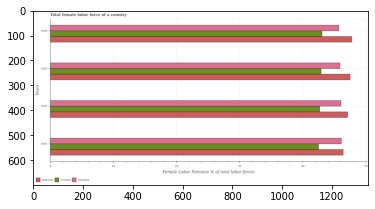

Number of QA =  29





,Years,Armenia,Vanuatu,Croatia
0,1993,47.391386,46.000953,43.608146
1,1994,48.321945,46.047770,43.534564
2,1991,46.412816,46.529898,42.724403
3,1992,47.340475,46.305799,43.182880


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force in croatia in 1992 and that in 1994 ?
PREDICTED =  -0.3516843567550225
EXPECTED =  -0.35188489112699983




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force in croatia in 1993 and the percentage of female labor force in vanuatu in 1994 ?
PREDICTED =  0.07358171998679097
EXPECTED =  -2.7959183249324013




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1993, what is the difference between the percentage of female labor force in vanuatu and percentage of female labor force in croatia ?
PREDICTED =  46.

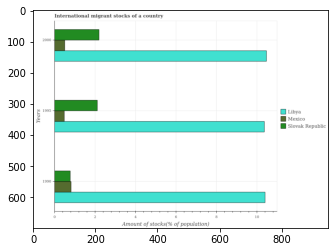

Number of QA =  29





,Years,Unnamed: 1,Mexico,Slovak Republic
0,2000,10.606928,0.516573,2.208550
1,1995,10.504002,0.502303,2.140133
2,1990,10.369109,0.838937,0.802122


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of stocks in in slovak republic in 1990 and that in 2000 ?
PREDICTED =  0.0
EXPECTED =  -1.4189881040516408




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of stocks in in slovak republic in 1990 and the amount of stocks in in mexico in 2000 ?
PREDICTED =  -1.2085503885935704
EXPECTED =  0.272770975009873




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2000, what is the difference between the amount of stocks in in slovak republic and amount of stocks in in mexico ?
PREDICTED =  0.0
EXPECTED =  1.691759079061514




				 0 / 3 = 0.0


is_built

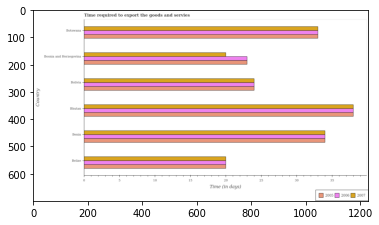

Number of QA =  29





,Country,2007,2005,2006
0,Benin,33.926345,33.826912,NaN
1,Belize,NaN,20.155785,20.078011
2,Bolivia,23.700937,24.257869,NaN
3,Botswana,33.181127,33.004851,33.007364
4,Bhutan,38.088043,37.899412,37.804061
5,Bosnia and Herzegovina,20.295799,NaN,23.044946


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to export the goods and services in 2005 in belize and that in bolivia ?
PREDICTED =  4.0
EXPECTED =  -4.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to export the goods and services in 2006 in bolivia and the number of days required to export the goods and services in 2005 in belize?
PREDICTED =  4.0
EXPECTED =  4.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of days required to export the goods and services in 2007 and number of days required to export the goods and ser

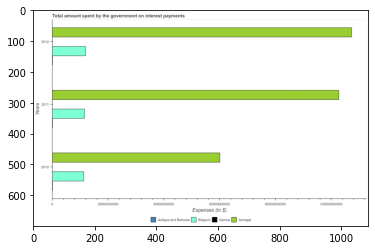

Number of QA =  30





,Years,Senegal,Belgium,Samoa,Antigua and Barbuda
0,2012,1.067548e+11,1.218395e+10,NaN,NaN
1,2011,1.031591e+11,1.176826e+10,NaN,NaN
2,2010,6.048098e+10,1.139629e+10,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on interest payments by the government in belgium in 2010 and that in 2012 ?
PREDICTED =  -787655113.5504131
EXPECTED =  -659800000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on interest payments by the government in antigua and barbuda in 2011 and the amount spent on interest payments by the government in senegal in 2012 ?
PREDICTED =  -209913875095.16296
EXPECTED =  -107222700000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the amount spent on interest payments by the government in

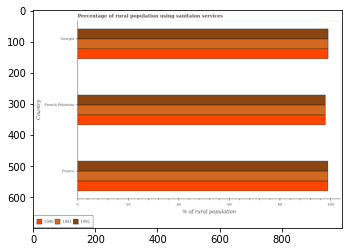

Number of QA =  29





,Country,1992,1990,1991
0,France,99.193831,99.156056,99.133908
1,Georgia,99.167099,99.229910,NaN
2,French Polynesia,98.071890,98.418015,98.422508


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population using sanitaion services in 1991 in france and that in georgia ?
PREDICTED =  99.13390824187636
EXPECTED =  -0.09999999999999432




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population using sanitaion services in 1992 in french polynesia and the percentage of rural population using sanitaion services in 1990 in georgia?
PREDICTED =  -1.0952085705212227
EXPECTED =  -1.0999999999999943




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population using sanitaion serv

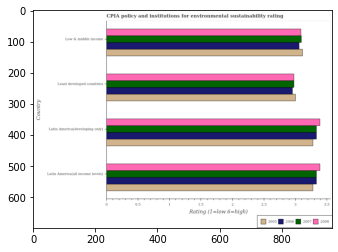

Number of QA =  30





,Country,2007,2005,2008,2006
0,Latin America(developing only),3.372413,NaN,3.391338,3.367023
1,Least developed countries,3.021675,3.042247,2.984046,2.978594
2,Latin America(all income levels),3.363469,3.306475,3.408301,3.371897
3,Low & middle income,3.117127,3.143949,3.104223,3.083651


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2005 in latin america(all income levels) and that in least developed countries ?
PREDICTED =  0.26422817461427606
EXPECTED =  0.2777777777777799




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2006 in latin america(developing only) and the cpia rating in 2008 in low & middle income?
PREDICTED =  0.28337257198107935
EXPECTED =  0.24666666666665993




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in 2005 and cpia rating in 2007 in least developed countries ?
PREDICTED =  0.020572125644927386
EXPE

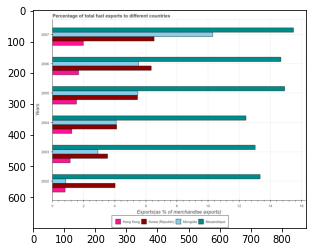

Number of QA =  30





,Years,Korea (Republic),Mozambique,Hong Kong,Mongolia
0,2005,5.533726,15.025464,1.553880,5.541822
1,2007,6.546318,15.486756,2.045515,10.313115
2,2006,6.321304,14.682945,1.752163,NaN
3,2004,4.153426,12.524707,1.285275,4.117926
4,2002,4.047585,13.340677,0.868445,0.895912
5,2003,3.630754,12.973986,1.172511,2.995846


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in mongolia in 2002 and that in 2003 ?
PREDICTED =  -2.099934327637781
EXPECTED =  -2.066201644400377




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of exports to different countries in hong kong in 2005 and the percentage of exports to different countries in mozambique in 2007 ?
PREDICTED =  -0.4916357426632889
EXPECTED =  -13.94431419370333




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finishe

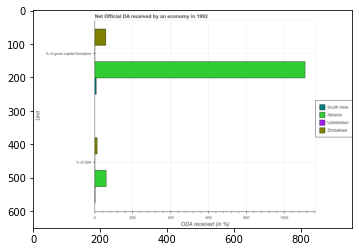

Number of QA =  23





,Unit,Uzbekistan,Zimbabwe,South Asia,Albania
0,% of GNI,NaN,16.029529,NaN,63.382204
1,% of gross capital formation,NaN,62.066560,10.797406,1114.676957


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received as percentage of gross capital formation in zimbabwe and that in uzbekistan ?
PREDICTED =  nan
EXPECTED =  57.680243218325295




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received as percentage of gross capital formation in zimbabwe and the oda received as percentage of gni in albania ?
PREDICTED =  -1.3156443093811419
EXPECTED =  -2.4517799099829958




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oda received as percentage of gross capital formation and oda received as percentage of gni in zimbabwe ?
PREDICTED =  

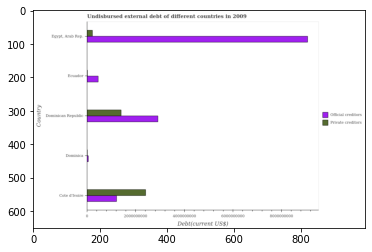

Number of QA =  28





,Country,Private creditors,Official creditors
0,Cote d'Ivoire,2.439927e+09,1.240838e+09
1,Ecuador,NaN,4.826569e+08
2,Dominica,NaN,7.571362e+07
3,Dominican Republic,1.412066e+09,2.951289e+09
4,"Egypt, Arab Rep.",2.480723e+08,9.086446e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the undisbursed external debt of official creditors in dominica and that in egypt, arab rep. ?
PREDICTED =  -9010732232.388721
EXPECTED =  -9035244000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the undisbursed external debt of private creditors in dominican republic and the undisbursed external debt of official creditors in egypt, arab rep. ?
PREDICTED =  1163993954.1389663
EXPECTED =  -7684540000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the undisbursed external debt of official creditors and undisbursed external debt of private c

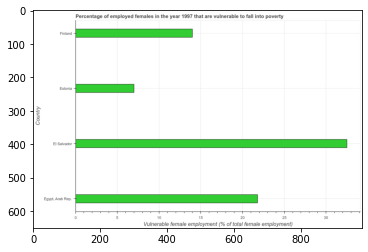

Number of QA =  22





,Country,Vulnerable female employment (% of total female employment)
0,Finland,14.202580
1,Estonia,6.987726
2,El Salvador,32.750676
3,"Egypt, Arab Rep.",21.966584


> what is the title of the graph ?
PREDICTED =  Percentage of employed females in the year 1997 that are vulnerable to fall into poverty
EXPECTED =  Percentage of employed females in the year 1997 that are vulnerable to fall into poverty




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Vulnerable female employment (% of total female employment)
EXPECTED =  Vulnerable female employment (% of total female employment)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of employed females who are vulnerable to fall into poverty in egypt, arab rep. and estonia ?
PREDICTED =  0.0
EXPECTED =  14.8




				 3 / 4 = 0.75


> what is the median percentage of employed females who are vulnerable to fall into 

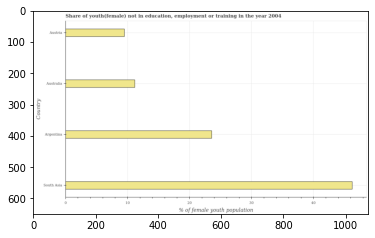

Number of QA =  22





,Country,% of female youth population
0,Australia,11.341835
1,Austria,9.642299
2,Argentina,23.737098
3,South Asia,46.415545


> what is the title of the graph ?
PREDICTED =  Share of youth(female) not in education, employment or training in the year 2004
EXPECTED =  Share of youth(female) not in education, employment or training in the year 2004




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  % of female youth population
EXPECTED =  % of female youth population




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed female youth population in austria and south asia ?
PREDICTED =  -36.77324647781575
EXPECTED =  -36.75




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median unemployed female youth population

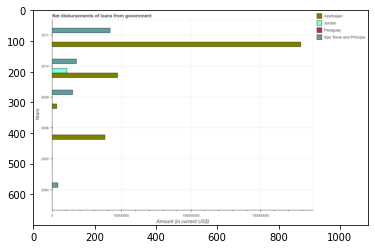

Number of QA =  26





,Years,Azerbaijan,Sao Tome and Principe,Jordan,Paraguay
0,2011,3.234266e+08,7.701232e+07,NaN,NaN
1,2004,NaN,8.228096e+06,NaN,NaN
2,2005,NaN,NaN,NaN,NaN
3,2006,6.956455e+07,NaN,NaN,NaN
4,2010,8.675534e+07,3.223975e+07,1.974455e+07,NaN
5,2009,6.687583e+06,2.741024e+07,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loan disbursed from government in sao tome and principe in 2009 and that in 2010 ?
PREDICTED =  112650650.91954382
EXPECTED =  -2722000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of loan disbursed from government in sao tome and principe in 2010 and the amount of loan disbursed from government in paraguay in 2011 ?
PREDICTED =  67878079.55842182
EXPECTED =  17429000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the amount of loan disbursed from government in sao tome and principe and amount of

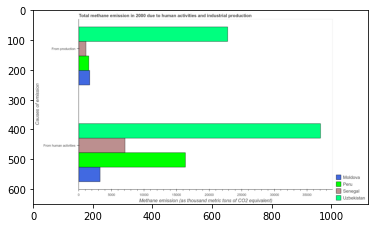

Number of QA =  23





,Causes of emission,Uzbekistan,Moldova,Senegal,Peru
0,From production,270321.782302,21066.801559,14074.418137,19080.570987
1,From human activities,435377.945601,39594.105342,82939.360034,192486.389184


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of emissions generated from industries in peru and that in uzbekistan ?
PREDICTED =  -58754.82213088797
EXPECTED =  -21308.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of emissions from human activities in senegal and the amount of emissions generated from industries in uzbekistan ?
PREDICTED =  -352438.58556748065
EXPECTED =  -15750.9




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of emissions from human activities and amount of emissions generated from industries in peru ?
PREDICTED =  435375.9456011403
EX

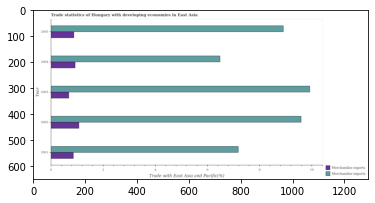

Number of QA =  28





,Year,Merchandise imports,Merchandise exports
0,2004,6.499715,0.934909
1,2001,7.273958,0.864574
2,2002,9.603458,1.092378
3,2005,8.939349,0.896693
4,2003,9.962152,0.701621


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in 2002 and that in 2003 ?
PREDICTED =  0.3907579662787788
EXPECTED =  0.388




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in 2004 and the merchandise imports in 2003 ?
PREDICTED =  0.23328819301680426
EXPECTED =  -8.995654644709703




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the merchandise exports and merchandise imports ?
PREDICTED =  -37.788456417574885
EXPECTED =  -6.322




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predi

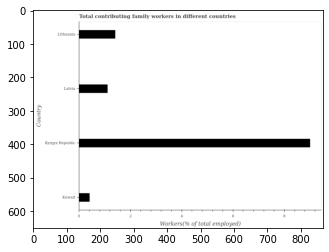

Number of QA =  22





,Country,Workers(% of total employed)
0,Kuwait,0.426060
1,Latvia,1.118813
2,Lithuania,1.447441
3,Kyrgyz Republic,8.997659


> what is the title of the graph ?
PREDICTED =  Total contributing family workers in different countries
EXPECTED =  Total contributing family workers in different countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Workers(% of total employed)
EXPECTED =  Workers(% of total employed)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the contributing family workers in kuwait and latvia ?
PREDICTED =  -0.6927537936795003
EXPECTED =  -0.7




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 4 / 5 = 0.8


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation

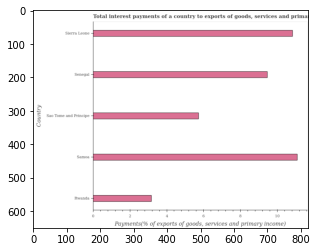

Number of QA =  22





,Country,"Payments(% of exports of goods, services and primary income)"
0,Samoa,11.109843
1,Rwanda,3.212229
2,Sierra Leone,10.846778
3,Sao Tome and Principe,5.793693
4,Senegal,9.479717


> what is the title of the graph ?
PREDICTED =  Total interest payments of a country to exports of goods, services and prima!
EXPECTED =  Total interest payments of a country to exports of goods, services and primary income in 1981




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Payments(% of exports of goods, services and primary income)
EXPECTED =  Payments(% of exports of goods, services and primary income)




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total interest payments on external debt in rwanda and sao tome and principe ?
PREDICTED =  -2.581464624397415
EXPECTED =  -2.562




				 3 / 4 = 0.75


> what is the median total interest payments on external debt ?
PREDICTED =  None
EXPECTED =  

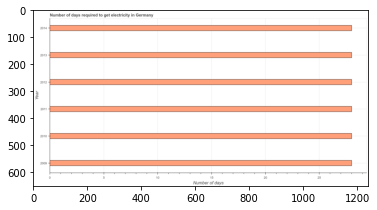

Number of QA =  23





,Year,Number of days
0,2014,27.971898
1,2010,27.921070
2,2009,28.013753
3,2011,27.809030
4,2012,27.987197
5,2013,27.900032


> what is the title of the graph ?
PREDICTED =  Number of days required to get electricity in Germany
EXPECTED =  Number of days required to get electricity in Germany




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Number of days
EXPECTED =  Number of days




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the time to get electricity in 2010 and 2011 ?
PREDICTED =  0.1120396159818462
EXPECTED =  0.0




				 3 / 4 = 0.75


> what is the median time to get electricity ?
PREDICTED =  None
EXPECTED =  28.0




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the time to get electricity in 2010 t

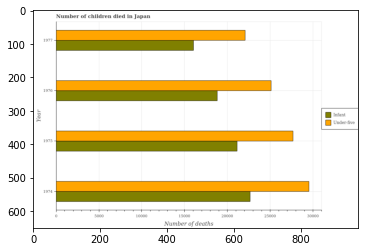

Number of QA =  28





,Year,Infant,Under-five
0,1975,38170.283054,50148.836342
1,1974,40893.989871,53216.450745
2,1976,34025.999096,45449.094661
3,1977,28966.691098,39680.091454


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of under-five deaths in 1975 and that in 1977 ?
PREDICTED =  50147.83634178742
EXPECTED =  5588




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of under-five deaths in 1977 and the number of infant deaths in 1974 ?
PREDICTED =  -53215.450744795526
EXPECTED =  -580




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1975, what is the difference between the number of infant deaths and number of under-five deaths ?
PREDICTED =  142053.96311879304
EXPECTED =  -6529




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Traini

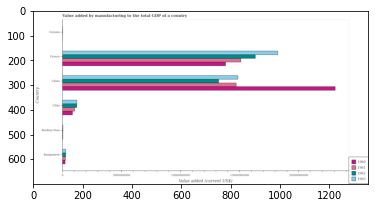

Number of QA =  30





,Country,1963,1962,1961,1960
0,Guyana,NaN,NaN,NaN,NaN
1,Burkina Faso,NaN,NaN,NaN,NaN
2,France,3.329831e+10,2.964220e+10,2.749103e+10,2.494733e+10
3,Chile,2.290756e+09,2.276390e+09,1.951316e+09,1.607285e+09
4,China,2.686518e+10,2.421915e+10,2.687387e+10,4.178816e+10
5,Bangladesh,6.180781e+08,5.833839e+08,5.665290e+08,5.110977e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing to the total gdp in 1963 in burkina faso and that in france ?
PREDICTED =  0.0
EXPECTED =  -18181059276.515617




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing to the total gdp in 1960 in guyana and the value added by manufacturing to the total gdp in 1962 in france?
PREDICTED =  -24947328214.456074
EXPECTED =  -16307791884.52449




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by manufacturing to the total gdp in 1962 and value added by manufacturing to the total gdp

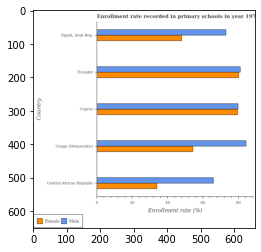

Number of QA =  28





,Country,Female,Male
0,Cyprus,NaN,80.788589
1,Ecuador,81.382589,82.155875
2,"Egypt, Arab Rep.",48.628453,NaN
3,Congo (Democratic),55.134937,NaN
4,Central African Republic,35.006240,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate of male students in congo (democratic) and that in ecuador ?
PREDICTED =  -82.15587525862482
EXPECTED =  3.233




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate of male students in central african republic and the enrollment rate of female students in congo (democratic) ?
PREDICTED =  0.0
EXPECTED =  11.620879999999985




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_

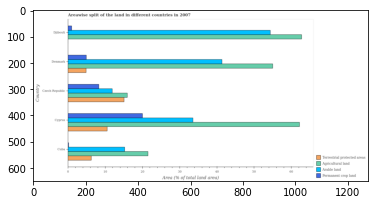

Number of QA =  30





,Country,Agricultural land,Permanent crop land,Terrestrial protected areas,Arable land
0,Djibouti,62.889015,1.132845,NaN,54.846862
1,Denmark,55.220387,5.042421,4.981911,41.528222
2,Cuba,21.611880,NaN,6.380519,15.407729
3,Cyprus,62.093717,20.105386,10.696725,33.884651
4,Czech Republic,16.111318,8.434530,15.273382,12.042978


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of area under arable land in denmark and that in djibouti ?
PREDICTED =  -13.318639770674423
EXPECTED =  -12.989




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of land under terrestrial protection in cuba and the percentage of area under arable land in denmark ?
PREDICTED =  -35.147703916273635
EXPECTED =  -35.109570053024065




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of area under agricultural land and percentage of land under terrestrial protection in czech republic ?
PREDICTED =  46.7776971842

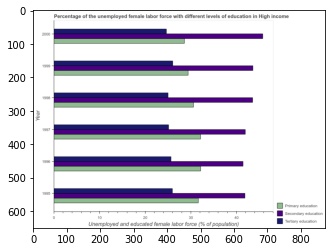

Number of QA =  29





,Year,Secondary education,Tertiary education,Primary education
0,1999,43.511932,26.176443,NaN
1,1995,42.145656,26.163281,NaN
2,1996,41.735506,25.727524,NaN
3,1998,43.726072,24.989534,NaN
4,1997,42.155176,24.998452,NaN
5,2000,45.545149,24.630645,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received secondary education in 1995 and that in 1999 ?
PREDICTED =  -1.3662756810653818
EXPECTED =  -1.74




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of female labor force who received secondary education in 1997 and the percentage of female labor force who received primary education in 2000 ?
PREDICTED =  -3.389973680449188
EXPECTED =  13.356901081793712




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1997, what is the difference between the percentage of female labor force who received tertiary educatio

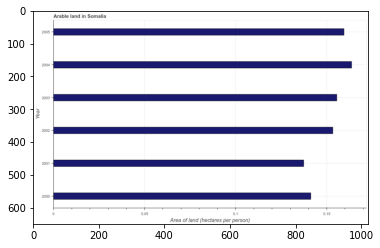

Number of QA =  23





,Year,Area of land (hectares per person)
0,2005,0.158400
1,2004,0.163379
2,2002,0.152904
3,2001,0.137643
4,2000,0.140941
5,2003,0.155506


> what is the title of the graph ?
PREDICTED =  Arable land in Somalia
EXPECTED =  Arable land in Somalia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Area of land (hectares per person)
EXPECTED =  Area of land (hectares per person)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the area of arable land in 2004 and 2005 ?
PREDICTED =  0.004979264193479216
EXPECTED =  0.004




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median area of arable land ?
PREDICTED =  2002.5
EXPECTED =  0.1544007176583875




				 3 / 5 = 0.6


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or 

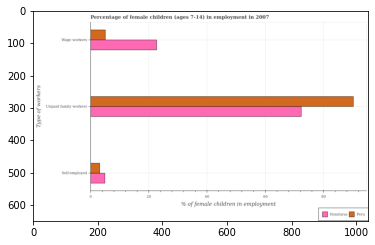

Number of QA =  28





,Type of workers,Unnamed: 1,Honduras
0,Self-employed,3.269263,5.058258
1,Wage workers,5.241129,22.983190
2,Unpaid family workers,90.761529,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of children employed as unpaid family workers in peru and that in honduras ?
PREDICTED =  0.0
EXPECTED =  17.89




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self employed children in honduras and the percentage of children employed as wage workers in peru ?
PREDICTED =  4.058257772685372
EXPECTED =  -0.16000000000000014




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_b

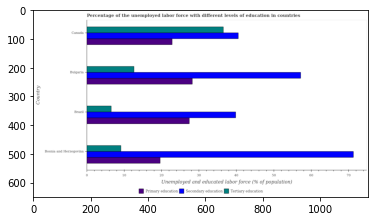

Number of QA =  29





,Country,Secondary education,Tertiary education,Primary education
0,Canada,40.895585,36.685901,23.125235
1,Brazil,40.090610,6.737971,27.577523
2,Bulgaria,57.713498,12.762694,28.007961
3,Bosnia and Herzegovina,71.432019,9.313330,19.883034


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received tertiary education in bulgaria and that in canada ?
PREDICTED =  -23.923206307737797
EXPECTED =  -23.9




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received tertiary education in bulgaria and the percentage of labor force who received primary education in canada ?
PREDICTED =  -23.923206307737797
EXPECTED =  -10.1999988555908




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received tertiary education and percentage of labor force who 

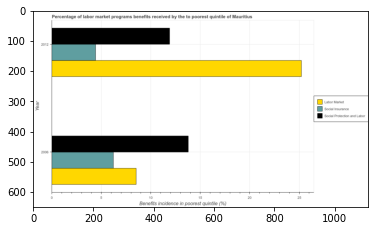

Number of QA =  26





,Year,Labor Market,Social Protection and Labor,Social Insurance
0,2006,8.557869,13.940740,6.294383
1,2012,25.407756,12.026436,4.408309


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of benefits received due to social insurance programs in 2006 and that in 2012 ?
PREDICTED =  1.8860741950691802
EXPECTED =  1.797




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of benefits received due to labor market programs in 2006 and the percentage of benefits received due to social protection programs in 2012 ?
PREDICTED =  1.9143034291570178
EXPECTED =  -3.3794472458636804




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of benefits received due to labor market programs and pe

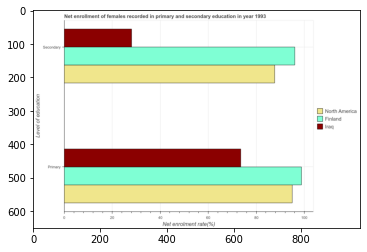

Number of QA =  23





,Level of education,North America,Finland,Iraq
0,Secondary,88.562333,96.655828,28.436245
1,NaN,96.067854,99.578901,74.630727


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in secondary education in finland and that in iraq ?
PREDICTED =  68.21958272579668
EXPECTED =  68.00586




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in secondary education in north america and the enrollment rate in primary education in finland ?
PREDICTED =  -8.093494376110783
EXPECTED =  -11.169508161621096




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in secondary education and enrollment rate in primary education in north america ?
PREDICTED =  0.0
EXPECTED =  -7.31761169433589

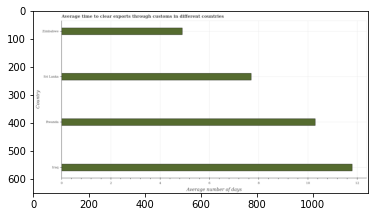

Number of QA =  22





,Country,Average number of days
0,Rwanda,10.304312
1,Iraq,11.842046
2,Sri Lanka,7.711670
3,Zimbabwe,4.935527


> what is the title of the graph ?
PREDICTED =  Average time to clear exports through customs in different countries
EXPECTED =  Average time to clear exports through customs in different countries




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Average number of days
EXPECTED =  Average number of days




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 3 / 4 = 0.75


> what is the median time to clear exports through customs ?
PREDICTED =  None
EXPECTED =  9.0




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the time to clear exports through customs in rwanda to that in zimbabwe?
PREDICTED =  2.46776370386452

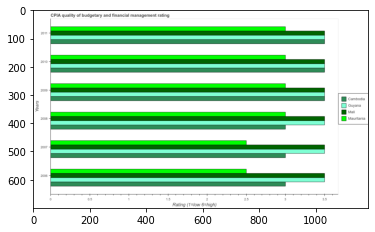

Number of QA =  30





,Years,Cambodia,Mali,Mauritania,Guyana
0,2006,3.029479,3.536764,2.530341,NaN
1,2007,2.988934,3.512724,2.512694,3.474910
2,2009,3.516640,3.485265,2.995942,NaN
3,2008,3.024836,3.514569,3.004177,3.530366
4,2011,3.487018,3.459385,2.993437,3.448856
5,2010,3.493442,3.494619,NaN,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in guyana in 2008 and that in 2009 ?
PREDICTED =  0.05545619324198503
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in mauritania in 2009 and the cpia rating in cambodia in 2008 ?
PREDICTED =  -0.008235487664170371
EXPECTED =  0.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2011, what is the difference between the cpia rating in mauritania and cpia rating in mali ?
PREDICTED =  -17.999149133127883
EXPECTED =  -0.5




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predic

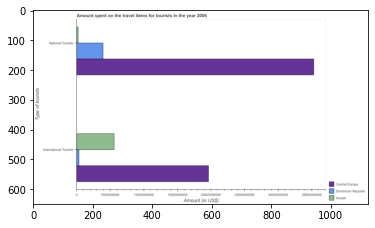

Number of QA =  23





,Type of tourists,Dominican Repubiic,Central Europe,Kuwait
0,National Tourists,7.167854e+09,6.378200e+10,6.032751e+08
1,International Tourists,7.940736e+08,3.543327e+10,1.022910e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on travel items of international tourists in dominican republic and that in central europe ?
PREDICTED =  -34639200199.334496
EXPECTED =  -19293000000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on travel items of national tourists in kuwait and the amount spent on travel items of international tourists in central europe ?
PREDICTED =  -98611998875.88069
EXPECTED =  -19421000000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on travel items of international tourists and amount spent on trave

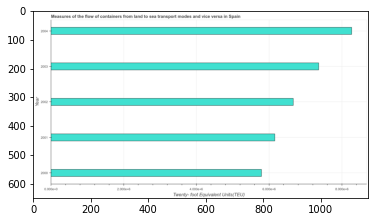

Number of QA =  23





,Year,Twenty- foot Equivalent Units(TEU)
0,2004,8.279502
1,2003,7.381488
2,2000,5.782975
3,2002,6.660538
4,2001,6.160549


> what is the title of the graph ?
PREDICTED =  Measures of the flow of containers from land to sea transport modes and vice versa in Spain
EXPECTED =  Measures of the flow of containers from land to sea transport modes and vice versa in Spain




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Twenty- foot Equivalent Units(TEU)
EXPECTED =  Twenty- foot Equivalent Units(TEU)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the container port traffic in 2001 and 2004 ?
PREDICTED =  -2.1189532441291394
EXPECTED =  -2114086.0




				 3 / 4 = 0.75


> what is the median container port traffic ?
PREDICTED =  None
EXPECTED =  6664100.0




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training

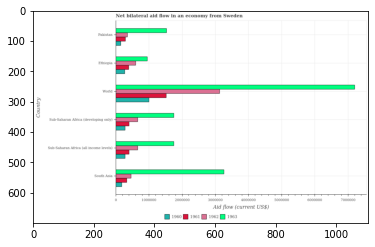

Number of QA =  30





,Country,1963,1962,1961,1960
0,Pakistan,1.540118e+06,3.688370e+05,3.082509e+05,1.725915e+05
1,Ethiopia,9.830894e+05,6.180071e+05,4.061038e+05,2.826785e+05
2,South Asia,3.292379e+06,4.778850e+05,3.505268e+05,1.956948e+05
3,Sub-Saharan Africa (all income levels),1.771445e+06,6.877629e+05,4.183777e+05,2.987873e+05
4,World,7.250266e+06,3.157149e+06,1.556359e+06,1.029756e+06
5,Sub-Saharan Africa (developing only),NaN,6.812517e+05,4.161508e+05,2.991048e+05


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1960 in pakistan and that in sub-saharan africa (all income levels) ?
PREDICTED =  -126195.75200234828
EXPECTED =  -130000.0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1961 in south asia and the net bilateral aid flow in 1962 in pakistan?
PREDICTED =  42275.97623452748
EXPECTED =  -20000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in 1962 and net bilateral aid flow in 1960 in pakistan ?
PREDICTED =  -172586.52516131927
EXPECTED =  200000.0




				 1

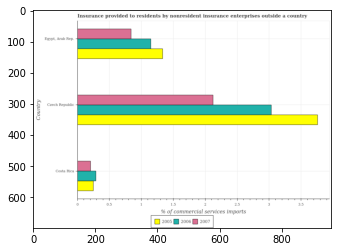

Number of QA =  29





,Country,2007,2005,2006
0,Costa Rica,0.213470,0.262837,0.298950
1,Czech Republic,2.138296,3.824590,3.064109
2,"Egypt, Arab Rep.",0.855636,1.357668,1.166495


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the insurance provided to residents in 2005 in costa rica and that in egypt, arab rep. ?
PREDICTED =  -1.0948316709772912
EXPECTED =  -1.084719571789829




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the insurance provided to residents in 2007 in czech republic and the insurance provided to residents in 2005 in egypt, arab rep.?
PREDICTED =  1.2826604139112092
EXPECTED =  0.7885930510572798




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after trainin

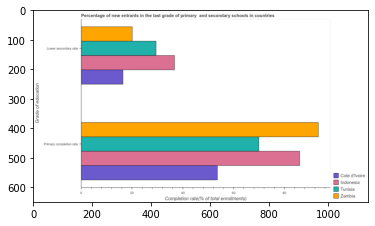

Number of QA =  23





,Grade of education,Zambia,Tunisia,Cote d'Ivoire,indonesia
0,Lower secondary rate,20.569955,29.604056,16.360210,37.157142
1,Primary completion rate,93.779521,70.231372,53.837381,85.421055


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the completion rate in primary schools in indonesia and that in zambia ?
PREDICTED =  -8.358465787720917
EXPECTED =  -7.368720000000025




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the completion rate in secondary schools in cote d'ivoire and the completion rate in primary schools in indonesia ?
PREDICTED =  -18.73858546410363
EXPECTED =  -69.51302999999999




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the completion rate in primary schools and completion rate in secondary schools in indonesia ?
PREDICTED =  -84.42105535149145
EXPECTED =  49

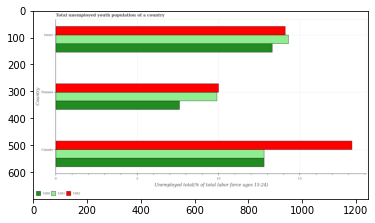

Number of QA =  29





,Country,1982,1980,1981
0,Canada,18.361008,12.846204,12.953931
1,Israel,14.188490,13.373892,14.268322
2,Finland,10.070237,7.646766,9.988781


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total unemployed youth population of a country in 1981 in canada and that in israel ?
PREDICTED =  -1.3143910879570253
EXPECTED =  -1.5




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total unemployed youth population of a country in 1981 in canada and the percentage of total unemployed youth population of a country in 1982 in finland?
PREDICTED =  2.965149643929511
EXPECTED =  2.8000001907349006




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total unemployed youth population of a country in 

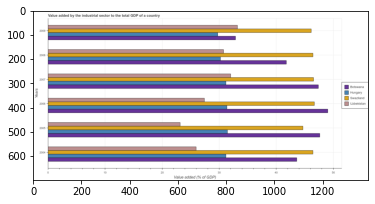

Number of QA =  30





,Years,Uzbekistan,Botswana,Hungary,Swaziland
0,2009,33.356711,31.901850,30.342871,48.462738
1,2008,31.134951,37.441529,30.797872,49.380977
2,2006,27.247731,39.521160,31.972638,46.370644
3,2004,26.169617,44.692779,31.522103,NaN
4,2007,32.384330,39.844592,31.398845,46.248532
5,2005,22.972040,41.123089,31.963761,44.077787


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector to the total gdp in hungary in 2004 and that in 2006 ?
PREDICTED =  -0.45053456689755933
EXPECTED =  -0.17917772651109942




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by the industrial sector to the total gdp in hungary in 2005 and the value added by the industrial sector to the total gdp in botswana in 2008 ?
PREDICTED =  1.165889486054109
EXPECTED =  -10.331027384456




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the value added by the industrial sector to the total 

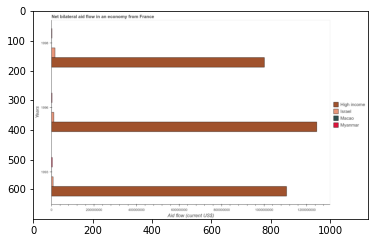

Number of QA =  30





,Years,Myanmar,Israel,Macao,High income
0,1996,NaN,1.349023e+07,NaN,1.250895e+09
1,1998,NaN,1.906302e+07,NaN,1.005365e+09
2,1993,6.303227e+06,9.983209e+06,NaN,1.108983e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in myanmar in 1993 and that in 1996 ?
PREDICTED =  6303226.586622222
EXPECTED =  1230000.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in macao in 1993 and the net bilateral aid flow in myanmar in 1996 ?
PREDICTED =  0.0
EXPECTED =  -2120000.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the net bilateral aid flow in israel and net bilateral aid flow in high income ?
PREDICTED =  14178821.414433694
EXPECTED =  -1237060000.0




				 0 / 3 = 0.0


is_built_with_cuda: Tr

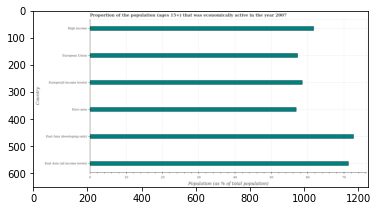

Number of QA =  22





,Country,Population (as % of total population)
0,Euro area,57.039726
1,European Union,57.472343
2,East Asia (all income levels),71.728301
3,High income,61.859079
4,East Asia (developing only),73.421430
5,Europe(all income levels),58.832189


> what is the title of the graph ?
PREDICTED =  Proportion of the population (ages 15+) that was economically active in the year 2007
EXPECTED =  Proportion of the population (ages 15+) that was economically active in the year 2007




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Population (as % of total population)
EXPECTED =  Population (as % of total population)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of economically active population in east asia (developing only) and euro area ?
PREDICTED =  0.8465642782205407
EXPECTED =  15.807




				 3 / 4 = 0.75


> what is the median percentage of economically active population ?
PREDICTED =  None
EXPECTED =  60.0927346994614




				 3 / 6 

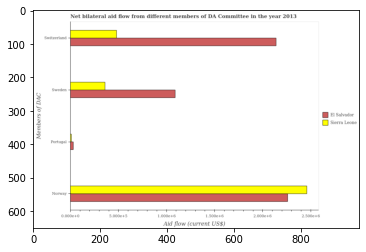

Number of QA =  29





,Members of DAC,Sierra Leone,E] Salvador
0,Sweden,6.587345,19.778585
1,Norway,44.146459,40.698373
2,Portugal,0.303515,0.659623
3,Switzerland,8.690746,38.683799


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by sweden in sierra leone and that in el salvador ?
PREDICTED =  -13.191240211279188
EXPECTED =  -730000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by norway in el salvador and the amount of aid given by portugal in sierra leone ?
PREDICTED =  -3.751601945907005
EXPECTED =  2250000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid given by sweden and amount of aid given by switzerland in el salvador ?
PREDICTED =  -37.68379942213996
EXPECTED =  -1050000




				 0 / 3 = 0.0


is

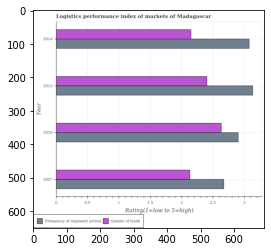

Number of QA =  28





,Year,Quality of trade,Frequency of shipment arrival
0,2014,2.171446,3.078800
1,2007,2.141715,2.713056
2,2012,2.435635,3.187603
3,2010,2.661786,2.931532


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lpi of frequency of shipment arrival in 2012 and that in 2014 ?
PREDICTED =  0.10880368589812761
EXPECTED =  0.056




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lpi quality of trade in 2010 and the lpi of frequency of shipment arrival in 2007 ?
PREDICTED =  0.5200706755796713
EXPECTED =  -0.040000000000000036




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2014, what is the difference between the lpi of frequency of shipment arrival and lpi quality of trade ?
PREDICTED =  0.12803561898674065
EXPECTED =  0.927




				 0 / 3 = 0.0


is_built_with_cuda: Tru

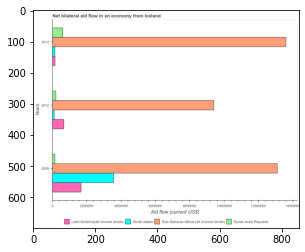

Number of QA =  30





,Years,Syrian Arab Republic,Small states,Latin America(all income levels;,Sub-Saharan Africa (all income levels.
0,2013,622525.313317,1.766791e+05,1.831225e+05,1.365213e+07
1,2012,236243.351677,1.259476e+05,6.944065e+05,9.454710e+06
2,2009,174246.086014,3.611858e+06,1.704719e+06,1.323716e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in small states in 2012 and that in 2013 ?
PREDICTED =  -50731.532534608705
EXPECTED =  -40000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in small states in 2009 and the net bilateral aid flow in sub-saharan africa (all income levels) in 2013 ?
PREDICTED =  3435178.4670483284
EXPECTED =  -10040000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2009, what is the difference between the net bilateral aid flow in syrian arab republic and net bilateral aid flow in latin america(all income levels) ?
PREDICTED = 

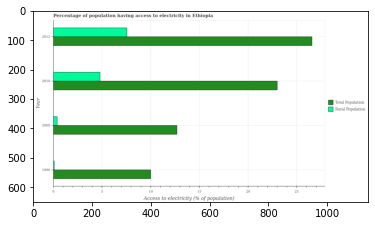

Number of QA =  28





,Year,Rural Population,Total Population
0,2000,0.463315,12.781187
1,2010,4.916026,23.220512
2,2012,7.671727,26.764716
3,1990,0.155537,10.092983


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population having access to electricity in 2000 and that in 2010 ?
PREDICTED =  -4.452711350579448
EXPECTED =  -4.4




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of rural population having access to electricity in 2012 and the percentage of population having access to electricity in 2010 ?
PREDICTED =  2.7557003245265888
EXPECTED =  -15.4454




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2012, what is the difference between the percentage of rural population having access to electricity and percentage of population having a

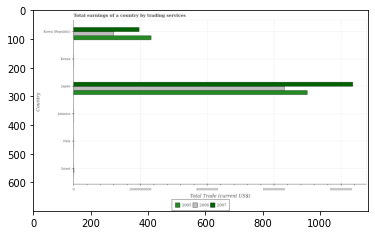

Number of QA =  22





,Country,2007,2005,2006
0,Israel,NaN,NaN,NaN
1,Jamaica,NaN,NaN,NaN
2,Italy,NaN,NaN,NaN
3,Kenya,NaN,NaN,NaN
4,Korea (Republic),1.966915e+10,2.341594e+10,1.222533e+10
5,Japan,8.545654e+10,7.050707e+10,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total earnings in 2007 in israel and the total earnings in 2005 in jamaica?
PREDICTED =  0.0
EXPECTED =  0




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total earnings in 2006 and total earnings in 2007 in korea (republic) ?
PREDICTED =  12225328798.5611
EXPECTED =  -7630100000.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Total Trade (current US$)
EXPECTED =  20000000000.0




				 1 / 4 = 0.25


> what is the title of the graph ?
PREDICTED =  Total ea

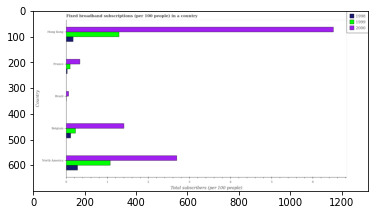

Number of QA =  29





,Country,1999,2000,1998
0,Brazil,NaN,0.068883,NaN
1,France,0.102993,0.341815,NaN
2,North America,1.078789,2.739785,0.290640
3,Hong Kong,1.291349,6.460606,0.181304
4,Belgium,0.233751,1.413938,0.119432


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of broadband subscriptions in 1998 in belgium and that in hong kong ?
PREDICTED =  -0.061872083695197394
EXPECTED =  -0.060017922123523984




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of broadband subscriptions in 1998 in brazil and the number of broadband subscriptions in 1999 in belgium?
PREDICTED =  0.8805677902204716
EXPECTED =  -0.22396560346317304




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of broadband subscriptions in 2000 and number of broadband subscriptions in 1998 in brazil ?
PREDICTED =  7.0250

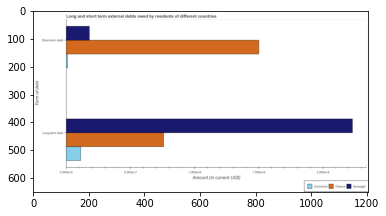

Number of QA =  23





,Term of debt,Senegal,Comoros,Ghana
0,Long-term debt,40.573034,2.092336,13.647818
1,Short-term debt,3.307791,0.241448,26.981764


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the long-term debts owed by residents in senegal and that in ghana ?
PREDICTED =  26.925216169748687
EXPECTED =  147049000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the short-term debts owed by residents in ghana and the long-term debts owed by residents in senegal ?
PREDICTED =  23.673973133230028
EXPECTED =  -72908000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the long-term debts owed by resi

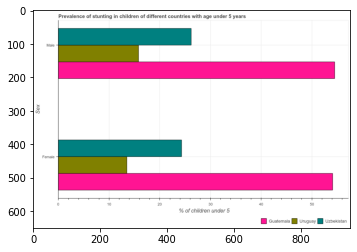

Number of QA =  23





,Sex,Uzbekistan,Uruguay,Guatemala
0,Male,26.455508,16.088959,55.073368
1,Female,24.475038,13.512845,54.327207


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of stunted male children in uruguay and that in guatemala ?
PREDICTED =  -38.98440892857843
EXPECTED =  -38.6999998092651




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of stunted female children in uruguay and the percentage of stunted male children in guatemala ?
PREDICTED =  -40.814361764195375
EXPECTED =  -41.0




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the perce

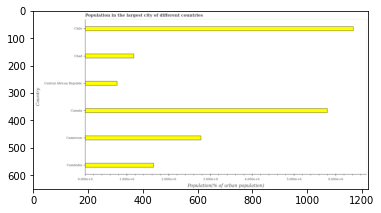

Number of QA =  22





,Country,Population(% of urban population)
0,Canada,5.820245
1,Chile,6.420722
2,Chad,1.187663
3,Central African Republic,0.777853
4,Cameroon,2.815095
5,Cambodia,1.655836


> what is the title of the graph ?
PREDICTED =  Population in the largest city of different count)
EXPECTED =  Population in the largest city of different countries




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Population(% of urban population)
EXPECTED =  Population(% of urban population)




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the population in largest city in central african republic and chile ?
PREDICTED =  -5.642869711726865
EXPECTED =  -5656275.0




				 2 / 4 = 0.5


> what is the median population in largest city ?
PREDICTED =  None
EXPECTED =  2205684.0




				 2 / 6 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished aft

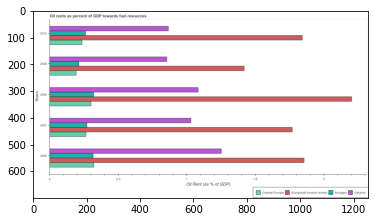

Number of QA =  30





,Years,Europe(all income levels),Central Europe,Ukraine,Hungary
0,2009,1.420162,0.196685,NaN,0.216066
1,2010,1.797125,0.238389,0.863405,0.264684
2,2007,1.755344,0.267938,1.014997,0.272381
3,2006,1.854337,0.321654,1.260117,0.319117
4,2008,2.193538,0.303580,1.075112,0.325211


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oil rent in ukraine in 2007 and that in 2008 ?
PREDICTED =  -0.060115448816670636
EXPECTED =  -0.05293881100054998




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the oil rent in central europe in 2008 and the oil rent in europe(all income levels) in 2007 ?
PREDICTED =  0.035642173816945566
EXPECTED =  -1.4674372577206931




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the oil rent in central europe and oil rent in hungary ?
PREDICTED =  1.2234767144499323
EXPECTED =  -0.006938198997205047




				 0 / 3 = 0.0


is_built_wit

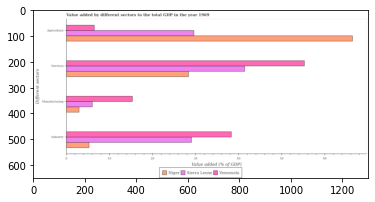

Number of QA =  29





,Different sectors,Sierra Leone,Venezuela,Niger
0,Services,41.820192,55.419331,28.623140
1,Industry,NaN,38.700571,5.425295
2,Agriculture,30.037768,6.666272,66.745879
3,Manufacturing,6.168387,15.339569,3.082531


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by services sector in niger and that in venezuela ?
PREDICTED =  -26.796190664217292
EXPECTED =  -26.905479176562807




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by services sector in sierra leone and the value added by industrial sector in venezuela ?
PREDICTED =  -13.599138563735899
EXPECTED =  3.0936365965058883




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the value added by agricultural sector and value added by manufacturing sector in venezuela ?
PREDICTED =  -15.339569078201366
EXPECTED =  -8.8422972772

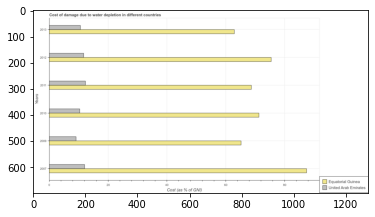

Number of QA =  28





,Years,United Arab Emirates,Equatorial Guinea
0,2013,10.748019,62.851972
1,2011,12.430876,68.774735
2,2007,12.265011,87.402835
3,2009,9.205687,65.050624
4,2012,11.863781,75.273266
5,2010,10.433505,71.202144


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to water depletion in united arab emirates in 2010 and that in 2012 ?
PREDICTED =  -1.4302762911527047
EXPECTED =  -1.3350856091059011




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to water depletion in equatorial guinea in 2009 and the cost of damage caused due to water depletion in united arab emirates in 2012 ?
PREDICTED =  -10.222642052430004
EXPECTED =  53.5197287451636




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the cost of damage caused due to water depleti

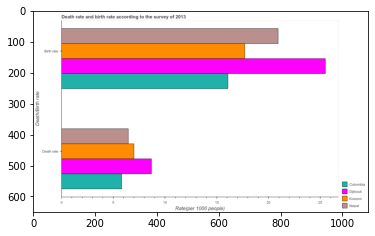

Number of QA =  23





,Death/Birth rate,Kosovo,Nepal,Djibouti,Colombia
0,Birth rate,18.058470,21.083430,25.977903,16.290606
1,Death rate,7.038021,6.511958,8.748896,5.873066


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the death rate in nepal and the birth rate in kosovo ?
PREDICTED =  -0.5260622181941308
EXPECTED =  -11.247999999999998




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the death rate in kosovo to that in nepal ?
PREDICTED =  1.0807840254466183
EXPECTED =  1.0849349039057654




				 1 / 4 = 0.25


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  Rate(p

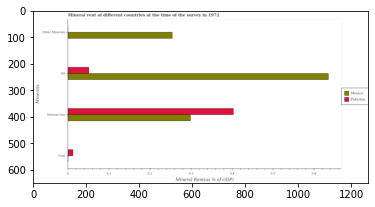

Number of QA =  29





,Minerals,Mexico,Pakistan
0,Coal,NaN,0.013658
1,Other Minerals,0.256353,NaN
2,Natural Gas,0.300261,0.406258
3,Oil,0.636641,0.052953


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the natural gas rent in pakistan and that in mexico ?
PREDICTED =  0.10599793680534558
EXPECTED =  0.10462175537190499




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the natural gas rent in mexico and the coal rent in pakistan ?
PREDICTED =  0.28660203357394737
EXPECTED =  0.28654846773235143




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the coal rent and natural gas rent in pakistan ?
PREDICTED =  0.0
EXPECTED =  -0.3911702231042564




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...


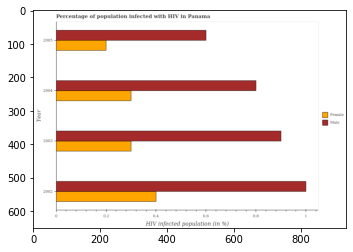

Number of QA =  28





,Year,Female,Male
0,2005,0.203434,0.598283
1,2002,0.400244,1.003863
2,2003,0.301843,0.901809
3,2004,0.300617,0.808829


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females who are infected with hiv in 2003 and that in 2004 ?
PREDICTED =  0.001226205554073101
EXPECTED =  0.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females who are infected with hiv in 2005 and the percentage of males who are infected with hiv in 2003 ?
PREDICTED =  -0.09840955015324873
EXPECTED =  -0.7




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the percentage of males who are infected with hiv and percentage of females who are infected with hiv ?
PREDICTED =  0.0
EXPECTED =  0

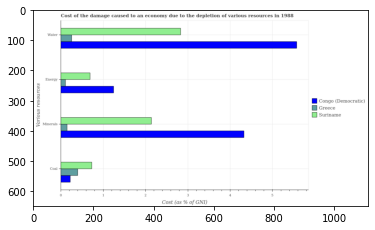

Number of QA =  29





,Various resources,Suriname,Greece,Congo (Democratic)
0,Water,2.809291,0.264389,5.550648
1,Minerals,2.125289,0.156007,4.336697
2,Coal,0.736415,0.404674,0.231363
3,Energy,0.699595,0.120384,1.260778


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of minerals in congo (democratic) and that in suriname ?
PREDICTED =  2.2114083491700582
EXPECTED =  2.186328037476




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of coal in greece and the cost of damage due to depletion of energy in congo (democratic) ?
PREDICTED =  -0.8561034890859991
EXPECTED =  -0.8490497895462672




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of coal and cost of damage due to depletion of energy in congo (democratic)

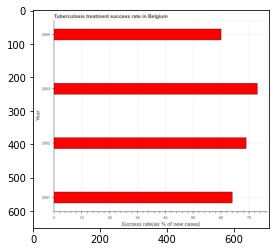

Number of QA =  23





,Year,Success rate(as % of new cases)
0,2004,60.608725
1,2001,63.916241
2,2002,69.789119
3,2003,73.434910


> what is the title of the graph ?
PREDICTED =  Tuberculosis treatment success rate in Belgium
EXPECTED =  Tuberculosis treatment success rate in Belgium




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Success rate(as % of new cases)
EXPECTED =  Success rate(as % of new cases)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the tuberculosis treatment success rate in 2002 and 2004 ?
PREDICTED =  9.180394665484144
EXPECTED =  9.0




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median tuberculosis treatment success rate ?
PREDICTED =  2002.5
EXPECTED =  66.5




				 4 / 5 = 0.8


is_built_with_cu

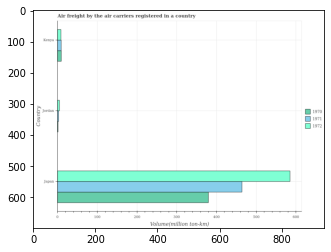

Number of QA =  29





,Country,1972,1971,1970
0,Kenya,10.073401,10.872338,11.465018
1,Jordan,6.240575,4.371241,NaN
2,Japan,585.237120,465.038115,381.199580


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the volume of the air carriers in 1971 in jordan and that in kenya ?
PREDICTED =  -6.501097336253207
EXPECTED =  -6.599999904699999




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the volume of the air carriers in 1970 in japan and the volume of the air carriers in 1972 in kenya?
PREDICTED =  369.7345624198815
EXPECTED =  371.1000061035




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the volume of the air carriers in 1972 and volume of the air carriers in 1971 in kenya ?
PREDICTED =  590.6787580309182
EXPECTED =  -0.6999998092999995




				 2 / 

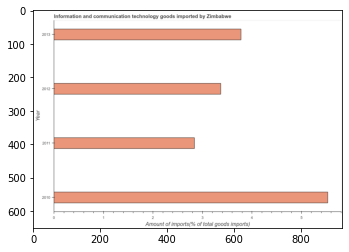

Number of QA =  23





,Year,Amount of imports(% of total goods imports)
0,2011,2.863816
1,2012,3.328770
2,2010,5.542687
3,2013,3.783873


> what is the title of the graph ?
PREDICTED =  Information and communication technology goods imported by Zimbabwe
EXPECTED =  Information and communication technology goods imported by Zimbabwe




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Amount of imports(% of total goods imports)
EXPECTED =  Amount of imports(% of total goods imports)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of ict goods imports in 2011 and 2013 ?
PREDICTED =  -0.9200566196296758
EXPECTED =  -0.941




				 4 / 4 = 1.0


> what is the median amount of ict goods imports ?
PREDICTED =  None
EXPECTED =  3.57357013245




				 4 / 6 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...

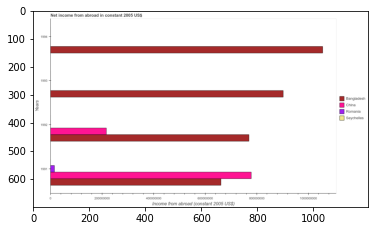

Number of QA =  25





,Years,Seychelles,China,Romania,Bangladesh
0,1994,NaN,NaN,NaN,1.053404e+09
1,1993,NaN,NaN,NaN,9.111480e+08
2,1992,NaN,2.179821e+08,NaN,7.709826e+08
3,1991,NaN,7.799211e+08,1.752915e+07,6.665681e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net income from abroad in bangladesh in 1991 and that in 1993 ?
PREDICTED =  -244579868.8316027
EXPECTED =  -241634019.15067697




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net income from abroad in seychelles in 1993 and the net income from abroad in romania in 1991 ?
PREDICTED =  -17529145.04198642
EXPECTED =  -15078947.3684211




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1991, what is the difference between the net income from abroad in romania and net income from abroad in bangladesh ?
PREDICTED =  -3384573795.871741
EXPECTED =  -645985464.328807


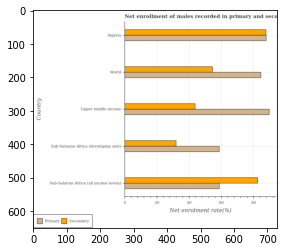

Number of QA =  28





,Country,Secondary,Primary
0,World,55.005535,85.104608
1,Algeria,88.419852,NaN
2,Upper middle income,43.782936,90.227093
3,Sub-Saharan Africa (all income levels),82.526810,59.425090
4,Sub-Saharan Africa (developing only),32.639346,59.822358


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in primary education in sub-saharan africa (all income levels) and that in world ?
PREDICTED =  0.0
EXPECTED =  -25.782




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in primary education in world and the enrollment rate in secondary education in upper middle income ?
PREDICTED =  -5.122485363472109
EXPECTED =  40.7738533020019




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the enrollment rate in primary education and enrollment rate in secondary education in world ?
PREDICTED =  5.122485363472109
EXPECTE

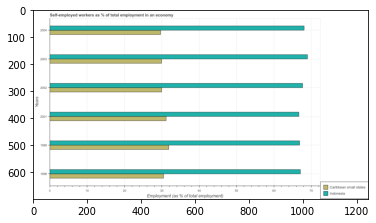

Number of QA =  28





,Years,Indonesia,Caribbean small states
0,2004,69.207356,30.139021
1,2003,69.435527,30.435217
2,2002,67.786665,30.596566
3,1998,67.442736,NaN
4,2001,67.466470,NaN
5,1999,67.661526,32.215132


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers in caribbean small states in 1998 and that in 1999 ?
PREDICTED =  0.0
EXPECTED =  -1.3987516998508909




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of self-employed workers in caribbean small states in 2004 and the percentage of self-employed workers in indonesia in 2001 ?
PREDICTED =  30.13902072815639
EXPECTED =  -37.0412267275987




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2001, what is the difference between the percentage of self-employed workers in caribbean small states and percentage of self-emplo

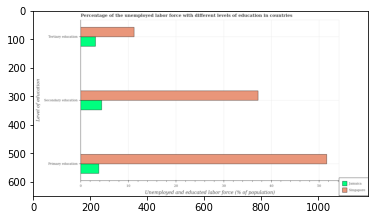

Number of QA =  28





,Level of education,Singapore,Jamaica
0,Primary education,52.100035,3.904145
1,Secondary education,37.477618,4.517206
2,Tertiary education,11.347406,3.206859


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received tertiary education in jamaica and that in singapore ?
PREDICTED =  -8.14054765369184
EXPECTED =  -8.09999990463253




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received secondary education in jamaica and the percentage of labor force who received primary education in singapore ?
PREDICTED =  -47.582829543616434
EXPECTED =  -47.19999837875367




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received tertiary education and percentage of 

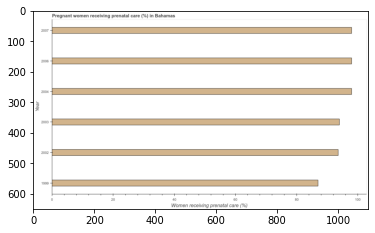

Number of QA =  23





,Year,Women receiving prenatal care (%)
0,1999,87.248858
1,2004,99.092500
2,2006,98.283513
3,2007,98.085773
4,2002,94.111416
5,2003,94.388898


> what is the title of the graph ?
PREDICTED =  Pregnant women receiving prenatal care (%) in Bahamas
EXPECTED =  Pregnant women receiving prenatal care (%) in Bahamas




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Women receiving prenatal care (%)
EXPECTED =  Women receiving prenatal care (%)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of pregnant women receiving prenatal care in 1999 and 2002 ?
PREDICTED =  -6.86255814716921
EXPECTED =  -6.6




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of pregnant women receiving prenatal care ?
PREDICTED =  2003.5
EXP

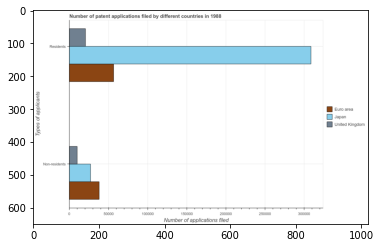

Number of QA =  23





,Types of applicants,Japan,United Kingdom,Euro area
0,Non-residents,49836.828649,19293.612852,69445.171622
1,Residents,552683.026917,38645.208480,101537.021468


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of patent applications by non residents in euro area and that in japan ?
PREDICTED =  0.0
EXPECTED =  11030




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of patent applications by residents in euro area and the number of patent applications by non residents in japan ?
PREDICTED =  -1.0
EXPECTED =  29514




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of patent applications by residents and number of patent applications by non residents in japan ?
PREDICTED =  0.0
EXPECTED =  281791




				 0 / 3 = 0.0


is_buil

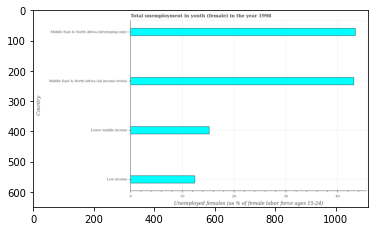

Number of QA =  22





,Country,Unemployed females (as % of female labor force ages 15-24)
0,Lower middle income,15.298401
1,Low income,12.581723
2,Middle East & North Africa (developing only),43.468416
3,Middle East & North Africa (all income levels),43.343297


> what is the title of the graph ?
PREDICTED =  Total unemployment in youth (female) in the year 1998
EXPECTED =  Total unemployment in youth (female) in the year 1998




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Unemployed females (as % of female labor force ages 15-24)
EXPECTED =  Unemployed females (as % of female labor force ages 15-24)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the unemployed female youth population in middle east & north africa (all income levels) and middle east & north africa (developing only) ?
PREDICTED =  -43.46841641780539
EXPECTED =  -0.297




				 3 / 4 = 0.75


> what is the median unemployed female youth population ?
PREDICTED =  None
EXPECTED =  29.163172637378402



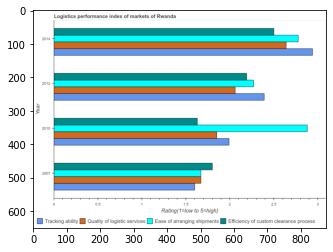

Number of QA =  30





,Year,Tracking ability,Ease of arranging shipments,Quality of logistic services,Efficiency of custom clearance process
0,2007,NaN,1.677460,NaN,1.808364
1,2014,2.907424,2.808488,2.648767,2.504034
2,2010,1.998731,2.892600,NaN,1.618264
3,2012,2.406329,2.280235,2.061566,2.197815


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lpi rating of tracking ability in 2012 and that in 2014 ?
PREDICTED =  -0.5010953877810382
EXPECTED =  -0.549




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lpi rating of tracking ability in 2012 and the lpi rating of efficiency of custom clearance process in 2010 ?
PREDICTED =  0.40759809130214175
EXPECTED =  0.7600000000000002




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2014, what is the difference between the lpi rating of ease of arranging shipments and lpi rating of tracking ability ?
PREDICTED =  0.23215896693803728
EXPECTED =  -0.163




				 0 

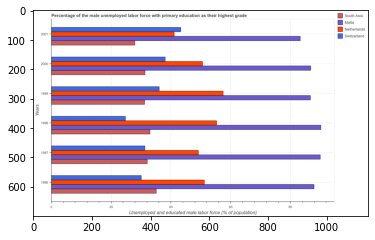

Number of QA =  30





,Years,Matta,South Asia,Switzerland,Netherlands
0,2000,87.363973,NaN,38.242486,50.743129
1,2001,83.109812,NaN,43.809712,NaN
2,1997,90.975361,NaN,31.473342,NaN
3,1999,87.196594,31.461367,36.448611,58.194038
4,1996,89.126738,NaN,30.200331,50.861049
5,1998,90.502264,NaN,NaN,56.216122


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed male labor force with primary education in south asia in 1996 and that in 1997 ?
PREDICTED =  0.0
EXPECTED =  3.012013426288398




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of the unemployed male labor force with primary education in netherlands in 1996 and the percentage of the unemployed male labor force with primary education in malta in 1998 ?
PREDICTED =  -5.35507354389496
EXPECTED =  -38.9999961853027




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the percentage of the un

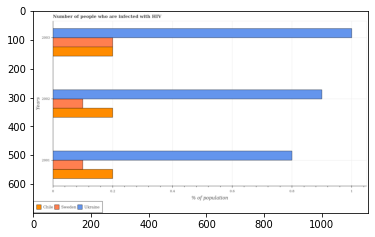

Number of QA =  29





,Years,Sweden,Chile,Ukraine
0,2003,0.201722,0.201812,1.005355
1,2001,0.101856,0.201771,0.802316
2,2002,0.101237,0.202593,0.916228


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected population in in sweden in 2001 and that in 2003 ?
PREDICTED =  -0.09986603779601815
EXPECTED =  -0.1




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of hiv infected population in in ukraine in 2001 and the percentage of hiv infected population in in chile in 2003 ?
PREDICTED =  0.6005039591975098
EXPECTED =  0.6000000000000001




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2002, what is the difference between the percentage of hiv infected population in in sweden and percentage of hiv infected population in in chile ?

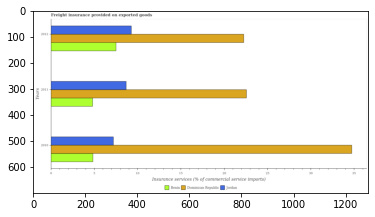

Number of QA =  29





,Years,Dominican Republic,Jordan,Benin
0,2012,22.337632,9.354294,7.553034
1,2011,22.636894,8.732478,4.910346
2,2010,35.067217,7.330497,4.893848


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the freight insurance provided on exported goods in benin in 2010 and that in 2011 ?
PREDICTED =  -0.01649841278999009
EXPECTED =  0.03284786382175042




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the freight insurance provided on exported goods in benin in 2011 and the freight insurance provided on exported goods in dominican republic in 2012 ?
PREDICTED =  -2.6426879016141083
EXPECTED =  -17.44706062990635




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the freight insurance provided on exported goods in benin and freight in

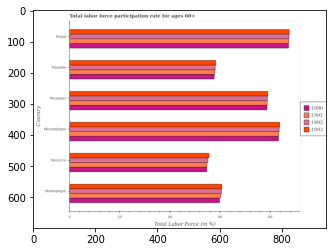

Number of QA =  30





,Country,1992,1993,1991,1990
0,Morocco,NaN,NaN,NaN,55.428926
1,Nepal,88.170088,NaN,88.237295,88.150315
2,Myanmar,79.864393,79.467728,NaN,79.080105
3,Mozambique,NaN,84.447010,84.001970,83.616729
4,Namibia,NaN,58.830745,58.070845,58.126951
5,Montenegro,61.100452,61.198250,60.991347,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in 1993 in mozambique and that in nepal ?
PREDICTED =  84.44701001964003
EXPECTED =  -3.799995422363196




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in 1992 in namibia and the labor force participation rate in 1991 in nepal?
PREDICTED =  -88.17008782225369
EXPECTED =  -29.300003051757805




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in 1993 and labor force participation rate in 1992 in montenegro ?
PREDICTED =  222.8432816692923
EXPECTED 

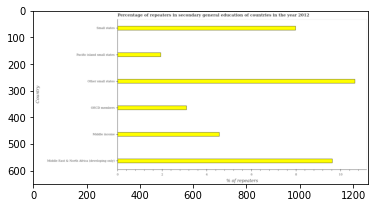

Number of QA =  22





,Country,% of repeaters
0,Middle income,4.622331
1,Pacific island small states,1.963313
2,OECD members,3.094805
3,Small states,8.007613
4,Other small states,10.675321
5,Middle East & North Africa (developing only),9.689987


> what is the title of the graph ?
PREDICTED =  Percentage of repeaters in secondary general education of countries in the year 2012
EXPECTED =  Percentage of repeaters in secondary general education of countries in the year 2012




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  % of repeaters
EXPECTED =  % of repeaters




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of repeaters in middle income and pacific island small states ?
PREDICTED =  2.6590184072378626
EXPECTED =  2.626




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of repeaters ?
PREDICTED =  6.31

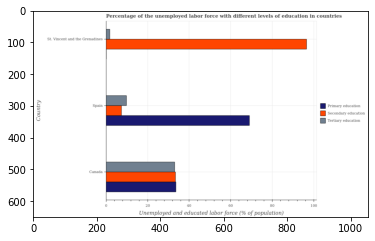

Number of QA =  29





,Country,Secondary education,Tertiary education,Primary education
0,Canada,33.852507,33.364250,34.043988
1,Spain,7.621744,9.951852,69.126131
2,St. Vincent and the Grenadines,96.721540,2.007459,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received tertiary education in canada and that in spain ?
PREDICTED =  23.412397600117593
EXPECTED =  23.2




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force who received primary education and percentage of labor force who received tertiary education in spain ?
PREDICTED =  95.54837418224014
EXPECTED =  59.2




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is

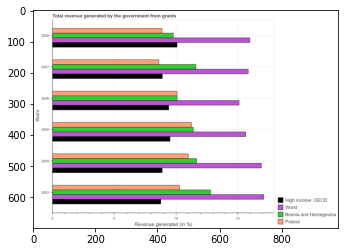

Number of QA =  30





,Years,Bosnia and Herzegovina,High income: OECD,Poland,World
0,2007,11.728281,8.950807,8.701186,15.818266
1,2008,9.902071,10.199760,8.959573,16.043574
2,2004,11.724751,8.892370,11.112646,NaN
3,2006,10.236771,9.503877,10.136590,15.036088
4,2003,12.918823,8.781256,NaN,17.218887
5,2005,11.677770,9.582149,11.365755,15.580309


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total revenue generated in high income: oecd in 2003 and that in 2004 ?
PREDICTED =  -0.11111344816134228
EXPECTED =  -0.11788176664367889




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total revenue generated in bosnia and herzegovina in 2006 and the total revenue generated in high income: oecd in 2005 ?
PREDICTED =  56.51069803363033
EXPECTED =  0.5788199214467102




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2005, what is the difference between the total revenue generated in world and total revenue generated in high income: oecd ?
PREDICTED =  23.7869

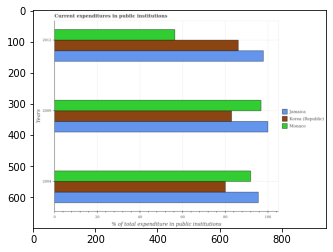

Number of QA =  29





,Years,Korea (Republic),Monaco,Jamaica
0,2012,86.701106,56.924319,98.617981
1,2009,82.770872,97.221139,101.865804
2,2004,80.915208,92.386274,95.869207


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the current expenditures in public institutions in korea (republic) in 2009 and that in 2012 ?
PREDICTED =  -3.9302337467772475
EXPECTED =  -3.1303329467773864




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the current expenditures in public institutions in jamaica in 2009 and the current expenditures in public institutions in korea (republic) in 2012 ?
PREDICTED =  3.2478230863310955
EXPECTED =  13.867858886718707




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the current expenditures in public institutions in monaco and curr

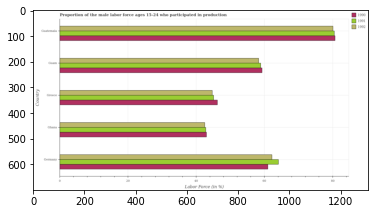

Number of QA =  29





,Country,1992,1990,1991
0,Germany,62.360653,61.367278,64.474141
1,Guam,58.376674,59.430253,59.166168
2,Ghana,42.684301,43.422287,43.159062
3,Greece,45.070102,46.477542,45.263748
4,Guatemala,80.615046,80.674115,80.963246


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male labor force who participated in production in 1990 in ghana and that in guatemala ?
PREDICTED =  -37.25182866431905
EXPECTED =  -37.6999969482422




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male labor force who participated in production in 1992 in greece and the proportion of the male labor force who participated in production in 1990 in germany?
PREDICTED =  -17.290551334319744
EXPECTED =  -16.299999237060497




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male labor for

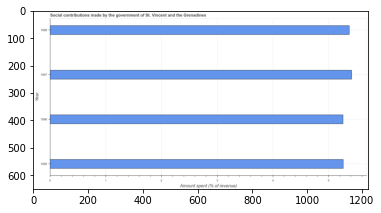

Number of QA =  23





,Year,Amount spent (% of revenue)
0,1996,5.283781
1,1997,5.414951
2,1998,5.371919
3,1995,5.290447


> what is the title of the graph ?
PREDICTED =  Social contributions made by the government of St. Vincent and the Grenadines
EXPECTED =  Social contributions made by the government of St. Vincent and the Grenadines




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Amount spent (% of revenue)
EXPECTED =  Amount spent (% of revenue)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent in making social contributions in 1995 and 1997 ?
PREDICTED =  -0.12450472256803113
EXPECTED =  -0.151




				 3 / 4 = 0.75


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median amount spent in making social contributions ?

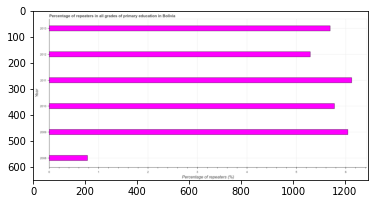

Number of QA =  23





,Year,Percentage of repeaters (%)
0,2013,5.763977
1,2012,5.301522
2,2008,0.779084
3,2010,5.785282
4,2011,6.172917
5,2009,6.084398


> what is the title of the graph ?
PREDICTED =  Percentage of repeaters in all grades of primary education in Bolivia
EXPECTED =  Percentage of repeaters in all grades of primary education in Bolivia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Percentage of repeaters (%)
EXPECTED =  Percentage of repeaters (%)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of repeaters in primary education in 2009 and 2012 ?
PREDICTED =  0.7828761852484716
EXPECTED =  0.76




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median percentage of repeaters in primary education ?
PREDICTED =  2010.

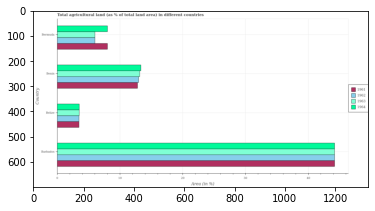

Number of QA =  30





,Country,1963,1964,1962,1961
0,Belize,3.589657,3.580667,3.578554,3.545200
1,Bermuda,6.122235,8.066437,6.050958,8.159735
2,Barbados,44.436804,44.649566,44.386757,44.452644
3,Benin,13.281579,13.438752,13.102283,12.909349


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of agricultural land in 1962 in barbados and that in belize ?
PREDICTED =  40.808203173364255
EXPECTED =  40.72265326305271




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of agricultural land in 1962 in benin and the percentage of agricultural land in 1963 in barbados?
PREDICTED =  -31.284473980843835
EXPECTED =  -31.220455876651002




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of agricultural land in 1963 and percentage of agricultural land in 1961 in benin ?
PREDICTED =  -9.319691504517959
EXPECTE

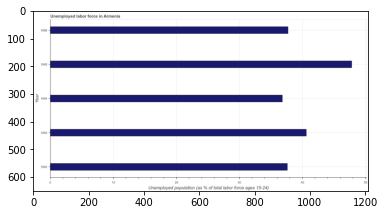

Number of QA =  23





,Year,Unemployed population (as % of total labor force ages 15-24)
0,1996,37.655287
1,1992,37.714759
2,1993,40.652242
3,1995,48.012738
4,1994,36.850326


> what is the title of the graph ?
PREDICTED =  Unemployed labor force in Armenia
EXPECTED =  Unemployed labor force in Armenia




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Unemployed population (as % of total labor force ages 15-24)
EXPECTED =  Unemployed population (as % of total labor force ages 15-24)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total unemployed youth population in 1992 and 1995 ?
PREDICTED =  -10.29797901685884
EXPECTED =  -10.2




				 4 / 4 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the median total unemployed youth population ?
PREDICTED =  1994.0
EXPECTED =  37.7000007629

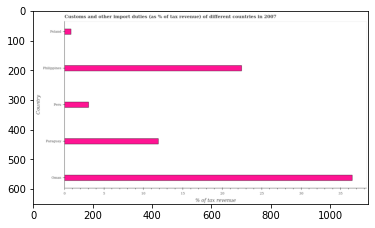

Number of QA =  22





,Country,% of tax revenue
0,NaN,3.092887
1,Oman,36.432752
2,Poland,0.872974
3,Philippines,22.467968
4,Paraguay,11.929718


> what is the title of the graph ?
PREDICTED =  Customs and other import duties (as % of tax revenue) of different countries in 2007
EXPECTED =  Customs and other import duties (as % of tax revenue) of different countries in 2007




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  % of tax revenue
EXPECTED =  % of tax revenue




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Country
EXPECTED =  Country




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 3 / 4 = 0.75


> what is the median customs and other import duties ?
PREDICTED =  None
EXPECTED =  11.891859177149




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 3 / 7 = 0.4286


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predi

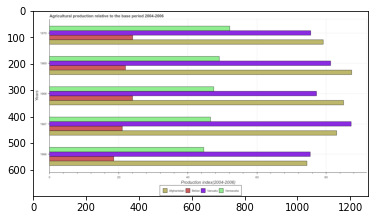

Number of QA =  30





,Years,Venezuela,Belize,Vanuatu,Afghanistan
0,1968,47.598718,24.035181,78.269966,84.398154
1,1966,44.648690,18.749496,76.021694,74.589877
2,1969,49.083489,21.850903,82.050032,86.750970
3,1970,53.113887,NaN,75.732136,79.366838
4,1967,46.299802,21.133776,87.221019,83.432537


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the agricultural production index in afghanistan in 1967 and that in 1970 ?
PREDICTED =  4.065698930658812
EXPECTED =  3.8799999999999955




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the agricultural production index in venezuela in 1970 and the agricultural production index in belize in 1969 ?
PREDICTED =  4.030398386590413
EXPECTED =  30.160000000000004




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1970, what is the difference between the agricultural production index in venezuela and agricultural production index in vanuatu ?
PREDICTED =  -26.74508211638101

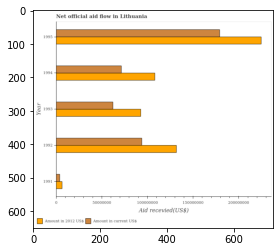

Number of QA =  28





,Year,Amount in current US$,Amount in 2012 US$
0,1993,1.121376e+08,1.684362e+08
1,1991,8.122486e+06,1.273131e+07
2,1995,3.250528e+08,4.081233e+08
3,1994,1.290152e+08,1.952931e+08
4,1992,1.693028e+08,2.366840e+08


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid received(expressed in 2012 us$) in 1991 and that in 1995 ?
PREDICTED =  -395391949.7169115
EXPECTED =  -218110000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of aid received(expressed in 2012 us$) in 1991 and the amount of aid received(expressed in us$) in 1993 ?
PREDICTED =  -155704850.09636304
EXPECTED =  -55690000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1994, what is the difference between the amount of aid received(expressed in us$) and amount of aid received(expressed in 2012 us$) ?
PREDICTED =  -408123258.3983796
EXPEC

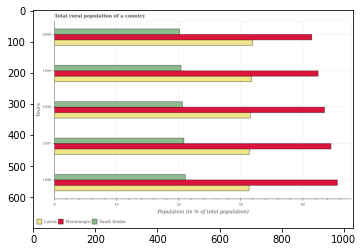

Number of QA =  29





,Years,Latvia,Saudi Arabia,Montenegro
0,1999,32.112221,NaN,42.728795
1,2000,32.328293,20.434102,41.693282
2,1996,31.953791,21.227286,45.981148
3,1997,31.955452,21.192730,44.767422
4,1998,31.779647,20.871218,43.832394


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population in latvia in 1997 and that in 2000 ?
PREDICTED =  -0.3728415435453307
EXPECTED =  -0.5330000000000013




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rural population in saudi arabia in 1998 and the rural population in montenegro in 1997 ?
PREDICTED =  -0.3215123574705032
EXPECTED =  -23.932




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the rural population in montenegro and rural population in saudi arabia ?
PREDICTED =  20.76194774734144
EXPECTED =  22.895




				 0 / 3 = 0.0


is_built_with_cuda: T

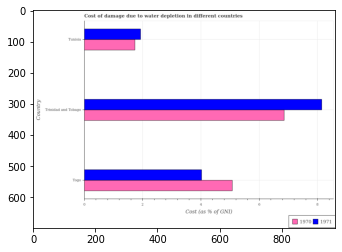

Number of QA =  28





,Country,1971,1970
0,Tunisia,1.970496,1.764104
1,Trinidad and Tobago,8.164799,6.906586
2,Togo,4.065048,5.189513


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to water depletion in 1971 in trinidad and tobago and that in tunisia ?
PREDICTED =  6.194303068015591
EXPECTED =  6.21415935759401




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to water depletion in 1970 in trinidad and tobago and the cost of damage caused due to water depletion in 1971 in togo?
PREDICTED =  2.8415381241969424
EXPECTED =  2.83178130830147




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to water depletion in 1970 and cost of damage caused 

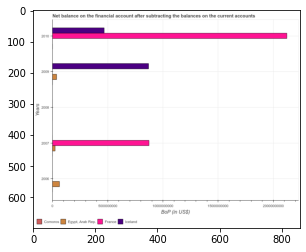

Number of QA =  27





,Years,Iceland,"Egypt, Arab Rep.",Comoros,France
0,2006,NaN,1.257640e+09,NaN,NaN
1,2008,NaN,NaN,NaN,NaN
2,2007,NaN,5.485537e+08,NaN,1.582327e+10
3,2009,1.571269e+10,7.736011e+08,NaN,NaN
4,2010,8.551614e+09,NaN,NaN,3.825099e+10


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the balance of payments in comoros in 2010 and the balance of payments in egypt, arab rep. in 2006 ?
PREDICTED =  5971819166.215485
EXPECTED =  -629982627.581




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the balance of payments in egypt, arab rep. in 2006 to that in 2007 ?
PREDICTED =  2.2926469631512965
EXPECTED =  2.6546521374685668




				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_

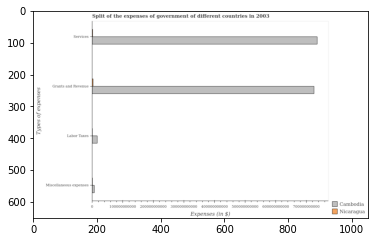

Number of QA =  29





,Types of expenses,Cambodia,Nicaragua
0,Services,7.423204e+11,NaN
1,Grants and Revenue,7.368802e+11,NaN
2,Labor Taxes,1.861159e+10,NaN
3,Miscellaneous expenses,9.014368e+09,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on grants and revenue in nicaragua and that in cambodia ?
PREDICTED =  -736880172983.5638
EXPECTED =  -722421730302.04




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on miscellaneous expenses in nicaragua and the amount spent on labor taxes in cambodia ?
PREDICTED =  -9014368040.261715
EXPECTED =  -16013917870.0




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount spent on miscellaneous expenses and amount spent on labor taxes in nicaragua ?
PREDICTED =  9014368040.261715
EXPECTED =  287266100.0




				 1

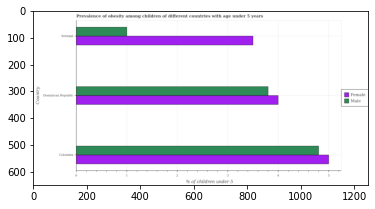

Number of QA =  28





,Country,Female,Male
0,Colombia,5.046893,4.812522
1,Senegal,3.515724,1.030484
2,Dominican Republic,3.997233,3.817747


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of obese male children in dominican republic and the percentage of obese female children in colombia ?
PREDICTED =  -0.9947751371661875
EXPECTED =  -1.2000000476837198




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of obese male children and percentage of obese female children in senegal ?
PREDICTED =  0.0
EXPECTED =  -2.5




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the 

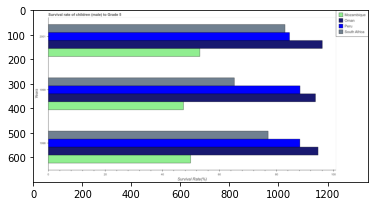

Number of QA =  30





,Years,South Africa,Mozambique,Peru,Oman
0,1999,65.371266,47.898896,88.115086,94.243752
1,2001,83.403310,53.523237,84.854644,96.751851
2,1998,77.757957,50.291487,88.736188,94.511135


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the survival rate of male children to grade 5 in mozambique in 1998 and that in 1999 ?
PREDICTED =  2.3925916203236284
EXPECTED =  2.4994508178711




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the survival rate of male children to grade 5 in peru in 1998 and the survival rate of male children to grade 5 in oman in 1999 ?
PREDICTED =  0.6211013517426238
EXPECTED =  -5.4760371459959885




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1998, what is the difference between the survival rate of male children to grade 5 in south africa and survival rate of male children 

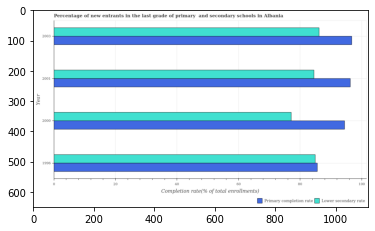

Number of QA =  28





,Year,Primary completion rate,Lower secondary rate
0,2001,96.404834,85.156690
1,1996,86.714848,86.050954
2,2000,95.484042,77.515502
3,2003,96.013518,86.743061


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the completion rate in secondary schools in 2000 and that in 2001 ?
PREDICTED =  -18.889332299048547
EXPECTED =  -7.392




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the completion rate in secondary schools in 1996 and the completion rate in primary schools in 2001 ?
PREDICTED =  -10.35387990573797
EXPECTED =  -11.388156984863272




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1996, what is the difference between the completion rate in secondary schools and completion rate in primary schools ?
PREDICTED =  161.54587128938422
EXPECTED =  -0.675




				 0 / 3 = 0.

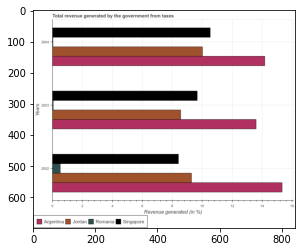

Number of QA =  30





,Years,Singapore,Jordan,Romania,Argentina
0,2003,9.743142,8.631335,NaN,13.612103
1,2004,10.628027,10.091285,NaN,14.335225
2,2002,8.477645,9.362773,0.562339,15.467866


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total revenue generated in jordan in 2003 and that in 2004 ?
PREDICTED =  -1.4599499466426948
EXPECTED =  -1.4576026101343693




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total revenue generated in romania in 2004 and the total revenue generated in jordan in 2003 ?
PREDICTED =  0.5623388406078667
EXPECTED =  -8.527305982433095




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2004, what is the difference between the total revenue generated in romania and total revenue generated in jordan ?
PREDICTED =  -27.085393481410748
EXPECTED =  -9.984908592567464





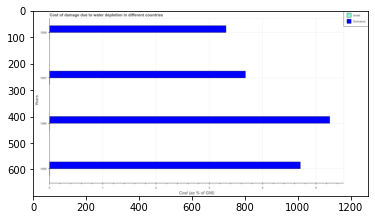

Number of QA =  28





,Years,Israel,Suriname
0,1998,NaN,3.311791
1,1995,NaN,4.729484
2,1997,NaN,3.674377
3,1996,NaN,5.252405


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage caused due to water depletion in suriname in 1995 and that in 1998 ?
PREDICTED =  1.4176929879586293
EXPECTED =  1.39603025495235




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cost of damage caused due to water depletion in suriname in 1995 to that in 1996 ?
PREDICTED =  0.20036286723833732
EXPECTED =  0.8950749048326606




				 1 / 4 = 0.25


is_built_with_cuda: 

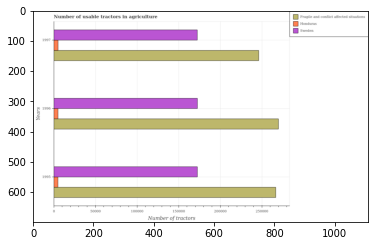

Number of QA =  29





,Years,Fragile and conflict affected situations,Sweden,Honduras
0,1995,480223.109036,311762.079762,10413.517553
1,1997,444751.371249,312185.962534,10842.961746
2,1996,486717.558113,311943.306376,10635.959418


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of usable tractors in agriculture in sweden in 1996 and that in 1997 ?
PREDICTED =  -242.65615811094176
EXPECTED =  100.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of usable tractors in agriculture in honduras in 1996 and the number of usable tractors in agriculture in fragile and conflict affected situations in 1995 ?
PREDICTED =  222.44186502909906
EXPECTED =  -261622.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1995, what is the difference between the number of usable tractors in agriculture in fragile and conflict affected situa

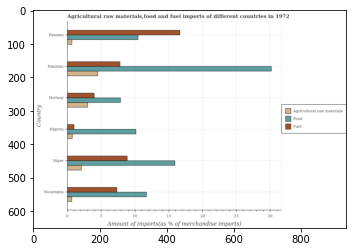

Number of QA =  29





,Country,Agricultural raw materials,Fuel,Food
0,Niger,2.143735,8.835843,15.969856
1,Norway,3.041795,4.042394,8.004636
2,Nigeria,0.808141,1.062171,10.072245
3,Pakistan,4.553919,7.736210,30.387053
4,Nicaragua,0.700993,7.389117,11.623736
5,Panama,0.764777,16.676289,10.439425


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of food imports in nicaragua and that in panama ?
PREDICTED =  1.1843108704829692
EXPECTED =  1.223




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of fuel imports in norway and the percentage of raw materials imports in nicaragua ?
PREDICTED =  -3.3467231617511004
EXPECTED =  3.3236762854650372




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of food imports and percentage of raw materials imports in panama ?
PREDICTED =  47.54121961110981
EXPECTED =  9.786




				 1 / 3 = 0.3333


is_built_with_cuda:

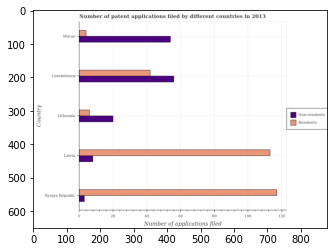

Number of QA =  28





,Country,Non-residents,Residents
0,Macao,54.625500,4.483767
1,Latvia,8.536557,114.370926
2,Luxembourg,56.422315,42.707770
3,Lithuania,20.585141,6.526127
4,Kyrgyz Republic,3.494451,117.348430


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of patent applications by residents in latvia and that in luxembourg ?
PREDICTED =  113.3709260510753
EXPECTED =  71




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of patent applications by residents in kyrgyz republic and the number of patent applications by non residents in macao ?
PREDICTED =  4.0
EXPECTED =  63




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the number of patent applications by non residents and number of patent applications by residents in latvia ?
PREDICTED =  4.0
EXPECTED =  -105




				 0 / 3 = 0.0

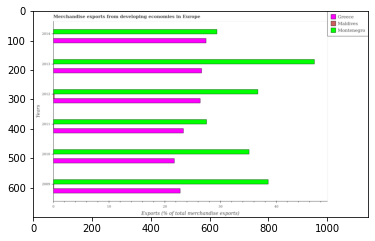

Number of QA =  29





,Years,Greece,Maldives,Montenegro
0,2010,NaN,NaN,NaN
1,2014,27.471683,NaN,29.609143
2,2009,NaN,NaN,38.806597
3,2013,26.858967,NaN,46.920003
4,2011,23.564174,NaN,27.105713
5,2012,26.641394,NaN,36.391276


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total merchandise exports in maldives in 2010 and that in 2014 ?
PREDICTED =  0.0
EXPECTED =  0.014507137190847211




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of total merchandise exports in montenegro in 2010 and the percentage of total merchandise exports in maldives in 2011 ?
PREDICTED =  -27.105713454534694
EXPECTED =  35.063258890457014




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2010, what is the difference between the percentage of total merchandise exports in montenegro and percentage of total merchandise exports in 

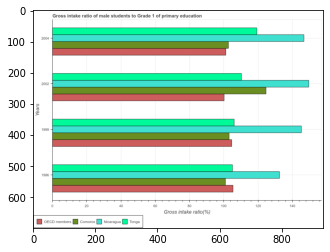

Number of QA =  30





,Years,OECD members,Comoros,Nicaragua,Tonga
0,2004,102.118177,103.208480,148.362121,119.654506
1,1986,106.379626,102.875095,133.816211,105.561015
2,1999,105.436175,103.378670,146.225743,106.263911
3,2002,100.736434,125.528432,151.796987,111.569173


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the gross intake ratio in nicaragua in 1999 ?
PREDICTED =  1.4105249780591773
EXPECTED =  145.291793823242




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all years, what is the minimum gross intake ratio in comoros ?
PREDICTED =  19.157383239822575
EXPECTED =  100.95711




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in which year was the gross intake ratio in nicaragua maximum?
PREDICTED =  19.311722681835246
EXPECTED =  2002




				 0 / 4 = 0.0


is_built_with_cuda: T

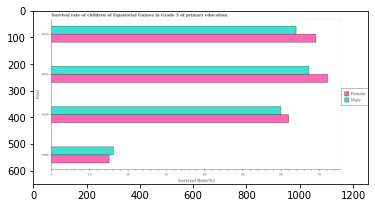

Number of QA =  28





,Year,Female,Male
0,2008,62.502215,60.737188
1,1994,15.355478,16.456080
2,2009,72.624086,68.210936
3,2010,69.753312,64.875997


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the survival rate of male students in primary education in 2008 and that in 2009 ?
PREDICTED =  -7.473747719223503
EXPECTED =  -7.337




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the survival rate of female students in primary education in 2010 and the survival rate of male students in primary education in 2008 ?
PREDICTED =  7.2510966354490805
EXPECTED =  9.150283813476491




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the survival rate of female students in primary education and survival rate of male students in primary ed

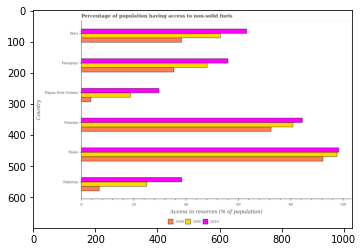

Number of QA =  29





,Country,2000,1990,2010
0,Panama,81.537431,72.684436,84.939339
1,Palau,NaN,NaN,99.181415
2,NaN,53.883157,38.311054,NaN
3,Pakistan,NaN,7.103248,38.624757
4,Papua New Guinea,19.034518,3.817102,30.088991
5,Paraguay,NaN,NaN,56.348536


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population having access to non-solid fuels in 2000 in papua new guinea and that in paraguay ?
PREDICTED =  18.034518478715285
EXPECTED =  -29.32136654853821




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population having access to non-solid fuels in 2010 in palau and the percentage of population having access to non-solid fuels in 1990 in paraguay?
PREDICTED =  42.832878783455385
EXPECTED =  62.987446971237596




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population having access to non-s

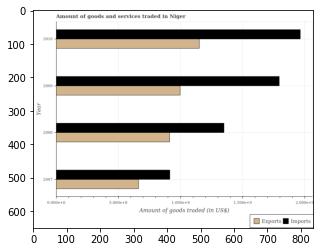

Number of QA =  28





,Year,Imports,Exports
0,2007,16.435976,12.026570
1,2010,35.462360,20.836021
2,2008,24.435319,16.480903
3,2009,32.451854,18.214891


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods imported in 2007 and that in 2010 ?
PREDICTED =  -19.026384127416726
EXPECTED =  -1048621040.4




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of goods imported in 2008 and the amount of goods exported in 2009 ?
PREDICTED =  -8.016534908846129
EXPECTED =  352424052.9




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2008, what is the difference between the amount of goods imported and amount of goods exported ?
PREDICTED =  -32.09602418680189
EXPECTED =  437120818.7




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False

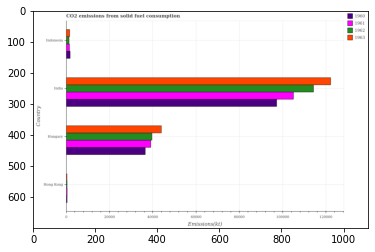

Number of QA =  30





,Country,1963,1962,1961,1960
0,Indonesia,1799.322136,1538.395216,1810.679328,2087.706065
1,India,123392.375904,114962.728501,105793.545538,98606.008719
2,Hong Kong,556.126927,NaN,657.103971,NaN
3,Hungary,44163.865542,40095.192739,39835.707215,36960.340121


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in 1963 in hong kong and that in hungary ?
PREDICTED =  -43607.73861500396
EXPECTED =  -43589.629




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in 1961 in india and the amount of co2 emitted in 1963 in indonesia?
PREDICTED =  103982.86620998583
EXPECTED =  103361.72899999999




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of co2 emitted in 1963 and amount of co2 emitted in 1961 in hungary ?
PREDICTED =  83556.66868909991
EXPECTED =  4891.778000000006




				 2 / 3 = 0.6667


is_bui

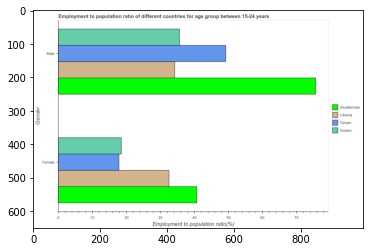

Number of QA =  23





,Gender,Sudan,Liberia,Oman,Guatemala
0,Male,35.515468,34.560628,49.086682,75.100720
1,Female,18.525118,32.713895,17.929550,41.111938


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum employment to population ratio(female) ?
PREDICTED =  1.0
EXPECTED =  17.7999992370605




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation f

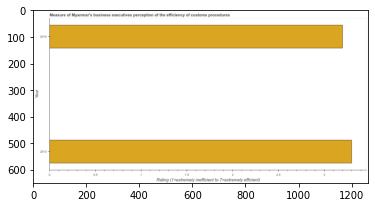

Number of QA =  19





,Year,Rating (1=extremely inefficient to 7=extremely efficient)
0,2013,3.287445
1,2014,3.222380


> what is the title of the graph ?
PREDICTED =  Measure of Myanmar’s business executives perception of the efficiency of customs procedures
EXPECTED =  Measure of Myanmar's business executives perception of the efficiency of customs procedures




				 0 / 1 = 0.0


> what is the label or title of the x-axis ?
PREDICTED =  Rating (1=extremely inefficient to 7=extremely efficient)
EXPECTED =  Rating (1=extremely inefficient to 7=extremely efficient)




				 1 / 2 = 0.5


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 2 / 3 = 0.6667


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the rating measuring burden of customs procedure in 2013 and 2014 ?
PREDICTED =  0.06506539762189201
EXPECTED =  0.1




				 2 / 4 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after t

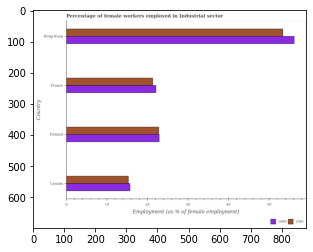

Number of QA =  28





,Country,1980,1981
0,Finland,23.193376,22.954491
1,Canada,16.003923,15.501219
2,France,22.312880,21.710562
3,Hong Kong,57.231992,54.021961


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females employed in industrial sector in 1980 in canada and that in hong kong ?
PREDICTED =  -41.22806945742704
EXPECTED =  -40.5000009536744




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females employed in industrial sector in 1980 in hong kong and the percentage of females employed in industrial sector in 1981 in finland?
PREDICTED =  34.277501529376224
EXPECTED =  33.400001525879006




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of females employed in industrial sector in 1981 and percenta

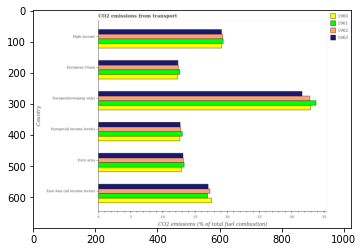

Number of QA =  30





,Country,1963,1962,1961,1960
0,Euro area,13.261356,13.330909,13.383275,12.996626
1,East Asia (all income levels),17.155686,17.315107,17.014816,17.655946
2,Europe(developing only),31.790238,32.814467,33.804854,32.976926
3,Europe(all income levels),12.836590,NaN,13.085529,12.788608
4,European Union,12.459323,12.467668,12.701814,12.458968
5,High income,19.315417,19.254489,19.495951,NaN


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1962 in euro area and that in europe(all income levels) ?
PREDICTED =  0.0
EXPECTED =  0.4050684337311008




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1961 in europe(all income levels) and the total co2 emitted in 1960 in european union?
PREDICTED =  -12.701813626804668
EXPECTED =  0.7177854011200111




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the total co2 emitted in 1963 and total co2 emitted in 1962 in european union ?
PREDICTED =  94.35094231775336
EXPECTED =  -0.08113025412420072




	

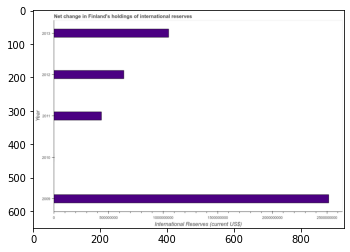

Number of QA =  21





,Year,International Reserves (current US$)
0,2013,1.905466e+09
1,2012,1.151200e+09
2,2010,NaN
3,2011,7.971578e+08
4,2009,4.514033e+09


> what is the title of the graph ?
PREDICTED =  Net change in Finland's holdings of international reserves
EXPECTED =  Net change in Finland's holdings of international reserves




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  International Reserves (current US$)
EXPECTED =  International Reserves (current US$)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 3 / 4 = 0.75


> what is the median reserves and related items ?
PREDICTED =  None
EXPECTED =  639912279.7




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the reserves and related items in 2009 to that in 2011?
PREDICTED =  5.662659794744726
EXPECTED =  5.78

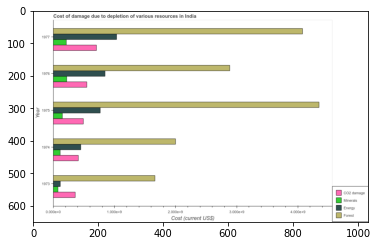

Number of QA =  30





,Year,Minerals,Forest,Energy,CO2 damage
0,1977,0.221093,4.090018,1.044865,0.729560
1,1974,0.120246,2.005265,0.462173,0.419647
2,1973,0.083629,1.681669,0.123883,0.366841
3,1975,0.158928,4.356891,0.776709,0.500674
4,1976,0.230056,2.874425,0.846920,0.559248


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of minerals in 1975 and that in 1976 ?
PREDICTED =  -0.058574555496370584
EXPECTED =  -71809877.169




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cost of damage due to depletion of coal in 1974 and the cost of damage due to depletion of minerals in 1977 ?
PREDICTED =  -0.30991281839338247
EXPECTED =  196451276.851861




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1975, what is the difference between the cost of damage due to depletion of coal and cost of damage due to depletion of forests ?
PREDICTED =  0.3627193313285186


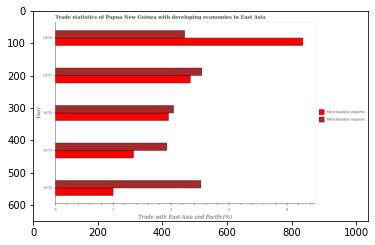

Number of QA =  28





,Year,Merchandise imports,Merchandise exports
0,1976,2.064889,1.971814
1,1974,2.538969,1.004846
2,1975,1.943787,1.355785
3,1978,2.267010,4.269172
4,1977,2.542213,2.346684


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in 1976 and that in 1978 ?
PREDICTED =  -2.2973576613861
EXPECTED =  -2.32




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise imports in 1974 and the merchandise exports in 1977 ?
PREDICTED =  -0.003243874000395053
EXPECTED =  0.1793149605210198




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1977, what is the difference between the merchandise imports and merchandise exports ?
PREDICTED =  -1.9977979818515603
EXPECTED =  0.197




				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predic

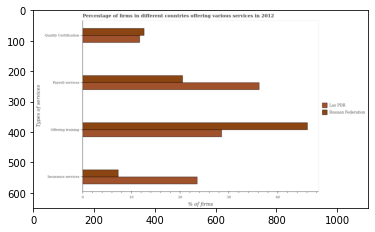

Number of QA =  29





,Types of services,Russian Federation,Lao PDR
0,Payroll services,20.737370,36.473730
1,Offering training,46.418593,28.735773
2,Quality Certification,12.801899,11.811172
3,Insurance services,7.387093,24.056290


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the percentage of firms offering quality certification in russian federation ?
PREDICTED =  3.200474729404479
EXPECTED =  12.6




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of firms offering quality certification in russian federation and that in lao pdr ?
PREDICTED =  0.25
EXPECTED =  0.9000000000000004




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of firms offering training in lao pdr and the percentage of firms offering insurance services in russian federation ?
PREDICTED =  0.25
EXPECTED =  21.2




				 0 / 3 = 0.0


is_built_with

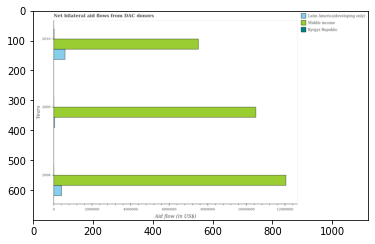

Number of QA =  29





,Years,Kyrgyz Republic,Latin America(developing only),Middle income
0,2010,NaN,622634.938352,7.679256e+06
1,2008,NaN,437736.661588,1.217618e+07
2,2009,NaN,75651.366337,1.060845e+07


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in middle income in 2009 and that in 2010 ?
PREDICTED =  2929194.128736251
EXPECTED =  2980000




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the net bilateral aid flow in latin america(developing only) in 2009 and the net bilateral aid flow in middle income in 2008 ?
PREDICTED =  -362085.2952513216
EXPECTED =  -12000000




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the ne

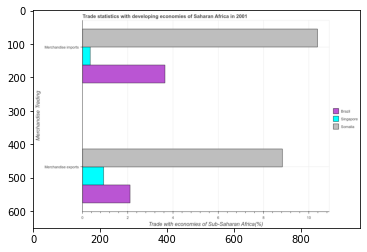

Number of QA =  23





,Merchandise Trading,Singapore,Somalia,Brazil
0,Merchandise imports,0.373189,10.456257,3.686243
1,Merchandise exports,0.968132,8.874224,2.165593


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the merchandise exports in brazil and the merchandise imports in somalia ?
PREDICTED =  -6.708631522242201
EXPECTED =  -8.28469084666276




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the merchandise imports in somalia to that in singapore ?
PREDICTED =  28.018654622538257
EXPECTED =  30.615123056577236




				 0 / 4 = 0.0


> what is the difference between two consecutive major ticks on th

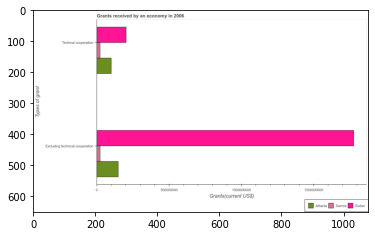

Number of QA =  23





,Types of grant,Albania,Samoa,Sudan
0,Techinal cooperation,1.856208e+08,4.824440e+07,3.749827e+08
1,Excluding technical cooperation,2.719731e+08,4.852396e+07,3.204811e+09


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the amount of grants received(excluding technical cooperation) in sudan ?
PREDICTED =  2.0
EXPECTED =  1777200000




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the maximum amount of grants received(excluding technical cooperation) ?
PREDICTED =  1.0
EXPECTED =  1777200000




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> across all countries, what is the minimum amount of grants received(excluding technical cooperation) ?
PREDICTED =  2.0
EXPECTED =  22490000




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training 

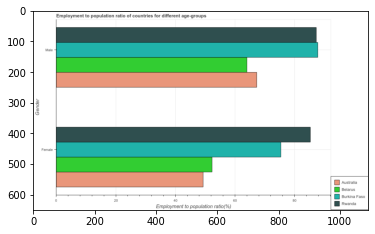

Number of QA =  23





,Gender,Rwanda,Belarus,Australia,Burkina Faso
0,Male,87.109895,64.499618,67.323412,87.707956
1,Female,87.271882,52.209954,49.532371,76.140575


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 4 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 5 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the total employment to population ratio(male) in the graph ?
PREDICTED =  2.0018595688

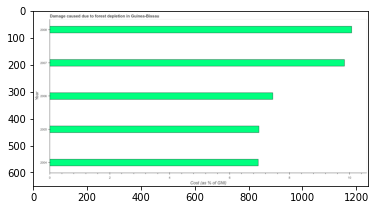

Number of QA =  23





,Year,Cost (as % of GNI)
0,2008,10.115568
1,2007,9.840265
2,2005,6.952917
3,2004,6.963790
4,2006,7.436097


> what is the title of the graph ?
PREDICTED =  Damage caused due to forest depletion in Guinea-Bissau
EXPECTED =  Damage caused due to forest depletion in Guinea-Bissau




				 1 / 1 = 1.0


> what is the label or title of the x-axis ?
PREDICTED =  Cost (as % of GNI)
EXPECTED =  Cost (as % of GNI)




				 2 / 2 = 1.0


> what is the label or title of the y-axis ?
PREDICTED =  Year
EXPECTED =  Year




				 3 / 3 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the damage caused due to forest depletion in 2004 and 2005 ?
PREDICTED =  0.010872205266586832
EXPECTED =  -0.024




				 3 / 4 = 0.75


> what is the median damage caused due to forest depletion ?
PREDICTED =  None
EXPECTED =  7.44269566118232




				 3 / 6 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> wha

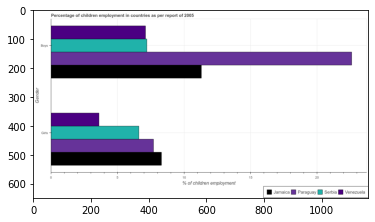

Number of QA =  23





,Gender,Serbia,Venezuela,Jamaica,Paraguay
0,NaN,7.264579,7.166353,11.325544,22.736478
1,Girls,6.689532,3.609948,NaN,7.803804


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the percentage of employed girls in serbia to that in paraguay ?
PREDICTED =  0.8572142959004232
EXPECTED =  0.8571428571428571




				 1 / 4 = 0.25


> what is the difference between two consecutive major ticks on the x-axis ?
PREDICTED =  % of children employment
EXPECTED =  5.0




				 1 / 5 = 0.2


> what is the title of the graph ?
PREDICTED =  Percentage of children emplo

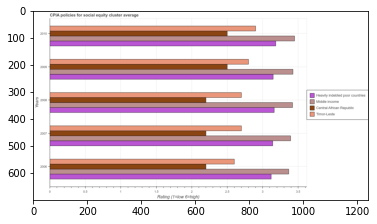

Number of QA =  30





,Years,Central African Republic,Timor-Leste,Heavily indebted poor countries,Middle income
0,2009,2.480727,NaN,3.135850,3.463809
1,2008,2.209206,2.711425,3.190288,3.409882
2,2010,2.485608,2.907242,3.174546,3.460838
3,2007,2.198049,2.708889,3.161835,3.386338
4,2006,2.181710,2.603621,3.130828,3.348238


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the cpia rating in middle income in 2007 and that in 2009 ?
PREDICTED =  -0.07747170009443005
EXPECTED =  -0.032913590968300266




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2007, what is the difference between the cpia rating in heavily indebted poor countries and cpia rating in central african republic ?
PREDICTED =  1.0
EXPECTED =  0.94166666666667




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the ratio of the cpia rating in midd

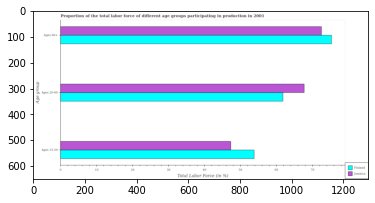

Number of QA =  28





,Age group,Finland,Jamaica
0,Ages 60+,75.067716,72.478878
1,Ages 20-60,61.834151,67.822804
2,Ages 15-20,53.846291,47.457333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force within the age group 15-20 in jamaica and that in finland ?
PREDICTED =  -6.3889571293401985
EXPECTED =  -6.5




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of labor force within the age group 20-60 in jamaica and the percentage of labor force above age 60 in finland ?
PREDICTED =  5.9886530405991465
EXPECTED =  -7.600006103515597




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.







				 1 / 3 = 0.3333


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





>

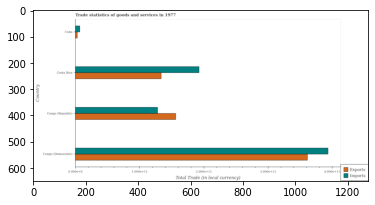

Number of QA =  28





,Country,Imports,Exports
0,Cuba,0.078159,0.038234
1,Costa Rica,1.908144,1.344025
2,Congo (Democratic),3.940318,3.649509
3,Congo (Republic),1.286266,1.545759


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the imports of goods and services in congo (democratic) and that in costa rica ?
PREDICTED =  -2.846071891237947
EXPECTED =  200897085500.0




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the imports of goods and services in costa rica and the export of goods and services in congo (democratic) ?
PREDICTED =  -2.846071891237947
EXPECTED =  -168769678300.0




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the imports of goods and services and export of goods and services in congo (republic) ?
PREDICTED =  -1.208106803196084
EXPECTED =  -28207796800.0

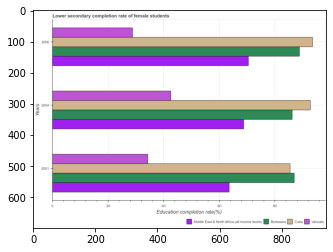

Number of QA =  30





,Years,Unnamed: 1,Botswana,Vanuatu,Middle East & North Africa (all income levels)
0,2006,93.415543,88.431502,29.377362,70.393078
1,2004,92.423236,86.209328,42.626685,68.418505
2,2001,85.750040,87.493870,34.529703,63.697513


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lower secondary completion rate of female students in botswana in 2001 and that in 2006 ?
PREDICTED =  -0.9376314765528235
EXPECTED =  -1.8706283569335938




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the lower secondary completion rate of female students in botswana in 2004 and the lower secondary completion rate of female students in vanuatu in 2006 ?
PREDICTED =  -2.222173727488112
EXPECTED =  57.38872337341309




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 2006, what is the difference between the lower secondary completion rate of female students in vanu

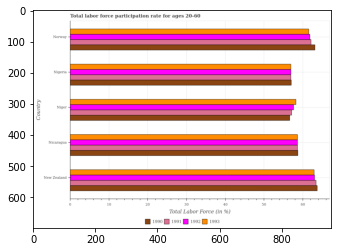

Number of QA =  30





,Country,1992,1993,1991,1990
0,Norway,61.836330,61.869249,62.295524,63.196198
1,Nigeria,57.686794,57.131563,57.298388,57.476235
2,Niger,58.096586,58.483148,57.261812,57.148312
3,New Zealand,63.339716,63.594836,63.493102,63.697782
4,Nicaragua,58.953032,58.827344,59.134052,59.559274


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in 1993 in nicaragua and that in niger ?
PREDICTED =  0.3441953278929262
EXPECTED =  0.399997711181598




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in 1990 in niger and the labor force participation rate in 1993 in new zealand?
PREDICTED =  -6.549470413301876
EXPECTED =  -6.300003051757798




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the labor force participation rate in 1993 and labor force participation rate in 1990 in nicaragua ?
PREDICTED =  -2.42771137124835
EXPECTED

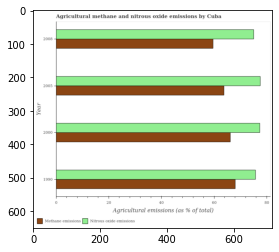

Number of QA =  28





,Year,Nitrous oxide emissions,Methane emissions
0,2008,75.931629,NaN
1,2000,77.838553,66.724498
2,1990,76.765745,68.494861
3,2005,78.436843,64.534162


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of nitrous oxide emissions in 1990 and that in 2000 ?
PREDICTED =  -1.0728073524018384
EXPECTED =  -1.629




				 0 / 1 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the amount of methane emissions in 2000 and the amount of nitrous oxide emissions in 2005 ?
PREDICTED =  2.1903360781101213
EXPECTED =  -11.387161329672281




				 0 / 2 = 0.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> in the year 1990, what is the difference between the amount of nitrous oxide emissions and amount of methane emissions ?
PREDICTED =  0.0
EXPECTED =  7.716




				 0 / 3 = 0.0


is_built_with_cuda: True
is_gpu_ava

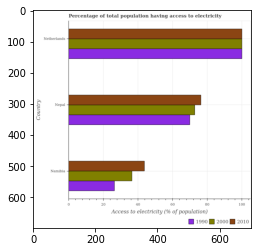

Number of QA =  29





,Country,2000,1990,2010
0,Namibia,36.946655,26.878184,44.368833
1,Netherlands,100.837848,101.128083,100.908347
2,Nepal,73.252950,70.780388,76.815842


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population that have access to electricity in 2000 in nepal and that in netherlands ?
PREDICTED =  -27.584897202917986
EXPECTED =  -27.244150000000005




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population that have access to electricity in 1990 in namibia and the percentage of population that have access to electricity in 2000 in nepal?
PREDICTED =  -43.90220383845015
EXPECTED =  -46.35585




				 1 / 2 = 0.5


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the percentage of population that have access to electricity in 1990 a

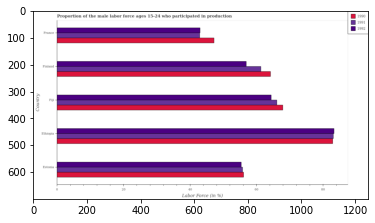

Number of QA =  29





,Country,1992,1990,1991
0,Finland,57.572224,64.179759,60.459705
1,Fiji,64.893661,68.001145,66.409030
2,Estonia,55.685037,56.414947,55.947046
3,France,43.404366,47.324954,43.137721
4,Ethiopia,83.379870,83.047718,83.299397


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male labor force who participated in production in 1990 in estonia and that in france ?
PREDICTED =  9.089993025755632
EXPECTED =  8.899997711181598




				 1 / 1 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male labor force who participated in production in 1992 in estonia and the proportion of the male labor force who participated in production in 1990 in ethiopia?
PREDICTED =  -27.694832857925007
EXPECTED =  -27.500000000000007




				 2 / 2 = 1.0


is_built_with_cuda: True
is_gpu_available: False
GPUs: []
Training or predicting ...
Evaluation finished after training step 0.





> what is the difference between the proportion of the male labor for

In [ ]:
# IMAGE_IDs = list(map(str, plot_types["hbar_categorical"][:5]))
# NO_CSV = 2

# IMAGE_IDs = []
# files = random.sample(csvs, NO_CSV)
# for f in files:
#   w = f.split("/content/final_csv/")[-1]
#   IMAGE_IDs.append(w.split(".csv")[0])

per_img_data_h = []
IMG_COUNT = 0
for TEST_IMG in h_IMAGE_IDs:

  TOTAL_QA = 0
  TOTAL_CORRECT_QA = 0
  
  IMG_COUNT += 1
  print("Image number = ", IMG_COUNT)
  print("\n\n")
  
  IMAGE_ID = TEST_IMG

  ind, plotqa_questions, plotqa_answers = display_image_qa_pairs(IMAGE_ID)

  df = pd.read_csv('/home/pessat/Capstone/plotqa/TEST/final_csv/' + IMAGE_ID + '.csv')
  

  dic_labels = dict()
  for col in df.columns:
    if col == 'xlabel':
      dic_labels['xlabel'] = df['xlabel'].iloc[-1].strip()
    elif col == 'ylabel':
      dic_labels['ylabel'] = df['ylabel'].iloc[-1].strip()
    elif col == 'title':
      dic_labels['title'] = df['title'].iloc[-1].strip()
  

  df.drop(axis = 1 , labels = ['Unknown' , 'xlabel' , 'ylabel' ,'title' , 'legend orientation'] , inplace= True, errors = 'ignore')
  columns = list(df.columns)

  display(df)

  data = get_list_of_list('/home/pessat/Capstone/plotqa/TEST/final_csv/' + IMAGE_ID + '.csv', False)

  question_answer = dict()
  for i, q in enumerate(plotqa_questions):
      question_answer[q.lower()] = plotqa_answers[i]

  questions = plotqa_questions    

  tapas_questions, tabfact_questions = binary_classifier_predict(questions)
  tapas_find_answers(tapas_questions, columns, data, question_answer, dic_labels)
  tabfact_find_answers(data, tabfact_questions, columns, question_answer) 

  ACCURACY = round(TOTAL_CORRECT_QA * 100 / TOTAL_QA, 4)
  per_img_data_h.append([TEST_IMG, TOTAL_CORRECT_QA, TOTAL_QA, ACCURACY])

In [ ]:
per_img_data_h

[['16745', 14, 24, 58.3333],
 ['14717', 15, 29, 51.7241],
 ['16783', 16, 23, 69.5652],
 ['12281', 16, 29, 55.1724],
 ['11130', 4, 12, 33.3333],
 ['16409', 14, 22, 63.6364],
 ['13748', 9, 24, 37.5],
 ['12386', 5, 12, 41.6667],
 ['10333', 8, 28, 28.5714],
 ['6291', 8, 28, 28.5714],
 ['10787', 4, 17, 23.5294],
 ['15752', 15, 23, 65.2174],
 ['15804', 10, 24, 41.6667],
 ['15381', 14, 24, 58.3333],
 ['11279', 6, 12, 50.0],
 ['8996', 9, 29, 31.0345],
 ['15054', 18, 22, 81.8182],
 ['7028', 7, 16, 43.75],
 ['6277', 9, 28, 32.1429],
 ['8125', 11, 28, 39.2857],
 ['6253', 13, 28, 46.4286],
 ['9727', 8, 28, 28.5714],
 ['12325', 13, 29, 44.8276],
 ['14799', 8, 23, 34.7826],
 ['6073', 14, 27, 51.8519],
 ['10566', 13, 29, 44.8276],
 ['7945', 15, 29, 51.7241],
 ['15919', 10, 24, 41.6667],
 ['6381', 6, 25, 24.0],
 ['12505', 5, 30, 16.6667],
 ['6614', 13, 27, 48.1481],
 ['6524', 15, 25, 60.0],
 ['16252', 10, 23, 43.4783],
 ['8514', 6, 17, 35.2941],
 ['10436', 10, 28, 35.7143],
 ['9783', 11, 29, 37.931],


In [ ]:
df_hor_per_img = pd.DataFrame(per_img_data_h, columns=["Image ID", "Correct QA", "Total QA", "Accuracy"])
df_hor_per_img

,Image ID,Correct QA,Total QA,Accuracy
0,16745,14,24,58.3333
1,14717,15,29,51.7241
2,16783,16,23,69.5652
3,12281,16,29,55.1724
4,11130,4,12,33.3333
...,...,...,...,...
1495,13378,13,29,44.8276
1496,14020,8,18,44.4444
1497,6320,13,27,48.1481
1498,11569,13,29,44.8276


In [ ]:
print(f"AVERAGE ACCURACY FOR HORIZONTAL IMGS = {round(df_hor_per_img['Accuracy'].mean(), 4)} %")

AVERAGE ACCURACY FOR HORIZONTAL IMGS = 41.1747 %


## Save the results

In [ ]:
df_hor_per_img.to_csv("/home/pessat/Capstone/horizonal_1500.csv", encoding='utf-8', index=False)